In [1]:
import os
import sys
nb_dir = os.path.split(os.getcwd())[0]
if nb_dir not in sys.path:
    sys.path.append(nb_dir)
import pandas as pd
from tqdm import tqdm
import numpy as np
import torch
from utils.config import Config
from learner.dataset import FragmentDataset, DataCollator
from utils.parser import command_parser
from learner.model import Loss, Frag2Mol
import argparse
import pickle
from torch.utils.data import Dataset, DataLoader
import time
from gensim.models import Word2Vec
from collections import defaultdict
from utils.preprocess import add_fragments
from molecules.conversion import (
    mols_from_smiles, mol_to_smiles, mols_to_smiles, canonicalize)

from torch.autograd import Variable
from torch.nn.utils import clip_grad_norm_
from torch.optim import Adam
from torch.optim.lr_scheduler import StepLR
from learner.trainer import Trainer, save_ckpt
from torch.nn import functional as F
import matplotlib.pyplot as plt
import torch.nn as nn
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from xgboost import XGBRegressor

from rdkit import Chem
from rdkit.Chem import BRICS
from copy import deepcopy
from molecules.fragmentation import fragment_recursive
from molecules.fragmentation import reconstruct
import json
import random
from rdkit.Chem import Draw


/home/teddy_t/miniconda3/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/teddy_t/miniconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


In [95]:
config = pickle.load(open('RUNS/2022-11-17@15:12:11-LAPTOP-E1483HNR-CHEMBL/config/config.pkl', "rb"))
vocab = pickle.load(open('RUNS/2022-11-17@15:12:11-LAPTOP-E1483HNR-CHEMBL/config/vocab.pkl', "rb"))
dataset = FragmentDataset(config)
vocab = dataset.get_vocab()
model = Frag2Mol(config, vocab)
#device = torch.device('cuda')
#model = model.to(device)

Vocab created/loaded. Size: 67764. Effective size: 67764. Time elapsed: 00:00:00.


/home/teddy_t/miniconda3/lib/python3.9/site-packages/torch/nn/modules/rnn.py:62: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn("dropout option adds dropout after all but last "


In [96]:
load_last = True
trainer, epoch = Trainer.load(config, vocab, last=load_last)
model = trainer.model

loading last.pt at epoch 20...


In [97]:
model

Frag2Mol(
  (embedder): Embedding(67764, 100)
  (latent2rnn): Linear(in_features=100, out_features=100, bias=True)
  (encoder): Encoder(
    (rnn): GRU(100, 100, batch_first=True, dropout=0.3)
    (rnn2mean): Linear(in_features=100, out_features=100, bias=True)
    (rnn2logv): Linear(in_features=100, out_features=100, bias=True)
  )
  (decoder): Decoder(
    (rnn): GRU(100, 100, batch_first=True, dropout=0.3)
    (rnn2out): Linear(in_features=100, out_features=67764, bias=True)
  )
  (mlp): MLP(
    (layers_qed): Sequential(
      (0): Linear(in_features=100, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=1, bias=True)
      (3): ReLU()
      (4): Sigmoid()
    )
    (layers_logp): Sequential(
      (0): Linear(in_features=100, out_features=200, bias=True)
      (1): ReLU()
      (2): Linear(in_features=200, out_features=100, bias=True)
      (3): ReLU()
      (4): Linear(in_features=100, out_features=1, bias=True)
    )
    (layers_sas): S

In [538]:
loader = dataset.get_loader()
#mu_stack = torch.empty((32,100))
#latent_output = torch.empty((32,100))
data_sample = []
data_sample_correct = []
rnn2mean_weight = model.encoder.rnn2mean.weight

Data loaded. Size: 117023. Time elapsed: 00:00:00.


In [6]:
for idx, (src, tgt, lengths, data, tgt_str) in enumerate(loader):
    ###
    src, tgt = Variable(src), Variable(tgt)
    if config.get('use_gpu'):
        src = src.cuda()
        tgt = tgt.cuda()
        
    #get correct id
    tgt_str_lst = [vocab.translate(target_i) for target_i in tgt.cpu().detach().numpy()]
    target_str_ls_2 = [" ".join(vocab.translate(target_i)) for target_i in tgt.cpu().detach().numpy()]
    src_str_ls_2 = [vocab.translate(target_i) for target_i in src.cpu().detach().numpy()]
    molecules = dataset.data.iloc[list(data)]
    data_index_correct = [molecules[molecules['fragments'] == target_str_ls_2_i].index.values[0] for target_str_ls_2_i in target_str_ls_2]
    molecules_correct = dataset.data.iloc[data_index_correct]
    data_sample_correct.append(data_index_correct)
    if idx == 10000:
        break
    output, mu, sigma, z, pred_logp = model.forward(src, lengths)
    
    #print(torch.all(rnn2mean_weight == model.encoder.rnn2mean.weight))
    model.encoder.rnn2mean.weight.size() == model.encoder.rnn2mean.weight.size()

ValueError: not enough values to unpack (expected 6, got 5)

In [16]:
target_str_ls_2

['*CC *c1ccc2c(c1)C(=O)N(C)Cc1c(*)ncn1-2 *C(*)=O *O* *CCC* *O* *C(*)=O *c1ccc2c(c1)C(=O)N(C)Cc1c(*)ncn1-2 *CC',
 '*CC(=O)O *c1csc(*)n1 *N* *CC(*)=O *S* *c1nnnn1* *c1ccc(O)cc1',
 '*c1cccn1C *C* *c1nnc(*)n1CCc1ccccc1 *S* *CC(*)=O *N* *c1cccc(F)c1',
 '*c1cc(=O)n2cc(C)sc2n1 *CO* *c1ccc(*)cc1 *N* *CC(*)=O *O* *c1ccccc1',
 '*OC *c1ccc(*)c(S(=O)(=O)N2CCOCC2)c1 *N* *C(*)=O *c1cc(S(*)(=O)=O)ccc1C *N1CCOCC1',
 '*OC *c1cccc(*)c1 *CN* *C(*)=O *c1ccc2c(*)c[nH]c2c1 *c1ccncc1',
 '*NC1=NS(=O)(=O)c2ccccc2N1C *C* *C1CN(*)C(=O)O1 *c1ccc(*)c(F)c1 *N1CCSCC1',
 '*OC *C(*)=O *c1nc(*)c(C)o1 *c1csc(*)n1 *C(N)C(C)C',
 '*CC *O* *c1ccc2nc(O)c(*)cc2c1 *CN(*)Cc1nnnn1CCc1ccccc1 *CCO',
 '*CC *O* *OP1(=O)OC(C)=c2sc(Br)cc2=C1C(*)=O *CC',
 '*c1nc(N)n2nc(-c3ccco3)nc2n1 *N1CCN(*)CC1 *C* *c1c(F)cccc1F',
 '*C(=O)Nc1ccc(Cl)c(Cl)c1 *N* *C(*)=O *c1nc2cc(F)ccc2[nH]1',
 '*N1CCc2nc(C)ncc2C1 *CC(*)=O *c1c(C)noc1C',
 '*CC *N(*)c1ccc2c(=O)c3cc4c(c(OC)c3oc2c1)CCC(C)(C)O4 *CC',
 '*C(=O)C(C)(C)C *c1ccc2c(c1)CCN(*)C2 *C(=O)NO']

In [17]:
molecules

,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,DOUBLE,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS
10563,CN1C(NCC2CN(c3ccc(N4CCSCC4)c(F)c3)C(=O)O2)=NS(...,*NC1=NS(=O)(=O)c2ccccc2N1C *C* *C1CN(*)C(=O)O1...,5.0,22,1,5,4,2,28,10,0,0,0,1,4,2.48840,131.0215,0.677569,3.559319
77442,CCOC(=O)C1=c2cc(Br)sc2=C(C)OP1(=O)OCC,*CC *O* *OP1(=O)OC(C)=c2sc(Br)cc2=C1C(*)=O *CC,4.0,12,0,0,5,3,16,5,0,0,0,1,1,2.56980,80.7095,0.592830,4.308001
112649,COC(=O)c1nc(-c2csc(C(N)C(C)C)n2)oc1C,*OC *C(*)=O *c1nc(*)c(C)o1 *c1csc(*)n1 *C(N)C(C)C,5.0,13,0,3,3,1,16,5,0,0,0,2,0,2.54892,75.4539,0.871508,3.183293
6563,Cc1ncc2c(n1)CCN(C(=O)Cc1c(C)noc1C)C2,*N1CCc2nc(C)ncc2C1 *CC(*)=O *c1c(C)noc1C,3.0,15,0,4,2,0,17,6,0,0,0,1,2,1.51726,75.5710,0.836596,2.543785
68423,Nc1nc(N2CCN(Cc3c(F)cccc3F)CC2)nc2nc(-c3ccco3)nn12,*c1nc(N)n2nc(-c3ccco3)nc2n1 *N1CCN(*)CC1 *C* *...,4.0,19,2,8,1,0,25,9,0,0,0,2,3,1.96190,104.5394,0.542887,2.690202
40624,CCc1ccc2c(c1)C(=O)N(C)Cc1c(C(=O)OCCCOC(=O)c3nc...,*CC *c1ccc2c(c1)C(=O)N(C)Cc1c(*)ncn1-2 *C(*)=O...,9.0,33,0,6,6,0,36,14,0,0,0,2,2,3.75790,162.6610,0.217971,3.313601
104664,CCOc1ccc2nc(O)c(CN(CCO)Cc3nnnn3CCc3ccccc3)cc2c1,*CC *O* *c1ccc2nc(O)c(*)cc2c1 *CN(*)Cc1nnnn1CC...,5.0,24,0,6,3,0,26,10,0,0,0,1,3,2.56280,123.7396,0.360326,2.688534
96006,O=C(O)Cc1csc(NC(=O)CSc2nnnn2-c2ccc(O)cc2)n1,*CC(=O)O *c1csc(*)n1 *N* *CC(*)=O *S* *c1nnnn1...,7.0,14,0,6,4,2,19,9,0,0,0,2,1,1.18230,93.6263,0.504924,2.343934
90517,CCN(CC)c1ccc2c(=O)c3cc4c(c(OC)c3oc2c1)CCC(C)(C)O4,*CC *N(*)c1ccc2c(=O)c3cc4c(c(OC)c3oc2c1)CCC(C)...,3.0,23,0,1,4,0,24,7,0,0,0,0,4,4.90460,113.1310,0.601503,2.856502
21994,COc1ccc(NC(=O)c2cc(S(=O)(=O)N3CCOCC3)ccc2C)cc1...,*OC *c1ccc(*)c(S(=O)(=O)N2CCOCC2)c1 *N* *C(*)=...,6.0,23,0,3,8,2,28,11,0,0,0,0,4,1.29772,131.2818,0.557087,2.365978


In [18]:
molecules_correct

,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,DOUBLE,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS
40624,CCc1ccc2c(c1)C(=O)N(C)Cc1c(C(=O)OCCCOC(=O)c3nc...,*CC *c1ccc2c(c1)C(=O)N(C)Cc1c(*)ncn1-2 *C(*)=O...,9.0,33,0,6,6,0,36,14,0,0,0,2,2,3.75790,162.6610,0.217971,3.313601
96006,O=C(O)Cc1csc(NC(=O)CSc2nnnn2-c2ccc(O)cc2)n1,*CC(=O)O *c1csc(*)n1 *N* *CC(*)=O *S* *c1nnnn1...,7.0,14,0,6,4,2,19,9,0,0,0,2,1,1.18230,93.6263,0.504924,2.343934
33409,Cn1cccc1Cc1nnc(SCC(=O)Nc2cccc(F)c2)n1CCc1ccccc1,*c1cccn1C *C* *c1nnc(*)n1CCc1ccccc1 *S* *CC(*)...,7.0,24,1,5,1,1,24,11,0,0,0,2,2,4.32000,124.1407,0.386692,2.347193
30849,Cc1cn2c(=O)cc(COc3ccc(NC(=O)COc4ccccc4)cc3)nc2s1,*c1cc(=O)n2cc(C)sc2n1 *CO* *c1ccc(*)cc1 *N* *C...,7.0,22,0,3,4,1,22,11,0,0,0,1,3,3.66092,115.4167,0.492497,2.226973
21994,COc1ccc(NC(=O)c2cc(S(=O)(=O)N3CCOCC3)ccc2C)cc1...,*OC *c1ccc(*)c(S(=O)(=O)N2CCOCC2)c1 *N* *C(*)=...,6.0,23,0,3,8,2,28,11,0,0,0,0,4,1.29772,131.2818,0.557087,2.365978
70032,COc1cccc(CNC(=O)c2c[nH]c3cc(-c4ccncc4)ccc23)c1,*OC *c1cccc(*)c1 *CN* *C(*)=O *c1ccc2c(*)c[nH]...,6.0,22,0,3,2,0,19,11,0,0,0,1,3,4.16850,105.6939,0.563293,2.055923
10563,CN1C(NCC2CN(c3ccc(N4CCSCC4)c(F)c3)C(=O)O2)=NS(...,*NC1=NS(=O)(=O)c2ccccc2N1C *C* *C1CN(*)C(=O)O1...,5.0,22,1,5,4,2,28,10,0,0,0,1,4,2.48840,131.0215,0.677569,3.559319
112649,COC(=O)c1nc(-c2csc(C(N)C(C)C)n2)oc1C,*OC *C(*)=O *c1nc(*)c(C)o1 *c1csc(*)n1 *C(N)C(C)C,5.0,13,0,3,3,1,16,5,0,0,0,2,0,2.54892,75.4539,0.871508,3.183293
104664,CCOc1ccc2nc(O)c(CN(CCO)Cc3nnnn3CCc3ccccc3)cc2c1,*CC *O* *c1ccc2nc(O)c(*)cc2c1 *CN(*)Cc1nnnn1CC...,5.0,24,0,6,3,0,26,10,0,0,0,1,3,2.56280,123.7396,0.360326,2.688534
77442,CCOC(=O)C1=c2cc(Br)sc2=C(C)OP1(=O)OCC,*CC *O* *OP1(=O)OC(C)=c2sc(Br)cc2=C1C(*)=O *CC,4.0,12,0,0,5,3,16,5,0,0,0,1,1,2.56980,80.7095,0.592830,4.308001


# Fragment Recursive Class

In [216]:
from matplotlib import pyplot as plt
from sklearn import datasets
from sklearn.tree import DecisionTreeClassifier 
from sklearn import tree

In [328]:
df_train = pd.read_csv('DATA/CHEMBL/PROCESSED/train - Full.smi')

In [140]:
class Node:
    def __init__(self, mol, smi):
        self.mol = mol
        self.smi = smi
        self.bond_idx = None
        self.left = None
        self.right = None
        self.leaf = 0

In [176]:
class FragmentClass:
    def __init__(self):
        self.leaves = []
        
    def _grow_tree(self, mol):
        node = Node(
            mol = mol,
            smi = mol_to_smiles(mol)
        )
        bonds = list(BRICS.FindBRICSBonds(mol))
        if len(bonds) != 0:
            idxs, labs = list(zip(*bonds))
            bond_idxs = []
            for a1, a2 in idxs:
                bond = mol.GetBondBetweenAtoms(a1, a2)
                bond_idxs.append(bond.GetIdx())
            order = np.argsort(bond_idxs).tolist()
            bond_idxs = [bond_idxs[i] for i in order]
            broken = Chem.FragmentOnBonds(mol,
                                          bondIndices=[bond_idxs[0]],
                                          dummyLabels=[(0, 0)])
            head, tail = Chem.GetMolFrags(broken, asMols=True)
            node.bond_idx = bond_idxs[0]
            node.leaf = 0
            node.left = self._grow_tree(head)
            node.right = self._grow_tree(tail)
        else:
            node.leaf = 1
            self.leaves.append(mol_to_smiles(mol))
        return node

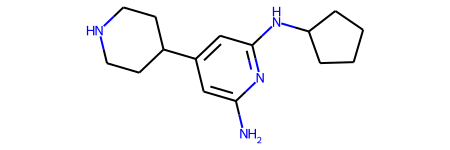

In [296]:
idx_test = 13
smi = df_train.iloc[idx_test].smiles
mol = mols_from_smiles([smi])[0]
mol

In [297]:
mols_to_smiles([mol])

['Nc1cc(C2CCNCC2)cc(NC2CCCC2)n1']

In [298]:
frag = FragmentClass()

In [299]:
tree = frag._grow_tree(mol)

In [300]:
frag.leaves

['*c1cc(*)nc(N)c1', '*N*', '*C1CCCC1', '*C1CCNCC1']

In [301]:
df_train.iloc[idx_test].fragments

'*c1cc(N)nc(NC2CCCC2)c1 *C1CCNCC1'

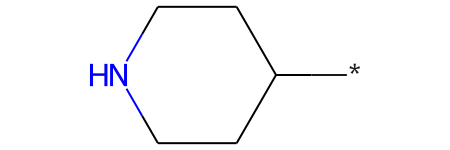

In [317]:
tree.right.mol

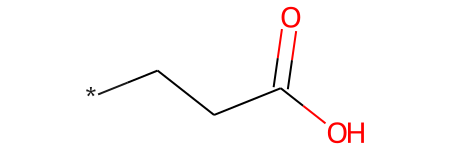

In [294]:
mols_from_smiles(frag.leaves)[0]

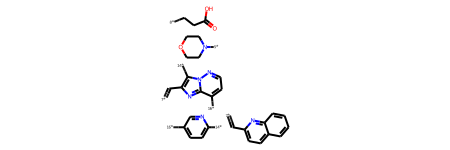

In [295]:
BRICS.BreakBRICSBonds(mol)

## iterate through data

In [329]:
idx = []
i = 0
while i < len(df_train) - 1:
    idx_start = i
    idx_end = i + 100000
    if idx_end > len(df_train) - 1:
        idx_end = len(df_train)
    idx.append([idx_start, idx_end])
    i = idx_end

In [330]:
i = 0
for idxs in tqdm(idx):
    df = df_train.iloc[idxs[0]:idxs[1]]
    smiles = df.smiles.tolist()
    mols = mols_from_smiles(smiles)
    frags = []
    no_frag = []
    for mol in mols:
        frag = FragmentClass()
        tree = frag._grow_tree(mol)
        frag_list = frag.leaves
        frags.append(frag_list)
    for frag in frags:
        no_frag.append(len(frag))
    fragment_df = pd.DataFrame(
                    {'fragments': frags,
                     'n_fragments': no_frag,
                    })
    fragment_df.to_csv("fragment"+str(i)+".csv", index=False)
    i += 1

100%|██████████| 11/11 [2:31:14<00:00, 825.00s/it] 


In [326]:
smiles

['CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O',
 'Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1',
 'COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O)OC)c2)cc(Cl)c1OC',
 'Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2ccccc2n1',
 'CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C)c(=O)n3C)c1',
 'COc1cc(OC)c2c(-c3cccc(-c4ccc(C#N)cc4)c3)cc(=O)oc2c1',
 'COc1cc2[nH]c(C(=O)Nc3ccc(F)cc3)cc2c(OC)c1OC',
 'COc1cc(F)cc(-c2ccc(C(CC(=O)O)NC(=O)C3CCCN3S(=O)(=O)c3cc(Cl)cc(Cl)c3)cc2)c1',
 'COc1cc(-c2cc(OC)c(-n3c(=O)ccc4cc(S(=O)(=O)Nc5cccnn5)ccc43)cc2F)ccc1Cl',
 'CCCCC1(C)CC(CO)C(CCCC)(OC)OO1',
 'CCCCCCCCCCCCNc1ccc2c3c(cccc13)C(=O)N(CCCN1CCCNCCNCCCNCC1)C2=O',
 'COC(=O)C1=C(c2cc3ccccc3o2)CC2CCC1N2C(=O)NCc1cccc2ccccc12',
 'Cc1ccccc1C=Cc1cccc(C(F)(F)P(=O)(O)O)c1',
 'Nc1cc(C2CCNCC2)cc(NC2CCCC2)n1',
 'CCN(C(C)=O)c1ccc(OC)c2nc(NC(=O)C3CCN(C(=O)c4cccc(C(F)(F)F)c4)CC3)sc12',
 'COC(=O)C1CCC(C)C(c2ccc(C)cc2)N1C(=O)c1ccc(C=NOCC(O)COCc2ccco2)cc1',
 'CCOC(=O)C1(Cc2ccccc2C)CCCN(C(=O)CCC(=O)OC)C1',
 'CCCn1c(CN

In [32]:
bonds = list(BRICS.FindBRICSBonds(mol))
idxs, labs = list(zip(*bonds))
bond_idxs = []
for a1, a2 in idxs:
    bond = mol.GetBondBetweenAtoms(a1, a2)
    bond_idxs.append(bond.GetIdx())
order = np.argsort(bond_idxs).tolist()
bond_idxs = [bond_idxs[i] for i in order]
broken = Chem.FragmentOnBonds(mol,
                              bondIndices=[bond_idxs[0]],
                              dummyLabels=[(0, 0)])
head, tail = Chem.GetMolFrags(broken, asMols=True)

In [30]:
bond_idxs

[3, 11, 12]

In [28]:
idxs

((12, 11), (12, 13), (4, 3))

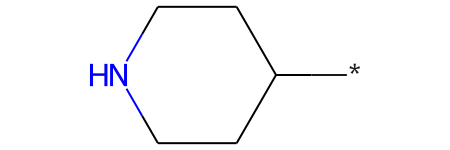

In [34]:
tail

## Evaluation of fragments

In [331]:
df = pd.DataFrame({'fragments' : [], 'n_fragments': []})

In [332]:
for i in range(0,11):
    df = df.append(pd.read_csv("fragment"+str(i)+".csv", header=0))

<ipython-input-332-d38be8f04892>:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.read_csv("fragment"+str(i)+".csv", header=0))
<ipython-input-332-d38be8f04892>:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.read_csv("fragment"+str(i)+".csv", header=0))
<ipython-input-332-d38be8f04892>:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.read_csv("fragment"+str(i)+".csv", header=0))
<ipython-input-332-d38be8f04892>:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.read_csv("fragment"+str(i)+".csv", header=0))
<ipython-input-332-d38be8f04892>:2: FutureWarning: The frame

In [336]:
df = df.reset_index(drop = True)
df

,fragments,n_fragments
0,"['*CCC', '*N(*)*', '*C(*)=O', '*C1OC(C(=O)O)=C...",9.0
1,"['*c1ccc(O)cc1', '*NC(=S)N1N=C(c2ccccc2)CC1*',...",3.0
2,"['*OC', '*C(*)=O', '*c1cc(C(=*)c2cc(*)c(*)c(Cl...",8.0
3,"['*c1cc(C)nc2ccccc12', '*CO*', '*c1ccc(*)cc1',...",7.0
4,"['*CC', '*O*', '*C(*)=O', '*c1ccc(O)c(*)c1', '...",6.0
...,...,...
1090456,"['*OC', '*c1ccc2c(*)ccnc2c1', '*O*', '*C*', '*...",6.0
1090457,"['*c1nccc(C(C#N)=C2Nc3ccccc3S2)n1', '*N*', '*C...",4.0
1090458,"['*CCC(=O)O', '*c1ccc(*)nc1', '*c1ccnn2c(*)c(C...",5.0
1090459,"['*CC', '*O*', '*CC*', '*c1ccc(*)c(C)c1', '*O*...",10.0


In [337]:
fragments_list = []
for i in tqdm(range(len(df))):
    my_list = eval(str(df.loc[i, 'fragments']))
    fragments_list.append(" ".join(my_list))

100%|██████████| 1090461/1090461 [00:30<00:00, 36244.38it/s]


In [340]:
df_train = df_train.drop(columns=['Unnamed: 0'])
df_train['fragments'] = fragments_list
df_train['n_fragments'] = df['n_fragments']

In [341]:
df_train

,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,DOUBLE,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS
0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)* *C(*)=O *C1OC(C(=O)O)=CC(N)C1* *N*...,9.0,26,0,3,5,0,26,10,0,0,0,0,3,2.33400,128.6249,0.522569,3.595745
1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,11,0,0,0,1,3,4.94030,112.9455,0.638566,2.563412
2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(*)c(*)c(Cl)c2)cc(C...,8.0,25,0,0,7,3,26,10,0,0,0,0,2,6.07540,138.1390,0.264467,2.973098
3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,10,0,0,0,0,4,3.13402,124.9069,0.395442,3.145495
4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,11,0,0,0,1,3,2.57720,116.8143,0.513201,2.494430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1090456,COc1ccc2c(OCc3nnc4ccc(-c5cc(C)no5)cn34)ccnc2c1,*OC *c1ccc2c(*)ccnc2c1 *O* *C* *c1ccc2nnc(*)n2...,6.0,21,0,5,3,0,22,11,0,0,0,2,3,3.82852,105.8480,0.452799,2.604622
1090457,N#CC(=C1Nc2ccccc2S1)c1ccnc(NCCc2cccc(F)c2)n1,*c1nccc(C(C#N)=C2Nc3ccccc3S2)n1 *N* *CC* *c1cc...,4.0,21,1,5,0,1,20,10,1,0,0,1,3,4.68028,109.0804,0.617420,2.715200
1090458,O=C(O)CCc1ccc(-c2c(C=Cc3ccc4ccccc4n3)nc3c(N4CC...,*CCC(=O)O *c1ccc(*)nc1 *c1ccnn2c(*)c(C=*)nc12 ...,5.0,29,0,6,3,0,29,14,0,0,0,1,5,4.36370,145.8778,0.347080,3.065345
1090459,CCOCCc1ccc(OCCNC(=O)c2cc(C(C)(C)C)nn2C)c(C)c1,*CC *O* *CC* *c1ccc(*)c(C)c1 *O* *CC* *N* *C(*...,10.0,22,0,3,3,0,23,6,0,0,0,1,1,3.41382,111.1122,0.669825,2.398846


In [347]:
df_train.n_fragments.value_counts()

5.0     210269
6.0     194118
4.0     174010
7.0     155919
3.0     106313
8.0     102157
9.0      63580
10.0     35331
11.0     20718
12.0     10921
13.0      7253
14.0      3625
15.0      2299
2.0       1361
16.0      1126
17.0       820
18.0       248
19.0       177
21.0        62
20.0        58
22.0        31
23.0        24
25.0         8
24.0         7
26.0         7
27.0         7
28.0         3
29.0         2
31.0         2
51.0         1
35.0         1
47.0         1
43.0         1
30.0         1
Name: n_fragments, dtype: int64

In [360]:
df_test = df_train[df_train['n_fragments']<=10]

In [361]:
fragment_list = []
for frag in tqdm(df_test.fragments):
    fragment_list.extend(frag.split())

100%|██████████| 1043058/1043058 [00:00<00:00, 1540766.18it/s]


In [362]:
fragment_unique = set(fragment_list)
fragment_counts = pd.Series(fragment_list).value_counts()
frament_count_df = pd.DataFrame(fragment_counts, columns=['count']).reset_index().rename(columns={"index": "fragment"})
frament_count_df

,fragment,count
0,*N*,574271
1,*C(*)=O,381287
2,*OC,315010
3,*O*,289057
4,*C*,260627
...,...,...
131509,*c1nc2c(cc1C#N)oc1c(*)nc(=O)n(*)c12,1
131510,*c1c(N)nn(*)c1C,1
131511,*c1c(*)c(Br)c(Br)c(O)c1O,1
131512,*c1ccc(N=Nc2cccc3ccccc23)cc1,1


In [363]:
frament_count_df[frament_count_df['count'] == 1]

,fragment,count
59882,*CC(=O)NNC(=*)C,1
59883,*c1cc(C2C3=C(COC3=O)Nc3c2c(*)nn3*)cc(*)c1*,1
59884,*c1[nH]c2ccccc2c1N,1
59885,*c1ccc(S(C)(=O)=O)c(N)c1,1
59886,*c1ccnc2cc3c(cc12)OCCO3,1
...,...,...
131509,*c1nc2c(cc1C#N)oc1c(*)nc(=O)n(*)c12,1
131510,*c1c(N)nn(*)c1C,1
131511,*c1c(*)c(Br)c(Br)c(O)c1O,1
131512,*c1ccc(N=Nc2cccc3ccccc23)cc1,1


In [364]:
df_test.to_csv("train - recurse LR Full.smi")

# Check Embeddings

In [21]:
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec

In [26]:
df = pd.read_csv('DATA/CHEMBL/PROCESSED/train.smi')

In [27]:
df

,Unnamed: 0,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,DOUBLE,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS
0,0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)* *C(*)=O *C1OC(C(=O)O)=CC(N)C1* *N*...,9.0,26,0,3,5,0,26,10,0,0,0,0,3,2.33400,128.6249,0.522569,3.595745
1,1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,11,0,0,0,1,3,4.94030,112.9455,0.638566,2.563412
2,2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(*)c(*)c(Cl)c2)cc(C...,8.0,25,0,0,7,3,26,10,0,0,0,0,2,6.07540,138.1390,0.264467,2.973098
3,3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,10,0,0,0,0,4,3.13402,124.9069,0.395442,3.145495
4,4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,11,0,0,0,1,3,2.57720,116.8143,0.513201,2.494430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1043053,1090456,COc1ccc2c(OCc3nnc4ccc(-c5cc(C)no5)cn34)ccnc2c1,*OC *c1ccc2c(*)ccnc2c1 *O* *C* *c1ccc2nnc(*)n2...,6.0,21,0,5,3,0,22,11,0,0,0,2,3,3.82852,105.8480,0.452799,2.604622
1043054,1090457,N#CC(=C1Nc2ccccc2S1)c1ccnc(NCCc2cccc(F)c2)n1,*c1nccc(C(C#N)=C2Nc3ccccc3S2)n1 *N* *CC* *c1cc...,4.0,21,1,5,0,1,20,10,1,0,0,1,3,4.68028,109.0804,0.617420,2.715200
1043055,1090458,O=C(O)CCc1ccc(-c2c(C=Cc3ccc4ccccc4n3)nc3c(N4CC...,*CCC(=O)O *c1ccc(*)nc1 *c1ccnn2c(*)c(C=*)nc12 ...,5.0,29,0,6,3,0,29,14,0,0,0,1,5,4.36370,145.8778,0.347080,3.065345
1043056,1090459,CCOCCc1ccc(OCCNC(=O)c2cc(C(C)(C)C)nn2C)c(C)c1,*CC *O* *CC* *c1ccc(*)c(C)c1 *O* *CC* *N* *C(*...,10.0,22,0,3,3,0,23,6,0,0,0,1,1,3.41382,111.1122,0.669825,2.398846


In [54]:
class LossLogger(CallbackAny2Vec):
    '''Output loss at each epoch'''
    def __init__(self):
        self.epoch = 1
        self.losses = []

    def on_epoch_begin(self, model):
        print(f'Epoch: {self.epoch}', end='\t')

    def on_epoch_end(self, model):
        if self.epoch == 1:
            loss = model.get_latest_training_loss()
        else:
            loss = model.get_latest_training_loss() - sum(self.losses[:self.epoch-1])
        self.losses.append(loss)
        print(f'  Loss: {loss}')
        self.epoch += 1

loss_logger = LossLogger()

In [55]:
SOS_TOKEN = '<SOS>'
PAD_TOKEN = '<PAD>'
EOS_TOKEN = '<EOS>'

data = [s.split(" ") for s in df.fragments]
    
w2i = {PAD_TOKEN: 0, SOS_TOKEN: 1, EOS_TOKEN: 2}

w2v = Word2Vec(
        data,
        vector_size=100,
        window=3,
        min_count=1,
        callbacks=[loss_logger],
        negative=5,
        workers=20,
        epochs=400,
        sg=0,
        compute_loss=True)

vocab = w2v.wv.key_to_index

Epoch: 1	  Loss: 505548.625
Epoch: 2	  Loss: 417592.125
Epoch: 3	  Loss: 367131.125
Epoch: 4	  Loss: 345153.5
Epoch: 5	  Loss: 340252.625
Epoch: 6	  Loss: 301879.25
Epoch: 7	  Loss: 300076.25
Epoch: 8	  Loss: 282567.25
Epoch: 9	  Loss: 278838.5
Epoch: 10	  Loss: 292569.0
Epoch: 11	  Loss: 280055.0
Epoch: 12	  Loss: 285844.75
Epoch: 13	  Loss: 276697.0
Epoch: 14	  Loss: 257071.0
Epoch: 15	  Loss: 238394.0
Epoch: 16	  Loss: 253624.5
Epoch: 17	  Loss: 236025.5
Epoch: 18	  Loss: 242214.0
Epoch: 19	  Loss: 233534.0
Epoch: 20	  Loss: 232965.5
Epoch: 21	  Loss: 221862.0
Epoch: 22	  Loss: 245411.0
Epoch: 23	  Loss: 238232.5
Epoch: 24	  Loss: 228681.5
Epoch: 25	  Loss: 235702.0
Epoch: 26	  Loss: 236256.0
Epoch: 27	  Loss: 233945.5
Epoch: 28	  Loss: 240924.0
Epoch: 29	  Loss: 225176.5
Epoch: 30	  Loss: 239902.0
Epoch: 31	  Loss: 219768.5
Epoch: 32	  Loss: 228115.0
Epoch: 33	  Loss: 207236.0
Epoch: 34	  Loss: 214198.0
Epoch: 35	  Loss: 227503.0
Epoch: 36	  Loss: 218968.0
Epoch: 37	  Loss: 206013.

KeyboardInterrupt: 

In [44]:
loss_logger.losses

[1018751.9375, 794238.3125, 1797755.1875, 1484925.0625, 2522055.1875]

# Mol2Vec Predictions

In [4]:
np.mean((df.logP - np.mean(df.logP))**2)

3.0838125571720205

In [24]:
!pip install gensim==3.8.1

     |████████████████████████████████| 23.4 MB 3.9 MB/s eta 0:00:01
  Created wheel for gensim: filename=gensim-3.8.1-cp39-cp39-linux_x86_64.whl size=23986942 sha256=8fafb638873caa4eb1096d2414775f2671454b322dac65bdfd3c3392426ddee7
  Stored in directory: /home/teddy_t/.cache/pip/wheels/fe/77/24/b3ffc86119703277a8aeb0e6914e97e216b1bd45287e41d6ba
Successfully built gensim
  Attempting uninstall: gensim
    Found existing installation: gensim 3.0.0
    Uninstalling gensim-3.0.0:
      Successfully uninstalled gensim-3.0.0


In [33]:
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error
from mol2vec.features import mol2alt_sentence, mol2sentence, MolSentence, DfVec, sentences2vec
from gensim.models import word2vec
#Loading pre-trained model via word2vec
from gensim.models import word2vec
model_pretrained = word2vec.Word2Vec.load('DATA/model_300dim.pkl')

In [34]:
def evaluation(model, X_test, y_test):
    prediction = model.predict(X_test)
    mae = mean_absolute_error(y_test, prediction)
    mse = mean_squared_error(y_test, prediction)
    
    plt.figure(figsize=(15, 10))
    plt.plot(prediction[:300], "red", label="prediction", linewidth=1.0)
    plt.plot(y_test[:300], 'green', label="actual", linewidth=1.0)
    plt.legend()
    plt.ylabel('logP')
    plt.title("MAE {}, MSE {}".format(round(mae, 4), round(mse, 4)))
    plt.show()
    
    print('MAE score:', round(mae, 4))
    print('MSE score:', round(mse,4))

In [35]:
df = pd.read_csv('DATA/CHEMBL/PROCESSED/train.smi')

In [36]:
x = df.fragments[0].split()
x

['*CCC',
 '*N(*)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O',
 '*CC*',
 '*c1cccc(*)c1',
 '*c1ccccc1']

In [37]:
def make_sentence(x):
    frags = [frag for frag in x]
    mols = mols_from_smiles(frags)
    sentence_ind = []
    for mol in mols:
        sentence_ind.append(mol2alt_sentence(mol, radius=1))
    sentence = [item for sublist in sentence_ind for item in sublist]
    return sentence, sentence_ind

In [38]:
sentence, sentence_ind = make_sentence(df.fragments[0].split())
sentence_ind

[['2342113506',
  '1302073591',
  '2245384272',
  '1547949149',
  '2245384272',
  '1173125914',
  '2246728737',
  '3542456614'],
 ['2342113506',
  '483783770',
  '848128881',
  '2431057637',
  '2342113506',
  '483783770',
  '2246699815',
  '3961613636',
  '864942730',
  '1510328189',
  '2976033787',
  '1254998976',
  '3189457552',
  '2697642734',
  '3217380708',
  '1686006643',
  '2246699815',
  '2784506312',
  '864942730',
  '1510328189',
  '864662311',
  '1533864325',
  '3218693969',
  '2446961558',
  '2976033787',
  '2267822907',
  '847957139',
  '1323888424',
  '2976033787',
  '2584514126',
  '847961216',
  '1693331843',
  '2246699815',
  '411967733',
  '2246728737',
  '3545365497',
  '864942730',
  '1510328189'],
 ['2342113506',
  '1302073591',
  '2245384272',
  '1547949149',
  '2245384272',
  '1547949149',
  '2342113506',
  '1302073591'],
 ['2342113506',
  '2207093323',
  '3217380708',
  '853890546',
  '3218693969',
  '951226070',
  '3218693969',
  '98513984',
  '3218693969',
  '

In [ ]:
[DfVec(x) for x in sentences2vec(fragment_unique_mol_df['sentence'], model, unseen='UNK')]

In [94]:
np.sum(DfVec(sentences2vec(MolSentence(['951226070']), model_pretrained, unseen='UNK')).vec, 0)

array([-1.8530875e+00,  1.2607712e+00, -1.8447319e+00,  2.9766703e-01,
       -2.4309491e-01, -1.1321304e+00,  2.8325481e+00,  4.2847729e-01,
       -1.4882796e+00, -4.1436787e+00,  2.8298371e+00, -5.6267514e+00,
        1.6599505e+00, -3.5020604e+00, -4.9566442e-01,  3.5173500e+00,
       -1.2485893e+00,  2.2450206e+00, -4.5843527e-02, -2.1512134e+00,
       -4.8166895e+00,  2.5385673e+00, -9.6520551e-02, -3.4937236e+00,
        1.9835023e+00,  4.5313201e+00,  2.9971907e+00, -6.0228789e-03,
        4.1104569e+00, -6.5984011e-01,  2.1143792e+00, -1.9098563e+00,
        2.5145133e+00,  2.6378386e+00, -8.0032445e-02, -4.8104584e-02,
       -1.0948623e+00, -9.2540666e-02, -1.5720401e+00,  2.1244242e+00,
       -6.6625232e-01, -4.6880937e+00,  4.3142843e+00,  2.2411659e-01,
       -1.5793201e+00, -4.0035815e+00, -1.8550885e+00,  5.7211266e+00,
        2.9903860e+00,  3.6946955e+00, -3.0113287e+00, -1.4444909e+00,
       -4.9965472e+00,  2.0425465e+00,  1.6595815e+00, -8.6080408e-01,
      

In [101]:
vocab.w2i['*c1ccccc1']

7

In [98]:
embeddings = np.loadtxt('RUNS/2022-11-17@15:12:11-LAPTOP-E1483HNR-CHEMBL/config/emb_100.dat', delimiter=",")

In [102]:
embeddings[7]

array([-0.03336659, -0.27777791,  0.11636938,  0.20101607, -0.31955701,
        0.76649427,  0.34406784,  0.52280074,  1.03460979, -0.29084465,
       -0.33443725,  0.64964694, -0.29347816,  0.27836534, -0.16153914,
       -0.03505595,  0.55404276,  0.04689505, -0.10162331, -0.23977616,
       -0.48862925, -0.24119315, -0.76503152, -0.11332221, -0.42190737,
       -0.28605491,  0.17679223,  0.29726025,  0.39176124, -0.43834817,
       -0.34695166,  0.40282273,  0.3716799 ,  0.11687367, -0.26709351,
       -0.66674244,  0.06409461, -0.25206918,  0.02475482, -0.53282011,
        0.31082278, -0.12908462,  0.86023706,  0.12038162,  0.02183689,
        0.03066139, -0.37877512,  0.01152581,  0.49239373, -0.03232483,
       -0.25900561, -0.49808928,  0.10708339,  0.36683711,  0.52039737,
        0.02851336,  0.34220898, -0.07213815,  0.35784516,  0.35350636,
        0.44125903,  0.05214338, -0.69810414,  0.33719778,  0.18799551,
        0.6349805 ,  0.07101212, -0.18727657, -0.69617856,  0.08

In [50]:
data = [s.split(" ") for s in dataset.data.fragments]

data = [item for sublist in data for item in sublist]
fragment_unique = list(set(data))
fragment_unique_mol = mols_from_smiles(fragment_unique)
fragment_unique_mol_df = pd.DataFrame(zip(fragment_unique, fragment_unique_mol), columns=['smi','mol'])
# Constructing sentences
fragment_unique_mol_df['sentence'] = fragment_unique_mol_df.apply(
    lambda x: MolSentence(mol2alt_sentence(x['mol'], 1)), axis=1)

# Extracting embeddings to a numpy.array
# Note that we always should mark unseen='UNK' in sentence2vec() so that model is taught how to handle unknown substructures
fragment_unique_mol_df['mol2vec'] = [DfVec(x) for x in
                                     sentences2vec(fragment_unique_mol_df['sentence'], model_pretrained, unseen='UNK')]
X = np.array([x.vec for x in fragment_unique_mol_df['mol2vec']])

In [70]:
fragment_unique_mol_df

,smi,mol,sentence,mol2vec
0,*ONC(=O)Nc1ccccc1,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 533204632, 864674487, 847647790, ...","(100,) dimensional vector"
1,*CC[S+]([O-])CC,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 1302073591, 2245384272, 154794914...","(100,) dimensional vector"
2,*N1CCc2c(c3cccc(Cl)c3n2*)C1,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 1119552904, 2092489639, 755089492...","(100,) dimensional vector"
3,*c1ccc2c(c1)C(c1ccc3c(c1)OCO3)=C(C(=O)O)C(*)O2,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 2207093323, 3217380708, 853890546...","(100,) dimensional vector"
4,*n1cc(C#CCC(C)C)nn1,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 1119552904, 2092489639, 256040439...","(100,) dimensional vector"
...,...,...,...,...
67756,*CC(*)N1CCCCC1,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 1302073591, 2245384272, 135284423...","(100,) dimensional vector"
67757,*c1sc(C)c(-c2ccccc2)c1*,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 2207093323, 3217380708, 976864260...","(100,) dimensional vector"
67758,*C1CN=C(N)N1c1ccccc1,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 2449355948, 2976033787, 275895127...","(100,) dimensional vector"
67759,*c1cc(C=*)ccc1OCc1cn(CCCOc2cc(=O)oc3ccccc23)nn1,"<img data-content=""rdkit/molecule"" src=""data:i...","(2342113506, 2207093323, 3217380708, 571773018...","(100,) dimensional vector"


In [74]:
sentence_2_vec = sentences2vec(fragment_unique_mol_df['sentence'], model_pretrained, unseen='UNK')

In [91]:
sentence_2_vec.shape

(67761, 100)

In [78]:
sentence_2_vec_test = [x for x in sentence_2_vec]

In [88]:
sentence_2_vec_test[1]

array([ 0.70613694, -1.0342269 , -4.532198  ,  3.7949305 , -0.01824749,
       -1.4782422 , -2.4809182 , -0.7631537 , -1.839868  , -4.6600256 ,
        3.6244657 , -5.4590383 ,  2.9203978 , -2.5129666 , -4.2927756 ,
        1.088106  , -1.63091   , -0.12851006,  1.1023535 , -3.6576245 ,
       -4.0773206 ,  3.0348384 , -1.8794394 ,  3.8794467 ,  2.5160513 ,
       -0.04212964, -3.0701764 , -1.907797  ,  4.0539412 , -1.7687548 ,
        2.8954902 , -0.97571313,  4.6257243 ,  2.6122074 , -5.428779  ,
       -5.37559   ,  4.427521  , -0.06340504,  3.009689  ,  5.7937517 ,
       -0.6743325 , -5.92692   ,  3.0941257 , -0.8709284 ,  1.1721691 ,
       -4.900145  , -5.8138757 ,  3.2589803 ,  4.5273886 ,  2.8736157 ,
        4.6479254 , -0.9731628 , -2.8912082 , -0.03927597, -0.19395451,
        1.2259539 , -4.7841563 , -2.3541908 ,  2.8085961 ,  3.4175537 ,
        3.0549793 , -3.3489873 ,  0.01805696, -0.94961643, -4.1007957 ,
       -0.90769637,  1.3643152 , -0.17216133, -3.326764  ,  0.55

In [92]:
fragment_unique_mol_df[fragment_unique_mol_df['smi']=='*c1ccccc1'].mol2vec.values[0].vec

array([-1.0792052 ,  1.0192167 , -1.99742   , -0.6934773 , -1.5895969 ,
       -1.3344513 , -0.57514405, -1.0715415 , -2.150568  , -4.070322  ,
        5.835896  , -3.2940571 ,  2.2792726 , -3.471836  , -2.2352474 ,
        0.79408693,  0.09614445,  2.6201637 , -1.2803901 , -3.0930648 ,
       -4.5726595 ,  2.3806052 , -3.801375  , -0.6001854 , -0.20594831,
       -0.7282565 , -0.16472584, -1.5708345 ,  0.5169642 ,  0.55722094,
       -0.50491   ,  3.3772113 ,  4.56143   ,  1.2483226 , -1.7689874 ,
       -3.7862334 ,  2.1654522 ,  2.4555552 , -2.487358  ,  3.8959877 ,
        3.0938618 , -4.2915506 ,  2.8124747 , -1.4449841 , -1.2108821 ,
       -3.8609018 , -3.034204  ,  2.1212652 ,  4.0394616 ,  3.565607  ,
       -0.05017009,  1.0101258 , -2.7475336 , -0.0117088 ,  2.4014995 ,
        2.8178725 , -1.2736778 , -3.141091  ,  3.5730097 ,  1.6977808 ,
        0.09578753, -1.1960217 ,  2.8040593 ,  1.7564659 ,  0.27708703,
       -1.6222608 , -1.7668554 ,  6.001253  , -2.8366597 ,  4.91

In [61]:
DfVec(sentences2vec(fragment_unique_mol_df[fragment_unique_mol_df['smi']=='*CCC'].sentence.values[0], model_pretrained, unseen='UNK')).vec

array([[-2.0589862e+00,  1.4008569e+00, -2.0497022e+00,  3.3074114e-01,
        -2.7010545e-01, -1.2579226e+00,  3.1472757e+00,  4.7608587e-01,
        -1.6536440e+00, -4.6040874e+00,  3.1442635e+00, -6.2519460e+00,
         1.8443894e+00, -3.8911781e+00, -5.5073822e-01,  3.9081666e+00,
        -1.3873215e+00,  2.4944673e+00, -5.0937250e-02, -2.3902371e+00,
        -5.3518772e+00,  2.8206303e+00, -1.0724506e-01, -3.8819151e+00,
         2.2038915e+00,  5.0348001e+00,  3.3302119e+00, -6.6920877e-03,
         4.5671744e+00, -7.3315567e-01,  2.3493102e+00, -2.1220627e+00,
         2.7939036e+00,  2.9309318e+00, -8.8924937e-02, -5.3449538e-02,
        -1.2165138e+00, -1.0282296e-01, -1.7467113e+00,  2.3604712e+00,
        -7.4028033e-01, -5.2089930e+00,  4.7936492e+00,  2.4901843e-01,
        -1.7548001e+00, -4.4484239e+00, -2.0612094e+00,  6.3568072e+00,
         3.3226511e+00,  4.1052170e+00, -3.3459208e+00, -1.6049899e+00,
        -5.5517192e+00,  2.2694962e+00,  1.8439795e+00, -9.56448

In [156]:
print('Molecular sentence:', sentence)
print('\nMolSentence object:', MolSentence(sentence))
print('\nDfVec object:',DfVec(sentences2vec(MolSentence(sentence), model, unseen='UNK')))

Molecular sentence: ['2342113506', '533204632', '864674487', '2401021582', '2246728737', '3975275337', '2342113506', '1298690312', '2246699815', '2955918768', '2342113506', '1298690312', '864942730', '1510328189', '2342113506', '2207093323', '3217380708', '571773018', '3218693969', '994485099', '3217380708', '2994748777', '2246699815', '2671398625', '2342113506', '1298691151', '3217380708', '2994748777', '3218693969', '994485099', '3217380708', '571773018', '2342113506', '2207093323', '3217380708', '574186953', '2342113506', '2207093323', '3217380708', '2424973678', '1016841875', '3452535345', '3218693969', '994485099', '3218693969', '994485099', '3217380708', '2424973678', '1016841875', '3452535345', '3217380708', '574186953', '2342113506', '2207093323', '2342113506', '533204632', '864674487', '2401021582', '2246728737', '3975275337', '2342113506', '1298690312', '2246699815', '2955918768', '2342113506', '1298690312', '864942730', '1510328189', '2342113506', '533204632', '864674487', '

In [157]:
test = DfVec(sentences2vec(MolSentence(sentence), model, unseen='UNK'))
test.vec

array([[-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ],
       [-1.8530875 ,  1.2607712 , -1.8447319 , ...,  0.3438469 ,
         0.03925027, -1.380524  ],
       [-1.8530875 ,  1.2607712 , -1.8447319 , ...,  0.3438469 ,
         0.03925027, -1.380524  ],
       ...,
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ],
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ],
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ]], dtype=float32)

In [ ]:
vocab.

In [105]:
df_test = df[:5000]
df_test.smiles
df_test['mol'] = df_test['mol'].apply(lambda x: Chem.MolFromSmiles(x))
target = df_test['logP']

<ipython-input-105-87da021c6af5>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test['mol'] = df_test['fragments'].apply(lambda x: Chem.MolFromSmiles(x))


In [111]:
df_test.frag

'*CCC *N(*)* *C(*)=O *C1OC(C(=O)O)=CC(N)C1* *N* *C(C)=O *CC* *c1cccc(*)c1 *c1ccccc1'

In [58]:
df_test

,Unnamed: 0,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,...,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS,mol
0,0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)* *C(*)=O *C1OC(C(=O)O)=CC(N)C1* *N*...,9.0,26,0,3,5,0,26,...,0,0,0,0,3,2.33400,128.6249,0.522569,3.595745,"<img data-content=""rdkit/molecule"" src=""data:i..."
1,1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,...,0,0,0,1,3,4.94030,112.9455,0.638566,2.563412,"<img data-content=""rdkit/molecule"" src=""data:i..."
2,2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(*)c(*)c(Cl)c2)cc(C...,8.0,25,0,0,7,3,26,...,0,0,0,0,2,6.07540,138.1390,0.264467,2.973098,"<img data-content=""rdkit/molecule"" src=""data:i..."
3,3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,...,0,0,0,0,4,3.13402,124.9069,0.395442,3.145495,"<img data-content=""rdkit/molecule"" src=""data:i..."
4,4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,...,0,0,0,1,3,2.57720,116.8143,0.513201,2.494430,"<img data-content=""rdkit/molecule"" src=""data:i..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,5227,Fc1cc(Nc2ncc(C3CC3)cn2)ccc1C1CNCCO1,*c1ccc(*)c(F)c1 *C1CNCCO1 *N* *c1cnc(*)nc1 *C1CC1,5.0,17,1,4,1,0,20,...,0,1,0,0,3,2.89760,85.2524,0.908539,3.083535,"<img data-content=""rdkit/molecule"" src=""data:i..."
4996,5228,CCn1cc(SCC(=O)N2CCCC(O)(CO)C2)c2ccccc21,*CC *c1cn(*)c2ccccc12 *S* *CC(*)=O *N1CCCC(*)(...,6.0,18,0,2,3,1,21,...,0,0,0,1,2,2.09910,96.1856,0.812380,2.998096,"<img data-content=""rdkit/molecule"" src=""data:i..."
4997,5229,Cc1oc(-c2cc(F)ccc2F)nc1CN1CCN(C)C(=O)C1C,*c1nc(*)c(C)o1 *CN1CCN(C)C(=O)C1C *c1cc(F)ccc1F,3.0,17,2,3,2,0,20,...,0,0,0,1,2,2.59072,84.1010,0.865061,3.007505,"<img data-content=""rdkit/molecule"" src=""data:i..."
4998,5230,O=C(OC1C[N+]2(CCOc3ccccc3)CCC1CC2)N(Cc1cccs1)c...,*C(*)=O *N(*)* *c1ccccc1 *C* *c1cccs1 *O* *C1C...,10.0,27,0,2,3,1,28,...,0,0,0,1,5,5.57930,131.6024,0.409543,3.919219,"<img data-content=""rdkit/molecule"" src=""data:i..."


In [59]:
df.smiles[1]

'Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1'

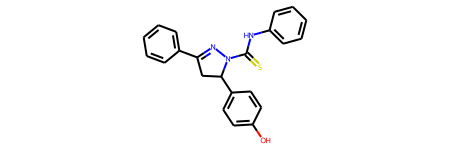

In [60]:
x[1]

In [133]:
print('Molecular sentence:', mol2alt_sentence(mol, radius=1))
print('\nMolSentence object:', MolSentence(mol2alt_sentence(mol, radius=1)))
print('\nDfVec object:',DfVec(sentences2vec(MolSentence(mol2alt_sentence(mol, radius=1)), model, unseen='UNK')))

Molecular sentence: ['2342113506', '1302073591', '2245384272', '1547949149', '2245384272', '1173125914', '2246728737', '3542456614']

MolSentence object: MolSentence with 8 words

DfVec object: (8, 100) dimensional vector


In [64]:
test = DfVec(sentences2vec(MolSentence(mol2alt_sentence(mol, radius=1)), model, unseen='UNK'))
test.vec

array([[-1.8530875 ,  1.2607712 , -1.8447319 , ...,  0.3438469 ,
         0.03925027, -1.380524  ],
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ],
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ],
       ...,
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ],
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ],
       [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
         0.04361141, -1.5339156 ]], dtype=float32)

In [167]:
#Constructing sentences
df_test['sentence'] = df_test.apply(lambda x: MolSentence(make_sentence(x['fragments'].split())), axis=1)

#Extracting embeddings to a numpy.array
#Note that we always should mark unseen='UNK' in sentence2vec() so that model is taught how to handle unknown substructures
df_test['mol2vec'] = [DfVec(x) for x in sentences2vec(df_test['sentence'], model, unseen='UNK')]
X = np.array([x.vec for x in df_test['mol2vec']])
y = target.values

X.shape

<ipython-input-167-ba4e7174cf67>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test['sentence'] = df_test.apply(lambda x: MolSentence(make_sentence(x['fragments'].split())), axis=1)
<ipython-input-167-ba4e7174cf67>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test['mol2vec'] = [DfVec(x) for x in sentences2vec(df_test['sentence'], model, unseen='UNK')]


(5000, 100)

In [213]:
df_test['mol2vec'][0].vec

array([ -5.5533056 ,   6.3537188 , -10.861312  ,  -4.201896  ,
        -7.0581203 , -15.14158   ,   6.959416  ,  -7.337525  ,
       -11.276558  , -29.782408  ,  28.077589  , -37.099617  ,
        17.545076  , -23.62545   , -15.870775  ,   9.45085   ,
        -6.745857  ,  13.740071  ,  -2.2397895 , -19.181044  ,
       -34.117367  ,  27.100817  , -17.19923   , -10.117832  ,
        13.104157  ,  15.9737    ,   9.2726    ,  -8.024852  ,
        24.442976  ,  -7.9030704 ,  12.371011  ,   4.2924767 ,
        29.599466  ,  10.594278  , -13.174731  , -15.104046  ,
        12.042809  ,  13.064109  , -18.58947   ,  27.383907  ,
         3.6626947 , -30.136152  ,  28.08861   ,  -1.2176679 ,
       -13.153287  , -29.306473  , -31.06663   ,  33.833096  ,
        31.298643  ,  35.84268   ,  -7.871194  ,  -1.9178495 ,
       -27.657429  ,  11.258414  ,   8.599236  ,   3.5422988 ,
       -13.197923  , -32.165928  ,  17.987204  ,  18.446516  ,
         6.4453597 , -11.155222  ,   9.719427  ,   9.93

In [221]:
test = sentences2vec(df_test['sentence'][0], model, unseen='UNK')
np.array([DfVec(test).vec])

array([[[-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
          0.04361141, -1.5339156 ],
        [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
          0.04361141, -1.5339156 ],
        [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
          0.04361141, -1.5339156 ],
        ...,
        [-1.6471889 ,  1.1206855 , -1.6397617 , ...,  0.30564168,
          0.03488913, -1.2271324 ],
        [-2.0589862 ,  1.4008569 , -2.0497022 , ...,  0.3820521 ,
          0.04361141, -1.5339156 ],
        [-1.8530875 ,  1.2607712 , -1.8447319 , ...,  0.3438469 ,
          0.03925027, -1.380524  ]]], dtype=float32)

In [168]:
X

array([[ -5.5533056,   6.3537188, -10.861312 , ...,  19.574005 ,
        -20.338957 , -10.280911 ],
       [ -3.835774 ,   3.7418845,  -8.129825 , ...,  17.662588 ,
         -6.2157197,  -6.4163876],
       [ -7.054857 ,   8.4332075,  -9.185156 , ...,  24.945465 ,
        -12.365301 ,  -8.42605  ],
       ...,
       [ -2.1108158,   0.7019628,  -4.1198487, ...,  16.882223 ,
         -9.149045 ,  -2.772192 ],
       [-10.402174 ,   7.739042 , -13.367525 , ...,  14.527354 ,
        -12.876453 , -10.257349 ],
       [ -6.2050653,   5.0088067,  -8.808063 , ...,  21.219088 ,
         -8.451726 ,  -9.214453 ]], dtype=float32)

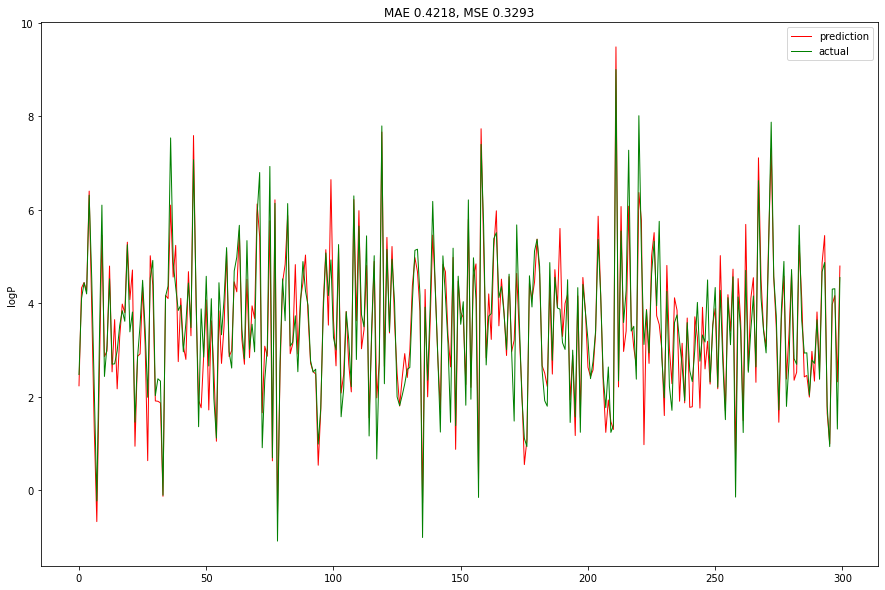

MAE score: 0.4218
MSE score: 0.3293


In [169]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.1, random_state=1)
ridge = RidgeCV(cv=5)
ridge.fit(X_train, y_train)
evaluation(ridge, X_test, y_test)

In [170]:
class MLP(nn.Module):
    def __init__(self):
        super(MLP, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(100, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )
        
    def forward(self, x):
        x = self.layers(x)
        return x

In [172]:
MLP_model = MLP()
optimizer = torch.optim.Adam(MLP_model.parameters(), lr=0.001)
mean_train_losses = []
mean_valid_losses = []
valid_acc_list = []
epochs = 20

for epoch in range(epochs):
    MLP_model.train()
    
    train_losses = []
    valid_losses = [] 
    output_final = []
    for i, (latent_data) in enumerate(X_train):
        
        outputs = MLP_model(Variable(torch.tensor(latent_data)))
        if epoch + 1 == epochs:
            output_final.append(outputs.item())
        loss = F.mse_loss(outputs[0].type(torch.float64), torch.tensor(y_train[i]))
        #print(loss)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        train_losses.append(loss.item())
            
    MLP_model.eval()
    mean_train_losses.append(np.mean(train_losses))
    print('epoch : {}, train loss : {:.4f}'\
         .format(epoch+1, np.mean(train_losses)))

epoch : 1, train loss : 1.4282
epoch : 2, train loss : 0.8637
epoch : 3, train loss : 0.7430
epoch : 4, train loss : 0.6534
epoch : 5, train loss : 0.5967
epoch : 6, train loss : 0.5668
epoch : 7, train loss : 0.5374
epoch : 8, train loss : 0.5131
epoch : 9, train loss : 0.5011
epoch : 10, train loss : 0.4829
epoch : 11, train loss : 0.4642
epoch : 12, train loss : 0.4566
epoch : 13, train loss : 0.4386
epoch : 14, train loss : 0.4307
epoch : 15, train loss : 0.4223
epoch : 16, train loss : 0.4193
epoch : 17, train loss : 0.4060
epoch : 18, train loss : 0.4054
epoch : 19, train loss : 0.3999
epoch : 20, train loss : 0.3928


In [173]:
output_final

[3.2103614807128906,
 4.9351348876953125,
 3.1045734882354736,
 3.543693780899048,
 0.7495449781417847,
 0.5308547019958496,
 7.168493747711182,
 3.9664981365203857,
 6.678615570068359,
 3.0038394927978516,
 4.566340446472168,
 1.805936574935913,
 5.720755100250244,
 7.574554920196533,
 7.082427978515625,
 3.423976182937622,
 1.6453827619552612,
 6.522307395935059,
 5.1015753746032715,
 3.107703685760498,
 4.73278284072876,
 4.12072229385376,
 1.9813283681869507,
 3.2230048179626465,
 2.5148427486419678,
 3.7188541889190674,
 3.0300943851470947,
 1.704850196838379,
 4.901194095611572,
 4.7733988761901855,
 2.4765357971191406,
 3.36698579788208,
 3.6623241901397705,
 3.5623748302459717,
 5.025552749633789,
 2.881809949874878,
 -0.11425738036632538,
 3.8770620822906494,
 4.675139427185059,
 6.874610424041748,
 4.6920294761657715,
 5.30571174621582,
 3.0539557933807373,
 0.9870008230209351,
 3.2296462059020996,
 3.867177724838257,
 1.8011691570281982,
 1.9607738256454468,
 3.1077582836151

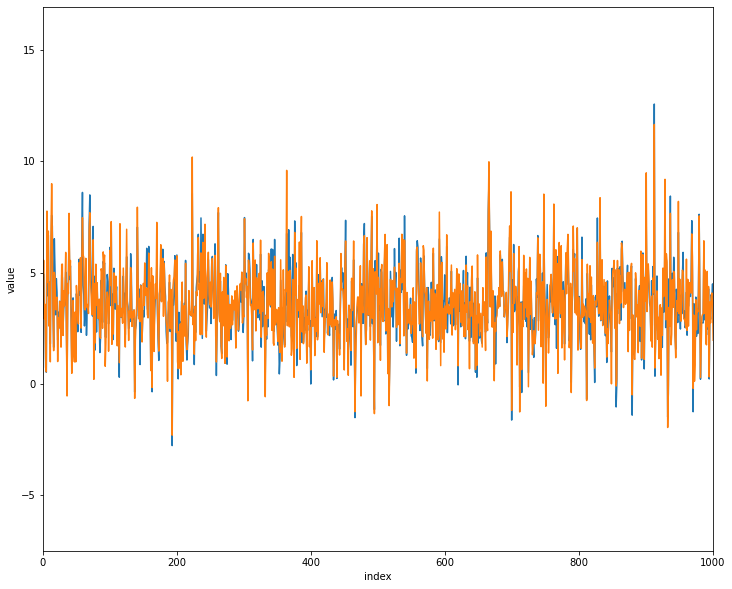

In [175]:
plt.figure(figsize=(12, 10))
plt.plot( np.arange(len(output_final)),np.array(output_final))
plt.plot( np.arange(len(output_final)),np.array(y_train))
plt.xlabel("index")
plt.ylabel("value")
plt.xlim(0,1000)
plt.show()

# Mol2Vec Embeddings

In [30]:
SOS_TOKEN = '<SOS>'
PAD_TOKEN = '<PAD>'
EOS_TOKEN = '<EOS>'
TOKENS = [SOS_TOKEN, PAD_TOKEN, EOS_TOKEN]
i2w_infreq = None
w2w_infreq = None
c2w_infreq = None
start_idx = len(TOKENS)

In [57]:
data = pd.read_csv('DATA/CHEMBL/PROCESSED/train.smi')
data

,Unnamed: 0,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,DOUBLE,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS
0,0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)* *C(*)=O *C1OC(C(=O)O)=CC(N)C1* *N*...,9.0,26,0,3,5,0,26,10,0,0,0,0,3,2.33400,128.6249,0.522569,3.595745
1,1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,11,0,0,0,1,3,4.94030,112.9455,0.638566,2.563412
2,2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(*)c(*)c(Cl)c2)cc(C...,8.0,25,0,0,7,3,26,10,0,0,0,0,2,6.07540,138.1390,0.264467,2.973098
3,3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,10,0,0,0,0,4,3.13402,124.9069,0.395442,3.145495
4,4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,11,0,0,0,1,3,2.57720,116.8143,0.513201,2.494430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103679,108443,Cc1ccc2[nH]c(=O)c3cc(C(=O)NC4CCC(C)CC4)sc3c2c1,*c1cc2c(=O)[nH]c3ccc(C)cc3c2s1 *C(*)=O *N* *C1...,4.0,20,0,2,2,1,21,7,0,0,0,1,3,4.35972,103.5749,0.718130,2.418529
103680,108444,CNC(=O)C=Cc1cc(OC)cc(-c2ccc3cc(OC)ccc3c2)c1,*NC *C(=O)C=* *c1cc(*)cc(C=*)c1 *c1ccc2cc(*)cc...,6.0,22,0,1,3,0,18,10,0,0,0,0,3,4.28320,105.5887,0.700795,2.168326
103681,108445,COc1cc(CNC(=O)Nc2ccc(C(C)(C)C)cc2)ccc1B(O)O,*OC *c1ccc(B(O)O)c(*)c1 *CN* *C(*)=O *N* *c1cc...,7.0,19,0,2,4,1,20,7,0,0,0,0,2,1.99420,103.8200,0.617034,2.299559
103682,108446,CC(C=NNC(=O)c1cccc(F)c1)=Cc1ccccc1,*C(=O)NN=CC(=*)C *=Cc1ccccc1 *c1cccc(F)c1,3.0,17,1,2,1,0,13,9,0,0,0,0,2,3.64480,82.4512,0.674736,2.061025


In [25]:
frags = [s.split(" ") for s in tqdm(data.fragments)]

100%|██████████| 103684/103684 [00:00<00:00, 415332.51it/s]


In [26]:
frags = [item for sublist in data for item in sublist]

In [27]:
fragment_unique = list(set(frags))

In [28]:
len(fragment_unique)

35115

In [31]:
w2i = {PAD_TOKEN: 0, SOS_TOKEN: 1, EOS_TOKEN: 2}
w2i.update({k: v + start_idx for v, (k) in enumerate(fragment_unique)})
i2w = {v: k for (k, v) in w2i.items()}

In [32]:
w2i

{'<PAD>': 0,
 '<SOS>': 1,
 '<EOS>': 2,
 '*c1ccc2c(c1)OC(C)(C)C2': 3,
 '*n1c2ccccc2c2ccc(C=*)cc21': 4,
 '*c1cc(*)c(*)c([N+](=O)[O-])c1': 5,
 '*CC(C)(C)C(*)=O': 6,
 '*c1nc2c(c(=O)[nH]1)CCN(*)C2': 7,
 '*c1cc2c(cc1*)C(C(C)C)N(*)CC2': 8,
 '*C1C(*)C2(C)C(O)CC34CC35CCC(O)C(C)(C)C5CCC4C2(C)C1*': 9,
 '*c1nc2ccc(C)cc2o1': 10,
 '*CN=C1NC(=*)C(=O)N1': 11,
 '*C12CCC(*)(C1Br)C2(C)C': 12,
 '*NC(S)=NC12CC3CC(CC(C3)C1)C2': 13,
 '*c1c(*)[n+]([O-])c2cc(F)c(F)cc2[n+]1[O-]': 14,
 '*C1CC(C(F)(F)F)=NN1c1ccc(S(N)(=O)=O)cc1': 15,
 '*C1CCC2(C)C(=CCC3C4Cc5cnoc5NC4(C)CCC32)C1': 16,
 '*c1c(Cl)cc2nnc(*)n2c1Cl': 17,
 '*c1ccc(S(=O)(=O)c2ccc(N)nc2)s1': 18,
 '*c1cc2cc(C)ccc2c(*)n1': 19,
 '*c1nc2c(N)nc3ccc([N+](=O)[O-])cc3c2n1*': 20,
 '*n1cc(C=*)nn1': 21,
 '*c1cc(C(=NO)N2CCN(C)CC2)ccn1': 22,
 '*c1nc(O)oc1*': 23,
 '*c1cc2c(cn1)CC(C)(C)n1c-2cc2c(F)cccc21': 24,
 '*C1OC2(*)OC(*)(C(O)C2O)C1(*)*': 25,
 '*CC(*)C(=O)C(=O)O': 26,
 '*C(=O)C(=CN1CCNC1=S)C(*)=O': 27,
 '*c1ccc(NNc2c3ccccc3nc3c(*)cccc23)cc1': 28,
 '*N1CC=C(c2ccc(C#N)

In [33]:
i2w

{0: '<PAD>',
 1: '<SOS>',
 2: '<EOS>',
 3: '*c1ccc2c(c1)OC(C)(C)C2',
 4: '*n1c2ccccc2c2ccc(C=*)cc21',
 5: '*c1cc(*)c(*)c([N+](=O)[O-])c1',
 6: '*CC(C)(C)C(*)=O',
 7: '*c1nc2c(c(=O)[nH]1)CCN(*)C2',
 8: '*c1cc2c(cc1*)C(C(C)C)N(*)CC2',
 9: '*C1C(*)C2(C)C(O)CC34CC35CCC(O)C(C)(C)C5CCC4C2(C)C1*',
 10: '*c1nc2ccc(C)cc2o1',
 11: '*CN=C1NC(=*)C(=O)N1',
 12: '*C12CCC(*)(C1Br)C2(C)C',
 13: '*NC(S)=NC12CC3CC(CC(C3)C1)C2',
 14: '*c1c(*)[n+]([O-])c2cc(F)c(F)cc2[n+]1[O-]',
 15: '*C1CC(C(F)(F)F)=NN1c1ccc(S(N)(=O)=O)cc1',
 16: '*C1CCC2(C)C(=CCC3C4Cc5cnoc5NC4(C)CCC32)C1',
 17: '*c1c(Cl)cc2nnc(*)n2c1Cl',
 18: '*c1ccc(S(=O)(=O)c2ccc(N)nc2)s1',
 19: '*c1cc2cc(C)ccc2c(*)n1',
 20: '*c1nc2c(N)nc3ccc([N+](=O)[O-])cc3c2n1*',
 21: '*n1cc(C=*)nn1',
 22: '*c1cc(C(=NO)N2CCN(C)CC2)ccn1',
 23: '*c1nc(O)oc1*',
 24: '*c1cc2c(cn1)CC(C)(C)n1c-2cc2c(F)cccc21',
 25: '*C1OC2(*)OC(*)(C(O)C2O)C1(*)*',
 26: '*CC(*)C(=O)C(=O)O',
 27: '*C(=O)C(=CN1CCNC1=S)C(*)=O',
 28: '*c1ccc(NNc2c3ccccc3nc3c(*)cccc23)cc1',
 29: '*N1CC=C(c2ccc(

In [34]:
fragment_unique_mol = mols_from_smiles(fragment_unique)

In [45]:
fragment_unique_mol_df = pd.DataFrame({'mol':fragment_unique_mol,'smi':fragment_unique})
fragment_unique_mol_df

,mol,smi
0,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1ccc2c(c1)OC(C)(C)C2
1,"<img data-content=""rdkit/molecule"" src=""data:i...",*n1c2ccccc2c2ccc(C=*)cc21
2,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1cc(*)c(*)c([N+](=O)[O-])c1
3,"<img data-content=""rdkit/molecule"" src=""data:i...",*CC(C)(C)C(*)=O
4,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1nc2c(c(=O)[nH]1)CCN(*)C2
...,...,...
35110,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1c2c(=O)n(C)c(=O)n(C)c2nn1C
35111,"<img data-content=""rdkit/molecule"" src=""data:i...",*C(=O)CC1=CC(=*)c2ccc(F)cc21
35112,"<img data-content=""rdkit/molecule"" src=""data:i...",*N1CC(F)C1
35113,"<img data-content=""rdkit/molecule"" src=""data:i...",*CN1CCC(*)C(O)C1


In [46]:
#Constructing sentences
fragment_unique_mol_df['sentence'] = fragment_unique_mol_df.apply(lambda x: MolSentence(mol2alt_sentence(x['mol'], 1)), axis=1)

#Extracting embeddings to a numpy.array
#Note that we always should mark unseen='UNK' in sentence2vec() so that model is taught how to handle unknown substructures
fragment_unique_mol_df['mol2vec'] = [DfVec(x) for x in sentences2vec(fragment_unique_mol_df['sentence'], model, unseen='UNK')]
X = np.array([x.vec for x in fragment_unique_mol_df['mol2vec']])
#y = target.values

X.shape

(35115, 100)

In [47]:
fragment_unique_mol_df

,mol,smi,sentence,mol2vec
0,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1ccc2c(c1)OC(C)(C)C2,"(2342113506, 2207093323, 3217380708, 853890546...","(100,) dimensional vector"
1,"<img data-content=""rdkit/molecule"" src=""data:i...",*n1c2ccccc2c2ccc(C=*)cc21,"(2342113506, 1119552904, 2092489639, 381202549...","(100,) dimensional vector"
2,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1cc(*)c(*)c([N+](=O)[O-])c1,"(2342113506, 2207093323, 3217380708, 853890546...","(100,) dimensional vector"
3,"<img data-content=""rdkit/molecule"" src=""data:i...",*CC(C)(C)C(*)=O,"(2342113506, 1302073591, 2245384272, 135205987...","(100,) dimensional vector"
4,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1nc2c(c(=O)[nH]1)CCN(*)C2,"(2342113506, 2207093323, 3217380708, 200863697...","(100,) dimensional vector"
...,...,...,...,...
35110,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1c2c(=O)n(C)c(=O)n(C)c2nn1C,"(2342113506, 2207093323, 3217380708, 199809797...","(100,) dimensional vector"
35111,"<img data-content=""rdkit/molecule"" src=""data:i...",*C(=O)CC1=CC(=*)c2ccc(F)cc21,"(2342113506, 1298690312, 2246699815, 220963359...","(100,) dimensional vector"
35112,"<img data-content=""rdkit/molecule"" src=""data:i...",*N1CC(F)C1,"(2342113506, 1119552904, 2092489639, 755089492...","(100,) dimensional vector"
35113,"<img data-content=""rdkit/molecule"" src=""data:i...",*CN1CCC(*)C(O)C1,"(2342113506, 1302073591, 2245384272, 229702845...","(100,) dimensional vector"


In [39]:
fragment_unique_mol_df.mol2vec[0].vec

array([ -3.7876742 ,   4.846098  ,  -3.495695  ,  -4.5280414 ,
        -3.5854208 ,  -4.4341903 ,  -2.0307834 ,  -3.5138595 ,
        -1.8430166 ,  -3.9592495 ,   8.022362  ,  -8.722181  ,
        -0.8852551 ,  -3.6376731 ,  -1.5228908 ,   0.7019183 ,
        -2.2663245 ,   5.3851004 ,  -0.8580048 ,  -3.8051355 ,
        -6.5727596 ,   4.7458434 ,  -6.656274  ,   2.4089146 ,
         4.5741262 ,   1.3954213 ,   0.7585708 ,  -2.355791  ,
         5.882585  ,   0.86772454,  -3.445779  ,   2.4258394 ,
         8.227649  ,   1.219105  ,  -5.331032  ,  -5.6455    ,
         1.4684919 ,   3.9908156 ,  -3.4259999 ,   4.11149   ,
         5.426331  ,  -0.6892299 ,   5.6390295 ,  -2.9981003 ,
        -1.8079752 ,  -5.7820644 ,  -6.5415316 ,   2.9289684 ,
         7.0894413 ,   8.018409  ,   4.042189  ,  -2.1129322 ,
        -3.7444215 ,   0.9821803 ,   1.7022141 ,   5.274963  ,
        -0.61444646,  -4.570746  ,   1.8915831 ,   2.2056115 ,
        -0.66557133,  -1.7038269 ,   2.3196845 ,   1.83

In [56]:
data

['*CCC',
 '*N(*)*',
 '*C(*)=O',
 '*C1OC(C(=O)O)=CC(N)C1*',
 '*N*',
 '*C(C)=O',
 '*CC*',
 '*c1cccc(*)c1',
 '*c1ccccc1',
 '*c1ccc(O)cc1',
 '*NC(=S)N1N=C(c2ccccc2)CC1*',
 '*c1ccccc1',
 '*OC',
 '*C(*)=O',
 '*c1cc(C(=*)c2cc(*)c(*)c(Cl)c2)cc(Cl)c1*',
 '*OC',
 '*C(*)=O',
 '*OC',
 '*OC',
 '*=CCCCC(=O)SC',
 '*c1cc(C)nc2ccccc12',
 '*CO*',
 '*c1ccc(*)cc1',
 '*N*',
 '*C(*)=O',
 '*C1CCN(C)CC1*',
 '*C(=O)NO',
 '*CC',
 '*O*',
 '*C(*)=O',
 '*c1ccc(O)c(*)c1',
 '*c1c2c(=O)n(C)c(=O)n(C)c2cn1*',
 '*c1ccccc1',
 '*OC',
 '*c1cc(*)c2c(*)cc(=O)oc2c1',
 '*c1cccc(*)c1',
 '*c1ccc(C#N)cc1',
 '*OC',
 '*OC',
 '*c1cc2c(*)c(*)c(*)cc2[nH]1',
 '*OC',
 '*OC',
 '*C(*)=O',
 '*N*',
 '*c1ccc(F)cc1',
 '*OC',
 '*c1cc(*)cc(F)c1',
 '*c1ccc(*)cc1',
 '*C(*)CC(=O)O',
 '*N*',
 '*C(*)=O',
 '*C1CCCN1*',
 '*S(=O)(=O)c1cc(Cl)cc(Cl)c1',
 '*OC',
 '*c1ccc(Cl)c(*)c1',
 '*c1cc(*)c(F)cc1*',
 '*n1c(=O)ccc2cc(S(*)(=O)=O)ccc21',
 '*N*',
 '*c1cccnn1',
 '*OC',
 '*CCCC',
 '*C1CC(*)(C)OOC1(*)*',
 '*OC',
 '*CCCC',
 '*CO',
 '*CCCCCCCCCCCC',
 '*N*',
 '

In [58]:
data['mol'] = mols_from_smiles(list(data.smiles))

In [59]:
data

,Unnamed: 0,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,...,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS,mol
0,0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)* *C(*)=O *C1OC(C(=O)O)=CC(N)C1* *N*...,9.0,26,0,3,5,0,26,...,0,0,0,0,3,2.33400,128.6249,0.522569,3.595745,"<img data-content=""rdkit/molecule"" src=""data:i..."
1,1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,...,0,0,0,1,3,4.94030,112.9455,0.638566,2.563412,"<img data-content=""rdkit/molecule"" src=""data:i..."
2,2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(*)c(*)c(Cl)c2)cc(C...,8.0,25,0,0,7,3,26,...,0,0,0,0,2,6.07540,138.1390,0.264467,2.973098,"<img data-content=""rdkit/molecule"" src=""data:i..."
3,3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,...,0,0,0,0,4,3.13402,124.9069,0.395442,3.145495,"<img data-content=""rdkit/molecule"" src=""data:i..."
4,4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,...,0,0,0,1,3,2.57720,116.8143,0.513201,2.494430,"<img data-content=""rdkit/molecule"" src=""data:i..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103679,108443,Cc1ccc2[nH]c(=O)c3cc(C(=O)NC4CCC(C)CC4)sc3c2c1,*c1cc2c(=O)[nH]c3ccc(C)cc3c2s1 *C(*)=O *N* *C1...,4.0,20,0,2,2,1,21,...,0,0,0,1,3,4.35972,103.5749,0.718130,2.418529,"<img data-content=""rdkit/molecule"" src=""data:i..."
103680,108444,CNC(=O)C=Cc1cc(OC)cc(-c2ccc3cc(OC)ccc3c2)c1,*NC *C(=O)C=* *c1cc(*)cc(C=*)c1 *c1ccc2cc(*)cc...,6.0,22,0,1,3,0,18,...,0,0,0,0,3,4.28320,105.5887,0.700795,2.168326,"<img data-content=""rdkit/molecule"" src=""data:i..."
103681,108445,COc1cc(CNC(=O)Nc2ccc(C(C)(C)C)cc2)ccc1B(O)O,*OC *c1ccc(B(O)O)c(*)c1 *CN* *C(*)=O *N* *c1cc...,7.0,19,0,2,4,1,20,...,0,0,0,0,2,1.99420,103.8200,0.617034,2.299559,"<img data-content=""rdkit/molecule"" src=""data:i..."
103682,108446,CC(C=NNC(=O)c1cccc(F)c1)=Cc1ccccc1,*C(=O)NN=CC(=*)C *=Cc1ccccc1 *c1cccc(F)c1,3.0,17,1,2,1,0,13,...,0,0,0,0,2,3.64480,82.4512,0.674736,2.061025,"<img data-content=""rdkit/molecule"" src=""data:i..."


In [60]:
#Constructing sentences
data['sentence'] = data.apply(lambda x: MolSentence(mol2alt_sentence(x['mol'], 1)), axis=1)

#Extracting embeddings to a numpy.array
#Note that we always should mark unseen='UNK' in sentence2vec() so that model is taught how to handle unknown substructures
data['mol2vec'] = [DfVec(x) for x in sentences2vec(data['sentence'], model, unseen='UNK')]
X = np.array([x.vec for x in data['mol2vec']])
#y = target.values

X.shape

(103684, 100)

In [61]:
data

,Unnamed: 0,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,...,Quad,Pent,Hex,logP,mr,qed,SAS,mol,sentence,mol2vec
0,0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)* *C(*)=O *C1OC(C(=O)O)=CC(N)C1* *N*...,9.0,26,0,3,5,0,26,...,0,0,3,2.33400,128.6249,0.522569,3.595745,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 3542456614, 2245384272, 117312591...","(100,) dimensional vector"
1,1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,...,0,1,3,4.94030,112.9455,0.638566,2.563412,"<img data-content=""rdkit/molecule"" src=""data:i...","(864662311, 26234434, 3217380708, 2905660137, ...","(100,) dimensional vector"
2,2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(*)c(*)c(Cl)c2)cc(C...,8.0,25,0,0,7,3,26,...,0,0,2,6.07540,138.1390,0.264467,2.973098,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 3975275337, 864674487, 2154935424...","(100,) dimensional vector"
3,3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,...,0,0,4,3.13402,124.9069,0.395442,3.145495,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 422715066, 3217380708, 4036277955...","(100,) dimensional vector"
4,4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,...,0,1,3,2.57720,116.8143,0.513201,2.494430,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 3542456614, 2245384272, 399408866...","(100,) dimensional vector"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103679,108443,Cc1ccc2[nH]c(=O)c3cc(C(=O)NC4CCC(C)CC4)sc3c2c1,*c1cc2c(=O)[nH]c3ccc(C)cc3c2s1 *C(*)=O *N* *C1...,4.0,20,0,2,2,1,21,...,0,1,3,4.35972,103.5749,0.718130,2.418529,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 422715066, 3217380708, 3207567135...","(100,) dimensional vector"
103680,108444,CNC(=O)C=Cc1cc(OC)cc(-c2ccc3cc(OC)ccc3c2)c1,*NC *C(=O)C=* *c1cc(*)cc(C=*)c1 *c1ccc2cc(*)cc...,6.0,22,0,1,3,0,18,...,0,0,3,4.28320,105.5887,0.700795,2.168326,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 3824063894, 847961216, 828793177,...","(100,) dimensional vector"
103681,108445,COc1cc(CNC(=O)Nc2ccc(C(C)(C)C)cc2)ccc1B(O)O,*OC *c1ccc(B(O)O)c(*)c1 *CN* *C(*)=O *N* *c1cc...,7.0,19,0,2,4,1,20,...,0,0,2,1.99420,103.8200,0.617034,2.299559,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 3975275337, 864674487, 2076190208...","(100,) dimensional vector"
103682,108446,CC(C=NNC(=O)c1cccc(F)c1)=Cc1ccccc1,*C(=O)NN=CC(=*)C *=Cc1ccccc1 *c1cccc(F)c1,3.0,17,1,2,1,0,13,...,0,0,2,3.64480,82.4512,0.674736,2.061025,"<img data-content=""rdkit/molecule"" src=""data:i...","(2246728737, 3545365497, 2246699815, 356381255...","(100,) dimensional vector"


In [63]:
data.mol2vec[0].vec

array([  5.0999346 ,  -0.3444044 ,  -3.0340786 ,  -6.116657  ,
        -7.14852   , -10.275398  , -10.601857  , -10.645155  ,
        -5.7873554 , -11.837977  ,  14.751538  , -12.375177  ,
        10.377755  ,  -5.386812  , -16.329046  ,  -9.31434   ,
        -3.6050644 ,   3.8882747 ,  -2.068004  , -10.360138  ,
       -11.793769  ,  15.97052   , -17.498304  ,  10.7702465 ,
         2.2456567 ,  -7.902461  ,  -8.525555  , -10.705776  ,
         7.1095576 ,  -6.7676573 ,   3.2888353 ,  15.321088  ,
        20.228241  ,  -1.8149172 , -15.082035  , -19.232445  ,
        23.112167  ,  14.6683445 , -13.06992   ,  22.391233  ,
         7.4489603 ,  -8.402043  ,   7.1210885 ,  -2.033215  ,
        -6.2430487 ,  -9.449932  , -25.178799  ,   8.929118  ,
        20.441145  ,  20.763924  ,   8.873954  ,   5.1505685 ,
        -3.0998194 ,   2.9582057 ,  -2.549937  ,   9.593525  ,
        -6.3884478 ,  -6.2669044 ,   8.297074  ,  -0.23002735,
       -10.477477  ,  -6.817936  ,  10.001048  ,   1.64

In [96]:
vec_sum_frag = []
for idx, (frag_str) in tqdm(enumerate(data.fragments)):
    if idx>5000:
        break
    sentences = frag_str.split()
    index = []
    for frag in sentences:
        index.append(fragment_unique_mol_df[fragment_unique_mol_df['smi'] == frag].index.values[0])
    vec_val = np.zeros(100)
    for frag_vec in fragment_unique_mol_df.iloc[index].mol2vec:
        vec_val += frag_vec.vec
    vec_sum_frag.append(vec_val)

5001it [02:24, 34.58it/s]


In [120]:
X_true = []
for vec_mol_true in data.iloc[:5000].mol2vec:
    X_true.append(vec_mol_true.vec)
X_true = np.array(X_true)
X_true.shape

(5000, 100)

In [109]:
X = np.array(vec_sum_frag[:-1])
y = data.iloc[:5000].logP.values

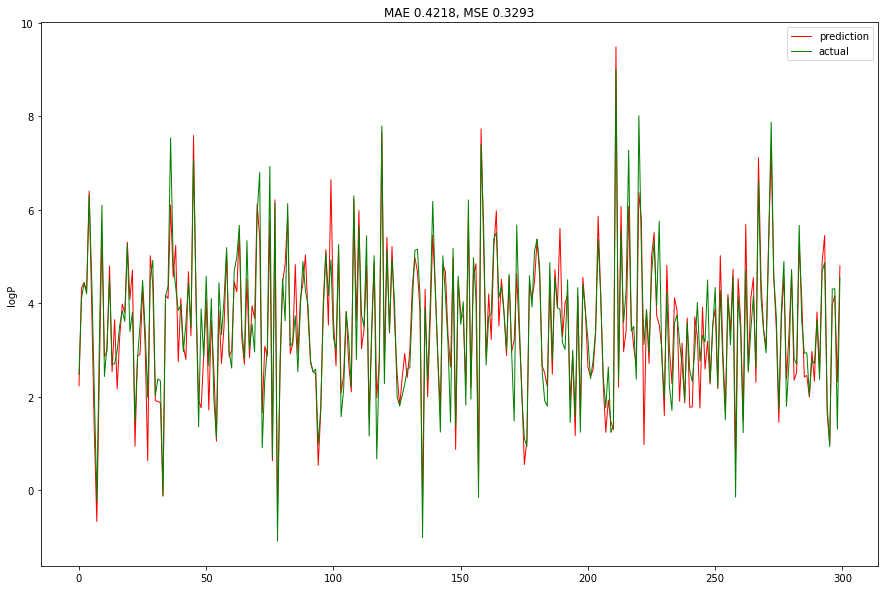

MAE score: 0.4218
MSE score: 0.3293


In [123]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.1, random_state=1)
ridge = RidgeCV(cv=5)
ridge.fit(X_train, y_train)
evaluation(ridge, X_test, y_test)

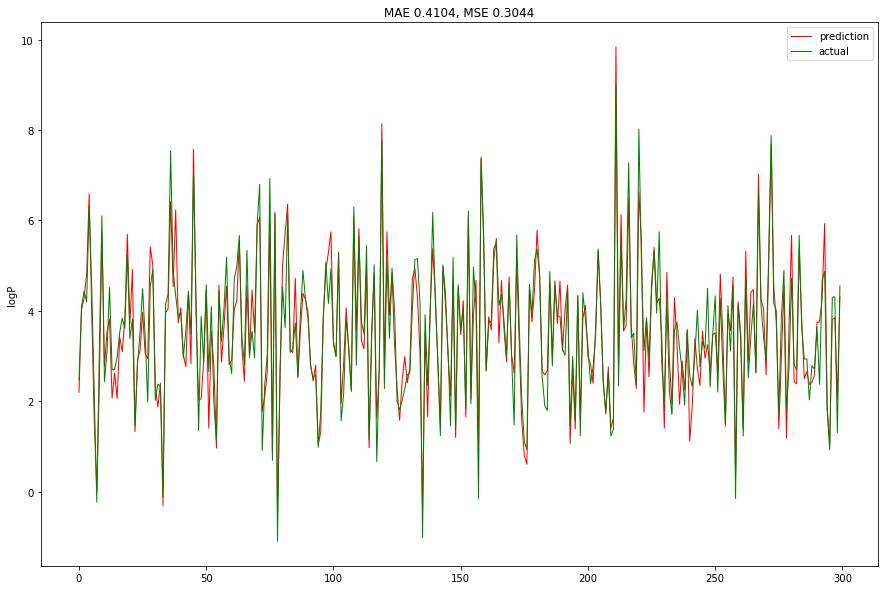

MAE score: 0.4104
MSE score: 0.3044


In [121]:
X_train, X_test, y_train, y_test = train_test_split(X_true, y, test_size=.1, random_state=1)
ridge = RidgeCV(cv=5)
ridge.fit(X_train, y_train)
evaluation(ridge, X_test, y_test)

# Test Encoder

In [ ]:
class Encoder(nn.Module):
    def __init__(self, input_size, embed_size,
                 hidden_size, hidden_layers, latent_size,
                 dropout, use_gpu):
        super().__init__()
        self.embed_size = embed_size
        self.hidden_size = hidden_size
        self.hidden_layers = hidden_layers
        self.latent_size = latent_size
        self.use_gpu = use_gpu

        self.rnn = nn.GRU(
            input_size=self.embed_size,
            hidden_size=self.hidden_size,
            num_layers=self.hidden_layers,
            dropout=dropout,
            batch_first=True)

        self.rnn2mean = nn.Linear(
            in_features=self.hidden_size * self.hidden_layers,
            out_features=self.latent_size)

        self.rnn2logv = nn.Linear(
            in_features=self.hidden_size * self.hidden_layers,
            out_features=self.latent_size)

    def forward(self, inputs, embeddings, lengths):
        batch_size = inputs.size(0)
        state = self.init_state(dim=batch_size)
        packed = pack_padded_sequence(embeddings, lengths, batch_first=True, enforce_sorted=False)
        _, state = self.rnn(packed, state)
        state = state.view(batch_size, self.hidden_size * self.hidden_layers)
        mean = self.rnn2mean(state)
        logv = self.rnn2logv(state)
        std = torch.exp(0.5 * logv)
        z = self.sample_normal(dim=batch_size)
        latent_sample = z * std + mean
        return latent_sample, mean, std

In [141]:
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        self.rnn2mean = nn.Linear(
            in_features=100,
            out_features=100)
        
    def forward(self, x):
        x = self.rnn2mean(x)
        return x

In [142]:
class MLP(nn.Module):
    def __init__(self):
        super(MLP, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(100, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )
        
    def forward(self, x):
        x = self.layers(x)
        return x

In [144]:
MLP_model = MLP()
Encoder_model = Encoder()
optimizer = torch.optim.Adam(MLP_model.parameters(), lr=0.001)
mean_train_losses = []
mean_valid_losses = []
valid_acc_list = []
epochs = 20

for epoch in range(epochs):
    MLP_model.train()
    
    train_losses = []
    valid_losses = [] 
    output_final = []
    for i, (latent_data) in enumerate(X_train):
        mean = Encoder_model(Variable(torch.tensor(latent_data).float()))
        outputs = MLP_model(Variable(mean).float())
        if epoch + 1 == epochs:
            output_final.append(outputs.item())
        loss = F.mse_loss(outputs[0].type(torch.float64), torch.tensor(y_train[i]))
        #print(loss)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        train_losses.append(loss.item())
            
    MLP_model.eval()
    mean_train_losses.append(np.mean(train_losses))
    print('epoch : {}, train loss : {:.4f}'\
         .format(epoch+1, np.mean(train_losses)))

epoch : 1, train loss : 1.4473
epoch : 2, train loss : 0.9096
epoch : 3, train loss : 0.8182
epoch : 4, train loss : 0.7612
epoch : 5, train loss : 0.7230
epoch : 6, train loss : 0.6903
epoch : 7, train loss : 0.6663
epoch : 8, train loss : 0.6510
epoch : 9, train loss : 0.6356
epoch : 10, train loss : 0.6216
epoch : 11, train loss : 0.6009
epoch : 12, train loss : 0.5930
epoch : 13, train loss : 0.5851
epoch : 14, train loss : 0.5741
epoch : 15, train loss : 0.5634
epoch : 16, train loss : 0.5536
epoch : 17, train loss : 0.5445
epoch : 18, train loss : 0.5414
epoch : 19, train loss : 0.5341
epoch : 20, train loss : 0.5327


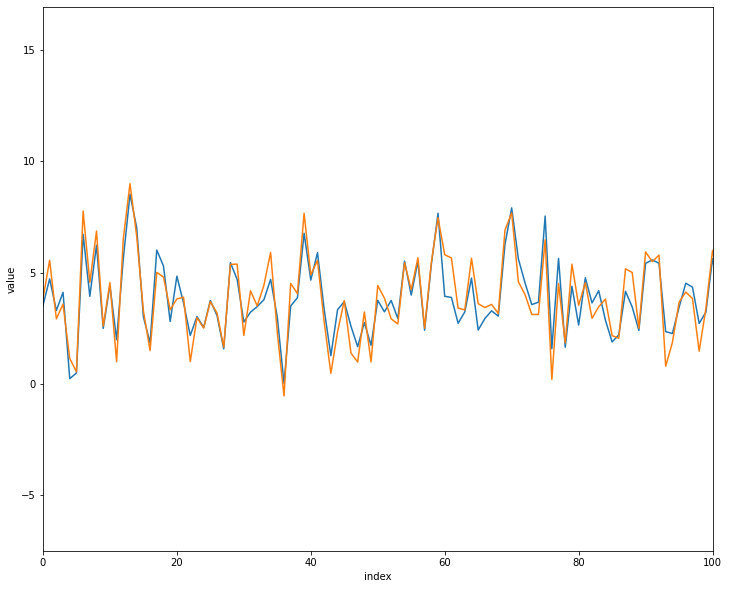

In [146]:
plt.figure(figsize=(12, 10))
plt.plot( np.arange(len(output_final)),np.array(output_final))
plt.plot( np.arange(len(output_final)),np.array(y_train))
plt.xlabel("index")
plt.ylabel("value")
plt.xlim(0,100)
plt.show()

# Test Loader

In [222]:
MLP_model = MLP()
Encoder_model = Encoder()
optimizer = torch.optim.Adam(MLP_model.parameters(), lr=0.001)
mean_train_losses = []
mean_valid_losses = []
valid_acc_list = []
epochs = 20

for epoch in range(epochs):
    Encoder_model.train()
    MLP_model.train()
    
    train_losses = []
    valid_losses = [] 
    output_final = []
    for i, (latent_data) in enumerate(X_train):
        mean = Encoder_model(Variable(torch.tensor(latent_data).float()))
        outputs = MLP_model(Variable(mean).float())
        if epoch + 1 == epochs:
            output_final.append(outputs.item())
        loss = F.mse_loss(outputs[0].type(torch.float64), torch.tensor(y_train[i]))
        #print(loss)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        train_losses.append(loss.item())
            
    MLP_model.eval()
    Encoder_model.eval()
    mean_train_losses.append(np.mean(train_losses))
    print('epoch : {}, train loss : {:.4f}'\
         .format(epoch+1, np.mean(train_losses)))

epoch : 1, train loss : 1.5454
epoch : 2, train loss : 1.0454
epoch : 3, train loss : 0.9650
epoch : 4, train loss : 0.8803
epoch : 5, train loss : 0.8299
epoch : 6, train loss : 0.7857
epoch : 7, train loss : 0.7542
epoch : 8, train loss : 0.7270
epoch : 9, train loss : 0.7072
epoch : 10, train loss : 0.6872
epoch : 11, train loss : 0.6682
epoch : 12, train loss : 0.6500
epoch : 13, train loss : 0.6451
epoch : 14, train loss : 0.6267
epoch : 15, train loss : 0.6192
epoch : 16, train loss : 0.6126
epoch : 17, train loss : 0.6023
epoch : 18, train loss : 0.5823
epoch : 19, train loss : 0.5759
epoch : 20, train loss : 0.5638


In [293]:
MLP_model = MLP()
Encoder_model = Encoder()
optimizer = torch.optim.Adam(MLP_model.parameters(), lr=0.001)
mean_train_losses = []
mean_valid_losses = []
valid_acc_list = []
epochs = 10

for epoch in range(epochs):
    Encoder_model.train()
    MLP_model.train()
    
    train_losses = []
    valid_losses = [] 
    output_final = []
    for idx, (src, tgt, lengths, data, tgt_str) in enumerate(loader):
        ###
        src, tgt = Variable(src), Variable(tgt)
        #frags = [vocab.translate(target_i) for target_i in tgt.cpu().detach().numpy()]
        vec_frag_arr = np.zeros(100)
        for idx2, (tgt_i) in enumerate(tgt):
            vec_frag_sum = np.sum(embeddings[tgt_i[tgt_i>2]],0)
            #vec_lst = fragment_unique_mol_df[fragment_unique_mol_df['smi'].isin(frag)].mol2vec.values
            #for vec_frag in vec_lst:
            #    vec_frag_sum += vec_frag.vec
            if idx2 == 0:
                vec_frag_arr = vec_frag_sum
            else:
                vec_frag_arr = np.vstack((vec_frag_arr,vec_frag_sum))
        mean = Encoder_model(Variable(torch.tensor(vec_frag_arr).float()))
        outputs = MLP_model(Variable(mean).float())
        if epoch + 1 == epochs:
            output_final.append(outputs.view(-1))
        loss = F.mse_loss(outputs.view(-1).type(torch.float64), torch.tensor(np.array(dataset.data.iloc[list(data)].logP)))
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        train_losses.append(loss.item())
        if idx == 0 or idx % 500 == 0:
            print("index:", idx)
            print("data index:", data)
            print("pred logp", outputs.view(-1))
            print("labels logp: ", np.array(dataset.data.iloc[list(data)].logP))
            print("loss:", loss)
            
    MLP_model.eval()
    Encoder_model.eval()
    mean_train_losses.append(np.mean(train_losses))
    print('epoch : {}, train loss : {:.4f}'\
         .format(epoch+1, np.mean(train_losses)))


index: 0
data index: (0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99)
pred logp tensor([0.4804, 0.6385, 0.7643, 0.4895, 0.5591, 0.6895, 0.5684, 0.6823, 0.7338,
        0.4944, 0.6797, 0.7312, 0.4705, 0.2909, 0.7608, 0.5188, 0.6056, 0.4079,
        0.3048, 0.4566, 0.4007, 0.7955, 0.3842, 0.3284, 0.4190, 0.4898, 0.9686,
        0.5888, 0.5354, 0.5139, 0.3232, 0.5998, 0.7238, 0.5424, 0.3975, 0.5775,
        0.5438, 0.4002, 0.6401, 0.6756, 0.3797, 0.5864, 0.6171, 0.3327, 0.6477,
        0.3177, 0.5192, 0.5265, 0.6866, 0.3699, 0.2747, 0.4920, 0.6882, 0.3885,
        0.3848, 0.5563, 0.4399, 0.4707, 0.5630, 0.4964, 0.5483, 0.5247, 0.4177,
        0.4501, 0.

index: 500
data index: (50000, 50001, 50002, 50003, 50004, 50005, 50006, 50007, 50008, 50009, 50010, 50011, 50012, 50013, 50014, 50015, 50016, 50017, 50018, 50019, 50020, 50021, 50022, 50023, 50024, 50025, 50026, 50027, 50028, 50029, 50030, 50031, 50032, 50033, 50034, 50035, 50036, 50037, 50038, 50039, 50040, 50041, 50042, 50043, 50044, 50045, 50046, 50047, 50048, 50049, 50050, 50051, 50052, 50053, 50054, 50055, 50056, 50057, 50058, 50059, 50060, 50061, 50062, 50063, 50064, 50065, 50066, 50067, 50068, 50069, 50070, 50071, 50072, 50073, 50074, 50075, 50076, 50077, 50078, 50079, 50080, 50081, 50082, 50083, 50084, 50085, 50086, 50087, 50088, 50089, 50090, 50091, 50092, 50093, 50094, 50095, 50096, 50097, 50098, 50099)
pred logp tensor([ 5.1492,  2.8998,  3.0791,  5.0157,  3.9541,  4.3938,  3.7363,  4.1890,
         5.6733,  3.9864,  2.9962,  2.6055,  1.5289,  4.2087,  2.3910,  3.1991,
         4.1534,  3.2258,  5.0284,  4.4808,  2.2560,  3.7124,  3.7821,  2.9966,
         3.8305,  2.3835, 

index: 1000
data index: (100000, 100001, 100002, 100003, 100004, 100005, 100006, 100007, 100008, 100009, 100010, 100011, 100012, 100013, 100014, 100015, 100016, 100017, 100018, 100019, 100020, 100021, 100022, 100023, 100024, 100025, 100026, 100027, 100028, 100029, 100030, 100031, 100032, 100033, 100034, 100035, 100036, 100037, 100038, 100039, 100040, 100041, 100042, 100043, 100044, 100045, 100046, 100047, 100048, 100049, 100050, 100051, 100052, 100053, 100054, 100055, 100056, 100057, 100058, 100059, 100060, 100061, 100062, 100063, 100064, 100065, 100066, 100067, 100068, 100069, 100070, 100071, 100072, 100073, 100074, 100075, 100076, 100077, 100078, 100079, 100080, 100081, 100082, 100083, 100084, 100085, 100086, 100087, 100088, 100089, 100090, 100091, 100092, 100093, 100094, 100095, 100096, 100097, 100098, 100099)
pred logp tensor([ 2.8106,  2.1805,  4.0195,  4.7352,  3.3383,  4.2210,  3.9402,  2.7390,
         4.7219,  2.8031,  8.7265,  5.3091,  5.0539,  6.6136,  4.9064,  1.7164,
     

epoch : 4, train loss : 0.3953
index: 0
data index: (0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99)
pred logp tensor([ 3.0007,  4.8081,  6.1499,  2.8928,  2.8410,  5.1482,  3.5745,  5.5728,
         5.5002,  4.3566,  8.0687,  5.2705,  4.9256,  2.3303,  5.7682,  2.9762,
         3.9668,  3.8294, -1.9191,  4.1810,  5.9789,  4.2241,  5.1233,  2.7864,
         4.5586,  4.3778,  5.1487,  4.6023,  4.4920,  2.2117,  1.9523,  1.9592,
         2.3362,  4.2657,  3.6056,  5.1864,  1.7365,  1.8013,  4.7094,  5.7461,
         1.5395,  2.9226,  3.7021,  2.9332,  5.6439,  0.0567,  4.5657,  2.2139,
         3.2798,  1.1155,  1.9656,  2.0284,  8.1222,  4.4669,  4.19

index: 500
data index: (50000, 50001, 50002, 50003, 50004, 50005, 50006, 50007, 50008, 50009, 50010, 50011, 50012, 50013, 50014, 50015, 50016, 50017, 50018, 50019, 50020, 50021, 50022, 50023, 50024, 50025, 50026, 50027, 50028, 50029, 50030, 50031, 50032, 50033, 50034, 50035, 50036, 50037, 50038, 50039, 50040, 50041, 50042, 50043, 50044, 50045, 50046, 50047, 50048, 50049, 50050, 50051, 50052, 50053, 50054, 50055, 50056, 50057, 50058, 50059, 50060, 50061, 50062, 50063, 50064, 50065, 50066, 50067, 50068, 50069, 50070, 50071, 50072, 50073, 50074, 50075, 50076, 50077, 50078, 50079, 50080, 50081, 50082, 50083, 50084, 50085, 50086, 50087, 50088, 50089, 50090, 50091, 50092, 50093, 50094, 50095, 50096, 50097, 50098, 50099)
pred logp tensor([ 5.2396,  3.1082,  2.9717,  5.1764,  4.1373,  4.6088,  3.8267,  4.5412,
         5.7926,  4.3477,  2.7936,  2.9898,  1.4344,  4.4620,  2.1294,  3.4431,
         4.2181,  3.2212,  5.2634,  4.8388,  2.0623,  3.8915,  3.6933,  2.6704,
         3.8232,  2.4490, 

index: 1000
data index: (100000, 100001, 100002, 100003, 100004, 100005, 100006, 100007, 100008, 100009, 100010, 100011, 100012, 100013, 100014, 100015, 100016, 100017, 100018, 100019, 100020, 100021, 100022, 100023, 100024, 100025, 100026, 100027, 100028, 100029, 100030, 100031, 100032, 100033, 100034, 100035, 100036, 100037, 100038, 100039, 100040, 100041, 100042, 100043, 100044, 100045, 100046, 100047, 100048, 100049, 100050, 100051, 100052, 100053, 100054, 100055, 100056, 100057, 100058, 100059, 100060, 100061, 100062, 100063, 100064, 100065, 100066, 100067, 100068, 100069, 100070, 100071, 100072, 100073, 100074, 100075, 100076, 100077, 100078, 100079, 100080, 100081, 100082, 100083, 100084, 100085, 100086, 100087, 100088, 100089, 100090, 100091, 100092, 100093, 100094, 100095, 100096, 100097, 100098, 100099)
pred logp tensor([ 2.7482,  2.1299,  4.3288,  4.8121,  3.3467,  4.1873,  3.8854,  2.3621,
         4.6340,  2.6557,  8.8898,  5.2084,  4.8009,  6.6488,  5.0565,  1.4982,
     

epoch : 8, train loss : 0.3263
index: 0
data index: (0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99)
pred logp tensor([ 2.7056,  4.9265,  5.9216,  2.7198,  2.4600,  5.0583,  3.5027,  5.3124,
         5.2834,  3.9200,  7.3585,  5.2325,  4.8628,  1.8581,  5.4746,  2.7449,
         3.9171,  3.7612, -2.5728,  3.8385,  5.8647,  3.7332,  4.9489,  3.0026,
         4.4519,  4.2955,  5.1812,  4.4679,  4.2875,  1.9490,  1.8086,  1.7839,
         2.1659,  4.1740,  3.4772,  4.9614,  1.5146,  1.6127,  4.5473,  5.1636,
         1.6327,  2.7859,  3.2140,  3.0156,  5.4259, -0.1486,  4.2611,  1.9331,
         2.4590,  1.1251,  1.8227,  1.7205,  8.2385,  4.5335,  4.25

index: 500
data index: (50000, 50001, 50002, 50003, 50004, 50005, 50006, 50007, 50008, 50009, 50010, 50011, 50012, 50013, 50014, 50015, 50016, 50017, 50018, 50019, 50020, 50021, 50022, 50023, 50024, 50025, 50026, 50027, 50028, 50029, 50030, 50031, 50032, 50033, 50034, 50035, 50036, 50037, 50038, 50039, 50040, 50041, 50042, 50043, 50044, 50045, 50046, 50047, 50048, 50049, 50050, 50051, 50052, 50053, 50054, 50055, 50056, 50057, 50058, 50059, 50060, 50061, 50062, 50063, 50064, 50065, 50066, 50067, 50068, 50069, 50070, 50071, 50072, 50073, 50074, 50075, 50076, 50077, 50078, 50079, 50080, 50081, 50082, 50083, 50084, 50085, 50086, 50087, 50088, 50089, 50090, 50091, 50092, 50093, 50094, 50095, 50096, 50097, 50098, 50099)
pred logp tensor([ 5.2158,  2.9512,  2.9480,  5.2505,  4.2781,  4.5224,  3.8361,  4.2568,
         5.8572,  4.4118,  2.9974,  3.2019,  1.5403,  4.4816,  1.9925,  3.4044,
         4.3309,  3.1673,  5.2561,  4.8582,  2.1997,  3.8311,  3.5789,  2.6313,
         3.9784,  2.4738, 

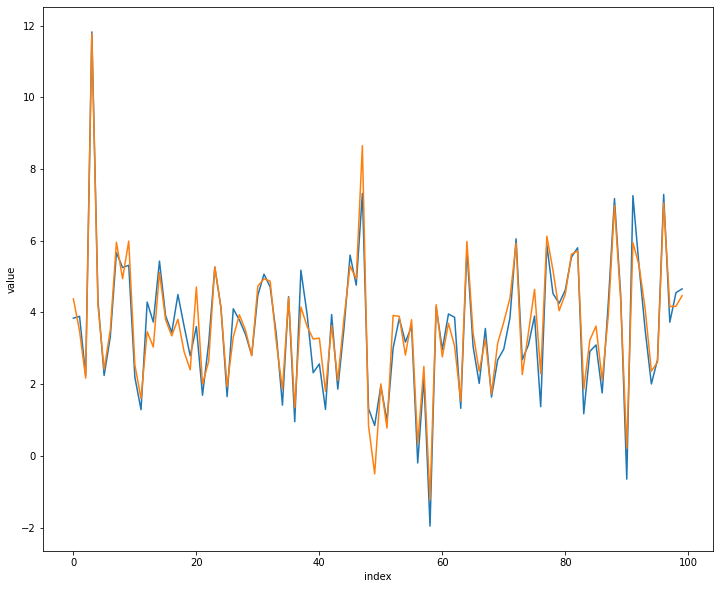

In [314]:
plt.figure(figsize=(12, 10))
plt.plot( np.arange(100),np.array(dataset.data.logP[100:200]))
plt.plot( np.arange(100),output_final[1].detach().numpy())
plt.xlabel("index")
plt.ylabel("value")
plt.show()

In [312]:
dataset.data.logP[0:100]

0     2.33400
1     4.94030
2     6.07540
3     3.13402
4     2.57720
       ...   
95    5.39984
96    2.62790
97    1.27480
98    2.75220
99    1.02050
Name: logP, Length: 100, dtype: float64

In [310]:
list(output_final[0].detach().numpy())

[2.6625514,
 5.000888,
 5.865478,
 2.7158356,
 2.385798,
 5.0131264,
 3.453425,
 5.3319235,
 5.191729,
 3.8566062,
 7.178326,
 5.2625904,
 4.775497,
 1.7460926,
 5.493828,
 2.7091599,
 3.8372912,
 3.7234933,
 -2.522631,
 3.8171034,
 5.828533,
 3.6807063,
 4.963017,
 3.0357153,
 4.494605,
 4.2471356,
 5.210596,
 4.50772,
 4.225171,
 1.8750583,
 1.800167,
 1.7862188,
 2.1378489,
 4.20982,
 3.468538,
 4.810623,
 1.4543873,
 1.5595921,
 4.4713316,
 5.1283703,
 1.6139803,
 2.7435482,
 3.1746237,
 3.0037608,
 5.454354,
 -0.17815952,
 4.242016,
 1.9323057,
 2.3111787,
 1.1146647,
 1.7790384,
 1.7823194,
 8.262423,
 4.484502,
 4.289953,
 3.610737,
 5.1384654,
 7.592121,
 2.403187,
 2.6612322,
 5.0205526,
 2.0581326,
 3.0231202,
 3.217106,
 1.8730034,
 7.668717,
 4.7157598,
 6.758793,
 5.7652855,
 4.913967,
 3.3820844,
 2.0714266,
 3.4904907,
 1.258295,
 5.5889277,
 -0.085878745,
 1.4862287,
 4.122387,
 2.8357453,
 2.2586758,
 6.375608,
 4.179485,
 2.9516618,
 5.6097994,
 5.075791,
 1.5380926,


In [292]:
output_final

[tensor([ 2.6867,  5.4413,  5.6161,  3.4051,  2.6300,  5.3187,  3.4673,  5.6223,
          5.3693,  3.2246,  8.2489,  5.6597,  4.5362,  2.6038,  5.5126,  2.3933,
          3.8214,  3.8950, -2.2904,  4.0778,  5.8236,  3.7355,  5.0670,  3.0468,
          4.5778,  4.4655,  5.2423,  4.7729,  4.3035,  1.2184,  1.8659,  1.5308,
          2.6064,  4.3604,  3.4988,  4.9734,  1.4858,  1.8147,  4.9137,  5.3945,
          1.7235,  2.9399,  3.3641,  3.0140,  5.5643, -0.1027,  4.2074,  2.0430,
          2.5802,  0.9462,  1.8229,  1.8553,  8.3335,  3.9108,  4.6644,  3.5685,
          5.2014,  7.4260,  3.1518,  2.6101,  4.9012,  3.0485,  2.8905,  3.0348,
          1.9731,  7.3893,  4.6593,  7.0791,  5.5594,  5.5900,  3.4670,  2.8623,
          3.2153,  1.4898,  5.7418,  0.4902,  1.7243,  3.9927,  3.1148,  2.5328,
          6.5676,  3.8925,  2.7015,  5.2921,  5.2982,  1.2844,  1.3015,  3.0972,
          1.5435,  4.1801,  3.6180,  4.4469,  5.7704,  5.1479,  4.9869,  5.5548,
          2.5874,  0.7486,  

array([ -8.6289897 ,   6.75514185, -12.92172095,   4.87639624,
       -10.52810565, -12.47643524,   7.22586532,  -5.1933742 ,
       -14.54718962, -33.45655918,  34.37782824, -34.7886802 ,
        12.94421664, -24.64894426, -14.18948841,   8.37011497,
        -7.33764409,  14.03376293,  -3.19196656, -16.30959442,
       -33.93155837,  24.23575109, -16.37151274, -12.68086272,
        11.19216135,  16.19299746,   8.86734772,  -3.20818261,
        23.84748483,  -5.16089116,  14.05446553,   3.31524683,
        30.88922405,  15.20461297,  -4.68579558, -13.25290367,
         9.41783597,  10.29028893, -19.89182943,  28.69747066,
         9.18799284, -35.27103996,  28.81368518,  -5.89985433,
        -4.95503606, -36.28837514, -23.70807785,  29.9929508 ,
        30.18728781,  31.60580194, -10.03107849,   2.32892953,
       -27.35339546,   9.94690415,  13.90924287,   6.19672437,
       -10.51712847, -29.18627483,  17.12929142,  17.40762973,
         5.20484498, -10.37483951,   3.34631103,   4.71

In [259]:
outputs.view(-1)

tensor([3.1218, 3.2941, 4.1541, 4.4272, 2.1778, 1.6259, 2.4384, 3.9962, 2.6499,
        2.8529, 3.5822, 3.6837, 4.2659, 3.1733, 5.5980, 3.1767, 2.2410, 3.3502,
        3.6923, 3.5308, 2.4443, 4.4702, 4.3696, 3.2239, 3.2631, 2.9590, 3.1235,
        1.7521, 3.1164, 2.8205, 2.9130, 4.1766, 3.1537, 3.3138, 3.9789, 2.5107,
        3.5338, 3.3097, 3.2767, 3.4802, 3.0623, 2.8934, 3.8183, 3.9121, 3.6761,
        2.2638, 1.9848, 3.3425, 4.4024, 3.6138, 2.5921, 3.6751, 2.3038, 3.6876,
        3.7478, 3.2700, 3.0713, 2.8435, 2.0230, 3.2267, 5.0214, 2.9108, 5.3575,
        2.9433, 4.0677, 3.1124, 3.0266, 3.5728, 4.2535, 2.6560, 3.1420, 2.5438,
        3.0256, 3.1316, 4.7789, 2.0837, 3.4743, 3.3392, 2.8634, 3.1182, 3.9466,
        2.8838, 3.2755, 2.7193, 3.3632, 2.5885, 3.3442, 2.4438, 3.3114, 3.4799,
        3.4798, 2.8417, 2.6342, 3.7802, 2.7008, 2.7971, 3.5103, 2.7338, 4.1459,
        4.5490], grad_fn=<ViewBackward0>)

In [173]:
frags = dataset.data.iloc[0].fragments.split()
frags

['*CCC',
 '*N(*)*',
 '*C(*)=O',
 '*C1OC(C(=O)O)=CC(N)C1*',
 '*N*',
 '*C(C)=O',
 '*CC*',
 '*c1cccc(*)c1',
 '*c1ccccc1']

In [209]:
frags = [vocab.translate(target_i) for target_i in tgt.cpu().detach().numpy()]
frags

[['*C(=O)C1=CN(*)C(N)=C(C#N)C1*',
  '*c1ccc2c(c1)OC(C)C(=O)N2',
  '*c1ccccc1S(=O)(=O)C1CCCC1',
  '*c1cc(Cl)cc2c1N=C(C)N(*)C2c1ccccc1',
  '*c1n[nH]c2c1C1(CCN(*)CC1)C(C#N)=C(N)O2',
  '*CC(N)C(*)C(O)CC(C)C',
  '*c1ccc2c(c1)OCC(*)O2',
  '*C1CC(=*)C2=Nc3ccccc3CN21',
  '*c1nc2c(C)c(*)ccc2[nH]1'],
 ['*c1cc(C)c(F)c(*)c1C', '*NC1=NC(=*)C(=O)N1C', '*c1nc2c(C)c(*)ccc2[nH]1'],
 ['*OP(=O)(O)CP(=O)(O)O',
  '*c1ccccc1S(=O)(=O)C1CCCC1',
  '*c1ccc(F)c(C)c1Cl',
  '*OP(=O)(O)CP(=O)(O)O',
  '*c1ccccc1S(=O)(=O)C1CCCC1',
  '*OP(=O)(O)CP(=O)(O)O',
  '*OP(=O)(O)CP(=O)(O)O',
  '*S(=O)(=O)c1c[nH]c2ccccc2c1=O'],
 ['*c1cccc2c1cc(C)n2*',
  '*C1CC(=O)N(*)C1=O',
  '*C1CC(C)(O)C2CC3C(C=C(C)C12)OC(=O)C31CC23C(=C(C)C1C2*)CC1C(=C)C(=O)OC1CC3C',
  '*c1n[nH]c2c1C1(CCN(*)CC1)C(C#N)=C(N)O2',
  '*c1ccccc1S(=O)(=O)C1CCCC1',
  '*c1cc2cc(Br)ccc2nc1*',
  '*c1c2ccccc2nn1C'],
 ['*C1CC(=O)NS1(=O)=O',
  '*c1cc2c(c(O)c1O)C(=O)N(*)C2',
  '*c1ccccc1S(=O)(=O)C1CCCC1',
  '*c1cc2c(c(N)n1)N=C(c1ccccc1)CN2',
  '*N1CCCC(N)CC1',
  '*c1nc2c(C)

In [220]:
vec_frag_sum = np.zeros(100)
vec_lst = fragment_unique_mol_df[fragment_unique_mol_df['smi'].isin(frags[0])].mol2vec.values
for vec_frag in vec_lst:
    vec_frag_sum += vec_frag.vec
vec_frag_sum

array([  -2.20161064,   19.19601718,  -21.31581789,  -21.97768891,
        -40.19002819,  -36.89092684,  -13.43147284,  -34.23211259,
        -23.30473268,  -61.77462602,   89.49489546,  -93.45982933,
         14.87619743,  -37.20333117,  -43.49377108,   17.6215452 ,
        -23.37700093,   47.39432693,   -9.76932961,  -54.2098794 ,
        -60.66191244,   53.15340829,  -53.02025509,   -0.57736793,
         25.64401375,   20.28443675,   14.31745362,  -23.50196868,
         37.29188848,    1.56353833,   -4.33600253,   15.88646412,
         92.17309427,   25.62181346,  -30.88299017,  -37.71537042,
         39.74276543,   50.60691047,  -57.13303399,   69.82825041,
         42.74644509,  -35.59534493,   40.92588758,  -41.92843139,
        -27.83123183,  -76.21686888,  -69.3210845 ,   52.08622527,
         88.63619995,   68.66393709,   18.02814609,    1.25141847,
        -39.2977221 ,   26.34845364,   27.62266183,   32.48484364,
        -16.77474999,  -74.29768419,   29.73089844,   26.31689

In [197]:
embeddings = np.loadtxt('RUNS/2022-09-22@16:54:31-LAPTOP-E1483HNR-CHEMBL/config/emb_100.dat', delimiter=",")

In [169]:
embeddings[tgt[0,1]]

array([-1.15497088,  0.90996087, -1.42921293, -0.1372115 ,  0.03035097,
       -1.02060533,  1.6947484 , -0.21036735, -1.15662158, -3.95128322,
        2.08756185, -4.08809137,  1.66906977, -2.67888165, -0.99639052,
        2.90094352, -1.21701646,  1.84033632, -0.34252813, -1.61875665,
       -3.26854086,  2.18694878, -0.1628349 , -2.08091879,  1.46717453,
        3.24858379,  1.69410896, -0.1445602 ,  3.3136282 , -0.63977331,
        1.24252248, -1.33437312,  2.37675881,  2.34911275, -0.26607016,
       -0.54193354, -0.30470169, -0.14557868, -1.20166516,  1.72311378,
       -0.7300266 , -3.66648269,  3.45607686,  0.32473016, -0.90476072,
       -3.15592647, -1.81951582,  4.83597994,  2.64261699,  3.06707788,
       -1.91297722, -1.09084821, -3.96243286,  1.86961877,  1.11388707,
       -0.26386485, -1.28814769, -4.12561226,  1.86287606,  3.2456069 ,
        2.13805437, -0.82427633, -0.33542758,  0.71319818, -5.27591181,
        0.75239599, -0.5933795 ,  2.12202644, -3.61084867,  1.05

In [193]:
embeddings[13846]

array([  1.50048971,   0.89168763,  -2.25434589,  -1.2642591 ,
        -4.32741213,  -4.98268223,  -4.99969435,  -4.76879358,
        -2.79317617,  -9.96382809,  14.2046299 ,  -5.18963575,
         1.42506611,  -5.10037899,  -3.68242049,  -0.70115912,
        -2.95173597,   5.70823622,  -2.43735576,  -7.55544186,
        -8.00965881,   8.91277409,  -5.29750824,   1.73836327,
         3.72865009,   4.41175032,  -1.25580156,  -4.51385355,
         3.9074111 ,   0.66058415,   0.21184519,   8.52279758,
        15.79250336,   2.02494287,  -4.92858219,  -5.33537912,
         5.2055831 ,   4.4261055 ,  -3.92738605,  10.04022217,
         6.50409365,  -9.40114689,   3.37233615,  -6.88946342,
         2.15400338,  -9.91382217,  -8.88764   ,   5.42366028,
        14.70736599,   5.21120787,   6.77170229,   3.54399633,
        -0.47203001,   3.43759394,   2.47773004,   4.02318192,
         0.51967663,  -4.47389317,   7.22114468,   1.45056105,
        -3.18330765,  -5.12173843,   1.77409744,   4.48

In [179]:
fragment_unique_mol_df[fragment_unique_mol_df['smi'] == frags[0]].mol2vec.values[0].vec

array([ 1.573924  ,  0.41818818, -0.6389855 ,  0.35555547, -0.6931618 ,
       -1.8895179 , -0.3049182 , -0.93033946, -0.7940564 , -2.6348755 ,
        0.8723773 , -3.36938   ,  2.73131   , -1.722887  , -1.4464583 ,
        1.2797434 , -0.54276514,  2.1150258 , -0.1676904 , -0.5675534 ,
       -2.0919635 ,  2.1249492 ,  0.18996736,  0.8922026 ,  1.1432853 ,
        1.0663826 , -0.53125024, -0.5785559 ,  2.5698214 , -1.892367  ,
        0.896377  ,  0.88489556,  2.513519  ,  0.7140584 , -2.4322603 ,
       -1.394196  ,  2.097972  ,  1.3207531 , -0.6521326 ,  2.0526845 ,
       -0.19246358, -2.1339006 ,  3.3845496 ,  0.21956062, -1.0943304 ,
       -2.181898  , -3.34267   ,  2.5461714 ,  2.6457126 ,  1.3915173 ,
        2.1268368 ,  0.3557208 , -1.6185842 ,  0.430377  ,  0.07613348,
        0.15427399, -0.888803  , -1.4657967 ,  1.4825233 ,  0.5939198 ,
        0.596606  , -1.3763062 ,  0.3983077 ,  0.91996384, -3.4231522 ,
       -0.51138806,  0.40389144,  1.1462423 , -2.05734   ,  0.77

In [183]:
fragment_unique_mol_df[fragment_unique_mol_df['smi'] == frags[0]]

,mol,smi,sentence,mol2vec
13846,"<img data-content=""rdkit/molecule"" src=""data:i...",*CCC,"(2342113506, 1302073591, 2245384272, 154794914...","(100,) dimensional vector"


In [184]:
fragment_unique_mol_df

,mol,smi,sentence,mol2vec
0,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1ccc2c(c1)OC(C)(C)C2,"(2342113506, 2207093323, 3217380708, 853890546...","(100,) dimensional vector"
1,"<img data-content=""rdkit/molecule"" src=""data:i...",*n1c2ccccc2c2ccc(C=*)cc21,"(2342113506, 1119552904, 2092489639, 381202549...","(100,) dimensional vector"
2,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1cc(*)c(*)c([N+](=O)[O-])c1,"(2342113506, 2207093323, 3217380708, 853890546...","(100,) dimensional vector"
3,"<img data-content=""rdkit/molecule"" src=""data:i...",*CC(C)(C)C(*)=O,"(2342113506, 1302073591, 2245384272, 135205987...","(100,) dimensional vector"
4,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1nc2c(c(=O)[nH]1)CCN(*)C2,"(2342113506, 2207093323, 3217380708, 200863697...","(100,) dimensional vector"
...,...,...,...,...
35110,"<img data-content=""rdkit/molecule"" src=""data:i...",*c1c2c(=O)n(C)c(=O)n(C)c2nn1C,"(2342113506, 2207093323, 3217380708, 199809797...","(100,) dimensional vector"
35111,"<img data-content=""rdkit/molecule"" src=""data:i...",*C(=O)CC1=CC(=*)c2ccc(F)cc21,"(2342113506, 1298690312, 2246699815, 220963359...","(100,) dimensional vector"
35112,"<img data-content=""rdkit/molecule"" src=""data:i...",*N1CC(F)C1,"(2342113506, 1119552904, 2092489639, 755089492...","(100,) dimensional vector"
35113,"<img data-content=""rdkit/molecule"" src=""data:i...",*CN1CCC(*)C(O)C1,"(2342113506, 1302073591, 2245384272, 229702845...","(100,) dimensional vector"


In [188]:
vocab.w2i['*CCC']

29660

In [195]:
config = pickle.load(open('RUNS/2022-09-22@16:54:31-LAPTOP-E1483HNR-CHEMBL/config/config.pkl', "rb"))
vocab = pickle.load(open('RUNS/2022-09-22@16:54:31-LAPTOP-E1483HNR-CHEMBL/config/vocab.pkl', "rb"))
dataset = FragmentDataset(config)
vocab = dataset.get_vocab()
loader = dataset.get_loader()

Vocab created/loaded. Size: 35118. Effective size: 35118. Time elapsed: 00:00:00.
Data loaded. Size: 103684. Time elapsed: 00:00:00.


/home/teddy_t/miniconda3/lib/python3.9/site-packages/torch/utils/data/dataloader.py:487: UserWarning: This DataLoader will create 24 worker processes in total. Our suggested max number of worker in current system is 8, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [198]:
embeddings[tgt[0,1]]

array([ 1.30182326e-01,  4.03652906e+00, -1.03766799e+00, -1.41009283e+00,
       -3.93169689e+00, -2.09493613e+00, -2.88216543e+00, -3.85305285e+00,
       -1.98403823e+00, -3.87053609e+00,  7.31783342e+00, -7.91515064e+00,
        9.09175515e-01, -4.77213860e+00, -4.59841681e+00,  2.67298913e+00,
       -3.36991072e+00,  4.29642916e+00,  1.05694842e+00, -5.07634211e+00,
       -5.16008615e+00,  6.02957582e+00, -7.22855043e+00, -8.77175212e-01,
        7.89610386e-01,  1.50446379e+00,  1.14819765e-01, -1.23877811e+00,
        4.21226835e+00, -1.14328945e+00, -1.79038012e+00,  2.16208100e+00,
        9.94443417e+00,  1.85679734e+00, -4.72455645e+00, -3.35209584e+00,
        5.02421951e+00,  8.37476635e+00, -2.21220136e+00,  5.73677158e+00,
        5.29998922e+00,  4.52360928e-01,  3.40389061e+00, -3.24510384e+00,
       -2.36557221e+00, -6.82740879e+00, -7.44594240e+00,  3.22407341e+00,
        5.92257118e+00,  8.79358959e+00,  2.02055216e+00, -6.13650501e-01,
       -3.47721815e+00,  

## Reconstruct Molecules

In [6]:
from molecules.fragmentation import join_molecules
from rdkit.Chem import Crippen, QED
from molecules.sascorer.sascorer import calculateScore

In [55]:
df_train = pd.read_csv('DATA/CHEMBL/PROCESSED/train - recurse full.smi')
df_train

,Unnamed: 0,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,DOUBLE,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS
0,0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O *CC...,5.0,26,0,3,5,0,26,10,0,0,0,0,3,2.33400,128.6249,0.522569,3.595745
1,1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,11,0,0,0,1,3,4.94030,112.9455,0.638566,2.563412
2,2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(Cl)c(OC)c(C(=O)OC)...,4.0,25,0,0,7,3,26,10,0,0,0,0,2,6.07540,138.1390,0.264467,2.973098
3,3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,10,0,0,0,0,4,3.13402,124.9069,0.395442,3.145495
4,4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,11,0,0,0,1,3,2.57720,116.8143,0.513201,2.494430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1090456,1090456,COc1ccc2c(OCc3nnc4ccc(-c5cc(C)no5)cn34)ccnc2c1,*OC *c1ccc2c(*)ccnc2c1 *O* *C* *c1ccc2nnc(*)n2...,6.0,21,0,5,3,0,22,11,0,0,0,2,3,3.82852,105.8480,0.452799,2.604622
1090457,1090457,N#CC(=C1Nc2ccccc2S1)c1ccnc(NCCc2cccc(F)c2)n1,*c1nccc(C(C#N)=C2Nc3ccccc3S2)n1 *N* *CC* *c1cc...,4.0,21,1,5,0,1,20,10,1,0,0,1,3,4.68028,109.0804,0.617420,2.715200
1090458,1090458,O=C(O)CCc1ccc(-c2c(C=Cc3ccc4ccccc4n3)nc3c(N4CC...,*CCC(=O)O *c1ccc(*)nc1 *c1c(C=*)nc2c(N3CCOCC3)...,4.0,29,0,6,3,0,29,14,0,0,0,1,5,4.36370,145.8778,0.347080,3.065345
1090459,1090459,CCOCCc1ccc(OCCNC(=O)c2cc(C(C)(C)C)nn2C)c(C)c1,*CC *O* *CC* *c1ccc(*)c(C)c1 *O* *CC* *N* *C(*...,10.0,22,0,3,3,0,23,6,0,0,0,1,1,3.41382,111.1122,0.669825,2.398846


In [85]:
recombined_smiles = []
recombined_logP = []
recombined_mr = []
recombined_qed = []
recombined_sas = []
for frags in tqdm(df_train.fragments):
    frags = mols_from_smiles(frags.split())
    try:
        mol = join_molecules(frags[0], frags[1])
        for i, frag in enumerate(frags[2:]):
            #print(i, mol_to_smiles(frag), mol_to_smiles(mol))
            mol = join_molecules(mol, frag)
            #print(i, mol_to_smiles(mol))
        recombined_smiles.append(mol_to_smiles(mol))
        
        try:
            recombined_logP.append(Crippen.MolLogP(mol))
        except:
            recombined_logP.append(float("nan"))

        try:
            recombined_mr.append(Crippen.MolMR(mol))
        except:
            recombined_mr.append(float("nan"))

        try:
            recombined_qed.append(QED.qed(mol))
        except:
            recombined_qed.append(float("nan"))

        try:
            recombined_sas.append(calculateScore(mol))
        except:
            recombined_sas.append(float("nan"))
    except:
        print("error in joining")
        recombined_smiles.append(float("nan"))
        recombined_logP.append(float("nan"))
        recombined_mr.append(float("nan"))
        recombined_qed.append(float("nan"))
        recombined_sas.append(float("nan"))


  0%|          | 0/1090461 [00:00<?, ?it/s][16:31:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:31:46] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
  0%|          | 15/1090461 [00:00<2:08:27, 141.48it/s][16:31:46] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:31:46] Can't kekulize mol.  Unkekulized atoms: 7 8 16 17 23
[16:31:46] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:31:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:31:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:31:46] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:31:46] Explicit valence for atom # 15 O, 3, is greater than permitted
  0%|          | 37/1090461 [00:00<1:39:50, 182.02it/s][16:31:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31

  0%|          | 304/1090461 [00:01<1:36:00, 189.24it/s][16:31:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:31:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:31:47] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:31:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 28 29 30
[16:31:47] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[16:31:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:31:47] Can't kekulize mol.  Unkekulized atoms: 3 18 19
[16:31:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:31:47] Explicit valence for atom # 5 O, 3, is greater than permitted
  0%|          | 328/1090461 [00:01<1:29:29, 203.04it/s][16:31:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:31:47] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:31:47] Can't kekulize mol.  Unkekulized atoms: 14 15 16 18 19 21 22
[16:31:48] Can't kekulize mol.  Unkekulized at

  0%|          | 583/1090461 [00:02<1:18:24, 231.65it/s][16:31:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:31:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:31:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 7 8
[16:31:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:31:49] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:31:49] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8
[16:31:49] Explicit valence for atom # 1 C, 5, is greater than permitted
  0%|          | 607/1090461 [00:02<1:18:11, 232.28it/s][16:31:49] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 31
[16:31:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:31:49] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:31:49] Explicit valence for atom # 4 C, 5, is greater than 

  0%|          | 881/1090461 [00:04<1:25:29, 212.42it/s][16:31:50] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:31:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:50] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:31:50] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:31:50] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:31:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:50] Explicit valence for atom # 1 C, 5, is greater than permitted
  0%|          | 904/1090461 [00:04<1:24:16, 215.47it/s][16:31:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:50] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:31:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:31:50] Can't kekulize mol.  

  0%|          | 1177/1090461 [00:05<1:25:09, 213.20it/s][16:31:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:31:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:31:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[16:31:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:31:52] Explicit valence for atom # 1 C, 5, is greater than permitted
  0%|          | 1199/1090461 [00:05<1:24:40, 214.42it/s][16:31:52] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:31:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:31:52] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:31:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:31:52] Explicit valence for ato

  0%|          | 1546/1090461 [00:07<1:22:25, 220.19it/s][16:31:53] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:31:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:31:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:31:53] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:31:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:31:53] Explicit valence for atom # 5 C, 5, is greater than permitted
  0%|          | 1569/1090461 [00:07<1:23:34, 217.14it/s][16:31:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:31:53] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:31:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:53] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:31:53] Explicit valence 

  0%|          | 1848/1090461 [00:08<1:17:31, 234.03it/s][16:31:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:31:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:31:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:31:55] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:31:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:55] Can't kekulize mol.  Unkekulized atoms: 1 2 21
  0%|          | 1872/1090461 [00:08<1:19:57, 226.89it/s][16:31:55] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:31:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:31:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:31:55] Can't kekulize mol.  Unkekulized atoms: 7 8 9 11 12 14 15 16 17 18 19 20 21 22 23
[16:31:55] 

****
Pre-condi

  0%|          | 2136/1090461 [00:09<1:25:08, 213.04it/s][16:31:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:31:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:31:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 31
  0%|          | 2158/1090461 [00:10<1:24:48, 213.87it/s][16:31:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:31:56] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:31:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:31:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 29 30
[16:31:56] Can't kekulize mol.  Unkekulized atoms: 11 12 13 16 17 18
[16:31:56] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[16:31:56] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:31:56] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:31:56] Explicit valence for atom # 3 F, 2, is greater tha

  0%|          | 2409/1090461 [00:11<1:16:29, 237.05it/s][16:31:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:31:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:31:57] Explicit valence for atom # 8 C, 5, is greater than permitted
  0%|          | 2433/1090461 [00:11<1:20:43, 224.63it/s][16:31:57] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:31:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:31:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:31:57] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:31:57] Explicit valence for atom # 3 C, 5, is greater than permitted
  0%|          | 2456/1090461 [00:11<1:22:09, 220.72it/s][16:31:57] Can't kekulize mol.  Unkekulized atoms: 3 7 9 10 11
[16:31:57] Explicit valence for atom # 3

  0%|          | 2780/1090461 [00:12<1:22:45, 219.06it/s][16:31:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:31:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:31:59] Can't kekulize mol.  Unkekulized atoms: 8 40
[16:31:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:31:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  0%|          | 2802/1090461 [00:12<1:23:02, 218.28it/s][16:31:59] Can't kekulize mol.  Unkekulized atoms: 9 11
[16:31:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:31:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:31:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:31:59] Can't kekulize mol.  Unkekulized atoms: 10 11 12 25 26 28 31
[16:31:59] 

****
Pre-condition Violation
RingIn

  0%|          | 3132/1090461 [00:14<1:16:02, 238.33it/s][16:32:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:00] Can't kekulize mol.  Unkekulized atoms: 4 6
[16:32:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:00] Can't kekulize mol.  Unkekulized atoms: 1 2 38
[16:32:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:00] Can't kekulize mol.  Unkekulized atoms: 10 13
[16:32:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:32:00] Can't kekulize mol.  Unkekulized atoms: 22 23 24 25 27
[16:32:00] Can't kekulize mol.  Unkekulized atoms: 2 21 22
[16:32:00] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[16:32:00] Can't kekulize mol.  Unkekulized atoms: 1 2 36
[16:32:00] Explicit valence for atom # 20 O, 3, is greater than permitted
  0%|          | 3157/1

  0%|          | 3428/1090461 [00:15<1:19:25, 228.10it/s][16:32:02] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:32:02] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:32:02] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:32:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24
[16:32:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:02] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17 31 33
  0%|          | 3452/1090461 [00:15<1:19:04, 229.10it/s][16:32:02] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:32:02] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:02] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 25
[16:32:02] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[16:32:02] Can't kekulize mol.  Unkekulized atoms: 5 7
  0%|          | 3475/1090461 [00:15<1:19:32, 227.78it/s][16:32:02] 

  0%|          | 3761/1090461 [00:17<1:25:08, 212.71it/s][16:32:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:03] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:32:03] Can't kekulize mol.  Unkekulized atoms: 1 2 10
[16:32:03] Explicit valence for atom # 6 O, 3, is greater than permitted
  0%|          | 3784/1090461 [00:17<1:23:22, 217.23it/s][16:32:03] Explicit valence for atom # 16 C, 5, is greater than permitted
[16:32:03] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:32:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:03] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[16:32:03] Explicit valence for atom # 5 O, 3, is greater than permitted
  0%|          | 3806/1090461 [00:17<1:23:16, 

  0%|          | 4127/1090461 [00:18<1:21:56, 220.96it/s][16:32:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 27 28
[16:32:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:05] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:32:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:05] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:32:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
[16:32:05] Explicit valence for atom # 5 O, 3, is greater than permitted
  0%|          | 4150/1090461 [00:18<1:23:27, 216.95it/s][16:32:05] Can't kekulize mol.  Unkekulized atoms: 7 8 19
[16:32:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:05] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:32:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /projec

  0%|          | 4434/1090461 [00:20<1:27:16, 207.40it/s][16:32:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:32:06] Explicit valence for atom # 30 C, 5, is greater than permitted
[16:32:06] Can't kekulize mol.  Unkekulized atoms: 4 5 17
[16:32:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:06] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:32:06] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 17
[16:32:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:06] Explicit valence for atom # 12 O, 3, is greater than permitted
  0%|          | 4455/1090461 [00:20<1:32:17, 196.11it/s][16:32:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:32:06] Explicit valence for atom # 4 N, 4, is greater than permitted
[16:32:06] 

****
Pre-condition Violation
Ri

  0%|          | 4735/1090461 [00:21<1:22:01, 220.59it/s][16:32:07] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:32:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:07] Can't kekulize mol.  Unkekulized atoms: 13 14 15
[16:32:08] Explicit valence for atom # 10 C, 5, is greater than permitted
  0%|          | 4758/1090461 [00:21<1:23:57, 215.54it/s][16:32:08] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15 17 18
[16:32:08] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:32:08] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18 20 21
[16:32:08] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:32:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:08] Explicit valence for atom # 4 O, 3, is great

  0%|          | 5322/1090461 [00:24<1:17:29, 233.37it/s][16:32:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:32:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24 25 26
[16:32:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 9 10 11 12 20 21
[16:32:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 16
[16:32:10] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 24 25 26
[16:32:10] Can't kekulize mol.  Unkekulized atoms: 2 3 29
  0%|          | 5347/1090461 [00:24<1:16:44, 235.65it/s][16:32:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:10] Can't kekulize mol.  Unkekulized atoms: 6 9
[16:32:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[16:32:10] Explicit valence for atom # 7 O, 3, is greater than pe

  1%|          | 5620/1090461 [00:25<1:17:22, 233.70it/s][16:32:11] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:32:11] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 14 15 17
[16:32:11] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[16:32:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:32:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:11] Can't kekulize mol.  Unkekulized atoms: 7 8 10 12 14
[16:32:11] Explicit valence for atom # 16 C, 5, is greater than permitted
[16:32:11] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 15
  1%|          | 5646/1090461 [00:25<1:16:10, 237.33it/s][16:32:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Ex

  1%|          | 5891/1090461 [00:26<1:20:25, 224.75it/s][16:32:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[16:32:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:12] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17 18 19 20 28
[16:32:12] Can't kekulize mol.  Unkekulized atoms: 0 1 16
[16:32:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:13] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:32:13] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:32:13] Explicit valence for atom # 6 O, 3, is greater than permitted
  1%|          | 5917/1090461 [00:26<1:16:59, 234.79it/s][16:32:13] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:32:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:13] Explicit valence

  1%|          | 6190/1090461 [00:27<1:17:05, 234.40it/s][16:32:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 38
[16:32:14] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:32:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[16:32:14] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:32:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:14] Can't kekulize mol.  Unkekulized atoms: 2 3 11 14 31
[16:32:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[16:32:14] Explicit valence for atom # 1 C, 5, is greater than permitted
  1%|          | 6215/1090461 [00:27<1:16:39, 235.72it/s][16:32:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[16:32:14] 

  1%|          | 6473/1090461 [00:28<1:10:19, 256.92it/s][16:32:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:15] Can't kekulize mol.  Unkekulized atoms: 10 14 15 16 17 18 19 20 28
[16:32:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:15] Can't kekulize mol.  Unkekulized atoms: 8 10 20
[16:32:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurre

  1%|          | 6739/1090461 [00:30<1:15:38, 238.76it/s][16:32:16] Can't kekulize mol.  Unkekulized atoms: 5 7 22
[16:32:16] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:32:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:16] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:32:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:16] Explicit valence for atom 

  1%|          | 7035/1090461 [00:31<1:16:42, 235.39it/s][16:32:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:32:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:32:17] Can't kekulize mol.  Unkekulized atoms: 2 3 18 19 20
  1%|          | 7059/1090461 [00:31<1:24:19, 214.15it/s][16:32:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:32:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:17] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:32:17] Explicit valence for atom

  1%|          | 7331/1090461 [00:32<1:20:38, 223.84it/s][16:32:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:19] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:32:19] Can't kekulize mol.  Unkekulized atoms: 6 35
[16:32:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:32:19] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[16:32:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[16:32:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:32:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:32:19] Explicit valence for atom # 7 O, 3, is greater than permitted
  1%|          | 7356/1090461 [00:32<1:18:29, 229.96it/s][16:32:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:32:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:19] Explicit valence for atom # 1 C, 5, is greater 

  1%|          | 7638/1090461 [00:33<1:15:16, 239.75it/s][16:32:20] Can't kekulize mol.  Unkekulized atoms: 8 11 13 14 15 16 17 18 19
[16:32:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:20] Explicit valence for atom # 16 O, 3, is greater than permitted
  1%|          | 7663/1090461 [00:34<1:16:42, 235.25it/s][16:32:20] Explicit valence for atom # 28 C, 5, is greater than permitted
[16:32:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 9 21 22
[16:32:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:32:20] Exp

  1%|          | 7932/1090461 [00:35<1:21:45, 220.67it/s][16:32:21] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:32:21] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[16:32:21] Can't kekulize mol.  Unkekulized atoms: 2 3 10 13 47
[16:32:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:32:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:32:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:21] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:32:21] 

****
Pre-condi

  1%|          | 8291/1090461 [00:36<1:21:29, 221.34it/s][16:32:23] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:32:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[16:32:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:23] Can't kekulize mol.  Unkekulized atoms: 12 13 14
[16:32:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:23] Explicit valence for atom # 14 C, 5, is greater than permitted
  1%|          | 8316/1090461 [00:36<1:19:29, 226.89it/s][16:32:23] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:32:23] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:23] Explicit valence for atom

  1%|          | 8595/1090461 [00:38<1:18:49, 228.73it/s][16:32:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:24] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:32:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:24] Explicit valence for atom # 13 O, 3, is greater than permitted
  1%|          | 8619/1090461 [00:38<1:18:56, 228.38it/s][16:32:24] Can't kekulize mol.  Unkekulized atoms: 8 34
[16:32:24] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 33
[16:32:24] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:24] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:32:24] Can't kekulize mol.  Unkekulized atoms: 12 14
[16:32:24] 

****
Pre-condition Violation
Ring

  1%|          | 8867/1090461 [00:39<1:16:12, 236.54it/s][16:32:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[16:32:25] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:32:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 9 10 11 12 21 22
[16:32:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 18
[16:32:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:25] Explicit valence for atom # 5 C, 5, is greater than permitted
  1%|          | 8893/1090461 [00:39<1:15:13, 239.61it/s][16:32:25] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:32:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:25] Can't kekulize mol.  Unkekulized atoms: 4 6 11 12 13 14
[16:32:25] Explicit valence

  1%|          | 9160/1090461 [00:40<1:18:35, 229.32it/s][16:32:26] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[16:32:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:26] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:32:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[16:32:26] Can't kekulize mol.  Unkekulized atoms: 1 2 20
  1%|          | 9185/1090461 [00:40<1:16:47, 234.68it/s][16:32:27] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:32:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:27] Can't kekulize mol.  Unkekulized atoms: 2 3 19 20 21
[16:3

  1%|          | 9480/1090461 [00:41<1:12:05, 249.91it/s][16:32:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:28] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:32:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:28] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:28] Explicit valence for atom # 11 O, 3, is greater than permitted
  1%|          | 9506/1090461 [00:42<1:14:47, 240.91it/s][16:32:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:32:28] Explicit va

  1%|          | 9776/1090461 [00:43<1:17:03, 233.71it/s][16:32:29] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:32:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:29] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 22 23
[16:32:29] Explicit valence for atom # 11 O, 3, is greater than permitted
  1%|          | 9800/1090461 [00:43<1:19:02, 227.88it/s][16:32:29] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:32:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[16:32:29] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:32:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:29] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[16:32:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:29] Explicit valence for atom # 8 O, 3, is greater than permitted
  1%|          | 9823/1090461 [00:43<1:21:11, 221.83it/

  1%|          | 10139/1090461 [00:44<1:19:41, 225.92it/s][16:32:31] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:32:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:31] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:32:31] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:32:31] Explicit valence for atom # 4 C, 5, is greater than permitted
  1%|          | 10162/1090461 [00:44<1:20:45, 222.94it/s][16:32:31] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:32:31] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:32:31] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:32:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/r

  1%|          | 10396/1090461 [00:45<1:16:37, 234.94it/s][16:32:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:32:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:32:32] Can't kekulize mol.  Unkekulized atoms: 1 2 10 34 35
  1%|          | 10420/1090461 [00:45<1:19:58, 225.09it/s][16:32:32] Can't kekulize mol.  Unkekulized atoms: 2 12 16
[16:32:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:32] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:32:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:32] Can't kekulize mol.  Unkekulized atoms: 9 11 12
  1%|          | 10443/1090461 [00:46<1:20:30, 223.57it/s][16:32:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:32:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 40 41
[16:32:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[16

  1%|          | 10735/1090461 [00:47<1:13:41, 244.20it/s][16:32:33] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:32:33] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10
[16:32:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:33] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:32:33] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:32:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:32:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:33] Can't kekulize mol.  Unkekulized atoms: 2 24 25
[16:32:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:33] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:32:33] Explicit valence for atom # 10 C, 5, is gre

  1%|          | 11041/1090461 [00:48<1:16:07, 236.33it/s][16:32:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:34] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:32:34] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:32:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[16:32:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:35] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:32:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:35] Explicit valence for atom # 1 C, 6, is greater than permitted
  1%|          | 11067/1090461 [00:48<1:14:03, 242.94it/s][16:32:35] Expli

  1%|          | 11386/1090461 [00:50<1:18:08, 230.15it/s][16:32:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:36] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:32:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:36] Can't kekulize mol.  Unkekulized atoms: 8 13 14 15 16 17 18
[16:32:36] Can't kekulize mol.  Unkekulized atoms: 7 9
  1%|          | 11410/1090461 [00:50<1:19:38, 225.83it/s][16:32:36] Can't kekulize mol.  Unkekulized atoms: 3 14 22
[16:32:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:36] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[16:32:36] Explicit valence for atom # 17 O, 3, is greater th

  1%|          | 11694/1090461 [00:51<1:20:37, 223.02it/s][16:32:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:32:37] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:32:37] Explicit valence for atom # 12 O, 3, is greater than permitted
  1%|          | 11719/1090461 [00:51<1:18:15, 229.73it/s][16:32:37] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[16:32:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:37] Can't kekulize mol.

  1%|          | 12018/1090461 [00:52<1:23:32, 215.13it/s][16:32:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:32:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[16:32:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:39] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:32:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:39] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:32:39] Explicit valence for atom # 23 C, 5, is greater than permitted
  1%|          | 12040/1090461 [00:53<1:23:23, 215.51it/s][16:32:39] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 12
[16:32:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:32:39] Can't kekulize mol.  Unkekulized atoms: 4 5 25
[16:32:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:39] Can't kekulize mol.  Unkekulized atoms: 4 15
[16:32:39] Explicit valence for atom # 7 O, 3, is greater

  1%|          | 12322/1090461 [00:54<1:16:43, 234.19it/s][16:32:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:40] Can't kekulize mol.  Unkekulized atoms: 3 15 16 17 18
[16:32:40] Explicit valence for atom # 31 O, 3, is greater than permitted
[16:32:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 27
[16:32:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:40] Can't kekulize mol.  Unkekulized atoms: 3 6 20 22 23 24 25 26 27
[16:32:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:40] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:32:40] Explicit valence for atom # 15 O, 3, is greater than permitted
  1%|          | 12348/1090461 [00:54<1:14:42, 240.51it/s][16:32:40] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:32:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on l

  1%|          | 12615/1090461 [00:55<1:17:58, 230.38it/s][16:32:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:41] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:32:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7
  1%|          | 12639/1090461 [00:55<1:22:32, 217.62it/s][16:32:42] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:42] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:32:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:32:42] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:32:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:42] Explicit valence for atom # 6 O, 3, is greater than permitted
  1%|          | 12663/1090461 [00:55<

  1%|          | 12957/1090461 [00:57<1:13:28, 244.41it/s][16:32:43] Can't kekulize mol.  Unkekulized atoms: 1 2 4 30 31 32 33
[16:32:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:43] Can't kekulize mol.  Unkekulized atoms: 17 18 19
  1%|          | 12982/1090461 [00:57<1:19:03, 227.16it/s][16:32:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:32:43] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:32:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:43] Can't kekulize mol.  Unkekulized atoms: 11
[16:32:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:43] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 11 12 13 14 15 16
[16:32:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:43] Explicit valence for atom #

  1%|          | 13311/1090461 [00:58<1:14:06, 242.26it/s][16:32:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 26 27
[16:32:44] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:44] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:32:44] Explicit valence for atom # 4 O, 3, is greater than permitted
  1%|          | 13336/1090461 [00:58<1:18:19, 229.18it/s][16:32:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:44] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 11 12 13
[16:32:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:44] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:32:44] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:32:45] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:32:45] Can't kekulize mol.  Unkekulized atoms: 18 21
[16:32:45] Can't kekulize mol.  Unkekulized atoms: 

  1%|          | 13614/1090461 [00:59<1:19:54, 224.62it/s][16:32:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:32:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:46] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 37
[16:32:46] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 30
  1%|▏         | 13638/1090461 [00:59<1:19:31, 225.67it/s][16:32:46] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:32:46] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:32:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:46] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:46] Explicit valence for atom # 6 O, 3, is greater than permitted
  1%|▏         | 13662/

  1%|▏         | 13948/1090461 [01:01<1:21:26, 220.32it/s][16:32:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:32:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:47] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:32:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:47] Can't kekulize mol.  Unkekulized atoms: 1 2 16
  1%|▏         | 13973/1090461 [01:01<1:19:15, 226.36it/s][16:32:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:47] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:32:47] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:32:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:47] Explicit valence for atom # 7 O, 3, is grea

  1%|▏         | 14245/1090461 [01:02<1:14:45, 239.95it/s][16:32:48] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:32:48] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 21
[16:32:48] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:32:48] Explicit valence for atom # 36 N, 5, is greater than permitted
[16:32:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 18
[16:32:49] Explicit valence for atom # 1 C, 5, is greater than permitted
  1%|▏         | 14270/1090461 [01:02<1:17:00, 232.90it/s][16:32:49] Can't kekulize mol.  Unkekulized atoms: 4 8 9 10 11 12 13
[16:32:49] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:32:49] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 16 17 18 19
[16:32:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:49] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 8

  1%|▏         | 14518/1090461 [01:03<1:14:12, 241.68it/s][16:32:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:32:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 22 23
[16:32:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:50] Explicit valence for atom # 4 N, 5, is greater than permitted
[16:32:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 19 27 28
[16:32:50] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:50] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:50] Explicit valence for atom # 19 O, 3, is greater than permitted
  1%|▏         | 14544/1090461 [01:03<1:13:08, 245.17it/s][16:32:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:32:50] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:32:50] Can

  1%|▏         | 14840/1090461 [01:05<1:14:14, 241.47it/s][16:32:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:51] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[16:32:51] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:32:51] Explicit valence for atom # 12 C, 5, is greater than permitted
  1%|▏         | 14865/1090461 [01:05<1:14:23, 240.99it/s][16:32:51] Can't kekulize mol.  Unkekulized atoms: 1 2 36
[16:32:51] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:32:51] Can't kekulize mol.  Unkekulized atoms: 6 15
[16:32:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:32:51] Can't kekulize mol.  Unkekulized atoms: 1 2

  1%|▏         | 15094/1090461 [01:06<1:13:52, 242.58it/s][16:32:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:32:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 18
[16:32:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:32:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20
[16:32:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  1%|▏         | 15119/1090461 [01:06<1:16:32, 234.13it/s][16:32:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:32:52] Can't kekulize mol.  Unkekulized atoms: 9 11
  1%|▏         | 15143/1090461 [01:06<1:17:51, 230.19it/s][16:32:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:52] Explicit valence for atom # 18 O, 3, is greater t

  1%|▏         | 15424/1090461 [01:07<1:15:40, 236.76it/s][16:32:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:53] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 29 34 35
[16:32:53] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:32:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:32:54] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:32:54] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 25 26 27
[16:32:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:32:54] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:32:54] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:32:54] Can't kekulize mol.  Unkekulized atoms: 8 21
[16:32:54] Explicit valence 

  1%|▏         | 15752/1090461 [01:09<1:17:07, 232.26it/s][16:32:55] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:32:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:55] Explicit valence for atom # 36 O, 3, is greater than permitted
[16:32:55] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26
[16:32:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:32:55] Can't kekulize mol.  Unkekulized atoms: 6 7 10
  1%|▏         | 15776/1090461 [01:09<1:17:11, 232.04it/s][16:32:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 19 20
[16:32:55] Can't kekulize mol.  Unkek

  1%|▏         | 16066/1090461 [01:10<1:19:49, 224.30it/s][16:32:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:32:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:56] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:32:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:56] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:32:56] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:32:56] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:32:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  1%|▏         | 16091/1090461 [01:10<1:17:42, 230.44it/s][16:32:56] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:32:56] Can't kekulize mol.  Unkekulized atom

  1%|▏         | 16336/1090461 [01:11<1:17:48, 230.06it/s][16:32:57] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:32:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:32:57] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[16:32:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:32:57] Can't kekulize mol.  Unkekulized atoms: 3 7 8 9 11 12 13
[16:32:57] Can't kekulize mol.  Unkekulized atoms: 4 6
[16:32:58] Explicit valence for atom # 3 O, 3, is greater than permitted
  2%|▏         | 16361/1090461 [01:11<1:15:58, 235.60it/s][16:32:58] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:32:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:32:58] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:32:58] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:32:58] Can't kekulize mol.  Unkekulized atoms: 4 5 6 26 27
[16:32:58] Can't kekulize mol.  Unkekulized atoms: 1 2 39
[16:3

  2%|▏         | 16681/1090461 [01:13<1:22:50, 216.02it/s][16:32:59] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[16:32:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:32:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:32:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:32:59] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 16 19
[16:32:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:32:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 20 21
[16:32:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[16:32:59] Explicit valence for atom # 5 O, 3, is greater than permitted
  2%|▏         | 16707/1090461 [01:13<1:19:12, 225.93it/s][16:32:59] Can't kekulize mol.  Unkekulized atoms: 1 2 29 30 32
[16:32:59] Explicit valence for atom # 15 O, 3, is greater th

  2%|▏         | 17003/1090461 [01:14<1:14:22, 240.54it/s][16:33:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:00] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 23
[16:33:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:00] Can't kekulize mol.  Unkekulized atoms: 6 8 9
[16:33:00] Explicit valence for atom # 3 F, 2, is greater than permitted
  2%|▏         | 17028/1090461 [01:14<1:15:51, 235.84it/s][16:33:00] Can't kekulize mol.  Unkekulized atoms: 4 12 13
[16:33:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:01] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:33:01] Can't kekulize mol.  Unkekulized atoms: 10 11 12
  2%|▏         | 17052/1090461 [01:14<1:18:46, 227.09it/

  2%|▏         | 17343/1090461 [01:15<1:18:55, 226.62it/s][16:33:02] Can't kekulize mol.  Unkekulized atoms: 7 9 11
[16:33:02] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:33:02] Can't kekulize mol.  Unkekulized atoms: 8 10 11
[16:33:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10
[16:33:02] Can't kekulize mol.  Unkekulized atoms: 2 4 12 13 14 15 18 19 26 27
[16:33:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:02] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:33:02] Explicit valence for atom # 20 O, 3, is greater than permitted
  2%|▏         | 17367/1090461 [01:16<1:18:18, 228.40it/s][16:33:02] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:33:02] Can't kekulize mol.  Unkekulized atoms: 1 2

  2%|▏         | 17611/1090461 [01:17<1:14:45, 239.18it/s][16:33:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:03] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[16:33:03] Can't kekulize mol.  Unkekulized atoms: 9 11 12 14
[16:33:03] Explicit valence for atom # 11 O, 3, is greater than permitted
  2%|▏         | 17635/1090461 [01:17<1:17:47, 229.84it/s][16:33:03] Can't kekulize mol.  Unkekulized atoms: 14 16 27
[16:33:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:33:03] Can't kekulize mol.  Unkekulized atoms: 13 16
  2%|▏         | 17659/1090461 [01:17<1:19:50, 223.94it/s][16:33:03] Explicit valence for atom # 10 S, 7, is greater than permitted
[16:33:03] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:33:03] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:33:03

  2%|▏         | 18237/1090461 [01:19<1:14:01, 241.43it/s][16:33:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:33:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:06] Explicit valence for atom # 5 O, 3, is greater than permitted
  2%|▏         | 18262/1090461 [01:19<1:14:11, 240.85it/s][16:33:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:06] 


  2%|▏         | 18506/1090461 [01:21<1:22:44, 215.91it/s][16:33:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:07] Can't kekulize mol.  Unkekulized atoms: 2 29 30 31 32 33 34
[16:33:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:07] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[16:33:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  2%|▏         | 18528/1090461 [01:21<1:22:21, 216.94it/s][16:33:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:07] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:33:07] Explicit valence for atom # 14 O, 3, is greater than permitted
  2%|▏         | 1855

  2%|▏         | 18815/1090461 [01:22<1:18:54, 226.36it/s][16:33:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:08] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:33:08] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:33:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:33:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:08] Explicit valence for atom # 1 C, 6, is greater than permitted
  2%|▏         | 18838/1090461 [01:22<1:20:32, 221.74it/s][16:33:08] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:33:08] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:33:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:33:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:08] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 36
[16:33:08] Explicit valence for atom # 4 O, 3, is greater than permi

  2%|▏         | 19158/1090461 [01:23<1:14:29, 239.68it/s][16:33:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:10] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:33:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:10] Explicit valence for atom # 7 O, 3, is greater than permitted
  2%|▏         | 19183/1090461 [01:24<1:20:22, 222.15it/s][16:33:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:10] Can't kekulize mol.  Unkekulized atoms: 11 12 14
[16:33:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:10] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:33:10] 

****
Pre-con

  2%|▏         | 19472/1090461 [01:25<1:17:10, 231.28it/s][16:33:11] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 26
[16:33:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:11] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:33:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:11] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:33:11] Can't kekulize mol.  Unkekulized atoms: 2 4 7 8
[16:33:11] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 17 20
[16:33:11] Explicit valence for atom # 26 O, 3, is greater than permitted
  2%|▏         | 19498/1090461 [01:25<1:15:28, 236.47it/s][16:33:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:11] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:33:11] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:33:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

  2%|▏         | 19816/1090461 [01:26<1:10:45, 252.21it/s][16:33:13] Can't kekulize mol.  Unkekulized atoms: 5 7 18 19 20 21 32 33
[16:33:13] Explicit valence for atom # 3 O, 4, is greater than permitted
[16:33:13] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:33:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:33:13] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:33:13] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:33:13] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:33:13] Explicit valence for atom # 1 C, 5, is greater than permitted
  2%|▏         | 19842/1090461 [01:26<1:12:02, 247.71it/s][16:33:13] Can't kekulize mol.  Unkekulized atoms: 16 18
[16:33:13] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[16:33:13] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 15 16 17
[16:33:13] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:13] 

****
Pre-condition Violation


  2%|▏         | 20160/1090461 [01:28<1:40:55, 176.75it/s][16:33:14] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 21
[16:33:14] Explicit valence for atom # 23 C, 6, is greater than permitted
[16:33:14] Can't kekulize mol.  Unkekulized atoms: 9 16
[16:33:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:14] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:33:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:33:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 26 27
  2%|▏         | 20183/1090461 [01:28<1:33:25, 190.93it/s][16:33:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:33:15] Explicit valence for atom # 2 O,

  2%|▏         | 20481/1090461 [01:30<1:39:11, 179.79it/s][16:33:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7 13 14 15 16
[16:33:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 2 3 15 16 17
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 2 3 4 15 16 17 18 19 20
  2%|▏         | 20500/1090461 [01:30<1:40:15, 177.87it/s][16:33:16] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 22 23 25
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 5 9 13 14 15
[16:33:16] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 17 19 20 27 28
[16:33:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/te

  2%|▏         | 21065/1090461 [01:33<1:38:22, 181.19it/s][16:33:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:19] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:33:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  2%|▏         | 21084/1090461 [01:33<1:37:14, 183.30it/s][16:33:20] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:33:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:20] Can't kekulize mol.  Unkekulized atoms: 9
[16:33:20] Explicit valence for ato

  2%|▏         | 21362/1090461 [01:35<1:21:35, 218.39it/s][16:33:21] Can't kekulize mol.  Unkekulized atoms: 16 18
[16:33:21] Can't kekulize mol.  Unkekulized atoms: 4 9
[16:33:21] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:33:21] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:33:21] Explicit valence for atom # 9 C, 5, is greater than permitted
  2%|▏         | 21384/1090461 [01:35<1:25:25, 208.59it/s][16:33:21] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:33:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:21] Can't kekulize mol.  Unkekulized atoms: 2 3 10 11 12
[16:33:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:33:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:21]

  2%|▏         | 21638/1090461 [01:36<1:26:47, 205.26it/s][16:33:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:22] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:33:22] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:33:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:33:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:22] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:22] Explicit valence for atom # 1 C, 5, is greater than permit

  2%|▏         | 21923/1090461 [01:37<1:30:06, 197.64it/s][16:33:24] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:33:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:24] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 29 30 31
[16:33:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:24] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:33:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  2%|▏         | 21943/1090461 [01:37<1:33:57, 189.53it/s][16:33:24] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:33:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:24] Ex

  2%|▏         | 22238/1090461 [01:39<1:24:57, 209.56it/s][16:33:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:25] Explicit valence for atom # 4 O, 4, is greater than permitted
[16:33:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[

  2%|▏         | 22533/1090461 [01:40<1:14:19, 239.47it/s][16:33:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:26] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:33:26] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:33:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[16:33:26] Explicit valence for atom # 2 O, 3, is greater than permitted
  2%|▏         | 22558/1090461 [01:40<1:17:20, 230.14it/s][16:33:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:33:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:27] Can't kekulize mol.  Unkekul

  2%|▏         | 22825/1090461 [01:41<1:15:11, 236.66it/s][16:33:28] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:33:28] Explicit valence for atom # 9 C, 6, is greater than permitted
[16:33:28] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:33:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:28] Explicit valence for atom # 1 C, 6, is greater than permitted
  2%|▏         | 22849/1090461 [01:41<1:18:16, 227.31it/s][16:33:28] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:33:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:28] Can't kekulize mol.  Unkekulized atoms: 2 5 6 8 9 10 11 12 13 14 15 16 17
[16:33:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:28] Can't kekulize mol. 

  2%|▏         | 23121/1090461 [01:43<1:16:23, 232.88it/s][16:33:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:29] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:33:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[16:33:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 34
  2%|▏         | 23145/1090461 [01:43<1:18:56, 225.32it/s][16:33:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:29] Can't kekulize mol.

  2%|▏         | 23395/1090461 [01:44<1:19:58, 222.36it/s][16:33:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[16:33:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:30] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:33:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 19
[16:33:30] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:33:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:30] Can't kekulize mol.  Unkekulized atoms: 10 11 24 25 26 27 28 31 32
  2%|▏         | 23419/1090461 [01:44<1:18:28, 226.61it/s][16:33:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:30] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:33:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:30] Explicit va

  2%|▏         | 23741/1090461 [01:45<1:19:39, 223.17it/s][16:33:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:32] Can't kekulize mol.  Unkekulized atoms: 18 20 29
[16:33:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:32] Explicit valence for atom # 6 O, 3, is greater than permitted
  2%|▏         | 23765/1090461 [01:46<1:18:21, 226.88it/s][16:33:32] Explicit valence f

  2%|▏         | 24023/1090461 [01:47<1:20:03, 222.03it/s][16:33:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:33] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:33:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
[16:33:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:33] Explicit valence for atom # 30 C, 5, is greater than permitted
  2%|▏         | 24046/1090461 [01:47<1:20:04, 221.98it/s][16:33:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:33:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 11 12
[16:33:33] Can't kekulize mol.  Unkekulized atoms: 2 3 25
[16:33:33] Can't kekulize mol.  Unkekulized atoms: 5 6 7
  2%|▏         | 24069/1090461 [01:47<1:20:38, 220.38it/s][16:33:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:33] 

****


  2%|▏         | 24373/1090461 [01:48<1:19:26, 223.68it/s][16:33:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:35] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 13 14 16 17 19 20
[16:33:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:35] Can't kekulize mol.  Unkekulized atoms: 8 10 13
  2%|▏         | 24397/1090461 [01:48<1:18:43, 225.68it/s][16:33:35] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:33:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:35] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 13
[16:33:35] Explicit vale

  2%|▏         | 24683/1090461 [01:50<1:15:35, 235.00it/s][16:33:36] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[16:33:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:33:36] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:33:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:36] Explicit valence for atom # 1 O, 3, is greater than permitted
  2%|▏         | 24707/1090461 [01:50<1:15:31, 235.17it/s][16:33:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:36] Can't kekulize mol.  Unkekulized atoms: 14 15 17 18 20
[16:33:36] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[16:33:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:36] Can't kekulize mol.  Unkekulized atoms: 2

  2%|▏         | 24976/1090461 [01:51<1:19:43, 222.76it/s][16:33:37] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:33:37] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:33:37] Explicit valence for atom # 4 O, 3, is greater than permitted
  2%|▏         | 24999/1090461 [01:51<1:22:43, 214.65it/s][16:33:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 17
[16:33:37] Can't kekulize mol.  Unkekulized atoms: 11
[16:33:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:37] Explicit valence for atom # 11 O, 3, is greater than permitted
  2%|▏         | 25023/1090461 [01:51<1:20:56, 219.38it/s][16:33:38] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:38] Explicit valence for atom # 8 O, 3, is g

  2%|▏         | 25283/1090461 [01:52<1:19:35, 223.03it/s][16:33:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 19 20 21 22 23 24
[16:33:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:39] Can't kekulize mol.  Unkekulized atoms: 12 15 16
[16:33:39] Can't kekulize mol.  Unkekulized atoms: 4 5 6 9 10 11
[16:33:39] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:33:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:39] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:33:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:39] Explicit valence for atom # 1 C, 5, is greater than permitted
  2%|▏         | 25307/1090461 [01:52<1:18:31, 226.07it/s][16:33:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in 

  2%|▏         | 25566/1090461 [01:54<1:16:06, 233.19it/s][16:33:40] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:33:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:33:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 19
[16:33:40] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 26
[16:33:40] Can't kekulize mol.  Unkekulized atoms: 2 3 4 12 13
  2%|▏         | 25590/1090461 [01:54<1:17:18, 229.58it/s][16:33:40] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:33:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:40] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22
[16:33:40] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:33:40] Explicit valence for atom # 5 

  2%|▏         | 25873/1090461 [01:55<1:19:56, 221.97it/s][16:33:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[16:33:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:41] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:33:41] Can't kekulize mol.  Unkekulized atoms: 1 2 36
[16:33:41] Explicit valence for atom # 6 O, 3, is greater than permitted
  2%|▏         | 25896/1090461 [01:55<1:19:42, 222.59it/s][16:33:41] Can't kekulize mol.  Unkekulized atoms: 3 4 22 23 24
[16:33:41] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:33:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:42] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:33:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:33:42] Explicit valence for atom # 5 O, 3, is greate

  2%|▏         | 26149/1090461 [01:56<1:11:00, 249.78it/s][16:33:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:43] Can't kekulize mol.  Unkekulized atoms: 3 4 31
[16:33:43] Can't kekulize mol.  Unkekulized atoms: 13 20
[16:33:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  2%|▏         | 26175/1090461 [01:56<1:19:03, 224.38it/s][16:33:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

  2%|▏         | 26448/1090461 [01:57<1:10:38, 251.04it/s][16:33:44] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:33:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:44] Can't kekulize mol.  Unkekulized atoms: 14 15 16
[16:33:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14 15 19 20 21
[16:33:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:44] Can't kekulize mol.  Unkekulized atoms: 8 9 10 22 23 25 28
  2%|▏         | 26474/1090461 [01:58<1:14:29, 238.07it/s][16:33:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMo

  2%|▏         | 26727/1090461 [01:59<1:17:40, 228.24it/s][16:33:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:45] Can't kekulize mol.  Unkekulized atoms: 13 16
[16:33:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:45] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:33:45] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:33:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 20
[16:33:45] Explicit valence for atom # 14 O, 3, is greater than permitted
  2%|▏         | 26751/1090461 [01:59<1:17:08, 229.81it/s][16:33:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:33:45] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:33:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****


  2%|▏         | 27053/1090461 [02:00<1:20:51, 219.19it/s][16:33:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 26 27
[16:33:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:47] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15
[16:33:47] Explicit valence for atom # 4 O, 3, is greater than permitted
  2%|▏         | 27075/1090461 [02:00<1:21:10, 218.32it/s][16:33:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:47] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:33:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[16:33:47] Explicit valence for

  3%|▎         | 27322/1090461 [02:01<1:14:50, 236.76it/s][16:33:48] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 21 22
[16:33:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:33:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:48] Can't kekulize mol.  Unkekulized atoms: 2 13 15
[16:33:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:48] Explicit valence for atom # 4 O, 3, is greater than permitted
  3%|▎         | 27346/1090461 [02:01<1:15:43, 233.97it/s][16:33:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:33:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:48] Can't kekulize mol.  Unkekuliz

  3%|▎         | 27595/1090461 [02:02<1:16:17, 232.20it/s][16:33:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:49] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:33:49] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 25
  3%|▎         | 27619/1090461 [02:03<1:15:46, 233.76it/s][16:33:49] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:33:49] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:33:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 9 10 11 12 17 18
[16:33:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:

  3%|▎         | 27864/1090461 [02:04<1:17:50, 227.53it/s][16:33:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:50] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14
[16:33:50] Explicit valence for atom # 3 N, 5, is greater than permitted
[16:33:50] Explicit valence for atom # 1 C, 5, is greater than permitted
  3%|▎         | 27887/1090461 [02:04<1:21:29, 217.31it/s][16:33:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 27 28
[16:33:50] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:50] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:33:50] Explicit v

  3%|▎         | 28200/1090461 [02:05<1:21:17, 217.78it/s][16:33:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:52] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 22
[16:33:52] Can't kekulize mol.  Unkekulized atoms: 1 2 22
  3%|▎         | 28222/1090461 [02:05<1:21:42, 216.66it/s][16:33:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:52] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:33:52] Explicit valence for atom # 2

  3%|▎         | 28786/1090461 [02:08<1:14:11, 238.48it/s][16:33:54] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[16:33:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:33:54] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:33:54] Explicit valence for atom # 3 O, 3, is greater than permitted
  3%|▎         | 28811/1090461 [02:08<1:13:13, 241.64it/s][16:33:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
[16:33:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 34
  3%|▎         | 28836/1090461 [02:08<1:15:24,

  3%|▎         | 29093/1090461 [02:09<1:21:48, 216.22it/s][16:33:55] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:33:55] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:33:55] Can't kekulize mol.  Unkekulized atoms: 15 19
[16:33:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:33:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:33:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:56] Can't kekulize mol.  Unkekulized atoms: 5 7 8
  3%|▎         | 29115/1090461 [02:09<1:22:42, 213.

  3%|▎         | 29459/1090461 [02:11<1:18:07, 226.35it/s][16:33:57] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:33:57] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:33:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:33:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 17
[16:33:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:33:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:33:57] 

****
Pre-conditi

  3%|▎         | 29760/1090461 [02:12<1:15:25, 234.36it/s][16:33:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:33:58] Can't kekulize mol.  Unkekulized atoms: 8
[16:33:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:33:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:33:59] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:33:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:33:59] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:33:59] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:33:59] Can't kekulize mol.  Unkekulized atoms: 20
  3%|▎         | 29784/1090461 [02:12<1:16:12, 231.96it/s][16:33:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:33:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bui

  3%|▎         | 30055/1090461 [02:13<1:13:51, 239.28it/s][16:34:00] Can't kekulize mol.  Unkekulized atoms: 1 2 30 31 33
[16:34:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:00] Can't kekulize mol.  Unkekulized atoms: 7 8 17
[16:34:00] Can't kekulize mol.  Unkekulized atoms: 4 18
[16:34:00] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:34:00] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:34:00] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:34:00] Explicit valence for atom # 2 O, 3, is greater than permitted
  3%|▎         | 30080/1090461 [02:13<1:13:15, 241.26it/s][16:34:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.l

  3%|▎         | 30350/1090461 [02:15<1:13:45, 239.56it/s][16:34:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:01] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 16 23
[16:34:01] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:34:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:01] Can't kekulize mol.  Unkekulized atoms: 6 8 10
[16:34:01] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[16:34:01] Can't kekulize mol.  Unkekulized atoms: 46 47 49 50 52
[16:34:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:01] Can't kekulize mol.  Unkekulized atoms: 2 3 20
  3%|▎         | 30377/1090461 [02:15<1:11:10, 248.25it/s][16:34:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:01] Explicit valence for atom # 7 O, 3, is greater than pe

  3%|▎         | 30657/1090461 [02:16<1:16:42, 230.29it/s][16:34:02] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11 13
[16:34:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:02] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 14 15
[16:34:02] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:34:02] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:34:02] Explicit valence for atom # 1 C, 5, is greater than permitted
  3%|▎         | 30681/1090461 [02:16<1:16:13, 231.73it/s][16:34:02] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:34:02] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:34:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[

  3%|▎         | 30955/1090461 [02:17<1:12:41, 242.92it/s][16:34:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9
[16:34:04] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:34:04] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:04] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:34:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:04] Can't kekulize mol.  Unkekulized atoms: 0 1 2 22 23
[16:34:04] Explicit valence for atom # 1 O, 3, is greater than permitted
  3%|▎         | 30980/1090461 [02:17<1:13:38, 239.77it/s][16:34:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:04] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:34:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:04] Explicit valence for atom # 6 C, 5, is greater 

  3%|▎         | 31300/1090461 [02:19<1:10:54, 248.93it/s][16:34:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:34:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25 26 27 28 34
[16:34:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:05] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:34:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:05] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:34:05] Explicit valence for atom # 1 C, 5, is greater than permitted
  3%|▎         | 31325/1090461 [02:19<1:11:07, 248.19it/s][16:34:0

  3%|▎         | 31549/1090461 [02:20<1:14:06, 238.15it/s][16:34:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:34:06] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:34:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:06] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:34:06] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:34:06] Explicit valence for atom # 10 C, 5, is greater than permitted
  3%|▎         | 31573/1090461 [02:20<1:15:52, 232.60it/s][16:34:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:06] Can't kekulize mol.  Unkekulized atoms: 4 5 10
[16:34:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 12 13
[16:34:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.

  3%|▎         | 32154/1090461 [02:22<1:19:00, 223.26it/s][16:34:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:09] Can't kekulize mol.  Unkekulized atoms: 5 7 20 21 22 24 32 33
[16:34:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 29 30
[16:34:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 36 38
[16:34:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:09] Explicit valence for atom # 5 C, 5, is greater than permitted
  3%|▎         | 32179/1090461 [02:23<1:17:27, 227.69it/s][16:34:09] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:34:09] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:34:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:09] Explicit valenc

  3%|▎         | 32515/1090461 [02:24<1:13:59, 238.28it/s][16:34:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:11] Explicit valence for atom # 9 C, 5, is greater than permitted
  3%|▎         | 32539/1090461 [02:24<1:18:28, 224.70it/s][16:34:11] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:34:11] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:11] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:34:11] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:34:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:11] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[16:34:11] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:34:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18
[16:34:11] Can't kekulize mol.  Unkekulized at

  3%|▎         | 32834/1090461 [02:26<1:16:52, 229.28it/s][16:34:12] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:34:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:12] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:34:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:12] Can't kekulize mol.  Unkekulized atoms: 6 8 12
[16:34:12] Explicit valence for atom # 18 O, 3, is greater than permitted
  3%|▎         | 32857/1090461 [02:26<1:18:40, 224.06it/s][16:34:12] Can't kekulize mol.  Unkekulized atoms: 15 17 18 20 21
[16:34:12] Can't kekulize mol.  Unkekulized atoms: 6 9 24
[16:34:12] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[16:34:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:12] Can't kekulize mol.  Unkekulized atoms: 13 37
  3%|▎         | 32880/1090461 [02:26<1:19:38, 221.30it/s][16:34:12] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[16:34:12] Explicit valence for atom # 7 C, 5, is greater than per

  3%|▎         | 33127/1090461 [02:27<1:15:29, 233.42it/s][16:34:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:13] Can't kekulize mol.  Unkekulized atoms: 7 23 24 25
[16:34:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:13] Can't kekulize mol.  Unkekulized atoms: 17 19
[16:34:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 37 38
  3%|▎         | 33151/1090461 [02:27<1:14:55, 235.20it/s][16:34:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 10 11 12 14 49
[16:34:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:13] Can't kekulize mol.  Unkekuli

  3%|▎         | 33401/1090461 [02:28<1:13:24, 240.02it/s][16:34:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:14] Explicit valence for atom # 2 S, 7, is greater than permitted
[16:34:14] Explicit valence for atom # 14 O, 3, is greater than permitted
  3%|▎         | 33426/1090461 [02:28<1:18:19, 224.94it/s][16:34:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:15] Explicit

  3%|▎         | 34052/1090461 [02:31<1:17:36, 226.85it/s][16:34:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:34:17] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 33 34 35
[16:34:17] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 19 20 21 22 23 24 25
  3%|▎         | 34075/1090461 [02:31<1:18:33, 224.12it/s][16:34:17] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:34:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:34:17] Explicit valence for atom # 3 S, 7, is greater than permitted
[16:34:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:17] 

****
Pre-condition Violation
RingInfo not initialized
Viol

  3%|▎         | 34409/1090461 [02:32<1:19:46, 220.63it/s][16:34:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[16:34:19] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:19] Explicit valence for atom # 21 O, 3, is greater than permitted
  3%|▎         | 34432/1090461 [02:33<1:20:10, 219.51it/s][16:34:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[16:34:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 22 23
[16:34:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp

  3%|▎         | 34745/1090461 [02:34<1:14:57, 234.75it/s][16:34:20] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:34:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[16:34:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:20] Explicit valence for atom # 3 C, 5, is greater than permitted
  3%|▎         | 34769/1090461 [02:34<1:17:54, 225.86it/s][16:34:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:20] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:20] Can't kekulize mol.  Unkekulized atoms: 4 5 17
[16:34:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:20] Explicit valence for atom # 3 

  3%|▎         | 35056/1090461 [02:35<1:17:21, 227.39it/s][16:34:22] Explicit valence for atom # 6 F, 2, is greater than permitted
[16:34:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:34:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:22] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:34:22] Explicit valence for atom # 1 C, 5, is greater than permitted
  3%|▎         | 35080/1090461 [02:35<1:17:03, 228.26it/s][16:34:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
[16:34:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

  3%|▎         | 35376/1090461 [02:37<1:16:27, 229.98it/s][16:34:23] Can't kekulize mol.  Unkekulized atoms: 1 2 4 16 30
[16:34:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 11
[16:34:23] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:23] Explicit valence for atom # 35 N, 5, is greater than permitted
[16:34:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:23] Can't kekulize mol.  Unkekulized atoms: 10 11 21 22 23 25 26 27 28
  3%|▎         | 35400/1090461 [02:37<1:17:17, 227.49it/s][16:34:23] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:34:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:23] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:34:23] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fil

  3%|▎         | 35649/1090461 [02:38<1:14:10, 237.02it/s][16:34:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[16:34:24] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:34:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:34:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:24] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:34:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:24] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:34:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:24] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 14 15 16
[16:34:24] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[16:34:24] Explicit valen

  3%|▎         | 35926/1090461 [02:39<1:16:57, 228.39it/s][16:34:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:25] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:34:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:34:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:25] Explicit valence for atom # 1 C, 5, is greater than permitted
  3%|▎         | 35949/1090461 [02:39<1:17:34, 226.58it/s][16:34:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:26] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:34:26] Explicit va

  3%|▎         | 36225/1090461 [02:40<1:10:11, 250.32it/s][16:34:27] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:34:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:34:27] Can't kekulize mol.  Unkekulized atoms: 1 2 18
  3%|▎         | 36251/1090461 [02:40<1:12:21, 242.84it/s][16:34:27] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 27 28 29
[16:34:27] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:34:27] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 14
[16:34:27] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

  3%|▎         | 36551/1090461 [02:42<1:11:59, 243.97it/s][16:34:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 26 27
[16:34:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:28] Can't kekulize mol.  Unkekulized atoms: 4 18
[16:34:28] Explicit valence for atom # 1 C, 5, is greater than permitted
  3%|▎         | 36576/1090461 [02:42<1:15:28, 232.74it/s][16:34:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:34:28] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:34:28] Explicit valence fo

  3%|▎         | 36825/1090461 [02:43<1:16:13, 230.40it/s][16:34:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:29] Explicit valence for atom # 4 N, 4, is greater than permitted
  3%|▎         | 36849/1090461 [02:43<1:20:06, 219.22it/s][16:34:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  3%|▎         | 36872/1090461 [02:43<1:20:12, 218.93it/s][16:34:29] Explicit valence for atom # 7 N, 4, is greater than permitted
[16:34:29] Explicit valence

  3%|▎         | 37144/1090461 [02:44<1:16:39, 229.02it/s][16:34:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 23 24
[16:34:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 52
[16:34:31] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 16 17 18
[16:34:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:31] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:34:31] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:31] Can't kekulize mol.  Unkekulized atoms: 3
[16:34:31] Can't kekulize mol.  Unkekulized atoms: 3 4 16
[16:34:31] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:34:31] Explicit valence for atom # 8 O, 3, is greater than permitted
  3%|▎         | 37169/1090461 [02:44<1:14:52, 234.44it/s][16:34:31] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:34:31] Can't ke

  3%|▎         | 37467/1090461 [02:46<1:18:22, 223.94it/s][16:34:32] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:34:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:32] Explicit valence for atom # 22 C, 5, is greater than permitted
  3%|▎         | 37490/1090461 [02:46<1:22:19, 213.16it/s][16:34:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:32] Explicit valence for atom # 2 O, 3, is greater than permitted
  3%|▎         | 37512/1090461 [02:46<1:23:30, 210.15it/s][16:34:32] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:34:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:32] Can't kekulize mol.  Unkekulized atoms: 8 9 24 25 26 27 29 30 31 33 34
[16:34:32] E

  3%|▎         | 37824/1090461 [02:47<1:15:07, 233.52it/s][16:34:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:34] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:34:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 21 22
[16:34:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:34:34] Can't kekulize mol.  Unkekulized atoms: 12 13 14
  3%|▎         | 37848/1090461 [02:47<1:16:20, 229.81it/s][16:34:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:34:34] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:34:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14 15 16 17 18 21 22 23 24 34 35
[16:34:34] 

  3%|▎         | 38153/1090461 [02:49<1:20:20, 218.31it/s][16:34:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:34:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:34:35] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:34:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  4%|▎         | 38175/1090461 [02:49<1:28:27, 198.26it/s][16:34:35] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:34:35] Explicit valence f

  4%|▎         | 38677/1090461 [02:51<1:11:34, 244.91it/s][16:34:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:37] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:34:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:34:37] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:34:37] Explicit valence for atom # 30 O, 3, is greater than permitted
[16:34:37] Can't kekulize mol.  Unkekulized atoms: 9 10 12 13 14 15 16 17 18
[16:34:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 23
 

  4%|▎         | 38954/1090461 [02:52<1:16:52, 227.94it/s][16:34:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:38] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:34:38] Explicit valence for atom # 8 Cl, 2, is greater than permitted
[16:34:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:34:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:39] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:34:39] Explicit valence for atom # 5 O, 3, is greater than permitted
  4%|▎         | 38977/1090461 [02:52<1:19:44, 219.77it/s][16:34:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[16:34:39] Can't kekulize mol.  Unkekulized atoms

  4%|▎         | 39281/1090461 [02:54<1:16:34, 228.81it/s][16:34:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:40] Can't kekulize mol.  Unkekulized atoms: 20
[16:34:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:40] Can't kekulize mol.  Unkekulized atoms: 3 12
[16:34:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:40] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:34:40] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[16:34:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:40] Explicit valence for atom # 1 C, 5, is greater than permitted
  4%|▎         | 39305/1090461 [02:54<1:16:03, 230.33it/s][16:34:40] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:34:40] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 17 18 19
[16:34:40] Can't kekulize mol.  Unkekulized atoms: 9 10 37
[16:34:40] Can't kekulize mol.  Unkekulized atoms: 2 3 19
[16:34:4

  4%|▎         | 39578/1090461 [02:55<1:23:36, 209.49it/s][16:34:41] Can't kekulize mol.  Unkekulized atoms: 6 8 21 28 29
[16:34:41] Explicit valence for atom # 11 C, 6, is greater than permitted
[16:34:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:41] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:41] Can't kekulize mol.  Unkekulized atoms: 10 14 15 16 17 18 20
[16:34:41] Can't kekulize mol.  Unkekulized atoms: 11
[16:34:41] Explicit valence for atom # 6 O, 3, is greater than permitted
  4%|▎         | 39600/1090461 [02:55<1:24:46, 206.61it/s][16:34:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:42] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:34:42] Explicit valence for atom # 6

  4%|▎         | 39913/1090461 [02:57<1:20:11, 218.33it/s][16:34:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:43] Explicit valence for atom # 1 O, 4, is greater than permitted
  4%|▎         | 39935/1090461 [02:57<1:24:24, 207.45it/s][16:34:43] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:43] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
  4%|▎         | 39956/1090461 [02:57<1:27:56, 199.09it/s][16:34:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:43] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 35 36
[16:34:43] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:34:43] Can't kekulize mol.  Unkekulized a

  4%|▎         | 40226/1090461 [02:58<1:23:29, 209.67it/s][16:34:44] Can't kekulize mol.  Unkekulized atoms: 30 31 32
[16:34:44] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:34:44] Explicit valence for atom # 18 N, 4, is greater than permitted
[16:34:44] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 22 23 24
[16:34:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[16:34:44] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 14
[16:34:45] Explicit valence for atom # 1 C, 5, is greater than permitted
  4%|▎         | 40248/1090461 [02:58<1:22:58, 210.96it/s][16:34:45] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:34:45] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:34:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 27 28
[16:34:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:45] Can't kekulize mol.  Unkekulized at

  4%|▎         | 40527/1090461 [02:59<1:16:47, 227.86it/s][16:34:46] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:34:46] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:34:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:46] Explicit valence for atom # 3 S, 7, is greater than permitted
[16:34:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:34:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  4%|▎         | 40552/1090461 [03:00<1:15:50, 230.73it/s][16:34:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

  4%|▎         | 40809/1090461 [03:01<1:18:32, 222.72it/s][16:34:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:34:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:34:47] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17
[16:34:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:34:47] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 40
[16:34:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:47] Can't kekulize mol.  Unkekulized atoms: 15 17 18 19 20 21 22
[16:34:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:47] Explicit valence for atom # 12 O, 3, is greater than permitted
  4%|▎         | 40833/1090461 [03:01<1:17:33, 225.54it/s][16:34:47] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:34:47] Explicit valenc

  4%|▍         | 41107/1090461 [03:02<1:21:52, 213.59it/s][16:34:49] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:34:49] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:34:49] Explicit valence for atom # 2 C, 5, is greater than permitted
  4%|▍         | 41129/1090461 [03:02<1:22:38, 211.61it/s][16:34:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:49] Can't kekulize mol.  Unkekulized atoms: 12 22
[16:34:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:34:49] Can't kekulize m

  4%|▍         | 41423/1090461 [03:04<1:20:08, 218.17it/s][16:34:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:50] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:34:50] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 17 19 20
[16:34:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
[16:34:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:50] Can't kekulize mol.  Unkekulized atoms: 10 12 14
  4%|▍         | 41446/1090461 [03:04<1:19:50, 218.98it/s][16:34:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:50] 

****
Pre-condition Viol

  4%|▍         | 41703/1090461 [03:05<1:17:43, 224.87it/s][16:34:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:34:51] Explicit valence for atom # 7 C, 5, is greater than permitted
  4%|▍         | 41726/1090461 [03:05<1:19:09, 220.80it/s][16:34:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:34:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:51] Can't kekulize mol.  Unkekulized atoms: 5 28
[16:34:51] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26
[16:34:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:51] Explicit valenc

  4%|▍         | 42003/1090461 [03:06<1:13:43, 237.00it/s][16:34:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:52] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:34:52] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:34:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:52] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[16:34:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 31 32
  4%|▍         | 42027/1090461 [03:06<1:13:56, 236.31it/s][16:34:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:34:53] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:34:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:53] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 18
[16:34:53] Can't kekulize mol.  Unkekulized atoms: 2 3 22
[16

  4%|▍         | 42339/1090461 [03:08<1:25:08, 205.19it/s][16:34:54] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:34:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[16:34:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:54] Can't kekulize mol.  Unkekulized atoms: 12 15 30
[16:34:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:34:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:34:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:54] Explicit valence for atom # 1 C, 5, is greater than permitted
  4%|▍         | 42366/1090461 [03:08<1:18:23, 222.83it/s][16:34:54] Can't kekulize mol.  Unkek

  4%|▍         | 42608/1090461 [03:09<1:12:51, 239.70it/s][16:34:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:55] Can't kekulize mol.  Unkekulized atoms: 1 2 6 14 15 16 17
[16:34:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 13 14
[16:34:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:55] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:34:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:34:55] Explicit valence for atom # 17 O, 3, is greater than permitted
  4%|▍         | 42635

  4%|▍         | 43211/1090461 [03:11<1:18:00, 223.74it/s][16:34:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:34:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:34:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation o

  4%|▍         | 43455/1090461 [03:13<1:15:39, 230.65it/s][16:34:59] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:34:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:34:59] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 18 20 21 22 24 25 26
[16:34:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:34:59] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:34:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:34:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  4%|▍         | 43479/1090461 [03:13<1:20:01, 218.07it/s][16:34:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:34:59] Can't ke

  4%|▍         | 43764/1090461 [03:14<1:15:50, 230.03it/s][16:35:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:00] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:35:00] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:35:00] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:35:00] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:35:00] Can't kekulize mol.  Unkekulized atoms: 11 13
  4%|▍         | 43788/1090461 [03:14<1:15:47, 230.16it/s][16:35:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:00] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 13 15
[16:35:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:35:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:00] Can't kekulize

  4%|▍         | 44077/1090461 [03:15<1:20:13, 217.37it/s][16:35:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:02] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:35:02] Explicit valence for atom # 3 S, 7, is greater than permitted
[16:35:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:02] Can't kekulize mol.  Unkekulized atoms: 10 12
[16:35:02] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 19
  4%|▍         | 44099/1090461 [03:15<1:20:07, 217.63it/s][16:35:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:02] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:35:02] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:02] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:35:02] Explicit valence for atom # 1 O, 3

  4%|▍         | 44378/1090461 [03:17<1:14:40, 233.47it/s][16:35:03] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:35:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:03] Can't kekulize mol.  Unkekulized atoms: 9 12 13 19 20 21
  4%|▍         | 44402/1090461 [03:17<1:18:17, 222.70it/s][16:35:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:03] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[16:35:03] Can't kekulize mol.  Unkekulized atoms: 2
[16:35:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:03] Explicit valence for atom # 7 O, 3, is greater than permitted
  4%|▍         | 44425/1090461 [03:17<1:20:19, 217.03it/s][16:35:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:03] Explicit valence for atom # 1 C, 5, is greater than p

  4%|▍         | 44742/1090461 [03:18<1:17:36, 224.60it/s][16:35:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:35:05] Can't kekulize mol.  Unkekulized atoms: 3 20 21 22 23
[16:35:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:05] Can't kekulize mol.  Unkekulized atoms: 8 9 10 13 24 25
[16:35:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:35:05] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:35:05] Explicit valence for atom # 6 O, 3, is greater than permitted
  4%|▍         | 44770/1090461 [03:19<1:13:25, 237.37it/s][16:35:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:05] Can't kek

  4%|▍         | 45037/1090461 [03:20<1:45:52, 164.58it/s][16:35:06] Can't kekulize mol.  Unkekulized atoms: 4 5 29
[16:35:06] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:35:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[16:35:06] Can't kekulize mol.  Unkekulized atoms: 4 6 7
[16:35:06] Explicit valence for atom # 6 O, 3, is greater than permitted
  4%|▍         | 45059/1090461 [03:20<1:38:24, 177.05it/s][16:35:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:06] Explicit valence for atom # 3 F, 2, is greater than permitted
  4%|▍         | 45079/1090461 [03:20<1:35:38, 182.16it/s][16:35:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[16:35:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Grap

  4%|▍         | 45343/1090461 [03:21<1:21:06, 214.76it/s][16:35:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:35:08] Explicit valence for atom # 30 O, 3, is greater than permitted
[16:35:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:08] Explicit valence for atom # 14 O, 3, is greater than permitted
  4%|▍         | 45365/1090461 [03:22<1:24:33, 206.00it/s][16:35:08] Can't kekulize mol.  Unkekulized atoms: 2 5 7 8 9 10 11 12 13
[16:35:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:08]

  4%|▍         | 45661/1090461 [03:23<1:21:03, 214.83it/s][16:35:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:35:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:09] Explicit valence for atom # 2 C, 5, is greater than permitted
  4%|▍         | 45683/1090461 [03:23<1:25:40, 203.26it/s][16:35:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:35:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 27
[16:35:09] Can't kekulize mol.  Unkekulized atoms: 13 16
[16:35:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:09] Explicit valence for atom # 1 C, 5, is greater than permitted
  4%|▍         | 45704/109046

  4%|▍         | 45941/1090461 [03:24<1:24:04, 207.05it/s][16:35:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:11] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:35:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:11] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:35:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:11] Explicit valence for atom # 3 O, 3, is greater than permitted
  4%|▍         | 45964/1090461 [03:24<1:22:14, 211.66it/s][16:35:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:35:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:11] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:35:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:11] 

  4%|▍         | 46221/1090461 [03:26<1:21:56, 212.40it/s][16:35:12] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:35:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:12] Can't kekulize mol.  Unkekulized atoms: 5 13
[16:35:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:12] Explicit valence for atom # 15 O, 3, is greater than permitted
  4%|▍         | 46243/1090461 [03:26<1:24:26, 206.09it/s][16:35:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:12] Explicit valence 

  4%|▍         | 46506/1090461 [03:27<1:14:31, 233.49it/s][16:35:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:13] Can't kekulize mol.  Unkekulized atoms: 13 14 15
[16:35:13] Explicit valence for atom # 7 N, 4, is greater than permitted
[16:35:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:13] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[16:35:13] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:35:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 19 20
[16:35:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:35:13] Explicit valence for atom # 2 O, 3, is greater than permitted
  4%|▍         | 46530/1090461 [03:27<1:13:58, 235.18it/s][16:35:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_

  4%|▍         | 46786/1090461 [03:28<1:21:12, 214.20it/s][16:35:14] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 10
[16:35:14] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:35:14] Can't kekulize mol.  Unkekulized atoms: 2 3 13 14 15
[16:35:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:15] Can't kekulize mol.  Unkekulized atoms: 11 12 21 22 23
[16:35:15] Explicit valence for atom # 7 O, 3, is greater than permitted
  4%|▍         | 46809/1090461 [03:28<1:19:48, 217.95it/s][16:35:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 47 48
[16:35:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 29
[16:35:15] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16 20 21
[16:35:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:15] Explicit valence for atom # 1 N, 4, is greater than permitted
  4%|▍         | 46831/1090461 [03:28<1:22:47, 210.10it/s][16:35:15] Explicit valence for atom # 5 O, 3, is greater than p

  4%|▍         | 47115/1090461 [03:30<1:21:08, 214.31it/s][16:35:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[16:35:16] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:35:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:16] Explicit valence for atom # 4 O, 3, is greater than permitted
  4%|▍         | 47137/1090461 [03:30<1:21:37, 213.04it/s][16:35:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:16] Can't kekulize mol.  Unkekulized atoms: 9 11
[16:35:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:16] Explicit valence for atom # 1 C, 5, is greater than permitted
  4%|▍         | 47159/1090461 [03:30<1:23:06, 209.23it/s][16:35:16] Explicit valence for atom # 1 O, 3, is 

  4%|▍         | 47461/1090461 [03:31<1:38:09, 177.09it/s][16:35:18] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[16:35:18] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:35:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 15 16 17
[16:35:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:35:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:18] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 17
[16:35:18] Can't kekulize mol.  Unkekulized atoms: 15 18
[16:35:18] Explicit valence for atom # 17 O, 3, is greater than permitted
  4%|▍         | 47485/1090461 [03:32<1:30:35, 191.88it/s][16:35:18] Can't kekulize mol.  Unkekulized atoms: 1 2 6 22 23 24 25 27 28
[16

  4%|▍         | 47748/1090461 [03:33<1:44:49, 165.78it/s][16:35:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:35:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:35:19] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:35:19] Explicit valence for atom # 1 C, 5, is greater than permitted
  4%|▍         | 47765/1090461 [03:33<1:51:17, 156.16it/s][16:35:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:19] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:35:20] Can't kekulize mol.  Unkekulized atoms: 5 23
  4%|▍         | 47781/1090461 [03:33<1:56:45, 148.84it/s][16:35:20] Explicit valence for atom # 5 O, 3, is greater th

  4%|▍         | 48042/1090461 [03:34<1:17:36, 223.87it/s][16:35:21] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:35:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:21] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[16:35:21] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:35:21] Explicit valence for atom # 8 O, 3, is greater than permitted
  4%|▍         | 48065/1090461 [03:35<1:22:05, 211.62it/s][16:35:21] Can't kekulize mol.  Unkekulized atoms: 9
[16:35:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:35:21] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:35:21] Explicit valence for atom # 18 O, 3, is greater than permitted
  4%|▍         | 48087/1090461 [03:35<1:38:15, 176.81it/s][16:35:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:35:21] Explicit valence for atom # 13 O, 3, is greater than permitted

  4%|▍         | 48432/1090461 [03:37<1:35:20, 182.17it/s][16:35:23] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:35:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:35:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 12
[16:35:23] Can't kekulize mol.  Unkekulized atoms: 5 15
[16:35:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:35:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:23] Explicit valence for atom # 1 C, 5, is greater than permitted
  4%|▍         | 48456/1090461 [03:37<1:27:37, 198.20it/s][16:35:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:23] Can't kekulize mol.  Unkekulized atoms: 8 9 11
[16:35:23] Can't kekulize mol.  Unkekulized atoms: 7 25
[16:35:23] Explicit valence for atom # 4 C, 5, is greater tha

  4%|▍         | 48738/1090461 [03:39<1:31:09, 190.46it/s][16:35:25] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:35:25] Can't kekulize mol.  Unkekulized atoms: 8 9 10 17 19
[16:35:25] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:35:25] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:35:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
  4%|▍         | 48760/1090461 [03:39<1:28:12, 196.82it/s][16:35:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 18 19
[16:35:25] Can't kekulize mol. 

  4%|▍         | 49058/1090461 [03:40<1:16:37, 226.54it/s][16:35:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:35:26] Explicit valence for atom # 24 C, 5, is greater than permitted
[16:35:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:26] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:35:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:26] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:35:26] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:35:26] Can't kekulize mol.  Unkekulized atoms: 6 8
  5%|▍         | 49083/1090461 [03:40<1:15:17, 230.51it/s][16:35:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 19
[16:35:26] Can't kekulize mol.  Unkekulized atoms: 15 17 18
[16:35:26] Can't kekulize mol.  Unkekulized atoms: 

  5%|▍         | 49365/1090461 [03:41<1:17:19, 224.39it/s][16:35:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:35:28] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:35:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:28] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 10 11 13
[16:35:28] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[16:35:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:35:28] Explicit valence for atom # 1 C, 5, is greater than permitted
  5%|▍         | 49390/1090461 [03:41<1:15:48, 228.86it/s][16:35:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 28
[16:35:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:28] Can't kekulize mol.  Unkekulized atoms: 3 14 15 16

  5%|▍         | 49663/1090461 [03:43<1:23:40, 207.32it/s][16:35:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:29] Explicit valence for atom # 8 O, 3, is greater than permitted
  5%|▍         | 49685/1090461 [03:43<1:23:59, 206.53it/s][16:35:29] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
[16:35:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 8 9
[16:35:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  5%|▍         | 49707/1090461 [03:43

  5%|▍         | 50025/1090461 [03:44<1:20:23, 215.68it/s][16:35:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:31] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:35:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:31] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:35:31] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:35:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 9
[16:35:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  5%|▍         | 50048/1090461 [03:45<1:19:27, 218.24it/s][16:35:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:31] Explicit valence for atom # 3

  5%|▍         | 50313/1090461 [03:46<1:19:01, 219.36it/s][16:35:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:32] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 13 14 15
[16:35:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:35:32] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:35:32] Explicit valence for atom # 4 C, 5, is greater than permitted
  5%|▍         | 50337/1090461 [03:46<1:18:01, 222.16it/s][16:35:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:32] Can't kekulize mol.  Unkekulized atoms: 2 23 31
[16:35:32] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:35:32] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:35:32] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:35:32] Can't kekulize mol.  Unkekulized atoms: 10 11 12
  5%|▍         | 50360/1090461 [03:46<1:25:38, 202.42it/s][16:35:32] Explicit valence for atom # 15 C, 5, is greater than permitt

  5%|▍         | 50630/1090461 [03:47<1:11:26, 242.60it/s][16:35:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:34] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:35:34] Explicit valence for atom # 4 S, 7, is greater than permitted
[16:35:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:35:34] Explicit valence for atom # 32 O, 3, is greater than permitted
  5%|▍         | 50655/1090461 [03:47<1:13:12, 236.72it/s][16:35:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:34] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:35:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:34] Can't kekulize mo

  5%|▍         | 50958/1090461 [03:49<1:28:26, 195.87it/s][16:35:35] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:35:35] Can't kekulize mol.  Unkekulized atoms: 2 19 26
[16:35:35] Explicit valence for atom # 20 O, 3, is greater than permitted
  5%|▍         | 50979/1090461 [03:49<1:27:50, 197.22it/s][16:35:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[16:35:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 11
[16:35:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:35:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:35:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:35:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 21 22
[16:35:35] Can't kekulize mol.  Unkekulized atoms: 5 16
  5%|▍         | 51000/1090461 [03:49<1:26:45, 199.70it/s][16:35:35] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 27 28 29
[16:35:35] Explicit valence for atom # 1 S, 7, is greater than permitted
[

  5%|▍         | 51590/1090461 [03:52<1:13:43, 234.88it/s][16:35:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:38] Can't kekulize mol.  Unkekulized atoms: 2
  5%|▍         | 51614/1090461 [03:52<1:16:11, 227.24it/s][16:35:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:38] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 14 15 16
[16:35:38] Explicit valence for atom # 1 C, 5, is greater than permitted
  5%|▍         | 51637/1090461 [03:52<1:23:06, 208.34it/s][16:35:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:38] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:35:38] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:35:38] Can't kekulize mol.  Unkekulized atoms: 9 10 12 13 15
[16:35:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:35:38] Explicit valence for atom # 6 O, 3, is g

  5%|▍         | 51978/1090461 [03:54<1:14:48, 231.36it/s][16:35:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:40] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:35:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:35:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:40] Can't kekulize mol.  Unkekulized atoms: 13 14 21 22 23
  5%|▍  

  5%|▍         | 52242/1090461 [03:55<1:21:55, 211.21it/s][16:35:41] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:41] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:35:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:35:41] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:35:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:41] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 43
[16:35:41] Can't kekulize mol.  Unkekulized atoms: 2 3 11
[16:35:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:35:41] Explicit valence for atom # 3 O, 3, is greater than permitted
  5%|▍         | 52266/1090461 [03:55<1:19:13, 218.42it/s][16:35:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:41] Explicit valence for 

  5%|▍         | 52507/1090461 [03:56<1:16:04, 227.39it/s][16:35:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:35:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:43] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:35:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:43] Can't kekulize mol.  Unkekulized atoms: 2 3 26
[16:35:43] Explicit valence for atom # 12 O, 3, is greater than permitted
  5%|▍         | 52530/1090461 [03:56<1:16:49, 225.18it/s][16:35:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:43] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:35:43] Can't kekulize mol.  Unkek

  5%|▍         | 52778/1090461 [03:57<1:11:53, 240.56it/s][16:35:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:35:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:44] Can't kekulize mol.  Unkekulized atoms: 1 2 22
  5%|▍         | 52803/1090461 [03:58<1:19:12, 218.32it/s][16:35:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 12 14 23
[16:35:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
[16:35:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  5%|▍         | 52826/1090461 [03:58<1:33:15, 18

  5%|▍         | 53045/1090461 [03:59<1:19:38, 217.09it/s][16:35:45] Can't kekulize mol.  Unkekulized atoms: 1 2 29 31 32 33 49 50 51
[16:35:45] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:35:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:45] Explicit valence for atom # 2 C, 5, is greater than permitted
  5%|▍         | 53068/1090461 [03:59<1:21:55, 211.06it/s][16:35:45] Can't kekulize mol.  Unkekulized atoms: 7 17
[16:35:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:45] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:35:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:45] Can't kekulize mol.  Unkekulized atoms: 2 3 9 12 25
[16:35:45] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:35:45] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:35:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_6

  5%|▍         | 53332/1090461 [04:00<1:16:37, 225.58it/s][16:35:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:46] Can't kekulize mol.  Unkekulized atoms: 12 13 15
[16:35:46] Explicit valence for atom # 16 O, 3, is greater than permitted
  5%|▍         | 53355/1090461 [04:00<1:26:23, 200.09it/s][16:35:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:46] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:35:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:47] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[16:35:47] Explicit valence for atom # 1 C, 5, is greater than permitted
  5%|▍         | 53376/1090461 [04:00<1:32:02, 187.80it/s][16:35:47] Can't kekulize mol.  Unkekulized atoms: 1

  5%|▍         | 53642/1090461 [04:01<1:22:21, 209.82it/s][16:35:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:48] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:35:48] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[16:35:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:48] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
[16:35:48] Can't kekulize mol.  Unkekulized atoms: 2 23 24 25 26 27 28
[16:35:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:48] Can't kekulize mol.  Unkekulized atoms: 4 5 6 18 1

  5%|▍         | 53918/1090461 [04:03<1:15:18, 229.39it/s][16:35:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:49] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 17 18 19
[16:35:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:49] Explicit valence for atom # 7 S, 7, is greater than permitted
[16:35:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:49] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:35:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:35:49] Can't kekulize mol.  Unkekulized atoms: 4 5 6
  5%|▍         | 53942/1090461 [04:03<1:20:08, 215.58it/s][16:35:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:49] Can't kekulize mol.  Unkekulized atoms: 7 8 10 15 16 17 28
[16:35:49] Can't kekulize mol.  Unkekulized atoms: 6 9
[16:35:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:49] Explicit valence for atom # 4 O, 

  5%|▍         | 54505/1090461 [04:06<1:23:09, 207.64it/s][16:35:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:52] Explicit valence for atom # 6 N, 4, is greater than permitted
[16:35:52] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:35:52] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 19 20 21 22
[16:35:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:52] Can't kekulize mol.  Unkekulized atoms: 7 9
  5%|▌         | 54527/1090461 [04:06<1:22:28, 209.36it/s][16:35:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:52] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:35:52] Explicit valence for atom # 1 N

  5%|▌         | 54819/1090461 [04:07<1:21:47, 211.02it/s][16:35:53] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:35:53] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:35:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:54] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:35:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:35:54] Can't kekulize mol.  Unkekulized atoms: 17 18 19 21 22 25
  5%|▌         | 54842/1090461 [04:07<1:20:45, 213.71it/s][16:35:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:54] Can't kekulize mol.  Unkekulized atoms: 6 7 8 17 18
[16:35:54] Explicit valence for atom # 3 O, 3, is 

  5%|▌         | 55114/1090461 [04:09<1:15:17, 229.18it/s][16:35:55] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:35:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:55] Can't kekulize mol.  Unkekulized atoms: 2 28 29 30 34 36 37
  5%|▌         | 55138/1090461 [04:09<1:18:56, 218.58it/s][16:35:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:35:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:35:55] Explic

  5%|▌         | 55404/1090461 [04:10<1:46:00, 162.73it/s][16:35:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:35:56] Can't kekulize mol.  Unkekulized atoms: 7 8 11
[16:35:56] Explicit valence for atom # 1 C, 5, is greater than permitted
  5%|▌         | 55422/1090461 [04:10<1:44:01, 165.82it/s][16:35:57] Can't kekulize mol.  Unkekulized atoms: 2 3 19
[16:35:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:35:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:35:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  5%|▌         | 55440/1090461 [04:10<1:42:34, 168.16it/s][16:35:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 

  5%|▌         | 55732/1090461 [04:12<1:20:34, 214.02it/s][16:35:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:35:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:35:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:58] Explicit valence for atom # 19 O, 3, is greater than permitted
  5%|▌         | 55754/1090461 [04:12<1:21:09, 212.48it/s][16:35:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:35:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4 19 20
[16:35:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:35:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:58] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:35:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:58] 

****
Pr

  5%|▌         | 56044/1090461 [04:13<1:12:07, 239.03it/s][16:35:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:35:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:35:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:35:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:35:59] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 16 17 18 19 20 21
[16:35:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:35:59] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:35:59] Explicit valence for atom # 10 O, 3, is greater than permitted
  5%|▌         | 56068/1090461 [04:13<1:12:54, 236.44it/s][16:35:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[16:35:59] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:35:59] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 14
[16:36:00] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:36:00] Expl

  5%|▌         | 56339/1090461 [04:14<1:17:54, 221.21it/s][16:36:01] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:36:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:01] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:36:01] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:36:01] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 19
[16:36:01] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:36:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rd

  5%|▌         | 56930/1090461 [04:17<1:05:25, 263.26it/s][16:36:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:03] Can't kekulize mol.  Unkekulized atoms: 2 4
[16:36:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:03] Explicit valence for atom # 5 C, 6, is greater than permitted
  5%|▌         | 56957/1090461 [04:17<1:08:14, 252.39it/s][16:36:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:03] Explicit valence for at

  5%|▌         | 57325/1090461 [04:19<1:13:24, 234.54it/s][16:36:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:36:05] Can't kekulize mol.  Unkekulized atoms: 2 21 22
[16:36:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18
[16:36:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:05] Can't kekulize mol.  Unkekulized atoms: 2 11 12
  5%|▌         | 57349/1090461 [04:19<1:13:47, 233.36it/s][16:36:05] Can't kekulize mol.  Unkekulized atoms: 17 25
[16:36:05] Can't kekulize mol.  Unkekulized atoms: 5 34
[16:36:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:05] Can't kekulize mol.  Unkekulized atoms: 10 11 22 24 25 27 30
[16:36:05] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:36:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:

  5%|▌         | 57618/1090461 [04:20<1:05:31, 262.70it/s][16:36:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:06] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 13 14 15
[16:36:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:36:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10
[16:36:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:06] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 16 17
[16:36:06] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[16:36:06] Explicit valence for atom # 4 O, 3, is greater than permitted
  5%|▌         | 57645/1090461 [04:20<1:05:28, 262.91it/s][16:36:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:36:06] Can't kekulize mol.  Unk

  5%|▌         | 57995/1090461 [04:21<1:15:01, 229.34it/s][16:36:08] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 18 19 20
[16:36:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:08] Can't kekulize mol.  Unkekulized atoms: 8 10 20
[16:36:08] Can't kekulize mol.  Unkekulized atoms: 1 2 5 22 23 24 25
[16:36:08] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:36:08] Can't kekulize mol.  Unkekulized atoms: 0 1 21
[16:36:08] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:36:08] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:36:08] Explicit valence for atom # 3 C, 5, is greater than permitted
  5%|▌         | 58022/1090461 [04:22<1:12:01, 238.92it/s][16:36:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:08] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:36:08] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:36:

  5%|▌         | 58287/1090461 [04:23<1:11:07, 241.85it/s][16:36:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:36:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:09] Can't kekulize mol.  Unkekulized atoms: 11 13 15
[16:36:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 25
[16:36:09] Explicit valence for atom # 17 O, 3, is greater than permitted
  5%|▌         | 58312/1090461 [04:23<1:12:45, 236.44it/s][16:36:09] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:36:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 11
[16:36:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:09] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:36:09] Can't kekulize mol.  U

  5%|▌         | 58639/1090461 [04:24<1:09:00, 249.17it/s][16:36:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:11] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:36:11] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:36:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:11] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:36:11] Explicit valence for atom # 1 C, 5, is greater than permitted
  5%|▌         | 58664/1090461 [04:24<1:10:41, 243.23it/s][16:36:11] Can't kekulize mol.  Unkekulized atoms: 9 11 13
[16:36:11] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:36:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13 14 15 16 17 18 19 21 22
[16:36:11] 

  5%|▌         | 58997/1090461 [04:26<1:10:15, 244.69it/s][16:36:12] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:36:12] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[16:36:12] Can't kekulize mol.  Unkekulized atoms: 2 21 22
[16:36:12] Can't kekulize mol.  Unkekulized atoms: 1 2 33 34 36
[16:36:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:12] Explicit valence for atom # 9 O, 3, is greater than permitted
  5%|▌         | 59022/1090461 [04:26<1:11:02, 241.99it/s][16:36:12] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:36:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:12] Can't kekulize mol.  Unkekulized atoms: 3 4 6
[16:36

  5%|▌         | 59304/1090461 [04:27<1:13:04, 235.18it/s][16:36:13] Can't kekulize mol.  Unkekulized atoms: 12 14
[16:36:13] Can't kekulize mol.  Unkekulized atoms: 7 9 12 13
[16:36:13] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[16:36:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:36:13] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:36:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:13] Can't kekulize mol.  Unkekulized atoms: 1 2 4 26 27
[16:36:13] Explicit valence for atom # 5 O, 3, is greater than permitted
  5%|▌         | 59331/1090461 [04:27<1:10:21, 244.27it/s][16:36:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 10 11 12 13
[16:36:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:13] Explicit valence for atom # 1 C, 5, is greater than permitt

  5%|▌         | 59577/1090461 [04:28<1:06:03, 260.11it/s][16:36:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:14] Can't kekulize mol.  Unkekulized atoms: 11 12 21
[16:36:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:36:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:36:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 39
[16:36:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:14] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:36:14] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:36:14] Can't kekulize mol.  Unkekulized atoms: 4 7
  5%|▌         | 59604/1090461 [04:28<1:07:41, 253.79it/s][16:36:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:14] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[16:36:14] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:36:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:14] Explicit valen

  5%|▌         | 59906/1090461 [04:29<1:13:54, 232.40it/s][16:36:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17
[16:36:16] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:36:16] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:36:16] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:36:16] Explicit valence for atom # 1 C, 5, is greater than permitted
  5%|▌         | 59931/1090461 [04:29<1:12:59, 235.30it/s][16:36:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:36:16] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:36:16] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[16:36:16] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:36:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:16] Explicit valence for atom # 3 O, 3, is greater than permitted
  5%|▌         | 59955/1090461 [04:30<1:13:08, 234.81it/s][16:36:16] Explicit valence for atom # 6 O, 3, is great

  6%|▌         | 60524/1090461 [04:32<1:12:27, 236.89it/s][16:36:18] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:36:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:36:18] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:18] Explicit valence for atom # 30 O, 3, is greater than permitted
  6%|▌         | 60548/1090461 [04:32<1:12:42, 236.10it/s][16:36:18] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:36:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:18] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:36:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:18] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:36:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:18] Explicit valence for atom # 1 C, 5, is greater tha

  6%|▌         | 60837/1090461 [04:33<1:07:00, 256.07it/s][16:36:20] Can't kekulize mol.  Unkekulized atoms: 3 22 23 24 25 26 27
[16:36:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:20] Can't kekulize mol.  Unkekulized atoms: 4 5 18
[16:36:20] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[16:36:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:36:20] Explicit valence for atom # 16 C, 5, is greater than permitted
  6%|▌         | 60863/1090461 [04:33<1:07:50, 252.97it/s][16:36:20] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 16
[16:36:20] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:36:20] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 20 21 22 23
[16:36:20] Can't kekulize mol.  Unkekulized atoms: 6 8 9 11 12
[16:36:20] Explicit valence for atom # 1 C, 5, is 

  6%|▌         | 61138/1090461 [04:34<1:05:04, 263.60it/s][16:36:21] Can't kekulize mol.  Unkekulized atoms: 3 12 13 15 16 17 18 20 21
[16:36:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:21] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:36:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  6%|▌         | 61165/1090461 [04:34<1:05:45, 260.87it/s][16:36:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:21] Can't kekulize 

  6%|▌         | 61447/1090461 [04:36<1:14:16, 230.89it/s][16:36:22] Can't kekulize mol.  Unkekulized atoms: 27 29
[16:36:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:22] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:36:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:22] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:36:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:22] Explicit valence for atom # 1 C, 6, is greater than permitted
  6%|▌         | 61472/1090461 [04:36<1:13:11, 234.30it/s][16:36:22] Can't kekulize mol. 

  6%|▌         | 61751/1090461 [04:37<1:13:32, 233.15it/s][16:36:23] Can't kekulize mol.  Unkekulized atoms: 0 1 2 15 16
[16:36:23] Can't kekulize mol.  Unkekulized atoms: 9 25
[16:36:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:23] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:36:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:23] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 22 23 24 25 30
[16:36:23] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 24 25 26
[16:36:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:23] Explicit valence for atom # 10 C, 5, is greater than permitted
  6%|▌         | 61777/1090461 [04:37<1:11:11, 240.80it/s][16:36:23] 

****
Pre-condition Violation


  6%|▌         | 62059/1090461 [04:38<1:07:11, 255.12it/s][16:36:25] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:36:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:25] Explicit valence for atom # 28 N, 4, is greater than permitted
[16:36:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:25] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:36:25] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:36:25] Explicit valence for atom # 6 O, 3, is greater than permitted
  6%|▌         | 62086/1090461 [04:38<1:06:24, 258.12it/s][16:36:25] Can't kekulize mol.  Unkekulized atoms: 4 5 7 27 28 29 30
[16:36:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:36:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:25] Explicit 

  6%|▌         | 62364/1090461 [04:39<1:11:30, 239.64it/s][16:36:26] Can't kekulize mol.  Unkekulized atoms: 2
[16:36:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:36:26] Can't kekulize mol.  Unkekulized atoms: 9 19
[16:36:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:36:26] Can't kekulize mol.  Unkekulized atoms: 16 19
  6%|▌         | 62388/1090461 [04:40<1:11:55, 238.25it/s][16:36:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:26] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:36:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:26] Explicit valence for atom # 22 N, 4, is greater than permitted
[16:36:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Grap

  6%|▌         | 62658/1090461 [04:41<1:07:54, 252.25it/s][16:36:27] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:36:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:27] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:36:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:27] Explicit valence for atom # 4 O, 3, is greater than permitted
  6%|▌         | 62684/1090461 [04:41<1:09:37, 246.04it/s][16:36:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:27] Explicit valence for atom # 12 O, 3, is greater than permitted
  6%|▌         | 62710

  6%|▌         | 62967/1090461 [04:42<1:10:33, 242.71it/s][16:36:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:28] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[16:36:28] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 34
[16:36:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:28] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[16:36:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:28] Can't kekulize mol.  Unkekulized atoms: 19 21
[16:36:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:28] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:36:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 11 12
[16:36:28] Can't kekulize mol.  Unkekulized atoms: 

  6%|▌         | 63261/1090461 [04:43<1:08:28, 250.00it/s][16:36:29] Explicit valence for atom # 4 C, 6, is greater than permitted
[16:36:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:29] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:36:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:36:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  6%|▌         | 63287/1090461 [04:43<1:10:57, 241.25it/s][16:36:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:30] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:36:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:30] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:36:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:30] Explicit valence for atom # 5 O, 

  6%|▌         | 63579/1090461 [04:44<1:05:58, 259.40it/s][16:36:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:36:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:31] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:36:31] Explicit valence for atom # 15 O, 3, is greater than permitted
  6%|▌         | 63605/1090461 [04:44<1:07:25, 253.82it/s][16:36:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:31]

  6%|▌         | 64183/1090461 [04:47<1:16:41, 223.03it/s][16:36:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:36:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11
[16:36:34] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[16:36:34] Can't kekulize mol.  Unkekulized atoms: 18 21
[16:36:34] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 16
[16:36:34] Explicit valence for atom # 13 O, 3, is greater than permitted
  6%|▌         | 64207/1090461 [04:47<1:15:26, 226.75it/s][16:36:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:34] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:36:34] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 26 27
[16:36:34] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:36:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp

  6%|▌         | 64442/1090461 [04:49<1:21:13, 210.55it/s][16:36:35] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:36:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:36:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 35
[16:36:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:35] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:36:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:35] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 15 16 19
[16:36:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:36:35] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18
[16

  6%|▌         | 64710/1090461 [04:50<1:16:02, 224.83it/s][16:36:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:36] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 20 29 30
[16:36:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:36] Explicit valence for atom # 20 O, 3, is greater than permitted
  6%|▌         | 64733/1090461 [04:50<1:20:26, 212.52it/s][16:36:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 9 10
[16:36:36] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:36:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:36] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12
[16:36:36] 

****
Pre-conditi

  6%|▌         | 65008/1090461 [04:51<1:23:49, 203.90it/s][16:36:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:38] Can't kekulize mol.  Unkekulized atoms: 19 20 21
[16:36:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:38] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:36:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  6%|▌         | 65030/1090461 [04:51<1:22:16, 207.72it/s][16:36:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in f

  6%|▌         | 65272/1090461 [04:52<1:16:03, 224.65it/s][16:36:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:39] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:36:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:39] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:36:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:39] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:36:39] Can't kekulize mol.  Unkekulized atoms: 8 10 11
  6%|▌         | 65296/1090461 [04:53<1:14:56, 227.99it/s][16:36:39] Explicit valence for atom # 1 C,

  6%|▌         | 65594/1090461 [04:54<1:20:27, 212.31it/s][16:36:40] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:36:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:40] Can't kekulize mol.  Unkekulized atoms: 9 12
  6%|▌         | 65616/1090461 [04:54<1:24:13, 202.78it/s][16:36:40] Can't kekulize mol.  Unkekulized atoms: 5 6 8
[16:36:40] Can't kekulize mol.  Unkekulized atoms: 2 25 26
[16:36:41] Explicit valence for atom # 4 O, 3, is greater than permitted
  6%|▌         | 65637/1090461 [04:54<1:25:38, 199.43it/s][16:36:41] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 20
[16:36:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:41] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:36:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:3

  6%|▌         | 65911/1090461 [04:56<1:21:36, 209.26it/s][16:36:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:42] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:36:42] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:36:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:42] Explicit valence for atom # 3 C, 5, is greater than permitted
  6%|▌         | 65933/1090461 [04:56<1:24:31, 202.00it/s][16:36:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:42] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 22 23 24
[16:36:42] Expl

  6%|▌         | 66177/1090461 [04:57<1:20:37, 211.75it/s][16:36:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:43] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:36:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:43] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[16:36:43] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:36:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:43] Can't kekulize mol.  Unkekulized atoms: 1 2 39 40 42
[16:36:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:43] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:36:43] Can't kekulize mol.  Unkekulized atoms: 2 3 10 13 34
  6%|▌         | 66200/1090461 [04:57<1:18:45, 216.74it/s][16:36

  6%|▌         | 66489/1090461 [04:58<1:22:28, 206.92it/s][16:36:45] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:36:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:45] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:36:45] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:36:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:45] Explicit valence for atom # 17 O, 3, is greater than permitted
  6%|▌         | 66514/1090461 [04:58<1:18:17, 217.98it/s][16:36:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:45] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:36:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:45] Can't kekuli

  6%|▌         | 66798/1090461 [05:00<1:19:33, 214.43it/s][16:36:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:36:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:36:46] Explicit valence for atom # 6 O, 3, is greater than permitted
  6%|▌         | 66820/1090461 [05:00<1:20:44, 211.30it/s][16:36:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:46] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 21
[16:36:46] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 23 24
[16:36:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:46] Explicit valence for atom # 7 O, 3, is greater than permitted
  6%|▌         | 66842/

  6%|▌         | 67101/1090461 [05:01<1:19:55, 213.42it/s][16:36:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6
[16:36:47] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 12 20 21
[16:36:47] Can't kekulize mol.  Unkekulized atoms: 9 10 12 14 15
[16:36:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:36:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:47] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:36:47] Explicit valence for atom # 3 O, 3, is greater than permitted
  6%|▌         | 67123/1090461 [05:01<1:20:21, 212.24it/s][16:36:48] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:36:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:48] Can't kekulize mol.  Unkekulized atoms:

  6%|▌         | 67381/1090461 [05:02<1:14:11, 229.85it/s][16:36:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[16:36:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 29 30
[16:36:49] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[16:36:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:49] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:36:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:49] Can't kekulize mol.  Unkekulized atoms: 3 5
[16:36:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:36:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:49] Explicit valence for atom # 5 O, 3, is greater than permitted
  6%|▌         | 67407/1090

  6%|▌         | 67672/1090461 [05:04<1:14:44, 228.09it/s][16:36:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:50] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 19
[16:36:50] Can't kekulize mol.  Unkekulized atoms: 1 2 5 15 17
[16:36:50] Can't kekulize mol.  Unkekulized atoms: 2 30 31 32 36 38 39
[16:36:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 12 13 14
[16:36:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21 22 23 24 25
[16:36:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33 41 42 44 45 46 47 48 49
[16:36:50] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:36:50] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[16:36:50] Can

  6%|▌         | 67973/1090461 [05:05<1:18:25, 217.29it/s][16:36:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:52] Explicit valence for atom # 5 O, 3, is greater than permitted
  6%|▌         | 67997/1090461 [05:05<1:17:09, 220.87it/s][16:36:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:52] C

  6%|▋         | 68250/1090461 [05:07<1:18:02, 218.32it/s][16:36:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[16:36:53] Can't kekulize mol.  Unkekulized atoms: 9 19
[16:36:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:36:53] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:36:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:53] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:36:53] Explicit valence for atom # 7 O, 3, is greater than permitted
  6%|▋         | 68273/109046

  6%|▋         | 68546/1090461 [05:08<1:20:12, 212.35it/s][16:36:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:36:54] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:36:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:36:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:36:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6
  6%|▋         | 68568/1090461 [05:08<1:21:28, 209.03it/s][16:36:54] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[16:36:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/b

  6%|▋         | 68847/1090461 [05:09<1:16:43, 221.94it/s][16:36:56] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:36:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 10 24 25
[16:36:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:36:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:36:56] Can't kekulize mol.  Unkekulized atoms: 4 26
[16:36:56] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:36:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:56] Explicit valence for atom # 7 O, 3, is greater than permitted
  6%|▋         | 68873/1090461 [05:09<1:13:26, 231.86it/s][16:36:56] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:36:56] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:36:56] Can't kekulize mol.  Unkekulized atoms: 1 2 10
[16:36:56] Explicit valence for atom # 5 O, 3, is greater than permitted


  6%|▋         | 69155/1090461 [05:11<1:35:52, 177.53it/s][16:36:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:36:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:36:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:36:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  6%|▋         | 69174/1090461 [05:11<1:39:06, 171.74it/s][16:36:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:57] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:36:57] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:36:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on

  6%|▋         | 69443/1090461 [05:12<1:28:23, 192.50it/s][16:36:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:36:59] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:36:59] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 21 22
[16:36:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  6%|▋         | 69463/1090461 [05:13<1:31:37, 185.74it/s][16:36:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:36:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:36:59] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 15
[16:36:59] Can't kekulize mol.  Unkekulized atoms: 2 17 18 19 20 21 22
[16:36:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 35
  6%|▋         | 69483/1090461 [05:13<1:30:19, 188.38it/s][16:36:59] Explicit valence for atom # 1 C

  6%|▋         | 69782/1090461 [05:14<1:10:11, 242.35it/s][16:37:00] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:37:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:00] Can't kekulize mol.  Unkekulized atoms: 5 17
[16:37:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:00] Can't kekulize mol.  Unkekulized atoms: 1 2 7 20 22
[16:37:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  6%|▋         | 69807/1090461 [05:14<1:10:46, 240.35it/s][16:37:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 36 37
[16:37:00] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:37:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:37:00] Explicit valence for atom # 7 O, 3, is greater 

  6%|▋         | 70124/1090461 [05:16<1:35:34, 177.94it/s][16:37:02] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:37:02] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:37:02] Can't kekulize mol.  Unkekulized atoms: 13 16 17
[16:37:02] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:37:02] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:37:02] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:37:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:02] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:37:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 16
[16:37:02] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:37:02] Can't kekulize mol.  Unkekulized atoms: 2
  6%|▋         | 70148/1090461 [05:16<1:27:45, 193.78it/s][16:37:02] Can't kekulize mol.  Unkekulized atoms: 3 4 5 7 8 9 10
[16:37:02] Explicit valence for atom # 4 O, 3, is greater than permitte

  6%|▋         | 70426/1090461 [05:17<1:15:02, 226.54it/s][16:37:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:03] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:37:03] Can't kekulize mol.  Unkekulized atoms: 4
[16:37:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:03] Can't kekulize mol.  Unkekulized atoms: 3 20 21 22 23 24 25
[16:37:03] Explicit valence for atom # 28 N, 4, is greater than permitted
  6%|▋         | 70452/1090461 [05:17<1:12:50, 233.36it/s][16:37:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/te

  6%|▋         | 70724/1090461 [05:18<1:12:32, 234.30it/s][16:37:05] Can't kekulize mol.  Unkekulized atoms: 7 8 9 11 20 21 22
[16:37:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:37:05] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[16:37:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:05] Explicit valence for atom # 4 C, 5, is greater than permitted
  6%|▋         | 70748/1090461 [05:18<1:14:38, 227.71it/s][16:37:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 42
[16:37:05] Explicit valence for at

  7%|▋         | 71052/1090461 [05:20<1:12:16, 235.08it/s][16:37:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:06] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:37:06] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6
[16:37:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:06] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:37:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:06] Explicit valence fo

  7%|▋         | 71346/1090461 [05:21<1:08:47, 246.89it/s][16:37:07] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:37:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:07] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:37:07] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 15 16 26
[16:37:07] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:37:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:07] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:37:07] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:37:07] Explicit valence for atom # 4 N, 4, is greater than permitted
[16:37:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:07] Explicit valence for atom # 1 S, 7, is greater than permi

  7%|▋         | 71655/1090461 [05:22<1:08:32, 247.74it/s][16:37:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:09] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17 18 19 20 21
[16:37:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  7%|▋         | 71680/1090461 [05:22<1:11:13, 238.41it/s][16:37:09] Explicit valence for atom # 17 C, 5, is greater than permitted
[16:37:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[16

  7%|▋         | 71961/1090461 [05:23<1:12:06, 235.41it/s][16:37:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:10] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:37:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:10] Can't kekulize mol.  Unkekulized atoms: 13
  7%|▋         | 71985/1090461 [05:24<1:16:28, 221.95it/s][16:37:10] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:37:10] Can't kekulize mol.  Unkekulized atoms: 10
[16:37:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:37:10] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:37:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 

  7%|▋         | 72314/1090461 [05:25<1:15:58, 223.37it/s][16:37:11] Can't kekulize mol.  Unkekulized atoms: 16 17 19 20 22
[16:37:11] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[16:37:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:11] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:37:11] Explicit valence for atom # 32 C, 5, is greater than permitted
[16:37:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:12] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:37:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:12] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:37:12] Can't kekulize mol.  Unkekulized atoms: 12 14
  7%|▋         | 72341/1090461 [05:25<1:12:21, 234.50it/s][16:37:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:12] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[16:37:12] Explicit valence for atom # 23 O, 3, is greater than per

  7%|▋         | 72568/1090461 [05:26<1:12:43, 233.28it/s][16:37:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:37:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:37:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 12 31 32
[16:37:13] Can't kekulize mol.  Unkekulized atoms: 1 2 10 33 34
  7%|▋         | 72592/1090461 [05:26<1:13:03, 232.23it/s][16:37:13] Explicit valence for atom # 12 N, 4, is greater than permitted
[16:37:13] Can't kekulize mol.  Unkekulized atoms: 11
[16:37:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:13] 

****
Pre-condition Violati

  7%|▋         | 72853/1090461 [05:27<1:21:03, 209.24it/s][16:37:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:37:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:14] Explicit valence for atom # 6 F, 2, is greater than permitted
[16:37:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 21 22 23 24 25
[16:37:14] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
[16:37:14] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 16 17
[16:37:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:14] Explicit valence for atom # 12 O, 3, is greater than permitted
  7%|▋         | 72878/1090461 [05:28<1:16:52, 220.62it/s][16:37:14] Expli

  7%|▋         | 73168/1090461 [05:29<1:13:26, 230.85it/s][16:37:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:37:15] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:37:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:37:15] Explicit valence for atom # 5 O, 3, is greater than permitted
  7%|▋         | 73192/1090461 [05:29<1:20:00, 211.92it/s][16:37:15] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:37:15] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:37:15] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 12 13 14
[16:37:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:37:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:15] Explicit valence for

  7%|▋         | 73483/1090461 [05:31<1:22:16, 206.03it/s][16:37:17] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:37:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:37:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:17] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:37:17] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:37:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17
[16:37:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:17] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17
[16:37:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/

  7%|▋         | 73808/1090461 [05:32<1:36:47, 175.06it/s][16:37:19] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:37:19] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:37:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:19] Explicit valence for atom # 2 C, 6, is greater than permitted
[16:37:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[16:37:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:19] Explicit valence for atom # 1 C, 5, is greater than permitted
  7%|▋         | 73831/1090461 [05:32<1:29:14, 189.87it/s][16:37:19] Explicit valenc

  7%|▋         | 74141/1090461 [05:34<2:03:27, 137.20it/s][16:37:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:37:21] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:37:21] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:37:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:21] Explicit valence for atom # 11 N, 4, is greater than permitted
  7%|▋         | 74162/1090461 [05:34<1:48:58, 155.43it/s][16:37:21] Can't kekulize mol.  Unkekulized atoms: 8 9 20
[16:37:21] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:37:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:37:21] Explicit vale

  7%|▋         | 74729/1090461 [05:38<1:35:59, 176.35it/s][16:37:25] Can't kekulize mol.  Unkekulized atoms: 1 2 32
[16:37:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:25] Can't kekulize mol.  Unkekulized atoms: 7 8 10 15 16 17 28
[16:37:25] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:37:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19 20 22
[16:37:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:37:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:25] Explicit valence for atom # 5 O, 3, is greater than permitted
  7%|▋         | 74749/1090461 [05:38<1:38:35, 171.71it/s][16:37:25] Explicit valence for atom # 7 N, 4, is greater than permitted
[16:37:25] 

****
Pre-conditio

  7%|▋         | 75037/1090461 [05:40<1:52:37, 150.28it/s][16:37:27] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[16:37:27] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:37:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:27] Can't kekulize mol.  Unkekulized atoms: 2 3 10 13 23
[16:37:27] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 14 15
[16:37:27] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 27 28 29 30
[16:37:27] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:37:27] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 14 15 16
[16:37:27] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:37:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

  7%|▋         | 75297/1090461 [05:42<1:25:06, 198.82it/s][16:37:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:28] Can't kekulize mol.  Unkekulized atoms: 20 23
  7%|▋         | 75318/1090461 [05:42<1:24:45, 199.60it/s][16:37:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:28] Explicit valence for 

  7%|▋         | 75965/1090461 [05:45<1:16:37, 220.65it/s][16:37:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:32] Explicit valence for atom # 8 O, 3, is greater than permitted
  7%|▋         | 75988/1090461 [05:45<1:17:55, 216.97it/s][16:37:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:32] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:37:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:32] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[16:37:32] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[16:37:32] Explicit valence for atom # 1 C, 5,

  7%|▋         | 76294/1090461 [05:47<1:16:16, 221.62it/s][16:37:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:37:33] Can't kekulize mol.  Unkekulized atoms: 7 8 36
[16:37:33] Explicit valence for atom # 1 C, 5, is greater than permitted
  7%|▋         | 76317/1090461 [05:47<1:19:01, 213.90it/s][16:37:33] Can't kekulize mol.  Unkekulized atoms: 7 10
[16:37:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 7 8 11
[16:37:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:37:33] Explicit valence for atom # 2 C, 5, is greater than permitted
  7%|▋         | 76339/1090461 [05:47<1:20:28, 210

  7%|▋         | 76615/1090461 [05:48<1:15:58, 222.40it/s][16:37:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:35] Can't kekulize mol.  Unkekulized atoms: 4 5 7 13 16
[16:37:35] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:37:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[16:37:35] Can't kekulize mol.  Unkekulized atoms: 4 5 15
[16:37:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:35] Can't kekulize mol.  Unkeku

  7%|▋         | 76924/1090461 [05:50<1:18:02, 216.44it/s][16:37:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 38 39
[16:37:36] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:37:36] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:37:36] Explicit valence for atom # 9 O, 3, is greater than permitted
  7%|▋         | 76946/1090461 [05:50<1:17:45, 217.24it/s][16:37:36] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:37:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:37:36] Explicit valence for atom # 1 C, 5, is greater than permitted
  7%|▋         | 76968/1090461 [05:50<1:18:04, 216.34it/s][16:37:36] Explicit valence for atom # 3 O, 3, is greater than permit

  7%|▋         | 77259/1090461 [05:51<1:18:32, 215.00it/s][16:37:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:38] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:37:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 35 36
[16:37:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:38] Explicit valence for atom # 27 N, 4, is greater than permitted
  7%|▋         | 77281/1090461 [05:51<1:19:16, 213.00it/s][16:37:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:38] Explicit valence for atom # 10 O, 3, is greater than permitted
  7%|▋         | 77303/1090461 [05:51<1:25:25, 197.68it/s][16:37:38] Explicit valence fo

  7%|▋         | 77879/1090461 [05:54<1:11:58, 234.45it/s][16:37:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:40] Explicit valence for atom # 31 C, 5, is greater than permitted
[16:37:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:40] Explicit valence for atom # 4 O, 3, is greater than permitted
  7%|▋         | 77903/1090461 [05:54<1:12:16, 233.51it/s][16:37:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:41] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:37:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:41] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22 23 24
[16:37:41] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:37:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:41] 

****
Pr

  7%|▋         | 78200/1090461 [05:56<1:14:15, 227.19it/s][16:37:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 27
[16:37:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 12
[16:37:42] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:37:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:42] Can't kekulize mol.  Unkekulized atoms: 2 18 26
[16:37:42] Explicit valence for atom # 1 O, 3, is greater than permitted
  7%|▋         | 78223/1090461 [05:56<1:14:58, 224.99it/s][16:37:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:42] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:37:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:42] Explicit valence for atom # 1 O, 3, i

  7%|▋         | 78517/1090461 [05:57<1:18:15, 215.52it/s][16:37:43] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:37:43] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:37:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:43] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:37:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:43] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:37:43] Explicit valence for atom # 5 O, 3, is greater than permitted
  7%|▋         | 78540/1090461 [05:57<1:17:02, 218.90it/s][16:37:43] Explicit valenc

  7%|▋         | 78789/1090461 [05:58<1:12:34, 232.33it/s][16:37:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:45] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:37:45] Can't kekulize mol.  Unkekulized atoms: 14 15 16
[16:37:45] Explicit valence for atom # 1 O, 3, is greater than permitted
  7%|▋         | 78813/1090461 [05:58<1:14:14, 227.12it/s][16:37:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 12 17
[16:37:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:37:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 12
[16:37:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7 10 11 13
[16:37:45] Explicit valence for atom # 1 C, 5, is greater than permitted
  7%|▋         | 78836/1090461 [05:5

  7%|▋         | 79151/1090461 [06:00<1:13:08, 230.44it/s][16:37:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:46] Explicit valence for atom # 1 C, 5, is greater than permitted
  7%|▋         | 79175/1090461 [06:00<1:22:30, 204.30it/s][16:37:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:46] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:37:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:

  7%|▋         | 79455/1090461 [06:01<1:10:34, 238.77it/s][16:37:47] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[16:37:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:37:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:48] Explicit valence for atom # 34 O, 3, is greater than permitted
[16:37:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  7%|▋         | 79479/1090461 [06:01<1:10:42, 238.27it/s][16:37:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

  7%|▋         | 79737/1090461 [06:02<1:10:53, 237.60it/s][16:37:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 24 25
[16:37:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:49] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:37:49] Explicit valence for atom # 7 O, 3, is greater than permitted
  7%|▋         | 79761/1090461 [06:02<1:13:46, 228.35it/s][16:37:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:49] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11 13
[16:37:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:49] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:37:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 16 17
[16:37:49] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[16:37:49] Explicit valence for ato

  7%|▋         | 80134/1090461 [06:04<1:17:39, 216.83it/s][16:37:50] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:37:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:50] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:37:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:37:50] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[16:37:50] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:37:50] Explicit valence for atom # 12 O, 3, is greater than permitted
  7%|▋         | 80156/1090461 [06:04<1:17:26, 217.41it/s][16:37:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:51] Explicit valence for atom # 4 C, 5, is greater 

  7%|▋         | 80428/1090461 [06:05<1:07:36, 248.98it/s][16:37:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:37:52] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16
[16:37:52] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[16:37:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:37:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:52] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 17 18 19
[16:37:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:52] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:37:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:37:52] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
[16:37:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:52] Explicit valence for atom # 2 O, 3, is g

  7%|▋         | 80718/1090461 [06:06<1:12:29, 232.16it/s][16:37:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:53] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 24
[16:37:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:53] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:37:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:53] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19 21 22 23 31
[16:37:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:53] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:37:53] Explicit valence for atom # 7 O, 3, is greater than permitted
  7%|▋         | 80746/1090461 [06:07<1:08:55, 244.16it/s][16:37:53] Can't kekulize mol.  Unkekulized atoms: 1 2 4 20 21
[16:37:53] Can't kekulize mol.  Unkekulized atoms: 7 8 25
[16:37:53] Explicit valence for atom # 14 S,

  7%|▋         | 81131/1090461 [06:08<1:14:32, 225.66it/s][16:37:55] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:37:55] Explicit valence for atom # 18 C, 5, is greater than permitted
[16:37:55] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 26 29
[16:37:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:55] Explicit valence for atom # 8 O, 3, is greater than permitted
  7%|▋         | 81157/1090461 [06:08<1:11:43, 234.55it/s][16:37:55] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:37:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:37:55] Explicit valence for atom # 2 S, 7, is greater than permitted
[16:37:55] Can't kekulize mo

  7%|▋         | 81418/1090461 [06:09<1:07:05, 250.67it/s][16:37:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
[16:37:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:56] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 10 11 12 13 14 15 16 17 18 19
[16:37:56] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:37:56] Can't kekulize mol.  Unkekulized atoms: 3 5
[16:37:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 28
[16:37:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:37:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 9 21 22 23
[16:37:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:37:56] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14 15 16 17 25
[16:37:56] Explicit valence for atom # 7 O, 3, is greater than permitted
  7%|▋         | 81447/1090461 [06:10<1:04:45, 259.71it/s][16:37:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:56] Explicit valence for atom # 7

  7%|▋         | 81741/1090461 [06:11<1:07:42, 248.29it/s][16:37:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:57] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:37:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:57] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:37:57] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:37:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:57] Explicit valence for atom # 1 O, 3, is greater than permitted
  7%|▋         | 81766/1090461 [06:11<1:08:18, 246.14it/s][16:37:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:37:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:37:57] Can't kekulize mol.  Unkekulized atoms: 15 18
[16:37:57] Explicit valence for atom # 1 C, 5, is greater than permitted
  8%|▊         | 8179

  8%|▊         | 82057/1090461 [06:12<1:10:39, 237.86it/s][16:37:58] Can't kekulize mol.  Unkekulized atoms: 11 12 14
[16:37:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:37:58] Can't kekulize mol.  Unkekulized atoms: 5 6 7 27 28
[16:37:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:37:59] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:37:59] Can't kekulize mol.  Unkekulized atoms: 6 7 8
  8%|▊         | 82082/1090461 [06:12<1:11:04, 236.46it/s][16:37:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:37:59] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 30
[16:37:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:37:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:37:59] Explicit valence for atom # 5 O, 3, is greater t

  8%|▊         | 82357/1090461 [06:14<1:26:33, 194.12it/s][16:38:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:00] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:38:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:00] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 12
[16:38:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:00] Explicit valence for atom # 1 C, 6, is greater than permitted
  8%|▊         | 82382/1090461 [06:14<1:21:29, 206.18it/s][16:38:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:38:00] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:38:00] 

****
Pre-condition Violation
RingInfo 

  8%|▊         | 82646/1090461 [06:15<1:21:54, 205.08it/s][16:38:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:01] Can't kekulize mol.  Unkekulized atoms: 11 12 13
[16:38:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:01] Explicit valence for atom # 5 O, 3, is greater than permitted
  8%|▊         | 82667/1090461 [06:15<1:25:27, 196.54it/s][16:38:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:01] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[16:38:01] Can't kekulize mol.  Unkekulized atoms: 26
[16:38:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 16
[16:38:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cp

  8%|▊         | 82927/1090461 [06:16<1:20:42, 208.06it/s][16:38:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 8 9 10 11 24
[16:38:03] Can't kekulize mol.  Unkekulized atoms: 4 5 8 9 10 20 21
[16:38:03] Can't kekulize mol.  Unkekulized atoms: 6 8 18 19
[16:38:03] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:38:03] Explicit valence for atom # 1 O, 3, is greater than permitted
  8%|▊         | 82948/1090461 [06:16<1:20:54, 207.52it/s][16:38:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:03] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[16:38:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:03] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[16:38:03] Explicit valence for atom # 19 O, 3, is greater 

  8%|▊         | 83249/1090461 [06:18<1:24:24, 198.89it/s][16:38:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:04] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:38:04] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:38:04] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:38:04] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:38:04] Can't kekulize mol.  Unkekulized atoms: 13 14 16
[16:38:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:04] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:38:04] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 23 24
  8%|▊         | 83273/1090461 [06:18<1:19:50, 210.24it/s][16:38:04] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 22
[16:38:04] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[16:38:04] Explicit valence for atom # 1 C, 5, is greater than

  8%|▊         | 83579/1090461 [06:19<1:15:18, 222.86it/s][16:38:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:38:06] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:38:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:06] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:38:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  8%|▊         | 83602/1090461 [06:20<1:15:46, 221.46it/s][16:38:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11 13 14
[16:38:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:06] Explicit valence

  8%|▊         | 83878/1090461 [06:21<1:18:12, 214.53it/s][16:38:07] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:38:07] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:38:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:07] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:38:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:07] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 11 12 13 16
[16:38:07] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:38:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 40 42
[16:38:07] Explicit valence for atom # 5 O, 3, is greater than permitted
  8%|▊         | 83905/1090461 [06:21<1:12:57, 229.93it/s][16:38:07] Ex

  8%|▊         | 84242/1090461 [06:23<1:17:54, 215.28it/s][16:38:09] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:38:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:09] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:38:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:09] Explicit valence for atom # 12 O, 3, is greater than permitted
  8%|▊         | 84267/1090461 [06:23<1:14:32, 224.97it/s][16:38:09] Explicit valen

  8%|▊         | 84888/1090461 [06:26<1:18:32, 213.39it/s][16:38:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:38:12] Explicit valence for atom # 5 O, 3, is greater than permitted
  8%|▊         | 84910/1090461 [06:26<1:18:35, 213.25it/s][16:38:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:38:12] Can't

  8%|▊         | 85197/1090461 [06:27<1:09:33, 240.86it/s][16:38:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:14] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:38:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:38:14] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:38:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  8%|▊         | 85222/1090461 [06:27<1:10:11, 238.71it/s][16:38:14] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:38:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:38:14] 

****
Pre-condition V

  8%|▊         | 85528/1090461 [06:29<1:08:27, 244.64it/s][16:38:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:15] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:38:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:15] Can't kekulize mol.  Unkekulized atoms: 16
[16:38:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:15] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 13 25
[16:38:15] Explicit valence for atom # 6 O, 3, is greater than permitted
  8%|▊         | 85555/1090461 [06:29<1:07:22, 248.61it/s][16:38:15] Can't kekulize mol.  Unkekulized atoms: 4 10
[16:38:15] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:38:15] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 14

  8%|▊         | 86146/1090461 [06:31<1:06:19, 252.36it/s][16:38:17] Can't kekulize mol.  Unkekulized atoms: 6 10
[16:38:17] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:38:17] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:38:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 21 22 23 25
[16:38:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:17] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 9 10 31
[16:38:17] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:38:17] Explicit valence for atom # 1 C, 5

  8%|▊         | 86437/1090461 [06:32<1:07:33, 247.71it/s][16:38:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:19] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:38:19] Can't kekulize mol.  Unkekulized atoms: 2 3 29 30 32
[16:38:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:19] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:38:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:19] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[16:38:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 25 26
[16:38:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:19] Explicit v

  8%|▊         | 86697/1090461 [06:33<1:12:09, 231.85it/s][16:38:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:20] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:38:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:20] Can't kekulize mol.  Unkekulized atoms: 6 7 8
  8%|▊         | 86721/1090461 [06:33<1:13:35, 227.30it/s][16:38:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:20] Can't kekulize mol.  Unkekulized atoms: 4 6 8
[16:38:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 28 29
[16:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:38:20] Explicit valence for atom # 4 O, 3, is greater than permitted
  8%|▊         | 86746/1090461 [06:34<1:12:17, 231.40it/s][16:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17 18 19
[16:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[16:38:20] 

*

  8%|▊         | 87048/1090461 [06:35<1:12:52, 229.51it/s][16:38:21] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:38:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  8%|▊         | 87072/1090461 [06:35<1:12:29, 230.69it/s][16:38:21] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:38:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:21] Explicit valence for 

  8%|▊         | 87328/1090461 [06:36<1:18:39, 212.55it/s][16:38:22] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:38:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:22] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:38:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
[16:38:22] Can't kekulize mol.  Unkekulized atoms: 2 3 4 10 11
[16:38:22] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 24 25 26
[16:38:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fa

  8%|▊         | 87999/1090461 [06:39<1:05:59, 253.19it/s][16:38:25] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:38:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[16:38:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
[16:38:25] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:38:25] Explicit valence for atom # 1 C, 5, is greater than permitted
  8%|▊         | 88025/1090461 [06:39<1:08:05, 245.39it/s][16:38:25] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:38:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:25] Can't kekulize mol.  Unkekuliz

  8%|▊         | 88289/1090461 [06:40<1:12:17, 231.04it/s][16:38:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[16:38:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:26] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:38:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:27] Can't kekulize mol.  Unkekulized atoms: 11
[16:38:27] Explicit valence for atom # 7 O, 3, is greater than permitted
  8%|▊         | 88314/1090461 [06:40<1:11:36, 233.26it/s][16:38:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:27] Explicit valence for atom # 7

  8%|▊         | 88568/1090461 [06:41<1:08:59, 242.05it/s][16:38:28] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:38:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[16:38:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:38:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:28] Can't kekulize mol.  Unkekulized atoms: 1 2 5
  8%|▊         | 88595/1090461 [06:41<1:07:44, 246.47it/s][16:38:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:28] Can't kekulize mol.  Unkekulized atoms: 3 5 6 8 9 10
[16:38:28] Explicit valence for atom # 1 C, 5, is greater tha

  8%|▊         | 88864/1090461 [06:42<1:03:58, 260.90it/s][16:38:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:29] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:38:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:29] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:38:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:29] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 19 40 41
[16:38:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 27
  8%|▊         | 88891/1090461 [06:43<1:03:58, 260.95it/s][16:38:29] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:38:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:29] Explicit valence for a

  8%|▊         | 89176/1090461 [06:44<1:08:08, 244.88it/s][16:38:30] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:38:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:38:30] Can't kekulize mol.  Unkekulized atoms: 11 12 19 20 21
[16:38:30] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:38:30] Can't kekulize mol.  Unkekulized atoms: 17 18 28
[16:38:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 24
[16:38:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
  8%|▊         | 89201/1090461 [06:44<1:08:08, 244.92it/s][16:38:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:30] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:38:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

  8%|▊         | 89476/1090461 [06:45<1:08:31, 243.44it/s][16:38:31] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 14 28
[16:38:31] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:38:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:31] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:38:31] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 17
[16:38:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:31] Can't kekulize mol.  Unkekulized atoms: 8 9 20 21 22 23 25 26 27 29 30
[16:38:31] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[16:38:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
  8%|▊         | 89502/1090461 [06:45<1:07:32, 247.01it/s][16:38:31] Explicit valence for ato

  8%|▊         | 90065/1090461 [06:47<1:10:32, 236.35it/s][16:38:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:38:34] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 10 30 32 33 34 35
[16:38:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:34] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:38:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:38:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 16 17 18 19 20 21 22
[16:38:34] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
  8%|▊         | 90090/1090461 [06:48<1:09:40, 239.30it/s][16:38:34] Can't kek

  8%|▊         | 90354/1090461 [06:49<1:17:21, 215.47it/s][16:38:35] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[16:38:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:38:35] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:38:35] Explicit valence for atom # 1 C, 5, is greater than permitted
  8%|▊         | 90376/1090461 [06:49<1:20:19, 207.51it/s][16:38:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:38:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:35] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:38:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:38:35] Can't kekulize mol.  Unkekulized atoms: 14 1

  8%|▊         | 90968/1090461 [06:52<1:27:09, 191.11it/s][16:38:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:38:38] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 36
[16:38:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:38] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:38:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:38] Can't kekulize mol.  Unkekulized atoms: 10 12 13 15
[16:38:38] Can't kekulize mol.  Unkekulized atoms: 12 14
  8%|▊         | 90991/1090461 [06:52<1:23:18, 199.97it/s][16:38:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:38:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingI

  8%|▊         | 91584/1090461 [06:55<1:23:02, 200.46it/s][16:38:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:42] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:38:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[16:38:42] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:38:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:42] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[16:38:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:42]

  8%|▊         | 91820/1090461 [06:56<1:15:27, 220.58it/s][16:38:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:43] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:38:43] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:38:43] Explicit valence for atom # 31 O, 3, is greater than permitted
[16:38:43] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:38:43] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:38:43] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 14 21 22
  8%|▊         | 91843/1090461 [06:57<1:15:18, 221.01it/s][16:38:43] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:38:43] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:38:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 i

  8%|▊         | 92157/1090461 [06:58<1:23:49, 198.47it/s][16:38:44] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:38:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:44] Can't kekulize mol.  Unkekulized atoms: 1 2 17 24 25
[16:38:44] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:38:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 27
  8%|▊         | 92178/1090461 [06:58<1:23:25, 199.45it/s][16:38:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:45] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:38:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_6

  8%|▊         | 92429/1090461 [06:59<1:26:30, 192.29it/s][16:38:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[16:38:46] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:38:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:46] Explicit valence for atom # 21 C, 5, is greater than permitted
  8%|▊         | 92452/1090461 [06:59<1:22:31, 201.57it/s][16:38:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:46] Can't kekulize mol.  Unkekulized atoms: 5 8 9 16 17 18
[16:38:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:46] Explicit valence for atom # 4 O, 3, is greater than permitted
  8%|▊         | 92473/1090461 [07:00<1:24:10, 197.61it/s][16:38:46] Explicit valence for atom # 

  9%|▊         | 92738/1090461 [07:01<1:15:13, 221.08it/s][16:38:47] Can't kekulize mol.  Unkekulized atoms: 4 6 7 10 11 12
[16:38:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 33 34
[16:38:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:47] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:38:47] Can't kekulize mol.  Unkekulized atoms: 4 8 9 11 12 13
[16:38:47] Explicit valence for atom # 24 C, 5, is greater than permitted
[16:38:47] Explicit valence for atom # 13 O, 3, is greater than permitted
  9%|▊         | 92762/1090461 [07:01<1:14:24, 223.49it/s][16:38:47] Can't kekulize mol.  Unkekulized atoms: 8
[16:38:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build

  9%|▊         | 93408/1090461 [07:04<1:12:56, 227.84it/s][16:38:50] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 14 15 16
[16:38:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:50] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:50] Explicit valence for atom # 1 C, 5, is greater than permitted
  9%|▊         | 93433/1090461 [07:04<1:12:02, 230.65it/s][16:38:51] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:38:51] Can't kekulize mol.  Unkekulized atoms: 13 17
[16:38:51] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:38:51] Can't kekulize mol.  Unkekulized atoms:

  9%|▊         | 93714/1090461 [07:05<1:09:03, 240.58it/s][16:38:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:52] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:38:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:38:52] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:38:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:38:52] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:38:52] Can't kekulize mol.  Unkekulized atoms: 7 9
  9%|▊         | 93739/1090461 [07:05<1:09:43, 238.27it/s][16:38:52] Can't kekulize mol.  Unkekulized atoms: 20 21 23 24 26
[16:38:52] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:38:52] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 25 26 27
  9%|▊         | 93763/1090461 [07:06<1:13:50, 224.96it/s][16:38:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:38:52] Can't kekulize mol.  Unkekulized atoms: 5
[16:38:52] Explicit valence 

  9%|▊         | 94054/1090461 [07:07<1:10:41, 234.91it/s][16:38:53] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:38:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:53] Can't kekulize mol.  Unkekulized atoms: 5 9 10 11 12 13 14
[16:38:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 16
[16:38:53] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:38:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:53] Can't kekulize mol.  Unkekulized atoms: 8 10 12 14
  9%|▊         | 94080/1090461 [07:07<1:09:16, 239.71it/s][16:38:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:38:53] Explicit valence for atom # 1 C, 5, is 

  9%|▊         | 94369/1090461 [07:08<1:11:56, 230.78it/s][16:38:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 33 34
[16:38:54] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:38:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:54] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:38:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:55] Explicit valence for atom # 22 O, 3, is greater than permitted
  9%|▊         | 94393/1090461 [07:08<1:14:59, 221.39it/s][16:38:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:38:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 34 35
[16:38:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[16:38:55] Can't kekulize mol.

  9%|▊         | 94665/1090461 [07:09<1:17:51, 213.14it/s][16:38:56] Can't kekulize mol.  Unkekulized atoms: 2 17 24
[16:38:56] Can't kekulize mol.  Unkekulized atoms: 1 2 29 30 32
[16:38:56] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:38:56] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:38:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:56] Can't kekulize mol.  Unkekulized atoms: 1 2 34
[16:38:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:38:56] Can't kekulize mol.  Unkekulized atoms: 8 9 11 17 18
  9%|▊         | 94689/1090461 [07:10<1:15:56, 218.52it/s][16:38:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:38:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:38:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[

  9%|▊         | 94977/1090461 [07:11<1:06:54, 247.98it/s][16:38:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:38:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:38:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:38:57] Explicit valence for atom # 4 C, 5, is greater than permitted
  9%|▊         | 95002/1090461 [07:11<1:16:52, 215.80it/s][16:38:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:38:57] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[16:38:57] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:38:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:38:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pr

  9%|▊         | 95352/1090461 [07:13<1:22:29, 201.06it/s][16:38:59] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:38:59] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 11 12 14
[16:38:59] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:38:59] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:38:59] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:38:59] Explicit valence for atom # 4 O, 3, is greater than permitted
  9%|▊         | 95373/1090461 [07:13<1:23:05, 199.61it/s][16:38:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:38:59] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 22
[16:38:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[16:38:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:38:59] Explicit valence for atom # 8 O, 3, is greater than permitted
  9%|▊         | 95394/1090461 [07:13<1:21:53, 202.51it/s][16:38:59] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 10 11
[16:38:59]

  9%|▉         | 95685/1090461 [07:14<1:14:48, 221.65it/s][16:39:01] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:39:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 25
[16:39:01] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:39:01] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:39:01] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:01] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 24 25 26 28
[16:39:01] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 17 18
  9%|▉         | 95712/1090461 [07:14<1:10:39, 234.64it/s][16:39:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 23
[16:39:01] Can't kekulize mol.  Unk

  9%|▉         | 96016/1090461 [07:16<1:12:52, 227.42it/s][16:39:02] Can't kekulize mol.  Unkekulized atoms: 4 5 6 13 14
[16:39:02] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:39:02] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:39:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[16:39:02] Explicit valence for atom # 3 O, 3, is greater than permitted
  9%|▉         | 96039/1090461 [07:16<1:13:39, 225.03it/s][16:39:02] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:02] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 20 21
[16:39:02] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:39:02] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:39:02] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 11 20 21
  9%|▉         | 96062/1090461 [07:16<1:17:32, 213.72it/s][16:39:02] Explicit valence for atom # 5 O, 3, is greate

  9%|▉         | 96331/1090461 [07:17<1:14:17, 223.04it/s][16:39:04] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:39:04] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[16:39:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:04] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:39:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:39:04] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 10 11 13
[16:39:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:04] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:39:04] Can't kekuli

  9%|▉         | 96640/1090461 [07:19<1:14:00, 223.80it/s][16:39:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:39:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:05] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:39:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:05] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11 13 14
[16:39:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:05] Explicit valence for atom # 3 O, 3, is greater than permitted
  9%|▉         | 96

  9%|▉         | 96923/1090461 [07:20<1:12:40, 227.83it/s][16:39:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:39:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:06] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:39:06] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:39:06] Explicit valence for atom # 9 N, 4, is greater than permitted
[16:39:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:06] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 16 17 19 20 21 22
  9%|▉         | 96946/1090461 [07:20<1:12:40, 227.86it/s][16:39:06] Explicit valence for atom # 26 C, 6, is greater than permitted
[16:39:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:39:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:06] Can't kekulize mol.  Unkekulized atoms: 16 22
[16:39:06] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:39:06] Explicit valenc

  9%|▉         | 97218/1090461 [07:21<1:18:27, 211.00it/s][16:39:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:39:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:08] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[16:39:08] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:39:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:08] Explicit valence for atom # 1 C, 5, is greater than permitted
  9%|▉         | 97243/1090461 [07:21<1:15:02, 220.60it/s][16:39:08] Can't kekulize mol.  Unkekulized atoms: 9 32
[16:39:08] Can't kekulize

  9%|▉         | 97766/1090461 [07:24<1:21:52, 202.06it/s][16:39:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:10] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:39:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:10] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:39:10] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:39:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
  9%|▉         | 97787/1090461 [07:24<1:22:35, 200.33it/s][16:39:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:10] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 17 18 20
[16:39:10] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[16:39:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:10] Explicit v

  9%|▉         | 98074/1090461 [07:25<1:12:40, 227.61it/s][16:39:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 24 26
[16:39:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:12] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14 17 18 19 20 22 23
[16:39:12] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:39:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:

  9%|▉         | 98349/1090461 [07:27<1:23:35, 197.80it/s][16:39:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 19
[16:39:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:39:13] Can't kekulize mol.  Unkekulized atoms: 1 2 11 33 34
[16:39:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:13] Can't kekulize mol.  Unkekulized atoms: 11 26
  9%|▉         | 98369/1090461 [07:27<1:24:23, 195.93it/s][16:39:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:13] Can't kekulize mol.  Unkekulized atoms: 5 6 7 11 12
[16:39:13] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:13] Explicit valence for atom # 36 O, 3, is greater than permitted
[16:39:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:13] 

****
Pre-condition Violation
RingInfo

  9%|▉         | 98702/1090461 [07:28<1:10:31, 234.39it/s][16:39:15] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:39:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:39:15] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:39:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19 20 21
[16:39:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:39:15] Can't kekulize mol.  Unkekulized atoms: 4 8
[16:39:15] Explicit valence for atom # 7 O, 3, is greater than permitted
  9%|▉         | 98728/1090461 [07:28<1:08:47, 240.29it/s][16:39:15] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:39:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:15] Can't kekulize mol.  Unkekul

  9%|▉         | 99012/1090461 [07:30<1:12:29, 227.92it/s][16:39:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:16] Can't kekulize mol.  Unkekulized atoms: 7 9 10 12
[16:39:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:16] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:39:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:16] Explicit valence for atom # 1 C, 5, is greater than permitted
  9%|▉         | 99035/1090461 [07:30<1:17:56, 212.00it/s][16:39:16] Can't kekulize mol.  Unkekulized atoms: 4 5 16 17 18
[16:39:16] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:39:16] Explicit valence for atom # 13 O, 3, is greater than permitted
  9%|▉         | 99057/1090461 [07:30<1:20:22, 205.56it/s][16:39:16] 

****
Pre-condition Violation
RingInfo no

  9%|▉         | 99320/1090461 [07:31<1:14:35, 221.48it/s][16:39:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:39:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:39:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:39:17] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[16:39:17] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22 23 25 26 38
  9%|▉         | 99343/1090461 [07:31<1:14:17, 222.37it/s][16:39:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52

  9%|▉         | 99654/1090461 [07:33<1:17:02, 214.37it/s][16:39:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:19] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:39:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:19] Explicit valence for atom # 1 C, 5, is greater than permitted
  9%|▉         | 99676/1090461 [07:33<1:18:15, 211.00it/s][16:39:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:19] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 27 29 30
[16:39:19] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:39:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
  9%|▉         | 99698/1090461 [07:33<1:20:49, 204.31it/s][16:39:19] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[16:39:19] Explicit valence for atom # 12 O, 3, is g

  9%|▉         | 100004/1090461 [07:34<1:22:05, 201.08it/s][16:39:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:21] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:39:21] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:39:21] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:39:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 38
[16:39:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

  9%|▉         | 100248/1090461 [07:35<1:26:40, 190.42it/s][16:39:22] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 14
[16:39:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:22] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:22] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:39:22] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:39:22] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:39:22] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:39:22] Can't kekulize mol.  Unkekulized atoms: 25 26 27 28 29 30 31
[16:39:22] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:39:22] Explicit valence for atom # 16 C, 5, is greater than permitted
  9%|▉         | 100273/1090461 [07:36<1:21:13, 203.19it/s][16:39:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred o

  9%|▉         | 100544/1090461 [07:37<1:15:43, 217.88it/s][16:39:23] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:39:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:23] Can't kekulize mol.  Unkekulized atoms: 5 10 11 12 23 24 25
  9%|▉         | 100566/1090461 [07:37<1:16:38, 215.24it/s][16:39:23] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:39:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:39:23] Explicit valence for atom # 13 O, 3, is greater than permitted
  9%|▉         | 100588/1090461 [07:37<1:21:22, 202.72it/s][16:39:23] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:23] Can't kekulize mol.  Unkekulized atoms: 9 13
[16:39:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[16:39:23] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:39:23] Can't kekulize mol.  Unkekulized atoms: 4 19
  9%|▉ 

  9%|▉         | 100907/1090461 [07:39<1:16:00, 216.97it/s][16:39:25] Can't kekulize mol.  Unkekulized atoms: 1 2 9
[16:39:25] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10
[16:39:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:25] Explicit valence for atom # 1 S, 7, is greater than permitted
  9%|▉         | 100950/1090461 [07:39<1:24:35, 194.96it/s][16:39:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed 

  9%|▉         | 101202/1090461 [07:40<1:15:43, 217.72it/s][16:39:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:26] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 27 28 29
[16:39:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:27] Explicit valence for atom # 6 O, 3, is greater than permitted
  9%|▉         | 101229/1090461 [07:40<1:11:05, 231.91it/s][16:39:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:27] C

  9%|▉         | 101495/1090461 [07:41<1:13:41, 223.65it/s][16:39:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:28] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 48
[16:39:28] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 21 22 23
[16:39:28] Can't kekulize mol.  Unkekulized atoms: 9 23
[16:39:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:28] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:39:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:39:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:28] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:39:28] Can't kekulize mol.  Unkeku

  9%|▉         | 101748/1090461 [07:42<1:11:21, 230.92it/s][16:39:29] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:39:29] Can't kekulize mol.  Unkekulized atoms: 6 9
[16:39:29] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:39:29] Can't kekulize mol.  Unkekulized atoms: 4 5 19
[16:39:29] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9
[16:39:29] Explicit valence for atom # 1 C, 5, is greater than permitted
  9%|▉         | 101772/1090461 [07:43<1:15:28, 218.34it/s][16:39:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:29] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:39:29] Can't kekulize mol.  Unkekulized atoms: 2 6 8
[16:39:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:39:29] Explicit valence for atom # 3 C, 5, is greater than permitted
  9%|▉         | 101795/1090461 [07:43<1:14:35, 220.93it/s][16:39:

  9%|▉         | 102094/1090461 [07:44<1:21:30, 202.10it/s][16:39:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:31] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:39:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:31] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:39:31] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:39:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:39:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:31] 

****
Pre-condition Violation
RingInfo not initialized
Viol

  9%|▉         | 102433/1090461 [07:46<1:16:02, 216.56it/s][16:39:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:39:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:32] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:39:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:32] Explicit valence for atom # 8 C, 6, is greater than permitted
[16:39:32] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:39:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

  9%|▉         | 102455/1090461 [07:46<1:19:19, 207.59it/s][16:39:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:39:32] 



  9%|▉         | 102717/1090461 [07:47<1:09:59, 235.19it/s][16:39:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:33] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 20
[16:39:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:39:33] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:39:33] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
  9%|▉         | 102743/1090461 [07:47<1:08:20, 240.90it/s][16:39:33] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:39:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:34] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 18
[16:39:34] Explicit valence for atom # 1 S, 7, is greater than permitted
  9%|▉         | 102768/1090461 [07:47<1:09:03, 238.35it/s][16:39:34] Explicit valence for atom # 1 O, 3, is greater than permitt

  9%|▉         | 103036/1090461 [07:48<1:15:09, 218.94it/s][16:39:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:35] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:39:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:35] Explicit valence for atom # 7 O, 3, is greater than permitted
  9%|▉         | 103059/1090461 [07:49<1:15:18, 218.51it/s][16:39:35] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:39:35] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:39:35] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 29 30
[16:39:35] Explicit valence for atom # 3 C, 5, is greater than permitted
  9%|▉         | 103081/1090461 [07:49<1:19:03, 208.13it/s][16:39:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:39:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 

  9%|▉         | 103346/1090461 [07:50<1:08:05, 241.62it/s][16:39:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:39:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:36] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 21
  9%|▉         | 103371/1090461 [07:50<1:09:53, 235.40it/s][16:39:36] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 11 12
[16:39:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[16:39:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:39:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:36] Can't kekulize mol.

 10%|▉         | 103659/1090461 [07:51<1:10:20, 233.80it/s][16:39:38] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[16:39:38] Can't kekulize mol.  Unkekulized atoms: 4 5 11
[16:39:38] Can't kekulize mol.  Unkekulized atoms: 7 8 10 25 26 27 28
[16:39:38] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9 13
[16:39:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[16:39:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:38] Can't kekulize mol.  Unkekulized atoms: 0 1 20 21 22
 10%|▉         | 103684/1090461 [07:51<1:09:55, 235.20it/s][16:39:38] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:39:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:38] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:39:38] Explicit valence for atom # 6 O, 3, is greater than permitted
 10%|▉         | 103708/1090461 [07:51<1:12:35, 226.54it/s][16:39:38] Explicit valence for atom # 8 O, 3, is greater than per

 10%|▉         | 103986/1090461 [07:53<1:11:42, 229.28it/s][16:39:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:39:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:39:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|▉         | 104010/1090461 [07:53<1:11:31, 229.86it/s][16:39:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:39] Can't kekulize mol.  Unkekulized atoms: 3 5
[16:39:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:39] Can't kekulize mo

 10%|▉         | 104283/1090461 [07:54<1:11:03, 231.32it/s][16:39:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:39:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:39:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16

 10%|▉         | 104539/1090461 [07:55<1:11:49, 228.76it/s][16:39:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:41] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 9
[16:39:41] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:39:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:41] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|▉         | 104563/1090461 [07:55<1:14:44, 219.87it/s][16:39:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:41] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:39:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:41] Can't kekulize mol.  Unkekulized atoms: 10 11 25 26 27
[16:39:41] Explicit valence for atom # 13 O, 3, is greater than permitted
 10%|▉         | 104586/1090461 [07:55<1:17:09, 212.96it/s][16:39:42] Can't kekulize mol.  Unkekulized atoms: 2 3 8 9 22
[16:39:42] Explicit valence for atom # 1 C, 

 10%|▉         | 104869/1090461 [07:57<1:17:24, 212.23it/s][16:39:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:43] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:39:43] Can't kekulize mol.  Unkekulized atoms: 2 26 27
[16:39:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:43] Explicit valence for atom # 18 O, 3, is greater than permitted
 10%|▉         | 104891/1090461 [07:57<1:20:40, 203.63it/s][16:39:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:43] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:43] Can't kekulize mol.  Unkekulized atoms: 4 14
[16:39:43] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:39:43] Explicit valence for atom #

 10%|▉         | 105171/1090461 [07:58<1:13:44, 222.71it/s][16:39:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:44] Can't kekulize mol.  Unkekulized atoms: 5 6 23 24 25
[16:39:44] Explicit valence for atom # 23 C, 6, is greater than permitted
[16:39:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 10%|▉      

 10%|▉         | 105457/1090461 [07:59<1:09:20, 236.74it/s][16:39:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:46] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:39:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:46] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:39:46] Can't kekulize mol.  Unkekulized atoms: 4 17 18 19 20 24 25
[16:39:46] Explicit valence for atom # 10 S, 7, is greater than permitted
[16:39:46] Explicit valence for atom # 1 O, 3, is greater than permitted
 10%|▉         | 105481/1090461 [07:59<1:15:37, 217.07it/s][16:39:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:46] Can't kekulize mol

 10%|▉         | 106109/1090461 [08:02<1:17:08, 212.65it/s][16:39:49] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:39:49] Can't kekulize mol.  Unkekulized atoms: 5 10
[16:39:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:49] Explicit valence for atom # 3 C, 5, is greater than permitted
 10%|▉         | 106131/1090461 [08:02<1:22:26, 199.00it/s][16:39:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:39:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:39:49] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 11 12 14 22 23 24
[16:39:49] Can't kekulize mol.  Unkekulized atoms: 9 10 11 24 25
 10%|▉         | 106152/1090461 [08:03<1:22:48, 198.10it/s][16:39:49] Explicit valence for atom # 

 10%|▉         | 106434/1090461 [08:04<1:12:33, 226.01it/s][16:39:50] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:50] Can't kekulize mol.  Unkekulized atoms: 19 22
[16:39:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:50] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:39:50] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:50] Can't kekulize mol.  Unkekulized atoms: 15
 10%|▉         | 106459/1090461 [08:04<1:10:38, 232.18it/s][16:39:50] Can't kekulize mol.  Unkekulized atoms: 1 2 

 10%|▉         | 106753/1090461 [08:05<1:12:54, 224.85it/s][16:39:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:52] Can't kekulize mol.  Unkekulized atoms: 5 7 9
[16:39:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:52] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:39:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|▉         | 106776/1090461 [08:05<1:13:06, 224.25it/s][16:39:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 15 16 17
[16:39:52] Can't kekulize mol.  Unkekulized atoms: 10 13
[16:39:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[16:39:52] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:39:52] Explicit valence for atom 

 10%|▉         | 107039/1090461 [08:07<1:16:54, 213.11it/s][16:39:53] Can't kekulize mol.  Unkekulized atoms: 4 18 19 20 21 22 23
[16:39:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:39:53] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18
[16:39:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|▉         | 107061/1090461 [08:07<1:16:43, 213.62it/s][16:39:53] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 9
[16:39:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:53] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:39:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:39:53] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:39:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /p

 10%|▉         | 107352/1090461 [08:08<1:09:30, 235.74it/s][16:39:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:54] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:39:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:39:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 10%|▉         | 107376/1090461 [08:08<1:11:36, 228.79it/s][16:39:54] 

****


 10%|▉         | 107638/1090461 [08:09<1:08:27, 239.27it/s][16:39:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:39:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:56] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:39:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 18 19
[16:39:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 24 25
[16:39:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:56] Explicit valence for atom # 13 O, 3, is greater than permitted
 10%|▉         | 107664/1090461 [08:09<1:07:13, 243.67it/s][16:39:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:39:56] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 19
[16:39:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:56] Ex

 10%|▉         | 107966/1090461 [08:11<1:08:16, 239.86it/s][16:39:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:39:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:57] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:39:57] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:39:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 18 23 24
[16:39:57] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:39:57] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 19
 10%|▉         | 107991/1090461 [08:11<1:09:30, 235.60it/s][16:39:57] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 29
[16:39:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:39:57] 

****
Pre-condition Viola

 10%|▉         | 108260/1090461 [08:12<1:12:34, 225.57it/s][16:39:58] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 18 19
[16:39:58] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:39:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:39:58] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:39:58] Explicit valence for atom # 8 O, 3, is greater than permitted
 10%|▉         | 108283/1090461 [08:12<1:14:17, 220.37it/s][16:39:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:39:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:58] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:39:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:39:58] Can't kekulize mol.  Unkekulized atoms: 1 2 10 32 33
 10%|▉         | 108306/1090461 [0

 10%|▉         | 108614/1090461 [08:14<1:19:55, 204.75it/s][16:40:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:00] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:40:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 38 39
[16:40:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|▉         | 108635/1090461 [08:14<1:29:16, 183.30it/s][16:40:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[16:40:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|▉         | 108654/1090461 [08:14<1:31:28, 178.87it/s][16:40:00] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16
[16:40:00] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:40:00] Can't kekulize mol.  Unkekulized atoms

 10%|▉         | 108909/1090461 [08:15<1:17:32, 210.97it/s][16:40:02] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:40:02] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[16:40:02] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:40:02] Can't kekulize mol.  Unkekulized atoms: 2 14 21
 10%|▉         | 108931/1090461 [08:15<1:17:15, 211.76it/s][16:40:02] Can't kekulize mol.  Unkekulized atoms: 22 24 25 26 27 28 29
[16:40:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:02] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:40:02] Can't kekulize mol.  Unkekulized atoms: 10 12
[16:40:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:02] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:40:02] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 15 16
[16:40:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|▉         | 108954/1090461 [08:16<1:16:39, 213

 10%|█         | 109275/1090461 [08:17<1:18:11, 209.13it/s][16:40:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:40:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 10%|█         | 109297/1090461 [08:17<1:18:39, 207.91it/s][16:40:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:04] Can't kekulize mol.  Un

 10%|█         | 109602/1090461 [08:19<1:14:08, 220.47it/s][16:40:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:40:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:05] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 27
[16:40:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:05] Can't kekulize mol.  Unkekulized atoms: 1 2 32 33 35
[16:40:05] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:40:05] Explicit valence for atom # 4 C, 5, is greater than permitted
 10%|█         | 109625/1090461 [08:19<1:14:03, 220.71it/s][16:40:05] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:40:05] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:40:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 24 25
[16:40:05] Explicit valence f

 10%|█         | 109895/1090461 [08:20<1:10:04, 233.19it/s][16:40:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:06] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 18
[16:40:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:40:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:06] Explicit valence for atom # 3 O, 3, is greater than permitted
 10%|█         | 109919/1090461 [08:20<1:11:32, 228.42it/s][16:40:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Gr

 10%|█         | 110232/1090461 [08:21<1:16:58, 212.23it/s][16:40:08] Can't kekulize mol.  Unkekulized atoms: 5 7 9 11 12 13 14 15 16 17
[16:40:08] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:40:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|█         | 110254/1090461 [08:22<1:16:40, 213.05it/s][16:40:08] Explicit valence for atom # 4 N, 4, is greater than permitted
[16:40:08] Can't kekulize mol.  Unkekulized atoms: 9 20
[16:40:08] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:40:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:08] Explicit valence for atom # 5 O, 3, is greater than permitted
 10%|█         | 110276/1090461 [08:22<1:16:

 10%|█         | 110571/1090461 [08:23<1:09:12, 236.00it/s][16:40:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10
[16:40:09] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:40:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:09] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 23
[16:40:09] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:40:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:09] Explicit valence for atom # 6 O, 3, is greater than permitted
 10%|█         | 110597/1090461 [08:23<1:07:46, 240.96it/s][16:40:09] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:40:09] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:40:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:09] Explic

 10%|█         | 110914/1090461 [08:24<1:10:19, 232.17it/s][16:40:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:11] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:40:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:40:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:40:11] Explicit valence for atom # 3 O, 3, is greater than permitted
 10%|█         | 110939/1090461 [08:25<1:09:55, 233.47it/s][16:40:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:11] Explicit valence for a

 10%|█         | 111233/1090461 [08:26<1:12:13, 225.95it/s][16:40:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:40:12] Can't kekulize mol.  Unkekulized atoms: 6 8 9 15
[16:40:12] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:40:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:40:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
 10%|█         | 111281/1090461 [08:26<1:22:07, 198.74it/s][16:40:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[16:40:12] Can't kekulize mol.  Unkekulized

 10%|█         | 111536/1090461 [08:27<1:12:29, 225.07it/s][16:40:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:14] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:40:14] Can't kekulize mol.  Unkekulized atoms: 3 4 5 20 22
[16:40:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|█         | 111559/1090461 [08:27<1:15:04, 217.31it/s][16:40:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:14] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 14
[16:40:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in

 10%|█         | 111846/1090461 [08:29<1:14:22, 219.31it/s][16:40:15] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:40:15] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:40:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:40:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 15 16
[16:40:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:15] Explicit valence for atom # 1 C, 6, is greater than permitted
 10%|█         | 111871/1090461 [08:29<1:12:13, 225.80it/s][16:40:15] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26
[16:40:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:15] Explicit valence f

 10%|█         | 112165/1090461 [08:30<1:12:49, 223.88it/s][16:40:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:40:17] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:40:17] Explicit valence for atom # 3 C, 5, is greater than permitted
 10%|█         | 112188/1090461 [08:30<1:12:32, 224.75it/s][16:40:17] Explicit valence for atom # 9 N, 4, is greater than permitted
[16:40:17] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:40:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:17] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:40:17] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:40:17] Can't kekulize mol.  Unkekulized atoms: 5 9
 10%|█         | 112211/1090461 [08:30<1:13:35, 221.57it/s][16:40:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpyt

 10%|█         | 112483/1090461 [08:32<1:19:23, 205.29it/s][16:40:18] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:40:18] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 18 19 26
[16:40:18] Can't kekulize mol.  Unkekulized atoms: 9 24 25 26 27 29 30
[16:40:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:18] Can't kekulize mol.  Unkekulized atoms: 0 1 15
[16:40:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6
 10%|█         | 112507/1090461 [08:32<1:15:46, 215.12it/s][16:40:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:40:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[16:40:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 27 28
[16:40:18] Can't kekulize mol.  Unkekulized atoms: 1 2 5 17 19
[16:40:18] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:18] Explicit valence for atom # 23 C, 5, is greater

 10%|█         | 112820/1090461 [08:33<1:13:03, 223.02it/s][16:40:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:20] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:40:20] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:40:20] Explicit valence for atom # 1 O, 3, is greater than permitted
 10%|█         | 112843/1090461 [08:33<1:14:13, 219.50it/s][16:40:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:20] Can't kekulize mol.  Unkekulized atoms: 4 17
[16:40:20] Explicit valence for atom # 3 O, 3, is greater than permitted
 10%|█         | 112866/1090461 [08:33<1:14:12, 219.57it/s][16:40:20] Explicit valence for atom # 8 O, 3, is great

 10%|█         | 113098/1090461 [08:34<1:07:14, 242.27it/s][16:40:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:21] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:40:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:21] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 18 19 28
[16:40:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[16:40:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 10%|█         | 113123/1090461 [08:35<1:07:36, 240.93it/s][16:40:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:21] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 12 24 25
[16:40:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Grap

 10%|█         | 113392/1090461 [08:36<1:11:30, 227.71it/s][16:40:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:22] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:40:22] Explicit valence for atom # 35 C, 5, is greater than permitted
[16:40:22] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:40:22] Explicit valence for atom # 4 O, 3, is greater than permitted
 10%|█         | 113418/1090461 [08:36<1:09:42, 233.61it/s][16:40:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:22] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:40:22] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:40:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 26 27
[16:40:2

 10%|█         | 114012/1090461 [08:39<1:29:16, 182.31it/s][16:40:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 41 42
[16:40:25] Can't kekulize mol.  Unkekulized atoms: 11
 10%|█         | 114031/1090461 [08:39<1:29:30, 181.82it/s][16:40:25] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:40:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:25] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 15 17 18
[16:40:25] Explicit valence for atom # 27 C, 5, is greater than permitted
[16:40:25] Explicit valence for atom # 2 O, 3, is greater than permitted
 10%|█         | 114051/1090461 [08:39<1:27:12, 186.61it/s][16:40:25] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:40:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp

 10%|█         | 114319/1090461 [08:40<1:25:32, 190.19it/s][16:40:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:40:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:27] Explicit valence for atom # 22 N, 4, is greater than permitted
[16:40:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 10%|█         | 114340/1090461 [08:40<1:23:28, 194.90it/s][16:40:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 11%|█         | 114602/1090461 [08:42<1:08:19, 238.06it/s][16:40:28] Can't kekulize mol.  Unkekulized atoms: 6 12
[16:40:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:28] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:40:28] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:40:28] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:40:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:28] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 21 22 23 32
[16:40:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:28] Explicit valence for at

 11%|█         | 114841/1090461 [08:42<1:09:12, 234.95it/s][16:40:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:40:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 11%|█         | 114865/1090461 [08:43<1:10:41, 230.03it/s][16:40:29] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:40:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 11%|█         | 114889/1090461 [08:43<1:13:03, 222.54it/s][16:40:29] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:40:29] Explicit valence for atom # 3 O, 3, is g

 11%|█         | 115152/1090461 [08:44<1:10:46, 229.69it/s][16:40:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:30] Can't kekulize mol.  Unkekulized atoms: 12 14
[16:40:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:40:30] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:40:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:30] Can't k

 11%|█         | 115433/1090461 [08:45<1:14:59, 216.71it/s][16:40:32] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:40:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 37
[16:40:32] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:40:32] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:40:32] Explicit valence for atom # 9 O, 3, is greater than permitted
 11%|█         | 115455/1090461 [08:45<1:18:06, 208.03it/s][16:40:32] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 16 18 19
[16:40:32] Explicit valen

 11%|█         | 115715/1090461 [08:47<1:09:55, 232.31it/s][16:40:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:40:33] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:40:33] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26
[16:40:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 11%|█         | 115739/1090461 [08:47<1:15:17, 215.77it/s][16:40:33] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 37 39 40
[16:40:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:40:33] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:40:33] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:40:33] Explicit valence for atom # 1 C, 5, is gre

 11%|█         | 116056/1090461 [08:48<1:10:57, 228.89it/s][16:40:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:34] Can't kekulize mol.  Unkekulized atoms: 19 20 21
[16:40:34] Explicit valence for atom # 21 C, 5, is greater than permitted
[16:40:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:34] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:40:34] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:40:34] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:40:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:40:34] Explicit valence for atom # 4 O, 3, is greater than permitted
 11%|█         | 116080/1090461 [08:48<1:10:37, 229.94it/s][16:40:34] Explicit 

 11%|█         | 116358/1090461 [08:49<1:04:06, 253.22it/s][16:40:36] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:40:36] Can't kekulize mol.  Unkekulized atoms: 3 11 20
[16:40:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:36] Explici

 11%|█         | 116664/1090461 [08:51<1:05:56, 246.10it/s][16:40:37] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:40:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:40:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:37] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:40:37] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:40:37] Explicit valence for atom # 3 O, 3, is greater than permitted
 11%|█         | 116689/1090461 [08:51<1:08:18, 237.57it/s][16:40:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 13 14
[16:40:37] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:40:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 44 45
[16:40:37] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:40:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:37] Explicit valence for atom # 1 C, 

 11%|█         | 116969/1090461 [08:52<1:20:38, 201.19it/s][16:40:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 30 31 32
[16:40:38] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:40:38] Can't kekulize mol.  Unkekulized atoms: 2 21 22
[16:40:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:38] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 25 26 27
 11%|█         | 117012/1090461 [08:52<1:22:32, 196.55it/s][16:40:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:39] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:40:39] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:40:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:39] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 17
[16:40:39] Explicit

 11%|█         | 117325/1090461 [08:54<1:16:45, 211.28it/s][16:40:40] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:40:40] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:40:40] Can't kekulize mol.  Unkekulized atoms: 3 4 28
[16:40:40] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:40:40] Can't kekulize mol.  Unkekulized atoms: 2 3 16 17 19
[16:40:40] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:40:40] Explicit valence for atom # 18 O, 3, is greater than permitted
 11%|█         | 117347/1090461 [08:54<1:16:34, 211.78it/s][16:40:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:40] Can't kekulize mol.  Unkekulized atoms: 5 7 9 10 12 13
[16:40:40] Can't kekulize mol.  Unkek

 11%|█         | 117638/1090461 [08:55<1:04:21, 251.90it/s][16:40:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:40:41] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:40:41] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:40:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:41] Explicit valence for atom # 4 C, 5, is greater than permitted
 11%|█         | 117664/1090461 [08:55<1:08:02, 238.30it/s][16:40:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:41] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:40:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:

 11%|█         | 117927/1090461 [08:56<1:11:04, 228.03it/s][16:40:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:43] Can't kekulize mol.  Unkekulized atoms: 10
[16:40:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:43] Explicit valence for atom # 2 S, 7, is greater than permitted
 11%|█         | 117950/1090461 [08:56<1:14:17, 218.20it/s][16:40:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:43] Explicit valence f

 11%|█         | 118226/1090461 [08:58<1:09:19, 233.75it/s][16:40:44] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:40:44] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:40:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 13 15
 11%|█         | 118250/1090461 [08:58<1:10:40, 229.26it/s][16:40:44] Can't kekulize mol.  Unkekulized atoms: 17
[16:40:44] Can't kekulize mol.  Unkekulized atoms: 7 8 9 19 20
[16:40:44] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:40:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:40:44] Can't kekulize mol.  Unkekulized atoms: 18
[16:40:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:44] Explicit valence for atom # 20 C, 5, is greate

 11%|█         | 118566/1090461 [08:59<1:12:45, 222.62it/s][16:40:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 16 17 19 20 22 23
[16:40:45] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:40:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:40:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:45] Explicit valence for atom # 11 O, 3, is greater than permitted
 11%|█         | 118589/1090461 [08:59<1:12:31, 223.35it/s][16:40:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:40:46] 

****
Pre-condition Violation
RingInfo not initialized
Violatio

 11%|█         | 118923/1090461 [09:01<1:18:18, 206.76it/s][16:40:47] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:40:47] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:40:47] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:40:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:47] Can't kekulize mol.  Unkekulized atoms: 1 2 24
 11%|█         | 118945/1090461 [09:01<1:17:17, 209.47it/s][16:40:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:40:47] Can't kekulize mol.  Unkekulized atoms: 2 4
[16:40:47] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 11 12 15 16 17 19 20 21
[16:40:47] Explicit valence f

 11%|█         | 119192/1090461 [09:02<1:10:15, 230.39it/s][16:40:48] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:40:48] Can't kekulize mol.  Unkekulized atoms: 2 3 10
[16:40:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[16:40:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:48] Explicit valence for atom # 5 O, 3, is greater than permitted
 11%|█         | 119216/1090461 [09:02<1:13:19, 220.78it/s][16:40:48] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:40:48] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[16:40:48] 

****
Pre-condition Violation

 11%|█         | 119498/1090461 [09:03<1:07:04, 241.27it/s][16:40:50] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[16:40:50] Can't kekulize mol.  Unkekulized atoms: 14
[16:40:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:50] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:40:50] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:40:50] Explicit valence for atom # 2 C, 5, is greater than permitted
 11%|█         | 119523/1090461 [09:03<1:07:23, 240.10it/s][16:40:50] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:40:50] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:40:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:40:50] Explicit valence for atom #

 11%|█         | 119818/1090461 [09:05<1:14:29, 217.16it/s][16:40:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:40:51] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 9
[16:40:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 9 11 12 25
 11%|█         | 119840/1090461 [09:05<1:16:18, 212.00it/s][16:40:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 20
[16:40:51] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:40:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:51] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 11%|█         | 119862/1090461 [09:05<1:16:52, 210.42it/s][16:40:51] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:40:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:40:51] Can't kekulize mol.  Unkekulized atoms:

 11%|█         | 120471/1090461 [09:08<1:14:13, 217.80it/s][16:40:54] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:40:54] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:40:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:54] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[16:40:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:54] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21
[16:40:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 11%|█         | 120493/1090461 [09:08<1:14:06, 218.15it/s][16:40:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:54] Can't kekulize mol.  Unkekulized atoms: 17 20 21
[16:40:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:40:54] Can't kekulize mol.  Unkekulized atoms: 4 5 13
[16:40:54] 

**

 11%|█         | 120740/1090461 [09:09<1:12:25, 223.16it/s][16:40:55] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:40:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:40:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 23 24 25
[16:40:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:55] Can't kekulize mol.  Unkekulized atoms: 2 19 27
[16:40:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:40:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:56] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
[16:40:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 20 21
 11%|█         | 120766/1090461 [09:09<1:09:16, 233.31it/s][16:40:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:40:56] Can't kekulize mol.  Un

 11%|█         | 121048/1090461 [09:10<1:14:25, 217.10it/s][16:40:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:40:57] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:40:57] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:40:57] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:40:57] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:40:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:40:57] Can't kekulize mol.  Unkekulized atoms: 5 8 9 15 16 17
[16:40:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:40:57] Explicit valence for atom # 1 O, 3, is greater than permitted
 11%|█         | 121072/1090461 [09:11<1:12:54, 221.62it/s][16:40:57] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 17 18
[16:40:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:40:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:40:57] Can't

 11%|█         | 121331/1090461 [09:12<1:12:25, 223.04it/s][16:40:58] Can't kekulize mol.  Unkekulized atoms: 5 32
[16:40:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:40:58] Can't kekulize mol.  Unkekulized atoms: 5 28
 11%|█         | 121354/1090461 [09:12<1:16:29, 211.15it/s][16:40:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:40:58] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 16 19
[16:40:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 11%|█         | 121376/1090461 [09:12<1:17:00, 209.76it/s][16:40:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:40:58] Can't kekulize mol.  Unkekulized atoms: 2 3 5 27 28 30 31 3

 11%|█         | 121672/1090461 [09:13<1:11:21, 226.28it/s][16:41:00] Can't kekulize mol.  Unkekulized atoms: 16
[16:41:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:41:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:00] Explicit valence for atom # 14 O, 4, is greater than permitted
[16:41:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:00] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:41:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:00] Ca

 11%|█         | 122284/1090461 [09:16<1:14:17, 217.20it/s][16:41:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:41:02] Can't kekulize mol.  Unkekulized atoms: 17 18 19 21 22 25
 11%|█         | 122306/1090461 [09:16<1:18:41, 205.06it/s][16:41:02] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:41:02] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:41:02] Can't kekulize mol.  Unkekulized atoms: 13 17
[16:41:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:02] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 9
[16:41:03] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 35
[16:41:03] Can't kekulize mol.  Unkekulized atoms: 2 7 8 9 10 11 19
[16:41:03] Can't kekulize mol.  Unkekulized atoms: 5 6 7 15 17
[16:41:03] Explicit valence for atom # 1 C, 6, is greater than permitted
 11%|█         | 122331/1090461 [09:16<1:14:54, 215.41it

 11%|█         | 122604/1090461 [09:17<1:08:31, 235.39it/s][16:41:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:04] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:41:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13 14 15 16 17 18 19 20 22
 11%|█         | 122628/1090461 [09:17<1:10:29, 228.83it/s][16:41:04] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:41:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:04] Explicit valence for atom # 1 O, 3, is greater than permitted
 11%|█         | 122651/1090461 [09:18<1:14:26, 216.66it/s][16:41:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:

 11%|█▏        | 122916/1090461 [09:19<1:04:14, 251.00it/s][16:41:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 1 C, 6, is greater than permitted
 11%|█▏        | 122942/1090461 [09:19<1:05:31, 246.10it/s][16:41:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:41:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:05] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:41:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:05] 

****
Pre-

 11%|█▏        | 123203/1090461 [09:20<1:03:56, 252.15it/s][16:41:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:06] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[16:41:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:41:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:06] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[16:41:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 11%|█▏        | 123229/1090461 [09:20<1:04:35, 249.55it/s][16:41:06] Explicit valence for atom # 8 N, 4, is greater than permitted
[16:41:07] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 37 38 39 40 41 42 43 44
[16:41:07] 

****
Pre-condition Violation
Ri

 11%|█▏        | 123516/1090461 [09:21<1:11:40, 224.86it/s][16:41:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:08] Can't kekulize mol.  Unkekulized atoms: 2 33 34
[16:41:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 11%|█▏        | 123539/1090461 [09:22<1:13:52, 218.13it/s][16:41:08] Can't kekulize mol.  Unkekulized atoms: 5 6 13 14 15
[16:41:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
F

 11%|█▏        | 123840/1090461 [09:23<1:08:31, 235.12it/s][16:41:09] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:41:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:41:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:09] Explicit valence for atom # 9 C, 5, is greater than permitted
 11%|█▏        | 123864/1090461 [09:23<1:09:41, 231.17it/s][16:41:09] Can't kekulize mol.  Unkekulized atoms: 2 3 10 11 36
[16:41:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 21 22 23
[16:41:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:41:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred 

 11%|█▏        | 124172/1090461 [09:24<1:12:48, 221.21it/s][16:41:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:41:11] Explicit valence for atom # 6 N, 4, is greater than permitted
 11%|█▏        | 124195/1090461 [09:25<1:13:09, 220.13it/s][16:41:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:11] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[16:41:11] Explicit valence for atom # 8 O, 3, is greater than permitted
 11%|█▏        | 124218/1090

 11%|█▏        | 124470/1090461 [09:26<1:06:48, 241.00it/s][16:41:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:12] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:41:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:12] Can't kekulize mol.  Unkekulized atoms: 4 16
[16:41:12] Can't kekulize mol.  Unkekulized atoms: 5 35
[16:41:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 11%|█▏        | 124495/1090461 [09:26<1:07:43, 237.71it/s][16:41:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 31
[16:41:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:12] Explicit valence for atom # 5 O, 3, is greater than pe

 11%|█▏        | 124795/1090461 [09:27<1:06:42, 241.24it/s][16:41:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:13] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 21
[16:41:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:13] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:41:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:14] Explicit valence for atom # 10 O, 3, is greater than permitted
 11%|█▏        | 124820/1090461 [09:27<1:08:28, 235.02it/s][16:41:14] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:41:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:14] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:41:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:41:14] E

 11%|█▏        | 125110/1090461 [09:28<1:07:56, 236.80it/s][16:41:15] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:41:15] Can't kekulize mol.  Unkekulized atoms: 16
[16:41:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:15] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:41:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:41:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:15] Can't kekulize mol.  Unkekulized atoms: 13 15 16 18
[16:41:15] Can't kekulize mol.  Unkekulized atoms: 8 19
 11%|█▏        | 125136/1090461 [09:29<1:07:14, 239.25it/s][16:41:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:41:15] 



 12%|█▏        | 125714/1090461 [09:31<1:18:26, 204.99it/s][16:41:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[16:41:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:18] Explicit valence for atom # 5 O, 3, is greater than permitted
 12%|█▏        | 125735/1090461 [09:31<1:19:03, 203.37it/s][16:41:18] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[16:41:18] Can't kekulize mol.  Unkekulized atoms: 7 10
[16:41:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:41:18] Explicit valence for atom # 5 O, 3, is greater than permitted
 12%|█▏        | 125756/1090461 [09:31<1:19:40, 

 12%|█▏        | 126049/1090461 [09:33<1:15:18, 213.44it/s][16:41:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:19] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 27 30 34
[16:41:19] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:41:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:19] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:41:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:41:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 22 23 25
[16:41:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 7 8
 12%|█▏        | 126071/1090461 [09:33<1:14:42, 215.16it/s][16:41:19] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:41:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:41:19] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:41:19] Explici

 12%|█▏        | 126615/1090461 [09:35<1:10:36, 227.49it/s][16:41:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 24 25
[16:41:22] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:41:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 12%|█▏        | 126638/1090461 [09:35<1:15:43, 212.11it/s][16:41:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:22] Can't kekulize mol.  Unkekulized atoms: 7 8 9 11 12
[16:41:22] Can't kekulize mol.  Unkekulized atoms: 27 28 29 30 32 33 34
 12%|█▏        | 126660/1090461 [09:36<1:16:44, 209.32it/s][16:41:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:22] Explicit valence for atom # 1 

 12%|█▏        | 126952/1090461 [09:37<1:10:34, 227.54it/s][16:41:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:41:23] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:41:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:23] Can't kekulize mol.  Unkekulized atoms: 4 5 15
[16:41:23] Explicit valence for atom # 5 C, 5, is greater than permitted
 12%|█▏        | 126976/1090461 [09:37<1:10:14, 228.61it/s][16:41:23] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[16:41:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:23] Explicit valence for atom # 5 O, 3, is greater than permitted
 12%|█▏        | 126999/1090461 [09:37<1:11:10, 225.61it/s][16:41:23] Explicit valence for atom # 7 O, 3, is grea

 12%|█▏        | 127285/1090461 [09:38<1:02:57, 254.94it/s][16:41:25] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:41:25] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 16 17
[16:41:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:25] Explicit valence for atom # 11 O, 3, is greater than permitted
 12%|█▏        | 127311/1090461 [09:38<1:05:13, 246.13it/s][16:41:25] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:41:25] Can't kekulize mol.  Unkekulized atoms: 3 5
[16:41:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:25] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 23 24 25
[16:41:25] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 26
[16:41:25] Can't kekulize mol.  Unkekulized atoms: 1 2 2

 12%|█▏        | 127659/1090461 [09:40<1:06:07, 242.65it/s][16:41:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:26] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:41:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 12%|█▏        | 127684/1090461 [09:40<1:08:18, 234.90it/s][16:41:26] Can't kekulize mol.  Unkekulized atoms: 6 9
[16:41:26] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:41:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 10
[16:41:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:26] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:41:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
 12%|█▏        | 127708/1090461 [09:40<1:09:17, 231.58it/s][16:41:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:26] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:41:26] Explicit valence for 

 12%|█▏        | 127967/1090461 [09:41<1:12:23, 221.59it/s][16:41:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:28] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:41:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:28] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:41:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:28] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:41:28] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:41:28] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:41:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred

 12%|█▏        | 128559/1090461 [09:44<1:18:03, 205.37it/s][16:41:30] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:41:30] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:41:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:30] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:41:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:30] Explicit valence for atom # 2 C, 5, is greater than permitted
 12%|█▏        | 128582/1090461 [09:44<1:15:34, 212.12it/s][16:41:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:30] Can't kekulize mol.  Unkekulized atoms: 15 17 18
[16:41:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:30] Explicit valence for ato

 12%|█▏        | 128891/1090461 [09:46<1:11:56, 222.75it/s][16:41:32] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:41:32] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:41:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:32] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 7
[16:41:32] Explicit valence for atom # 7 O, 3, is greater than permitted
 12%|█▏        | 128914/1090461 [09:46<1:14:30, 215.07it/s][16:41:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:32] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:41:32] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:41:32] Explicit valence for atom # 1 O, 3, is gre

 12%|█▏        | 129233/1090461 [09:47<1:08:18, 234.54it/s][16:41:33] Can't kekulize mol.  Unkekulized atoms: 4 5 15
[16:41:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:33] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 31 32
[16:41:34] Explicit valence for atom # 14 O, 3, is greater than permitted
 12%|█▏        | 129257/1090461 [09:47<1:10:55, 225.90it/s][16:41:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 24
[16:41:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:41:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:34] Explicit valence for atom 

 12%|█▏        | 129537/1090461 [09:49<1:21:11, 197.27it/s][16:41:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:35] Explicit valence for atom # 22 C, 5, is greater than permitted
[16:41:35] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:41:35] Explicit valence for atom # 11 O, 3, is greater than permitted
 12%|█▏        | 129559/1090461 [09:49<1:19:10, 202.25it/s][16:41:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in 

 12%|█▏        | 129801/1090461 [09:50<1:09:39, 229.85it/s][16:41:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:36] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:41:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:36] Can't kekulize mol.  Unkekulized atoms: 5 10
 12%|█▏        | 129825/1090461 [09:50<1:09:42, 229.68it/s][16:41:36] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:41:36] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
[16:41:36] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 22 23 24 25
[16:41:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:36] Explicit valence for atom # 3 O, 3, is gr

 12%|█▏        | 130140/1090461 [09:51<1:06:47, 239.61it/s][16:41:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:41:38] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:41:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:41:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:38] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:41:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:38] Can't kekulize mol.  Unkekulized atoms: 4 10 11
 12%|█▏        | 130164/1090461 [09:51<1:08:04, 235.08it/s][16:41:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:38] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:41:38] Can't kekulize mol.  Unkekulized atoms: 4 6 8
[16:41:38] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:41:38] Explicit valence for atom # 12 O, 3, 

 12%|█▏        | 130490/1090461 [09:53<1:16:22, 209.48it/s][16:41:39] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 33
[16:41:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:39] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:41:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:39] Explicit valence for atom # 45 O, 3, is greater than permitted
[16:41:39] Can't kekulize mol.  Unkekulized atoms: 4 5 13
[16:41:39] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:41:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:39] Explicit valence for atom # 17 O, 3, is greater than permitted
 12%|█▏        | 130517/1090461 [09:53<1:10:35, 226.67it/s][16:41:39] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[16:41:39] Can't kekulize mol.  Unkekulized at

 12%|█▏        | 130746/1090461 [09:54<1:10:08, 228.05it/s][16:41:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:41:40] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:41:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25
[16:41:40] Can't kekulize mol.  Unkekulized atoms: 4 17 18 19 20 22 23
[16:41:40] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:41:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
 12%|█▏        | 130770/1090461 [09:54<1:10:07, 228.10it/s][16:41:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:40] Explicit valence for atom # 1 C, 6, is greater than permitted
 12%|█▏        | 130793/1090461 [09:54<1:11:44, 222.92it/s][16:41:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 27 28
[16:41:41] Explicit valence for atom # 6 O, 3, is

 12%|█▏        | 131387/1090461 [09:57<1:06:11, 241.50it/s][16:41:43] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:41:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:43] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:41:43] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 23
[16:41:43] Can't kekulize mol.  Unkekulized atoms: 28 30 31
[16:41:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:43] Can't kekulize mol.  Unkekulized atoms: 2
 12%|█▏        | 131412/1090461 [09:57<1:07:21, 237.33it/s][16:41:43] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:41:43] Can

 12%|█▏        | 131697/1090461 [09:58<1:19:49, 200.20it/s][16:41:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:45] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:41:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 22
[16:41:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 12%|█▏        | 131718/1090461 [09:59<1:24:36, 188.86it/s][16:41:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:45] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:41:45] Explicit valence for atom # 3 C,

 12%|█▏        | 131946/1090461 [10:00<1:09:37, 229.44it/s][16:41:46] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:41:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:46] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:41:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:46] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:41:46] Can't kekulize mol.  Unkekulized atoms: 10 11 12
 12%|█▏        | 131969/1090461 [10:00<1:13:40, 216.84it/s][16:41:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:46] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:41:46] Explicit valence for at

 12%|█▏        | 132251/1090461 [10:01<1:13:14, 218.07it/s][16:41:47] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:41:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:47] Explicit valence for atom # 11 O, 3, is greater than permitted
 12%|█▏        | 132273/1090461 [10:01<1:13:47, 216.44it/s][16:41:47] Can't kekulize mol.  Unkekulized atoms: 11 14
[16:41:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:41:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:41:48] Can't kekulize mol.  Unkekulized atoms: 1 2 13 20 21
[16:41:48] Explicit valence for atom # 5 O, 3, is greater than permitted
 12%|█▏        | 132295/1090461 [10:01<1:14:06, 215.48it/s][16:41:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:48] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:41:48] Explicit valence for atom # 10 

 12%|█▏        | 132599/1090461 [10:03<1:11:31, 223.18it/s][16:41:49] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:41:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:41:49] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 24 25
[16:41:49] Can't kekulize mol.  Unkekulized atoms: 11 14
[16:41:49] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:41:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
 12%|█▏        | 132622/1090461 [10:03<1:14:18, 214.84it/s][16:41:49] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:41:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:49] Explicit valence for atom # 1 C, 5, is greater th

 12%|█▏        | 132966/1090461 [10:04<1:16:06, 209.68it/s][16:41:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:51] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:41:51] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:41:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:51] Can't kekulize mol.  Unkekulized atoms: 14 15 16
 12%|█▏        | 132989/1090461 [10:04<1:14:21, 214.63it/s][16:41:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:51] Can't kekulize mol.  Unkekulized atoms: 5 6 7 17 18 20
[16:41:51] Can't kekulize mol

 12%|█▏        | 133272/1090461 [10:06<1:12:54, 218.81it/s][16:41:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:41:52] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11 12
[16:41:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:41:52] Explicit valence for atom # 29 O, 3, is greater than permitted
[16:41:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:41:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:52] Can't kekulize mol.  Unkekulized atoms: 4 18
 12%|█▏        | 133300/1090461 [10:06<1:07:35, 236.02it/s][16:41:52] 

****
Pre-condi

 12%|█▏        | 133505/1090461 [10:07<1:10:23, 226.59it/s][16:41:53] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:41:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:41:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 12%|█▏        | 133528/1090461 [10:07<1:11:41, 222.47it/s][16:41:53] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:41:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[16:41:53] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:41:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:53] Can't ke

 12%|█▏        | 133841/1090461 [10:08<1:12:41, 219.33it/s][16:41:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:41:54] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:41:54] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[16:41:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:54] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:41:55] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:41:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:55] Can't kekulize mol.  Unkekulized atoms: 1 2 10
 12%|█▏        | 133864/1090461 [10:08<1:11:48, 222.03it/s][16:41:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init


 12%|█▏        | 134178/1090461 [10:10<1:15:38, 210.70it/s][16:41:56] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:41:56] Explicit valence for atom # 4 Br, 3, is greater than permitted
[16:41:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:41:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:56] Can't kekulize mol.  Unkekulized atoms: 1 2 34
 12%|█▏        | 134201/1090461 [10:10<1:14:04, 215.15it/s][16:41:56] Explicit valence for atom # 10 N, 4, is greater than permitted
[16:41:56] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:41:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:41:56] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:41:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[16:41:56] Can't kekulize mol.  Unkekulized atoms: 4 19
 12%|█▏        | 134225/1090461 [10:10<1:13:09, 21

 12%|█▏        | 134499/1090461 [10:11<1:12:57, 218.38it/s][16:41:57] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[16:41:57] Explicit valence for atom # 24 C, 5, is greater than permitted
[16:41:57] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:41:57] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:41:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 31
 12%|█▏        | 134522/1090461 [10:11<1:12:53, 218.55it/s][16:41:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 23
[16:41:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:41:58] Can't kekulize mol.  Unkekulized atoms: 7 9 10 14
[16:41:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:41:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:41:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:41:58] Expli

 12%|█▏        | 134804/1090461 [10:12<1:06:48, 238.40it/s][16:41:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:59] Can't kekulize mol.  Unkekulized atoms: 2 5 6 8 11
[16:41:59] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:41:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:41:59] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:41:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:41:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:41:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 28
 12%|█▏        | 134831/1090461 [10:12<1:05:24, 243.48it/s][16:41:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:41:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:41:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.li

 12%|█▏        | 135124/1090461 [10:14<1:14:52, 212.63it/s][16:42:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:00] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:42:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:42:00] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:42:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:42:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[16:42:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 12%|█▏        | 135148/1090461 [10:14<1:12:48, 218.67it/s][16:42:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:00] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:42:00] Explicit vale

 12%|█▏        | 135458/1090461 [10:15<1:12:46, 218.69it/s][16:42:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:02] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:42:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 41
[16:42:02] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:42:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 12%|█▏        | 135480/1090461 [10:15<1:12:40, 219.03it/s][16:42:02] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 14 17
[16:42:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Rin

 12%|█▏        | 135710/1090461 [10:16<1:09:34, 228.71it/s][16:42:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:42:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:03] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:42:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:03] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:42:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdk

 12%|█▏        | 136001/1090461 [10:18<1:11:59, 220.98it/s][16:42:04] Can't kekulize mol.  Unkekulized atoms: 9 12 13 14 15 20
[16:42:04] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:42:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:04] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:42:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:42:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:04] Explicit valence for atom # 12 O, 3, is greater than permitted
 12%|█▏        | 136027/1090461 [10:18<1:09:34, 228.61it/s][16:42:04] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:42:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:04] Explicit valence for atom #

 13%|█▎        | 136328/1090461 [10:19<1:14:26, 213.64it/s][16:42:05] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 18
[16:42:06] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[16:42:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:06] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:42:06] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:42:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:06] Can't kekulize mol.  Unkekulized atoms: 4 17
[16:42:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[16:42:06] Can't kekulize mol.  Unkekulized atoms: 2 3 24
[16:42:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:06] Explicit valence for atom # 3 O, 3,

 13%|█▎        | 136645/1090461 [10:21<1:12:28, 219.36it/s][16:42:07] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21
[16:42:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[16:42:07] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:42:07] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:42:07] Explicit valence for atom # 10 C, 5, is greater than permitted
 13%|█▎        | 136668/1090461 [10:21<1:11:35, 222.07it/s][16:42:07] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 22 23 24
[16:42:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:07] Can't kekulize mol.  Unkekulized atoms: 

 13%|█▎        | 136946/1090461 [10:22<1:07:09, 236.66it/s][16:42:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:08] Can't kekulize mol.  Unkekulized atoms: 22 23 24 25 27
[16:42:08] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 20 21 22 24
[16:42:08] Explicit valence for atom # 5 O, 3, is greater than permitted
 13%|█▎        | 136970/1090461 [10:22<1:08:36, 231.65it/s][16:42:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:08] Explicit v

 13%|█▎        | 137266/1090461 [10:23<1:14:28, 213.33it/s][16:42:10] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:42:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:10] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 14 15 16
[16:42:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15
[16:42:10] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:42:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 13%|█▎        | 137288/1090461 [10:23<1:14:48, 212.37it/s][16:42:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:42:10] 

****
Pre-condition

 13%|█▎        | 137604/1090461 [10:25<1:11:04, 223.45it/s][16:42:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:42:11] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:11] Can't kekulize mol.  Unkekulized atoms: 2 3 19
[16:42:11] Explicit valence for atom # 6 O, 3, is greater than permitted
 13%|█▎        | 137627/1090461 [10:25<1:12:28, 219.10it/s][16:42:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:11] Can't kekulize mol.  Unkekulized atoms: 1 2 6
 13%|█▎        | 137649/1090461 [10:25<1:15:59, 208.98it/s][16:42:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:11] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:11] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:42:11] Can't kekulize mol.  Unkekulized atoms

 13%|█▎        | 137949/1090461 [10:26<1:09:23, 228.76it/s][16:42:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:13] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:42:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:13] Explicit valence for atom # 5 O, 3, is greater than permitted
 13%|█▎        | 137974/1090461 [10:27<1:07:55, 233.70it/s][16:42:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:13] Can't kekulize mol.  Unkekulized atoms: 2 29 30
[16:42:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:42:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26
[16:42:13] Explicit valence for a

 13%|█▎        | 138238/1090461 [10:28<1:07:26, 235.31it/s][16:42:14] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 8 10 11 14
[16:42:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:14] Can't kekulize mol.  Unkekulized atoms: 4 5 17 18 19
[16:42:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 29 31
[16:42:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:14] Explicit valence for atom # 4 O, 3, is greater than permitted
 13%|█▎        | 138265/1090461 [10:28<1:05:52, 240.90it/s][16:42:14] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:42:14] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:42:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:42:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:14] Explicit valence

 13%|█▎        | 138603/1090461 [10:29<1:13:30, 215.81it/s][16:42:16] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22
[16:42:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 13%|█▎        | 138625/1090461 [10:29<1:13:46, 215.01it/s][16:42:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:16] Can't kekulize mol.  Unkekulized atoms: 5 7 10
[16:42:16] Can't kekulize mol.  Unkekulized atoms: 9 11
[16:42:16] Can't kekulize mol.  Unkekulized atoms: 11
[16:42:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 13%|█▎        | 138647/1090461 [10:30<1:13:45, 215.09it/s][16:42:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:

 13%|█▎        | 138955/1090461 [10:31<1:12:11, 219.68it/s][16:42:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:42:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:42:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:17] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:42:17] Explicit valence for atom # 7 O, 3, is greater than permitted
 13%|█▎        | 138978/1090461 [10:31<1:12:01, 220.15it/s][16:42:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 43
[16:42:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:17] Can't kekulize mol.  Unkekulized atoms: 12 13 15 16 18
 13%|█▎        | 139001/1090461 [10:31<1:16:33, 207.13it/s][16:42:17] Can't kekulize mol.  Unkekulized atoms: 3 4

 13%|█▎        | 139270/1090461 [10:32<1:04:23, 246.22it/s][16:42:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:42:19] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:42:19] Can't kekulize mol.  Unkekulized atoms: 11 13 14 15 16 17 18
[16:42:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:19] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:19] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:42:19] Can't kekulize mol.  Unkekulized atoms: 8 18
[16:42:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 13%|█▎        | 139295/1090461 [10:32<1:05:18, 242.74it/s][16:42:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:42:19] Explicit valence for atom # 3 O, 3, is greater 

 13%|█▎        | 139569/1090461 [10:34<1:11:09, 222.69it/s][16:42:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:20] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:42:20] Can't kekulize mol.  Unkekulized atoms: 10 13
 13%|█▎        | 139592/1090461 [10:34<1:19:45, 198.71it/s][16:42:20] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:42:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:20] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:42:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 13%|█▎        | 139614/1090461 [10:34<1:18:26, 202.03it/s][16:42:20] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 17 38 39
[16:42:20] 

****
Pre-condition Viola

 13%|█▎        | 139851/1090461 [10:35<1:07:34, 234.46it/s][16:42:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:21] Can't kekulize mol.  Unkekulized atoms: 4 5 6 11 12 14 15 17
[16:42:21] Can't kekulize mol.  Unkekulized atoms: 2 33 34
[16:42:21] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:42:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:21] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:42:21] Can't kekulize mol.  Unkekulized atoms: 13 14 24
[16:42:21] Can't kekulize mol.  Unkekulized atoms: 2 20 21 22 23 24 25
 13%|█▎        | 139879/1090461 [10:35<1:04:53, 244.15it/s][16:42:21] Can't kekulize mol.  Unkekulized atoms: 2 3 4 14 15 16 17
[16:42:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:21] Explicit valence for atom # 

 13%|█▎        | 140436/1090461 [10:37<1:10:49, 223.56it/s][16:42:24] Can't kekulize mol.  Unkekulized atoms: 17 18 19
[16:42:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:24] Can't kekulize mol.  Unkekulized atoms: 2 10 11 17 18 19 20
[16:42:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:24] Explicit valence for atom # 4 O, 3, is greater than permitted
 13%|█▎        | 140459/1090461 [10:38<1:12:16, 219.05it/s][16:42:24] Can't kekulize mol.  Unkekulized atoms: 6 9 19 28 29
[16:42:24] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:42:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:24] Can't kekulize mol.  Unkekulized atom

 13%|█▎        | 140760/1090461 [10:39<1:08:06, 232.38it/s][16:42:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:25] Can't kekulize mol.  Unkekulized atoms: 5 7 20 21 22 24 35 36
[16:42:25] Can't kekulize mol.  Unkekulized atoms: 12 13 14 16 17
[16:42:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 13%|█▎        | 140784/1090461 [10:39<1:08:36, 230.70it/s][16:42:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:25] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 33
[16:42:25] Can't kekulize mol.

 13%|█▎        | 141038/1090461 [10:40<1:01:47, 256.10it/s][16:42:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:27] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 17
[16:42:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:27] Can't kekulize mol.  Unkekulized atoms: 3
[16:42:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:27] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:42:27] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
[16:42:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 13%|█▎        | 141064/1090461 [10:40<1:01:47, 256.08it/s][16:42:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
[16:42:27] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 12

 13%|█▎        | 141345/1090461 [10:42<1:12:44, 217.49it/s][16:42:28] Can't kekulize mol.  Unkekulized atoms: 4 5 12
[16:42:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:28] Can't kekulize mol.  Unkekulized atoms: 4 18
[16:42:28] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[16:42:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:28] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:42:28] Explicit valence for atom # 9 C, 5, is greater than permitted
 13%|█▎        | 141371/1090461 [10:42<1:09:42, 226.91it/s][16:42:28] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:42:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:28] Can't kekulize mol.  Unkekulized at

 13%|█▎        | 141633/1090461 [10:43<1:14:10, 213.22it/s][16:42:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:29] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:42:29] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:42:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:29] Explicit valence for atom # 2 O, 3, is greater than permitted
 13%|█▎        | 141655/1090461 [10:43<1:13:59, 213.70it/s][16:42:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:29] Can't kekulize mol.  Unkekulized atoms: 3 4 17 18 19
[16:42:29] Explici

 13%|█▎        | 141956/1090461 [10:44<1:18:03, 202.53it/s][16:42:31] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:42:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:31] Can't kekulize mol.  Unkekulized atoms: 4 24
 13%|█▎        | 141979/1090461 [10:45<1:15:39, 208.93it/s][16:42:31] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:42:31] Explicit valence for atom # 30 C, 5, is greater than permitted
[16:42:31] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[16:42:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Exp

 13%|█▎        | 142290/1090461 [10:46<1:13:55, 213.77it/s][16:42:32] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17 18 19 20 29
[16:42:32] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:42:32] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:42:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:32] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:33] Explicit valence for atom # 32 O, 3, is greater than permitted
[16:42:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:4

 13%|█▎        | 142581/1090461 [10:47<1:15:52, 208.21it/s][16:42:34] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:42:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:34] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 12 13 14 23
[16:42:34] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:42:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:42:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 13%|█▎        | 142603/1090461 [10:48<1:16:57, 205.27it/s][16:42:34] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:42:3

 13%|█▎        | 142836/1090461 [10:49<1:17:43, 203.18it/s][16:42:35] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:42:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:42:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:35] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:42:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 13%|█▎        | 142857/1090461 [10:49<1:17:29, 203.81it/s][16:42:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:3

 13%|█▎        | 143440/1090461 [10:51<1:10:12, 224.79it/s][16:42:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:42:38] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:42:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:42:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:38] Can't kekulize mol.  Unkekulized atoms: 10 11 25
[16:42:38] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:42:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:42:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/R

 13%|█▎        | 143698/1090461 [10:53<1:06:28, 237.36it/s][16:42:39] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:42:39] Can't kekulize mol.  Unkekulized atoms: 12 13 14 25 26
[16:42:39] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:42:39] Explicit valence for atom # 31 O, 3, is greater than permitted
 13%|█▎        | 143722/1090461 [10:53<1:11:38, 220.26it/s][16:42:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:42:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:39] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[16:42:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:42:39] Can't kekulize mol.  Unkekulized atoms: 17 21 22 23 25 26 27
 13%|█▎        | 143745/1090461 [10:53<1:15:37, 208.64it/s][16:42:39] Can't kekulize mol.  Unkekulized

 13%|█▎        | 143973/1090461 [10:54<1:15:49, 208.06it/s][16:42:40] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:42:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:40] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:42:40] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:42:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:40] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 11
[16:42:40] Explicit valence for atom # 9 O, 3, is greater than permitted
 13%|█▎        | 143999/1090461 [

 13%|█▎        | 144574/1090461 [10:57<1:10:55, 222.28it/s][16:42:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[16:42:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:43] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 13
[16:42:43] Explicit valence for atom # 11 O, 3, is greater than permitted
 13%|█▎        | 144597/1090461 [10:57<1:13:13, 215.31it/s][16:42:43] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10
[16:42:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 27
[16:42:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:43] Can't kekulize mol.  Unkekulized atoms: 10
[16:42:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_6

 13%|█▎        | 144906/1090461 [10:58<1:08:08, 231.29it/s][16:42:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:42:44] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:42:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 18
[16:42:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:44] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:42:44] Explicit vale

 13%|█▎        | 145226/1090461 [11:00<1:13:11, 215.27it/s][16:42:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:42:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:42:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:46] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11 12 16
[16:42:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:42:46] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:42:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:46] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:42:46] Can't kekulize mol.  Unkekulized atoms: 20 22 23
 13%|█▎        | 145252/1090461 [11:00<1:09:23, 227.04it/s][16:42:46] 

****
Pre-condition Viol

 13%|█▎        | 145511/1090461 [11:01<1:15:54, 207.46it/s][16:42:47] Explicit valence for atom # 31 O, 3, is greater than permitted
[16:42:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:47] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[16:42:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:47] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:42:47] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[16:42:47] Explicit valence for atom # 8 O, 3, is greater than permitted
 13%|█▎        | 145536/1090461 [11:01<1:12:46, 216.43it/s][16:42:47] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:42:47] Explicit valence for ato

 13%|█▎        | 145781/1090461 [11:02<1:16:51, 204.85it/s][16:42:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:49] Can't kekulize mol.  Unkekulized atoms: 2 3 5 17 18
[16:42:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:42:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:42:49] Can't kekulize mol.  Unkekulized atoms: 1 2 4 31 32
[16:42:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:49] Expli

 13%|█▎        | 146034/1090461 [11:03<1:05:18, 241.00it/s][16:42:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:50] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:42:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:42:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:50] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:42:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:50] Explicit valence for atom # 4 O, 3, is greater than permitted
 13%|█▎        | 146059/1090461 [11:03<1:04:50, 242.76it/s][16:42:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:4

 13%|█▎        | 146337/1090461 [11:05<1:07:55, 231.65it/s][16:42:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 15
[16:42:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:42:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:42:51] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:42:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:51] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:42:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:51] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:42:51] Explicit

 13%|█▎        | 146599/1090461 [11:06<1:11:04, 221.31it/s][16:42:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:42:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:52] Explicit valence for atom # 23 C, 5, is greater than permitted
[16:42:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:52] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[16:42:52] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 14 23 24
[16:42:52] Can't kekulize mol.  Unkekulized atoms: 6 10 11 12 14 15 16
 13%|█▎        | 146626/1090461 [11:06<1:07:57, 231.47it/s][16:42:52] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:42:52] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:42:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:42:52] Explicit valence for atom # 1 O, 3, is greater than permitted
 13%|█▎        | 146650

 13%|█▎        | 146971/1090461 [11:07<1:02:57, 249.75it/s][16:42:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 9
[16:42:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:42:54] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[16:42:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 19 20 21
[16:42:54] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 10 11 12 13 15 28 29
[16:42:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:54] Can't kekulize mol.  Unkekulized atoms: 8 11
 13%|█▎        | 146997/1090461 [11:08<1:05:08, 241.36it/s][16:42:54] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:42:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:54] Explicit valence for atom 

 14%|█▎        | 147230/1090461 [11:09<1:12:05, 218.04it/s][16:42:55] Can't kekulize mol.  Unkekulized atoms: 2 17 18 19 20 21 22
[16:42:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:55] Explicit valence for atom # 35 O, 3, is greater than permitted
[16:42:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:55] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:42:55] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:42:55] Explicit valence for atom # 4 C, 5, is greater than permitted
 14%|█▎        | 147253/1090461 [11:09<1:12:48, 215.89it/s][16:42:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:42:55] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:42:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 14%|█▎        | 147275

 14%|█▎        | 147535/1090461 [11:10<1:04:25, 243.92it/s][16:42:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:56] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20
 14%|█▎        | 147560/1090461 [11:10<1:06:29, 236.35it/s][16:42:56] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:42:56] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:42:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:42:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:42:56] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:42:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:42:56] Can't kekulize mol.  Unkekulized atoms: 6 9
 14%|█▎        | 147584/109

 14%|█▎        | 148112/1090461 [11:13<1:15:41, 207.49it/s][16:42:59] Can't kekulize mol.  Unkekulized atoms: 12 13 14 18 19 20 21 22 23
[16:42:59] Explicit valence for atom # 3 S, 7, is greater than permitted
[16:42:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:42:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:42:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:42:59] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:42:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 14%|█▎        | 148134/1090461 [11:13<1:16:05, 206.42it/s][16:42:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:42:59] Explicit valen

 14%|█▎        | 148409/1090461 [11:14<1:16:15, 205.90it/s][16:43:00] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:43:00] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:43:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:00] Explicit valence for atom # 4 Br, 2, is greater than permitted
[16:43:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:00] Explicit valence for atom # 21 C, 5, is greater than permitted
[16:43:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 14%|█▎        | 148434/1090461 [11:14<1:12:40, 216.01it/s][16:43:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:01] Can't kekulize mol.  Unkekulized atoms: 10 12 13
[16:43:01] Explicit 

 14%|█▎        | 148711/1090461 [11:15<1:11:54, 218.26it/s][16:43:02] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:02] Can't kekulize mol.  Unkekulized atoms: 4
[16:43:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:02] Can't kekulize mol.  Unkekulized atoms: 5 7 14
[16:43:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:02] Explicit valence for atom # 7 O, 3, is greater than permitted
 14%|█▎        | 148733/1090461 [11:16<1:13:02, 214.87it/s][16:43:02] Can't kekulize mol.  Unkekulized atoms

 14%|█▎        | 149006/1090461 [11:17<1:09:40, 225.19it/s][16:43:03] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[16:43:03] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[16:43:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 28 29 30
[16:43:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:43:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 14%|█▎        | 149029/1090461 [11:17<1:09:39, 225.26it/s][16:43:03] Can't kekulize mol.  Unkekulized atoms: 6 7 16
[16:43:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:43:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expres

 14%|█▎        | 149330/1090461 [11:18<1:14:45, 209.83it/s][16:43:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:43:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:05] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:43:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:05] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:43:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:43:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:05] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 12 20 21
[1

 14%|█▎        | 149638/1090461 [11:20<1:13:17, 213.95it/s][16:43:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:06] Explicit valence for atom # 28 C, 5, is greater than permitted
 14%|█▎        | 149660/1090461 [11:20<1:13:33, 213.14it/s][16:43:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:06] Ex

 14%|█▍        | 149939/1090461 [11:21<1:20:40, 194.31it/s][16:43:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:08] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:43:08] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:43:08] Explicit valence for atom # 8 C, 5, is greater than permitted
 14%|█▍        | 149960/1090461 [11:21<1:19:41, 196.68it/s][16:43:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:08] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:43:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:08] Explicit valence for atom # 6 O, 3, is greater than permitted
 14%|█▍        | 149981/1090461 [11:21<1:24:45, 184.94it/s][16:43:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:08] Explicit 

 14%|█▍        | 150270/1090461 [11:23<1:12:43, 215.46it/s][16:43:09] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:43:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:09] Can't kekulize mol.  Unkekulized atoms: 13 16 17 23 24 25
[16:43:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:09] Can't kekulize mol.  Unkekulized atoms: 13 16
[16:43:09] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:43:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:09] Expl

 14%|█▍        | 150546/1090461 [11:24<1:08:57, 227.18it/s][16:43:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:10] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9
[16:43:10] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:43:10] Explicit valence for atom # 23 C, 5, is greater than permitted
[16:43:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:10] Explicit valence for atom # 16 O, 3, is greater than permitted
 14%|█▍        | 150569/1090461 [11:24<1:11:08, 220.21it/s][16:43:10] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:43:10] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:43:10] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:43:10] Explicit valence for atom # 1 C, 5, i

 14%|█▍        | 150881/1090461 [11:25<1:13:28, 213.11it/s][16:43:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:12] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:43:12] Can't kekulize mol.  Unkekulized atoms: 6 7 8 15 16
 14%|█▍        | 150903/1090461 [11:26<1:14:23, 210.51it/s][16:43:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:43:12] Can't kekulize mol.  Unkekulized atoms: 2 4 18 19 20 22 28 29
[16:43:12] Can't kekulize mol.  Unkekulized atoms: 6 16
[16:43:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:12] Explicit valence for atom

 14%|█▍        | 151207/1090461 [11:27<1:18:57, 198.28it/s][16:43:13] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:43:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:43:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 29 30
[16:43:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:13] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:43:13] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:43:13] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:43:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 14%|█▍        | 151228/1090461 [11:27<1:18:13, 200.12it/s][16:43:13] 

****
Pre-condi

 14%|█▍        | 151749/1090461 [11:30<1:21:46, 191.31it/s][16:43:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 15 16
[16:43:16] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:43:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:43:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:43:16] Explicit valence for atom # 4 O, 3, is greater than permitted
 14%|█▍        | 151770/1090461 [11:30<1:19:40, 196.38it/s][16:43:16] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:43:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:16] Can't kekulize mol.  Unkekulized atoms: 19 24
[16:43:16] Explicit valence fo

 14%|█▍        | 152088/1090461 [11:32<1:15:49, 206.27it/s][16:43:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:18] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 14%|█▍        | 152109/1090461 [11:32<1:17:14, 202.48it/s][16:43:18] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:43:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred 

 14%|█▍        | 152406/1090461 [11:33<1:16:56, 203.21it/s][16:43:19] Can't kekulize mol.  Unkekulized atoms: 9 10 25
[16:43:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:19] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:43:19] Can't kekulize mol.  Unkekulized atoms: 4 15
 14%|█▍        | 152428/1090461 [11:33<1:15:40, 206.57it/s][16:43:19] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18
[16:43:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:20] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:43:20] Explicit val

 14%|█▍        | 152700/1090461 [11:34<1:11:30, 218.56it/s][16:43:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:43:21] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:43:21] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[16:43:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:43:21] Can't kekulize mol.  Unkekulized atoms: 4 12 14 23 24 25
[16:43:21] Can't kekulize mol.  Unkekulized atoms: 2 3 10 11 12
[16:43:21] Explicit valence for atom # 10 O, 3, is greater than permitted
 14%|█▍        | 152722/1090461 [11:35<1:11:57, 217.17it/s][16:43:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:21] Explicit valence for atom # 2 C, 6, is greater than permitted
[16:43:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:43:21] 

****
Pre-condition Violation
Ri

 14%|█▍        | 153004/1090461 [11:36<1:28:43, 176.09it/s][16:43:22] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:43:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:22] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:43:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:22] Can't kekulize mol.  Unkekulized atoms: 4 20
[16:43:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:22] Explicit valence for atom # 7 O, 3, is greater than permitted
 14%|█▍        | 153025/1090461 [11:36<1:25:13, 183.31it/s][16:43:22] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:43:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:22] Can't kekulize mol.  Unkekuli

 14%|█▍        | 153290/1090461 [11:37<1:25:32, 182.59it/s][16:43:24] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[16:43:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:24] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:43:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 14%|█▍        | 153311/1090461 [11:38<1:23:06, 187.94it/s][16:43:24] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:43:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:24] Can't kekulize mol.  Unkekulized atoms: 2 3 4 24 25
[16:43:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:43:24] Explicit valence for atom # 4 O, 3, is greater than permitted
 14%|█▍        | 153331/1090461 [11:38<1:22

 14%|█▍        | 153605/1090461 [11:39<1:14:19, 210.10it/s][16:43:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:25] Can't kekulize mol.  Unkekulized atoms: 2 5 8 9 13 14 15 16 18 19 20
[16:43:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:43:25] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:43:25] Can't kekulize mol.  Unkekulized atoms: 20 22
[16:43:25] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:43:25] Can't kekulize mol.  Unkekulized atoms: 1 2 12 42 43
[16:43:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:25] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:43:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:25] E

 14%|█▍        | 153910/1090461 [11:40<1:11:52, 217.18it/s][16:43:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:43:27] Can't kekulize mol.  Unkekulized atoms: 7 8 11 28 29
[16:43:27] Can't kekulize mol.  Unkekulized atoms: 17 20
[16:43:27] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:43:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:27] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:43:27] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 21
[16:43:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 16
 14%|█▍        | 153934/1090461 [11:41<1:10:54, 220.10it/s][16:43:27] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:43:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:27] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:43:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred o

 14%|█▍        | 154207/1090461 [11:42<1:09:52, 223.31it/s][16:43:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:28] Can't kekulize mol.  Unkekulized atoms: 4 13
[16:43:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:43:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:43:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 14%|█▍        | 154233/1090461 [11:42<1:07:10, 232.29it/s][16:43:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:28] Explicit valence

 14%|█▍        | 154512/1090461 [11:43<1:12:49, 214.21it/s][16:43:30] Can't kekulize mol.  Unkekulized atoms: 22 23 24 25 27
[16:43:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 18
[16:43:30] Explicit valence for atom # 6 C, 5, is greater than permitted
 14%|█▍        | 154534/1090461 [11:43<1:12:42, 214.54it/s][16:43:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 14%|█▍        | 154556/1090461 [11:43<1:18:18, 199.19it/s][16:43:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[16:43:30] Explicit valence for atom # 1 O, 3, is gre

 14%|█▍        | 154828/1090461 [11:45<1:11:12, 218.99it/s][16:43:31] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:43:31] Can't kekulize mol.  Unkekulized atoms: 2 3 28
[16:43:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:31] Can't kekulize mol.  Unkekulized atoms: 5 15
 14%|█▍        | 154850/1090461 [11:45<1:12:51, 214.03it/s][16:43:31] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:43:31] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 24
[16:43:31] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:43:31] Explicit valence for atom # 1 F, 2, is greater than permitted
[16:43:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:31] Explicit valence for atom # 33 O, 3, is greater than permitted
[16:43:31] Can't kekulize mol.  Unkekulized atoms: 8 33
[16:43:31] Explicit valence for atom # 22 O, 3, is greater tha

 14%|█▍        | 155136/1090461 [11:46<1:09:33, 224.11it/s][16:43:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:43:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:43:33] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11 12 13
 14%|█▍        | 155159/1090461 [11:46<1:10:44, 220.33it/s][16:43:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:33] Explicit valence for atom # 21 C, 5, is greater than permitted
[16:43:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:33] Ca

 14%|█▍        | 155444/1090461 [11:48<1:11:03, 219.30it/s][16:43:34] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:43:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:34] Explicit valence for atom # 9 O, 3, is greater than permitted
 14%|█▍        | 155466/1090461 [11:48<1:12:21, 215.35it/s][16:43:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:34] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:43:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:34] Explicit valence for atom # 5 O, 3, is greater than permitted
 14%|█▍        | 155488/1090461 [11:48<1:16:19, 204.15it/s][16:43:34] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:43:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:34] Explicit valence for ato

 14%|█▍        | 155780/1090461 [11:49<1:18:22, 198.75it/s][16:43:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:36] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 28
[16:43:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:36] Explicit valence for atom # 31 N, 4, is greater than permitted
 14%|█▍        | 155802/1090461 [11:49<1:16:07, 204.61it/s][16:43:36] Explicit vale

 14%|█▍        | 156083/1090461 [11:51<1:09:26, 224.26it/s][16:43:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:37] Can't kekulize mol.  Unkekulized atoms: 5 24
[16:43:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:37] Can't kekulize mol.  Unkekulized atoms: 10 11 12 21 22
[16:43:37] Explicit valence for atom # 1 C, 5, is greater than permitted
 14%|█▍        | 156107/1090461 [11:51<1:09:33, 223.87it/s][16:43:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:43:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:43:37] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9
[16:43:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:37] Explicit valence for atom # 6 O

 14%|█▍        | 156423/1090461 [11:52<1:08:30, 227.21it/s][16:43:38] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:43:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:38] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:43:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:38] Explicit valence for atom # 6 O, 3, is greater than permitted
 14%|█▍        | 156446/1090461 [11:52<1:09:57, 222.53it/s][16:43:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:43:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:39] Ca

 14%|█▍        | 156672/1090461 [11:53<1:24:48, 183.49it/s][16:43:40] Can't kekulize mol.  Unkekulized atoms: 4 5 16 17 18
[16:43:40] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:43:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:40] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 19
[16:43:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:40] Can't kekulize mol.  Unkekulized atoms: 7 8 11 12 17
 14%|█▍        | 156697/1090461 [11:53<1:17:43, 200.25it/s][16:43:40] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 22
[16:43:40] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:43:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:40] Can't kekulize mol.  Unkekulized atoms: 8 20
 14%|█▍        | 156718/1090461 [11:54<1:17:40, 200.34it/s][16:43:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:40] E

 14%|█▍        | 157028/1090461 [11:55<1:16:38, 203.00it/s][16:43:41] Can't kekulize mol.  Unkekulized atoms: 4 6 15
[16:43:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:43:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:43:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:43:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:41] Explicit valence for atom # 39 C, 5, is greater than permitted
 14%|█▍        | 157051/1090461 [11:55<1:14:44, 208.16it/s][16:43:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:41] Can't kekulize mol.  Unkekulized atoms: 12 15
[16

 14%|█▍        | 157361/1090461 [11:57<1:14:17, 209.31it/s][16:43:43] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:43:43] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[16:43:43] Explicit valence for atom # 5 O, 3, is greater than permitted
 14%|█▍        | 157382/1090461 [11:57<1:15:12, 206.77it/s][16:43:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:43] Explicit valence for atom # 8 N, 5, is greater than permitted
[16:43:43] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:43:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:43] Explicit valence for atom # 5 O, 3, is greater than permitted
 14%|█▍        | 157403/1090461 [11:57<1:14:59, 207.36it/s][16:43:43] Can't kekulize mol.  Unkekulized atoms: 7 22
[16:43:43] Can't kekulize mol.  Unkekulized atoms

 14%|█▍        | 157760/1090461 [11:58<1:20:59, 191.93it/s][16:43:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:45] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:43:45] Can't kekulize mol.  Unkekulized atoms: 9 10 26
[16:43:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:43:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:45] Explicit valence for atom # 3 C, 5, is greater than permitted
 14%|█▍        | 157780/1090461 [11:59<1:20:14, 193.74it/s][16:43:45] Can't kekulize mol.  Unkekulized atoms: 18 21
[16:43:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:45] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 19
[16:43:45] Explicit valence for atom # 6 S, 7, is greater than perm

 14%|█▍        | 158038/1090461 [12:00<1:11:17, 218.00it/s][16:43:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:46] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:43:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[16:43:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:43:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:46] Can't kekulize mol.  Unkekulized atoms: 1 2 4 22 23
[16:43:46] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:43:46] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:43:46] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 11 12
[16:43:46] Explicit valence for atom # 3 F, 2, is greater than permitted
 14%|█▍        | 158062/1090461 [12:00<1:09:20, 224.12it/s][16:43:46] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[16:43:46] Can't kekulize mol.  Unkekulized atoms: 5 10
[16:43:46] Can't kekulize mol.  Unkekulized atoms: 7 9
[1

 15%|█▍        | 158298/1090461 [12:01<1:10:00, 221.93it/s][16:43:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:47] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:43:47] Can't kekulize mol.  Unkekulized atoms: 10 11 23 25 26 28 31
[16:43:47] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:43:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:47] Explicit valence for atom # 3 O, 3, is greater than permitted
 15%|█▍        | 158345/1090461 [12:01<1:16:25, 203.25it/s][16:43:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:43:48] Explicit valence for atom

 15%|█▍        | 158584/1090461 [12:02<1:10:48, 219.35it/s][16:43:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:43:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:49] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:43:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▍        | 158607/1090461 [12:02<1:13:30, 211.26it/s][16:43:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:43:49] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:43:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:49] Explicit valence for atom # 14 O, 3, is greater than permitted
 15%|█▍        | 158629/1090461 [12:03<1:14:08, 209.49it/s][16:43:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:43:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on

 15%|█▍        | 158900/1090461 [12:04<1:23:48, 185.25it/s][16:43:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▍        | 158920/1090461 [12:04<1:24:04, 184.66it/s][16:43:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:43:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:50] Explicit valence for atom # 2 C, 5, is greater than permitted
 15%|█▍        | 158941/1090461 [12:04<1:21:38, 190.17it/s][16:43:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:43:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:51] Explicit vale

 15%|█▍        | 159182/1090461 [12:05<1:17:35, 200.02it/s][16:43:52] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[16:43:52] Explicit valence for atom # 17 C, 5, is greater than permitted
[16:43:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:52] Can't kekulize mol.  Unkekulized atoms: 11
[16:43:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 17 18
 15%|█▍        | 159203/1090461 [12:05<1:16:56, 201.72it/s][16:43:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 35 36
[16:43:52] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:43:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:52] 

****
Pre-condition Violation
RingInfo n

 15%|█▍        | 159478/1090461 [12:07<1:32:16, 168.15it/s][16:43:53] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 24 25 26
[16:43:53] Can't kekulize mol.  Unkekulized atoms: 4 5 17 18 19
[16:43:53] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:43:53] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 14 15
[16:43:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:53] Can't kekulize mol.  Unkekulized atoms: 1 2 10
[16:43:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:53] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:43:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ring

 15%|█▍        | 159758/1090461 [12:08<1:17:48, 199.34it/s][16:43:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 16 17 18 19 20 21 22 23 24
[16:43:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:43:55] Explicit valence for atom # 24 O, 3, is greater than permitted
 15%|█▍        | 159780/1090461 [12:08<1:16:33, 202.62it/s][16:43:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:55] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:43:55] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:43:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:43:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:55] Explicit valence for atom # 19 O, 3, is greater than permitted
 15%|

 15%|█▍        | 160314/1090461 [12:11<1:15:38, 204.96it/s][16:43:57] Can't kekulize mol.  Unkekulized atoms: 11
[16:43:57] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:43:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:57] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17
 15%|█▍        | 160336/1090461 [12:11<1:16:04, 203.79it/s][16:43:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 19 20 21 23
[16:43:57] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14
[16:43:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:43:57] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:43:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:43:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:43:57] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:43:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:43:57] Explicit valence for atom # 6 O, 3, is greater than permitted
 15

 15%|█▍        | 160571/1090461 [12:12<1:09:21, 223.47it/s][16:43:58] Can't kekulize mol.  Unkekulized atoms: 4 6 8 11
[16:43:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19 20 22
[16:43:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:43:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:43:58] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:43:58] Explicit valence for atom # 22 O, 3, is greater than permitted
 15%|█▍        | 160594/1090461 [12:12<1:09:42, 222.33it/s][16:43:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:43:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:43:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

 15%|█▍        | 160870/1090461 [12:13<1:14:42, 207.36it/s][16:44:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:44:00] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:44:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:00] Can't kekulize mol.  Unkekulized atoms: 21 23 24 26 27
[16:44:00] Can't kekulize mol.  Unkekulized atoms: 9 10 26
[16:44:00] Can't kekulize mol.  Unkekulized atoms: 2 12 13 15 21
[16:44:00] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:44:00] Can't kekulize mol.  Unkekulized atoms: 9 22
[16:44:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:00] Can't kekulize mol.  Unkekul

 15%|█▍        | 161175/1090461 [12:15<1:10:50, 218.64it/s][16:44:01] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:44:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13 14 15 25 26
[16:44:01] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:44:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:01] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:44:01] Explicit valence for atom # 18 O, 3, is greater than permitted
 15%|█▍        | 161199/1090461 [12:15<1:10:29, 219.71it/s][16:44:01] Explicit valence for atom # 24 C, 5, is greater than permitted
[16:44:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[16:44:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:44:01] 

*

 15%|█▍        | 161434/1090461 [12:16<1:16:18, 202.92it/s][16:44:02] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:44:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:02] Explicit valence for atom # 3 O, 3, is greater than permitted
 15%|█▍        | 161455/1090461 [12:16<1:18:28, 197.29it/s][16:44:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:03] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 12 14
[16:44:03] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 17
[16:44:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
 15%|█▍        | 161476/1090461 [12:16<1:17:21, 200.14it/s][16:44:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18
[16:44:03] Explicit valence for atom # 20 C, 5, is greater than permitted
[16:44:03] Explicit valence for atom # 5 C, 5

 15%|█▍        | 161765/1090461 [12:18<1:14:22, 208.10it/s][16:44:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:04] Can't kekulize mol.  Unkekulized atoms: 2 5 6 8 11
[16:44:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:04] Explicit valence for atom # 6 N, 4, is greater than permitted
[16:44:04] Explicit valence for atom # 1 O, 3, is greater than permitted
 15%|█▍        | 161789/1090461 [12:18<1:11:33, 216.30it/s][16:44:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:44:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:04] Explicit v

 15%|█▍        | 162089/1090461 [12:19<1:06:53, 231.33it/s][16:44:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 38 39
[16:44:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:06] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:44:06] Can't kekulize mol.  Unkekulized atoms: 1 2 29 30 32
[16:44:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▍        | 162113/1090461 [12:19<1:08:05, 227.21it/s][16:44:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:44:06] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:44:06] Explicit valence for atom

 15%|█▍        | 162392/1090461 [12:20<1:08:39, 225.31it/s][16:44:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:07] Can't kekulize mol.  Unkekulized atoms: 5 10
[16:44:07] Can't kekulize mol.  Unkekulized atoms: 23 25 26
[16:44:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▍        | 162415/1090461 [12:21<1:11:02, 217.74it/s][16:44:07] Can't kekulize mol.  Unkekulized atoms: 25 26 27 28 30
[16:44:07] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:44:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:07] Can't kekulize mol.  Unkekulized at

 15%|█▍        | 162726/1090461 [12:22<1:08:57, 224.23it/s][16:44:08] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:44:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:44:08] Can't kekulize mol.  Unkekulized atoms: 2 27 28
[16:44:08] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:44:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:08] Explicit valence for atom # 4 O, 3, is greater than permitted
 15%|█▍        | 162749/1090461 [12:22<1:18:21, 197.34it/s][16:44:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:08] Can't kekulize mol.  Unkekulized atoms: 6 8 10
[

 15%|█▍        | 163051/1090461 [12:23<1:09:47, 221.46it/s][16:44:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:10] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:44:10] Can't kekulize mol.  Unkekulized atoms: 5 7 18 19 20 23 24 25
[16:44:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:10] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:44:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:10] Explicit valence for atom # 13 O, 3, is greater than permitted
 15%|█▍        | 163075/1090461 [12:24<1:09:12, 223.33it/s][16:44:10] Can't kekulize mol.  Unkekulized atoms: 1 2 4 23 24 25 26
[16:44:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:10] Can't kekulize mol.

 15%|█▍        | 163339/1090461 [12:25<1:11:26, 216.27it/s][16:44:11] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:44:11] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 24
[16:44:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:44:11] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:44:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:44:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:11] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:44:11] Explicit valence for atom # 10 O, 3, is greater than permitted
 15%|█▍        | 163361/1090461 [12:25<1:12:39, 212.64it/s][16:44:11] Can't kekulize mol.  Unkekulized atoms: 8 18
[16:44:11] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:44:11] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[16:44:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:44:11] Explicit valence for atom # 6 O, 3, is greater than permitt

 15%|█▌        | 163669/1090461 [12:26<1:13:23, 210.46it/s][16:44:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:13] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16
[16:44:13] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▌        | 163691/1090461 [12:26<1:14:06, 208.43it/s][16:44:13] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:13] Can't kekuli

 15%|█▌        | 164015/1090461 [12:28<1:06:17, 232.89it/s][16:44:14] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[16:44:14] Can't kekulize mol.  Unkekulized atoms: 2 31 32 33 35 36 37
[16:44:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:14] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:44:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:14] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:44:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:44:14] Explicit valence for at

 15%|█▌        | 164328/1090461 [12:29<1:07:05, 230.08it/s][16:44:16] Can't kekulize mol.  Unkekulized atoms: 4 5 8 19 20
[16:44:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 24 25 26
[16:44:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:16] Can't kekulize mol.  Unkekulized atoms: 3 4 14 15 16
[16:44:16] Explicit valence for atom # 10 O, 3, is greater than permitted
 15%|█▌        | 164352/1090461 [12:29<1:07:59, 227.00it/s][16:44:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:16] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:44:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:16] Can't kekulize mol.  Unkekulized atoms: 2
[16:44:16] Can't kekulize mol.  Unkekulized atoms: 11 12 26
 15%|█▌        | 164375/1090461 [12:30<1:12:07, 213.99it/s][16:44:16] Exp

 15%|█▌        | 164658/1090461 [12:31<1:17:37, 198.76it/s][16:44:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:44:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:17] Can't kekulize mol.  Unkekulized atoms: 8 22
[16:44:17] Explicit valence for atom # 2 O, 3, is greater than permitted
 15%|█▌        | 164679/1090461 [12:31<1:25:18, 180.88it/s][16:44:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[16:44:17] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[16:44:17] 

****
Pre-condition Viol

 15%|█▌        | 164962/1090461 [12:32<1:12:43, 212.11it/s][16:44:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 27
[16:44:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 30 31
[16:44:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:19] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 23 24
 15%|█▌        | 164984/1090461 [12:32<1:12:09, 213.74it/s][16:44:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:44:19] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:44:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▌        | 165006/1090461 [12:

 15%|█▌        | 165263/1090461 [12:34<1:18:09, 197.29it/s][16:44:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:20] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[16:44:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 15%|█▌        | 165283/1090461 [12:34<1:26:14, 178.79it/s][16:44:20] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:44:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 11
[16:44:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:20] Can't kekulize mol.  Unkekulized atoms: 6 19
[16:44:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▌        | 165302/1090461 [12:34<1:26:53, 177.47it/s][16:44:21] Explicit valence for atom # 1 C, 5, is greater tha

 15%|█▌        | 165585/1090461 [12:36<1:18:27, 196.46it/s][16:44:22] Can't kekulize mol.  Unkekulized atoms: 5 15
[16:44:22] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:44:22] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:22] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:44:22] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:44:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▌        | 165605/1090461 [12:36<1:20:02, 192.57it/s][16:44:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:22] Explicit valence for atom # 18 

 15%|█▌        | 165871/1090461 [12:37<1:15:40, 203.65it/s][16:44:23] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:44:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:23] Can't kekulize mol.  Unkekulized atoms: 1 2 19
 15%|█▌        | 165892/1090461 [12:37<1:15:15, 204.76it/s][16:44:23] Can't kekulize mol.  Unkekulized atoms: 8 9 17 18 19
[16:44:24] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:44:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:24] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:44:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 15%|█▌        | 165913/1090461 [12:37<1:17:59, 197.59it/s][16:44:24] Explicit valence for atom # 2 O, 3,

 15%|█▌        | 166178/1090461 [12:38<1:06:43, 230.88it/s][16:44:25] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:44:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:25] Can't kekulize mol.  Unkekulized atoms: 4 5 33
[16:44:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:44:25] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:44:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 15%|█▌        | 166202/1090461 [12:39<1:08:59, 223.30it/s][16:44:25] Can't kekulize mol.  Unkekulized atoms: 2 15 22
[16:44:25] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:44:25] Explicit valence for atom # 1 C, 5, is greater

 15%|█▌        | 166468/1090461 [12:40<1:09:16, 222.32it/s][16:44:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:26] Can't kekulize mol.  Unkekulized atoms: 3 4 16 17 18
 15%|█▌        | 166491/1090461 [12:40<1:13:09, 210.50it/s][16:44:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:26] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:44:26] Can't kekulize mol.  Unkekulized atoms: 0 1 2 10 11 28 29
[16:44:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:26] Explicit valence

 15%|█▌        | 166778/1090461 [12:41<1:29:08, 172.69it/s][16:44:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:44:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:44:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:44:28] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[16:44:28] Explicit valence for atom # 4 O, 3, is greater than permitted
 15%|█▌        | 166797/1090461 [12:41<1:29:53, 171.26it/s][16:44:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:28] Can't kekulize mol.  Unkekulized atoms: 9 20
[16:44:28] Explicit valence for atom # 1 S, 7, is greater than permitted
 15%|█▌        | 166815/1090461 [12:42<1:33:50, 164.04it/s][16:44:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:28] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 24
[16:44:28] Explicit valence for atom # 1 C, 5, is greater th

 15%|█▌        | 167090/1090461 [12:43<1:13:05, 210.54it/s][16:44:29] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:44:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:29] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:44:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:29] Explicit valence for atom # 36 N, 5, is greater than permitted
[16:44:29] Explicit valence for atom # 3 O, 3, is greater than permitted
 15%|█▌        | 167112/1090461 [12:43<1:12:56, 210.97it/s][16:44:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ri

 15%|█▌        | 167367/1090461 [12:44<1:08:50, 223.47it/s][16:44:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 17 18 19 20
[16:44:31] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:44:31] Can't kekulize mol.  Unkekulized atoms: 7
[16:44:31] Explicit valence for atom # 1 C, 6, is greater than permitted
 15%|█▌        | 167391/1090461 [12:44<1:07:43, 227.16it/s][16:44:31] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:44:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:31] Can't kekulize mol.  Unkekulized atoms: 2 3 16 17 18
[16:44:31] Explicit valence for atom # 10 O, 3, is gr

 15%|█▌        | 167671/1090461 [12:46<1:20:31, 191.01it/s][16:44:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:32] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[16:44:32] Can't kekulize mol.  Unkekulized atoms: 3 4 6
[16:44:32] Explicit valence for atom # 4 O, 3, is greater than permitted
 15%|█▌        | 167691/1090461 [12:46<1:21:34, 188.53it/s][16:44:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:32] Explicit valence for atom # 1 C, 5, is greater than permitted
 15%|█▌        | 167711/1090461 [12:

 15%|█▌        | 167948/1090461 [12:47<1:09:49, 220.20it/s][16:44:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:44:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 32
[16:44:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:44:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:33] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:44:33] Can't kekulize mol.  Unkekulized atoms: 25 26 27 28 30
[16:44:33] Can't kekulize mol.  Unkekulized atoms: 9 25
[16:44:33] Explicit valence for atom # 2 O, 3, is greater than permitted
 15%|█▌        | 167971/1090461 [12:47<1:11:39, 214.57it/s][16:44:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:44:33] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:44:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:33] Explicit valence for at

 15%|█▌        | 168250/1090461 [12:49<1:21:22, 188.88it/s][16:44:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10
[16:44:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 34
[16:44:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 15%|█▌        | 168272/1090461 [12:49<1:18:29, 195.80it/s][16:44:35] Explicit valence for 

 15%|█▌        | 168553/1090461 [12:50<1:19:07, 194.21it/s][16:44:36] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:44:36] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 38 44 45
[16:44:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:36] Can't kekulize mol.  Unkekulized atoms: 23 27
 15%|█▌        | 168577/1090461 [12:50<1:14:25, 206.46it/s][16:44:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:44:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:44:37] Can't kekulize mol.  Unk

 15%|█▌        | 168847/1090461 [12:51<1:18:40, 195.25it/s][16:44:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:38] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 11 12
[16:44:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:38] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:44:38] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:44:38] Explicit valence for atom # 6 F, 2, is greater than permitted
 15%|█▌        | 168867/1090461 [12:52<1:18:37, 195.36it/s][16:44:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:44:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:38] Can't kekulize mol.  Unkekulized

 16%|█▌        | 169163/1090461 [12:53<1:17:15, 198.73it/s][16:44:39] Can't kekulize mol.  Unkekulized atoms: 1 2 42
[16:44:39] Can't kekulize mol.  Unkekulized atoms: 9 13 14 15 16 17 18 19 20
[16:44:40] Can't kekulize mol.  Unkekulized atoms: 4 5 6 20 21
 16%|█▌        | 169183/1090461 [12:53<1:22:35, 185.92it/s][16:44:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:40] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:44:40] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[16:44:40] Explicit valence for atom # 19 O, 3, is greater than permitted
 16%|█▌        | 169202/1090461 [12:53<1:25:45, 179.06it/s][16:44:40] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:44:40] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:44:40] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[16:44:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 16%|█▌        | 169485/1090461 [12:55<1:15:21, 203.69it/s][16:44:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:44:41] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:44:41] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 20
[16:44:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7 17 18
[16:44:41] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 16
[16:44:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:41] Explicit valence for atom # 8 O, 3, is greater than permitted
 16%|█▌        | 169508/1090461 [12:55<1:13:00, 210.25it/s][16:44:41] Can't kekulize mol.  Unkekulized atoms: 5 13
[16:44:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:44:41] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:44:41] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:44:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 39


 16%|█▌        | 169842/1090461 [12:57<1:14:55, 204.79it/s][16:44:43] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:44:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:44:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:43] Explicit valence for atom # 6 O, 3, is greater than permitted
 16%|█▌        | 169863/1090461 [12:57<1:18:04, 196.53it/s][16:44:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:43] Can't kekulize mol.  Unkekulized atoms: 5 6 17
[16:44:43] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 21 22 27
[16:44:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/

 16%|█▌        | 170143/1090461 [12:58<1:15:28, 203.24it/s][16:44:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:44:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:44] Explicit valence for atom # 4 O, 3, is greater than permitted
 16%|█▌        | 170164/1090461 [12:58<1:19:00, 194.14it/s][16:44:44] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:44:44] Can't kekulize mol.  Unkekulized atoms: 1 2 10
[16:44:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25 27 28
[16:44:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:44:45] Explicit valence for atom # 2 O, 3, is greater than permitted
 16%|█▌        | 170186/1090461 [12:58<1:16:29, 200.52it/s][16:44:45] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:44:45] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:44:45] Explicit valence for atom # 20 O, 3, is greater than pe

 16%|█▌        | 170459/1090461 [13:00<1:17:44, 197.25it/s][16:44:46] Can't kekulize mol.  Unkekulized atoms: 1 2 8 9 11
[16:44:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:44:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 39
[16:44:46] Explicit valence for atom # 6 O, 3, is greater than permitted
 16%|█▌        | 170481/1090461 [13:00<1:16:54, 199.35it/s][16:44:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 16%|█▌        | 170502/1090461 [13:00<1:18:50, 194.48it/s][16:44:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:46] Explicit valence for atom # 1 C

 16%|█▌        | 170749/1090461 [13:01<1:11:34, 214.14it/s][16:44:47] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:44:47] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:44:47] Can't kekulize mol.  Unkekulized atoms: 10 26
[16:44:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:47] Can't kekulize mol.  Unkekulized atoms: 12 14 15
[16:44:47] Explicit valence for atom # 1 S, 7, is greater than permitted
 16%|█▌        | 170771/1090461 [13:01<1:12:44, 210.71it/s][16:44:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:44:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.li

 16%|█▌        | 171120/1090461 [13:03<1:18:26, 195.34it/s][16:44:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:49] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 16 17 18
 16%|█▌        | 171140/1090461 [13:03<1:18:37, 194.87it/s][16:44:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:44:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 16%|█▌        | 171160/1090461 [13:03<1:22:02, 186.77it/s][16:44:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:50] Can't kekulize mol.  Unkekulized atoms: 29 30 31 43 45
[16:44:50] Can't kekulize mol.  U

 16%|█▌        | 171456/1090461 [13:05<1:21:21, 188.28it/s][16:44:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:44:51] Explicit valence for atom # 3 O, 3, is greater than permitted
 16%|█▌        | 171475/1090461 [13:05<1:23:31, 183.38it/s][16:44:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:51] Explicit valence for atom # 24 C, 5, is greater than permitted
 16%|█▌        | 171494/1090461 [13:05<1:24:41, 180.86it/s][16:44:51] Explicit val

 16%|█▌        | 171784/1090461 [13:06<1:17:27, 197.69it/s][16:44:53] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:44:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:44:53] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:44:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 16%|█▌        | 171804/1090461 [13:07<1:18:24, 195.26it/s][16:44:53] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:44:53] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:44:53] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:44:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:53] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[16:44:53] Can't kekulize mol.  Unkekulized atoms: 7 8 9 16 17
 16%|█▌        | 171824/1090461 [13:07<1:18:23, 195.31it/s][16:44:53] Explicit valence for atom # 6 C, 5, is greater 

 16%|█▌        | 172106/1090461 [13:08<1:17:31, 197.45it/s][16:44:54] Explicit valence for atom # 6 O, 4, is greater than permitted
[16:44:54] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:44:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:44:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:44:55] Explicit valence for atom # 6 S, 7, is greater than permitted
[16:44:55] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:44:55] Explicit valence for atom # 5 O, 3, is greater than permitted
 16%|█▌        | 172126/1090461 [13:08<1:17:20, 197.90it/s][16:44:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:55] Explicit valence for atom # 21 O, 3, is greater than permitted
 16%|█▌        | 172146/1090461 [13:08<1:22:30, 185.49it/s][16:44:55] Explicit v

 16%|█▌        | 172444/1090461 [13:10<1:14:36, 205.07it/s][16:44:56] Can't kekulize mol.  Unkekulized atoms: 2 3 5 18 19
[16:44:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:44:56] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:44:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:56] Can't kekulize mol.  Unkekulized atoms: 11 13 14 15 16 17 18
[16:44:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 8 9 10 11
[16:44:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 16%|█▌        | 172466/1090461 [13:10<1:13:39, 207.71it/s][16:44:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 22 23 24
[16:44:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:44:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:44:56] Can't kekul

 16%|█▌        | 172788/1090461 [13:12<1:16:42, 199.38it/s][16:44:58] Explicit valence for atom # 21 C, 5, is greater than permitted
[16:44:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:44:58] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:44:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24
[16:44:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:44:58] Can't kekulize mol.  Unkekulized atoms: 2 10 16
[16:44:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:44:58] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:44:58] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:44:58] Explicit valence for atom # 8 N, 4, is greater than permitted
 16%|█▌        | 172811/1090461 [13:12<1:13:32, 207.99it/s][16:44:58] Can't kekulize mol.

 16%|█▌        | 173051/1090461 [13:13<1:28:22, 173.03it/s][16:44:59] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:44:59] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[16:44:59] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:44:59] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[16:44:59] Can't kekulize mol.  Unkekulized atoms: 11
[16:44:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:45:00] Explicit valence for atom # 4 S, 7, is greater than permitted
 16%|█▌        | 173069/1090461 [13:13<1:34:48, 161.27it/s][16:45:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:45:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:00] Explicit valence for atom # 12 O, 3, is greater than permitted
 16%|█▌        | 173086/1090461 [13:13<1:43:25, 147

 16%|█▌        | 173349/1090461 [13:15<1:16:22, 200.13it/s][16:45:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:01] Can't kekulize mol.  Unkekulized atoms: 13 21 22 23 24 25 26
[16:45:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:45:01] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:45:01] Can't kekulize mol.  Unkekulized atoms: 1 2 10
 16%|█▌        | 173370/1090461 [13:15<1:16:51, 198.85it/s][16:45:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 19 20 21
[16:45:01] Explicit valence for

 16%|█▌        | 173681/1090461 [13:16<1:12:30, 210.74it/s][16:45:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:03] Can't kekulize mol.  Unkekulized atoms: 5 10
[16:45:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:03] Can't kekulize mol.  Unkekulized atoms: 3 12 13 15 16 17 18 25 26
[16:45:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 16%|█▌        | 173703/1090461 [13:17<1:13:50, 206.92it/s][16:45:03] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:45:03] Can't kekulize mol.  Unkekulized atoms: 12 15 30
[16:45:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:45:03] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:03] Explicit valence for atom # 1 C, 5, is 

 16%|█▌        | 173955/1090461 [13:18<1:08:46, 222.11it/s][16:45:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:45:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:45:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:45:04] Can't kekulize mol.  Unkekulized atoms: 17 20
[16:45:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:45:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:04] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:45:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:04] Explicit va

 16%|█▌        | 174258/1090461 [13:19<1:22:22, 185.38it/s][16:45:06] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:45:06] Can't kekulize mol.  Unkekulized atoms: 4 7 8 10
[16:45:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:45:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:45:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:06] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 26
[16:45:06] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[16:45:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[16:45:06] Explicit valence for atom # 5 C, 5, is greater than permitted
 16%|█▌        | 174279/1090461 [13:19<1:19:43, 191.53it/s][16:45:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:06] Explicit valence for atom # 1 C, 5, 

 16%|█▌        | 174484/1090461 [13:21<1:23:35, 182.64it/s][16:45:07] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:45:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:45:07] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:45:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:07] Can't kekulize mol.  Unkekulized atoms: 17 19 20 22 23
[16:45:07] Explicit valence for atom # 16 O, 3, is greater than permitted
 16%|█▌        | 174503/1090461 [13:21<1:23:22, 183.11it/s][16:45:07] Explicit valence for atom # 1 O, 4, is greater than permitted
[16:45:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 16%|█▌        | 174522/1090461 [13:21<1:23:30, 182.80it/s][16:45:07] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:45:07] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:07] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:45:07] Explicit valence for atom # 

 16%|█▌        | 175072/1090461 [13:24<1:30:57, 167.72it/s][16:45:10] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:10] Explicit valence for atom # 7 C, 5, is greater than permitted
 16%|█▌        | 175090/1090461 [13:24<1:32:08, 165.58it/s][16:45:10] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:45:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:45:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:45:10] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:45:10] Can't kekulize mol.  Unkekulized atoms: 1 2 30
 16%|█▌        | 175111/1090461 [13:24<1:27:02, 175.27it/s][16:45:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expressi

 16%|█▌        | 175411/1090461 [13:26<1:20:11, 190.20it/s][16:45:12] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:45:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:45:12] Can't kekulize mol.  Unkekulized atoms: 1 2 32 33 35
[16:45:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 19 20
[16:45:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:45:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:45:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:45:12] Explicit valence for atom # 4 C, 5, is greater than permitted
 16%|█▌        | 175431/1090461 [13:26<1:21:53, 186.21it/s][16:45:12] Can't kekulize mol.  Unkekulized atoms: 5 6 8 15 17
[16:45:12] Can't kekulize mol.  Unkekulized atoms: 1 2 30 31 33
[16:45:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:45:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:45:12] Explicit valence for atom # 1 C, 5, is greater than permi

 16%|█▌        | 176056/1090461 [13:29<1:13:38, 206.93it/s][16:45:15] Can't kekulize mol.  Unkekulized atoms: 6 9
[16:45:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:16] Can't kekulize mol.  Unkekulized atoms: 4 9 10 12 13 14 15
[16:45:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:45:16] Can't kekulize mol.  Unkekulized atoms: 16 17 19
[16:45:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:16] Can't kekulize mol.  Unkekulized atoms: 7 9
 16%|█▌        | 176078/1090461 [13:29<1:12:54, 209.01it/s][16:45:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_

 16%|█▌        | 176362/1090461 [13:31<1:20:49, 188.49it/s][16:45:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:17] Can't kekulize mol.  Unkekulized atoms: 2 3 13 14 39
[16:45:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 16%|█▌        | 176381/1090461 [13:31<1:25:41, 177.78it/s][16:45:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:45:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:45:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:17] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:45:17] Explicit v

 16%|█▌        | 176641/1090461 [13:32<1:11:16, 213.67it/s][16:45:19] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:45:19] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:45:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:19] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:45:19] Explicit valence for atom # 1 N, 4, is greater than permitted
 16%|█▌        | 176663/1090461 [13:32<1:13:03, 208.47it/s][16:45:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:19] Can't kekulize mol.  Unkekulized atoms: 11
[16:45:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:19] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:45:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 20
 16%|█▌        | 176684/1090461 [13:32<1:16:32, 198

 16%|█▌        | 176967/1090461 [13:34<1:21:22, 187.11it/s][16:45:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:20] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:45:20] Explicit valence for atom # 18 O, 3, is greater than permitted
 16%|█▌        | 176986/1090461 [13:34<1:28:25, 172.17it/s][16:45:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 18
[16:45:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:21] Explicit valence for atom # 7 C, 5, is greater than permitted
 16%|█▌        | 177005/1090461 [13:34<1:26:36, 175.79it/s][16:45:21] Can't kekulize mol.  Unkekulized atoms: 2

 16%|█▋        | 177276/1090461 [13:36<1:25:45, 177.48it/s][16:45:22] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:45:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:45:22] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 24
 16%|█▋        | 177294/1090461 [13:36<1:31:12, 166.85it/s][16:45:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 16 17
[16:45:22] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:45:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 16 18 19 20
[16:45:22] Explicit valence for atom # 8 N, 5, is greater than permitted
 16%|█▋        | 177312/1090461 [13:36<1:30:21, 168.44it/s][16:45:22] Explicit valence for atom

 16%|█▋        | 177544/1090461 [13:37<1:23:03, 183.20it/s][16:45:23] Can't kekulize mol.  Unkekulized atoms: 11
[16:45:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:45:24] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 31
[16:45:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 17 19
 16%|█▋        | 177565/1090461 [13:37<1:20:07, 189.91it/s][16:45:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:24] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:45:24] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:45:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:45:24] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3

 16%|█▋        | 177835/1090461 [13:38<1:11:29, 212.74it/s][16:45:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:25] Can't kekulize mol.  Unkekulized atoms: 6 10 11 12 14 15 16
[16:45:25] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:45:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:25] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:45:25] Can't kekulize mol.  Unkekulized atoms: 1 2 7 28 29
 16%|█▋        | 177857/1090461 [13:39<1:19:39, 190.93it/s][16:45:25] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:45:25] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:45:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 26 27
[16:45:25] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 25
[16:45:25] Explicit valence for atom # 4 O, 3, is greater than permitted
 16%|█▋        | 177877/1090461 [13:39<1:24:07, 180.78it/s][16:45:25] Explicit valence for atom # 37 O, 3, is greater than permitted


 16%|█▋        | 178118/1090461 [13:40<1:28:59, 170.87it/s][16:45:26] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11 12 13
[16:45:26] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:45:26] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:45:27] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:45:27] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:45:27] Explicit valence for atom # 5 O, 3, is greater than permitted
 16%|█▋        | 178136/1090461 [13:40<1:29:33, 169.79it/s][16:45:27] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:45:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 16%|█▋        | 178156/1090461 [13:40<1:26:25, 175.92it/s][16:45:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:45:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:45:27] Explicit v

 16%|█▋        | 178411/1090461 [13:42<1:17:27, 196.25it/s][16:45:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:45:28] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[16:45:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:45:28] Can't kekulize mol.  Unkekulized atoms: 3 4 5 7 8 9 10 11 12
 16%|█▋        | 178431/1090461 [13:42<1:17:43, 195.56it/s][16:45:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 11
[16:45:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:28] Explicit valence for atom # 5 

 16%|█▋        | 178745/1090461 [13:43<1:10:06, 216.72it/s][16:45:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 21 22
[16:45:30] Can't kekulize mol.  Unkekulized atoms: 4 5 26
 16%|█▋        | 178767/1090461 [13:43<1:11:18, 213.09it/s][16:45:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:30] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:45:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:30] Can't kekulize mol.  Unkekulized atoms: 2 26 27
[16:45:30] Explicit valence for atom # 6 O, 3, is greater than permitted
 16%|█▋        | 178789/1090461 [13:44<1:11:46, 211.70it/s][16:45:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython

 16%|█▋        | 179101/1090461 [13:45<1:17:27, 196.09it/s][16:45:31] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 20
[16:45:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[16:45:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:32] Can't kekulize mol.  Unkekulized atoms: 8 9 26
[16:45:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:32] Explicit valence for atom # 10 O, 3, is greater than permitted
 16%|█▋        | 179121/1090461 [13:45<1:17:51, 195.10it/s][16:45:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:45:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14 15 19 20 21
[16:45:32] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:45:32] Explicit valence for atom 

 16%|█▋        | 179428/1090461 [13:47<1:14:50, 202.89it/s][16:45:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:45:33] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 17
[16:45:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:45:33] Can't kekulize mol.  Unkekulized atoms: 1 2 14
 16%|█▋        | 179449/1090461 [13:47<1:15:44, 200.48it/s][16:45:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:33] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[16:45:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:33] Explicit valence for

 16%|█▋        | 179751/1090461 [13:48<1:13:56, 205.29it/s][16:45:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:45:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:35] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:45:35] Explicit valence for atom # 8 O, 3, is greater than permitted
 16%|█▋        | 179772/1090461 [13:48<1:17:30, 195.82it/s][16:45:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:45:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:35] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:45:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp


 17%|█▋        | 180074/1090461 [13:50<1:19:12, 191.55it/s][16:45:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:36] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:45:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:45:36] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:45:36] Explicit v

 17%|█▋        | 180364/1090461 [13:51<1:08:21, 221.91it/s][16:45:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:45:38] Can't kekulize mol.  Unkekulized atoms: 1 2 8 38 39
[16:45:38] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:45:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 17%|█▋        | 180387/1090461 [13:51<1:08:41, 220.84it/s][16:45:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:45:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphM

 17%|█▋        | 180659/1090461 [13:52<1:05:17, 232.25it/s][16:45:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:39] Can't kekulize mol.  Unkekulized atoms: 15 18
 17%|█▋        | 180683/1090461 [13:53<1:05:49, 230.34it/s][16:45:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:45:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:39] Explicit valence for atom # 4 N, 4, is greater than permitted
[16:45:39] Explicit valence fo

 17%|█▋        | 180937/1090461 [13:54<1:01:51, 245.06it/s][16:45:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9 10 19 20 21
[16:45:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:45:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:45:40] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:45:40] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:45:40] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 19
[16:45:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:40] Explicit valence for atom # 5 C, 5, is greater than permitted
 17%|█▋        | 180962/1090461 [13:54<1:01:48, 245.25it/s][16:45:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:40] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:45:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:40] Explicit valence for atom # 4 N, 4, is greater than permitted
[16:45:40] Explicit 

 17%|█▋        | 181301/1090461 [13:55<1:08:19, 221.75it/s][16:45:42] Explicit valence for atom # 36 O, 3, is greater than permitted
[16:45:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:45:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:42] Can't kekulize mol.  Unkekulized atoms: 8 17 21 22 24 25 26 27
[16:45:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
[16:45:42] Explicit valence for atom # 17 O, 3, is greater than permitted
 17%|█▋        | 181324/1090461 [13:55<1:11:36, 211.61it/s][16:45:42] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:45:42] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:45:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:45:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 17%|█▋        | 181931/1090461 [13:58<1:11:40, 211.28it/s][16:45:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:45] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:45:45] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[16:45:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[16:45:45] Can't kekulize mol.  Unkekulized atoms: 12 15
 17%|█▋        | 181953/1090461 [13:58<1:13:38, 205.60it/s][16:45:45] Can't kekulize mol.  Unkekulized atoms: 12 14
[16:45:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:45:45] Can't kekulize mol.  Unkekulized atoms: 4 5 6 14 15
[16:45:45] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22
[16:45:45] E

 17%|█▋        | 182237/1090461 [14:00<1:07:32, 224.13it/s][16:45:46] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:45:46] Explicit valence for atom # 31 O, 3, is greater than permitted
[16:45:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:46] Can't kekulize mol.  Unkekulized atoms: 2 3 19
[16:45:46] Can't kekulize mol.  Unkekulized atoms: 9 27
 17%|█▋        | 182260/1090461 [14:00<1:07:32, 224.13it/s][16:45:46] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:45:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:45:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:45:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 17%|█▋        | 182283/1090461 [14:00<1:07:52, 222.99it/s][16:45:46] Explicit valence for atom # 5 N, 4, is greater than permitt

 17%|█▋        | 182552/1090461 [14:01<1:06:17, 228.27it/s][16:45:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:45:47] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:45:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 17%|█▋        | 182576/1090461 [14:01<1:05:23, 231.40it/s][16:45:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:48] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:45:48] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:45:48] Can't kekulize mol.  Unkekulized atoms: 3
[16:45:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:45:48] Explicit valence for atom 

 17%|█▋        | 182847/1090461 [14:02<1:05:05, 232.37it/s][16:45:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:45:49] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[16:45:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:45:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:49] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 15 17
[16:45:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:49] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 10
 17%|█▋        | 182871/1090461 [14:03<1:05:05, 232.39it/s][16:45:49] Explicit valence for atom # 9 N, 4, is greater than permitted
[16:45:49] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:45:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:49] Can't kekulize mol.  Unkekulized atoms: 1 2 32
[16:45:49] Explicit valence for atom # 3 O, 

 17%|█▋        | 183176/1090461 [14:04<1:26:49, 174.16it/s][16:45:51] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:45:51] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 27 28 29 30
[16:45:51] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 31
[16:45:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 17%|█▋        | 183194/1090461 [14:04<1:26:34, 174.65it/s][16:45:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:51] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[16:45:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:51] Can't kekulize mol.

 17%|█▋        | 183435/1090461 [14:05<1:03:12, 239.13it/s][16:45:52] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:45:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:52] Can't kekulize mol.  Unkekulized atoms: 2 22 23
[16:45:52] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:45:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:52] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:45:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:52] Explicit valence for atom # 4 O, 3, is greater than permitted
 17%|█▋        | 183459/1090461 [14:06<1:05:37, 230.36it/s][16:45:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:52] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:45:52] Explicit v

 17%|█▋        | 183767/1090461 [14:07<1:13:37, 205.23it/s][16:45:53] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:45:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[16:45:53] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:45:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6 28 29
[16:45:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 17%|█▋        | 183788/1090461 [14:07<1:14:29, 202.88it/s][16:45:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:45:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:45:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:45:54] Explicit valence for atom # 5 O, 3, is greater than permitted
 17%|█▋        | 183809/1090461 [14:07<1:18:35, 192.27it/s][16:45:54] Can't kekulize mol.  Unkekulized atom

 17%|█▋        | 184416/1090461 [14:10<1:04:20, 234.68it/s][16:45:57] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:45:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:45:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:57] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:45:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:45:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpytho

 17%|█▋        | 184729/1090461 [14:12<1:13:45, 204.66it/s][16:45:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:45:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:58] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:45:58] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 19 20 21
[16:45:58] Can't kekulize mol.  Unkekulized atoms: 2 12 20 21 22 23 30
[16:45:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:45:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:45:58] Explicit valence for atom # 5 O, 3, is greater than permitted
 17%|█▋        | 184754/1090461 [14:12<1:10:18, 214.72it/s][16:45:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:45:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:45:58] Can't kekulize mol.  Unkekulized atoms: 7 9 15 24 25 26 27 28 29 30 31 32
[16:45:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:45:58] Expli

 17%|█▋        | 185085/1090461 [14:14<1:18:56, 191.14it/s][16:46:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:00] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:46:00] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[16:46:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 17%|█▋        | 185105/1090461 [14:14<1:20:34, 187.26it/s][16:46:00] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:46:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:46:00] Explicit valence for atom # 5 O, 3, is greater than permitted
 17%|█▋        | 185124/1090461 [14:14<1:23:39, 180.36it/s][16:46:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[16:46:00] Explicit valence for atom #

 17%|█▋        | 185396/1090461 [14:15<1:11:36, 210.67it/s][16:46:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:01] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:46:01] Can't kekulize mol.  Unkekulized atoms: 3
[16:46:01] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:46:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo

 17%|█▋        | 185671/1090461 [14:16<1:03:12, 238.58it/s][16:46:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 24
[16:46:03] Can't kekulize mol.  Unkekulized atoms: 3 4 5 12 13
[16:46:03] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:46:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 14
[16:46:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:03] Can't kekulize mol.  Unkekulized atoms: 0 1 2 16 17
[16:46:03] Explicit valence for atom # 4 O, 3, is greater than permitted
 17%|█▋        | 185695/109046

 17%|█▋        | 186274/1090461 [14:19<1:05:59, 228.35it/s][16:46:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:05] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 19
[16:46:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:05] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[16:46:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:05] Explicit valence for atom # 1 C, 5, is greater than permitted
 17%|█▋        | 186298/1090461 [14:19<1:07:44, 222.46it/s][16:46:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 17%|█▋        | 186321/1090461 [14:19<1:14:28, 202.32it/s][16:46:05] Explicit valence for ato

 17%|█▋        | 186568/1090461 [14:20<1:14:30, 202.19it/s][16:46:06] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:46:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:46:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 23
[16:46:07] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:46:07] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 23
[16:46:07] Explicit valence for atom # 4 C, 5, is greater than permitted
 17%|█▋        | 186590/1090461 [14:20<1:13:06, 206.06it/s][16:46:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:46:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:07] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:46:07] Explicit vale

 17%|█▋        | 186865/1090461 [14:22<1:12:25, 207.96it/s][16:46:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:08] Can't kekulize mol.  Unkekulized atoms: 5 17
[16:46:08] Explicit valence for atom # 4 C, 5, is greater than permitted
 17%|█▋        | 186886/1090461 [14:22<1:13:16, 205.50it/s][16:46:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[16:46:08] Can't kekulize mol.  Unkekulized atoms: 5 13 23
[16:46:08] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:46:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:08] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:46:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:46:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 19
[16:

 17%|█▋        | 187154/1090461 [14:23<1:02:08, 242.24it/s][16:46:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:09] Explicit valence for atom # 9 N, 4, is greater than permitted
[16:46:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:46:09] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 19 20 21
[16:46:09] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:46:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:09] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:46:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:09] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 16
 17%|█▋   

 17%|█▋        | 187475/1090461 [14:24<1:04:25, 233.58it/s][16:46:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:11] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:46:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 17%|█▋ 

 17%|█▋        | 187747/1090461 [14:25<1:05:24, 230.01it/s][16:46:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:12] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[16:46:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:46:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 17%|█▋        | 187772/1090461 [14:25<1:04:04, 234.79it/s][16:46:12] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:46:12] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
[16:46:12] Explicit valence for atom 

 17%|█▋        | 188039/1090461 [14:27<1:04:27, 233.32it/s][16:46:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:13] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:46:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:13] Can't kekulize mol.  Unkekulized atoms: 2 14 15
 17%|█▋        | 188063/1090461 [14:27<1:08:06, 220.81it/s][16:46:13] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:46:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:46:13] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:46:13] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:46:13] Explicit valence for atom #

 17%|█▋        | 188362/1090461 [14:28<59:33, 252.41it/s]  [16:46:14] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:46:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:14] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[16:46:14] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:46:14] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:46:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:14] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:46:14] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:46:14] Explicit valence for atom # 3 O, 3, is greater than permitted
 17%|█▋        | 188388/1090461 [14:28<59:52, 251.11it/s][16:46:14] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:46:14] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:46:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proj

 17%|█▋        | 188696/1090461 [14:29<59:16, 253.52it/s]  [16:46:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:16] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:46:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:46:16] Can't kekulize mol.  Unkekulized atoms: 4 21 22 23 24 25 26
[16:46:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:

 17%|█▋        | 189022/1090461 [14:31<1:13:01, 205.72it/s][16:46:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:46:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:17] Explicit valence for atom # 12 O, 3, is greater than permitted
 17%|█▋        | 189044/1090461 [14:31<1:12:02, 208.56it/s][16:46:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[16:46:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:17] Can't kekulize mol.  Unkekulized atoms: 11 13
[16:46:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:46:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:17] Explicit valence fo

 17%|█▋        | 189363/1090461 [14:33<1:07:40, 221.93it/s][16:46:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:19] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16
[16:46:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:19] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:46:19] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:46:19] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 9 10 11 13 14
[16:46:19] Can't kekulize mol.  Unkekulized atoms: 6 7 21
 17%|█▋        | 189389/1090461 [14:33<1:04:53, 231.43it/s][16:46:19] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:46:19] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:46:19] Can't kekulize mol.  Unkekulized atoms: 31 32 33 35 36
[16:46:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:19] Explicit valence for ato

 17%|█▋        | 189976/1090461 [14:35<1:10:21, 213.29it/s][16:46:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:22] Can't kekulize mol.  Unkekulized atoms: 4 5 26 27 29
[16:46:22] Can't kekulize mol.  Unkekulized atoms: 4 6
[16:46:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:22] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:46:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 17%|█▋        | 189998/1090461 [14:36<1:09:48, 215.01it/s][16:46:22] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[16:46:22] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:46:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:4

 17%|█▋        | 190304/1090461 [14:37<1:10:09, 213.83it/s][16:46:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10 11 12
[16:46:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:23] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:46:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 7 19 38
[16:46:23] Explicit valence for atom # 2 O, 3, is greater than permitted
 17%|█▋        | 190326/1090461 [14:37<1:10:39, 212.30it/s][16:46:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:24] Explicit vale

 17%|█▋        | 190568/1090461 [14:38<1:13:12, 204.87it/s][16:46:25] Can't kekulize mol.  Unkekulized atoms: 4 10
[16:46:25] Can't kekulize mol.  Unkekulized atoms: 9 12 13 14 15 26
[16:46:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:25] Explicit valence for atom # 11 O, 3, is greater than permitted
 17%|█▋        | 190589/1090461 [14:39<1:17:20, 193.92it/s][16:46:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:25] Can't kekulize mol.  Unkekulized atoms: 2
[16:46:25] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 25
[16:46:25] Explicit valence for atom # 18 C, 5, is greater than permitted
[16:46:25] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:46:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[16:46:25] Explicit valence for atom # 5 O, 3, is greater than permitte

 18%|█▊        | 190934/1090461 [14:40<1:12:28, 206.85it/s][16:46:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:46:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:27] Can't kekulize mol.  Unkekulized atoms: 5
[16:46:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:27] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:46:27] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:46:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 18%|█▊        | 190955/1090461 [14:40<1:14:32, 201.13it/s][16:46:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:27] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:46:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:27] Explicit valence 

 18%|█▊        | 191286/1090461 [14:42<1:16:11, 196.68it/s][16:46:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:28] Can't kekulize mol.  Unkekulized atoms: 5 15
[16:46:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:46:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 18%|█▊        | 191309/1090461 [14:42<1:13:37, 203.56it/s][16:46:28] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:46:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:46:29] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:46:29] Explicit valence for atom # 10 O, 3, is greater than permitted
 18%|█▊        | 191332/1090461 [14:42<1:11:35, 209.31it/s][16:46:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 34 35
[16:46:29] Can't kekulize mol.  Unkekulized atoms: 6 9 1

 18%|█▊        | 191615/1090461 [14:44<1:07:00, 223.58it/s][16:46:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:30] Can't kekulize mol.  Unkekulized atoms: 9 10 17
[16:46:30] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:46:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:46:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:30] Explicit valence f

 18%|█▊        | 191909/1090461 [14:45<1:07:23, 222.24it/s][16:46:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:31] Explicit valence for atom # 6 Cl, 3, is greater than permitted
[16:46:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:31] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:46:31] Can't kekulize mol.  Unkekulized atoms: 6 12
[16:46:31] Can't kekulize mol.  Unkekulized atoms: 8 9 19
[16:46:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:31] Explicit valence for

 18%|█▊        | 192176/1090461 [14:46<1:06:08, 226.38it/s][16:46:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19
[16:46:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:32] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:46:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:32] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[16:46:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:32] Explicit 

 18%|█▊        | 192466/1090461 [14:47<1:01:50, 242.02it/s][16:46:34] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:46:34] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:46:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:34] Explicit valence for atom # 8 N, 4, is greater than permitted
[16:46:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 18%|█▊        | 192491/1090461 [14:47<1:05:42, 227.75it/s][16:46:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 18 19
[16:46:34] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 30
[16:46:34] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:46:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:46:34] Explicit valence for atom # 5 

 18%|█▊        | 192783/1090461 [14:49<1:10:08, 213.31it/s][16:46:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:35] Can't kekulize mol.  Unkekulized atoms: 3 4 17 18 22
[16:46:35] Can't kekulize mol.  Unkekulized atoms: 7 9 10 12
[16:46:35] Explicit valence for atom # 2 O, 3, is greater than permitted
 18%|█▊        | 192805/1090461 [14:49<1:14:35, 200.59it/s][16:46:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:46:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[16:46:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 18%|█▊        | 192826/1090461 [14:49<1:19:25, 188.36it/s][16:46:35] Can't kekulize mol.  Unkekulized atoms: 5 6 7

 18%|█▊        | 193385/1090461 [14:52<1:06:04, 226.29it/s][16:46:38] Can't kekulize mol.  Unkekulized atoms: 25 27 28 29 30 31 32
[16:46:38] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
[16:46:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:38] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:46:38] Can't kekulize mol.  Unkekulized atoms: 8 9 10 17 19 20 23
[16:46:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 18%|█▊        | 193408/1090461 [14:52<1:06:17, 225.55it/s][16:46:38] Can't kekulize mol.  Unkekulized atoms: 2 17 18 19 20 21 22
[16:46:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:46:38] Can't kekulize mol.  Unkekulized atoms: 21 22 24 25 26 27 28 29 30
[16:46:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:38] Explicit valence for at

 18%|█▊        | 193709/1090461 [14:53<1:06:38, 224.29it/s][16:46:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:46:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:39] Explicit valence for atom # 3 O, 3, is greater than permitted
 18%|█▊        | 193732/1090461 [14:53<1:06:56, 223.23it/s][16:46:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:39] Explicit valence for atom # 3 O, 3, is greater than permitted
 18%|█▊        | 193755/1090461 [14:53<1:09:26, 215.21it/s][16:46:40] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:46:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:40] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 23
 18%|█▊        | 1937

 18%|█▊        | 194052/1090461 [14:55<1:19:56, 186.89it/s][16:46:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:41] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16 22
[16:46:41] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:46:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7 18 19
 18%|█▊        | 194074/1090461 [14:55<1:16:14, 195.96it/s][16:46:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:41] Explicit va

 18%|█▊        | 194315/1090461 [14:56<1:05:40, 227.41it/s][16:46:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:42] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:46:42] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8 9 10 11
[16:46:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:42] Can't kekulize mol.  Unkekulized atoms: 17 25 26 27 28 29 30
[16:46:42] Explicit valence for atom # 1 O, 3, is greater than permitted
 18%|█▊        | 194340/1090461 [14:56<1:04:10, 232.76it/s][16:46:42] Can't kekulize mol.  Unkekulized atoms: 2 7 8 13 14 15 16 28 29
[16:46:42] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:46:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:42] Explicit valen

 18%|█▊        | 194620/1090461 [14:57<1:05:13, 228.92it/s][16:46:44] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 17 20
[16:46:44] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:46:44] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:46:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:44] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:46:44] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 19
[16:46:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:46:44] Ex

 18%|█▊        | 195220/1090461 [15:00<1:05:19, 228.38it/s][16:46:46] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:46:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:46] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[16:46:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:46] Can't kekulize mol.  Unkekulized atoms: 13 14 16
[16:46:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 18%|█▊        | 195243/1090461 [15:00<1:05:54, 226.39it/s][16:46:46] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:46:46] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:46:46] Can't kekulize mol.  Unkekulized atoms: 5 

 18%|█▊        | 195599/1090461 [15:02<1:12:23, 206.04it/s][16:46:48] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:46:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:48] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:46:48] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11
[16:46:48] Can't kekulize mol.  Unkekulized atoms: 5 15
[16:46:48] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:46:48] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
[16:46:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:48] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 13 14 15 16
 18%|█▊        | 195625/1090461 [15:02<1:07:46, 220.04it/s][16:46:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:48] Can't kekulize mol.  Unkekulized a

 18%|█▊        | 195938/1090461 [15:03<1:05:34, 227.33it/s][16:46:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 56
[16:46:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:50] Can't kekulize mol.  Unkekulized atoms: 4
[16:46:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[16:46:50] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:46:50] Can't kekulize mol.  Unkekulized atoms: 1 2 13 20 21
[16:46:50] Explicit valence for atom # 9 O, 3, is greater than permitted
 18%|█▊        | 195962/1090461 [15:03<1:04:34, 230.87it/s][16:46:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 50 51 52 53
[16:46

 18%|█▊        | 196235/1090461 [15:04<1:06:57, 222.61it/s][16:46:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:51] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:46:51] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:46:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:46:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:51] Explicit valence for atom # 3 O, 3, is greater than permitted
 18%|█▊        | 196258/1090461 [15:05<1:07:05, 222.15it/s][16:46:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 19 20 21
 18%|█▊        | 196281/1090461 [15:05<1:08:03, 218.99it/s][16:46:51] Explicit valence for atom 

 18%|█▊        | 196539/1090461 [15:06<58:17, 255.61it/s][16:46:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:46:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:52] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:46:52] Explicit valence for atom # 3 C, 5, is greater than permitted
 18%|█▊        | 196565/1090461 [15:06<1:00:32, 246.09it/s][16:46:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:46:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:46:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:52] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:46:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:52

 18%|█▊        | 196856/1090461 [15:07<1:09:39, 213.79it/s][16:46:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:54] Can't kekulize mol.  Unkekulized atoms: 4 5 13
[16:46:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 18%|█▊        | 196878/1090461 [15:07<1:11:14, 209.06it/s][16:46:54] Can't kekulize mol.  Unkekulized atoms: 6 25
[16:46:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[16:46:54] Explicit valence for atom # 3 N, 5, is greater than permitted
[16:46:54] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:46:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:54] Can't kekulize mol.  Unkekulized atoms: 8

 18%|█▊        | 197159/1090461 [15:08<58:55, 252.66it/s]  [16:46:55] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:46:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 25 26
[16:46:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:55] Can't kekulize mol.  Unkekulized atoms: 11 15
 18%|█▊        | 197185/1090461 [15:08<1:02:19, 238.88it/s][16:46:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:46:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:55] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:46:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[16:46:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:55] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:46:55] Explicit valence for atom # 3 O, 3, is greater than permitt

 18%|█▊        | 197503/1090461 [15:10<1:04:30, 230.71it/s][16:46:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:46:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:56] Can't kekulize mol.  Unkekulized atoms: 4 5 21
[16:46:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:46:56] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[16:46:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:56] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 18 39 40
[16:46:56] Explicit valence for atom # 7 C, 5, is greater than permitted
 18%|█▊        | 197530/1090461 [15:10<1:02:10, 239.37it/s][16:46:56] Explicit valence for atom # 1 O,

 18%|█▊        | 197803/1090461 [15:11<1:03:13, 235.29it/s][16:46:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:46:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:46:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:58] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 23 24 25
[16:46:58] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:46:58] Explicit valence for atom # 7 O, 3, is greater than permitted
 18%|█▊        | 197828/1090461 [15:11<1:02:16, 238.87it/s][16:46:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:46:58] Explicit valence f

 18%|█▊        | 198100/1090461 [15:12<1:00:31, 245.72it/s][16:46:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:46:59] Can't kekulize mol.  Unkekulized atoms: 2 4 17
[16:46:59] Can't kekulize mol.  Unkekulized atoms: 4 5 19
[16:46:59] Can't kekulize mol.  Unkekulized atoms: 13 14 15
 18%|█▊        | 198125/1090461 [15:13<1:04:52, 229.25it/s][16:46:59] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
[16:46:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:46:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:46:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[16:46:59] Explicit valence for atom # 8 O, 3, is greater than permitted


 18%|█▊        | 198406/1090461 [15:14<1:02:19, 238.58it/s][16:47:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 29 30
[16:47:00] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:47:00] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:47:00] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:47:00] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 14 15 16 18
[16:47:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 18%|█▊        | 198430/1090461 [15:14<1:05:12, 227.98it/s][16:47:00] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:47:00] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:47:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:00] Can't kekulize m

 18%|█▊        | 198735/1090461 [15:15<1:06:07, 224.75it/s][16:47:01] Can't kekulize mol.  Unkekulized atoms: 9 11 12
[16:47:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:01] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:47:02] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:47:02] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18
[16:47:02] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:47:02] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22 23 25 26 34
 18%|█▊        | 198760/1090461 [15:15<1:04:52, 229.06it/s][16:47:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:02] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 14
[16:47:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:02] Can't kekulize mol.  Unkekulized ato

 18%|█▊        | 199064/1090461 [15:17<1:00:39, 244.93it/s][16:47:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:47:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:03] Can't kekulize mol.  Unkekulized atoms: 2 3 22
[16:47:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:03] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:47:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:47:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10 11 12
[16:47:03] Explicit valence for atom # 9 N, 4, is greater than permitted
 18%|█▊        | 199091/1090461 [15:17<59:48, 248.42it/s]  [16:47:03] Explicit valence f

 18%|█▊        | 199355/1090461 [15:18<58:02, 255.90it/s][16:47:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:04] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:47:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 33 35 36 37
[16:47:04] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10 11 20 21 31
[16:47:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:04] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:47:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 18%|█▊        | 199381/1090461 [15:18<58:08, 255.44it/s][16:47:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:04] Explicit va

 18%|█▊        | 199644/1090461 [15:19<1:00:11, 246.66it/s][16:47:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 18 19 20 21
[16:47:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:47:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:05] Can't kekulize mol.  Unkekulized atoms: 6 7 20
[16:47:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:47:05] Explicit valence for atom # 2 O, 3, is greater than permitted
 18%|█▊        | 199669/1090461 [15:19<1:01:51, 239.99it/s][16:47:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:05] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 14 15 20 21 22 23 24 25
[16:47:05] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:47:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:05] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 20 21 22
[16:47:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:4

 18%|█▊        | 199973/1090461 [15:20<1:02:56, 235.83it/s][16:47:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:07] Can't kekulize mol.  Unkekulized atoms: 5 17
[16:47:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:47:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 38
[16:47:07] Can't kekulize mol.  Unkekulized atoms: 6 8 16 24 25 26 27 28 29 31 32 33
[16:47:07] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:47:07] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 18 45 46
 18%|█▊      

 18%|█▊        | 200294/1090461 [15:22<1:02:44, 236.46it/s][16:47:08] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:47:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:08] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:47:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 18%|█▊        | 200318/1090461 [15:22<1:04:39, 229.42it/s][16:47:08] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:47:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:47:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:

 18%|█▊        | 200600/1090461 [15:23<1:00:46, 244.04it/s][16:47:09] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:47:09] Can't kekulize mol.  Unkekulized atoms: 16 20 24 27
[16:47:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:09] Can't kekulize mol.  Unkekulized atoms: 2 3 4
[16:47:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:09] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:47:09] Can't kekulize mol.  Unkekulized atoms: 5 8 9 16 17 18
[16:47:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 18%|█▊        | 200626/1090461 [15:23<1:00:21, 245.73it/s][16:47:09] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:47:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:09] Explicit valence for atom # 4 O, 3, is greater

 18%|█▊        | 200966/1090461 [15:25<1:03:24, 233.82it/s][16:47:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:11] Can't kekulize mol.  Unkekulized atoms: 18 24 25
[16:47:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:11] Can't kekulize mol.  Unkekulized atoms: 9 11
[16:47:11] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:47:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:47:11] Can't kekulize mol

 18%|█▊        | 201287/1090461 [15:26<1:02:57, 235.41it/s][16:47:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:47:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:12] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[16:47:12] Can't kekulize mol.  Unkekulized atoms: 2 30 31
[16:47:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 18%|█▊        | 201311/1090461 [15:26<1:03:11, 234.52it/s][16:47:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:47:12] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:47:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:12] Explicit valence for atom 

 18%|█▊        | 201591/1090461 [15:27<1:02:44, 236.14it/s][16:47:13] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:47:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[16:47:13] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:47:13] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:47:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[16:47:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 22 23
 18%|█▊        | 201615/1090461 [15:27<1:04:13, 230.64it/s][16:47:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:14] Explicit valence for at

 19%|█▊        | 201894/1090461 [15:28<1:02:46, 235.91it/s][16:47:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:47:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:47:15] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:47:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:15] Can't kekulize mol.  Unkekulized atoms: 0 1 2 19 20
[16:47:15] Explicit valence for atom # 4 O, 3, is greater than permitted
 19%|█▊        | 201919/1090461 [15:29<1:02:19, 237.60it/s][16:47:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:15] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:47:15] 

****

 19%|█▊        | 202173/1090461 [15:30<1:00:16, 245.65it/s][16:47:16] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:47:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:47:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:47:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 35 36
[16:47:16] Can't kekulize mol.  Unkekulized atoms: 10 11 19 21 29 31 34
[16:47:16] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:47:16] Explicit valence for atom # 9 O, 3, is greater than permitted
 19%|█▊        | 202199/1090461 [15:30<59:25, 249.16it/s]  [16:47:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:16] Can't kek

 19%|█▊        | 202457/1090461 [15:31<1:01:18, 241.38it/s][16:47:17] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
[16:47:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:17] Can't kekulize mol.  Unkekulized atoms: 5 6 15 16 18 20
[16:47:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:17] Explicit valence for atom # 1 O, 3, is greater than permitted
 19%|█▊        | 202482/1090461 [15:31<1:05:48, 224.87it/s][16:47:17] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:47:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:47:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:1

 19%|█▊        | 202784/1090461 [15:32<59:53, 247.03it/s][16:47:18] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:47:18] Can't kekulize mol.  Unkekulized atoms: 3 5
[16:47:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:18] Explicit valence for atom # 19 C, 5, is greater than permitted
[16:47:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 7 8 9 10 19
[16:47:18] Can't kekulize mol.  Unkekulized atoms: 28 29 30 31 32 34 35 36 37
[16:47:18] Can't kekulize mol.  Unkekulized atoms: 8 9 10 25 26
[16:47:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:18] Can't kekulize mol.  Unkekulized atoms: 7 8 11 12 13 14 28 29 30 31 32
[16:47:19] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 27 28
[16:47:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:19] Expl

 19%|█▊        | 203043/1090461 [15:33<1:03:39, 232.34it/s][16:47:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 29 30
[16:47:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:20] Explicit valence for atom # 6 O, 3, is greater than permitted
 19%|█▊        | 203067/1090461 [15:33<1:03:51, 231.63it/s][16:47:20] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 18 19 20 21
[16:47:20] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:47:20] Can't k

 19%|█▊        | 203358/1090461 [15:35<1:03:00, 234.67it/s][16:47:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:47:21] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:47:21] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:47:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:21] Can't kekulize mol.  Unkekulized atoms: 4 5 13
[16:47:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:21] Explicit valence for atom # 20 O, 3, is greater than permitted
 19%|█▊        | 203386/1090461 [15:35<1:00:10, 245.69it/s][16:47:21] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:47:21] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
[16:47:21] Can't kekulize mol.  U

 19%|█▊        | 203708/1090461 [15:36<1:03:49, 231.55it/s][16:47:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:23] Explicit valence for atom # 5 C, 5, is greater than permitted
 19%|█▊        | 203732/1090461 [15:36<1:04:36, 228.74it/s][16:47:23] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:47:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:23] Can't kekulize mol.  Unkekulized atoms: 6 7 8 11 12
[16:47:23] Explicit val

 19%|█▊        | 204003/1090461 [15:37<1:04:39, 228.48it/s][16:47:24] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:47:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:24] Can't kekulize mol.  Unkekulized atoms: 5 8
 19%|█▊        | 204026/1090461 [15:37<1:05:31, 225.46it/s][16:47:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:47:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:24] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:47:24] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:47:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

 19%|█▊        | 204282/1090461 [15:39<1:08:48, 214.62it/s][16:47:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:25] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:47:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13
[16:47:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:25] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[16:47:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:25] Can't kekulize mol.  Unkekulized atoms: 1 2 30
 19%|█▊        | 204304/1090461 [15:39<1:10:11, 210.42it/s][16:47:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:25] Explicit valence for atom # 13 O, 3, is gre

 19%|█▉        | 204564/1090461 [15:40<1:08:53, 214.34it/s][16:47:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:26] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:47:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[16:47:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 15
[16:47:26] Can't kekulize mol.  Unkekulized atoms: 1 2 4 28 29 30 31
[16:47:26] Explicit valence for atom # 33 O, 3, is greater than permitted
[16:47:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:26] Can't kekulize mol.  Unkekulized atoms: 14 16
[16:47:26] Can't kekulize mol. 

 19%|█▉        | 204841/1090461 [15:41<1:00:58, 242.06it/s][16:47:27] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[16:47:27] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:47:27] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:47:27] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:47:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:27] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[16:47:27] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 25
[16:47:28] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 25
[16:47:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:47:28] Can't kekulize mol.  Unkekulized atoms: 4 6
 19%|█▉        | 204870/1090461 [15:41<58:11, 253.65it/s]  [16:47:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:47:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:28] Explicit valence for atom # 11 O, 3, is greater tha

 19%|█▉        | 205139/1090461 [15:42<1:00:10, 245.21it/s][16:47:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:29] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 12
[16:47:29] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:47:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[16:47:29] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:47:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:29] Can't kekulize mol.  Unkekulized atoms: 1 2 10 23 34
[16:47:29] Can't kekulize mol.  Unkekuli

 19%|█▉        | 205760/1090461 [15:45<1:16:01, 193.94it/s][16:47:32] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:47:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:32] Can't kekulize mol.  Unkekulized atoms: 1 2 37
[16:47:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13 14 15
[16:47:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:47:32] Explicit valence for atom # 7 O, 3, is greater than permitted
 19%|█▉        | 205782/1090461 [15:45<1:13:34, 200.39it/s][16:47:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:32] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:47:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:47:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_

 19%|█▉        | 206043/1090461 [15:47<1:10:19, 209.63it/s][16:47:33] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:47:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:33] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:47:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:33] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:47:33] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
 19%|█▉        | 206066/1090461 [15:47<1:08:45, 214.38it/s][16:47:33] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:47:33] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:33] Can't kekulize mol.  Unk

 19%|█▉        | 206357/1090461 [15:48<1:09:53, 210.84it/s][16:47:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:35] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:47:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:47:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[16:47:35] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:47:35] Explicit valence for atom # 1 S, 7, is greater than permitted
 19%|█▉        | 206379/1090461 [15:48<1:11:19, 206.61it/s][16:47:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:47:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:35] Explicit

 19%|█▉        | 206748/1090461 [15:50<1:11:23, 206.32it/s][16:47:36] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[16:47:36] Can't kekulize mol.  Unkekulized atoms: 13 16
[16:47:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:37] Can't kekulize mol.  Unkekulized atoms: 5 6 14 15 17 19
[16:47:37] Explicit valence for atom # 28 C, 5, is greater than permitted
[16:47:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:47:37] Can't kekulize mol.  Unkekulized atoms: 2 24 25 27 28 29 30
[16:47:37] Explicit valence for atom # 18 O, 3, is greater than permitted
 19%|█▉        | 206769/1090461 [15:50<1:13:24, 200.63it/s][16:47:37] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:47:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:37] Explicit valence for atom # 9 O

 19%|█▉        | 207383/1090461 [15:53<1:09:22, 212.14it/s][16:47:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:40] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:47:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:40] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:47:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:40] Explicit valence for atom # 22 O, 3, is greater than permitted

 19%|█▉        | 207662/1090461 [15:55<1:05:56, 223.14it/s][16:47:41] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 9
[16:47:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:41] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:47:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:41] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:47:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:47:41] Can't kekulize mol.  Unkekulized atoms: 14 16 25
 19%|█▉        | 207685/1090461 [15:55<1:08:19, 215.36it/s][16:47:41] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:47:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:41] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 19%|█▉        | 207935/1090461 [15:56<1:15:36, 194.52it/s][16:47:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:42] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:47:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:42] Explicit valence for atom # 3 O, 3, is greater than permitted
 19%|█▉        | 207955/1090461 [15:56<1:17:05, 190.80it/s][16:47:42] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 25 27
[16:47:42] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:47:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:42] Can't kekulize mol.  Unkekulized atoms: 13 14 26 27 28
[16:47:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:42] Explicit 

 19%|█▉        | 208269/1090461 [15:58<1:08:35, 214.37it/s][16:47:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:44] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:47:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:47:44] Can't kekulize mol.  Unkekulized atoms: 12 13 14 24 25
[16:47:44] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
 19%|█▉        | 208291/1090461 [15:58<1:10:48, 207.62it/s][16:47:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:44] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:47:44] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:47:44] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:47:44] Can't kekulize mol.  Unkekulized atoms: 1 2

 19%|█▉        | 208598/1090461 [15:59<1:13:14, 200.69it/s][16:47:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:47:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:46] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:47:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 12 13
[16:47:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:46] Can't kekulize mol.  Unkekulized atoms: 27 29 30 31 32 33 34
[16:47:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:47:46] Explicit valence for atom # 7 O, 3, is greater than permitted
 19%|█▉        | 208619/1090461 [15:59<1:13:37, 199.61it/s][16:47:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:46] Can't kekulize mol.  Unkekulized atoms: 15 16 17 20 21
[16:47:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:47:46] Explici

 19%|█▉        | 208933/1090461 [16:01<1:11:42, 204.90it/s][16:47:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:47] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:47:47] Explicit valence for atom # 36 O, 3, is greater than permitted
[16:47:47] Explicit valence for atom # 7 O, 3, is greater than permitted
 19%|█▉        | 208954/1090461 [16:01<1:11:35, 205.21it/s][16:47:47] Can't kekulize mol.  Unkekulized atoms: 1 2 7 8 27
[16:47:47] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[16:47:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:47] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:47:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:47] Can't kekulize mol.  U

 19%|█▉        | 209222/1090461 [16:02<1:02:53, 233.55it/s][16:47:48] Can't kekulize mol.  Unkekulized atoms: 2 26 27 28 29 30 31 34 35 36 37
[16:47:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:48] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:47:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:47:48] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10 11 14 15 16 26 37
 19%|█▉        | 209247/1090461 [16:02<1:01:40, 238.14it/s][16:47:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation o

 19%|█▉        | 209562/1090461 [16:03<1:02:21, 235.41it/s][16:47:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 15
[16:47:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:50] Explicit valence for atom # 13 O, 3, is greater than permitted
 19%|█▉        | 209586/1090461 [16:04<1:03:30, 231.16it/s][16:47:50] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:47:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 14
[16:47:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 16
[16:47:50] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:47:50] Can't kekulize mol.  Unkekulized atoms: 2 3 31
[16:47:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:50] Can't kekulize mol.  Unkekulized atoms: 5 10
[16:47:50] Explicit valence for atom # 8 O, 3, is greater than permitted
 19%|█▉        | 209612/1090461 [16:04<1:01:35, 238.37it/s]

 19%|█▉        | 209918/1090461 [16:05<1:04:17, 228.24it/s][16:47:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 22 23
[16:47:51] Explicit valence for atom # 5 C, 5, is greater than permitted
 19%|█▉        | 209941/1090461 [16:05<1:05:26, 224.22it/s][16:47:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:47:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[16:47:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:52] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7 8 9 10 23
[16:47:52] Explicit valence 

 19%|█▉        | 210178/1090461 [16:06<1:11:46, 204.40it/s][16:47:53] Explicit valence for atom # 24 C, 5, is greater than permitted
[16:47:53] Can't kekulize mol.  Unkekulized atoms: 5 13
[16:47:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[16:47:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:53] Can't kekulize mol.  Unkekulized atoms: 6 8 10 12
[16:47:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:53] Explicit valence for atom # 4 O, 3, is greater than permitted
 19%|█▉        | 210199/1090461 [16:06<1:14:36, 196.66it/s][16:47:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/te

 19%|█▉        | 210490/1090461 [16:08<1:00:58, 240.55it/s][16:47:54] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 9 10 14 15 16 17 18 19
[16:47:54] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:47:54] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:47:54] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:47:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:54] Explicit valence for atom # 20 C, 5, is greater than permitted
[16:47:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:47:54] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:47:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 19%|█▉        | 210515/1090461 [16:08<1:01:35, 238.11i

 19%|█▉        | 211063/1090461 [16:10<1:08:54, 212.72it/s][16:47:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:47:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[16:47:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:47:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 19%|█▉        | 211085/1090461 [16:10<1:10:18, 208.47it/s][16:47:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:47:57] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:47:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:47:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:57] Can't kekulize mol.  Unkekulized atoms: 2 24 32
[16:47:57] Can't kekulize mol

 19%|█▉        | 211379/1090461 [16:12<1:13:44, 198.69it/s][16:47:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:58] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:47:58] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:47:58] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:47:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:58] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:47:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:47:58] Can't kekulize mol.  Unkekulized atoms: 4 15
[16:47:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:47:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:47:58] Can't kekulize mol.  Unkekulized atoms: 17 18 19
[16:47:58] Explicit valence for atom # 3 F, 2, is greater than permitted
 19%|█▉        | 211405/1090461 [16:12<1:09:18, 211.41it/s][16:47:58] Explicit valence for atom # 18 C, 5, is 

 19%|█▉        | 211718/1090461 [16:14<1:20:44, 181.38it/s][16:48:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:00] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:48:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:00] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:48:00] Can't kekulize mol.  Unkekulized atoms: 14 15 17 18 20
[16:48:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
[16:48:00] Explicit valence for atom # 31 O, 3, is greater than permitted
 19%|█▉        | 211740/1090461 [16:14<1:16:35, 191.23it/s][16:48:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:00] Explicit valence for atom # 3 O, 3

 19%|█▉        | 212072/1090461 [16:15<1:08:58, 212.25it/s][16:48:02] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:48:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:02] Explicit valence for atom # 7 O, 3, is greater than permitted
 19%|█▉        | 212094/1090461 [16:16<1:09:58, 209.22it/s][16:48:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:48:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:48:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:02] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:48:

 19%|█▉        | 212388/1090461 [16:17<1:08:27, 213.77it/s][16:48:03] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:48:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:48:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:48:03] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:48:03] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 25 26
[16:48:03] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:48:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 19 22
[16:48:03] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:48:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24 26 27
 19%|█▉        | 212410/1090461 

 20%|█▉        | 212692/1090461 [16:19<1:16:58, 190.06it/s][16:48:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:05] Explicit valence for atom # 16 C, 5, is greater than permitted
[16:48:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 11
 20%|█▉        | 212713/1090461 [16:19<1:14:57, 195.16it/s][16:48:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:05] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 35
 20%|█▉        | 212733/1090461 [16:19<1:16:50, 190.39it/s][16:48:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:05] Explicit valence for atom # 

 20%|█▉        | 213017/1090461 [16:20<1:02:45, 232.99it/s][16:48:06] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:48:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:48:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:06] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:48:06] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:48:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 31
[16:48:06] Can't kekulize mol.  Unkekulized atoms: 12 14 15 17 18 19
[16:48:06] Explicit valence for atom # 3 O, 3, is greater than permitted
 20%|█▉        | 213042/1090461 [16:20<1:01:40, 237.11it/s][16:48:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:07] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 24
[16:48:07] Explic

 20%|█▉        | 213343/1090461 [16:22<1:09:11, 211.28it/s][16:48:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:08] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:48:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:48:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:08] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[16:48:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 20%|█▉        | 213365/1090461 [16:22<1:11:19, 204.94it/s][16:48:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:48:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:48:08] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:48:08] Explicit

 20%|█▉        | 213625/1090461 [16:23<1:22:16, 177.61it/s][16:48:10] Can't kekulize mol.  Unkekulized atoms: 9 11
[16:48:10] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:48:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:48:10] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:48:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:10] Can't kekulize mol.  Unkekulized atoms: 5 8
 20%|█▉        | 213646/1090461 [16:23<1:19:29, 183.83it/s][16:48:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Faile

 20%|█▉        | 213960/1090461 [16:25<1:05:14, 223.91it/s][16:48:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17
[16:48:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:48:11] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:48:11] Can't kekulize mol.  Unkekulized atoms: 3 5 7 9
 20%|█▉        | 213

 20%|█▉        | 214272/1090461 [16:26<1:10:42, 206.52it/s][16:48:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:13] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:48:13] Can't kekulize mol.  Unkekulized atoms: 7 20
 20%|█▉        | 214294/1090461 [16:27<1:14:41, 195.52it/s][16:48:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:13] Can't kekulize mol.  Unk

 20%|█▉        | 214594/1090461 [16:28<1:10:34, 206.86it/s][16:48:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:14] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:48:14] Can't kekulize mol.  Unkekulized atoms: 3 4 7 8 33
[16:48:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:14] Can't kekulize mol.  Unkekulized atoms: 6 31
[16:48:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 20
[16:48:14] Explicit valence for atom # 22 O, 3, is greater than permitted
 20%|█▉        | 214619/1090461 [16:28<1:06:56, 218.08it/s][16:48:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:15] Can't kekulize mol.  Unkekulized atoms: 23
[16:48:15] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:48:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:15

 20%|█▉        | 214947/1090461 [16:30<1:09:07, 211.12it/s][16:48:16] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:48:16] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:48:16] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:48:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:16] Explicit valence for atom # 4 O, 3, is greater than permitted
 20%|█▉        | 214969/1090461 [16:30<1:10:10, 207.94it/s][16:48:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:16] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 15 16
[16:48:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[16:48:16] Exp

 20%|█▉        | 215243/1090461 [16:31<1:07:10, 217.15it/s][16:48:17] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:48:17] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:48:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 32
 20%|█▉        | 215265/1090461 [16:31<1:08:43, 212.27it/s][16:48:18] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:48:18] Can't kekulize mol.  Unkekulized atoms: 2 11 12
[16:48:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:48:18] Explicit valence for atom # 19 O, 3, is greater than permitted
 20%|█▉        | 215288/1090461 [16:31<1:07:08, 217.23it/s][16:48:18] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 14 15 17 19
[16:48:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:48:18] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:48:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:18] Explicit valence for atom # 18

 20%|█▉        | 215626/1090461 [16:33<1:05:33, 222.39it/s][16:48:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:19] Explicit valence for atom # 9 O, 3, is greater than permitted
 20%|█▉        | 215649/1090461 [16:33<1:11:07, 204.98it/s][16:48:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 19 20 21 22 23 24
[16:48:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:1

 20%|█▉        | 215911/1090461 [16:34<1:06:54, 217.86it/s][16:48:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:48:21] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 23
[16:48:21] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:48:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:21] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:48:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:21] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:48:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 20%|█▉        | 215936/1090461 [16:34<1:04:11, 227.08it/s][16:48:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:21] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:48:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:21] Explicit valence for atom # 12 N, 4, is greater than permitted
[16:48:21] Explicit valenc

 20%|█▉        | 216219/1090461 [16:36<1:06:03, 220.56it/s][16:48:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:22] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 27 30 34
[16:48:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:48:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:22] Explicit valence for atom # 1 O, 3, is greater than permitted
 20%|█▉        | 216242/1090461 [16:36<1:07:03, 217.30it/s][16:48:22] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 10 11 12
[16:48:22] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:48:22] Can't kek

 20%|█▉        | 216560/1090461 [16:37<1:10:15, 207.31it/s][16:48:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:24] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:48:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:24] Explicit valence for atom # 5 O, 3, is greater than permitted
 20%|█▉        | 216582/1090461 [16:38<1:09:50, 208.56it/s][16:48:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:24] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:48:24] Can't kekulize mol.  Unkekulized atoms: 9 10 12 13 20
[16:48:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 20%|█▉        | 216857/1090461 [16:39<1:06:10, 220.00it/s][16:48:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:25] Can't kekulize mol.  Unkekulized atoms: 2 3 10 11 28
[16:48:25] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:48:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 13 16 26
[16:48:25] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:48:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:25] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:48:25] Can't kekulize mol.  Unkekulized atoms: 4 18
 20%|█▉        | 216884/1090461 [16:39<1:02:22, 233.40it/s][16:48:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:25] Explicit valence 

 20%|█▉        | 217151/1090461 [16:40<1:12:01, 202.08it/s][16:48:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:48:26] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:48:26] Explicit valence for atom # 14 O, 3, is greater than permitted
 20%|█▉        | 217172/1090461 [16:40<1:14:41, 194.85it/s][16:48:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:48:27] Can't kekulize mol.  Unkekulized atoms: 6 7 9 11 15
[16:48:27] Can't kekulize mol.  Unkekulized atoms: 2
[16:48:27] Can't kekulize mol.  Unkekulized atoms: 1 2 5 12 14
 20%|█▉        | 217192/1090461 [16:40<1:14:25, 195.54it/s][16:48:27] Can't kekulize mol.  Unkekulized atoms: 4 18
[16:48:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:27] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 24 25 26
[16:48:2

 20%|█▉        | 217472/1090461 [16:41<1:01:22, 237.07it/s][16:48:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 24
[16:48:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:28] Explicit valence for atom # 14 O, 3, is greater than permitted
 20%|█▉        | 217497/1090461 [16:42<1:04:29, 225.58it/s][16:48:28] Can't kekulize mol.  Unkekulized atoms: 4 6 8
[16:48:28] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 13 28
[16:48:28] Explicit valence for atom # 4 C, 5, is greater than permitted
 20%|█▉        | 217520/1090461 [16:42<1:15:10, 193.55it/s][16:48:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:28] Can't kekulize mol.  Unkekulized atoms: 1 2 

 20%|█▉        | 217775/1090461 [16:43<1:05:11, 223.10it/s][16:48:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:29] Can't kekulize mol.  Unkekulized atoms: 3 21 22 24 25 26 27
[16:48:29] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:48:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:29] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 14 15 16 17 18 19
[16:48:29] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:48:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:48:29] Can't kekulize mol.  Unkekulized atoms: 1 2 7 8 9 23 24 25 26
 20%|█▉        | 217798/1090461 [16:43<1:06:21, 219.18it/s][16:48:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:29] Can't k

 20%|██        | 218097/1090461 [16:44<1:06:20, 219.15it/s][16:48:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 20 21 22 23
[16:48:31] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:48:31] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:48:31] Explicit valence for atom # 1 C, 5, is greater than permitted
 20%|██        | 218119/1090461 [16:45<1:11:18, 203.87it/s][16:48:31] Explicit valence for atom # 29 O, 3, is greater than permitted
[16:48:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17
[16:48:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
 20%|██        | 218140/1090461 [16:45<1:13:06, 198.88it/s][16:48:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:31] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[16:48:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:31] Explicit valence for atom # 2 N, 4, is

 20%|██        | 218410/1090461 [16:46<1:12:26, 200.63it/s][16:48:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:32] Explicit valence for atom # 37 C, 5, is greater than permitted
[16:48:32] Can't kekulize mol.  Unkekulized atoms: 2 3 24
[16:48:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:32] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:48:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:32] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:48:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:32] Exp

 20%|██        | 218734/1090461 [16:48<1:15:04, 193.54it/s][16:48:34] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:48:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:48:34] Can't kekulize mol.  Unkekulized atoms: 17 20
[16:48:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:34] Explicit valence for atom # 5 C, 5, is greater than permitted
 20%|██        | 218754/1090461 [16:48<1:16:30, 189.90it/s][16:48:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:48:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:48:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 11 12 13 14 15 16 17 19
[16:48:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 17 18 19 20 21 22 23
[16:48:34] Explicit valence for atom # 1 C, 5, is greater than permit

 20%|██        | 219023/1090461 [16:49<59:51, 242.64it/s]  [16:48:35] Can't kekulize mol.  Unkekulized atoms: 4 8 9 11 13
[16:48:35] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 16
[16:48:35] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:48:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:35] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:48:35] Explicit valence for atom # 5 O, 3, is greater than permitted
 20%|██        | 219048/1090461 [16:49<1:02:07, 233.76it/s][16:48:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:35] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:48:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:35] Can't kekulize mol.  Unkekulized atoms: 1 2 5 18 19 20 21
[16:48:35] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:48:35] Explicit valence for atom # 25 O, 3, is 

 20%|██        | 219365/1090461 [16:50<1:12:30, 200.21it/s][16:48:37] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 39 47 48
[16:48:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:37] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:48:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:37] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:48:37] Explicit valence for atom # 3 C, 5, is greater than permitted
 20%|██        | 219386/1090461 [16:51<1:12:20, 200.70it/s][16:48:37] Can't kekulize mol.  Unkekulized atoms: 2 18 19 20 21 22 23
[16:48:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:37] Explicit valence for

 20%|██        | 219725/1090461 [16:52<1:08:42, 211.23it/s][16:48:39] Can't kekulize mol.  Unkekulized atoms: 15 16 18
[16:48:39] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 20 21 22
[16:48:39] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 20 21 22
[16:48:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:39] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:48:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:39] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 26
 20%|██        | 219750/1090461 [16:52<1:06:18, 218.83it/s][16:48:39] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:48:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:39] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[16:48:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation 

 20%|██        | 220031/1090461 [16:54<1:17:05, 188.17it/s][16:48:40] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:48:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:48:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 30
[16:48:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 20%|██        | 220051/1090461 [16:54<1:16:50, 188.79it/s][16:48:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:40] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 13 14 15 16 17 18
[16:48:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:40] Explicit valence for a

 20%|██        | 220586/1090461 [16:57<1:22:22, 176.01it/s][16:48:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24
[16:48:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 20 21
[16:48:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:43] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:48:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:43] Can't kekulize mol.  Unkekulized atoms: 15 17
[16:48:43] Can't kekulize mol.  Unkekulized atoms: 7 12
[16:48:43] Can't kekulize mol.  Unkekulized atoms: 1 2 36
[16:48:43] Explicit valence for atom # 38 O, 3, is greater than permitted
[16:48:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:43] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 30 31 32 33 34
 20%|██        | 220612/1090461 [16:57<1:13:50, 1

 20%|██        | 220866/1090461 [16:58<1:10:35, 205.30it/s][16:48:44] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:48:44] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 28
[16:48:44] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:48:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:44] Can't kekulize mol.  Unkekulized atoms: 4 5 6
 20%|██        | 220887/1090461 [16:58<1:15:19, 192.42it/s][16:48:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:44] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:48:44] Explicit valence for atom # 3 O, 3, is gre

 20%|██        | 221142/1090461 [16:59<1:02:42, 231.04it/s][16:48:46] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[16:48:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:46] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:48:46] Can't kekulize mol.  Unkekulized atoms: 3
[16:48:46] Explicit valence for atom # 16 O, 3, is greater than permitted
 20%|██        | 221166/1090461 [16:59<1:06:58, 216.33it/s][16:48:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:46] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 26 27 28
[16:48:46] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 19
 20%|██        | 221189/1090461 [16:59<1:05:51, 219.98it/s][16:48:46] Explicit valence for atom # 16 O, 3, is greater than per

 20%|██        | 221444/1090461 [17:01<1:07:11, 215.58it/s][16:48:47] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[16:48:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:48:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:47] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:48:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:47] Explicit valence for atom # 3 F, 2, is greater than permitted
 20%|██        | 221467/1090461 [17:01<1:09:01, 209.83it/s][16:48:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:47] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:48:47] Can't kekulize mol.  Unkekulized atoms: 4 5 6 18 19
[16:48:47] Explicit valence for atom # 2 C, 5, is greater than permitted
 20%|██        | 221489/1090461 [17:01<1:11:12, 203.40it/s][16:48:47] Explicit valence for atom # 27 O, 3, is greater

 20%|██        | 221734/1090461 [17:02<1:04:46, 223.54it/s][16:48:48] Can't kekulize mol.  Unkekulized atoms: 5 11
[16:48:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:48:48] Explicit valence for atom # 3 O, 3, is greater than permitted
 20%|██        | 221759/1090461 [17:02<1:03:10, 229.20it/s][16:48:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:48] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:48:48] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 19 20
[16:48:48] Can't kekulize

 20%|██        | 222059/1090461 [17:03<1:06:32, 217.52it/s][16:48:50] Explicit valence for atom # 15 F, 2, is greater than permitted
[16:48:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:50] Can't kekulize mol.  Unkekulized atoms: 1 2 12 20 21
[16:48:50] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:48:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:50] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:48:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:

 20%|██        | 222350/1090461 [17:05<1:17:26, 186.85it/s][16:48:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4 15 16 17 18
[16:48:51] Can't kekulize mol.  Unkekulized atoms: 11 15 16 17 18 19 20 21 22
[16:48:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:51] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:48:51] Can't kekulize mol.  Unkekulized atoms: 4 16
[16:48:51] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:48:51] Explicit valence for atom # 18 O, 3, is greater than permitted
 20%|██        | 222372/1090461 [17:05<1:15:08, 192.55it/s][16:48:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:48:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:51] Can't kekulize mol.  U

 20%|██        | 222675/1090461 [17:06<1:04:01, 225.88it/s][16:48:53] Can't kekulize mol.  Unkekulized atoms: 5 13
[16:48:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:53] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 38 45 46
[16:48:53] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 25 26 27 28 33 34 35
[16:48:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 20%|██        | 222698/1090461 [17:07<1:06:36, 217.14it/s][16:48:53] Explici

 20%|██        | 222970/1090461 [17:08<1:11:13, 202.98it/s][16:48:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[16:48:54] Can't kekulize mol.  Unkekulized atoms: 11
[16:48:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
 20%|██        | 222991/1090461 [17:08<1:11:11, 203.08it/s][16:48:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 18 19 22 23
[16:48:55] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:48:55] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:48:55] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 11 12 35
 20%|██        | 223012/1090461 [17:08<1:11:30, 202.17it/s][16:48:55] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:48:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:48:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:55] Explicit valence for atom # 2 F, 2, is 

 20%|██        | 223277/1090461 [17:09<1:01:04, 236.66it/s][16:48:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:56] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:48:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:48:56] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:48:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:48:56] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:48:56] Explicit valence for atom # 6 C, 5, is greater than permitted
 20%|██        | 223302/1090461 [17:10<1:00:29, 238.89it/s][16:48:56] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:48:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 36
[16:48:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:48:56] Explicit valence for atom # 1 C, 5, is greater than permitted
 20%|██        | 223326/1

 21%|██        | 223583/1090461 [17:11<1:00:37, 238.34it/s][16:48:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:48:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:48:57] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:48:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:48:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:48:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:48:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 21%|██        | 223607/1090461 [17:11<1:00:46, 237.74it/s][16:48:57] Explicit valence for atom # 13 O, 4, is greater than permitted
[16:48:57] Can't kekulize mol.  Unkekulized atoms: 1 2 43 44 46
[16:48:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:48:57] 

****
Pre-condition Violation
R

 21%|██        | 224211/1090461 [17:14<1:01:31, 234.68it/s][16:49:00] Can't kekulize mol.  Unkekulized atoms: 2 31 32 33 35 36 38
[16:49:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:00] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:49:00] Can't kekulize mol.  Unkekulized atoms: 6 9
[16:49:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:00] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:49:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:00] Explicit valence for atom # 4 O, 3, is greater than permitted
 21%|██        | 224236/1090461 [17:14<1:00:48, 237.42it/s][16:49:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in f

 21%|██        | 224511/1090461 [17:15<1:02:19, 231.60it/s][16:49:01] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 14 15 16
[16:49:01] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 12
[16:49:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 40
[16:49:01] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:49:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:01] Can't kekulize mol.  Unkekulized atoms: 6 17
[16:49:01] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:49:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:01] Explicit valence for atom # 7 O, 3, is greater than permitted
 21%|██        | 224537/1090461 [17:15<1:00:15, 239.48

 21%|██        | 224792/1090461 [17:16<1:01:04, 236.21it/s][16:49:02] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:49:02] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:49:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 32 33
[16:49:02] Can't kekulize mol.  Unkekulized atoms: 3 5 17 18 25 26
[16:49:03] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:49:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 21%|██        | 224816/1090461 [17:16<1:03:02, 228.83it/s][16:49:03] Can't kekulize mol.  Unkekulized atoms: 5 6 23
[16:49:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fail

 21%|██        | 225428/1090461 [17:19<1:04:03, 225.04it/s][16:49:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 20
[16:49:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:06] Explicit valence for atom # 4 O, 3, is greater than permitted
 21%|██        | 225451/1090461 [17:19<1:05:47, 219.15it/s][16:49:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:49:06] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:49:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:49:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:06] Explicit valence for atom # 

 21%|██        | 225778/1090461 [17:21<1:10:12, 205.25it/s][16:49:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:49:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 13
[16:49:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 21%|██        | 225799/1090461 [17:21<1:10:39, 203.93it/s][16:49:07] Can't kekulize mol.  Unkekulized atoms: 5 15
[16:49:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[16:49:07] Can't kekulize mol.  Unkekul

 21%|██        | 226037/1090461 [17:22<1:10:44, 203.68it/s][16:49:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:49:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:09] Explicit valence for atom # 27 C, 5, is greater than permitted
[16:49:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:09] Explicit valence for atom # 1 S, 7, is greater than permitted
 21%|██        | 226058/1090461 [17:22<1:13:41, 195.52it/s][16:49:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 24
[16:49:09] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:49:09] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[16:49:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:09] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:49:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:09] 

****
Pre-condition Violati

 21%|██        | 226339/1090461 [17:24<1:18:36, 183.20it/s][16:49:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:10] Can't kekulize mol.  Unkekulized atoms: 3 4 10
[16:49:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:49:10] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26 28 29
 21%|██        | 226358/1090461 [17:24<1:23:43, 172.01it/s][16:49:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:10] Can't kekulize mol.  Unkekulized atoms: 5 21
[16:49:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:10] Can't kekulize mol.  Unkekulized atoms: 9 11
[16:49:10] Explicit valence for atom # 1 C, 5, is greater than perm

 21%|██        | 226658/1090461 [17:25<1:12:23, 198.85it/s][16:49:12] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:49:12] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:49:12] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:49:12] Can't kekulize mol.  Unkekulized atoms: 3 14 15
[16:49:12] Explicit valence for atom # 2 O, 3, is greater than permitted
 21%|██        | 226680/1090461 [17:25<1:10:47, 203.37it/s][16:49:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:49:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 19
 21%|██        | 226701/1090461 [17:26<1:14:24, 193.47it/s][16:49:12] Can't kekulize mol.  Unkekulized atoms: 11 16
[16:49:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16

 21%|██        | 227007/1090461 [17:27<1:06:35, 216.13it/s][16:49:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:49:13] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:49:13] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:49:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:13] Can't kekulize mol.  Unkekulized atoms: 1 2 40
[16:49:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 21%|██        | 227030/1090461 [17:27<1:06:07, 217.63it/s][16:49:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:49:13] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:49:14] Can't kekuli

 21%|██        | 227308/1090461 [17:28<1:07:46, 212.24it/s][16:49:15] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:49:15] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:49:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:49:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:15] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 35 37 38
 21%|██        | 227330/1090461 [17:29<1:09:21, 207.38it/s][16:49:15] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[16:49:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:49:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:15] Explicit valence for atom # 16 O, 3, is greater than permitted
 21%|██        | 227351/1090461 [17:29<1:10:10, 204.98it/s][16:49:15] Explicit valence fo

 21%|██        | 227635/1090461 [17:30<1:06:44, 215.47it/s][16:49:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:49:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[16:49:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:16] Explicit valence for atom # 7 O, 3, is greater than permitted
 21%|██        | 227657/1090461 [17:30<1:08:40, 209.38it/s][16:49:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Gra

 21%|██        | 228225/1090461 [17:33<1:14:25, 193.08it/s][16:49:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:19] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:49:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 21%|██        | 228245/1090461 [17:33<1:14:26, 193.05it/s][16:49:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:49:19] Can't kekulize mol.  Unkekulized atoms: 20 26
[16:49:20] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:49:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:20] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:49:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 

 21%|██        | 228572/1090461 [17:35<1:14:30, 192.80it/s][16:49:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 11 13
[16:49:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:21] Explicit valence for atom # 5 O, 3, is greater than permitted
 21%|██        | 228594/1090461 [17:35<1:11:59, 199.54it/s][16:49:21] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:49:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:21] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:49:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:21] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:49:21] Explicit valen

 21%|██        | 228842/1090461 [17:36<1:02:43, 228.92it/s][16:49:22] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:22] Can't kekulize mol.  Unkekulized atoms: 13 16
[16:49:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:22] Explicit valence for atom # 1 O, 3, is greater than permitted
 21%|██        | 228865/1090461 [17:36<1:05:52, 218.01it/s][16:49:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:49:23] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:49:23] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14
[16:49:23] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:49:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 25
[16:49:23] Can't kekulize mol

 21%|██        | 229133/1090461 [17:37<1:05:19, 219.74it/s][16:49:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14 15 16 17 18 21 22 23 24 35 36
[16:49:24] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:49:24] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:49:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:49:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 21%|██        | 229156/1090461 [17:37<1:07:06, 213.91it/s][16:49:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49

 21%|██        | 229438/1090461 [17:39<1:01:39, 232.74it/s][16:49:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:25] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:49:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:25] Can't kekulize mol.  Unkekulized atoms: 10 17
[16:49:25] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:49:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:49:25] Explicit valence for atom # 10 O, 3, is greater than permitted
 21%|██        | 229462/1090461 [17:39<1:02:48, 228.44it/s][16:49:25] Explicit valence for atom # 7 C, 6, is greater than permitted
[16:49:25] Explicit valence for atom # 3 

 21%|██        | 229717/1090461 [17:40<1:05:36, 218.65it/s][16:49:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:49:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:49:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:26] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 37 46 47
[16:49:26] Explicit valence for atom # 3 S, 7, is greater than permitted
 21%|██        | 229740/1090461 [17:40<1:08:01, 210.89it/s][16:49:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[16:49:26] Can't kekulize mol.  Unkekulized atoms: 2 4
[16:49:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:27] Explicit valence for atom # 7 O, 3, is greater than permitted
 21%|██        | 229762/1090461 [17:40<1:

 21%|██        | 230069/1090461 [17:42<1:11:19, 201.07it/s][16:49:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:28] Can't kekulize mol.  Unkekulized atoms: 15 17 18 19 20 21 22
[16:49:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:28] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:49:28] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:49:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 21%|██        | 230092/1090461 [17:42<1:08:57, 207.94it/s][16:49:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:28] Explicit valence 

 21%|██        | 230377/1090461 [17:43<1:15:19, 190.32it/s][16:49:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:30] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:49:30] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:49:30] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 24
[16:49:30] Can't kekulize mol.  Unkekulized atoms: 6 10 11 12 13 14 15
[16:49:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:49:30] Explicit valence for atom # 15 O, 3, is greater than permitted
 21%|██        | 23

 21%|██        | 230706/1090461 [17:45<1:05:44, 217.96it/s][16:49:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:31] Explicit valence for atom # 1 O, 3, is greater than permitted
 21%|██        | 230728/1090461 [17:45<1:08:08, 210.29it/s][16:49:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:31] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:49:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:49:31] Explicit valence for atom # 1 C, 6, is greater than permitted
 21%|██      

 21%|██        | 230988/1090461 [17:46<1:11:01, 201.67it/s][16:49:33] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:49:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
[16:49:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:33] Explicit valence for atom # 8 O, 3, is greater than permitted
 21%|██        | 231009/1090461 [17:46<1:10:41, 202.65it/s][16:49:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:33] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:49:33] Explicit 

 21%|██        | 231286/1090461 [17:48<1:11:08, 201.27it/s][16:49:34] Explicit valence for atom # 10 N, 4, is greater than permitted
[16:49:34] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:49:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 11 12 13 14 15
[16:49:34] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:49:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:49:34] Explicit valence for atom # 10 N, 4, is greater than permitted
[16:49:34] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:49:34] Explicit valence for atom # 1 C, 6, is greater than permitted
 21%|██        | 231309/1090461 [17:48<1:09:06, 207.20it/s][16:49:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:34] Explicit valence for atom # 2 O, 3, is greater than permitted
 21%|██        | 231330/1090461 [17:48<1:11:06, 201.35it/s][16:49:34] 

****
Pre-conditi

 21%|██        | 231637/1090461 [17:49<1:12:17, 198.01it/s][16:49:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:49:36] Explicit valence for atom # 1 C, 6, is greater than permitted
 21%|██        | 231658/1090461 [17:50<1:12:51, 196.44it/s][16:49:36] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
[16:49:36] Explicit valence for atom # 8 O, 3, is greater than permitted
 21%|██        | 231678/1090461 [17:50<1:14:32, 192.03it/s][16:49:36] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 30 35 36
[16:49:36] Can't kekulize mol.  Unkekulized atoms: 7 9 10 20 21 22
[16:49:36] Can't kekulize mol.  U

 21%|██▏       | 231953/1090461 [17:51<1:09:03, 207.22it/s][16:49:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:37] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:49:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:49:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:37] Can't kekulize mol.  Unkekulized atoms: 4 5 7
 21%|██▏       | 231975/1090461 [17:51<1:08:05, 210.13it/s][16:49:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed 

 21%|██▏       | 232557/1090461 [17:54<1:21:16, 175.94it/s][16:49:41] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 21 22 23
[16:49:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:41] Explicit valence for atom # 1 C, 5, is greater than permitted
 21%|██▏       | 232575/1090461 [17:54<1:21:35, 175.25it/s][16:49:41] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:49:41] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:49:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:41] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:49:41] Explicit valence for atom # 1 C, 5, is greater than permitted
 21%|██▏       | 232595/1090461 [17:54<1:18:48, 181.41it/s][16:49:41] Explicit valence for atom # 2 

 21%|██▏       | 232892/1090461 [17:56<1:08:03, 210.01it/s][16:49:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:42] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:49:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 22 24 25
[16:49:42] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:49:42] Explicit valence for atom # 1 C, 6, is greater than permitted
 21%|██▏       | 232915/1090461 [17:56<1:06:18, 215.52it/s][16:49:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:42] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:49:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:42] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:49:42] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16 17 18
[16:49:42] Explicit valence for atom # 9 O, 3, is greater than permi

 21%|██▏       | 233168/1090461 [17:57<1:13:58, 193.16it/s][16:49:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:44] Can't kekulize mol.  Unkekulized atoms: 2 45 46
[16:49:44] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:49:44] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 26
[16:49:44] Explicit valence for atom # 2 O, 3, is greater than permitted
 21%|██▏       | 233189/1090461 [17:57<1:12:38, 196.69it/s][16:49:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:49:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:44] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11 12 13 14 15 16 17 18 19 20
[16:49:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 21%|██▏    

 21%|██▏       | 233497/1090461 [17:59<1:14:28, 191.76it/s][16:49:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:49:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:49:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:45] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 17 18 19 20
[16:49:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:45] Explicit valence for atom # 3 N, 4, is greater than permitted
 21%|██▏       | 233517/1090461 [17:59<1:14:07, 192.66it/s][16:49:45] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:49:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:45] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:49:45] Explicit valence for atom # 6 O, 3, is greater than permitted
 21%|██▏       | 233537/1090461 [17:59<1:14:07, 192.70it/s][16:49:45] Can't ke

 21%|██▏       | 233806/1090461 [18:01<1:19:01, 180.68it/s][16:49:47] Can't kekulize mol.  Unkekulized atoms: 5 19
[16:49:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 18
[16:49:47] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 28
[16:49:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:49:47] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:49:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:47] Explicit valence for atom # 8 C, 5, is greater than permitted
 21%|██▏       | 233829/1090461 [18:01<1:14:19, 192.09it/s][16:49:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:49:47] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:49:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:47] Can't kekulize mol.  Unkekulized atoms: 4 5 6 15 28


 21%|██▏       | 234096/1090461 [18:02<1:08:34, 208.14it/s][16:49:48] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 25 26 27
[16:49:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 21%|██▏       | 234117/1090461 [18:02<1:14:02, 192.74it/s][16:49:48] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:49:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:48] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:49:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred o

 21%|██▏       | 234357/1090461 [18:03<1:10:30, 202.38it/s][16:49:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 28 29
[16:49:50] Can't kekulize mol.  Unkekulized atoms: 2 17 18 19 20 21 22
[16:49:50] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 11 12 13 15 16 17
[16:49:50] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:49:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:50] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:49:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 24 25 26
 21%|██▏       | 234379/1090461 [18:03<1:08:52, 207.17it/s][16:49:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:49:50] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4 32 33 34 37
[16:49:50] 

*

 22%|██▏       | 234653/1090461 [18:05<1:09:07, 206.35it/s][16:49:51] Can't kekulize mol.  Unkekulized atoms: 6 19
[16:49:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:49:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:51] Can't kekulize mol.  Unkekulized atoms: 4 5 13 16 17
[16:49:51] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[16:49:51] Can't kekulize mol.  Unkekulized atoms: 5 14
 22%|██▏       | 234674/1090461 [18:05<1:11:01, 200.83it/s][16:49:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:51] Can't kekulize mol.  Unkekulized atoms: 16 18
[16:49:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/

 22%|██▏       | 235274/1090461 [18:08<1:07:46, 210.33it/s][16:49:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:49:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4 15 16
[16:49:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:49:54] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:49:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:54] Explicit valence for atom # 29 O, 3, is greater than permitted
[16:49:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:49:54] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 24 25 26
[16:49:5

 22%|██▏       | 235586/1090461 [18:09<1:04:56, 219.38it/s][16:49:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:56] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 20 21
[16:49:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:49:56] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:49:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:49:56] Explicit valence for atom # 5 C, 5, is greater than permitted
 22%|██▏       | 235610/1090461 [18:09<1:03:51, 223.12it/s][16:49:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:49:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:56] Explicit va

 22%|██▏       | 235899/1090461 [18:11<1:04:49, 219.70it/s][16:49:57] Explicit valence for atom # 17 N, 4, is greater than permitted
[16:49:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:49:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:57] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:49:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:49:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:49:57] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:49:57] Explicit valence for atom # 4 O, 3, is greater than permitted
 22%|██▏       | 235922/1090461 [18:11<1:05:44, 216.66it/s][16:49:57] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:49:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:49:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:49:57] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[16:49:57] Explicit valence for ato

 22%|██▏       | 236221/1090461 [18:12<1:07:37, 210.52it/s][16:49:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:49:59] Can't kekulize mol.  Unkekulized atoms: 22 23 25 26 28
[16:49:59] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 18 19 20
[16:49:59] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:49:59] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:49:59] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:49:59] Explicit valence for atom # 5 O, 3, is greater than permitted
 22%|██▏       | 236243/1090461 [18:12<1:08:27, 207.99it/s][16:49:59] Can't kekulize mol.  Unkekulized atoms: 10 12
[16:49:59] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:49:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:49:59] Explicit valence for atom # 12 O, 3, is greater than perm

 22%|██▏       | 236513/1090461 [18:14<1:14:46, 190.35it/s][16:50:00] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:50:00] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[16:50:00] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:00] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 25
 22%|██▏       | 236533/1090461 [18:14<1:13:50, 192.75it/s][16:50:00] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:50:00] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:50:00] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:50:00] Expl

 22%|██▏       | 236771/1090461 [18:15<1:09:19, 205.23it/s][16:50:01] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:01] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:50:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:01] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:50:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:50:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpy

 22%|██▏       | 237284/1090461 [18:18<1:07:47, 209.76it/s][16:50:04] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:50:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:50:04] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[16:50:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:04] Can't kekulize mol.  Unkekulized atoms: 8 11
 22%|██▏       | 237306/1090461 [18:18<1:12:21, 196.52it/s][16:50:04] Can't kekulize mol.  Unkekulized atoms: 2 3 4 10 14 15 16 17 18 19 36
[16:50:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:50:04] Explicit valence for atom # 14 O, 3, is greater than permitted
 22%|██▏       | 237326/1090461 

 22%|██▏       | 237557/1090461 [18:19<1:10:27, 201.75it/s][16:50:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10 11 12
[16:50:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:06] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[16:50:06] Expli

 22%|██▏       | 237854/1090461 [18:21<1:19:09, 179.52it/s][16:50:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:07] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[16:50:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:50:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:07] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:50:07] Explicit valence for atom # 3 O, 3, is greater than permitted
 22%|██▏       | 237873/1090461 [18:21<1:19:16, 179.26it/s][16:50:07] Can't kekulize mol.  Unkekulized atoms: 14 18
[16:50:07] Explicit valence for atom # 11 O, 3, is greater than permitted
 22%|██▏       | 237891/1090461 [18:21<1:19:20, 179.09it/s][16:50:07] 

****
Pre-condition Violation
RingInfo not initial

 22%|██▏       | 238200/1090461 [18:23<1:14:45, 190.02it/s][16:50:09] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[16:50:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11 19 20
[16:50:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:09] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:50:09] Explicit valence for atom # 9 C, 5, is greater than permitted
 22%|██▏       | 238222/1090461 [18:23<1:12:09, 196.82it/s][16:50:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:09] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:50:09] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 23 24 25 26
[16:50:09] Explicit valen

 22%|██▏       | 238534/1090461 [18:24<1:11:51, 197.61it/s][16:50:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:11] Can't kekulize mol.  Unkekulized atoms: 2 39 40
[16:50:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:11] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:50:11] Explicit valence for atom # 4 O, 3, is greater than permitted
 22%|██▏       | 238555/1090461 [18:24<1:11:44, 197.92it/s][16:50:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:50:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:50:11] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:50:11] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
 22%|██▏       | 2385

 22%|██▏       | 238840/1090461 [18:26<1:05:14, 217.55it/s][16:50:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:50:12] Explicit valence for atom # 14 N, 4, is greater than permitted
[16:50:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:12] Can't kekulize mol.  Unkekulized atoms: 6 9
[16:50:12] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:50:12] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 14 15 16 17 18
[16:50:12] Explicit valence for atom # 6 O, 3, is greater than permitted
 22%|██▏       | 238864/1090461 [18:26<1:04:13, 221.02it/s][16:50:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 22%|██▏       | 239149/1090461 [18:27<1:14:11, 191.24it/s][16:50:14] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:50:14] Explicit valence for atom # 3 Cl, 2, is greater than permitted
[16:50:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20 21 22
[16:50:14] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:50:14] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
 22%|██▏       | 239171/1090461 [18:27<1:12:10, 196.59it/s][16:50:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 22
[16:50:14] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7 8 9 10 19
[16:50:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ring

 22%|██▏       | 239456/1090461 [18:29<1:05:06, 217.87it/s][16:50:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 22 23 24
[16:50:15] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:50:15] Explicit valence for atom # 5 C, 6, is greater than permitted
[16:50:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 239479/1090461 [18:29<1:04:24, 220.19it/s][16:50:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:15] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:15] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:50:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:50:15] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:50:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:15] Expli

 22%|██▏       | 239996/1090461 [18:31<1:12:59, 194.21it/s][16:50:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:18] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:50:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:18] Can't kekulize mol.  Unkekulized atoms: 4 5 6 17 18
[16:50:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:18] Explicit valence for atom # 7 O, 3, is greater than permitted
 22%|██▏       | 240016/1090461 [18:31<1:12:55, 194.36it/s][16:50:18] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:50:18] Explicit valence for atom # 

 22%|██▏       | 240313/1090461 [18:33<1:12:52, 194.42it/s][16:50:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:50:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20 21 22
[16:50:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:19] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:50:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:19] Can't kekulize mol.  Unkekulized atoms: 2 13 14
 22%|██▏       | 240335/1090461 [18:33<1:10:42, 200.38it/s][16:50:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:19] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:50:19] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 28
[16:50:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 12 13 14 15 29 30
[16:50:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:50:19] Explicit valence for atom # 2

 22%|██▏       | 240634/1090461 [18:34<1:08:11, 207.69it/s][16:50:21] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:50:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:21] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20
[16:50:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 240655/1090461 [18:35<1:10:39, 200.47it/s][16:50:21] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:50:21] Can't kekulize mol.  Unkekulized atoms: 4 14 15 16 17
[16:50:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:21] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 23
[16:50:21] Explicit valence for a

 22%|██▏       | 240939/1090461 [18:36<1:18:55, 179.39it/s][16:50:22] Can't kekulize mol.  Unkekulized atoms: 4 12 13
[16:50:22] Can't kekulize mol.  Unkekulized atoms: 12 14
[16:50:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:22] Can't kekulize mol.  Unkekulized atoms: 2 26 27
[16:50:22] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[16:50:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 22%|██▏       | 240958/1090461 [18:36<1:18:23, 180.63it/s][16:50:23] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 27
[16:50:23] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:50:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:23] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:50:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:23] Ex

 22%|██▏       | 241249/1090461 [18:38<1:09:35, 203.37it/s][16:50:24] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:50:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 40
[16:50:24] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[16:50:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 241270/1090461 [18:38<1:12:11, 196.04it/s][16:50:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:24] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:24] Can't kekulize mol.  Unkekulized atoms: 4 15
[16:50:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 241290/1090461 [18:38<1:12:24, 195.47it/s][16:50:24] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:50:24] Explicit valence for atom # 7 O, 3, 

 22%|██▏       | 241544/1090461 [18:39<1:10:57, 199.39it/s][16:50:26] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:50:26] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[16:50:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:26] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:50:26] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
[16:50:26] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:50:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 241566/1090461 [18:39<1:09:51, 202.54it/s][16:50:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:26] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[16:50:26] Explicit valence for atom # 7 O, 3, is grea

 22%|██▏       | 241838/1090461 [18:41<1:14:50, 188.99it/s][16:50:27] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:50:27] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:50:27] Can't kekulize mol.  Unkekulized atoms: 2 20 21
[16:50:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:27] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:50:27] Explicit valence for atom # 3 C, 5, is greater than permitted
 22%|██▏       | 241857/1090461 [18:41<1:16:13, 185.55it/s][16:50:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:27] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:50:27] Explicit valence for atom # 4 O

 22%|██▏       | 242115/1090461 [18:42<1:16:33, 184.68it/s][16:50:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:29] Can't kekulize mol.  Unkekulized atoms: 18 21
[16:50:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 23
[16:50:29] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 22%|██▏       | 242134/1090461 [18:42<1:16:47, 184.12it/s][16:50:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:29] Explicit valence for atom # 40 O, 3, is greater than permitted
[16:50:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:29] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:50:29] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:50:29] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 242154/1090461 [18:42<1:15:42, 186.7

 22%|██▏       | 242483/1090461 [18:44<1:17:06, 183.29it/s][16:50:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:31] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:50:31] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:50:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:31] Explicit valence for atom # 16 O, 3, is greater than permitted
 22%|██▏       | 242502/1090461 [18:44<1:16:32, 184.64it/s][16:50:31] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:50:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:31] Can't kekulize mol.  Unkekulized atoms: 2 44 45
[16:50:31] Explicit valence for atom # 12 O, 3, is greater than permitted
 22%|██▏       | 242521/1090461 [18:45<1:19:05, 178.69it/s][16:50:31] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:31] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 12 13
[16:50:31] Explicit valence for atom

 22%|██▏       | 242817/1090461 [18:46<1:05:58, 214.13it/s][16:50:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:50:32] Explicit valence for atom # 5 N, 5, is greater than permitted
[16:50:32] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
[16:50:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:50:32] Explicit valence for atom # 3 Cl, 2, is greater than permitted
 22%|██▏       | 242839/1090461 [18:46<1:07:53, 208.08it/s][16:50:33] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 11 12 14
[16:50:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 242860/1090461 [18:46<1:09:13, 204.07it/s][16:50:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:50:33] Explicit vale

 22%|██▏       | 243100/1090461 [18:47<1:11:29, 197.55it/s][16:50:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:50:34] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:50:34] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 12 13 14 15
[16:50:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 14 15
[16:50:34] Explicit valence for atom # 1 C, 5, is greater than permitted
 22%|██▏       | 243121/1090461 [18:48<1:11:12, 198.34it/s][16:50:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 29 30 31 32 33 39
[16:50:34] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17
[16:50:34] Can't kekulize mol.  Unkekulized atoms: 2 6 7 9 10 11 12
[16:50:34] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:50:34] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:50:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:50:34] Explicit valence for atom # 4 O, 3, is greater than permitted
 22%|██▏       | 24314

 22%|██▏       | 243416/1090461 [18:49<1:09:19, 203.65it/s][16:50:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:35] Can't kekulize mol.  Unkekulized atoms: 11 13 15
[16:50:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:35] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:50:35] Explicit valence for atom # 17 O, 3, is greater than permitted
 22%|██▏       | 243437/1090461 [18:49<1:09:29, 203.17it/s][16:50:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:36] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:50:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:36] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:50:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 7 16
 22%|██▏       | 243458/1090461 [18:49<1:11:15, 198.09it/s][16:50:36] Explicit valence for atom # 1 

 22%|██▏       | 243728/1090461 [18:51<1:12:36, 194.36it/s][16:50:37] Can't kekulize mol.  Unkekulized atoms: 9 10 11 18 44 45 46
[16:50:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:37] Explicit valence for atom # 9 O, 3, is greater than permitted
 22%|██▏       | 243748/1090461 [18:51<1:15:04, 187.95it/s][16:50:37] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:50:37] Can't kekulize mol.  Unkekulized atoms: 16 17 18
[16:50:37] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:50:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:37] Can't kekulize mol.  Unkekulized atoms: 4 5 19 20 21
 22%|██▏       | 243769/1090461 [18:51<1:13:42, 191.44it/s][16:50:37] 

****
Pre-condition Violation
RingInfo not initia

 22%|██▏       | 244042/1090461 [18:52<1:08:33, 205.76it/s][16:50:39] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:50:39] Can't kekulize mol.  Unkekulized atoms: 1 2 10 42 43
[16:50:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:39] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:50:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:39] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:39] Explicit valence for atom # 34 O, 3, is greater than permitted
 22%|██

 22%|██▏       | 244276/1090461 [18:53<1:04:37, 218.24it/s][16:50:40] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:50:40] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:50:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:40] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[16:50:40] Can't kekulize mol.  Unkekulized atoms: 5 39
 22%|██▏       | 244298/1090461 [18:53<1:07:55, 207.62it/s][16:50:40] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:50:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:40] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:50:40] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:50:40] Explicit valence for atom # 8 C, 5, is greater than permitted
 22%|██▏       | 244319/1090461 [18:54<1:08:26, 206.04it/s][16:50:40] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:50:40] Explicit valence for atom # 2 O, 3, is greater than 

 22%|██▏       | 244615/1090461 [18:55<1:10:54, 198.81it/s][16:50:41] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:41] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8 9 11
[16:50:41] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4 9 25
[16:50:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:42] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:50:42] Explicit valence for atom # 26 O, 3, is greater than permitted
 22%|██▏       | 244637/1090461 [18:55<1:09:25, 203.04it/s][16:50:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:42] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:50:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:42] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:50:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:42] Ex

 22%|██▏       | 244908/1090461 [18:56<1:03:45, 221.05it/s][16:50:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:43] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
[16:50:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 24
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[16:50:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 9
 22%|██▏       | 244932/1090461 [18:57<1:02:50, 224.25it/s][16:50:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 10 12 13 15 16
[16:50:43] Can't kekulize mol.  Unkekulized atoms: 2 34 35 36 40 42 43
[16:50:43] Expli

 22%|██▏       | 245206/1090461 [18:58<1:00:48, 231.70it/s][16:50:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:50:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:44] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[16:50:44] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 25 26 27
 22%|██▏       | 245230/1090461 [18:58<1:04:22, 218.83it/s][16:50:44] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[16:50:44] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:50:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:50:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:44] Explicit valence for atom # 29 O, 3, is greater than permitted
[16:50:44] Explicit valence for atom # 5 O, 3, is greater than permitted
 22%|██▏       | 245253/1090461 [18:58<1:03:47, 220.83it/s][16:50:44] Explicit valence for atom # 9 O, 3, is 

 23%|██▎       | 245470/1090461 [18:59<1:07:56, 207.29it/s][16:50:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:46] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:50:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:50:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[16:50:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:46] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:50:46] Explicit valence for atom # 3 O, 3, is greater than permitted
 23%|██▎       | 245491/1090461 [18:59<1:08:40, 205.05it/s][16:50:46] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:50:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:46] Explicit valence for atom 

 23%|██▎       | 245742/1090461 [19:00<1:01:01, 230.72it/s][16:50:47] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:50:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:50:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:47] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[16:50:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 20 21
[16:50:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 23%|██▎       | 245766/1090461 [19:01<1:01:50, 227.64it/s][16:50:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:47] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9
[16:50:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[16:50:47] Can't kekulize mol.  Unkekulized atom

 23%|██▎       | 246380/1090461 [19:04<1:02:23, 225.46it/s][16:50:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:50] Can't kekulize mol.  Unkekulized atoms: 2 9 10 11 12 13 14
[16:50:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:50:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:50:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:50:50] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:50:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:50:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:50:50] Explicit valence fo

 23%|██▎       | 246698/1090461 [19:05<1:22:18, 170.86it/s][16:50:52] Explicit valence for atom # 19 C, 5, is greater than permitted
[16:50:52] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:50:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:52] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 13 14 15
[16:50:52] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 14
 23%|██▎       | 246716/1090461 [19:05<1:22:16, 170.92it/s][16:50:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:52] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:50:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:52] Explicit valence for atom 

 23%|██▎       | 246995/1090461 [19:07<1:03:45, 220.47it/s][16:50:53] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 18 19
[16:50:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:53] Explicit valence for atom # 18 N, 4, is greater than permitted
[16:50:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:50:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:50:53] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:50:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 21
[16:50:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
 23%|██▎       | 247022/1090461 [19:07<1:00:50, 231.04it/s][16:50:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:50:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in 

 23%|██▎       | 247274/1090461 [19:08<1:00:43, 231.42it/s][16:50:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:50:54] Can't kekulize mol.  Unkekulized atoms: 2 5 6 8 10 11 12 13 14 15 17 19 20
[16:50:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:54] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:50:54] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:50:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:54] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:50:54] Explicit valence for atom # 1 C, 6, is greater than permitted
 23%|██▎       | 247298/1090461 [19:08<1:07:29, 208.22it/s][16:50:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:54] Explicit valence for atom # 8 O, 3, is greater than permi

 23%|██▎       | 247576/1090461 [19:09<1:11:30, 196.46it/s][16:50:56] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[16:50:56] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[16:50:56] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:50:56] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:50:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 20
[16:50:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:56] Can't kekulize mol.  Unkekulized atoms: 13 15
[16:50:56] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:50:56] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:50:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
 23%|██▎       | 247601/1090461 [19:10<1:06:59, 209.72it/s][16:50:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 18 19 20
[16:50:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10 11 12
[16:50:56] Can't kekul

 23%|██▎       | 247915/1090461 [19:11<1:13:41, 190.56it/s][16:50:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:50:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:50:57] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 28 29 30
[16:50:57] Explicit valence for atom # 4 O, 3, is greater than permitted
 23%|██▎       | 247936/1090461 [19:11<1:11:44, 195.71it/s][16:50:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:50:58] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:50:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code

 23%|██▎       | 248198/1090461 [19:12<1:09:47, 201.12it/s][16:50:59] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8 9 37 38 39
[16:50:59] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[16:50:59] Explicit valence for atom # 12 N, 4, is greater than permitted
[16:50:59] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[16:50:59] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10
[16:50:59] Can't kekulize mol.  Unkekulized atoms: 6 16
[16:50:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 23%|██▎       | 248221/1090461 [19:13<1:07:19, 208.52it/s][16:50:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:50:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:50:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:50:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:50:59] Can't kekulize mol.  Unkekulized

 23%|██▎       | 248522/1090461 [19:14<1:07:17, 208.51it/s][16:51:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:51:00] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 16
[16:51:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:00] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:51:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:00] Can't kekulize mol.  Unkekulized atoms: 2 9 10 11 12 13 14
[16:51:00] Explicit valence for atom # 23 C, 5, is greater than permitted
[16:51:0

 23%|██▎       | 248850/1090461 [19:15<59:43, 234.86it/s]  [16:51:02] Can't kekulize mol.  Unkekulized atoms: 4 5 8 20 27
[16:51:02] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:51:02] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:51:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:02] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:51:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:51:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:51:02] Explicit valence for atom # 11 O, 3, is greater than permitted
 23%|██▎       | 248875/1090461 [19:16<58:39, 239.14it/s][16:51:02] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:51:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

 23%|██▎       | 249151/1090461 [19:17<1:08:36, 204.36it/s][16:51:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:03] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:51:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:03] Can't kekulize mol.  Unkekulized atoms: 8 10 19 21
[16:51:03] Explicit valence for atom # 1 S, 7, is greater than permitted
 23%|██▎       | 249173/1090461 [19:17<1:08:36, 204.39it/s][16:51:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:03] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:51:03] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:51:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:03] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:51:03] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:51:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[16:51:03] Can't kekulize mol.  Unkekuli

 23%|██▎       | 249440/1090461 [19:18<1:01:44, 227.03it/s][16:51:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:05] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:

 23%|██▎       | 249696/1090461 [19:20<1:12:34, 193.06it/s][16:51:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 30 31 32 33
[16:51:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:51:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 23%|██▎       | 249718/1090461 [19:20<1:10:35, 198.48it/s][16:51:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 53
[16:51:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:06] Explicit valence f

 23%|██▎       | 250010/1090461 [19:21<1:04:26, 217.38it/s][16:51:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:08] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12 13 14 15 16
[16:51:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:08] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:51:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:08] Can't kekulize mol.  Unkekulized atoms: 8 19
[16:51:08] Explicit valen

 23%|██▎       | 250281/1090461 [19:23<59:50, 234.03it/s]  [16:51:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:09] Can't kekulize mol.  Unkekulized atoms: 5 6 8 25 27
[16:51:09] Explicit valence for atom # 6 O, 3, is greater than permitted
 23%|██▎       | 250305/1090461 [19:23<1:02:03, 225.63it/s][16:51:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:09] Can't kekulize mol.  Unkekulized atoms: 7 11 12
 23%|██▎       | 250328/1090461 [19:23<1:02:40, 223.44it/s][16:51:09] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:51:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:51:09] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:51:09] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:51:09] Explicit valence for atom # 8 N

 23%|██▎       | 250584/1090461 [19:24<58:57, 237.42it/s][16:51:10] Can't kekulize mol.  Unkekulized atoms: 3 4 5 12 13
[16:51:10] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:51:10] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[16:51:10] Can't kekulize mol.  Unkekulized atoms: 1 2 18 37 38
 23%|██▎       | 250608/1090461 [19:24<1:01:25, 227.89it/s][16:51:10] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[16:51:10] Can't kekulize mol.  Unkekulized atoms: 5 36
[16:51:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:10] Explicit valence for atom # 31 O, 3, is greater than permitted
[16:51:10] Can't kekulize mol.  Unkekulized atoms: 9 10 29
[16:51:

 23%|██▎       | 250878/1090461 [19:25<1:07:38, 206.88it/s][16:51:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:11] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:51:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:12] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:51:12] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:51:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 23%|██▎       | 250901/1090461 [19:25<1:06:33, 210.24it/s][16:51:12] Explicit valence for atom # 4 C, 6, is greater than permitted
[16:51:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:12] Can't kekulize mol.  Unkekulized atoms: 7 18
[16:51:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:12] Explicit v

 23%|██▎       | 251480/1090461 [19:28<58:59, 237.05it/s]  [16:51:14] Can't kekulize mol.  Unkekulized atoms: 6 7 10 12 13
[16:51:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:14] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:51:14] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:51:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:51:14] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[16:51:14] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:51:14] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[16:51:14] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:51:14] Explicit valence for atom # 18 O, 3, is greater than permitted
 23%|██▎       | 251506/1090461 [19:28<57:44, 2

 23%|██▎       | 251716/1090461 [19:29<1:08:33, 203.88it/s][16:51:15] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:51:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:15] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 17
[16:51:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:51:15] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 14 15
[16:51:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 23 24 25
[16:51:16] Explicit valence for atom # 4 O, 3, is greater than permitted
 23%|██▎       | 251737/1090461 [19:29<1:08:18, 204.64it/s][16:51:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build

 23%|██▎       | 252028/1090461 [19:31<1:08:23, 204.33it/s][16:51:17] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:51:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:17] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[16:51:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:17] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:51:17] Explicit valence for atom # 31 C, 5, is greater than permitted
 23%|██▎       | 252051/1090461 [19:31<1:06:06, 211.37it/s][16:51:17] Can't kekulize mol.  Unkekulized atoms: 9 11
[16:51:17] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:51:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[1

 23%|██▎       | 252310/1090461 [19:32<1:00:40, 230.21it/s][16:51:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:18] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11 12
[16:51:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:18] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:51:18] Can't kekulize mol.  Unkekulized atoms: 1 2 26 30 31
[16:51:18] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
 23%|██▎       | 252335/1090461 [19:32<59:58, 232.94it/s]  [16:51:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:18] Can't kekulize mol.  U

 23%|██▎       | 252613/1090461 [19:33<1:11:31, 195.22it/s][16:51:20] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:51:20] Can't kekulize mol.  Unkekulized atoms: 4 16 17 18 19 20
[16:51:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:20] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:51:20] Can't kekulize mol.  Unkekulized atoms: 6 8
 23%|██▎       | 252633/1090461 [19:33<1:11:27, 195.41it/s][16:51:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:20] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:51:20] Explicit valence for atom # 33 O, 3, is greater than permitted
 23%|██▎       | 252653/1090461 [19:33<1:11:21, 195.68it/s][16:51:20] Explicit valence for atom # 5 C, 5, is greater th

 23%|██▎       | 252951/1090461 [19:35<1:00:14, 231.74it/s][16:51:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:51:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 15 16 17 18 19
[16:51:21] Explicit valence for atom # 6 C, 5, is greater than permitted
 23%|██▎       | 252975/1090461 [19:35<1:02:06, 224.76it/s][16:51:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:21] Can't kekulize mol.  Unkekulized atoms: 2 3 36
 23%|██▎       | 252998/1090461 [19:35<1:05:18, 213.75it/s][16:51:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:21] Explicit valence for atom 

 23%|██▎       | 253272/1090461 [19:36<1:03:49, 218.59it/s][16:51:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 26
[16:51:23] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:51:23] Can't kekulize mol.  Unkekulized atoms: 4 5 26 27 28
[16:51:23] Can't kekulize mol.  Unkekulized atoms: 2 3 24
 23%|██▎       | 253294/1090461 [19:37<1:07:19, 207.24it/s][16:51:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 20
[16:51:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
[16:51:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:23] Explicit valence for atom # 20 O, 3, is greater than permitted
 23%|██▎       | 253315/1090461 [19:37<1:08:59, 202.24it/s][16:51:23] Can't kekulize mol.  Unkekulized atoms: 7 8 9 16 17
[

 23%|██▎       | 253585/1090461 [19:38<1:13:57, 188.61it/s][16:51:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:51:24] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:51:24] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[16:51:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:24] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 10
[16:51:24] Can't kekulize mol.  Unkekulized atoms: 7 8 9 11 13 16
 23%|██▎       | 253608/1090461 [19:38<1:10:02, 199.12it/s][16:51:24] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 10 19 20
[16:51:24] Can't kekulize mol.  Unkekulized atoms: 2 3 10
[16:51:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:24] 

****
Pre-condition Violation
RingInfo not initialized
V

 23%|██▎       | 253878/1090461 [19:39<59:34, 234.07it/s][16:51:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:26] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:51:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:51:26] Can't kekulize mol.  Unkekulized atoms: 6 27
[16:51:26] Explicit valence for atom # 9 C, 5, is greater than permitted
 23%|██▎       | 253902/1090461 [19:39<1:02:42, 222.37it/s][16:51:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:26] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 11 12 22 23 24 25 33
[16:51:26] Can't kekulize mol.  Unkekulized atoms: 1 2 32 33 35
[16:51:26] Explicit valence for atom # 1 

 23%|██▎       | 254206/1090461 [19:41<1:03:57, 217.93it/s][16:51:27] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:51:27] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:51:27] Can't kekulize mol.  Unkekulized atoms: 5 6 14
[16:51:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 23%|██▎       | 254228/1090461 [19:41<1:05:56, 211.38it/s][16:51:27] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 20
[16:51:27] Can't kekulize mol.  Unkekulized atoms: 4 5 6 10 11 12
[16:51:27] Can't kekulize mol.  Unkekulized atoms: 5 6 16
[16:51:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:27] Explicit valence for atom # 7 C, 5, is greater than permitted
 23%|██▎       | 254250/1090461 [19:41<1:05:13, 213.65it/s][16:51:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:27] Can't kekulize mol.  Unkekulized atoms: 8 24
[16:51:27

 23%|██▎       | 254491/1090461 [19:42<1:04:54, 214.66it/s][16:51:28] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:51:28] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:51:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:51:28] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:51:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:51:28] Explicit valence for atom # 3 O, 3, is greater than permitted
 23%|██▎       | 254514/1090461 [19:42<1:04:29, 216.04it/s][16:51:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:28] 


 23%|██▎       | 255045/1090461 [19:45<1:01:18, 227.10it/s][16:51:31] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:51:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:31] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:51:31] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:51:31] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:51:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:51:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:31

 23%|██▎       | 255575/1090461 [19:47<1:09:02, 201.53it/s][16:51:33] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:51:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 14 15
[16:51:33] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:51:33] Explicit valence for atom # 15 O, 3, is greater than permitted
 23%|██▎       | 255596/1090461 [19:47<1:09:54, 199.04it/s][16:51:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:33] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:51:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:51:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on lin

 23%|██▎       | 255853/1090461 [19:48<1:05:03, 213.79it/s][16:51:35] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:51:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 23 24 25
[16:51:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:35] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[16:51:35] Can't kekulize mol.  Unkekulized atoms: 6 20
 23%|██▎       | 255875/1090461 [19:48<1:08:34, 202.82it/s][16:51:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:51:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:51:35] Explicit valence for atom # 1

 23%|██▎       | 256160/1090461 [19:50<58:17, 238.55it/s][16:51:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[16:51:36] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:51:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:36] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:51:36] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:51:36] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:51:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:36] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 15 16
[16:51:36] Explicit valence for atom # 6 O, 3, is greater than permitted
 23%|██▎       | 256187/1090461 [19:50<56:55, 244.24it/s][16:51:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:36] Explicit valence for atom # 1 O, 3, is grea

 24%|██▎       | 256462/1090461 [19:51<58:59, 235.62it/s][16:51:37] Can't kekulize mol.  Unkekulized atoms: 13 15 16 17 18 19 20
[16:51:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:51:37] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 24 25 26
[16:51:37] Explicit valence for atom # 16 C, 5, is greater than permitted
[16:51:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:51:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 36
[16:51:37] Explicit valence for atom # 5 O, 3, is greater than permitted
 24%|██▎       | 256486/1090461 [19:51<59:14, 234.64it/s][16:51:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on 

 24%|██▎       | 256753/1090461 [19:52<1:04:03, 216.90it/s][16:51:39] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:51:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:39] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 27
[16:51:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:51:39] Can't kekulize mol.  Unkekulized atoms: 4 7 8 17 31
[16:51:39] Can't kekulize mol.  Unkekulized atoms: 9 12
 24%|██▎       | 256777/1090461 [19:52<1:02:29, 222.35it/s][16:51:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:39] Explicit valence for atom # 25 O, 3,

 24%|██▎       | 257075/1090461 [19:54<1:07:45, 204.97it/s][16:51:40] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:51:40] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:51:40] Explicit valence for atom # 16 C, 6, is greater than permitted
[16:51:40] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:51:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▎       | 257096/1090461 [19:54<1:07:32, 205.62it/s][16:51:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:40] Explicit valence

 24%|██▎       | 257370/1090461 [19:55<1:20:14, 173.04it/s][16:51:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:51:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:42] Explicit valence for atom # 30 O, 3, is greater than permitted
[16:51:42] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 10 11 12
[16:51:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▎       | 257393/1090461 [19:56<1:14:23, 186.65it/s][16:51:42] Explicit val

 24%|██▎       | 257714/1090461 [19:57<1:07:37, 205.24it/s][16:51:43] Can't kekulize mol.  Unkekulized atoms: 27 28 29 31 32
[16:51:43] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 17 18
[16:51:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:43] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:51:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▎       | 257735/1090461 [19:57<1:10:11, 197.73it/s][16:51:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:44] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:51:44] Explic

 24%|██▎       | 258001/1090461 [19:59<1:11:11, 194.88it/s][16:51:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:51:45] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:51:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:45] Explicit valence for atom # 7 O, 3, is greater than permitted
 24%|██▎       | 258021/1090461 [19:59<1:11:22, 194.37it/s][16:51:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:45] Can't kekulize mol.  Unkekulized atoms: 1 2 36
 24%|██▎       | 258041/1090461 [19:59<1:11:15, 194.69it/s][16:51:45] Can't kekulize mol.  Unkekulized atoms: 8 9 14
[16:51:45] Explicit valence for atom # 11 C, 5, is gr

 24%|██▎       | 258291/1090461 [20:00<1:09:51, 198.54it/s][16:51:46] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:51:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 26
 24%|██▎       | 258311/1090461 [20:00<1:17:14, 179.55it/s][16:51:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:47] Explicit valence for atom # 2 C, 5, is greater than permitted
 24%|██▎       | 258330/1090461 [20:00<1:18:06, 177.57it/s][16:51:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:47] Can't kekulize mol.  Unkekulized atoms: 9 11 12
[16:51:47] 

****
Pre-condition Violation
RingInf

 24%|██▎       | 258552/1090461 [20:02<1:18:32, 176.54it/s][16:51:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:51:48] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:51:48] Explicit valence for atom # 23 C, 5, is greater than permitted
[16:51:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:48] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:51:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:51:48] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22
 24%|██▎       | 258573/1090461 [20:02<1:14:48, 185.35it/s][16:51:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:48] Can't kekulize mol.  Unkekulized atoms: 1 2 32 33 35
[16:51:48] Explicit valen

 24%|██▎       | 258885/1090461 [20:03<1:09:39, 198.98it/s][16:51:50] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:51:50] Explicit valence for atom # 4 N, 4, is greater than permitted
[16:51:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:51:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▎       | 258909/1090461 [20:03<1:06:11, 209.36it/s][16:51:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:51:50] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:51:50] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:51:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[16:51:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:50] Explicit valence

 24%|██▍       | 259246/1090461 [20:05<1:15:50, 182.66it/s][16:51:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 28
[16:51:51] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:51:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:51] Can't kekulize mol.  Unkekulized atoms: 6 10
[16:51:51] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:51:51] Explicit valence for atom # 7 O, 3, is greater than permitted
 24%|██▍       | 259265/1090461 [20:05<1:18:11, 177.18it/s][16:51:51] Can't kekulize mol.  Unkekulized atoms: 8 15 16 17 18 19 20 21 22 23
[16:51:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:51] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:51:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:52] Explicit valence fo

 24%|██▍       | 259515/1090461 [20:06<1:07:51, 204.07it/s][16:51:53] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:53] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:51:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▍       | 259536/1090461 [20:06<1:09:02, 200.59it/s][16:51:53] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:51:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:51:53] Can't kekulize mol.  Unkekulized atoms: 9 28
[16:51:53] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:51:53] Explicit valence for atom # 

 24%|██▍       | 259772/1090461 [20:08<1:07:02, 206.52it/s][16:51:54] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[16:51:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:51:54] Can't kekulize mol.  Unkekulized atoms: 5 25
[16:51:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[16:51:54] Explicit valence for atom # 17 N, 4, is greater than permitted
[16:51:54] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:51:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▍       | 259797/1090461 [20:08<1:03:38, 217.51it/s][16:51:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:51:54] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[16:51:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:51:54] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16

 24%|██▍       | 260084/1090461 [20:09<1:13:09, 189.16it/s][16:51:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:51:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:56] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:51:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 10 12 13 14
[16:51:56] Can't kekulize mol.  Unkekulized atoms: 4 5 20
[16:51:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:51:56] Explicit valence for atom # 16 O, 3, is greater than permitted
 24%|██▍       | 260104/1090461 [20:09<1:15:06, 184.24it/s][16:51:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 17
[16:51:56] Can't kekulize mol.  Unkekulized atoms: 1 2 5 9 14 15 17
[16:51:56] Explicit valence for atom # 10 N, 4, is greater than permitted
[16:51:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fa

 24%|██▍       | 260412/1090461 [20:11<1:10:23, 196.54it/s][16:51:57] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 25
[16:51:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:51:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:57] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:51:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:57] Explicit valence for atom # 16 O, 3, is greater than permitted
 24%|██▍       | 260432/1090461 [20:11<1:10:07, 197.26it/s][16:51:57] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:51:57] Explicit valence for atom # 11 C, 5, is greater than permitted
 24%|██▍       | 260452/1090461 [20:11<1:12:48, 189.99it/s][16:51:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:51:58] Explicit valence for

 24%|██▍       | 260757/1090461 [20:12<57:36, 240.01it/s][16:51:59] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 28 29
[16:51:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:51:59] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 16 17 19 20 21 22
[16:51:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 24%|██▍       | 260782/1090461 [20:13<1:03:12, 218.75it/s][16:51:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:51:59] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:51:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:51:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:51:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▍       | 260805/1090461 [20:13<1:02:59, 219.50it/s][16:51:59] Explicit valence for atom # 7 O

 24%|██▍       | 261059/1090461 [20:14<1:07:51, 203.72it/s][16:52:00] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:52:00] Can't kekulize mol.  Unkekulized atoms: 11 21
[16:52:00] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:00] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[16:52:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:00] Can't kekulize mol.  Unkekulized atoms: 9 12 13 19 20 21
 24%|██▍       | 261082/1090461 [20:14<1:06:29, 207.91it/s][16:52:00] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[16:52:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3

 24%|██▍       | 261370/1090461 [20:16<1:13:36, 187.71it/s][16:52:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:02] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 27 28 29
 24%|██▍       | 261389/1090461 [20:16<1:21:06, 170.37it/s][16:52:02] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:52:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:02] Explicit valence for atom 

 24%|██▍       | 261642/1090461 [20:17<1:06:03, 209.11it/s][16:52:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:03] Can't kekulize mol.  Unkekulized atoms: 4 6
[16:52:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:52:03] Can't kekulize mol.  Unkekulized atoms: 12
[16:52:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16 17 18 19 20 21 30 31 32
[16:52:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:03] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 11 12 13
 24%|██▍       | 261665/1090461 [20:17<1:05:07, 212.10it/s][16:52:03] Can't kekulize mol.  Unkekulized atoms: 4 5 20 21 23
[16:52:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:52:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:04] Explicit valence for atom # 1

 24%|██▍       | 262280/1090461 [20:20<1:01:46, 223.46it/s][16:52:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:06] Can't kekulize mol.  Unkekulized atoms: 14 17
[16:52:06] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:52:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:06] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:52:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 11 14 15 16 17 18 19 27

 24%|██▍       | 262623/1090461 [20:22<1:08:12, 202.29it/s][16:52:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:08] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:52:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:08] Can't kekulize mol.  Unkekulized atoms: 3 4 5 7 8
[16:52:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:08] Can't kekulize mol.  Unkekulized atoms: 6 9 16
[16:52:08] Explicit valence for atom # 3 O, 3, is greater than permitted
 24%|██▍       | 262645/10

 24%|██▍       | 262911/1090461 [20:23<1:03:04, 218.66it/s][16:52:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:09] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:09] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:52:09] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 25
[16:52:09] Explicit valence for atom # 4 C, 5, is greater than permitted
 24%|█

 24%|██▍       | 263135/1090461 [20:24<57:40, 239.08it/s]  [16:52:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:10] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:52:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:10] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:52:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:10] Can't kekulize mol.  Unkekulized atoms: 6 8
 24%|██▍       | 263159/1090461 [20:24<57:56, 237.97it/s][16:52:10] Explicit valence for 

 24%|██▍       | 263413/1090461 [20:25<58:32, 235.45it/s][16:52:11] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:52:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 11
[16:52:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:11] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[16:52:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:11] Explicit valence for atom # 3 C, 5, is greater than permitted
 24%|██▍       | 263437/1090461 [20:25<1:01:05, 225.65it/s][16:52:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

 24%|██▍       | 263682/1090461 [20:26<59:08, 233.02it/s]  [16:52:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:52:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:52:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:52:13] Can't kekulize mol.  Unkekulized atoms: 11 12 21 22 23
 24%|██▍       | 263706/1090461 [20:26<1:00:20, 228.38it/s][16:52:13] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:13] Explicit valence for atom # 13 O, 3, is greater than permitted
 24%|██▍       | 263729/1090461 [20:26<1:01:53, 222.60it/s][16:52:13] Can't kekulize mol.  Unkekulized atoms: 13 19 20 21 26 27 28
[16:52:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26
[16:52:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:13] Can't kekulize mol.  Unkekulized ato

 24%|██▍       | 264017/1090461 [20:28<1:01:34, 223.70it/s][16:52:14] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:52:14] Can't kekulize mol.  Unkekulized atoms: 8 17
[16:52:14] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:52:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:52:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:14] Can't kekulize mol.  Unkekulized atoms: 11 13 14
[16:52:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:14] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 21 22
[16:52:14] Can't kekulize mol.  Unkekulized atoms: 12 15
 24%|██▍       | 264044/1090461 [20:28<58:56, 233.71it/s]  [16:52:14] 

****
Pre-condition Violation
RingInfo not initialized
Viol

 24%|██▍       | 264671/1090461 [20:31<1:00:30, 227.44it/s][16:52:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:52:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:52:17] Explicit valence for atom # 10 O, 3, is greater than permitted
 24%|██▍       | 264695/1090461 [20:31<1:00:36, 227.05it/s][16:52:17] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:52:17] Explicit valence for atom # 30 O, 3, is greater than permitted
[16:52:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 23 24 25
[16

 24%|██▍       | 264979/1090461 [20:32<1:00:02, 229.12it/s][16:52:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:18] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 9 10
[16:52:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:19] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:52:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:19] Explicit valence for atom # 22 N, 4, is greater than permitted
[16:52:19] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:52:19] Can't kekulize mol.  Unkekulized atoms: 3 18 19
 24%|██▍       | 265003/1090461 [20:32<1:00:08, 228.73it/s][16:52:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 24 25
[16:52:19] Can't kekulize mol.  Unke

 24%|██▍       | 265321/1090461 [20:34<1:04:26, 213.39it/s][16:52:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:20] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:20] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 12 13 14 15
[16:52:20] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 24%|██▍       | 265343/1090461 [20:34<1:07:14, 204.54it/s][16:52:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:20] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:52:20] Can't kekulize mol.  Unkekulized atoms: 11
[16:52:20] Explicit valence for atom # 8 O, 3, is greater than permitted
 24%|██▍       | 265364/1090461 [20:34<1:08:32, 200.61it/s][16:52:20] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:52:20] Explicit valence for atom # 1 C, 6, is g

 24%|██▍       | 265638/1090461 [20:35<1:06:01, 208.20it/s][16:52:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 31 32
[16:52:22] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18
[16:52:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▍       | 265659/1090461 [20:35<1:06:59, 205.19it/s][16:52:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
[16:52:22] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:52:22] Can't kekulize mol.  Unkekulized atoms: 5 7 17 18 19 22 23 24
[16:52:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 20
[16:52:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:22] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:52:22] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 14
 24%|██▍       | 265680/1090461 [20:35<1:06:54, 205.45it/s][16:52:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:22] Can't kekulize mol.  Unkekulized ato

 24%|██▍       | 266265/1090461 [20:38<59:31, 230.78it/s]  [16:52:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:24] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:24] Can't kekulize mol.  Unkekulized atoms: 13 15
[16:52:24] Can't kekulize mol.  Unkekulized atoms: 24
[16:52:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 24%|██▍       | 266289/1090461 [20:38<1:00:08, 228.37it/s][16:52:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:24] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:52:24] Can't kekulize mol.  Unkekulized atoms: 6 7 18 19 38
[16:52:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 31 33
[16:52:24] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:52:24] 

****
Pre-condition Violation
RingInfo not initial

 24%|██▍       | 266918/1090461 [20:41<1:03:06, 217.51it/s][16:52:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:27] Explicit valence for atom # 7 O, 3, is greater than permitted
 24%|██▍       | 266940/1090461 [20:41<1:03:28, 216.25it/s][16:52:27] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 15 17 18
[16:52:27] Can't kekulize mol.  Unkekulized atoms: 11
[16:52:27] Can't kekulize mol.  Unkekulized atoms: 1 2 5 14 16
[16:52:27] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:52:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:27] Can't kekulize mol.  Unkekulized atoms: 5 10
[16:52:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:27] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9
 24%|██▍       | 266966/1090461 [20:41<1:00:40, 226.22it/s][16:52:27] Explicit val

 25%|██▍       | 267237/1090461 [20:42<1:03:08, 217.31it/s][16:52:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:29] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:52:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:29] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:52:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:29] Can't kekulize mol.  Unkekulized atoms: 14 17
 25%|██▍       | 267262/1090461 [20:42<1:00:48, 225.61it/s][16:52:29] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:52:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:29] Explicit valence for atom # 

 25%|██▍       | 267876/1090461 [20:45<1:04:31, 212.47it/s][16:52:32] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:52:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:32] Can't kekulize mol.  Unkekulized atoms: 1 2 19
 25%|██▍       | 267898/1090461 [20:45<1:06:11, 207.10it/s][16:52:32] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:32] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:52:32] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:52:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:32] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:52:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:32] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 23
[16:52:32] Can't kekulize mol.  Unkekulized atoms: 11
 25%|██▍       | 267922/1090461 [20:46<1:03:28, 215.99it/s][16:52:32] 


 25%|██▍       | 268178/1090461 [20:47<1:00:50, 225.27it/s][16:52:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:52:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:33] Explicit valence for atom # 10 O, 3, is greater than permitted
 25%|██▍       | 268204/1090461 [20:47<58:51, 232.81it/s]  [16:52:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:33] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:52:33] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 35 43 44
[16:52:33] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 12
[16:52:33] Explicit valence for

 25%|██▍       | 268500/1090461 [20:48<56:07, 244.05it/s][16:52:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:34] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:52:34] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:52:35] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:52:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[16:52:35] Can't kekulize mol.  Unkekulized atoms: 10 41
[16:52:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:52:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:35] Explicit valence for atom # 6 O, 3, is greater than permitted
 25%|██▍       | 268525/1090461 [20:48<58:08, 235.61it/s][16:52:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 13 23
[16:52:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/b

 25%|██▍       | 268809/1090461 [20:50<1:06:05, 207.22it/s][16:52:36] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:52:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:36] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:52:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:52:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:52:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 24
[16:52:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:36] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:52:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 25%|██▍       | 268834/1090461 [20:50<1:03:39, 215.09it/s][16:52:36] Explicit valence for atom #

 25%|██▍       | 269085/1090461 [20:51<56:11, 243.60it/s][16:52:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:37] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:52:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:37] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:37] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[16:52:37] Can't kekulize mol.  Unkekulized atoms: 3 5
[16:52:37] Can't kekulize mol.  Unkekulized atoms: 2 3 4 8 9 16 17
[16:52:37] Explicit valence for atom # 11 O, 3, is greater than permitted
 25%|██▍       | 269111/1090461 [20:51<55:43, 245.63it/s][16:52:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:37] Explicit valence for atom # 34 C, 

 25%|██▍       | 269362/1090461 [20:52<1:03:28, 215.62it/s][16:52:38] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:52:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:52:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:38] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 11 12
[16:52:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:38] Explicit valence for atom # 3 N, 5, is greater than permitted
 25%|██▍       | 269384/1090461 [20:52<1:05:18, 209.54it/s][16:52:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:38] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:52:38] Explicit valence for

 25%|██▍       | 269652/1090461 [20:53<55:31, 246.37it/s][16:52:40] Can't kekulize mol.  Unkekulized atoms: 2 3 14
[16:52:40] Explicit valence for atom # 39 O, 3, is greater than permitted
[16:52:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:40] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:52:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:40] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:52:40] Explicit valence for atom # 29 O, 3, is greater than permitted
[16:52:40] Can't kekulize mol.  Unkekulized atoms: 14 16
[16:52:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 25%|██▍       | 269677/1090461 [20:53<55:24, 246.90it/s][16:52:40] Explicit valence for atom # 3 

 25%|██▍       | 269899/1090461 [20:54<1:00:58, 224.30it/s][16:52:41] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[16:52:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:41] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:52:41] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 15 16 18 19
[16:52:41] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:41] Explicit valenc

 25%|██▍       | 270160/1090461 [20:55<57:23, 238.23it/s][16:52:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:42] Can't kekulize mol.  Unkekulized atoms: 15 16 17 19 20
[16:52:42] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:52:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:42] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:52:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:42] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:52:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 18 37
 25%|██▍       | 270187/1090461 [20:56<56:08, 243.48it/s][16:52:42] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:42] 

****
Pre-condition Violati

 25%|██▍       | 270476/1090461 [20:57<57:10, 239.04it/s]  [16:52:43] Can't kekulize mol.  Unkekulized atoms: 13 15 16
[16:52:43] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 21 23
[16:52:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:43] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 16 17
[16:52:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:43] Explicit valence for atom # 5 O, 3, is greater than permitted
 25%|██▍       | 270500/1090461 [20:57<57:49, 236.34it/s][16:52:43] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:52:43] Can't kekulize mol.  Unkek

 25%|██▍       | 270778/1090461 [20:58<1:02:06, 219.97it/s][16:52:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:45] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:52:45] Explicit valence for atom # 3 S, 7, is greater than permitted
[16:52:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 25%|██▍       | 270801/1090461 [20:58<1:01:30, 222.08it/s][16:52:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:45] Can't kekulize mol.  Unkekulized atoms: 10 12
[16:52:45] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:52:45] Can't kekuliz

 25%|██▍       | 271078/1090461 [21:00<1:00:54, 224.18it/s][16:52:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:52:46] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[16:52:46] Can't kekulize mol.  Unkekulized atoms: 3 4 10
[16:52:46] Explicit valence for atom # 7 O, 3, is greater than permitted
 25%|██▍       | 271101/1090461 [21:00<1:02:39, 217.92it/s][16:52:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:46] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 31
[16:52:46] Explicit valence for atom # 1 C, 5, is grea

 25%|██▍       | 271411/1090461 [21:01<59:20, 230.05it/s]  [16:52:48] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[16:52:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:48] Can't kekulize mol.  Unkekulized atoms: 2 3 4 18 19
[16:52:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:48] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:52:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:52:48] Can't kekulize mol.  Unkekulized atoms: 4 6 8 9 11 12 14 15 16 17 19 20
 25%|██▍       | 271436/1090461 [21:01<58:15, 234.30it/s][16:52:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on lin

 25%|██▍       | 271682/1090461 [21:03<1:02:22, 218.80it/s][16:52:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[16:52:49] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:52:49] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:52:49] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 17 18
[16:52:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:49] Can't kekulize mol.  Unkekulized atoms: 9 14
[16:52:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:52:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 7
 25%|██▍       | 271708/1090461 [21:03<59:36, 228.95it/s]  [16:52:49] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 28
[16:52:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:49] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:52:49] Explicit valence for atom # 17 O, 3, is greater than permitted
 25%|██▍       | 271731/1090461 [21:03<1:03:12, 215.87it/s][16:52:49] Explic

 25%|██▍       | 271973/1090461 [21:04<1:02:39, 217.74it/s][16:52:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:50] Can't kekulize mol.  Unkekulized atoms: 2 3 11
 25%|██▍       | 271995/1090461 [21:04<1:03:00, 216.51it/s][16:52:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:52:50] Explicit valence 

 25%|██▍       | 272261/1090461 [21:05<1:03:22, 215.20it/s][16:52:52] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:52:52] Can't kekulize mol.  Unkekulized atoms: 10 11 13
[16:52:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:52] Can't kekulize mol.  Unkekulized atoms: 11 13 14 15 17 18 19
[16:52:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:52:52] Explicit valence for atom # 3 C, 5, is greater than permitted
 25%|██▍       | 272283/1090461 [21:05<1:08:16, 199.71it/s][16:52:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:52] Can't kekulize mol.  Unkekulized atoms: 6 15
[16:52:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[16:52:52] Explicit valence for atom # 19 O, 3, is greater than permitted
 25%|██▍       | 272326/1090461 [21:06<1:

 25%|██▌       | 272616/1090461 [21:07<1:05:22, 208.49it/s][16:52:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:53] Can't kekulize mol.  Unkekulized atoms: 1 2 33 34 36
[16:52:53] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:52:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:52:53] Can't kekulize mol.  Unkekulized atoms: 2 4 6 7 8 9 11 12 19 20
[16:52:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
 25%|██▌       | 272638/1090461 [21:07<1:06:45, 204.15it/s][16:52:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:53] Can't kekulize mol.  Unkekulized atoms: 11 14
[16:52:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:52:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_

 25%|██▌       | 272967/1090461 [21:09<1:11:53, 189.53it/s][16:52:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 25
[16:52:55] Can't kekulize mol.  Unkekulized atoms: 4 7 8 14 15 16
[16:52:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 57
 25%|██▌       | 272988/1090461 [21:09<1:10:10, 194.17it/s][16:52:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:52:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:55] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:52:55] Explicit valence for atom # 1 C,

 25%|██▌       | 273262/1090461 [21:10<1:06:58, 203.35it/s][16:52:56] Can't kekulize mol.  Unkekulized atoms: 10 11 13 15 17
[16:52:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:56] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:52:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:56] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:52:56] Explicit valence for atom # 4 O, 3, is greater than permitted
 25%|██▌       | 273286/1090461 [21:10<1:04:25, 211.39it/s][16:52:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:56] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:52:56] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:52:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:56] Explicit valen

 25%|██▌       | 273572/1090461 [21:11<1:00:14, 226.00it/s][16:52:58] Can't kekulize mol.  Unkekulized atoms: 8 13
[16:52:58] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:52:58] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:52:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:52:58] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 17
[16:52:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:52:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 25%|██▌       | 273595/1090461 [21:11<1:04:04, 212.47it/s][16:52:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:58] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:52:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[16:52:

 25%|██▌       | 273826/1090461 [21:13<1:08:44, 198.00it/s][16:52:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:52:59] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[16:52:59] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:52:59] Explicit valence for atom # 6 C, 6, is greater than permitted
[16:52:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:52:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:52:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 25%|██▌       | 273846/1090461 [21:13<1:09:40, 195.36it/s][16:52:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:52:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:52:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:52:59] Explicit vale

 25%|██▌       | 274094/1090461 [21:14<1:02:21, 218.18it/s][16:53:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:53:00] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:53:00] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:53:00] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:53:00] Can't kekulize mol.  Unkekulized atoms: 2 3 13
[16:53:00] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:53:00] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:53:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:00] Explicit valence for atom # 1 O, 3, is greater than permitted
 25%|██▌       | 274118/1090461 [21:14<1:00:53, 223.46it/s][16:53:00] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:53:00] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:53:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:00] Explicit

 25%|██▌       | 274395/1090461 [21:15<1:13:29, 185.08it/s][16:53:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:53:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:02] Explicit valence for atom # 4 O, 3, is greater than permitted
 25%|██▌       | 274414/1090461 [21:16<1:13:16, 185.60it/s][16:53:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/

 25%|██▌       | 274666/1090461 [21:17<1:12:46, 186.82it/s][16:53:03] Can't kekulize mol.  Unkekulized atoms: 5 11
[16:53:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:53:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 25%|██▌       | 274685/1090461 [21:17<1:13:24, 185.20it/s][16:53:03] Can't kekulize mol.  Unkekulized atoms: 2 3 14
[16:53:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:03] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:53:03] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:53:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:03] Can't kekulize mol.  Unkekuliz

 25%|██▌       | 274936/1090461 [21:18<1:15:34, 179.85it/s][16:53:05] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:05] Explicit valence for atom # 1 O, 3, is greater than permitted
 25%|██▌       | 274955/1090461 [21:18<1:16:37, 177.38it/s][16:53:05] Can't kekulize mol.  Unkekulized atoms: 2 3 10 11 28
[16:53:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:05] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 25%|██▌       | 274973/1090461 [21:18<1:17:17, 175.87it/s][16:53:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

 25%|██▌       | 275593/1090461 [21:22<1:05:23, 207.67it/s][16:53:08] Can't kekulize mol.  Unkekulized atoms: 11 13 15
[16:53:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:53:08] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:53:08] Explicit valence for atom # 7 O, 3, is greater than permitted
 25%|██▌       | 275615/1090461 [21:22<1:04:22, 210.96it/s][16:53:08] Explicit valence for atom # 11 F, 2, is greater than permitted
[16:53:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[16:53:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:08] Can't kekulize mol.  Unkekulized atoms: 14 16 26
[16:53:08] Explicit valence for atom # 3 O, 3, is greater than permitted
 25%|██▌       | 275637/1090461 [21:22<1

 25%|██▌       | 275941/1090461 [21:24<1:13:09, 185.54it/s][16:53:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:10] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8
[16:53:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[16:53:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:10] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:10] Can't kekulize mol.  Unkekulized atoms: 2 3 5
 25%|██▌       | 275964/1090461 [21:24<1:08:41, 197.61it/s][16:53:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:10] Can't kekulize mol.  Unkekulized atom

 25%|██▌       | 276287/1090461 [21:25<1:06:17, 204.72it/s][16:53:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:53:12] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[16:53:12] Explicit valence for atom # 33 O, 3, is greater than permitted
[16:53:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:53:12] Can't kekulize mol.  Unkekulized atoms: 14 15 16
[16:53:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 25%|██▌       | 276311/1090461 [21:25<1:03:18, 214.32it/s][16:53:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:12] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10
[16:53:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:12] Explicit valence for atom # 1 C, 6, is gre

 25%|██▌       | 276592/1090461 [21:27<58:00, 233.81it/s][16:53:13] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:53:13] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:53:13] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:53:13] Explicit valence for atom # 5 O, 3, is greater than permitted
 25%|██▌       | 276616/1090461 [21:27<1:00:30, 224.19it/s][16:53:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:13] Explicit valence for 

 25%|██▌       | 277199/1090461 [21:30<1:11:23, 189.85it/s][16:53:16] Can't kekulize mol.  Unkekulized atoms: 2 3 7 8 10 11 30
[16:53:16] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[16:53:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 42
[16:53:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:16] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:53:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:16] Explicit valence for atom # 8 O, 3, is greater than permitted
 25%|██▌       | 277219/1090461 [21:30<1:14:02, 183.07it/s][16:53:16] Can't kekulize mol.  Unkekulized atoms: 8
[16:53:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 14
[16:53:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:16] Explicit valence for atom # 23 C, 5, is greater than per

 25%|██▌       | 277478/1090461 [21:31<1:09:04, 196.16it/s][16:53:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:18] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 19
[16:53:18] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:53:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:18] Explicit valence for atom # 28 O, 3, is greater than permitted
[16:53:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 35
 25%|██▌       | 277499/1090461 [21:31<1:08:32, 197.67it/s][16:53:18] Explicit valence for atom # 1 C

 25%|██▌       | 277737/1090461 [21:32<1:01:45, 219.33it/s][16:53:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:53:19] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:53:19] Explicit valence for atom # 7 O, 3, is greater than permitted
 25%|██▌       | 277760/1090461 [21:33<1:07:01, 202.08it/s][16:53:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:19] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:53:19] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:53:19] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 18
 25%|██▌       | 277781/1090461 [21:33<1:07:10, 201.65it/s][16:53:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:19] Can't kekulize mol.  Unkekulized atoms: 2 20 21
[1

 25%|██▌       | 278031/1090461 [21:34<1:05:58, 205.25it/s][16:53:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:20] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:20] Can't kekulize mol.  Unkekulized atoms: 14 16
[16:53:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:53:20] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:53:20] Explicit valence for atom # 4 O, 3, is greater than permitted
 25%|██▌       | 278052/1090461 [21:34<1:08:39, 197.20it/s][16:53:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 

 26%|██▌       | 278306/1090461 [21:35<1:11:09, 190.23it/s][16:53:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:22] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:53:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:53:22] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:22] Can't kekulize mol.  Unkekulized atoms: 10 28
[16:53:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:22] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:53:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:22] Explicit valence for atom # 7 O, 3, is greater than permitted
 26%|██▌       | 278329/1090461 [21:35<1:07:27, 200.64it/s][16:53:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:22] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:53:22] Explicit v

 26%|██▌       | 278654/1090461 [21:37<1:14:57, 180.50it/s][16:53:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 24
[16:53:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 26%|██▌       | 278673/1090461 [21:37<1:14:19, 182.04it/s][16:53:24] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:53:24] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:53:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 16
[16:53:24] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:53:24] Explicit valence for atom # 14 O, 3, is greater than permitted
 26%|██▌       | 278694/1090461 [21:37<1:11:43, 188.61it/s][16:53:24] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[16:53:24] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:53:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****


 26%|██▌       | 278994/1090461 [21:39<59:32, 227.12it/s]  [16:53:25] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:53:25] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:53:25] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[16:53:25] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:53:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:53:25] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 23 24 25
[16:53:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:25] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:53:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:25] Explicit valence for atom # 3 C, 5, is greater than permitted
 26%|██▌       | 279017/1090461 [21:39<1:01:53, 218.50it/s][16:53:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed E

 26%|██▌       | 279282/1090461 [21:40<1:15:14, 179.69it/s][16:53:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:27] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 31
[16:53:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:27] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:53:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:27] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:53:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:27] Explicit valence for atom # 5 C, 5, is greater than permitted
 26%|██▌       | 279307/1090461 [21:40<1:08:54, 196.17it/s][16:53:27] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:53:27] Explicit valence for

 26%|██▌       | 279605/1090461 [21:42<58:11, 232.26it/s][16:53:28] Can't kekulize mol.  Unkekulized atoms: 18 19 21 22 23 24 25 26 27
[16:53:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:28] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:53:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:28] Explicit valence for atom # 10 C, 5, is greater than permitted
 26%|██▌       | 279629/1090461 [21:42<59:43, 226.24it/s][16:53:28] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:53:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:28] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:53:28] Can't kekulize mol.  Unkekulized atoms: 5 16 17 19 20 21
 26%|██▌       | 279652/1090461

 26%|██▌       | 279921/1090461 [21:43<58:52, 229.47it/s]  [16:53:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:53:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:53:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:53:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 17 18
[16:53:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:30] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[16:53:30] Can't kekulize mol.  Unkekulized atoms: 18 20 21 22 23 24 25
 26%|██▌       | 279947/1090461 [21:43<57:45, 233.89it/s][16:53:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:30] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:53:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fi

 26%|██▌       | 280196/1090461 [21:45<1:05:11, 207.17it/s][16:53:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:31] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:31] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:31] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:53:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9
 26%|██▌       | 280217/1090461 [21:45<1:05:39, 205.67it/s][16:53:31] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:53:31] Can't kekulize mol.  Unkekulized atoms: 3
[16:53:31] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 18
[16:53:31] Explicit valence for atom # 3 O, 3, is greater 

 26%|██▌       | 280495/1090461 [21:46<1:09:13, 195.02it/s][16:53:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 23
[16:53:32] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 30
[16:53:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:32] Can't kekulize mol.  Unkekulized atoms: 2 26 34
[16:53:32] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:53:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:33] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 17 18 33 34
 26%|██▌       | 280517/1090461 [21:46<1:06:52, 201.85it/s][16:53:33] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:53:33] 

****
Pre-condition Violation
RingI

 26%|██▌       | 280800/1090461 [21:48<1:11:17, 189.29it/s][16:53:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[16:53:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:34] Explicit valence for atom # 1 C, 5, is greater than permitted
 26%|██▌       | 280819/1090461 [21:48<1:16:10, 177.16it/s][16:53:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:34] Can't kekulize mol.  Unkekulized atoms: 2 4 16
[16:53:34] Explicit valence for atom # 6 Br, 3, is greater than permitted
[16:53:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:34] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 27 28
[16:53:34] Explicit valence for ato

 26%|██▌       | 281125/1090461 [21:49<1:04:36, 208.77it/s][16:53:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:36] Can't kekulize mol.  Unkekulized atoms: 3 4 6 7 35
[16:53:36] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 22
[16:53:36] Can't kekulize mol.  Unkekulized atoms: 9 17
[16:53:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:36] Can't kekulize mol.  Unkekulized atoms: 7 9 10 13
 26%|██▌       | 281151/1090461 [21:49<1:00:51, 221.62it/s][16:53:36] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:53:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/r

 26%|██▌       | 281447/1090461 [21:51<58:38, 229.96it/s][16:53:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:37] Can't kekulize mol.  Unkekulized atoms: 4 13 14 15 16 17 18
[16:53:37] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14 15 16 17 18 20 23
 26%|██▌       | 281471/1090461 [21:51<1:03:46, 211.40it/s][16:53:37] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[16:53:37] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:53:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:37] Can't kekulize mol.  Unkekulized atoms: 1 2 12 37 38
[16:53:37] Can't kekulize mol.  Unkekulized atoms: 4 7
 26%|██▌       | 281493/1090461 [21:51<1:03:32, 212.21it/s][16:53:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:37] Explicit valence for atom # 10 O, 3, is gre

 26%|██▌       | 281801/1090461 [21:52<1:05:23, 206.08it/s][16:53:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:39] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:53:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:39] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:53:39] Explicit valence for atom # 13 O, 3, is greater than permitted
 26%|██▌       | 281824/1090461 [21:52<1:03:30, 212.20it/s][16:53:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:39] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:53:39] Explicit valence for atom # 12 O, 3, is greater than permitted
 26%|██

 26%|██▌       | 282181/1090461 [21:54<1:09:12, 194.66it/s][16:53:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:41] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16
[16:53:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 36 37
[16:53:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:41] Explicit valence for atom # 16 O, 3, is greater than permitted
 26%|██▌       | 282202/1090461 [21:54<1:08:21, 197.05it/s][16:53:41] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:53:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:41] Explicit valence for atom # 3 O, 3, is greater than permitted
 26%|██▌       | 282223/1090461 [21:55<1:07:45, 198.79it/s][16:53:41] 

****
Pre-condition Violati

 26%|██▌       | 282521/1090461 [21:56<1:03:37, 211.63it/s][16:53:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 26%|██▌       | 282546/1090461 [21:56<1:00:36, 222.17it/s][16:53:42] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 17
[16:53:42] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:53:

 26%|██▌       | 282822/1090461 [21:57<59:09, 227.52it/s]  [16:53:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[16:53:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[16:53:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:53:44] Can't kekulize mol.  Unkekulized atoms: 9 20
[16:53:44] Explicit valence for atom # 34 O, 3, is greater than permitted
[16:53:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:44] Explicit valence for atom # 1 O, 3, is greater than permitted
 26%|██▌       | 282848/1090461 [21:57<56:54, 236.54it/s][16:53:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:44] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:53:44] Explicit valence for atom # 14 C, 5, is greater t

 26%|██▌       | 283123/1090461 [21:59<1:00:52, 221.06it/s][16:53:45] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:53:45] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:53:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7 22 23
[16:53:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 26%|██▌       | 283146/1090461 [21:59<1:00:58, 220.65it/s][16:53:45] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:53:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:45] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 24 25 26 27 28 29
[16:53:45] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:53:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Co

 26%|██▌       | 283402/1090461 [22:00<1:07:03, 200.56it/s][16:53:46] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:53:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:46] Can't kekulize mol.  Unkekulized atoms: 13 14 15 19 21
[16:53:46] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:53:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:46] Explicit valence for atom # 9 O, 3, is greater than permitted
 26%|██▌       | 283423/1090461 [22:00<1:14:07, 181.47it/s][16:53:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:53:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:46] Explicit valence for 

 26%|██▌       | 283651/1090461 [22:01<1:04:15, 209.29it/s][16:53:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:48] Can't kekulize mol.  Unkekulized atoms: 25 26 27 28 29
[16:53:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:48] Explicit valence for atom # 5 O, 3, is greater than permitted
 26%|██▌       | 283674/1090461 [22:01<1:02:32, 215.02it/s][16:53:48] Explicit v

 26%|██▌       | 283934/1090461 [22:02<1:00:44, 221.33it/s][16:53:49] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[16:53:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:49] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:53:49] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
 26%|██▌       | 283958/1090461 [22:03<59:40, 225.23it/s]  [16:53:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:49] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:53:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:49] Explicit valence for atom # 1 O, 3, 

 26%|██▌       | 284295/1090461 [22:04<59:38, 225.29it/s][16:53:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:50] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[16:53:50] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:53:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:51] Explicit valence for atom # 15 O, 3, is greater than permitted
 26%|██▌       | 284318/1090461 [22:04<59:47, 224.68it/s][16:53:51] Can't kekulize mol.  Unkekulized atoms: 5 16 17
[16:53:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:53:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 26 27 28 29
[16:53:51] Explicit valence for atom # 8 C, 5, is gr

 26%|██▌       | 284608/1090461 [22:05<55:26, 242.24it/s][16:53:52] Explicit valence for atom # 4 N, 4, is greater than permitted
[16:53:52] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:53:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:53:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:52] Can't kekulize mol.  Unkekulized atoms: 2 3 27
[16:53:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 30 31
[16:53:52] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:53:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:52] Explicit valence fo

 26%|██▌       | 284948/1090461 [22:07<1:04:49, 207.11it/s][16:53:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:53] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:53:53] Can't kekulize mol.  Unkekulized atoms: 13 15 16
[16:53:53] Can't kekulize mol.  Unkekulized atoms: 5 6 21
 26%|██▌       | 284970/1090461 [22:07<1:05:49, 203.95it/s][16:53:53] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[16:53:53] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:53:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9
[16:53:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:53:53] Can't kekulize mol.  Unkekulized atoms: 11
[16:53:54] Can't kekulize mol.  Unkekulized atoms: 6 26
 26%|██▌       | 284991/1090461 [22:07<1:09:42, 192.60it/s][16:53:54] 

****
Pre-condition Violation

 26%|██▌       | 285530/1090461 [22:10<57:43, 232.42it/s]  [16:53:56] Can't kekulize mol.  Unkekulized atoms: 4 5 22 23 24
[16:53:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:56] Explicit valence for atom # 9 O, 3, is greater than permitted
 26%|██▌       | 285554/1090461 [22:10<58:35, 228.93it/s][16:53:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:53:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13 14 15
[16:53:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:53:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:53:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 25 34 35 36
[16:53:56] Explicit valence for atom #

 26%|██▌       | 285853/1090461 [22:11<59:42, 224.58it/s]  [16:53:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:53:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:53:57] Can't kekulize mol.  Unkekulized atoms: 2 5 18 20 21 22 24 25 26
[16:53:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:53:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:57] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:53:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:53:57] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[16:53:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:53:57] 

****
P

 26%|██▌       | 286139/1090461 [22:12<59:12, 226.38it/s]  [16:53:59] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:53:59] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:53:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:53:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:59] Explicit valence for atom # 23 O, 3, is greater than permitted
 26%|██▌       | 286163/1090461 [22:12<58:56, 227.42it/s][16:53:59] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:53:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:53:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:53:59] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[16:53:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp

 26%|██▋       | 286750/1090461 [22:15<54:52, 244.12it/s][16:54:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:01] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 24 25 26
[16:54:01] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[16:54:01] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 10 11 12 21
 26%|██▋       | 286775/1090461 [22:15<56:30, 237.08it/s][16:54:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 24 25 26
[16:54:01] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:54:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:02] Explicit valence for atom # 7 O

 26%|██▋       | 287097/1090461 [22:17<1:05:04, 205.78it/s][16:54:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:03] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:54:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:03] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:54:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:03] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:54:03] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:54:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:03] Can't kekulize

 26%|██▋       | 287430/1090461 [22:18<58:14, 229.80it/s][16:54:04] Can't kekulize mol.  Unkekulized atoms: 15
[16:54:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:04] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:54:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6
[16:54:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 26%|██▋       | 287454/1090461 [22:18<59:17, 225.74it/s][16:54:05] Explicit valence for atom # 25 C, 5, is greater than permitted
[16:54:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:54:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:54:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:05] Can't kekulize mol.  Unkeku

 26%|██▋       | 287708/1090461 [22:19<57:07, 234.23it/s][16:54:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:06] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:54:06] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:54:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 29 30 32 33
[16:54:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:06] Can't kekulize mol.  Unkekulized atoms: 4 7
 26%|██▋       | 287732/1090461 [22:19<58:50, 227.36it/s][16:54:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:06] Explicit valence for atom # 32 O, 3, is greater than permitted
[16:54:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /p

 26%|██▋       | 288046/1090461 [22:21<1:01:33, 217.26it/s][16:54:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:54:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:07] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[16:54:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:07] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:54:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:54:07] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17 18 19 20 21
[16:54:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15
[16:54:

 26%|██▋       | 288320/1090461 [22:22<58:38, 227.99it/s][16:54:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:08] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:54:08] Can't kekulize mol.  Unkekulized atoms: 12
[16:54:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:54:08] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 37 44 45
[16:54:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:54:08] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[16:54:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:08] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:54:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:54:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 26 28 29 30
[16:54:08] Can't kekulize mol.  Unkekulized atoms: 8 11
 26%|

 26%|██▋       | 288622/1090461 [22:23<56:30, 236.47it/s][16:54:10] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:54:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:10] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:54:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:54:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:10] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:54:10] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[16:54:10] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:54:10] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[16:54:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 26%|██▋       | 288650/1090461 [22:23<53:46, 248.53it/s][16:54:10] Explicit valence for atom # 1 C, 5, is 

 26%|██▋       | 288898/1090461 [22:24<1:01:02, 218.84it/s][16:54:11] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:54:11] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:54:11] Explicit valence for atom # 7 O, 3, is greater than permitted
 26%|██▋       | 288921/1090461 [22:25<1:03:23, 210.73it/s][16:54:11] Explicit valence for atom # 9 S, 7, is greater than permitted
[16:54:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 26%|██▋       | 288943/1090461

 27%|██▋       | 289213/1090461 [22:26<56:11, 237.66it/s][16:54:12] Explicit valence for atom # 9 N, 4, is greater than permitted
[16:54:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:12] Can't kekulize mol.  Unkekulized atoms: 3 5 6 8 9 10
[16:54:12] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 23 24 25
 27%|██▋       | 289240/1090461 [22:26<54:27, 245.19it/s][16:54:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:12] Can't kekulize mol.  Unkekulized atoms: 4 5 23 24 26
[16:54:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:12] Explicit valence for

 27%|██▋       | 289541/1090461 [22:27<56:25, 236.57it/s][16:54:14] Explicit valence for atom # 9 C, 6, is greater than permitted
[16:54:14] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15 16 17 18 19 20 21 22 23
[16:54:14] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:54:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[16:54:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 27%|██▋       | 289565/1090461 [22:27<57:48, 230.93it/s][16:54:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:

 27%|██▋       | 289884/1090461 [22:29<57:31, 231.95it/s][16:54:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:15] Can't kekulize mol.  Unkekulized atoms: 5 14
[16:54:15] Can't kekulize mol.  Unkekulized atoms: 6 7 13 14 16
[16:54:15] Explicit valence for atom # 8 C, 6, is greater than permitted
[16:54:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 27%|██▋       | 289908/1090461 [22:29<58:18, 228.82it/s][16:54:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:15] Can't kekulize mol.  Unkekulized 

 27%|██▋       | 290136/1090461 [22:30<52:42, 253.04it/s][16:54:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 29
[16:54:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 12 13
[16:54:16] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:54:16] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:54:16] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:54:16] Explicit valence for atom # 8 O, 3, is greater than permitted
 27%|██▋       | 290162/1090461 [22:30<55:41, 239.52it/s][16:54:16] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[16:54:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:16] Explicit valence for atom # 10 O, 3, is g

 27%|██▋       | 290732/1090461 [22:32<1:01:05, 218.18it/s][16:54:19] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[16:54:19] Explicit valence for atom # 1 C, 6, is greater than permitted
 27%|██▋       | 290754/1090461 [22:33<1:12:06, 184.84it/s][16:54:19] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:19] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:54:19] Can't kekulize mol.  Unkekulized atoms: 6 8 10 28
[16:54:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:54:19] Explicit valence for atom # 4 O, 3, is greater than permitted
 27%|██▋       | 290774/1090461 [22:33<1:22:05, 162.34it/s][16:54:19] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[16:54:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 13
[16:54:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation 

 27%|██▋       | 291092/1090461 [22:35<1:08:50, 193.52it/s][16:54:21] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[16:54:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:21] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:54:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 22
 27%|██▋       | 291112/1090461 [22:35<1:12:44, 183.14it/s][16:54:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:21] Can't kekulize mol.  Unkekulized atoms: 3
[16:54:21] Explicit valence for atom # 12 O

 27%|██▋       | 291397/1090461 [22:36<1:04:55, 205.15it/s][16:54:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28 29 30
[16:54:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 12 13 23
[16:54:22] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[16:54:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:54:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:23] Explicit valence for atom # 22 N, 4, is greater than permitted
[16:54:23] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:54:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 27%|██▋       | 291418/1090461 [22:36<1:05:57, 201.92it/s][16:54:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 i

 27%|██▋       | 291693/1090461 [22:38<1:05:39, 202.76it/s][16:54:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:24] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:54:24] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[16:54:24] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 17
[16:54:24] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 13
[16:54:24] Can't kekulize mol.  Unkekulized atoms: 5 9
[16:54:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:54:24] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:54:24] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
 27%|██▋       | 291718/1090461 [22:38<1:02:26, 213.19it/s][16:54:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:24] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:54:24] Explicit valence for atom # 4 O, 3, is greater 

 27%|██▋       | 291993/1090461 [22:39<1:04:46, 205.47it/s][16:54:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 40
[16:54:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:26] Explicit valence for atom # 10 O, 3, is greater than permitted
 27%|██▋       | 292014/1090461 [22:39<1:04:47, 205.41it/s][16:54:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:26] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15 16 17
[16:54:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 19 21 22 23
[16:54:26] Explicit 

 27%|██▋       | 292262/1090461 [22:40<1:00:02, 221.57it/s][16:54:27] Can't kekulize mol.  Unkekulized atoms: 9 24
[16:54:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:27] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:54:27] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:54:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:54:27] Explicit valence for atom # 4 C, 5, is greater than permitted
 27%|██▋       | 292285/1090461 [22:41<1:01:37, 215.87it/s][16:54:27] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:54:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:27] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:54:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:27] Explicit valence for atom # 1 O, 3, is greater tha

 27%|██▋       | 292574/1090461 [22:42<1:05:18, 203.61it/s][16:54:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:54:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:28] Can't kekulize mol.  Unkekulized atoms: 7 8 27
[16:54:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:28] Can't kekulize mol.  Unkekulized atoms: 6 8 9
[16:54:28] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 30
[16:54:28] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:54:28] Explicit valence for atom # 7 O, 3, is greater than permitted
 27%|██▋       | 292597/1090461 [22:42<1:03:06, 210.73it/s][16:54:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:28] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23
[16:54:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:28] Explicit valence for atom # 8 O, 3, is grea

 27%|██▋       | 292848/1090461 [22:43<1:03:29, 209.35it/s][16:54:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:30] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:30] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:54:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:54:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15
[16:54:30] Can't kekulize mol.  Unkekulized atoms: 5 7
 27%|██▋       | 292872/1090461 [22:43<1:01:24, 216.47it/s][16:54:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo

 27%|██▋       | 293144/1090461 [22:45<1:03:49, 208.21it/s][16:54:31] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[16:54:31] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 27
[16:54:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:31] Can't kekulize mol.  Unkekulized atoms: 11
 27%|██▋       | 293165/1090461 [22:45<1:03:40, 208.69it/s][16:54:31] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:54:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:31] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:54:31] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:54:31] Can't kekulize mol.  Unkekulized atoms: 9 27
[16:54:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 29 30
 27%|██▋       | 293187/1090461 [22:45<1:03:07, 210.53it/s][16:54:31] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:54:31] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:54:31] Can't k

 27%|██▋       | 293493/1090461 [22:46<1:05:48, 201.83it/s][16:54:33] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:54:33] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:54:33] Can't kekulize mol.  Unkekulized atoms: 26
[16:54:33] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:54:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:54:33] Explicit valence for atom # 15 O, 3, is greater than permitted
 27%|██▋       | 293514/1090461 [22:47<1:12:00, 184.46it/s][16:54:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:33] Explicit valence f

 27%|██▋       | 293804/1090461 [22:48<1:15:28, 175.93it/s][16:54:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:35] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 10 12
[16:54:35] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:54:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9
[16:54:35] Can't kekulize mol.  Unkekulized atoms: 4 10
[16:54:35] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 9 10 11
[16:54:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 27%|██▋       | 293824/1090461 [22:48<1:13:39, 180.25it/s][16:54:35] Explicit valence for atom # 3 Cl, 2, is greater than permitted
[16:54:35] Explicit valence for atom # 5 O, 3, is great

 27%|██▋       | 294079/1090461 [22:50<1:07:56, 195.35it/s][16:54:36] Explicit valence for atom # 3 S, 7, is greater than permitted
[16:54:36] Can't kekulize mol.  Unkekulized atoms: 15 19
[16:54:36] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[16:54:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 27%|██▋       | 294099/1090461 [22:50<1:11:45, 184.94it/s][16:54:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Ex

 27%|██▋       | 294666/1090461 [22:53<1:20:14, 165.29it/s][16:54:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:40] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:54:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:54:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:54:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
 27%|██▋       | 294689/1090461 [22:53<1:13:03, 181.54it/s][16:54:40] Can't kekulize mol.  Unkekulized atoms: 12 31
[16:54:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pr

 27%|██▋       | 294916/1090461 [22:55<1:04:17, 206.22it/s][16:54:41] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 15
[16:54:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:41] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 11 13 14
[16:54:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:54:41] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:54:41] Explicit valence for atom # 8 O, 3, is greater than permitted
 27%|██▋       | 294938/1090461 [22:55<1:03:31, 208.73it/s][16:54:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 17
[16:54:41] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[16:54:41] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:41] Can't kekulize mol.  Unkekulized atoms: 2 6 7 9 10 12 13
[16:54:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:41] Can't kekulize mol.  Unkekuliz

 27%|██▋       | 295222/1090461 [22:57<1:31:45, 144.44it/s][16:54:43] Can't kekulize mol.  Unkekulized atoms: 2
[16:54:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:43] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:54:43] Explicit valence for atom # 37 C, 5, is greater than permitted
[16:54:43] Explicit valence for atom # 1 N, 4, is greater than permitted
 27%|██▋       | 295244/1090461 [22:57<1:20:57, 163.71it/s][16:54:43] Can't kekulize mol.  Unkekulized atoms: 2 4
[16:54:43] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:54:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:43] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:54:43] Explicit valence for atom # 12 O

 27%|██▋       | 295863/1090461 [23:00<1:02:22, 212.34it/s][16:54:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[16:54:46] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[16:54:46] Explicit valence for atom # 16 C, 5, is greater than permitted
[16:54:46] Can't kekulize mol.  Unkekulized atoms: 2 3 5 21 22
[16:54:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:54:46] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:54:46] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 15 16
 27%|██▋       | 295885/1090461 [23:00<1:13:28, 180.22it/s][16:54:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:46] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:46] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:54:46] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:54:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:46] Explicit valence for atom

 27%|██▋       | 296186/1090461 [23:02<59:45, 221.54it/s]  [16:54:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:48] Can't kekulize mol.  Unkekulized atoms: 13 14 15
[16:54:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:54:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 27%|██▋     

 27%|██▋       | 296506/1090461 [23:03<58:00, 228.14it/s][16:54:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:49] Can't kekulize mol.  Unkekulized atoms: 2 9 10 11 12
[16:54:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:49] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:54:49] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:54:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:54:50] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 16 17 18
 27%|██▋       | 296530/1090461 [23:03<57:46, 229.04it/s][16:54:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:54:50] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:50] Can't kekulize mol.  Unkeku

 27%|██▋       | 296801/1090461 [23:04<56:03, 235.93it/s][16:54:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:51] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:54:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:51] Explicit valence for atom # 2 C, 5, is greater than permitted
 27%|██▋       | 296825/1090461 [23:04<57:59, 228.06it/s][16:54:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:51] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:54:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:51] Explicit valence for atom # 3 C, 5, is greater than permitted
 27%|██▋       | 296848/1090461 [23:05<58:34, 225.78it/s][16:54:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in

 27%|██▋       | 297082/1090461 [23:06<58:27, 226.19it/s][16:54:52] Can't kekulize mol.  Unkekulized atoms: 2 3 14
[16:54:52] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 24 25 26
[16:54:52] Can't kekulize mol.  Unkekulized atoms: 7 8 16
[16:54:52] Can't kekulize mol.  Unkekulized atoms: 4 14 15 16 17 19 20
[16:54:52] Explicit valence for atom # 7 C, 5, is greater than permitted
 27%|██▋       | 297106/1090461 [23:06<58:00, 227.95it/s][16:54:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:54:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:54:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:54:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:54:52] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
 27%|██▋       | 297131/1090461 [23:06<56:59, 

 27%|██▋       | 297432/1090461 [23:07<58:33, 225.69it/s]  [16:54:54] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:54:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:54] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:54:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:54:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[16:54:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9 21 22
[16:54:54] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:54:54] Can't kekulize mol.  Unkekulized atoms: 15 17
[16:54:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 36
 27%|██▋       | 297459/1090461 [23:07<56:05, 235.65it/s][16:54:54] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:54:54] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[16:54:5

 27%|██▋       | 297735/1090461 [23:09<57:50, 228.40it/s][16:54:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:54:55] Can't kekulize mol.  Unkekulized atoms: 17
[16:54:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:54:55] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:54:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:55] Explicit valence for atom # 3 F, 2, is greater than permitted
 27%|██▋       | 297759/1090461 [23:09<57:17, 230.60it/s][16:54:55] Explicit valence for atom # 31 C, 5, is greater than permitted
[16:54:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:54:55] Explicit valence for atom # 3 C, 5, is greater than permitted
 27%|██▋       | 297783/1090461 [23:09<

 27%|██▋       | 298070/1090461 [23:10<56:06, 235.41it/s][16:54:56] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:54:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:54:56] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:54:56] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:54:56] Can't kekulize mol.  Unkekulized atoms: 8 9 10 20 22
[16:54:56] Can't kekulize mol.  Unkekulized atoms: 9 11 19
[16:54:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:56] Explicit valence for atom # 1 C, 5, is greater than permitted
 27%|██▋       | 298094/1090461 [23:10<56:02, 235.68it/s][16:54:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:54:56] Explicit valence for atom # 8 S, 7, is greater than permitted
[16:54:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 19
[16:54:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bu

 27%|██▋       | 298385/1090461 [23:12<1:12:03, 183.19it/s][16:54:58] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[16:54:58] Explicit valence for atom # 1 C, 6, is greater than permitted
 27%|██▋       | 298404/1090461 [23:12<1:14:30, 177.18it/s][16:54:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:58] Can't kekulize mol.  Unkekulized atoms: 2 4 6 7
[16:54:58] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:54:58] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:54:58] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:54:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:54:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:54:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:54:58] Explicit valence for atom # 1 C, 5, is greater than permitted

 27%|██▋       | 298692/1090461 [23:13<1:03:34, 207.59it/s][16:55:00] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:55:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:00] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 23 24 25
 27%|██▋       | 298713/1090461 [23:13<1:09:04, 191.04it/s][16:55:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[16:55:00] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:55:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:00] Can't kekulize mol.  Unkekulized atoms: 24 25 26 33 35
 27%|██▋       | 298733/1090461 [23:14<1:10:24, 187.43it/s][16:55:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:00] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:55:00] Can't kekulize mol.  Unkekulized atoms: 1 2 6 15 16
[16:55:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:55:00] Can't kekulize mol.  Unkekulized at

 27%|██▋       | 299006/1090461 [23:15<57:50, 228.02it/s][16:55:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:01] Can't kekulize mol.  Unkekulized atoms: 5 7 15
[16:55:01] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:55:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:01] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:55:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:01] Explicit valence for atom # 3 F, 2, is greater than permitted
 27%|██▋       | 299029/1090461 [23:15<1:00:51, 216.73it/s][16:55:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:55:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:01] Explicit valence for atom # 1 C

 27%|██▋       | 299297/1090461 [23:16<1:07:28, 195.42it/s][16:55:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:03] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[16:55:03] Can't kekulize mol.  Unkekulized atoms: 4 7 8 14 15 16
[16:55:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 27%|██▋       | 299317/1090461 [23:16<1:10:10, 187.92it/s][16:55:03] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:55:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:03] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 14 15
[16:55:03] 

****
Pre-condition 

 27%|██▋       | 299590/1090461 [23:18<1:08:46, 191.66it/s][16:55:04] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:55:04] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[16:55:04] Can't kekulize mol.  Unkekulized atoms: 7 8 10
[16:55:04] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:55:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:04] Can't kekulize mol.  Unkekulized atoms: 2 3 40
 27%|██▋       | 299613/1090461 [23:18<1:05:15, 201.97it/s][16:55:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:55:04] Explicit valence for atom # 4 O, 3, is greater than permitted
 27%|██▋       | 299634/1090461 [23:18<1:04:50, 203.27it/s][16:55:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:55:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:05]

 28%|██▊       | 299905/1090461 [23:19<1:00:36, 217.42it/s][16:55:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:06] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:55:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:55:06] Explicit valence for atom # 2 O, 3, is greater than permitted
 28%|██▊       | 299928/1090461 [23:20<1:00:21, 218.32it/s][16:55:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 19 20
[16:55:06] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:55:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:55:06] Explicit valence for atom # 3 O, 3, is greater than permitted
 28%|██▊       | 299950/1090461 [23:20<1:00:36, 217.37it/s][16:55:06] Explicit valen

 28%|██▊       | 300216/1090461 [23:21<57:41, 228.32it/s][16:55:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:07] Can't kekulize mol.  Unkekulized atoms: 8 14 15 16 29 30 31
[16:55:07] Can't kekulize mol.  Unkekulized atoms: 1 2 40
[16:55:07] Explicit valence for atom # 14 N, 4, is greater than permitted
[16:55:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 28%|██▊       | 300239/1090461 [23:21<58:30, 225.07it/s][16:55:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:55:07] Can't kekulize mol.  Unkekulized atoms: 3
[16:55:07] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:55:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:07] Explicit valence for atom # 9 O, 3, is

 28%|██▊       | 300530/1090461 [23:22<58:29, 225.11it/s][16:55:09] Can't kekulize mol.  Unkekulized atoms: 4 5 6 17 18
[16:55:09] Can't kekulize mol.  Unkekulized atoms: 4 5 17
[16:55:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:09] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 24
[16:55:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18
[16:55:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:55:09] Explicit valence for atom # 8 O, 3, is greater than permitted
 28%|██▊       | 300556/1090461 [23:22<56:12, 234.21it/s][16:55:09] Can't kekulize mol.  Unkekulized atoms: 6 7 13
[16:55:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[

 28%|██▊       | 300817/1090461 [23:23<58:17, 225.79it/s][16:55:10] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:55:10] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:55:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:55:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:10] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[16:55:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:55:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:10] Explicit valence for atom # 4 O, 3, is greater than permitted
 28%|██▊       | 300840/1090461 [23:24<58:17, 225.78it/s][16:55:10] Explicit valen

 28%|██▊       | 301101/1090461 [23:25<58:34, 224.57it/s][16:55:11] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:55:11] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:55:11] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:11] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:55:11] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[16:55:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:11] Explicit valence for atom # 24 C, 5, is greater than permitted
[16:55:11] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:55:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:11] Can't kekulize mol.  Unkekulized atoms: 5
 28%|██▊       | 301124/1090461 [23:25<58:46, 223.80it/s][16:55:11] Explicit valence for atom # 13 O, 3, is greater 

 28%|██▊       | 301395/1090461 [23:26<1:07:54, 193.67it/s][16:55:12] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:55:12] Can't kekulize mol.  Unkekulized atoms: 7 9 11 13
[16:55:13] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:13] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:55:13] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 18
[16:55:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:55:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:13] Explicit valence for atom # 3 O, 3, is greater than permitted
 28%|██▊       | 301418/1090461 [23:26<1:04:47, 202.98it/s][16:55:13] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:55:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:13] Can't kekulize mol.  Unkekulized at

 28%|██▊       | 301695/1090461 [23:28<1:27:11, 150.77it/s][16:55:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[16:55:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17
[16:55:14] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9 10 23
[16:55:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 28%|██▊       | 301716/1090461 [23:28<1:19:36, 165.12it/s][16:55:14] Can't kekulize mol.  Unkekulized atoms: 10
[16:55:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:14] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:55:14] Explicit valence for atom # 9 O, 3, is gr

 28%|██▊       | 301978/1090461 [23:29<1:00:46, 216.23it/s][16:55:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:55:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:55:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:55:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:16] Can't kekulize mol.  Unkekulized atoms: 6 19
[16:55:16] Can't kekulize mol.  Unkekulized atoms: 11 12 17 18 24
[16:55:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:16] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:16] Explicit valence for atom # 7 O, 3, is greater than permitted
 28%|██▊       | 302005/1090461 [23:29<56:49, 231.23it/s]  [16:55:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:16] Explicit valence for atom # 15 O, 

 28%|██▊       | 302283/1090461 [23:30<57:31, 228.39it/s][16:55:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:17] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:55:17] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:55:17] Can't kekulize mol.  Unkekulized atoms: 11 13 14 16
[16:55:17] Explicit valence for atom # 4 O, 3, is greater than permitted
 28%|██▊       | 302306/1090461 [23:31<57:49, 227.17it/s][16:55:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:17] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:55:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:17] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:55:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:55:17] Can't kekulize mo

 28%|██▊       | 302593/1090461 [23:32<59:01, 222.47it/s][16:55:18] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 22
[16:55:18] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:55:18] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 11 12 13
 28%|██▊       | 302616/1090461 [23:32<1:03:42, 206.12it/s][16:55:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
[16:55:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:18] Explicit valence for atom # 5 O, 3, is greater than permitted
 28%|██▊       | 302638/1090461 [23:32<1:03:06, 208.04it/s][16:55:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:18] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:55:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

 28%|██▊       | 302894/1090461 [23:33<59:43, 219.77it/s]  [16:55:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:20] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:55:20] Can't kekulize mol.  Unkekulized atoms: 9 23
 28%|██▊       | 302917/1090461 [23:33<1:03:01, 208.29it/s][16:55:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:55:20] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:20] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 23 24
[16:55:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 15 16 17
 28%|██▊       | 302939/1090461 [23:33<1:03:07, 207

 28%|██▊       | 303197/1090461 [23:35<1:11:29, 183.52it/s][16:55:21] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
[16:55:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:21] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:55:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 25 26 27 28
[16:55:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 16
[16:55:21] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 22
[16:55:21] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[16:55:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 28%|██▊       | 303217/1090461 [23:35<1:11:03, 184.65it/s][16:55:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x

 28%|██▊       | 303505/1090461 [23:36<1:00:18, 217.50it/s][16:55:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:23] Can't kekulize mol.  Unkekulized atoms: 5 7 8 10 11 12 15 16 17 18 19 20
[16:55:23] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[16:55:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:23] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:55:23] Explicit valence for atom # 4 C, 5, is greater than permitted
 28%|██▊       | 303529/1090461 [23:36<59:48, 219.27it/s]  [16:55:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:23] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 10 11 12 13 14 15
[16:55:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:23] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:55:

 28%|██▊       | 304160/1090461 [23:40<1:03:00, 207.98it/s][16:55:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:55:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:26] Explicit valence for atom # 21 O, 3, is greater than permitted
 28%|██▊       | 304182/1090461 [23:40<1:01:58, 211.47it/s][16:55:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:26] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:55:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:26] Can't kekulize mol.  Unkekulized atoms: 5 6 19
[16:55:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line

 28%|██▊       | 304477/1090461 [23:41<1:14:14, 176.43it/s][16:55:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:28] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:55:28] Explicit valence for atom # 5 O, 3, is greater than permitted
 28%|██▊       | 304495/1090461 [23:41<1:24:06, 155.73it/s][16:55:28] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:55:28] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:55:28] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 21
[16:55:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:28] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 19
[16:55:28] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6
[16:55:28] Can't kekulize mol.  Unkekulized atoms: 12 15 32
 28%|██▊       | 304512/1090461 [23:42<1:31:34, 143.04

 28%|██▊       | 304787/1090461 [23:43<1:13:59, 176.96it/s][16:55:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:55:30] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:55:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 28%|██▊       | 304805/1090461 [23:44<1:49:14, 119.87it/s][16:55:30] Can't kekulize mol.  Unkekulized atoms: 11 26
[16:55:30] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:55:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 18
[16:55:30] Explicit valence for atom 

 28%|██▊       | 305316/1090461 [23:47<1:24:46, 154.37it/s][16:55:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:33] Can't kekulize mol.  Unkekulized atoms: 11
 28%|██▊       | 305333/1090461 [23:47<1:28:41, 147.54it/s][16:55:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 28%|██▊       | 305349/1090461 [23:47<1:40:32, 130.14it/s][16:55:33] Can't kekulize mol.  Unkekulized atoms: 

 28%|██▊       | 305640/1090461 [23:49<1:19:26, 164.65it/s][16:55:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 28%|██▊       | 305674/1090461 [23:49<1:33:47, 139.47it/s][16:55:35] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:55:35] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:55:35] Explicit valence for atom # 6 O, 3, is greater than permitted
 28%|██▊       | 305689/1090461 [23:49<1:37:38, 133.95it/s][16:55:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:35] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:55:35] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:55:35] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:55:35] 

****
Pre-condition Vio

 28%|██▊       | 306002/1090461 [23:51<1:00:16, 216.89it/s][16:55:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:55:37] Can't kekulize mol.  Unkekulized atoms: 1 2 4 14 15
[16:55:37] Can't kekulize mol.  Unkekulized atoms: 2 3 34
[16:55:37] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:55:37] Can't kekulize mol.  Unkekulized atoms: 9 11 12 13 14 15 16
[16:55:37] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:55:37] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:55:37] Can't kekulize mol.  Unkekulized atoms: 4 14 15 16 28 29 30
[16:55:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:55:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:55:37] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 13
 28%|██▊       | 306027/1090461 [23:51<58:40, 222.83it/s]  [16:55:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:37] Explicit valence for atom # 1 C, 5, is gre

 28%|██▊       | 306304/1090461 [23:52<1:00:01, 217.71it/s][16:55:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:55:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:38] Explicit valence for atom # 17 O, 3, is greater than permitted
 28%|██▊       | 306326/1090461 [23:52<59:53, 218.19it/s]  [16:55:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 19
[16:55:38] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:55:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:38] 


 28%|██▊       | 306565/1090461 [23:53<1:00:30, 215.89it/s][16:55:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:55:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:40] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[16:55:40] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:55:40] Explicit valence for atom # 4 O, 3, is greater than permitted
 28%|██▊       | 306587/1090461 [23:53<1:02:47, 208.06it/s][16:55:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:40] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:55:40] Can't kekuli

 28%|██▊       | 306827/1090461 [23:54<1:00:14, 216.82it/s][16:55:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:55:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 23
[16:55:41] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:55:41] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:55:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 28%|██▊       | 306849/1090461 [23:54<1:00:54, 214.40it/s][16:55:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:41] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 11
[16:55:41] Explicit valence for atom # 11 O, 3,

 28%|██▊       | 307145/1090461 [23:56<1:10:01, 186.42it/s][16:55:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:42] Can't kekulize mol.  Unkekulized atoms: 9 14
 28%|██▊       | 307164/1090461 [23:56<1:15:54, 171.99it/s][16:55:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:42] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:55:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:42] Explicit valence for atom # 4 B, 4, is greater than permitted
[16:55:42] Explicit valence for atom # 21 O, 3, is greater than permitted
 28%|██▊       | 307186/1090461 [23:56<1:10:52, 184.17it/s][16:55:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:55:42] Can't kekulize mol.  Unkekulized atoms: 5 24
[16:55:42] Explicit valence for atom # 12 O, 3, is gr

 28%|██▊       | 307473/1090461 [23:58<1:03:34, 205.24it/s][16:55:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:44] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:55:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:44] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
[16:55:44] Explicit valence for atom # 22 O, 3, is greater than permitted
 28%|██▊       | 307495/1090461 [23:58<1:02:39, 208.26it/s][16:55:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

 28%|██▊       | 307789/1090461 [23:59<1:02:41, 208.09it/s][16:55:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:55:45] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:55:45] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:55:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:45] Explicit valence for atom # 4 O, 3, is greater than permitted
 28%|██▊       | 307812/1090461 [23:59<1:01:39, 211.55it/s][16:55:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:45] Explicit valence for atom # 4 C, 6, is greater than permitted
[16:55:46] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:55:46] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:55:46] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:55:46] Explicit valence for atom # 15 O, 3, is greater than permitted
[1

 28%|██▊       | 308056/1090461 [24:00<58:14, 223.90it/s]  [16:55:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:47] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:55:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:55:47] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:55:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 28%|██▊       | 308079/1090461 [24:00<1:02:37, 208.23it/s][16:55:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:47] Can't kekulize mol.  Unkekulized atoms: 3 11 12 13 14 15 21
[16:55:47] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[16:55:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:47] Can't kekuli

 28%|██▊       | 308374/1090461 [24:02<1:25:42, 152.10it/s][16:55:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:55:48] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:55:48] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:55:48] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18 19 20
[16:55:48] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 16 17
[16:55:48] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:55:48] Explicit valence for atom # 6 O, 3, is greater than permitted
 28%|██▊       | 308393/1090461 [24:02<1:21:26, 160.05it/s][16:55:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 20
[16:55:49] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:55:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
 28%|██▊       | 308410/1090461 [24:02<1:20:50, 161.24it/s][16:55:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:49] C

 28%|██▊       | 308689/1090461 [24:04<1:05:13, 199.76it/s][16:55:50] Can't kekulize mol.  Unkekulized atoms: 7 10
[16:55:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:50] Can't kekulize mol.  Unkekulized atoms: 6 21
[16:55:50] Can't kekulize mol.  Unkekulized atoms: 4 15 16 18 19 20
[16:55:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:55:50] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:55:50] Can't kekulize mol.  Unkekulized atoms: 16 19
[16:55:50] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:50] Can't kekulize mol.  Unkekulized atoms: 2 5
 28%|██▊       | 308710/1090461 [24:04<1:06:35, 195.67it/s][16:55:50] Can't kekulize mol.  Unkekulized atoms: 10 11 12 15 17 18
[16:55:50] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[16:55:50] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:55:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 28%|██▊       |

 28%|██▊       | 309233/1090461 [24:06<56:04, 232.22it/s][16:55:53] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[16:55:53] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:55:53] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:55:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 38 40
[16:55:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:53] Explicit valence for atom # 31 C, 5, is greater than permitted
[16:55:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:55:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:53] Explicit valence for atom # 8 C, 5, is greater than permitted
 28%|██▊       | 309257/1090461 [24:06<56:30, 230.38it/s][16:55:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:53] Explicit valence for atom

 28%|██▊       | 309560/1090461 [24:08<1:10:25, 184.82it/s][16:55:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:54] Can't kekulize mol.  Unkekulized atoms: 4 18
[16:55:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:55:54] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:55:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4 28 29 30 31
[16:55:54] Explicit valence for atom # 13 C, 5, is greater than permitted
[16:55:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6
 28%|██▊       | 309588/1090

 28%|██▊       | 309887/1090461 [24:10<58:26, 222.60it/s]  [16:55:56] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 9 10 24
[16:55:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:55:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[16:55:56] Explicit valence for atom # 1 C, 5, is greater than permitted
 28%|██▊       | 309912/1090461 [24:10<57:04, 227.96it/s][16:55:56] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:55:56] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:55:56] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:55:56] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:55:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:55:56] Explicit valence for ato

 28%|██▊       | 310258/1090461 [24:11<1:04:31, 201.50it/s][16:55:58] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 12
[16:55:58] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:55:58] Can't kekulize mol.  Unkekulized atoms: 1 2 5 15 17
[16:55:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:55:58] Explicit valence for atom # 7 O, 3, is greater than permitted
 28%|██▊       | 310279/1090461 [24:12<1:13:44, 176.34it/s][16:55:58] Can't kekulize mol.  Unkekulized atoms: 11
[16:55:58] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:55:58] Can't kekulize mol.  Unkekulized atoms: 1 2 5
 28%|██▊       | 310300/1090461 [24:12<1:10:46, 183.73it/s][16:55:58] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 17 18 19 21 22 23
[16:55:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:55:58] Can't kekulize mol.  Unkekulized atoms: 5 9
[16:55:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:55:

 28%|██▊       | 310580/1090461 [24:13<59:36, 218.05it/s]  [16:55:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:55:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:55:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:55:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:55:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:55:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 28%|██▊

 29%|██▊       | 310863/1090461 [24:14<1:00:17, 215.52it/s][16:56:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:01] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[16:56:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:01] Explicit valence for atom # 43 C, 6, is greater than permitted
[16:56:01] Explicit valence for atom # 3 O, 3, is greater than permitted
 29%|██▊       | 310886/1090461 [24:14<59:14, 219.34it/s]  [16:56:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[16:56:01] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[16:56:01] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:56:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:01] Can't kekulize mol.  Unkekulized 

 29%|██▊       | 311172/1090461 [24:16<54:09, 239.78it/s][16:56:02] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:56:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:02] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 17 18 19
[16:56:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:02] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:56:02] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:02] Explicit valence for atom # 5 O, 3, is greater than permitted
 29%|██▊       | 311196/1090461 [24:16<55:10, 235.36it/s][16:56:02] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:56:02] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 23 24 25
[16:56:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 29%|██▊       | 311515/1090461 [24:17<59:10, 219.37it/s]  [16:56:03] Can't kekulize mol.  Unkekulized atoms: 4 16 17
[16:56:03] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:56:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 29%|██▊       | 311538/1090461 [24:17<1:00:57, 212.97it/s][16:56:04] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/

 29%|██▊       | 311802/1090461 [24:18<1:00:32, 214.35it/s][16:56:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:05] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:56:05] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[16:56:05] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:56:05] Explicit valence for atom # 10 O, 3, is greater than permitted
 29%|██▊       | 311825/1090461 [24:19<1:00:00, 216.25it/s][16:56:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:05] Can't kekuli

 29%|██▊       | 312064/1090461 [24:20<1:03:17, 204.98it/s][16:56:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:06] Can't kekulize mol.  Unkekulized atoms: 8 25
[16:56:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:06] Explicit valence for atom # 3 C, 5, is greater than permitted
 29%|██▊       | 312086/1090461 [24:20<1:02:50, 206.42it/s][16:56:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:56:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:06] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:56:06] Can't kekulize 

 29%|██▊       | 312370/1090461 [24:21<1:02:30, 207.46it/s][16:56:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:07] Can't kekulize mol.  Unkekulized atoms: 11 18
[16:56:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:07] Can't kekulize mol.  Unkekulized atoms: 8 25
[16:56:07] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 23 24 25
[16:56:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:08] Explicit valence for atom # 14 O, 3, is greater than permitted
 29%|██▊       | 312395/1090461 [24:21<59:45, 217.03it/s]  [16:56:08] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:56:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:08] Explicit valence for atom 

 29%|██▊       | 312650/1090461 [24:22<56:14, 230.47it/s][16:56:09] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:56:09] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 18 19 20 22 23
[16:56:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:09] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 11 12 13 14 15
[16:56:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
 29%|██▊       | 312674/1090461 [24:22<58:31, 221.47it/s][16:56:09] Can't kekulize mol.  Unkekulized atoms: 1 2 4 26 27
[16:56:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:09] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8
[16:56:09] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:56:09] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:56:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:09] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 9 10
[16:56:09] Explicit valence for a

 29%|██▊       | 312997/1090461 [24:25<1:20:53, 160.18it/s][16:56:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:11] Can't kekulize mol.  Unkekulized atoms: 1 2 6 14 15
[16:56:11] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
 29%|██▊       | 313016/1090461 [24:25<1:17:28, 167.25it/s][16:56:11] Can't kekulize mol.  Unkekulized atoms: 4 5 16
[16:56:11] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:11] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:56:11] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:56:11] Explicit valence for atom # 6 C, 5, is greater

 29%|██▊       | 313306/1090461 [24:26<1:00:02, 215.75it/s][16:56:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:13] Explicit valence for atom # 6 O, 3, is greater than permitted
 29%|██▊       | 313328/1090461 [24:26<1:00:16, 214.86it/s][16:56:13] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:13] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:56:13] Can't kekulize mol.  Unkekulized atoms: 2 19 20 21 23 24 25
[16:56:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 29%|██▉       | 313637/1090461 [24:28<1:13:11, 176.89it/s][16:56:14] Can't kekulize mol.  Unkekulized atoms: 7 9 11 12 14 15 16 18
[16:56:14] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:56:14] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[16:56:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:14] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:56:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 29%|██▉       | 313657/1090461 [24:28<1:11:38, 180.72it/s][16:56:14] Can't kekulize mol.  Unkekulized atoms: 2 3 17
[16:56:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:14] Explicit valence for atom # 7 O, 3, is greater t

 29%|██▉       | 313951/1090461 [24:29<1:03:56, 202.41it/s][16:56:16] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:56:16] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:56:16] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:16] Explicit valence for atom # 3 F, 2, is greater than permitted
 29%|██▉       | 313972/1090461 [24:29<1:03:22, 204.21it/s][16:56:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:16] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:56:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:16] Can't kekulize mol.  Unkekulized atoms: 13 14 15
[16:56:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:16] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:56:16] Expl

 29%|██▉       | 314253/1090461 [24:31<54:39, 236.66it/s][16:56:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:17] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 10
[16:56:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:17] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:56:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 29%|██▉       | 314277/1090461 [24:31<55:36, 232.65it/s][16:56:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:17] Can't kekulize mol.  Unkekulized atoms: 2 20 22
[16:56:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.

 29%|██▉       | 314561/1090461 [24:32<1:02:35, 206.63it/s][16:56:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 18 19 20 21 24 25 26 27 29 30
[16:56:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:18] Explicit valence for atom # 4 S, 7, is greater than permitted
[16:56:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:19] Explicit valence for atom # 15 O, 3, is greater than permitted
 29%|██▉       | 314583/1090461 [24:32<1:02:14, 207.76it/s][16:56:19] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:56:19] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 17 18 19
[16:56:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:19] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:5

 29%|██▉       | 314849/1090461 [24:34<1:03:42, 202.88it/s][16:56:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:20] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:56:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:20] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 20
 29%|██▉       | 314870/1090461 [24:34<1:06:23, 194.72it/s][16:56:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:20] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:56:20] Explic

 29%|██▉       | 315146/1090461 [24:35<57:42, 223.94it/s][16:56:21] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:56:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[16:56:21] Can't kekulize mol.  Unkekulized atoms: 2 3 11
[16:56:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:21] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[16:56:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:21] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:56:21] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:56:21] Can't kekulize mol.  Unkekulized atoms: 12 14
[16:56:21]

 29%|██▉       | 315446/1090461 [24:36<59:34, 216.79it/s]  [16:56:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:56:23] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:56:23] Can't kekulize mol.  Unkekulized atoms: 8 31 33
[16:56:23] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:56:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:23] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:56:23] Explicit valence for atom # 2 C, 5, is greater than permitted
 29%|██▉       | 315469/1090461 [24:36<59:18, 217.77it/s][16:56:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:23] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:56:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:56:23] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:56:23] Can't kekulize mol.  Unkekulized atoms: 

 29%|██▉       | 315701/1090461 [24:37<57:19, 225.28it/s][16:56:24] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:56:24] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:56:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11
[16:56:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10 11 12
[16:56:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:24] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:56:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 42
 29%|██▉       | 315726/1090461 [24:38<56:04, 230.27it/s][16:56:24] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:56:24] Can't kekulize mol.  Unkekulized atoms: 8 9 10 18 29 30 31 33
[16:56:24] Explicit valence for

 29%|██▉       | 316000/1090461 [24:39<57:26, 224.70it/s][16:56:25] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:56:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:25] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:56:25] Can't kekulize mol.  Unkekulized atoms: 7 9 11
[16:56:25] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:56:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[16:56:25] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:56:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:25] Explicit valence for atom # 3 O, 3, is greater than permitted
 29%|██▉       | 316027/1090461 [24:39<54:57, 234.84i

 29%|██▉       | 316266/1090461 [24:40<1:02:50, 205.30it/s][16:56:26] Explicit valence for atom # 22 N, 4, is greater than permitted
[16:56:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:26] Can't kekulize mol.  Unkekulized atoms: 2 20 27
[16:56:26] Can't kekulize mol.  Unkekulized atoms: 4 6
[16:56:26] Explicit valence for atom # 8 O, 3, is greater than permitted
 29%|██▉       | 316288/1090461 [24:40<1:02:00, 208.06it/s][16:56:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:26] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[16:56:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:56:26] Can't kekulize mol.  Unkekulized atoms: 9 26
[16:

 29%|██▉       | 316518/1090461 [24:41<51:53, 248.57it/s][16:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:27] Can't kekulize mol.  Unkekulized atoms: 1 2 4 12 24 29 30
[16:56:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:27] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 25 26 27
[16:56:27] Can't kekulize mol.  Unkekulized atoms: 4 5 13
[16:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:27] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 8 10 11 14
[16:56:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
 29%|██▉       | 316544/1090461 [24:41<51:45, 249.19it/s][16:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:28] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:56:28] Explicit valence for atom # 16 O, 

 29%|██▉       | 316833/1090461 [24:42<56:17, 229.06it/s][16:56:29] Can't kekulize mol.  Unkekulized atoms: 12
[16:56:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:29] Can't kekulize mol.  Unkekulized atoms: 11
[16:56:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:29] Can't kekulize mol.  Unkekulized atoms: 9 10 26
[16:56:29] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 14 28
[16:56:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:29] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:56:29] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:56:29] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:56:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 29%|██▉       | 316860/1090461 [24:42<53:33, 240.76it/s][16:56:29] Ex

 29%|██▉       | 317121/1090461 [24:44<52:24, 245.96it/s][16:56:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:30] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 12 13
[16:56:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:30] Can't kekulize mol.  Unkekulized atoms: 2 8 9 10 11 12 13 20 21
[16:56:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 18 20 21 22
[16:56:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:30] Explicit valence for atom # 4 O, 3, is greater than permitted
 29%|██▉       | 317147/1090461 [24:44<52:25, 245.88it/s][16:56:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:30] Can't kekulize mol.  Unkekulized atoms: 4 12 13 14 15 16 17
[16:56:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:30] Explicit valence for atom # 11 O, 3, is greater than permitted
 29%|██▉       |

 29%|██▉       | 317433/1090461 [24:45<56:18, 228.84it/s][16:56:31] Can't kekulize mol.  Unkekulized atoms: 4 23
[16:56:31] Can't kekulize mol.  Unkekulized atoms: 18 26
[16:56:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:31] Explicit valence for atom # 1 C, 5, is greater than permitted
 29%|██▉       | 317457/1090461 [24:45<55:56, 230.30it/s][16:56:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 14 15
[16:56:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:31] Explicit valence for atom # 2 O, 3, is

 29%|██▉       | 317762/1090461 [24:46<1:00:59, 211.13it/s][16:56:33] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:56:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:56:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:56:33] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:56:33] Can't kekulize mol.  Unkekulized atoms: 7 9
 29%|██▉       | 317784/1090461 [24:47<1:02:11, 207.04it/s][16:56:33] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:56:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:33] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 9 10 12
[16:56:33] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:56:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:33] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:56:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:33] Explicit valence for atom # 14

 29%|██▉       | 318094/1090461 [24:48<1:07:09, 191.69it/s][16:56:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:56:35] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:56:35] Can't kekulize mol.  Unkekulized atoms: 2 3 27
[16:56:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:35] Can't kekulize mol.  Unkekulized atoms: 4 6
 29%|██▉       | 318115/1090461 [24:48<1:05:28, 196.59it/s][16:56:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:56:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:56:35] Can't kekulize mol.  Unkekulized atoms: 4 20
[16:56:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 21 22 23 24
[16:56:35] Exp

 29%|██▉       | 318424/1090461 [24:50<59:22, 216.70it/s][16:56:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 29%|██▉       | 318446/1090461 [24:50<1:00:58, 211.03it/s][16:56:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:36] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:56:36] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[16:56:36] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 20
[16:56:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:36] 

****
Pre-c

 29%|██▉       | 318757/1090461 [24:51<1:01:07, 210.42it/s][16:56:38] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:56:38] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:56:38] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:56:38] Can't kekulize mol.  Unkekulized atoms: 2 3 4 24 25
[16:56:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:38] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:56:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 29%|██▉       | 318779/1090461 [24:51<1:00:22, 213.02it/s][16:56:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:38] Can't k

 29%|██▉       | 319042/1090461 [24:53<1:07:06, 191.61it/s][16:56:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:39] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:56:39] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:56:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 29%|██▉       | 31

 29%|██▉       | 319319/1090461 [24:54<1:01:25, 209.21it/s][16:56:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:41] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:56:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:56:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:41] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:56:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:56:41] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:56:41] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:41] Explicit valence for atom # 6 C, 5, is greater than permitted
 29%|██▉       | 319348/1090461 [24:54<55:34, 231.25it/s]  [

 29%|██▉       | 319627/1090461 [24:56<58:20, 220.22it/s]  [16:56:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:42] Can't kekulize mol.  Unkekulized atoms: 15 16 18 19 21
[16:56:42] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:56:42] Can't kekulize mol.  Unkekulized atoms: 2 25 26
[16:56:42] Can't kekulize mol.  Unkekulized atoms: 13 16
[16:56:42] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:56:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:56:42] Can't kekulize mol.  Unkekulized atoms: 14 16 20
[16:56:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:42] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:56:42] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[16:56:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:56:42] Explicit valence for atom # 2 O, 3, is greater than permitted
 2

 29%|██▉       | 319904/1090461 [24:57<59:15, 216.70it/s][16:56:43] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:56:43] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[16:56:43] Can't kekulize mol.  Unkekulized atoms: 9 10 25
[16:56:43] Explicit valence for atom # 6 F, 2, is greater than permitted
[16:56:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 25
[16:56:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:43] Explicit valence for atom # 1 C, 5, is greater than permitted
 29%|██▉       | 319927/1090461 [24:57<1:03:56, 200.86it/s][16:56:43] Can't kekulize mol.  Unkekulized atoms: 5 6 7 11 12 13
[16:56:43] Explicit valence for atom # 4 C, 5, is greater than permitted
 29%|██▉       | 319948/1090461 [24:57<1:14:55, 171.40it/s][16:56:43] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 22 30
[16:56:44] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[16:56:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[16:56:44] Can't kekulize

 29%|██▉       | 320223/1090461 [24:59<59:57, 214.12it/s]  [16:56:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:45] Can't kekulize mol.  Unkekulized atoms: 4 7
 29%|██▉       | 320248/1090461 [24:59<58:32, 219.29it/s][16:56:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:56:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:56:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:45] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:56:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 13 14
[16:56:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:45] Can't kekulize mol.  Un

 29%|██▉       | 320549/1090461 [25:00<1:00:16, 212.91it/s][16:56:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:47] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 44
[16:56:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:47] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 19 20 21
[16:56:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:56:47] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 27
 29%|██▉       | 320573/1090461 [25:00<58:17, 220.10it/s]  [16:56:47] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:56:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:47] Can't kekulize mol.  Unkekulized atoms: 5 20
[16:56:47] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18 21 22 23 24 25 26 29 31
[16:56:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

 29%|██▉       | 320856/1090461 [25:02<1:01:29, 208.60it/s][16:56:48] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:56:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:48] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:56:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:48] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 10 11 16 17 18 19 20 21
[16:56:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:48] Can't kekulize mol.  Unkekulized atoms: 12 14 15 17 18
 29%|██▉       | 320882/1090461 [25:02<58:01, 221.05it/s]  [16:56:48] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:56:48] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:56:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 23 24 26
[16:56:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21 22 23 24 25
[16:56:48] Can'

 29%|██▉       | 321189/1090461 [25:03<55:20, 231.68it/s][16:56:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:56:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:56:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:56:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:49] Can't kekulize mol.  Unkekulized atoms: 1 2 32
[16:56:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:49] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
 29%|██▉       | 321213/1

 30%|██▉       | 321844/1090461 [25:06<52:39, 243.29it/s][16:56:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:56:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:56:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:52] Can't kekulize mol.  Unkekulized atoms: 9 10 13
[16:56:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 17 18
 30%|██▉       | 321869/1090461 [25:06<53:46, 238.22it/s][16:56:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 i

 30%|██▉       | 322129/1090461 [25:07<58:10, 220.10it/s][16:56:54] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:56:54] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:56:54] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:56:54] Explicit valence for atom # 7 N, 4, is greater than permitted
 30%|██▉       | 322152/1090461 [25:07<58:07, 220.30it/s][16:56:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:54] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:54] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:56:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:54] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 8 10 11 14
 30%|██▉     

 30%|██▉       | 322457/1090461 [25:09<52:38, 243.15it/s][16:56:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[16:56:55] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:56:55] Explicit valence for atom # 16 C, 5, is greater than permitted
[16:56:55] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:56:55] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:56:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56

 30%|██▉       | 322745/1090461 [25:10<54:52, 233.17it/s][16:56:56] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:56:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 23 24
[16:56:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:56:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:56] Explicit valence for atom # 1 C, 5, is greater than permitted
 30%|██▉       | 322769/1090461 [25:10<55:05, 232.23it/s][16:56:56] Explicit valence for atom # 9 N, 4, is greater than permitted
[16:56:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:56] Can't kekulize mol.  Unkekulized atoms: 1 2 34 35 37
[16:56:56] Can't kekulize mol.  Unkekulized atoms: 1 2 41
[16:56:56] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:56:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:56:56] Can't kekulize mol.  Unkekul

 30%|██▉       | 323022/1090461 [25:11<50:50, 251.55it/s][16:56:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:56:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:57] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:56:57] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 32
[16:56:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:57] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[16:56:57] Explicit valence for atom # 20 C, 5, is greater than permitted
[16:56:57] Explicit valence for atom # 3 C, 5, is greater than permitted
 30%|██▉       | 323048/1090461 [25:11<51:56, 246.23it/s][16:56:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:56:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:56:57] Explicit valence for atom #

 30%|██▉       | 323319/1090461 [25:12<55:07, 231.96it/s][16:56:59] Can't kekulize mol.  Unkekulized atoms: 10 17
[16:56:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:56:59] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:56:59] Can't kekulize mol.  Unkekulized atoms: 6 9
 30%|██▉       | 323343/1090461 [25:12<55:33, 230.11it/s][16:56:59] Can't kekulize mol.  Unkekulized atoms: 9 28
[16:56:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:59] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:56:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:56:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:56:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:56:59] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:56:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 30%|

 30%|██▉       | 323666/1090461 [25:14<54:02, 236.51it/s][16:57:00] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 15 17
[16:57:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:00] Can't kekulize mol.  Unkekulized atoms: 10 12
[16:57:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:00] Explicit valence for atom # 3 C, 5, is greater than permitted
 30%|██▉       | 323690/1090461 [25:14<55:56, 228.41it/s][16:57:00] Can't kekulize mol.  Unkekulized atoms: 1 2 28 30 31 32 47 48 49
[16:57:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 27 28 29 30 31 33 34
[16:57:00] Can't kekulize mol.  Unkekulized atoms: 5 10
[16:57:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo

 30%|██▉       | 323933/1090461 [25:15<55:37, 229.67it/s][16:57:01] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:57:01] Can't kekulize mol.  Unkekulized atoms: 1 2 41
[16:57:01] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:57:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 38 39 40 41
[16:57:01] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:57:01] Explicit valence for atom # 32 O, 3, is greater than permitted
[16:57:01] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[16:57:01] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 13 14 15
[16:57:01] Explicit valence for atom # 11 C, 5, is greater than permitted
 30%|██▉       | 323959/1090461 [25:15<54:27, 234.55it/s][16:57:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:01] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[16:57:01] Explicit valence for atom # 1 C, 5, is 

 30%|██▉       | 324238/1090461 [25:16<52:32, 243.02it/s][16:57:02] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 19 20
[16:57:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:03] Can't kekulize mol.  Unkekulized atoms: 2 4 5 7
 30%|██▉       | 324263/1090461 [25:16<54:10, 235.69it/s][16:57:03] Can't kekulize mol.  Unkekulized atoms: 7 8 10 11 19
[16:57:03] Can't kekulize mol.  Unkekulized atoms: 

 30%|██▉       | 324550/1090461 [25:18<55:26, 230.24it/s][16:57:04] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:57:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:57:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 21
[16:57:04] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:57:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:57:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:04] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:57:04] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:57:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:04] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11
[16:57:04] Explicit valence for atom # 5 S, 7, is greater than permitted
 30%|██▉       | 324579/10

 30%|██▉       | 324863/1090461 [25:19<51:45, 246.52it/s][16:57:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 27 28 29 30 31 32 33
[16:57:05] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:57:05] Can't kekulize mol.  Unkekulized atoms: 2 22 30
[16:57:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:05] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 16
[16:57:05] Can't kekulize mol.  Unkekulized atoms: 2 15 16
 30%|██▉       | 324888/1090461 [25:19<53:04, 240.39it/s][16:57:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:57:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:05] Explicit valence for atom # 3 O, 4, is greater than permitted
[16:57:05] 

****
Pre-condition Violation
RingInf

 30%|██▉       | 325170/1090461 [25:20<51:36, 247.14it/s][16:57:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[16:57:06] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:57:06] Explicit valence for atom # 32 O, 3, is greater than permitted
[16:57:06] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:57:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:06] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:57:06] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 17 19
[16:57:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:07] Explicit valence for atom # 4 C, 6, is greater than permitted
[16:57:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:57:07] Explicit valence for atom # 4 O, 3, is greater than permitted
 30%|█

 30%|██▉       | 325440/1090461 [25:21<57:39, 221.14it/s][16:57:08] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 19
[16:57:08] Explicit valence for atom # 10 C, 6, is greater than permitted
[16:57:08] Can't kekulize mol.  Unkekulized atoms: 8 9 23
[16:57:08] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[16:57:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:57:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 30%|██▉       | 325465/1090461 [25:21<56:10, 226.94it/s][16:57:08] Can't kekulize mol.  Unkekulized atoms: 8 18
[16:57:08] Explicit valence for atom # 1 O, 3, is greater than permitte

 30%|██▉       | 325755/1090461 [25:23<57:29, 221.66it/s][16:57:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:57:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:09] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:09] Explicit valence for atom # 5 O, 3, is greater than permitted
 30%|██▉       | 325778/1090461 [25:23<57:21, 222.21it/s][16:57:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:09] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:57:09] Explici

 30%|██▉       | 326047/1090461 [25:24<52:44, 241.56it/s][16:57:10] Can't kekulize mol.  Unkekulized atoms: 6 18
[16:57:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:10] Explicit valence for atom # 31 O, 3, is greater than permitted
[16:57:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:10] Explicit valence for atom # 16 C, 5, is greater than permitted
[16:57:10] Explicit valence for atom # 16 O, 3, is greater than permitted
 30%|██▉       | 326073/1090461 [25:24<52:13, 243.92it/s][16:57:10] Can't kekulize mol.  Unkekulized atoms: 8 9 11
[16:57:10] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:57:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:57:10] Can't kekulize mol.  Unkek

 30%|██▉       | 326335/1090461 [25:25<52:57, 240.51it/s][16:57:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:12] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:57:12] Can't kekulize mol.  Unkekulized atoms: 11
[16:57:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 30%|██▉       | 326360/1090461 [25:25<53:25, 238.34it/s][16:57:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:12] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:57:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:12] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:57:12] Can't kekulize mol.  Unkekulized atoms: 12 14 15 17
[16:57:12] Explicit valence for atom # 11 O, 3, is great

 30%|██▉       | 326683/1090461 [25:27<56:26, 225.56it/s][16:57:13] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:57:13] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:57:13] Can't kekulize mol.  Unkekulized atoms: 5 13
[16:57:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:57:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:13] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:57:13] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:57:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 23 24
 30%|██▉       | 326708/1090461 [25:27<55:40, 228.66it/s][16:57:13] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:57:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:13] Explicit valence for atom # 25 C, 6, is greater than permitted
[16:57:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[16:57:13] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 2

 30%|███       | 327276/1090461 [25:29<49:38, 256.24it/s][16:57:15] Can't kekulize mol.  Unkekulized atoms: 6 8
[16:57:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[16:57:16] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:57:16] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 17
[16:57:16] Explicit valence for atom # 7 O, 3, is greater than permitted
 30%|███       | 327302/1090461 [25:29<53:07, 239.42it/s][16:57:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 13 14 15 16 26 27
[16:57:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:16] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:57:16] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 14 15 16 17
[16:57:16] Explicit valence for atom # 16 O, 3,

 30%|███       | 327613/1090461 [25:31<51:22, 247.48it/s][16:57:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6
[16:57:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:57:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:17] Can't kekulize mol.  Unkekulized atoms: 8 10 12 14
 30%|███       | 327638/1090461 [25:31<51:58, 244.60it/s][16:57:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:57:17] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:57:17] Explicit valence for ato

 30%|███       | 327978/1090461 [25:32<54:57, 231.24it/s][16:57:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:19] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:57:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 30%|███       | 328002/1090461 [25:32<57:13, 222.09it/s][16:57:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[16:57:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

 30%|███       | 328298/1090461 [25:34<51:38, 245.96it/s][16:57:20] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:57:20] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:57:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:20] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:57:20] Explicit valence for atom # 25 O, 3, is greater than permitted
 30%|███       | 328323/1090461 [25:34<51:40, 245.81it/s][16:57:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:20] Can't kekulize mol

 30%|███       | 328635/1090461 [25:35<55:48, 227.48it/s][16:57:21] Can't kekulize mol.  Unkekulized atoms: 4 5 18
[16:57:21] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 23
[16:57:21] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 19 20 21
[16:57:21] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 13
[16:57:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:21] Explicit valence for atom # 9 O, 3, is greater than permitted
 30%|███       | 328658/1090461 [25:35<55:52, 227.20it/s][16:57:21] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[16:57:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8

 30%|███       | 328934/1090461 [25:36<53:04, 239.13it/s][16:57:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:23] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 9 10 11 12 25
[16:57:23] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:57:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:23] Explicit valence for atom # 9 O, 3, is greater than permitted
 30%|███       | 328962/1090461 [25:36<51:25, 246.81it/s][16:57:23] Can't kekulize mol.  Unkekulized atoms: 2 3 12
[16:57:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:57:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:23] Can't kekulize mo

 30%|███       | 329228/1090461 [25:37<52:54, 239.77it/s][16:57:24] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:57:24] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:57:24] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:57:24] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[16:57:24] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:57:24] Can't kekulize mol.  Unkekulized atoms: 7 8 20 21 22 24
[16:57:24] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:57:24] Explicit valence for atom # 8 O, 3, is greater than permitted
 30%|███       | 329253/1090461 [25:38<52:20, 242.38it/s][16:57:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:24] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22 23 25 26 35
[16:57:24] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:57:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:24] Explicit valence for a

 30%|███       | 329507/1090461 [25:39<55:23, 228.99it/s][16:57:25] Can't kekulize mol.  Unkekulized atoms: 2 11 12
[16:57:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:25] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:57:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:25] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 22
 30%|███       | 329531/1090461 [25:39<55:36, 228.04it/s][16:57:25] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:57:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:25] Explicit valence for a

 30%|███       | 329847/1090461 [25:40<58:51, 215.41it/s][16:57:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:27] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[16:57:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:57:27] Can't kekulize mol.  Unkekulized atoms: 1 2 25
 30%|███       | 329869/1090461 [25:40<58:36, 216.28it/s][16:57:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:27] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:57:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 26
[16:57:27] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:57:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:27] Explicit valence for atom # 3 O, 3, is greater than per

 30%|███       | 330159/1090461 [25:42<55:19, 229.07it/s][16:57:28] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 13
[16:57:28] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 19
[16:57:28] Explicit valence for atom # 5 O, 3, is greater than permitted
 30%|███       | 330183/1090461 [25:42<56:43, 223.37it/s][16:57:28] Can't kekulize mol.  Unkekulized atoms: 10 14 15 16 17 18 19
[16:57:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:28] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:57:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 30%|███       | 330206/1090461 [25:42<56:27, 224.43it/s][16:57:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:57:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:28] Can't kekulize mol.  Unkekulized atom

 30%|███       | 330485/1090461 [25:43<54:00, 234.50it/s][16:57:29] Can't kekulize mol.  Unkekulized atoms: 30 31 32 33 35
[16:57:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:29] Can't kekulize mol.  Unkekulized atoms: 4 5 7 9 10 11 12 13 14 15 16
[16:57:29] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:57:29] Can't kekulize mol.  Unkekulized atoms: 4 6 8
[16:57:29] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8
[16:57:29] Explicit valence for atom # 47 C, 5, is greater than permitted
[16:57:29] Explicit valence for atom # 9 O, 3, is greater than permitted
 30%|███       | 330509/1090461 [25:43<55:22, 228.71it/s][16:57:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:29] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[16:57:29] Explicit valence for atom # 4 O, 3, is greate

 30%|███       | 330783/1090461 [25:44<54:00, 234.46it/s][16:57:31] Can't kekulize mol.  Unkekulized atoms: 11 12 27
[16:57:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:31] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:57:31] Explicit valence for atom # 14 C, 5, is greater than permitted
[16:57:31] Explicit valence for atom # 3 C, 5, is greater than permitted
 30%|███       | 330807/1090461 [25:44<55:27, 228.31it/s][16:57:31] Can't kekulize mol.  Unkekulized atoms: 5 14
[16:57:31] Can't kekulize mol.  Unkekulized atoms: 14 18
[16:57:31] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[16:57:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:31] Explicit valence for atom # 1 C, 5, is greater 

 30%|███       | 331373/1090461 [25:47<51:13, 247.01it/s][16:57:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:33] Explicit valence for atom # 30 N, 4, is greater than permitted
[16:57:33] Explicit valence for atom # 20 C, 5, is greater than permitted
[16:57:33] Can't kekulize mol.  Unkekulized atoms: 2 4 7 8
[16:57:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:33] Explicit valence for atom # 3 O, 3, is greater than permitted
 30%|███       | 331398/1090461 [25:47<52:49, 239.53it/s][16:57:33] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:57:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:33] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:57:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /projec

 30%|███       | 331657/1090461 [25:48<53:09, 237.90it/s][16:57:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:34] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:57:34] Can't kekulize mol.  Unkekulized atoms: 4 18
[16:57:34] Can't kekulize mol.  Unkekulized atoms: 2 25 32
[16:57:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:34] Can't kekulize mol.  Unkekulized atoms: 10 11 12 23 24 25 26 27 28
[16:57:34] Explicit valence for atom # 17 O, 3, is greater than permitted
 30%|███       | 331681/1090461 [25:48<54:01, 234.10it/s][16:57:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:34] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 18
[16:57:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:34] Explicit valence for atom # 2 S, 7,

 30%|███       | 331985/1090461 [25:49<55:21, 228.32it/s][16:57:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:36] Explicit valence for atom # 3 N, 4, is greater than permitted
[16:57:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:36] Can't kekulize mol.  Unkekulized atoms: 12 17
[16:57:36] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:57:36] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 16
[16:57:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 30%|███       | 332009/1090461 [25:50<55:29, 227.80it/s][16:57:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:36] Explicit valence for atom

 30%|███       | 332256/1090461 [25:51<50:21, 250.93it/s][16:57:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[16:57:37] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:57:37] Can't kekulize mol.  Unkekulized atoms: 4 25
[16:57:37] Explicit valence for atom # 14 N, 4, is greater than permitted
[16:57:37] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:57:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:37] Explicit valence for atom # 4 S, 7, is greater than permitted
[16:57:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:37] Can't kekulize mol.  Unkekulized atoms: 4 5 24
 30%|███       | 332283/1090461 [25:51<49:45, 253.98it/s][16:57:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:37] Explicit valence for atom # 26 O, 3, is greater than perm

 30%|███       | 332589/1090461 [25:52<52:18, 241.45it/s][16:57:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:57:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 31%|███       | 332614/1090461 [25:52<53:54, 234.30it/s][16:57:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:38] Can't kekulize mol.  Unkekulized atoms: 3 14
[16:57:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:38] Can't kekulize mol.  Unkekulized

 31%|███       | 333238/1090461 [25:55<52:48, 238.96it/s][16:57:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:41] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[16:57:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:41] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:57:41] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:57:41] Explicit valence for atom # 3 O, 3, is greater than permitted
 31%|███       | 333262/1090461 [25:55<53:39, 235.16it/s][16:57:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 19
[16:57:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[16:57:41] Explicit valence for atom # 11 C, 5, is greater than permitted
[16:57:41] Can't kekulize mol.  Unkekulized atoms: 1 2 30 31 33
 31%|███       | 333286/1090461 [25:55<55:48, 226.11it/s][16:57:41] 

****
Pre-condition Vi

 31%|███       | 333516/1090461 [25:56<53:35, 235.44it/s][16:57:42] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:57:42] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:57:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:42] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[16:57:42] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[16:57:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:57:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:42] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:57:42] Explicit valence for atom # 3 C, 5, is greater than permitted
 31%|███       | 333542/1090461 [25:56<52:50, 238.76it/s][16:57:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:42] Explicit valence fo

 31%|███       | 333841/1090461 [25:57<56:11, 224.42it/s][16:57:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 26
[16:57:44] Explicit valence for atom # 15 C, 5, is greater than permitted
[16:57:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:57:44] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:57:44] Explicit valence for atom # 2 O, 3, is greater than permitted
 31%|███       | 333865/1090461 [25:57<55:29, 227.23it/s][16:57:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:44] Explicit valence for atom # 1 

 31%|███       | 334142/1090461 [25:59<54:25, 231.60it/s][16:57:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:45] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:57:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:57:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 31%|███       | 334166/1090461 [25:59<54:14, 232.38it/s][16:57:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:45] Explicit valen

 31%|███       | 334703/1090461 [26:01<54:34, 230.78it/s][16:57:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:47] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:57:47] Explicit valence for atom # 13 Cl, 2, is greater than permitted
[16:57:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:47] Can't kekulize mol.  Unkekulized atoms: 4 5 20
[16:57:47] Can't kekulize mol.  Unkekulized atoms: 12 15
[16:57:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:57:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:47] Explicit valence for atom # 8 O, 3, is greater than permitted
 31%|███       | 334730/10

 31%|███       | 334958/1090461 [26:02<52:46, 238.59it/s][16:57:48] Can't kekulize mol.  Unkekulized atoms: 9 12 13 19 20 21
[16:57:48] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 29 30 31 32 33 34 35
[16:57:48] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:57:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:48] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:57:48] Explicit valence for atom # 1 S, 7, is greater than permitted
 31%|███       | 334982/1090461 [26:02<53:00, 237.57it/s][16:57:48] 

 31%|███       | 335216/1090461 [26:03<52:19, 240.53it/s][16:57:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:49] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[16:57:49] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:57:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 27
[16:57:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
[16:57:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:49] Explicit valence for atom # 10 O, 3, is greater than permitted
 31%|███       | 335241/1090461 [26:03<53:39, 234.58it/s][16:57:49] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:57:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:57:50] Explicit valence for atom # 3 F, 2, is greater than permitted
 31%|███       | 335265/1090461 [26:03<56:25, 223.08it/s][16:57:50] Explicit valence for atom # 11 O, 3, is great

 31%|███       | 335561/1090461 [26:05<55:22, 227.24it/s][16:57:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:51] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:57:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:57:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:51] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[16:57:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 31%|███       | 335584/1090461 [26:05<55:47, 225.47it/s][16:57:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 14 15
[16:57:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:51] Explicit valence for a

 31%|███       | 336194/1090461 [26:07<55:13, 227.60it/s][16:57:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 35
[16:57:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:54] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:57:54] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:57:54] Explicit valence for atom # 4 O, 3, is greater than permitted
 31%|███       | 336217/1090461 [26:07<55:36, 226.05it/s][16:57:54] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:57:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:54] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:57:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on lin

 31%|███       | 336487/1090461 [26:09<52:58, 237.19it/s][16:57:55] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:57:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:57:55] Can't kekulize mol.  Unkekulized atoms: 9 11 22
[16:57:55] Explicit valence for atom # 1 C, 6, is greater than permitted
 31%|███       | 336511/1090461 [26:09<53:39, 234.19it/s][16:57:55] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:57:55] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15 17 18
[16:57:55] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 25
[16:57:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:57:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:57:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pro

 31%|███       | 336791/1090461 [26:10<55:27, 226.48it/s][16:57:56] Can't kekulize mol.  Unkekulized atoms: 1 2 9 27 28
[16:57:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:57:56] Can't kekulize mol.  Unkekulized atoms: 11 14
[16:57:56] Explicit valence for atom # 20 C, 5, is greater than permitted
[16:57:56] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:57:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:57:56] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:57:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:57:56] Explicit valence for atom # 5 N, 4, is greater than permitted
 31%|███       | 336818/1090461 [26:10<52:51, 237.62it/s][16:57:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[

 31%|███       | 337402/1090461 [26:13<54:42, 229.45it/s][16:57:59] Can't kekulize mol.  Unkekulized atoms: 1 2 16 27 28
[16:57:59] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:57:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:57:59] Can't kekulize mol.  Unkekulized atoms: 3 14 15
 31%|███       | 337426/1090461 [26:13<57:18, 218.97it/s][16:57:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[16:57:59] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 16 17 18 19 20 21 22 23 24 25
[16:57:59] Explicit valence for atom # 32 O, 3, is greater than permitted
[16:57:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 40
[16:57:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:57:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:57:59] Can't kekulize mol.  Unkekulized atoms: 4 5 23
 

 31%|███       | 337674/1090461 [26:14<53:36, 234.01it/s][16:58:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:00] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:58:00] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6
[16:58:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:58:00] Explicit valence for atom # 6 O, 3, is greater than permitted
 31%|███       | 337699/1090461 [26:14<53:08, 236.07it/s][16:58:00] Can't kekulize mol.  Unkekulized atoms: 9 11 12
[16:58:00] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 8
[16:58:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 31%|███       | 337723/1090461 [26:14<54:14, 231.27it/s][16:58:00] Explicit valence for atom # 1 C, 5, is greater than permit

 31%|███       | 338232/1090461 [26:16<50:04, 250.40it/s][16:58:02] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:58:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:02] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 19
[16:58:02] Can't kekulize mol.  Unkekulized atoms: 9 17 19 23
[16:58:02] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[16:58:02] Explicit valence for atom # 5 O, 3, is greater than permitted
 31%|███       | 338258/1090461 [26:16<52:07, 240.52it/s][16:58:03] Can't kekulize mol.  Unkekulized atoms: 2 4 6 7 8 9 12 13 23 24
[16:58:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:58:03] 

****
Pre-condition Vi

 31%|███       | 338557/1090461 [26:17<55:07, 227.35it/s][16:58:04] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:58:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:58:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:04] Can't kekulize mol.  Unkekulized atoms: 4
[16:58:04] Explicit valence for atom # 3 O, 3, is greater than permitted
 31%|███       | 338581/1090461 [26:18<54:16, 230.92it/s][16:58:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:04] Explicit valence for atom # 15 O, 3, is greater than permitted
 31%|███       | 338605/10904

 31%|███       | 338835/1090461 [26:19<51:08, 244.94it/s][16:58:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:05] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:58:05] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:58:05] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:58:05] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:58:05] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:58:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:05] Can't kekulize mol.  Unkekulized atoms: 12 13 15
[16:58:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:05] Explicit valence for atom # 7 O, 3, is greater than permitted
 31%|███       | 338860/1090461 [26:19<51:03, 245.30it/s][16:58:05] Explicit valence for atom # 7 O, 3, is greater th

 31%|███       | 339407/1090461 [26:21<55:43, 224.61it/s][16:58:07] Explicit valence for atom # 10 C, 5, is greater than permitted
[16:58:07] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 16 17 18 19 21 22 23
[16:58:07] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:58:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:07] Explicit valence for atom # 4 O, 3, is greater than permitted
 31%|███       | 339430/1090461 [26:21<55:48, 224.30it/s][16:58:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:58:08] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:58:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:08] Explicit valence for atom # 6 N, 4, is greater than permitted
[16:58:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:58:08] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:58:08] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 2

 31%|███       | 339704/1090461 [26:22<52:22, 238.91it/s][16:58:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:58:09] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:58:09] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:58:09] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:58:09] Explicit valence for atom # 3 O, 3, is greater than permitted
 31%|███       | 339728/1090461 [26:22<53:22, 234.40it/s][16:58:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:09] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:58:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:09] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:58:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:58:09] Can't kekulize mol. 

 31%|███       | 340019/1090461 [26:24<57:10, 218.77it/s][16:58:10] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:58:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24
[16:58:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:10] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:58:10] Explicit valence for atom # 4 C, 5, is greater than permitted
 31%|███       | 340042/1090461 [26:24<57:56, 215.83it/s][16:58:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:10] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:58:10] Can't kekulize mol.  Unkekulized atoms: 1 2 4 21 30
[16:58:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[16:58:10] Explicit valence for atom # 14 O

 31%|███       | 340633/1090461 [26:26<58:06, 215.05it/s][16:58:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[16:58:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[16:58:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:13] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:58:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:13] Explicit valence for atom # 16 O, 3, is greater than permitted
 31%|███       | 340658/1090461 [26:26<56:11, 222.41it/s][16:58:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:58:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:58:13] Explicit valence for atom # 35 O, 3, is greater than permitted
[16:58:13] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 18
[16:58:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:13] Can't kekulize mol.  Unkekuli

 31%|███▏      | 340980/1090461 [26:28<52:48, 236.57it/s][16:58:14] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[16:58:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:58:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:14] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[16:58:14] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:58:14] Explicit valence for atom # 16 O, 3, is greater than permitted
 31%|███▏      | 341005/1090461 [26:28<52:45, 236.73it/s][16:58:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:58:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:14] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:58:14] Explicit valence for atom # 17 O, 3, is gre

 31%|███▏      | 341304/1090461 [26:29<54:46, 227.95it/s][16:58:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[16:58:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 29 30
 31%|███▏      | 341327/1090461 [26:29<58:30, 213.38it/s][16:58:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[16:58:16] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:58:16] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:58:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:16] Explicit valence for atom # 21 

 31%|███▏      | 341605/1090461 [26:31<53:35, 232.87it/s][16:58:17] Can't kekulize mol.  Unkekulized atoms: 12 13 15 27 28
[16:58:17] Can't kekulize mol.  Unkekulized atoms: 4 21 22 23 24 25 26
[16:58:17] Explicit valence for atom # 36 N, 5, is greater than permitted
[16:58:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 10 11 14
[16:58:17] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
[16:58:17] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:58:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:58:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 31%|███▏      | 341629/1090461 [26:31<53:22, 233.84it/s][16:58:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 19 20 21 22 23 24
[16:58:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[16:58:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:58:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:17] Explicit vale

 31%|███▏      | 341885/1090461 [26:32<53:47, 231.95it/s][16:58:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:18] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[16:58:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:58:18] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 11
[16:58:18] Explicit valence for atom # 4 C, 5, is greater than permitted
 31%|███▏      | 341909/1090461 [26:32<54:26, 229.18it/s][16:58:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:18] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[16:58:18] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:58:18] Can't kekulize mol.  Unkekulize

 31%|███▏      | 342166/1090461 [26:33<53:54, 231.37it/s][16:58:19] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 16 17
[16:58:19] Can't kekulize mol.  Unkekulized atoms: 15 18
[16:58:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:58:19] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:58:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:58:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:19] Ex

 31%|███▏      | 342441/1090461 [26:34<53:08, 234.57it/s][16:58:20] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:58:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[16:58:20] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:58:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:58:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:20] Can't kekulize mol.  Unkekulized atoms: 17
[16:58:20] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[16:58:20] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 23
[16:58:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:20] Can't kekulize mol.  Unkekulized atom

 31%|███▏      | 343043/1090461 [26:37<53:38, 232.21it/s][16:58:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:23] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:58:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:23] Can't kekulize mol.  Unkekulized atoms: 4 5 6 28 29
[16:58:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:23] Explicit valence for atom # 24 O, 3, is greater than permitted
 31%|███▏      | 343067/1090461 [26:37<54:52, 227.01it/s][16:58:23] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[16:58:23] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[16:58:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 17 18
[16:58:23] Explicit valence for atom # 1 O, 3, is greater than permitted
 31%|███▏      | 343091/1090461 [26:37<54:24, 228.94it/s][16:58:23] Explicit valence for atom # 4 O, 3, is greater than permitted

 31%|███▏      | 343371/1090461 [26:38<52:13, 238.39it/s][16:58:24] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[16:58:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:58:24] Can't kekulize mol.  Unkekulized atoms: 10 11 20 21 23 25
[16:58:24] Can't kekulize mol.  Unkekulized atoms: 2 11 12 21 22 23 24 25 26
[16:58:24] Explicit valence for atom # 2 O, 3, is greater than permitted
 31%|███▏      | 343395/1090461 [26:38<53:04, 234.61it/s][16:58:24] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 12 15
[16:58:24] Can't kekulize mol.  Unkekulized atoms: 22 23 24 25 27
[16:58:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:24] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:58:24] Can't kekulize mol. 

 32%|███▏      | 343689/1090461 [26:39<55:39, 223.60it/s][16:58:26] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:58:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 32%|███▏      | 343712/1090461 [26:39<57:22, 216.94it/s][16:58:26] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:58:26] Can't kekulize mol.  Unkekulized atoms: 1 2 16 34 35
[16:58:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:26] Explicit valence for atom # 5 O, 3, is greater than permitted
 32%|███▏      | 343737/1090461 [26:40<55

 32%|███▏      | 344039/1090461 [26:41<55:23, 224.62it/s][16:58:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:27] Explicit valence for atom # 2 C, 6, is greater than permitted
[16:58:27] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:58:27] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:58:27] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:58:27] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:58:27] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[16:58:27] Can't kekulize mol.  Unkekulized atoms: 6 8 9 18
 32%|███▏      | 344064/1090461 [26:41<54:23, 228.69it/s][16:58:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression:

 32%|███▏      | 344342/1090461 [26:42<51:25, 241.81it/s][16:58:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:29] Can't kekulize mol.  Unkekulized atoms: 5 7
[16:58:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:29] Explicit valence for atom # 9 O, 3, is greater than permitted
 32%|███▏      | 344367/1090461 [26:42<53:33, 232.16it/s][16:58:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:29] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 14 17
[16:58:29] Explicit valence for atom # 

 32%|███▏      | 344619/1090461 [26:43<50:15, 247.30it/s][16:58:30] Can't kekulize mol.  Unkekulized atoms: 12 13 14 21 22
[16:58:30] Can't kekulize mol.  Unkekulized atoms: 1 2 6 19 20
[16:58:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:30] Explicit valence for atom # 1 O, 4, is greater than permitted
[16:58:30] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:58:30] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:58:30] Can't kekulize mol.  Unkekulized atoms: 5 14
[16:58:30] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:58:30] Explicit valence for atom # 3 Cl, 2, is greater than permitted
 32%|███▏      | 344645/1090461 [26:43<49:41, 250.12it/s][16:58:30] Can't kekulize mol.  Unkekulized atoms: 1 2 4 24 25
[16:58:30] Explicit valence for atom # 2 O, 3, is greater than permitted

 32%|███▏      | 344945/1090461 [26:45<53:39, 231.56it/s][16:58:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:31] Explicit valence for atom # 16 C, 5, is greater than permitted
 32%|███▏      | 344969/1090461 [26:45<54:44, 226.94it/s][16:58:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:31] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:58:31] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 23 24 25 26 28 29 30
[16:58:31] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:58:31] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[16:58:31] Expli

 32%|███▏      | 345262/1090461 [26:46<53:27, 232.31it/s][16:58:32] Can't kekulize mol.  Unkekulized atoms: 1 2 12 31 32
[16:58:32] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:58:32] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:58:33] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 9 13
[16:58:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 16 18 19 25 26
[16:58:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 10
 32%|███▏      | 345286/1090461 [26:46<54:21, 228.49it/s][16:58:33] Can't kekulize mol.  Unkekulized atoms: 9 23
[16:58:33] Can't kekulize mol.  Unkekulized atoms: 11
[16:58:33] Explicit valence for atom # 19 O, 3, is greater than permitted
[16:58:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:33] Explicit valence for atom # 6 O, 3, is greater than pe

 32%|███▏      | 345587/1090461 [26:48<53:28, 232.13it/s][16:58:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:58:34] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[16:58:34] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:58:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:58:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:34] Explicit valence for atom # 4 C, 5, is greater than permitted
 32%|███▏      | 345611/1090461 [26:48<55:08, 225.15it/s][16:58:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:58:34] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:58:34] Explicit valence fo

 32%|███▏      | 345904/1090461 [26:49<55:51, 222.14it/s][16:58:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 28 29
[16:58:35] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[16:58:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:58:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:35] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[16:58:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:35] Explicit valence for atom # 6 O, 3, is greater than permitted
 32%|███▏      | 345929/1090461 [26:49<54:26, 227.91it/s][16:58:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:35] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[16:58:35] Explicit valence for atom # 10 N, 4, is g

 32%|███▏      | 346226/1090461 [26:50<53:22, 232.36it/s][16:58:37] Can't kekulize mol.  Unkekulized atoms: 1 2 34
[16:58:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:37] Explicit valence for atom # 30 O, 3, is greater than permitted
[16:58:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:58:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[16:58:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:37] Can't kekulize mol.  Unkekulized atoms: 2 28 29 30 31 32 33
 32%|███▏      | 346250/1090461 [26:50<54:25, 227.93it/s][16:58:37] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:58:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[16:58:37] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:58:37] Can't kekulize mol.  Unkekulized atoms: 

 32%|███▏      | 346544/1090461 [26:52<55:32, 223.23it/s][16:58:38] Can't kekulize mol.  Unkekulized atoms: 9
[16:58:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24 25 26
[16:58:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:38] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 20
[16:58:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:38] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:58:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 32%|███▏      | 346570/1090461 [26:52<53:25, 232.10it/s][16:58:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:38] Can't kekulize mol.  Unkekulized atoms: 13
[16:58:38] Can't kekulize mol.  Unkekulized atoms: 1 2 5 9 14 15 17
[16:58:38] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:58:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:58:38] Explicit valenc

 32%|███▏      | 346822/1090461 [26:53<1:03:02, 196.59it/s][16:58:39] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12
[16:58:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:39] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:58:39] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[16:58:39] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 32%|███▏      | 346843/1090461 [26:53<1:11:56, 172.26it/s][16:58:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 14 15
[16:58:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:58:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:58:40] Explicit valence for atom # 7 O, 3, is g

 32%|███▏      | 347368/1090461 [26:55<53:55, 229.70it/s][16:58:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:42] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:58:42] Can't kekulize mol.  Unkekulized atoms: 2
 32%|███▏      | 347395/1090461 [26:56<52:00, 238.13it/s][16:58:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:58:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:42] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:58:42] 

****
Pre-conditi

 32%|███▏      | 347631/1090461 [26:57<49:53, 248.11it/s][16:58:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:43] Can't kekulize mol.  Unkekulized atoms: 3 9 11 13 14
[16:58:43] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:58:43] Can't kekulize mol.  Unkekulized atoms: 2 26 27
[16:58:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:43] Explicit valence for atom # 13 N, 4, is greater than permitted
[16:58:43] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
[16:58:43] Explicit vale

 32%|███▏      | 347941/1090461 [26:58<53:04, 233.17it/s][16:58:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:58:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 32%|███▏      | 347965/1090461 [26:58<55:15, 223.95it/s][16:58:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:44] Explici

 32%|███▏      | 348628/1090461 [27:01<56:12, 219.98it/s][16:58:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:58:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:47] Explicit valence for atom # 3 F, 2, is greater than permitted
 32%|███▏      | 348653/1090461 [27:01<54:35, 226.50it/s][16:58:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:47] Explicit valence for atom # 1 S, 7, is greater than permitted
[16:58:47] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:58:47] Explicit valence for atom # 23 N, 4, is greater than permitted
[16:58:47] E

 32%|███▏      | 348972/1090461 [27:02<55:01, 224.61it/s][16:58:49] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26
[16:58:49] Can't kekulize mol.  Unkekulized atoms: 8 10
[16:58:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:49] Can't kekulize mol.  Unkekulized atoms: 9 28
[16:58:49] Explicit valence for atom # 12 C, 6, is greater than permitted
[16:58:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:58:49] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[16:58:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:49] Can't kekulize mol.  Unkekulized a

 32%|███▏      | 349247/1090461 [27:04<51:04, 241.87it/s][16:58:50] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:58:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:58:50] Explicit valence for atom # 12 O, 3, is greater than permitted
 32%|███▏      | 349272/1090461 [27:04<52:30, 235.28it/s][16:58:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:50] Can't kekulize mol.  Unkekulized atoms: 11
[16:58:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 42
[16:58:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:58:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:50] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:58:50] Explicit valence for atom # 4 O, 3, is greater th

 32%|███▏      | 349561/1090461 [27:05<54:13, 227.70it/s][16:58:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:58:51] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:58:51] Can't kekulize mol.  Unkekulized atoms: 4 23
[16:58:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[16:58:51] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:58:51] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:58:51] Can't kekulize mol.  Unkekulized atoms: 1 2 34
[16:58:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 26
 32%|███▏      | 349588/1090461 [27:05<51:53, 237.92it/s][16:58:51] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
[16:58:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 19
[16:58:52] 

****
Pre-c

 32%|███▏      | 349854/1090461 [27:06<53:59, 228.60it/s][16:58:53] Explicit valence for atom # 27 O, 3, is greater than permitted
[16:58:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:53] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:58:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:53] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:58:53] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:53] Explicit valence for atom # 8 C, 5, is greater than permitted
[16:58:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:53] Explicit valence for atom # 11 O, 3, is greater than permitted
 32%|███▏      | 349882/1090461 [27:06<51:08, 241.34it/s][16:58:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:

 32%|███▏      | 350179/1090461 [27:08<52:14, 236.15it/s][16:58:54] Explicit valence for atom # 24 O, 3, is greater than permitted
[16:58:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:58:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 32%|███▏      | 350203/1090461 [27:08<55:25, 222.60it/s][16:58:54] Can't kekulize mol.  Unkekulized atoms: 5 17 18
[16:58:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[16:58:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 24
[16:58:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:58:54] Explicit valence for atom # 9 O, 3, is greater than permitted
 32%|███▏      | 350227/1090461 [27:08<54:40, 225.62it/s][16:58:54] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:58:54] Explicit valen

 32%|███▏      | 350497/1090461 [27:09<53:24, 230.91it/s][16:58:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:58:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9 25 26
[16:58:55] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[16:58:55] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 17 18 19
 32%|███▏      | 350521/1090461 [27:09<53:28, 230.62it/s][16:58:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:56] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18
[16:58:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:58:56] Explicit valence for atom

 32%|███▏      | 350773/1090461 [27:10<54:52, 224.66it/s][16:58:57] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:58:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:57] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:58:57] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:58:57] Explicit valence for atom # 1 N, 4, is greater than permitted
[16:58:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 32%|███▏      | 350797/1090461 [27:10<54:19, 226.93it/s][16:58:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:57] Can't kekulize mol.  Unkekulized atoms: 25 28
[16:58:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:58:57] Explicit valence for atom # 3 O, 3,

 32%|███▏      | 351085/1090461 [27:12<54:03, 227.98it/s][16:58:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:58] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:58:58] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:58:58] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:58:58] Can't kekulize mol.  Unkekulized atoms: 7 9
[16:58:58] Can't kekulize mol.  Unkekulized atoms: 4 8 9 10 12 13 14
[16:58:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:58:58] Can't kekulize mol.  Unkekulized atoms: 4 6
[16:58:58] Can't kekulize mol.  Unkekulized atoms: 1 2 39
[16:58:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 32%|███▏      | 351110/1090461 [27:12<53:07, 231.94it/s][16:58:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:58:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:58] Explicit valence for atom # 1 C, 5, is greater than 

 32%|███▏      | 351384/1090461 [27:13<54:59, 223.98it/s][16:58:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 14
[16:58:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25 26 27 28 29
[16:58:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:58:59] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 15 16
[16:58:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:58:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:58:59] Can't kekulize mol.  Unkekulized atoms: 2 14 15 24 25 26 27
[16:58:59] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11 15 16 17
[16:58:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:58:59] Explicit valence for atom # 4 O, 3, is greater than permitted
 32%|

 32%|███▏      | 351662/1090461 [27:14<51:19, 239.88it/s][16:59:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 17
[16:59:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:00] Explicit valence for atom # 1 C, 6, is greater than permitted
 32%|███▏      | 351687/1090461 [27:14<53:26, 230.41it/s][16:59:00] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:59:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:00] Can't kekulize mol.  Unkekulized atoms: 8 9 22 23 24 25 26 29 30
[16:59:00] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19 20 21 22 23
[16:59:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:00] Explicit valence for atom # 15 N, 4, is greater than permitted
[16:59:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on 

 32%|███▏      | 352335/1090461 [27:17<51:17, 239.83it/s][16:59:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:59:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:03] Can't kekulize mol.  Unkekulized atoms: 5 6 30
[16:59:03] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[16:59:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:03] Can't kekulize mol.  Unkekulized atoms: 4 5 8 9 14
[16:59:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 32%|███▏      | 352361/1090461 [27:17<50:49, 242.04it/s][16:59:03] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:59:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:59:03] Can't kekulize mol.  Unkekulized atoms: 4 5 23
[16:59:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[

 32%|███▏      | 352888/1090461 [27:19<54:21, 226.11it/s][16:59:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:06] Can't kekulize mol.  Unkekulized atoms: 1 2 35 36 38
[16:59:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:06] Can't kekulize mol.  Unkekulized atoms: 7 9
 32%|███▏      | 352911/1090461 [27:19<54:08, 227.08it/s][16:59:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:06] Can't kekulize mol.  Unkekulized atoms: 19 21
[16:59:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:06] Can't kekulize mol.  Unkekulized atoms: 4 5 15
[16:59:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:59:06] Explicit valence for atom # 5 C, 5, is greater than permi

 32%|███▏      | 353175/1090461 [27:20<54:37, 224.96it/s][16:59:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:07] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:59:07] Can't kekulize mol.  Unkekulized atoms: 4
[16:59:07] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:59:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:59:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 32%|███▏      | 353198/1090461 [27:21<55:22, 221.88it/s][16:59:07] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 48 49
[16:59:07] Explicit valence for atom

 32%|███▏      | 353427/1090461 [27:21<50:17, 244.25it/s][16:59:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:08] Explicit valence for atom # 21 O, 3, is greater than permitted
[16:59:08] Explicit valence for atom # 4 O, 3, is greater than permitted
 32%|███▏      | 353452/1090461 [27:22<52:04, 235.87it/s][16:59:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:08] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:59:08] Explicit valence for atom # 17 O, 3, is greater than permitted
[16:59:08] Explicit valence for atom # 23 O, 3, is greater than permitted
[16:59:08] Can't kekulize mol.  Unkekulized atoms: 17
[16:59:08] Explicit valence for atom # 18 C, 5, is greater than permitted
[16:59:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[16:59:08] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:59:08] Explicit valence for at

 32%|███▏      | 353711/1090461 [27:23<51:26, 238.72it/s][16:59:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:09] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:59:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[16:59:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:09] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 25
[16:59:09] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:59:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:09] Explicit valence for atom # 10 C, 5, is greater than permitted
 32%|███▏    

 32%|███▏      | 354038/1090461 [27:24<48:39, 252.24it/s][16:59:10] Can't kekulize mol.  Unkekulized atoms: 4 7
[16:59:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 13 17
[16:59:10] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18
[16:59:10] Explicit valence for atom # 5 S, 7, is greater than permitted
[16:59:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:11] Explicit valence for atom # 17 O, 3, is greater than permitted
 32%|███▏      | 354064/1090461 [27:24<51:26, 238.58it/s][16:59:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:11] Can't kekulize mol.  Unkekulized atoms: 4
[16:59:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:11] Explicit valence for atom # 5 O, 3, is greater than p

 33%|███▎      | 354623/1090461 [27:27<49:26, 248.05it/s][16:59:13] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23 24 25 26 42
[16:59:13] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:59:13] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[16:59:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 33%|███▎      | 354648/1090461 [27:27<52:49, 232.15it/s][16:59:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:13] Can't kekulize mol.  Unkekulized atoms: 2
[16:59:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:59:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[16:59:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3

 33%|███▎      | 354950/1090461 [27:28<52:38, 232.88it/s][16:59:14] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:59:14] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:59:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:14] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:59:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 16 17 18
[16:59:14] Explicit valence for atom # 9 O, 3, is greater than permitted
 33%|███▎      | 354974/1090461 [27:28<52:37, 232.93it/s][16:59:15] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18 19 20
[16:59:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11
[16:59:15] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:59:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:59:15] Explicit valence for atom # 8 O, 3, is greater than permitted
 33%|███▎      | 354998/1090461 [27:28<55:20, 221.50it/s][16:59:15] Can't kekulize mol.  Unkekuli

 33%|███▎      | 355275/1090461 [27:29<51:47, 236.60it/s][16:59:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[16:59:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:16] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:59:16] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:59:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 33%|███▎      | 355299/1090461 [27:29<52:20, 234.06it/s][16:59:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:59:16] Explicit valence for 

 33%|███▎      | 355600/1090461 [27:31<51:29, 237.88it/s][16:59:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[16:59:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:17] Explicit valence for atom # 2 O, 3, is greater than permitted
 33%|███▎      | 355624/1090461 [27:31<52:58, 231.15it/s][16:59:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:59:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:17] Can't kekulize mol.  Unkekulized atoms: 10
[16:59:17] Explicit valence for atom # 25 O, 3, is greater than permitted
[16:59:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:59:17] Explicit valence for at

 33%|███▎      | 355944/1090461 [27:32<50:38, 241.71it/s][16:59:19] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:59:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:19] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:59:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:19] Can't kekulize mol.  Unkekulized atoms: 24 27 28
[16:59:19] Can't kekulize mol.  Unkekulized atoms: 15 17 18 19 20 21 22
 33%|███▎      | 355969/1090461 [27:32<50:57, 240.23it/s][16:59:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 17 18
[16:59:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:59:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:59:19] Explicit valence for atom #

 33%|███▎      | 356248/1090461 [27:34<1:03:22, 193.09it/s][16:59:20] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:59:20] Can't kekulize mol.  Unkekulized atoms: 5 8
[16:59:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:20] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:59:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:20] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:59:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:59:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:20] Explicit valence for atom # 18 O, 3, is greater than permitted
 33%|███▎      | 356271/1090461 [27:34<1:01:09, 200.08it/s][16:59:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:20] Explicit valence for atom # 1 S, 7, is greater 

 33%|███▎      | 356522/1090461 [27:35<1:07:24, 181.47it/s][16:59:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 39
[16:59:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:22] Can't kekulize mol.  Unkekulized atoms: 8 11
[16:59:22] Explicit valence for atom # 9 O, 3, is greater than permitted
 33%|███▎      | 356543/1090461 [27:35<1:04:45, 188.90it/s][16:59:22] Can't kekulize mol.  Unkekulized atoms: 11 25
[16:59:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:22] Explicit valence for atom # 12 O, 3, is greater

 33%|███▎      | 357063/1090461 [27:38<1:11:47, 170.27it/s][16:59:25] Can't kekulize mol.  Unkekulized atoms: 7 10
[16:59:25] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10
[16:59:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:59:25] Can't kekulize mol.  Unkekulized atoms: 2 30 31
[16:59:25] Explicit valence for atom # 6 O, 3, is greater than permitted
 33%|███▎      | 357082/1090461 [27:39<1:10:18, 173.84it/s][16:59:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 42 43
[16:59:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:25] Can't kekulize mol.  Unkekulized atoms: 5 8
[16

 33%|███▎      | 357421/1090461 [27:40<58:01, 210.58it/s][16:59:27] Can't kekulize mol.  Unkekulized atoms: 9 31
[16:59:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:27] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[16:59:27] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:59:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:27] Explicit valence for atom # 21 C, 5, is greater than permitted
[16:59:27] Explicit valence for atom # 9 O, 3, is greater than permitted
 33%|███▎      | 357446/1090461 [27:40<55:29, 220.14it/s][16:59:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed

 33%|███▎      | 357774/1090461 [27:42<1:03:10, 193.31it/s][16:59:29] Explicit valence for atom # 12 C, 5, is greater than permitted
[16:59:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:29] Explicit valence for atom # 2 N, 4, is greater than permitted
[16:59:29] Explicit valence for atom # 3 F, 2, is greater than permitted
[16:59:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 32 33
 33%|███▎      | 357794/1090461 [27:42<1:04:12, 190.16it/s][16:59:29] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:59:29] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:59:29] Explicit valence for atom # 18 O, 3, is greater than permitted
[16:59:29] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[16:59:29] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:59:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:59:29] E

 33%|███▎      | 358069/1090461 [27:44<1:07:51, 179.89it/s][16:59:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:30] Explicit valence for atom # 1 C, 6, is greater than permitted
[16:59:30] Explicit valence for atom # 20 O, 3, is greater than permitted
[16:59:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 16
[16:59:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:30] Can't kekulize mol.  Unkekulized atoms: 14 15 18 25 26
[16:59:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 13 14 16 17 18 19
[16:59:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 16
[16:59:30] Explicit valence for atom # 10 O, 3, is greater than permitted
[16:59:30] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:59:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:30] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:59:30] Explicit valence for atom # 4 C, 5, is greater tha

 33%|███▎      | 358597/1090461 [27:47<55:40, 219.11it/s][16:59:33] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 9 10
[16:59:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:33] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[16:59:33] Explicit valence for atom # 12 N, 4, is greater than permitted
[16:59:33] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[16:59:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:33] Explicit valence for atom # 22 O, 3, is greater than permitted
[16:59:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:59:33] Can't kekulize mol.  Unkekulized atoms: 6 35
 33%|███▎      | 358621/1090461 [27:47<54:31, 223.71it/s][16:59:33] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22
[16:59:33] Explicit valence for atom # 6 O, 3, is gre

 33%|███▎      | 358904/1090461 [27:48<51:26, 237.02it/s][16:59:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:34] Can't kekulize mol.  Unkekulized atoms: 13 17
[16:59:35] Can't kekulize mol.  Unkekulized atoms: 9 10 11 18 37 38 39
[16:59:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:35] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 23
 33%|███▎      | 358928/1090461 [27:48<52:44, 231.16it/s][16:59:35] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:59:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:35] Can't kekulize mol.  Unkekulized atoms: 27 30
[16:59:35] 

****
Pre-condition Violation
RingI

 33%|███▎      | 359209/1090461 [27:49<51:55, 234.68it/s][16:59:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:36] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:59:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:36] Explicit valence for atom # 3 C, 5, is greater than permitted
[16:59:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:36] Explicit valence for atom # 12 C, 6, is greater than permitted
[16:59:36] Explicit valence for atom # 6 C, 5, is greater than permitted
[16:59:36] Can't kekulize mol.  Unkekulized atoms: 18 22
[16:59:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:59:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:59:36] Explicit valence for atom # 6 C, 5, is greater than permitted
 33%|███▎      | 359235/1090461 [27:50<51:00, 238.96it/s][16:59:36] Explicit val

 33%|███▎      | 359518/1090461 [27:51<1:00:42, 200.69it/s][16:59:37] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 15 16 17 18 19
[16:59:37] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[16:59:37] Explicit valence for atom # 12 O, 3, is greater than permitted
[16:59:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[16:59:37] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:59:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:37] Explicit valence for atom # 5 N, 4, is greater than permitted
[16:59:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[16:59:37] Can't kekulize mol.  Unkekulized atoms: 7 9
 33%|███▎      | 359541/1090461 [27:51<58:23, 208.60it/s]  [16:59:37] Can't kekulize mol.  Unkekulized atoms: 4 18 19 20 32 33 34
[16:59:37] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 12
[16:59:37] Explicit valence for atom # 26 O, 3, is greater than permitted
[16:59:37] 

****
Pre-condition Vio

 33%|███▎      | 360160/1090461 [27:54<1:01:14, 198.77it/s][16:59:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:41] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
 33%|███▎      | 360180/1090461 [27:54<1:01:45, 197.09it/s][16:59:41] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 11
[16:59:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:41] Explicit valence for atom #

 33%|███▎      | 360444/1090461 [27:56<1:03:46, 190.76it/s][16:59:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 28 29 30
[16:59:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:42] Explicit valence for atom # 4 C, 5, is greater than permitted
 33%|███▎      | 360467/1090461 [27:56<1:00:51, 199.89it/s][16:59:42] Can't kekulize mol.  Unkekulized atoms: 4 18 19 20 21 22 23
[16:59:42] Explicit valence for atom # 5 C, 5, is greater than permitted
[16:59:42] Can't kekulize mol.  Unkekulized atoms: 4 14
[16:59:42] Explicit valenc

 33%|███▎      | 360791/1090461 [27:57<56:31, 215.18it/s][16:59:44] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:59:44] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12
[16:59:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[16:59:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:44] Explicit valence for atom # 3 S, 7, is greater than permitted
 33%|███▎      | 360813/1090461 [27:58<1:01:47, 196.79it/s][16:59:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:44] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[16:59:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 29 31
[16:59:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:44] Explicit valence for atom # 9 O, 3, is greater than permitted
[16:59:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:59:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:44] Explicit valence for atom

 33%|███▎      | 361144/1090461 [27:59<54:31, 222.94it/s][16:59:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:46] Explicit valence for atom # 1 C, 6, is greater than permitted
 33%|███▎      | 361167/1090461 [27:59<57:18, 212.09it/s][16:59:46] Can't kekulize mol.  Unkekulized atoms: 2 27 28
[16:59:46] Can't kekulize mol.  Unkekulized atoms: 9 12
[16:59:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 33%|███▎      | 361189/1090461 [27:59<57:20, 211.95it/s][16:59:46] Explicit valence for atom # 5 O, 3, is greater than pe

 33%|███▎      | 361425/1090461 [28:01<1:22:11, 147.85it/s][16:59:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:47] Explicit valence for atom # 16 C, 6, is greater than permitted
[16:59:47] Explicit valence for atom # 3 O, 3, is greater than permitted
 33%|███▎      | 361443/1090461 [28:01<1:19:23, 153.05it/s][16:59:47] Can't kekulize mol.  Unkekulized atoms: 8 9 20
[16:59:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:47] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[16:59:47] Explicit valence for atom # 6 O, 3, is greater than permitted
 33%|███▎      | 361462/1090461 [28:01<1:15:53, 160.11it/s][16:59:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 14
[16:59:47] Explicit valence for atom # 7 C, 5, is greater than permitted
[16:59:47] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6

 33%|███▎      | 361755/1090461 [28:03<1:00:44, 199.94it/s][16:59:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[16:59:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:49] Explicit valence for atom # 3 O, 3, is greater than permitted
 33%|███▎      | 361776/1090461 [28:03<1:03:27, 191.36it/s][16:59:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[16:59:49] Can't kekulize mol.  Unkekulized atoms: 5 15
[16:59:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:59:49] Explicit valence f

 33%|███▎      | 362100/1090461 [28:05<1:01:46, 196.51it/s][16:59:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[16:59:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:51] Explicit valence for atom # 30 O, 3, is greater than permitted
[16:59:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[16:59:51] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 10 16 17 23 24 25 26 27 28 29 30
[16:59:51] Explicit valence for atom # 19 O, 3, is greater than permitted
 33%|███▎      | 362123/1090461 [28:05<59:30, 203.97it/s]  [16:59:51] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 11
[16:59:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4 12 13
[16:59:51] Explicit valence for atom # 9 C, 5, is greater than permitted
[16:59:51] Explicit valence for atom # 5 O, 3, is greater than permitte

 33%|███▎      | 362392/1090461 [28:06<1:05:52, 184.21it/s][16:59:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[16:59:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:53] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:59:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:53] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:59:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:53] Can't kekulize mol.  Unkekulized atoms: 3 12 13 15 16 17 18 26 27
 33%|███▎      | 362414/1090461 [28:06<1:02:48, 193.20it/s][16:59:53] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[16:59:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[16:59:53] Explicit valenc

 33%|███▎      | 362704/1090461 [28:08<1:09:13, 175.22it/s][16:59:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 23 24 25
[16:59:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[16:59:54] Can't kekulize mol.  Unkekulized atoms: 3 4 17 18 19 21 22
[16:59:54] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22
 33%|███▎      | 362740/1090461 [28:08<1:12:41, 166.84it/s][16:59:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[16:59:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[16:59:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:55] Can't kekulize mol.  Unkekulized atoms: 8 29
[16:59:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[16:59:55] Explicit valence for atom # 15 O, 3, is greater than permitted
[16:59:55] Can't kekulize mol.

 33%|███▎      | 363009/1090461 [28:10<1:05:19, 185.60it/s][16:59:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:59:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:56] Explicit valence for atom # 12 C, 5, is greater than permitted
 33%|███▎      | 363028/1090461 [28:10<1:05:40, 184.59it/s][16:59:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12 14
[16:59:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9 26 27
[16:59:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[16:59:56] Can't kekulize mol.  Unkekulized atoms: 14 16
[16:59:56] Explicit valence for atom # 2 C, 5, is greater than permitted
[16:59:56] Can't kekulize mol.  Unkekulized atoms: 9 28
[16:59:56] Can't kekulize mol.  Unkekulized atoms: 2 20 21
[16:59:56] Explicit valence for atom # 11 N, 4, is greater than permitted
[16:59:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[16:59:56] Explicit valence for atom # 1 C, 5, is great

 33%|███▎      | 363570/1090461 [28:15<3:24:43, 59.18it/s][17:00:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:01] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:00:01] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:00:01] Explicit valence for atom # 18 O, 3, is greater than permitted
 33%|███▎      | 363577/1090461 [28:15<3:26:53, 58.55it/s][17:00:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 33%|███▎      | 363590/1090461 [28:15<3:35:52, 56.12it/s][17:00:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:02] Explicit valence for atom # 3 C, 5, is greater than permitted
 33%|███▎      | 363600/1090461 [28:15<3:04:45, 65.57it/s][17:00:02] Can't kekulize mol.  Unkekulized atoms: 17 18

 33%|███▎      | 363900/1090461 [28:17<54:33, 221.93it/s][17:00:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:00:03] Explicit valence for atom # 2 O, 3, is greater than permitted
 33%|███▎      | 363923/1090461 [28:17<58:21, 207.50it/s][17:00:03] Can't kekulize mol.  Unkekulized atoms: 3 4 14 15 16 17 18 19 20 21 22
[17:00:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:03] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:00:03] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 14 15
[17:00:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:03] Explicit valence for atom # 1 O, 3, is greater than permitted
 33%|███▎      | 363947/1090461 [28:17<56:43, 213.46it/s][17:00:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:03] Explicit 

 33%|███▎      | 364195/1090461 [28:18<52:34, 230.22it/s][17:00:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:04] Can't kekulize mol.  Unkekulized atoms: 2
[17:00:04] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:00:04] Can't kekulize mol.  Unkekulized atoms: 12 13 15 16 17 18 19 20 21
[17:00:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:05] Explicit valence for atom # 15 O, 3, is greater than permitted
 33%|███▎      | 364219/1090461 [28:18<54:15, 223.06it/s][17:00:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:05] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:00:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:05] Can't kekulize mol.  Unkekuliz

 33%|███▎      | 364840/1090461 [28:21<55:40, 217.23it/s][17:00:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:07] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:00:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Graph

 33%|███▎      | 365114/1090461 [28:22<58:25, 206.89it/s][17:00:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:00:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
[17:00:09] Explicit valence for atom # 8 O, 3, is greater than permitted
 33%|███▎      | 365135/1090461 [28:23<59:13, 204.10it/s][17:00:09] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:00:09] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 25
[17:00:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:09] Explicit va

 34%|███▎      | 365431/1090461 [28:24<55:52, 216.24it/s][17:00:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:00:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:10] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 11 15 16 18 21
[17:00:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 34%|███▎      | 365453/1090461 [28:24<56:08, 215.21it/s][17:00:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:00:10] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:00:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:00:10] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:00:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:

 34%|███▎      | 365762/1090461 [28:25<56:15, 214.68it/s][17:00:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:12] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:00:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:00:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:12] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:00:12] Explicit valence for atom # 12 O, 3, is greater than permitted
 34%|███▎      | 365784/1090461 [28:26<56:01, 215.56it/s][17:00:12] Can't kekulize mol.  Unkekulized atoms: 7 9 21 22 32 33
[17:00:12] Explicit valence for atom # 7 N, 5, is greater than permitted
[17:00:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:12] Ex

 34%|███▎      | 366032/1090461 [28:27<1:10:07, 172.17it/s][17:00:13] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[17:00:13] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:00:13] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[17:00:13] Explicit valence for atom # 18 O, 3, is greater than permitted
 34%|███▎      | 366051/1090461 [28:27<1:08:29, 176.29it/s][17:00:13] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:00:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:13] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:00:13] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 16
[17:00:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 34%|███▎      | 366074/1090461 [28:27<1:03:35, 189.85it/s][17:00:13] Explicit valence for atom # 8 O, 3,

 34%|███▎      | 366332/1090461 [28:28<1:08:22, 176.51it/s][17:00:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:00:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 34%|███▎      | 366351/1090461 [28:29<1:07:45, 178.12it/s][17:00:15] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:00:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 12
[17:00:15] Explicit va

 34%|███▎      | 366651/1090461 [28:30<1:04:30, 186.99it/s][17:00:17] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 22 23 24 25 27
[17:00:17] Explicit valence for atom # 11 O, 3, is greater than permitted
 34%|███▎      | 366670/1090461 [28:30<1:05:28, 184.25it/s][17:00:17] Can't kekulize mol.  Unkekulized atoms: 7 12
[17:00:17] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[17:00:17] Can't kekulize mol.  Unkekulized atoms: 19 22
[17:00:17] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:00:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:00:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:17] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 32
[17:00:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
 34%|███▎      | 366694/1090461 [28:31<1:00:58, 197.85it/s][17:00:17

 34%|███▎      | 366973/1090461 [28:32<1:29:09, 135.24it/s][17:00:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:19] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 37 47 48
[17:00:19] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:00:19] Can't kekulize mol.  Unkekulized atoms: 8 9 10
 34%|███▎      | 366987/1090461 [28:33<1:34:49, 127.15it/s][17:00:19] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:00:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 34%|███▎      | 367001/1090461 [28:33<1:32:35, 130.23it/s][17:00:19] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:00:19] Explicit valence for atom # 14 O, 3, is greater 

 34%|███▎      | 367244/1090461 [28:34<1:15:52, 158.87it/s][17:00:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:21] Explicit valence for atom # 6 C, 5, is greater than permitted
 34%|███▎      | 367261/1090461 [28:34<1:25:22, 141.17it/s][17:00:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 40
[17:00:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:21] Explicit valence for atom # 4 C, 5, is greater than permitted
 34%|███▎      | 367276/1090461 [28:35<1:38:32, 122.32it/s][17:00:21] Can't kekulize mol.  Unkekulized atoms: 16 18
[17:00:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:21] Explicit valence for atom # 3 O, 3, is greater than permitted
 34%|███▎      | 367289/1090461 [28:35<2:07:04, 94.84it/s] [17:00:21] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:00:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4 32 33 34 37
[17:00:21] Explicit valence for atom # 7 O, 3, is greate

 34%|███▎      | 367582/1090461 [28:37<1:07:06, 179.54it/s][17:00:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 24
[17:00:23] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 10
[17:00:23] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:00:23] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:23] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:00:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 34%|███▎      | 367601/1090461 [28:37<1:07:07, 179.47it/s][17:00:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:23] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 19 20 21
[17:00:23] 

****
Pre-condition Violation
RingIn

 34%|███▎      | 367864/1090461 [28:38<59:30, 202.39it/s]  [17:00:25] Can't kekulize mol.  Unkekulized atoms: 10 16
[17:00:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:25] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:00:25] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18 19 20
[17:00:25] Explicit valence for atom # 7 O, 3, is greater than permitted
 34%|███▎      | 367885/1090461 [28:38<1:01:18, 196.42it/s][17:00:25] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:00:25] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 10
[17:00:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:25] Explicit valence for atom # 16 O, 3, is greater than permitted
 34%|███▎      | 367905/1090461 [28:39<1:05:04, 185.07it/s][17:00:25] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:00:25] Can't kekulize mol.  Unkekulized atoms: 2 17 18 19 20 41 42
[17:00:25] Explicit valence for atom # 1 C, 5, is greater t

 34%|███▍      | 368511/1090461 [28:42<1:17:44, 154.78it/s][17:00:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:28] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:00:28] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:00:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:00:29] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 24 27 31
 34%|███▍      | 368527/1090461 [28:42<1:17:57, 154.35it/s][17:00:29] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:00:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:00:29] Explicit valence for atom # 1 C, 5, is greater than permitted
 34%|███▍      | 368545/1090461 [28:42<1:14:56, 160.54it/s][17:00:29] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:00:29] Explicit valence for atom 

 34%|███▍      | 368769/1090461 [28:44<1:12:55, 164.92it/s][17:00:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:00:30] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:00:30] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:00:30] Explicit valence for atom # 2 O, 3, is greater than permitted
 34%|███▍      | 368788/1090461 [28:44<1:09:54, 172.05it/s][17:00:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:00:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:30] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:00:30] Explicit valence for atom # 10 N, 5, is greater than permitted
[17:00:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 34%|███▍      | 368806/1090461 [28:44<1:10:23, 170.88it/s][17:00:30] Explicit valence for atom # 3 C, 5, is gre

 34%|███▍      | 369052/1090461 [28:45<1:09:25, 173.18it/s][17:00:32] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:00:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:00:32] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[17:00:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:32] Explicit valence for atom # 1 C, 5, is greater than permitted
 34%|███▍      | 369071/1090461 [28:45<1:07:37, 177.78it/s][17:00:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:00:32] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:00:32] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 16 17
[17:00:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:32] Explicit valence for atom # 8 C,

 34%|███▍      | 369305/1090461 [28:47<1:04:56, 185.08it/s][17:00:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:33] Can't kekulize mol.  Unkekulized atoms: 4 15 16 17 29 30 31
[17:00:33] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:00:33] Can't kekulize mol.  Unkekulized atoms: 9 26 27 29
[17:00:33] Explicit valence for atom # 9 O, 3, is greater than permitted
 34%|███▍      | 369325/1090461 [28:47<1:04:19, 186.87it/s][17:00:33] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:00:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[17:00:33] Explicit valence for atom # 9 O, 3, is greater than permitted
 34%|███▍      | 369344/1090461 [28:47<1:07:11, 178.85it/s][17:00:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:33] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:00:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-

 34%|███▍      | 369603/1090461 [28:48<1:04:10, 187.20it/s][17:00:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:00:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:00:35] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[17:00:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 41
[17:00:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 34%|███▍      | 369622/1090461 [28:48<1:04:32, 186.13it/s][17:00:35] Explicit valence for atom # 13 N, 4, is greater than permitted
[17:00:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:00:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:35] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:00:35] Explicit valence for atom # 4 O, 

 34%|███▍      | 369929/1090461 [28:50<1:01:20, 195.78it/s][17:00:36] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:00:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:00:37] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:00:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:37] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 22 23 24
[17:00:37] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:00:37] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:00:37] Explicit valence for atom # 10 O, 3, is greater than permitted
 34%|███▍      | 369953/1090461 [28:50<57:41, 208.15it/s]  [17:00:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[17:00:37] Can't kekulize mol.  Unk

 34%|███▍      | 370209/1090461 [28:52<59:25, 202.02it/s][17:00:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:38] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:00:38] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:00:38] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:00:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 34%|███▍      | 370230/1090461 [28:52<59:01, 203.39it/s][17:00:38] Can't kekulize mol.  Unkekulized atoms: 14 16
[17:00:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:38] Explicit valence for atom # 5 C, 5, is greater than permitted
 34%|███▍      | 370251/1090461 [28:52<1:02:07, 193.23it/s][17:00:38] Explicit valence for atom # 48 C, 5, is greater than permitted
[17:00:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:00:38] Explicit valence for atom # 27 O, 3, is greater than 

 34%|███▍      | 370490/1090461 [28:53<1:07:41, 177.25it/s][17:00:39] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:00:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[17:00:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:39] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:00:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:39] Explicit valence for atom # 6 O, 3, is greater than permitted
 34%|███▍      | 370510/1090461 [28:53<1:05:46, 182.43it/s][17:00:39] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:00:39] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:00:39] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:00:39] Explicit valence for atom # 1 O, 3, is g

 34%|███▍      | 370782/1090461 [28:54<57:38, 208.06it/s][17:00:41] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:00:41] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:00:41] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:00:41] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:00:41] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:00:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:41] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:00:41] Explicit valence for atom # 1 C, 5, is greater than permitted
 34%|███▍      | 370805/1090461 [28:55<56:04, 213.92it/s][17:00:41] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:00:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17 18 24
[17:00:41] Explicit 

 34%|███▍      | 371077/1090461 [28:56<1:06:11, 181.16it/s][17:00:42] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:00:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:42] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:00:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:00:42] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:00:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:00:42] Explicit valence for atom # 15 O, 3, is greater than permitted
 34%|███▍      | 371096/1090461 [28:56<1:05:48, 182.19it/s][17:00:42] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:00:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:00:43] Can't kekulize mol.  Unkekulized atoms: 7 9
 34%|███▍      | 371115/1090461 [28:56<1:08:45, 174.36it/s][17:00:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 

 34%|███▍      | 371386/1090461 [28:58<1:08:13, 175.67it/s][17:00:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:44] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 34%|███▍      | 371404/1090461 [28:58<1:11:20, 167.99it/s][17:00:44] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:00:44] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:00:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Rin

 34%|███▍      | 371656/1090461 [29:00<1:07:12, 178.23it/s][17:00:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:00:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:46] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:00:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 34%|███▍      | 371675/1090461 [29:00<1:09:43, 171.83it/s][17:00:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:00:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:46] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:00:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:46] Explicit valence for atom # 1 O, 3, is greater than permitted
 34%|███▍      | 371693/1090461 [29:00<1:11:49, 166.78it/s][17:00:46] Explicit valence for at

 34%|███▍      | 371994/1090461 [29:02<1:05:16, 183.45it/s][17:00:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:48] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[17:00:48] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 26
 34%|███▍      | 372015/1090461 [29:02<1:03:08, 189.63it/s][17:00:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:48] Explicit valenc

 34%|███▍      | 372243/1090461 [29:03<1:02:46, 190.67it/s][17:00:49] Explicit valence for atom # 31 O, 3, is greater than permitted
[17:00:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:49] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:00:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:49] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:00:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:49] Can't kekulize mol.  Unkekulized atoms: 8 19
 34%|███▍      | 372265/1090461 [29:03<1:01:09, 195.73it/s][17:00:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:00:49] Explicit valen

 34%|███▍      | 372573/1090461 [29:05<1:06:28, 179.97it/s][17:00:51] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:00:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:51] Can't kekulize mol.  Unkekulized atoms: 3 4 25
[17:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 20
[17:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 33
[17:00:51] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 23
 34%|███▍      | 372594/1090461 [29:05<1:03:31, 188.35it/s][17:00:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:51] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:00:51] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:00:51] Explicit valence for atom # 4 O, 3, is greater than pe

 34%|███▍      | 372872/1090461 [29:06<1:08:39, 174.18it/s][17:00:53] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:00:53] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:00:53] Can't kekulize mol.  Unkekulized atoms: 6 15
 34%|███▍      | 372890/1090461 [29:06<1:10:44, 169.05it/s][17:00:53] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:00:53] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[17:00:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:00:53] Explicit valence for atom # 12 O, 3, is greater than permitted
 34%|███▍      | 372907/1090461 [29:07<1:12:35, 164.73it/s][17:00:53] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 17 18 19 20
[17:00:53] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:00:53] Explicit valence for atom # 17 C, 5, is greater than permitted
[17:00:53] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:00:53] Explicit valence for atom # 1 C, 5, is greater

 34%|███▍      | 373183/1090461 [29:08<1:09:56, 170.94it/s][17:00:55] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:00:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:00:55] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:00:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:55] Explicit valence for atom # 14 O, 3, is greater than permitted
 34%|███▍      | 373201/1090461 [29:08<1:09:10, 172.82it/s][17:00:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:00:55] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[17:00:55] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:00:55] Explicit valence for atom # 4 C, 5, is greater than permitted
 34%|███▍      | 373220/1090461 [29:08<1:08:26, 174.65it/s][17:00:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:00:55] 

****
Pre-conditi

 34%|███▍      | 373524/1090461 [29:10<59:30, 200.81it/s]  [17:00:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:00:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:56] Can't kekulize mol.  Unkekulized atoms: 13 15 28 29 30 37 38
[17:00:56] Explicit valence for atom # 6 C, 5, is greater than permitted
 34%|███▍      | 373545/1090461 [29:10<1:00:20, 198.00it/s][17:00:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 15
[17:00:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:00:56] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:00:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10
[17:00:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:56] Explic

 34%|███▍      | 373774/1090461 [29:11<1:05:05, 183.52it/s][17:00:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:00:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:00:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:00:58] Explicit valence for atom # 4 O, 3, is greater than permitted
 34%|███▍      | 373793/1090461 [29:11<1:05:36, 182.04it/s][17:00:58] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[17:00:58] Can't kekulize mol.  Unkekulized atoms: 2 17 18 19 24 25 26
[17:00:58] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 22 23 24
[17:00:58] Explicit valence for atom # 7 O, 3, is greater than permitted
 34%|███▍      | 373812/1090461 [29:11<1:05:49, 181.45it/s][17:00:58] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:00:58] 

****
Pre-condition Violat

 34%|███▍      | 374112/1090461 [29:13<1:32:31, 129.03it/s][17:01:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:00] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 23
[17:01:00] Explicit valence for atom # 6 O, 3, is greater than permitted
 34%|███▍      | 374130/1090461 [29:13<1:24:37, 141.08it/s][17:01:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:00] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:01:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:01:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:00] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:01:00] Explic

 34%|███▍      | 374418/1090461 [29:15<1:03:17, 188.54it/s][17:01:01] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:01:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:01] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:01:01] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 12 20 21 30
[17:01:01] Explicit valence for atom # 1 O, 3, is greater than permitted
 34%|███▍      | 374437/1090461 [29:15<1:03:36, 187.63it/s][17:01:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:02] Can't kekulize mol.  Unkekulized atoms: 6 7 16 17 18
[17:01:02] Explicit valence for atom # 14 N, 4, is greater than permitted
[17:01:02] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:01:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 22 23
[17:01:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 29 31
 34%|███▍      | 374456/1090461 [29:15<1:03:28, 188.01it/s][17:01:02] Explicit valence for atom # 2 O, 3, is greater than permi

 34%|███▍      | 374718/1090461 [29:17<59:27, 200.62it/s][17:01:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:01:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:03] Can't kekulize mol.  Unkekulized atoms: 5 20 21 23 24 25
[17:01:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:01:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:03]

 34%|███▍      | 374995/1090461 [29:18<59:06, 201.71it/s][17:01:04] Can't kekulize mol.  Unkekulized atoms: 10 20
[17:01:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:01:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:05] Explicit valence for atom # 7 O, 3, is greater than permitted
 34%|███▍      | 375016/1090461 [29:18<1:01:14, 194.73it/s][17:01:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:01:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:01:05] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:01:05] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 22
[17:01:05] Can't kekulize mol.  Un

 34%|███▍      | 375261/1090461 [29:19<1:03:35, 187.42it/s][17:01:06] Can't kekulize mol.  Unkekulized atoms: 8
[17:01:06] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:01:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:06] Can't kekulize mol.  Unkekulized atoms: 15 17
[17:01:06] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:01:06] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:01:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:01:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 34%|███▍      | 375281/1090461 [29:20<1:03:22, 188.07it/s][17:01:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:01:06] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 31 32
[17:01:06] Explicit valence for atom # 6 O, 3, is greater than 

 34%|███▍      | 375546/1090461 [29:21<1:03:12, 188.51it/s][17:01:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:01:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:07] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:01:07] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[17:01:07] Can't kekulize mol.  Unkekulized atoms: 2
[17:01:07] Can't kekulize mol.  Unkekulized atoms: 9 12
 34%|███▍      | 375566/1090461 [29:21<1:02:44, 189.89it/s][17:01:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:01:07] Explicit valence for atom # 7 O, 3, i

 34%|███▍      | 375828/1090461 [29:23<1:02:46, 189.74it/s][17:01:09] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[17:01:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10
[17:01:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:01:09] Explicit valence for atom # 1 C, 5, is greater than permitted
 34%|███▍      | 375848/1090461 [29:23<1:04:12, 185.49it/s][17:01:09] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:09] Explicit valence for atom # 29 C, 5, is greater than permitted
[17:01:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:09] Can't kekulize mol.  Unkekulized atoms: 13 14 15
 34%|███▍      | 375867/1090461 [29:23<1:06:40, 178.63it/s][17:01:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:09] Explicit valence for atom # 4 O, 

 35%|███▍      | 376406/1090461 [29:26<59:19, 200.61it/s]  [17:01:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:12] Can't kekulize mol.  Unkekulized atoms: 1 2 5 19 21
[17:01:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 35%|███▍      | 376427/1090461 [29:26<1:00:29, 196.73it/s][17:01:12] Can't kekulize mol.  Unkekulized atoms: 17 20
[17:01:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:12] Explicit valence for atom # 1

 35%|███▍      | 376709/1090461 [29:27<1:03:31, 187.27it/s][17:01:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:01:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 28 29
[17:01:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:14] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:01:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 35%|███▍      | 376730/1090461 [29:27<1:01:33, 193.25it/s][17:01:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:01:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:01:14] Can't kekulize mol.  Unkekulized atoms: 4 5 34 35 37
[17:01:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 17 18
[17:01:14] Explicit v

 35%|███▍      | 377024/1090461 [29:29<1:03:45, 186.47it/s][17:01:15] Can't kekulize mol.  Unkekulized atoms: 5 9
[17:01:15] Can't kekulize mol.  Unkekulized atoms: 9 11 12 13 15 16
[17:01:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:15] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 23
[17:01:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25
 35%|███▍      | 377043/1090461 [29:29<1:03:57, 185.92it/s][17:01:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:15] Explicit valence for atom # 23 C, 5, is greater than permitted
[17:01:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:01:15] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:01:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:01:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[1

 35%|███▍      | 377359/1090461 [29:31<1:02:14, 190.95it/s][17:01:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:17] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:01:17] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:01:17] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 20
[17:01:17] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:01:17] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:01:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:17] Can't kekulize mol.  Unkekulized atoms: 1 2 4 26 27
[17:01:17] Explicit valence for atom # 3 Cl, 2, is greater than permitted
[17:01:17] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:01:17] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:01:17] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:01:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occ

 35%|███▍      | 377671/1090461 [29:32<1:04:49, 183.27it/s][17:01:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:19] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:01:19] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:01:19] Can't kekulize mol.  Unkekulized atoms: 2 23 24 25 39 45 46
[17:01:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 35%|███▍      | 377690/1090461 [29:32<1:06:08, 179.62it/s][17:01:19] Can't kekulize mol.  Unkekulized atoms: 5 8 10 12 13 14 15 31 32
[17:01:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[17:01:19] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[17:01:19] Explicit valence for atom # 9 O, 3, i

 35%|███▍      | 377970/1090461 [29:34<1:04:49, 183.19it/s][17:01:20] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15 25 26 36 37
[17:01:20] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:01:20] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:01:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:20] Explicit valence for atom # 9 O, 3, is greater than permitted
 35%|███▍      | 377989/1090461 [29:34<1:05:00, 182.64it/s][17:01:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:01:20] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:01:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit

 35%|███▍      | 378262/1090461 [29:36<1:02:30, 189.90it/s][17:01:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:22] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:01:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:01:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:22] Can't kekulize mol.  Unkekulized atoms: 6 7 8 27 29
[17:01:22] Explicit valence for atom # 4 C, 5, is greater than permitted
 35%|███▍      | 378283/1090461 [29:36<1:01:02, 194.43it/s][17:01:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:22] Explicit valence for ato

 35%|███▍      | 378559/1090461 [29:37<1:07:41, 175.30it/s][17:01:24] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:01:24] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:01:24] Explicit valence for atom # 16 O, 3, is greater than permitted
 35%|███▍      | 378577/1090461 [29:37<1:09:05, 171.73it/s][17:01:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:24] Can't kekulize mol.  Unkekulized atoms: 13 27
[17:01:24] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:01:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:01:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:24] Explicit valence for atom # 

 35%|███▍      | 378872/1090461 [29:39<1:04:26, 184.06it/s][17:01:25] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 23
[17:01:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:25] Explicit valence for atom # 22 N, 4, is greater than permitted
[17:01:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13 14 15
[17:01:25] Explicit valence for atom # 1 O, 3, is greater than permitted
 35%|███▍      | 378891/1090461 [29:39<1:05:10, 181.96it/s][17:01:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:01:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:25] Can't kekulize m

 35%|███▍      | 379153/1090461 [29:40<1:01:12, 193.66it/s][17:01:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:27] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:01:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:01:27] 

 35%|███▍      | 379717/1090461 [29:43<1:06:07, 179.12it/s][17:01:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:01:30] Can't kekulize mol.  Unkekulized atoms: 2 3 26
[17:01:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:30] Explicit valence for atom # 22 O, 3, is greater than permitted
 35%|███▍      | 379736/1090461 [29:44<1:05:25, 181.07it/s][17:01:30] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 17 18 19
[17:01:30] Explicit valence for atom # 2 F, 2, is greater than permitted
[17:01:30] Explicit valence for atom # 9 N, 4, is greater than permitted
 35%|███▍      | 379755/1090461 [29:44<1:08:34, 172.72it/s][17:01:30] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:01:30] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 22
[17:01:30] Explicit valence for atom # 8 O, 3

 35%|███▍      | 380020/1090461 [29:45<1:00:20, 196.21it/s][17:01:31] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:01:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:01:31] Explicit valence for atom # 1 O, 3, is greater than permitted
 35%|███▍      | 380040/1090461 [29:45<1:02:51, 188.37it/s][17:01:31] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:01:31] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 13
 35%|███▍      | 380059/1090461 [29:45<1:05:02, 182.04it/s][17:01:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:32] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:01:32] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6
[17:01:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:32] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:01:32] Can't kekulize mol.  Unkekulized atoms: 17 20
 35%|███▍      | 380078/1090461 [29:45<1:07:52, 174.43it

 35%|███▍      | 380371/1090461 [29:47<1:01:33, 192.23it/s][17:01:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:33] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:01:33] Can't kekulize mol.  Unkekulized atoms: 2 13 21
[17:01:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 21
[17:01:33] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:01:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:33] Explicit valence for atom # 8 O, 3, is greater than permitted
 35%|███▍      | 380392/1090461 [29:47<1:00:24, 195.93it/s][17:01:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:01:33] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:01:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/

 35%|███▍      | 380661/1090461 [29:48<1:04:34, 183.21it/s][17:01:35] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 25 26
[17:01:35] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:01:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 35%|███▍      | 380680/1090461 [29:49<1:04:34, 183.21it/s][17:01:35] Can't kekulize mol.  Unkekulized atoms: 3 4 16
[17:01:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:01:35] Explicit valence for atom # 1 O, 3

 35%|███▍      | 380885/1090461 [29:50<1:00:10, 196.52it/s][17:01:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15
[17:01:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:36] Can't kekulize mol.  Unkekulized atoms: 2 44 45
 35%|███▍      | 380905/1090461 [29:50<1:01:37, 191.88it/s][17:01:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 27
[17:01:36] Explicit valence for atom # 6 O, 3

 35%|███▍      | 381160/1090461 [29:51<1:01:52, 191.04it/s][17:01:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:01:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:37] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:01:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
[17:01:37] Explicit valence for atom # 1 C, 5, is greater than permitted
 35%|███▍      | 381182/1090461 [29:51<1:00:44, 194.59it/s][17:01:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:38] Explicit 

 35%|███▍      | 381471/1090461 [29:53<1:03:41, 185.51it/s][17:01:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:01:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:01:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:39] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:01:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 36
 35%|███▍      | 381491/1090461 [29:53<1:02:44, 188.31it/s][17:01:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 21 22
[17:01:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:39] 

****
Pre-

 35%|███▌      | 381774/1090461 [29:54<1:00:54, 193.92it/s][17:01:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:01:41] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:01:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:01:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:41] Explicit valence for atom # 40 O, 3, is greater than permitted
[17:01:41] Can't kekulize mol.  Unkekulized atoms: 2 35 36
[17:01:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:41] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:01:41] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
 35%|███▌      | 381794/1090461 [29:55<1:00:43, 194.49it/s][17:01:41] Explicit valence for atom # 13 C, 6, is greater than permitted
[17:01:41] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:01:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:41] Explicit va

 35%|███▌      | 382050/1090461 [29:56<1:01:32, 191.87it/s][17:01:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 33
[17:01:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:42] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[17:01:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 28 29
[17:01:42] Can't kekulize mol.  Unkekulized atoms: 18 19 38 39 41
[17:01:42] Can't kekulize mol.  Unkekulized atoms: 4 9
 35%|███▌      | 382070/1090461 [29:56<1:02:34, 188.67it/s][17:01:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:01:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:42] Can't kekulize mol.  Unkekulized atoms: 28 29 30 31 32
[17:01:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35
[17:01:42] E

 35%|███▌      | 382311/1090461 [29:57<1:02:20, 189.33it/s][17:01:44] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:01:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:01:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:44] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:01:44] Can't kekulize mol.  Unkekulized atoms: 14 17 18
[17:01:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:44] Can't kekulize mol.  Unkekulized atoms: 11
 35%|███▌      | 382334/1090461 [29:57<59:15, 199.16it/s]  [17:01:44] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:01:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:44] Can't kekulize mol.  Unkekuliz

 35%|███▌      | 382940/1090461 [30:01<1:00:34, 194.64it/s][17:01:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:47] Can't kekulize mol.  Unkekulized atoms: 25 26 27 28 29 30 31 32 33
[17:01:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:01:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:01:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:01:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 35%|███▌      | 382961/1090461 [30:01<1:00:54, 193.58it/s][17:01:47] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:01:47] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:01:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:01:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:47] Explicit va

 35%|███▌      | 383561/1090461 [30:04<1:21:15, 145.00it/s][17:01:50] Can't kekulize mol.  Unkekulized atoms: 1 2 11 36 37
[17:01:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:50] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:01:50] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 17 18 19 20
 35%|███▌      | 383577/1090461 [30:04<1:22:55, 142.08it/s][17:01:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:51] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:01:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:01:51] Explicit valence for atom # 4 C, 5, is greater than permitted
 35%|███▌      | 383611/1090461 [30:04<1:18:42, 149.69it/s][17:01:51] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:01:51] Explicit valence for atom # 1 C, 5, is g

 35%|███▌      | 383881/1090461 [30:06<59:27, 198.03it/s]  [17:01:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:01:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:01:52] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:01:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:01:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:01:52] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9 18 19
[17:01:52] Can't kekulize mol.  Unkekulized atoms: 2 3 21
 35%|███▌      | 383902/1090461 [30:06<59:16, 198.68it/s][17:01:52] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:01:52] Can't kekulize mol.  Unkekulized atoms: 7 9 10 11 12 13 14
[17:01:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:52] Explicit valence for atom # 1 C

 35%|███▌      | 384178/1090461 [30:08<1:11:25, 164.82it/s][17:01:54] Can't kekulize mol.  Unkekulized atoms: 2 11 12
[17:01:54] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[17:01:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20 21 22
[17:01:54] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:01:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:01:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:01:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:54] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:01:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 19 20 23 24
[17:01:54] Explicit valence for atom # 7 C, 5, is greater than permitted
 35%|███▌      | 384197/1090461 [30:08<1:10:15, 167.55it/s][17:01:54] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:01:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:54] Explicit val

 35%|███▌      | 384471/1090461 [30:09<1:05:08, 180.62it/s][17:01:56] Explicit valence for atom # 29 N, 4, is greater than permitted
[17:01:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:01:56] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:01:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:01:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 27
 35%|███▌      | 384490/1090461 [30:09<1:06:45, 176.23it/s][17:01:56] Can't kekulize mol.  Unkekulized atoms: 11 16
[17:01:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:01:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:01:56] Explicit valence for atom # 2 O, 3, is greater than permitted
 35%|███▌      | 384526/1090461 [30:10<1:23:33, 140

 35%|███▌      | 384793/1090461 [30:12<1:13:50, 159.26it/s][17:01:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:01:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:01:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:01:58] Can't kekulize mol.  Unkekulized atoms: 9 10 27
[17:01:58] Can't kekulize mol.  Unkekulized atoms: 5
 35%|███▌      | 384810/1090461 [30:12<1:19:12, 148.47it/s][17:01:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:01:58] Explicit valence for atom # 2 O, 3, is greater than permitted
 35%|███▌      | 384826/1090461 [30:12<1:21:34, 144.16it/s][17:01:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4 16 27
[17:01:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:01:58] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:0

 35%|███▌      | 385063/1090461 [30:13<1:14:46, 157.23it/s][17:02:00] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:02:00] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 22 23
[17:02:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:00] Explicit valence for atom # 10 O, 3, is greater than permitted
 35%|███▌      | 385080/1090461 [30:13<1:13:29, 159.96it/s][17:02:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:02:00] Can't kekulize mol.  Unkekulized atoms: 15 17
[17:02:00] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:02:00] Can't kekulize mol.  Unkekulized atoms: 20
[17:02:00] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 11 12 22
 35%|███▌      | 385098/1090461 [30:14<1:12:26, 162.27it/s][17:02:00] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:02:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:0

 35%|███▌      | 385373/1090461 [30:15<1:03:05, 186.25it/s][17:02:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:02:01] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:02:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:01] Explicit valence for atom # 23 C, 5, is greater than permitted
[17:02:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:01] Can't kekulize mol.  Unkekulized atoms: 11
[17:02:01] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:02:01] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[17:02:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13
 35%|███▌      | 385394/1090461 [30:15<1:01:22, 191.45it/s][17:02:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:01] Explicit valence for atom # 7 C, 5, is gre

 35%|███▌      | 385713/1090461 [30:17<1:01:20, 191.47it/s][17:02:03] Can't kekulize mol.  Unkekulized atoms: 8 9 20 21 22 23 24 27 28
[17:02:03] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:02:03] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:02:03] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:02:03] Can't kekulize mol.  Unkekulized atoms: 2 27 28
 35%|███▌      | 385733/1090461 [30:17<1:05:17, 179.90it/s][17:02:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:03] Explicit valence for atom # 1 O, 3, is greater than permitted
 35%|███▌      | 385752/1090461 [30:17<1:07:12, 174.77it/s][17:02:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:03] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:02:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 35%|███▌      | 385771/1090461 [30:17<1:06:02

 35%|███▌      | 386032/1090461 [30:19<1:05:48, 178.42it/s][17:02:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:02:05] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:02:05] Can't kekulize mol.  Unkekulized atoms: 13 15 16
[17:02:05] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:02:05] Can't kekulize mol.  Unkekulized atoms: 21
[17:02:05] Explicit valence for atom # 5 C, 5, is greater than permitted
 35%|███▌      | 386051/1090461 [30:19<1:07:24, 174.16it/s][17:02:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:05] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:02:05] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:02:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:02:05] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:02:05] Can't kekulize mol.  Unkekulized atoms: 13 15
 35%|███▌      | 386072/1090461 [30:19<1:03:52, 183.81it/s][17:02:05] Explicit valence for atom # 

 35%|███▌      | 386389/1090461 [30:21<1:39:55, 117.44it/s][17:02:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:02:07] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:02:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 35%|███▌      | 386410/1090461 [30:21<1:25:50, 136.69it/s][17:02:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:07] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 22
 35%|███▌      | 386425/1090461 [30:21<1:24:06, 139.52it/s][17:02:08] Can't kekulize mol.  Unkekulized ato

 35%|███▌      | 386667/1090461 [30:23<1:03:47, 183.89it/s][17:02:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:02:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:02:09] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:02:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 12
[17:02:09] Explicit valence for atom # 3 F, 2, is greater than permitted
 35%|███▌      | 386686/1090461 [30:23<1:06:53, 175.34it/s][17:02:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:02:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:02:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:09] Explici

 36%|███▌      | 387240/1090461 [30:26<1:12:03, 162.67it/s][17:02:12] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 9 14 15
[17:02:12] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:02:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:02:12] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:02:12] Explicit valence for atom # 6 O, 3, is greater than permitted
 36%|███▌      | 387257/1090461 [30:26<1:13:08, 160.22it/s][17:02:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:12] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:02:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:02:12] Explicit valence f

 36%|███▌      | 387856/1090461 [30:30<1:16:23, 153.29it/s][17:02:16] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 22 23
[17:02:16] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:02:16] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 22 23
[17:02:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 18 19
 36%|███▌      | 387872/1090461 [30:30<1:16:14, 153.60it/s][17:02:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:02:16] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:02:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:16] Can't kekulize mol. 

 36%|███▌      | 388170/1090461 [30:32<1:21:43, 143.22it/s][17:02:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 32 33
[17:02:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 36%|███▌      | 388185/1090461 [30:32<1:29:24, 130.91it/s][17:02:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:18] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[17:02:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:02:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:02:18] Can't kekulize mol.  Unkekulized atoms: 4

 36%|███▌      | 388452/1090461 [30:34<1:07:44, 172.73it/s][17:02:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:20] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 16
[17:02:20] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:02:20] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:02:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:02:20] Explicit valence for atom # 3 C, 5, is greater than permitted
 36%|███▌      | 388470/1090461 [30:34<1:07:27, 173.43it/s][17:02:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 36%|███▌      | 388488/1090461 [30:34<1:10:32, 165.86it/s][17:02:20] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:02:20] Explicit valence for at

 36%|███▌      | 389003/1090461 [30:37<1:05:17, 179.04it/s][17:02:23] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:02:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:23] Explicit valence for atom # 6 O, 3, is greater than permitted
 36%|███▌      | 389021/1090461 [30:37<1:07:31, 173.15it/s][17:02:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:23] Explicit valence for a

 36%|███▌      | 389293/1090461 [30:39<1:13:03, 159.97it/s][17:02:25] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:02:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:25] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:02:25] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
[17:02:25] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:02:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:02:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:0

 36%|███▌      | 389595/1090461 [30:40<1:13:12, 159.58it/s][17:02:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
 36%|███▌      | 389612/1090461 [30:41<1:12:08, 161.91it/s][17:02:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 14
[17:02:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:27] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:02:27] Explicit valence for

 36%|███▌      | 389856/1090461 [30:42<1:04:58, 179.69it/s][17:02:28] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:02:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:02:28] Can't kekulize mol.  Unkekulized atoms: 15 23
[17:02:28] Can't kekulize mol.  Unkekulized atoms: 2 23 24
[17:02:28] Can't kekulize mol.  Unkekulized atoms: 3 4 5 19 20 21 22 23 24 25 26 27 28
[17:02:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:02:28] Explicit valence for atom # 6 O, 3, is greater than permitted
 36%|███▌      | 389875/1090461 [30:42<1:04:10, 181.96it/s][17:02:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol

 36%|███▌      | 390122/1090461 [30:44<1:17:52, 149.88it/s][17:02:30] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:02:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:02:30] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:02:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 21 22 23 24 25
[17:02:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:30] Explicit valence for atom # 1 O, 3, is greater than permitted
 36%|███▌      | 390141/1090461 [30:44<1:13:39, 158.45it/s][17:02:30] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:02:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 36%|███▌      | 390158/1090461 [30:44<1:13:49, 158.10it/s][17:02:30] Can't kekulize mol.  Un

 36%|███▌      | 390741/1090461 [30:47<1:08:57, 169.10it/s][17:02:34] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 9
[17:02:34] Explicit valence for atom # 3 O, 3, is greater than permitted
 36%|███▌      | 390759/1090461 [30:47<1:11:02, 164.16it/s][17:02:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:02:34] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:02:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:02:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 16 17 18 25
[17:02:34] Explicit valence for atom # 1 C, 5, is greater than permitted
 36%|███▌      | 390776/1090461 [30:48<1:21:33, 142.97it/s][17:02:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:02:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 42
 36%|███▌      | 390791/1090461 [30:48<1:29:56, 129.66it/s][17:02:34] 

****
Pre-condition Violation
RingInfo not 

 36%|███▌      | 391044/1090461 [30:49<1:22:22, 141.51it/s][17:02:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:36] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:02:36] Explicit valence for atom # 3 O, 3, is greater than permitted
 36%|███▌      | 391060/1090461 [30:49<1:29:58, 129.55it/s][17:02:36] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:02:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:02:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:02:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:36] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:02:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
 36%|███▌      | 391074/1090461 [30:50<1:28:57, 131.02it/s][17:02:36] Can't kekulize mol.  U

 36%|███▌      | 391306/1090461 [30:51<1:14:00, 157.45it/s][17:02:38] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:02:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:02:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:38] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:02:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 36%|███▌      | 391324/1090461 [30:51<1:12:25, 160.89it/s][17:02:38] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 23 24 25
[17:02:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:02:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:02:38] Explicit valen

 36%|███▌      | 391582/1090461 [30:53<1:35:13, 122.33it/s][17:02:40] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12 13 14
[17:02:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:40] Explicit valence for atom # 10 O, 3, is greater than permitted
 36%|███▌      | 391596/1090461 [30:53<1:36:50, 120.27it/s][17:02:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:02:40] Can't kekulize mol.  Unkekulized atoms: 2 13 14
 36%|███▌      | 391613/1090461 [30:53<1:29:07, 130.69it/s][17:02:40] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 24 25 26
[17:02:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[17:02:40] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:02:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64

 36%|███▌      | 391889/1090461 [30:55<1:03:45, 182.61it/s][17:02:41] Can't kekulize mol.  Unkekulized atoms: 6 7 17
[17:02:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:41] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:02:41] Explicit valence for atom # 5 O, 3, is greater than permitted
 36%|███▌      | 391908/1090461 [30:55<1:04:22, 180.84it/s][17:02:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:41] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:02:41] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:02:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:02:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:02:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:02:42] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[17:02:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 8
[17:02:42] 

****
Pre-condition Violat

 36%|███▌      | 392150/1090461 [30:56<1:00:59, 190.83it/s][17:02:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:02:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:02:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:43] Explicit valence for atom # 25 O, 3, is greater than permitted
 36%|███▌      | 392170/1090461 [30:57<1:04:15, 181.10it/s][17:02:43] Can't kekulize mol.  Unkekulized atoms: 4 5 11 12 13
[17:02:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:43] Explicit valence for atom # 1 N, 4, is greater than permitted
 36%|███▌      | 392189/1090461 [30:57<1:05:12, 178.47it/s][17:02:43] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[17:02:43] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:02:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:02:43] Explicit valence for atom # 5 O, 3, is gre

 36%|███▌      | 392456/1090461 [30:58<1:03:22, 183.57it/s][17:02:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:02:45] Explicit valence for atom # 1 O, 3, is greater than permitted
 36%|███▌      | 392475/1090461 [30:58<1:05:02, 178.84it/s][17:02:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:02:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:02:45] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20
 36%|███▌      | 392493/1090461 [30:58<1:08:37, 169.50it/s][17:02:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:02:45] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:02:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:02:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:02:45] Can't kekulize mol.  Unkekulized atoms: 7 9
 36%|███▌      | 392528/1090461 [30:59<1:11:18, 163.13it/s][17:02:45] Can't kekulize mol.  Unkekulized atoms: 7 10 

 36%|███▌      | 392788/1090461 [31:00<1:10:11, 165.66it/s][17:02:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:02:46] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 20 21
[17:02:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:02:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:47] Explicit valence for atom # 6 C, 5, is greater than permitted
 36%|███▌      | 392805/1090461 [31:00<1:10:56, 163.89it/s][17:02:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:02:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:02:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurre

 36%|███▌      | 393062/1090461 [31:02<1:09:09, 168.07it/s][17:02:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:48] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:02:48] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[17:02:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:48] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:02:48] Explicit valence for atom # 9 O, 3, is greater than permitted
 36%|███▌      | 393082/1090461 [31:02<1:06:34, 174.60it/s][17:02:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:48] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:02:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:02:48] Explicit valence for atom # 6 O, 3

 36%|███▌      | 393334/1090461 [31:04<1:08:23, 169.90it/s][17:02:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:50] Can't kekulize mol.  Unkekulized atoms: 8 23 28 29 30 31 32 33
[17:02:50] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:02:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:02:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:50] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[17:02:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4 28 37
[17:02:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:02:50] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:02:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 36%|███▌      | 393358/1090461 [31:04<1:01:59, 187.41it/s][17:02:50] Can't k

 36%|███▌      | 393635/1090461 [31:05<1:07:20, 172.47it/s][17:02:52] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:02:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:02:52] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:02:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 36%|███▌      | 393653/1090461 [31:05<1:07:49, 171.21it/s][17:02:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:02:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:02:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:02:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:02:52] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:02:52] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:02:52] Explicit valence for atom # 9 O, 3, is greater than permitted
 36%|███▌      | 393675/1090461 [31:05<1

 36%|███▌      | 393891/1090461 [31:07<1:05:26, 177.40it/s][17:02:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 26
[17:02:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:02:53] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:02:53] Can't kekulize mol.  Unkekulized atoms: 12 18
[17:02:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:53] Can't kekulize mol.  Unkekulized atoms: 1 2 15
 36%|███▌      | 393911/1090461 [31:07<1:03:28, 182.89it/s][17:02:53] Can't kekulize mol.  Unkekulized atoms: 

 36%|███▌      | 394447/1090461 [31:10<1:04:33, 179.68it/s][17:02:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:02:56] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:02:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[17:02:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:02:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:02:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:02:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:02:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 36%|███▌      | 394468/1090461 [31:10<1:01:38, 188.20it/s][17:02:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:56] Explicit valence for 

 36%|███▌      | 394771/1090461 [31:12<1:07:47, 171.05it/s][17:02:58] Can't kekulize mol.  Unkekulized atoms: 10 11 24 25 26 27 28 31 32
[17:02:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:02:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:02:58] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 11 12
[17:02:58] Explicit valence for atom # 8 C, 6, is greater than permitted
[17:02:58] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[17:02:58] Explicit valence for atom # 5 N, 4, is greater than permitted
 36%|███▌      | 394791/1090461 [31:12<1:05:46, 176.27it/s][17:02:58] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:02:58] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:02:58] Can't kekulize mol.  Unkekulized atoms: 5 14
[17:02:58] Can't kekulize mol.  Unkekulized atoms: 4 7
 36%|███▌      | 394809/1090461 [31:12<1:06:44, 173.72it/s][17:02:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:02:

 36%|███▌      | 395073/1090461 [31:13<1:09:01, 167.90it/s][17:03:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:00] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:03:00] Explicit valence for atom # 4 O, 3, is greater than permitted
 36%|███▌      | 395090/1090461 [31:13<1:10:34, 164.22it/s][17:03:00] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 14 15 16
[17:03:00] Can't kekulize mol.  Unkekulized atoms: 10 11 12 18 20
[17:03:00] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10
[17:03:00] Can't kekulize mol.  Unkekulized atoms: 9 11 13 18 20 21
[17:03:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:00] Explicit valence for atom # 6 F, 2, is greater than permitted
 36%|███▌      | 395108/1090461 [31:14<1:09:27, 166.84it/s][17:03:00] 

****
Pre-condition Violatio

 36%|███▋      | 395376/1090461 [31:15<1:04:46, 178.83it/s][17:03:01] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:03:02] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
 36%|███▋      | 395394/1090461 [31:15<1:06:39, 173.78it/s][17:03:02] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:03:02] Can't kekulize mol.  Unkekulized atoms: 14 17
[17:03:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 36%|███▋      | 395412/1090461 [31:15<1:07:51, 170.69it/s][17:03:02] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
[17:03:02] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:03:02] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:03:02] Explicit valence for atom # 12 O, 3, is greater than permitted
 36%|███▋      | 395430/1090461 [31:15<1:10:37, 164.00it/s][17:03:02] Explicit valence for atom # 13 N, 4, is greater than permitted
[17:03:02] Explicit valence for atom # 16 O, 3, is greater

 36%|███▋      | 395687/1090461 [31:17<1:10:31, 164.21it/s][17:03:03] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:03:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:03:03] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:03:03] Explicit valence for atom # 7 O, 3, is greater than permitted
 36%|███▋      | 395704/1090461 [31:17<1:10:57, 163.19it/s][17:03:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35
[17:03:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:03] Can't kekulize mol.  Unkekulized atoms: 4 7 11 12 13 14
[17:03:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:03:03] Explicit valence for atom # 1 C

 36%|███▋      | 395965/1090461 [31:19<1:05:20, 177.16it/s][17:03:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:03:05] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:03:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[17:03:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:03:05] Can't kekulize mol.  Unkekulized atoms: 4 7
 36%|███▋      | 395983/1090461 [31:19<1:10:35, 163.96it/s][17:03:05] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:03:05] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:03:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:03:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:05] Can't kekulize mol.  Unke

 36%|███▋      | 396247/1090461 [31:20<1:01:54, 186.87it/s][17:03:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:03:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:03:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:07] Explicit valence for atom # 14 O, 3, is greater than permitted
 36%|███▋      | 396266/1090461 [31:20<1:05:52, 175.62it/s][17:03:07] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 20 21
[17:03:07] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:03:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:07] 

****
Pre-conditio

 36%|███▋      | 396490/1090461 [31:22<1:20:02, 144.50it/s][17:03:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:03:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 31
[17:03:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:03:08] Explicit valence for atom # 13 O, 3, is greater than permitted
 36%|███▋      | 396506/1090461 [31:22<1:23:15, 138.92it/s][17:03:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:03:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:03:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:03:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:03:08] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:03:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:03:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 36%|███▋      | 397064/1090461 [31:27<1:42:18, 112.96it/s][17:03:13] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:03:13] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:03:13] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:03:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:03:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 36%|███▋      | 397076/1090461 [31:27<1:40:54, 114.53it/s][17:03:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 36%|███▋      | 397088/1090461 [31:27<1:46:11, 108.82it/s][17:03:13] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:03:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:03:14] Explicit valence for atom # 15 O, 3, is greater than pe

 36%|███▋      | 397352/1090461 [31:30<1:37:27, 118.53it/s][17:03:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:03:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:03:16] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23 24 25 26 34
 36%|███▋      | 397365/1090461 [31:30<1:35:30, 120.94it/s][17:03:16] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:03:16] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:03:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:16] Can't kekulize mo

 36%|███▋      | 397933/1090461 [31:35<1:16:15, 151.34it/s][17:03:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 10
[17:03:22] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:03:22] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:03:22] Can't kekulize mol.  Unkekulized atoms: 6 8
 36%|███▋      | 397949/1090461 [31:35<1:16:22, 151.13it/s][17:03:22] Can't kekulize mol.  Unkekulized atoms: 4 13
[17:03:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:22] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:03:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 14
 36%|███▋      | 397965/1090461 [31:35<1:15:53, 152.07it/s][17:03:22] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[17:03:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/

 37%|███▋      | 398244/1090461 [31:38<1:25:05, 135.59it/s][17:03:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 29 30
[17:03:24] Explicit valence for atom # 1 O, 3, is greater than permitted
 37%|███▋      | 398259/1090461 [31:38<1:41:47, 113.33it/s][17:03:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:03:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:03:24] Explicit valence for atom # 6 O, 3, is greater than permitted
 37%|███▋      | 398272/1090461 [31:38<1:54:10, 101.04it/s][17:03:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:03:24] Explicit valence for atom # 31 O, 3, is greater than permitted
[17:03:24] Can't kekulize mol.  Unkekulized atoms: 11 12 14
[17:03:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10 11 12 29 30
[17:03:24] Can't kekulize mol.  Unkekulized atoms: 4
[17:03:24] Explicit valence for atom # 3 N, 4, is gre

 37%|███▋      | 398546/1090461 [31:41<1:39:55, 115.40it/s][17:03:27] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:03:27] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:03:27] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:03:27] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:03:27] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:03:27] Can't kekulize mol.  Unkekulized atoms: 4 5 7
 37%|███▋      | 398559/1090461 [31:41<1:46:17, 108.50it/s][17:03:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:27] 

****
Pre-condi

 37%|███▋      | 398778/1090461 [31:44<3:12:09, 59.99it/s][17:03:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:03:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:30] Explicit valence for atom # 5 C, 5, is greater than permitted
 37%|███▋      | 398789/1090461 [31:44<2:39:42, 72.18it/s][17:03:30] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:03:30] Explicit valence for atom # 3 O, 3, is greater than permitted
 37%|███▋      | 398801/1090461 [31:44<2:17:22, 83.92it/s][17:03:30] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:03:31] Can't kekulize mol.  Unkekulized atoms: 1 2 6 18 19 20 21
[17:03:31] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:03:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bui

 37%|███▋      | 399042/1090461 [31:47<1:37:23, 118.32it/s][17:03:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:03:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:33] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:03:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 37%|███▋      | 399055/1090461 [31:47<1:44:46, 109.98it/s][17:03:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:33] Explicit valence for atom # 5 C, 5, is greater than permitted
 37%|███▋      | 399067/1090461 [31:47<2:38:35, 72.66it/s] [17:03:33] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:03:33] Explicit valence for atom # 2 O, 3, is greater than permitted
 37%|███▋      | 399077/1090461 [31:47<3:03:26, 62.82it/s][17:03:34] Can't kekulize mol.  U

 37%|███▋      | 399321/1090461 [31:50<2:25:36, 79.11it/s][17:03:37] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:03:37] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 12 27 28
[17:03:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:03:37] Explicit valence for atom # 6 O, 3, is greater than permitted
 37%|███▋      | 399331/1090461 [31:50<2:17:52, 83.55it/s][17:03:37] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:03:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:03:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10 11 12 13 14
[17:03:37] Explicit valence for atom # 2 O, 3, is greater than permitted
 37%|███▋      | 399344/1090461 [31:51<2:02:19, 94.16it/s][17:03:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17

 37%|███▋      | 399653/1090461 [31:53<1:28:34, 129.98it/s][17:03:39] Can't kekulize mol.  Unkekulized atoms: 1 2 9 19 20
[17:03:39] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:03:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
[17:03:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9
[17:03:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[17:03:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:03:39] Can't kekulize mol.  Unkekulized atoms: 4 18 19 21 22
[17:03:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:03:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 37%|███▋      | 399676/1090461 [31:53<1

 37%|███▋      | 399942/1090461 [31:55<1:21:53, 140.53it/s][17:03:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:03:41] Can't kekulize mol.  Unkekulized atoms: 1 2 9
[17:03:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 22
[17:03:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:41] Explicit valence for atom # 5 N, 4, is greater than permitted
 37%|███▋      | 399957/1090461 [31:55<1:24:27, 136.26it/s][17:03:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:41] Can't kekulize mol.  Unkekulized atoms: 4 10 11
[17:03:41] Can't kekulize mol.  Unkekulized atoms: 6 7 14
 37%|███▋      | 399973/1090461 [31:55<1:20:50, 142.35it/s][17:03:41] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 22 23 24
[17:03:42] Can't kekulize mol.  Unkekulized atoms: 2 27 28
 37%|███▋      | 399988/1090461 [31:55<1:23:08, 138.41it/s][17:03:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:03:42] Explicit valence for

 37%|███▋      | 400270/1090461 [31:58<1:35:19, 120.68it/s][17:03:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 20 22 23 24
 37%|███▋      | 400288/1090461 [31:58<1:25:20, 134.80it/s][17:03:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 11
[17:03:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:44] Explicit valence for atom # 5 O, 3, is greater than permitted
 37%|███▋      | 400305/

 37%|███▋      | 400540/1090461 [31:59<1:06:10, 173.77it/s][17:03:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:03:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:03:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:46] Explicit valence for atom # 7 O, 3, is greater than permitted
 37%|███▋      | 400575/1090461 [32:00<1:11:32, 160.72it/s][17:03:46] Can't kekulize mol.  Unkekulized atoms: 4 5 9 10 11
[17:03:46] Can't kekulize mol.  Unkekulized atoms: 1 2 4 12 13 16 20
[17:03:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:03:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:46] Can't kekulize mol.  Unkekulized atoms: 1 2 47 48 50
 37%|███▋      | 400592/1090461 [32:00<1:11:11, 161.51it/s][17:03:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26 27 28 29 30
[17:03:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:46] Explicit valence for atom # 6 O

 37%|███▋      | 400885/1090461 [32:01<1:04:40, 177.69it/s][17:03:48] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 13
[17:03:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:03:48] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:03:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:03:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:03:48] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 28
[17:03:48] Explicit valence for atom # 1 C, 6, is greater than permitted
 37%|███▋      | 400904/1090461 [32:02<1:04:18, 178.73it/s][17:03:48] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:03:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 i

 37%|███▋      | 401424/1090461 [32:04<1:05:11, 176.17it/s][17:03:51] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:03:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:03:51] Can't kekulize mol.  Unkekulized atoms: 13 16 18
[17:03:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:03:51] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:03:51] Can't kekulize mol.  Unkekulized atoms: 10 13
 37%|███▋      | 401443/1090461 [32:05<1:04:29, 178.05it/s][17:03:51] Can't kekulize mol.  Unkekulized atoms: 2 31 32 33 37 39 40
[17:03:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 37%|███▋      | 401461/1090461 [32:05<1:05:07, 176.33it/s][17:03:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:03:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:03:51] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 19 20 21 22
[17:03:51] Can't kekulize mol.  Unkekulized a

 37%|███▋      | 401726/1090461 [32:06<59:36, 192.58it/s]  [17:03:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:03:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:53] Explicit valence for atom # 9 O, 3, is greater than permitted
 37%|███▋      | 401746/1090461 [32:06<1:02:49, 182.72it/s][17:03:53] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:03:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:03:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35
 37%|███▋      | 401783/1090461 [32:07<1:10:22, 163.11it/s][17:03:53] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:03:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/tem

 37%|███▋      | 402047/1090461 [32:08<1:08:09, 168.33it/s][17:03:54] Can't kekulize mol.  Unkekulized atoms: 9 11 22 24
[17:03:54] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
[17:03:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:03:55] Explicit valence for atom # 2 O, 3, is greater than permitted
 37%|███▋      | 402064/1090461 [32:08<1:09:23, 165.33it/s][17:03:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:03:55] Explicit valence for atom # 4 C, 5, is greater than permitted
 37%|███▋      | 402081/1090461 [32:08<1:12:31, 158.19it/s][17:03:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:03:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 16 17
[17:03:55] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:03:55] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:03:55] Can't kekulize mol.  Unkekulized atoms: 2 31 32
[17:03:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[17

 37%|███▋      | 402353/1090461 [32:10<1:02:39, 183.05it/s][17:03:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:03:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:03:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11 12
 37%|███▋      | 402372/1090461 [32:10<1:02:55, 182.27it/s][17:03:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:03:56] Can't kekulize mol.  Unkekulized atoms: 4 5 17 18 19
[17:03:56] Explicit valence for atom # 13 O, 3, is greater than permitted
 37%|███▋      | 402391/10904

 37%|███▋      | 402651/1090461 [32:12<1:05:34, 174.80it/s][17:03:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:03:58] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:03:58] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:03:58] Can't kekulize mol.  Unkekulized atoms: 15 20 21 22 23 24 25
[17:03:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:03:58] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:03:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20
 37%|███▋      | 402671/1090461 [32:12<1:03:05, 181.71it/s][17:03:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 29
[17:03:58] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:03:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:03:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 i

 37%|███▋      | 402939/1090461 [32:13<1:04:27, 177.78it/s][17:03:59] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:04:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:04:00] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:04:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:00] Can't kekulize mol.  Unkekulized atoms: 9 10 18
 37%|███▋      | 402957/1090461 [32:13<1:06:51, 171.40it/s][17:04:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:00] Can't kekulize mol.  Unkekulized atoms: 12 32
[17:04:00] Explicit valence for atom # 1 C, 5, is greater than 

 37%|███▋      | 403273/1090461 [32:15<1:06:46, 171.50it/s][17:04:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:02] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[17:04:02] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:04:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 37%|███▋      | 403291/1090461 [32:15<1:09:41, 164.34it/s][17:04:02] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:04:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:02] Explicit valence

 37%|███▋      | 403606/1090461 [32:17<1:06:24, 172.39it/s][17:04:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:03] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:04:03] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:04:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 37%|███▋      | 403624/1090461 [32:17<1:05:49, 173.92it/s][17:04:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:04] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:04:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:04] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 27 28 29
[17:0

 37%|███▋      | 403882/1090461 [32:19<1:01:27, 186.19it/s][17:04:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:05] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:04:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:05] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:04:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:05] Explicit valence for atom # 3 C, 5, is greater than permitted
 37%|███▋      | 403901/1090461 [32:19<1:01:51, 184.98it/s][17:04:05] Exp

 37%|███▋      | 404165/1090461 [32:20<1:03:39, 179.70it/s][17:04:07] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:04:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:04:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:07] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
 37%|███▋      | 404184/1090461 [32:20<1:03:44, 179.44it/s][17:04:07] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:04:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:07] Expl

 37%|███▋      | 404437/1090461 [32:22<1:06:18, 172.43it/s][17:04:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15
[17:04:08] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:04:08] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:04:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:08] Explicit valence for atom # 6 O, 3, is greater than permitted
 37%|███▋      | 404457/1090461 [32:22<1:04:25, 177.46it/s][17:04:08] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:04:08] Can't kekulize mol.  Unkekulized atoms: 10 11 21
[17:04:08] Can't kekulize mol.  Unkekulized atoms: 4 8
[17:04:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 37%|███▋      | 404475/1090461 [32:22<1:06:02, 173.11it/s][17:04:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 15 16 17 18 19 

 37%|███▋      | 404752/1090461 [32:24<1:07:46, 168.63it/s][17:04:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:10] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:04:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 37%|███▋      | 404770/1090461 [32:24<1:13:58, 154.50it/s][17:04:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:04:10] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:04:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:10] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:04:10] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:04:10] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 11 12 13 14 15 17 18
[17:04:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:10

 37%|███▋      | 405079/1090461 [32:26<1:08:04, 167.80it/s][17:04:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:12] Can't kekulize mol.  Unkekulized atoms: 1 2 38
[17:04:12] Can't kekulize mol.  Unkekulized atoms: 6 30
[17:04:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:12] Explicit valence for atom # 1 O, 3, is greater than permitted
 37%|███▋      | 405099/1090461 [32:26<1:05:48, 173.59it/s][17:04:12] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:04:12] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6
[17:04:12] Can't kekulize mol.  Unkekulized atoms: 4 11 12
[17:04:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-

 37%|███▋      | 405402/1090461 [32:28<1:08:24, 166.90it/s][17:04:14] Can't kekulize mol.  Unkekulized atoms: 2 4 13 14 15 16 17 18
[17:04:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:14] Can't kekulize mol.  Unkekulized atoms: 3 5
[17:04:14] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 14
 37%|███▋      | 405419/1090461 [32:28<1:09:19, 164.69it/s][17:04:14] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:04:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:04:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:14] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 12
[17:04:14] Can't kekulize mol.  Unkekulized atoms: 9 11 15 16 17 18 19 21
 37%|███▋      | 405437/1090461 [32:28<1:08:16, 167.20it/s][17:04:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[17:04:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Rin

 37%|███▋      | 405679/1090461 [32:30<1:16:29, 149.20it/s][17:04:16] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:04:16] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:04:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 11 12
[17:04:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:04:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 37%|███▋      | 405699/1090461 [32:30<1:10:32, 161.77it/s][17:04:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:16] Explicit valence fo

 37%|███▋      | 406307/1090461 [32:33<1:12:20, 157.64it/s][17:04:20] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:04:20] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:04:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:20] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 30 33 37
[17:04:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 37%|███▋      | 406326/1090461 [32:33<1:09:11, 164.79it/s][17:04:20] Exp

 37%|███▋      | 406864/1090461 [32:37<1:06:02, 172.52it/s][17:04:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 25 26
[17:04:23] Can't kekulize mol.  Unkekulized atoms: 1 2 45
[17:04:23] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:04:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 31 32 33 34
[17:04:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:23] Can't kekulize mol.  Unkekulized atoms: 6 8
 37%|███▋      | 406900/1090461 [32:37<1:12:31, 157.08it/s][17:04:23] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:04:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:23] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 16 17
[17:04:23] Explicit valence for atom # 1 C, 5, 

 37%|███▋      | 407143/1090461 [32:38<1:10:02, 162.59it/s][17:04:25] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:04:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:25] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:04:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:25] Explicit valence for atom # 3 O, 3, is greater than permitted
 37%|███▋      | 407160/1090461 [32:38<1:10:46, 160.90it/s][17:04:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:25] Explici

 37%|███▋      | 407461/1090461 [32:40<1:09:36, 163.53it/s][17:04:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 27 28
[17:04:27] Explicit valence for atom # 3 C, 5, is greater than permitted
 37%|███▋      | 407478/1090461 [32:40<1:11:29, 159.23it/s][17:04:27] Can't kekulize mol.  Unkekulized atoms: 4 20
[17:04:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:27] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:27] Can't kekulize mol.  Unkekulized atoms: 5 7 22
[17:04:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:27] Can't kekulize mol.  Unkekulized 

 37%|███▋      | 407760/1090461 [32:42<1:04:54, 175.28it/s][17:04:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:04:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:28] Explicit valence for atom # 2 O, 3, is greater than permitted
 37%|███▋      | 407781/1090461 [32:42<1:02:54, 180.87it/s][17:04:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 16 17 18 19 21 2

 37%|███▋      | 408075/1090461 [32:44<1:05:53, 172.60it/s][17:04:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:30] Explicit valence for atom # 13 O, 3, is greater than permitted
 37%|███▋      | 408093/1090461 [32:44<1:06:50, 170.15it/s][17:04:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:30] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:04:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:30] Explicit valence f

 37%|███▋      | 408370/1090461 [32:46<1:08:16, 166.49it/s][17:04:32] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:04:32] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10 11 12 13
 37%|███▋      | 408387/1090461 [32:46<1:11:09, 159.74it/s][17:04:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:04:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:32] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:04:32] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:04:32] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7 8 22
[17:04:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:32] Can't kekulize mol.  Unkekulized atoms: 12 14
[17:04:32] Can't kekulize mol.  Unkekulized atoms: 4 5 7
 37%|███▋      | 408405/1090461 [32:46<1:08:48, 165.19it/s][17:04:32] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:04:32] Explicit valence for atom # 5 O, 3, is grea

 37%|███▋      | 408656/1090461 [32:47<1:07:35, 168.14it/s][17:04:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:04:34] Can't kekulize mol.  Unkekulized atoms: 5 26 27
[17:04:34] Explicit valence for atom # 15 C, 5, is greater than permitted
 37%|███▋      | 408673/1090461 [32:47<1:10:44, 160.61it/s][17:04:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:34] Explicit valence for atom # 2 C, 5, is greater than permitted
 37%|███▋      | 408690/1090461 [32:47<1:10:15, 161.75it/s][17:04:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:34] Explicit valence for atom 

 38%|███▊      | 408935/1090461 [32:49<1:07:53, 167.29it/s][17:04:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
[17:04:35] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:04:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 38%|███▊      | 408952/1090461 [32:49<1:10:31, 161.04it/s][17:04:35] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:04:36] Explicit valence for atom # 8 C, 5, is greater than permitted
 38%|███▊      | 408969/1090461 [32:49<1:10:53, 160.20it/s][17:04:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:36] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 14 15 16
[17:04:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:36] 

****
Pre-condition Violat

 38%|███▊      | 409230/1090461 [32:51<1:06:40, 170.28it/s][17:04:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:37] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:04:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:37] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:04:37] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:04:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:37] Explicit valence for atom # 2 C, 5, is greater than permitted
 38%|███▊      | 409251/1090461 [32:51<1:02:44, 180.94it/s][17:04:37] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:04:37] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 23 24
[17:04:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:37] Can't kekulize mol.  Unkekulized atoms: 4 7 8 10 11 12 13 15 16
[17:04:37] Explicit valence for atom # 6 O, 3, is greater t

 38%|███▊      | 409539/1090461 [32:53<1:09:48, 162.58it/s][17:04:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:39] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:04:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:39] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[17:04:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:04:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 15 16 17 18 19 20
[17:04:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:04:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 38%|███▊      | 409559/1090461 [32:53<1:06:20, 171.07it/s][17:04:39] Can't kekulize mol.  Unkekulized atoms: 2 14 26
[17:04:39] Can't kekulize mol.  Unkekulized atoms: 3 4 5 12 13
[17:04:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:39] Explicit vale

 38%|███▊      | 409784/1090461 [32:54<1:06:47, 169.85it/s][17:04:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 33 34
[17:04:41] Can't kekulize mol.  Unkekulized atoms: 23 24 25 27 28
[17:04:41] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 28 29 30
[17:04:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:41] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:41] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:04:41] Explicit valence for atom # 5 O, 3, is greater than permitted
 38%|███▊      | 409802/1090461 [32:54<1:06:05, 171.65it/s][17:04:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:04:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[17:04:41] Explicit valence for atom # 4 O, 3, is greater than permitted
 38%|███▊      | 409820/1090461 [32:54<1:05:20, 173.63i

 38%|███▊      | 410075/1090461 [32:56<1:11:57, 157.58it/s][17:04:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:42] Explicit valence for atom # 21 O, 3, is greater than permitted
 38%|███▊      | 410091/1090461 [32:56<1:13:45, 153.74it/s][17:04:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:42] Can't kekulize mol.  Unkekulized atoms: 11 12 13 20 21
[17:04:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:04:42] Explicit valence for atom # 3 O, 3, is greater than permitted
 38%|███▊      |

 38%|███▊      | 410350/1090461 [32:58<1:04:14, 176.46it/s][17:04:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:44] Can't kekulize mol.  Unkekulized atoms: 11 25
 38%|███▊      | 410368/1090461 [32:58<1:09:40, 162.69it/s][17:04:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:44] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[17:04:44] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:04:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:04:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:04:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:04:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 38%|███▊      | 410385/1090461 [32:58<1:09:33, 162.97it/s][17:04:44] Explicit valence for atom # 7 O, 3, is greater 

 38%|███▊      | 410628/1090461 [32:59<1:09:17, 163.51it/s][17:04:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:46] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 22 23 24 27 28
[17:04:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:46] Can't kekulize mol.  Unkekulized atoms: 14 16 26
[17:04:46] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 36 37 38 39 40
[17:04:46] Can't kekulize mol.  Unkekulized atoms: 1 2 33
 38%|███▊      | 410646/1090461 [32:59<1:08:28, 165.47it/s][17:04:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.c

 38%|███▊      | 411185/1090461 [33:03<1:07:03, 168.83it/s][17:04:49] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:04:49] Can't kekulize mol.  Unkekulized atoms: 25 26 27
[17:04:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:49] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:04:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 38%|███▊      | 411202/1090461 [33:03<1:07:03, 168.82it/s][17:04:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:04:49] Can't kekulize mol.  Unkekulized atoms: 5
[17:04:49] Explicit valence for atom # 1 C, 5,

 38%|███▊      | 411428/1090461 [33:04<1:06:22, 170.52it/s][17:04:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:50] Explicit valence for atom # 6 S, 7, is greater than permitted
[17:04:50] Explicit valence for atom # 4 O, 3, is greater than permitted
 38%|███▊      | 411446/1090461 [33:04<1:07:37, 167.35it/s][17:04:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 21 36
[17:04:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:51] Can't kekulize mol.  Unkekulized atoms: 5 10 11 12 27 28 29
[17:04:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
 38%|███▊      | 411463/1090461 [33:04<1:07:32, 167.54it/s][17:04:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:51] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:04:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:51] Can't kekulize mol.  Unkekulized atoms: 10 12 13 14
[17:04:51] Explicit valence for atom # 8 O, 3, i

 38%|███▊      | 411741/1090461 [33:06<1:11:01, 159.25it/s][17:04:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:52] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:04:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:04:52] Explicit valence for atom # 14 O, 3, is greater than permitted
 38%|███▊      | 411760/1090461 [33:06<1:08:48, 164.38it/s][17:04:52] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:04:52] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:04:52] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 13
[17:04:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:04:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 38%|███▊      | 411778/1090461 [33:06<1:07:41, 167.10it/s][17:04:52] Explicit valence for atom 

 38%|███▊      | 412005/1090461 [33:07<1:04:33, 175.17it/s][17:04:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:04:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:54] Can't kekulize mol.  Unkekulized atoms: 2 3 14 15 16
[17:04:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:04:54] Can't kekulize mol.  Unkekulized atoms: 10 11 12 22 23
[17:04:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:54] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 18 20 21 27 28
[17:04:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:54] Explicit valence for atom # 7 O, 3, is greater than permitted
 38%|███▊      | 412027/1090461 [33:07<1:00:33, 186.71it/s][17:04:54] Can't keku

 38%|███▊      | 412286/1090461 [33:09<1:03:57, 176.71it/s][17:04:55] Can't kekulize mol.  Unkekulized atoms: 26
[17:04:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:04:55] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:04:55] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:04:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 10 25 26
[17:04:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 19 21 22 23 24 25 26
 38%|███▊      | 412305/1090461 [33:09<1:03:38, 177.58it/s][17:04:55] Can't kekulize mol.  Unkekulized atoms: 10 11 12 26 28
[17:04:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bui

 38%|███▊      | 412547/1090461 [33:11<1:07:37, 167.09it/s][17:04:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:57] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:04:57] Explicit valence for atom # 8 O, 3, is greater than permitted
 38%|███▊      | 412564/1090461 [33:11<1:10:01, 161.35it/s][17:04:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:04:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 38%|███▊      | 412582/1090461 [33:11<1:07:52, 166.46it/s][17:04:57] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:04:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:04:57] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:04:57] Explicit valence for atom # 1 C, 5, is 

 38%|███▊      | 412877/1090461 [33:12<1:05:30, 172.38it/s][17:04:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:04:59] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:04:59] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:04:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:04:59] Explicit valence for atom # 6 O, 3, is greater than permitted
 38%|███▊      | 412895/1090461 [33:13<1:05:40, 171.94it/s][17:04:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:04:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:04:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:04:59] Can't kekulize mol.  Unkekulized atoms: 4 5 17 18 19
[17:04:59] Can't k

 38%|███▊      | 413181/1090461 [33:14<1:05:06, 173.36it/s][17:05:01] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:05:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:01] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:05:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[17:05:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:01] Can't kekulize mol.  Unkekulized atoms: 1 2 43 44 46
[17:05:01] Explicit valence for atom # 1 C, 6, is greater than permitted
 38%|███▊      | 413199/1090461 [33:14<1:05:43, 171.73it/s][17:05:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:01] Explicit valence 

 38%|███▊      | 413435/1090461 [33:16<57:13, 197.20it/s][17:05:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:02] Explicit valence for atom # 4 C, 6, is greater than permitted
[17:05:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:02] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:05:02] Can't kekulize mol.  Unkekulized atoms: 2 21 22
[17:05:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:02] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:05:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 38%|███▊      | 413457/1090461 [33:16<55:29, 203.32it/s][17:05:02] Explicit valence for atom # 3 C, 5,

 38%|███▊      | 413753/1090461 [33:18<1:11:35, 157.53it/s][17:05:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:04] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:05:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:05:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:04] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:05:04] Can't kekulize mol.  Unkekulized atoms: 1 2 38
 38%|███▊      | 413771/1090461 [33:18<1:09:41, 161.83it/s][17:05:04] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:05:04] Can't kekulize mol.  Unkekulized atoms: 4 5 10 11 12
[17:05:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:04] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:05:04] Can't kekulize mol.  Unkekulized ato

 38%|███▊      | 414028/1090461 [33:19<1:04:11, 175.65it/s][17:05:05] Can't kekulize mol.  Unkekulized atoms: 9 26
[17:05:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:06] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 14 16 17
 38%|███▊      | 414046/1090461 [33:19<1:05:30, 172.07it/s][17:05:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:06] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:05:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:05:06] Explicit valence for atom # 1 O, 3, is greater than permitted
 38%|███▊      | 414064/1090461 [33:19<1:05:36, 171.84it/s][17:05:06] Explicit valence for atom # 9 O, 3, is grea

 38%|███▊      | 414685/1090461 [33:23<1:11:37, 157.24it/s][17:05:10] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:05:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:10] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:05:10] Can't kekulize mol.  Unkekulized atoms: 5 8
 38%|███▊      | 414702/1090461 [33:23<1:11:14, 158.09it/s][17:05:10] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[17:05:10] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
[17:05:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:10] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:05:10] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:05:10] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14
[17:05:10] Can't kekulize mol.  Unkekulized atoms: 4 23 24
[

 38%|███▊      | 415001/1090461 [33:25<1:06:42, 168.75it/s][17:05:12] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:05:12] Can't kekulize mol.  Unkekulized atoms: 16 17 37
[17:05:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:12] Explicit valence for atom # 7 O, 3, is greater than permitted
 38%|███▊      | 415019/1090461 [33:25<1:08:02, 165.45it/s][17:05:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:12] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:05:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:05:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
F

 38%|███▊      | 415292/1090461 [33:27<1:05:47, 171.02it/s][17:05:13] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:05:13] Can't kekulize mol.  Unkekulized atoms: 5 7
 38%|███▊      | 415310/1090461 [33:27<1:11:07, 158.21it/s][17:05:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:13] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:05:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:13] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:05:13] Explicit valence for atom # 18 O, 3, is greater than permitted
 38%|███▊      | 415329/1090461 [33:27<1:08:20, 164.66it/s][17:05:13] Can't kekulize mol.  Unkekulized atoms: 11 13 14 15 16 17 18
[17:05:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:13] Explicit valence for atom # 20 O, 3, is greater than permitted
 38%|███▊      | 415346/1090461 [33:27<1:13:22, 153.34it/s][17:05:14]

 38%|███▊      | 415592/1090461 [33:29<1:07:29, 166.65it/s][17:05:15] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:05:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:15] Explicit valence for atom # 6 O, 3, is greater than permitted
 38%|███▊      | 415610/1090461 [33:29<1:06:49, 168.32it/s][17:05:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:05:15] Can

 38%|███▊      | 415874/1090461 [33:30<1:10:40, 159.08it/s][17:05:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:05:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:05:17] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:05:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:17] Can't kekulize mol.  Unkekulized atoms: 2 3 11 12 45
[17:05:17] Explicit valence for atom # 9 O, 3, is greater than permitted
 38%|███▊      | 415894/1090461 [33:31<1:06:27, 169.15it/s][17:05:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22 26 28
[17:05:17] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:05:17] Explicit valence for atom # 1

 38%|███▊      | 416209/1090461 [33:33<1:11:42, 156.71it/s][17:05:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:05:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:05:19] Explicit valence for atom # 26 O, 3, is greater than permitted
 38%|███▊      | 416228/1090461 [33:33<1:08:31, 164.00it/s][17:05:19] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:05:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:19] Explicit valence for atom # 9 O, 3, is greater than permitted
 38%|███▊      | 416245/1090461 [33:33<1:08:15, 164.62it/s][17:05:19] Explicit va

 38%|███▊      | 416524/1090461 [33:34<1:05:57, 170.28it/s][17:05:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:21] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:05:21] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 24 25 26
[17:05:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:21] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12
[17:05:21] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:05:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:21] Can't kekulize mol.  Unkekulized atoms: 15 17 18 19 20 21 22
[17:05:21] Can't kekulize mol.  Unkekulized atoms: 5 7 8
 38%|███▊      | 416546/1090461 [33:35<1:01:26, 182.79it/s][17:05:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:05:21] 

****
Pre-condition Violation
RingInfo not initialized


 38%|███▊      | 416772/1090461 [33:36<1:05:38, 171.06it/s][17:05:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:22] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 27
[17:05:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:22] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:05:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17 18 20
[17:05:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:05:22] Explicit valence for atom # 5 O, 3, is greater than permitted
 38%|███▊      | 416790/1090461 [33:36<1:05:43, 170.83it/s][17:05:22] Can't kekulize mol.  Unkekulized atoms: 3 4 19
[17:05:22] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:05:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:22] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 35 36
[17:05:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:05:22] Explicit valence 

 38%|███▊      | 417060/1090461 [33:38<1:07:54, 165.28it/s][17:05:24] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:05:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:24] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:05:24] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 21 22 23
[17:05:24] Can't kekulize mol.  Unkekulized atoms: 18 19 20 22 23
 38%|███▊      | 417077/1090461 [33:38<1:08:37, 163.56it/s][17:05:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:24] Can't kekulize mol.  Unkekulized atoms: 6 7 9 10 11 12 16
[17:05:24] Can't kekulize mol.  Unkekulized atoms: 18 21 22
[17:05:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:05:24] Explicit valence for atom # 5 S, 7, is greater than permitted
 38%|███▊      | 417094/1090461 [33:38<1:10:35, 15

 38%|███▊      | 417354/1090461 [33:39<1:01:26, 182.58it/s][17:05:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:05:26] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:05:26] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:05:26] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:05:26] Explicit valence for atom # 4 C, 5, is greater than permitted
 38%|███▊      | 417373/1090461 [33:40<1:02:17, 180.09it/s][17:05:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:26] Explicit valence for atom # 15 O, 3, is greater than permitted
 38%|███▊      | 417392/1090461 [33:40<1:04:02, 175.15it/s][17:05:26] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 17 18 19 20 21 22
[17:05:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:26] Can't kekulize mol.

 38%|███▊      | 417655/1090461 [33:41<1:04:39, 173.45it/s][17:05:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:05:27] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:05:27] Can't kekulize mol.  Unkekulized atoms: 19 20 22 23 24 26 28 29 30
[17:05:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:28] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 13 14 21
[17:05:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 38%|███▊      | 417674/1090461 [33:41<1:03:38, 176.18it/s][17:05:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:05:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/

 38%|███▊      | 417927/1090461 [33:43<1:15:16, 148.90it/s][17:05:29] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:05:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:29] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 24 26
[17:05:29] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:05:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:29] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:05:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:29] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:05:29] Explicit valence for atom # 1 C, 5, is greater than permitted
 38%|███▊   

 38%|███▊      | 418191/1090461 [33:44<1:04:30, 173.70it/s][17:05:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:05:31] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 14 15 16 17 18
[17:05:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:31] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:05:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:31] Can't kekulize mol.  Unkekulized atoms: 5
[17:05:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:31] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:05:31] Can't kekulize mol.  Unkekulized atoms: 9 11
 38%|███▊      | 418213/1090461 [33:45<1:00:46, 184.34it/s][17:05:31] Explicit valence for atom # 31 C, 5, is greater than permitted
[17:05:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:31] Explicit valence for atom # 4

 38%|███▊      | 418503/1090461 [33:46<1:00:51, 184.03it/s][17:05:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[17:05:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:33] Can't kekulize mol.  Unkekulized atoms: 9 20
[17:05:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:05:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 38%|███▊      | 418522/1090461 [33:46<1:03:30, 176.33it/s][17:05:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 21 22
[17:05:33] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:05:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:05:33] Explicit valence for atom # 6 O, 3, is greater than permitted
 38%|███▊      | 418540/1090461 [33:47<1:06:46, 167.71it/s][17:05:33] Can't kekulize mol.  Unkekulized atoms: 3 4 6

 38%|███▊      | 418773/1090461 [33:48<1:07:43, 165.30it/s][17:05:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:05:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:34] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:05:34] Explicit valence for atom # 5 C, 6, is greater than permitted
 38%|███▊      | 418793/1090461 [33:48<1:04:39, 173.15it/s][17:05:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:34] Explicit valence for atom # 9 O, 3, is greater than permitted
 38%|███▊      | 418811/1090461 [33:48<1:08:28, 163.49it/s][17:05:35] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:05:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:35] Explicit

 38%|███▊      | 419079/1090461 [33:50<1:04:14, 174.19it/s][17:05:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:36] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:05:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:36] Explicit valence for atom # 2 O, 3, is greater than permitted
 38%|███▊      | 419098/1090461 [33:50<1:02:53, 177.92it/s][17:05:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:36] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 14
[17:05:36] Expli

 38%|███▊      | 419693/1090461 [33:54<1:08:59, 162.06it/s][17:05:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:05:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 16 17
[17:05:40] Explicit valence for atom # 8 C, 5, is greater than permitted
 38%|███▊      | 419711/1090461 [33:54<1:08:08, 164.08it/s][17:05:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:40] Explicit 

 39%|███▊      | 420018/1090461 [33:56<1:10:40, 158.11it/s][17:05:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 40
[17:05:42] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:05:42] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:05:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25
 39%|███▊      | 420034/1090461 [33:56<1:10:46, 157.87it/s][17:05:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:42] Explicit valence for atom # 3 S, 7, is greater than permitted
[17:05:42] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
 39%|███▊      | 420051/1090461 [33:56<1:10:17, 158.94it/s][17:05:42] Explicit valence for atom # 6 O, 3, is greater than permitt

 39%|███▊      | 420556/1090461 [33:59<1:05:16, 171.05it/s][17:05:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:05:45] Can't kekulize mol.  Unkekulized atoms: 2 3 4 14 15 16 17
[17:05:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:45] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:05:45] Can't kekulize mol.  Unkekulized atoms: 1 2 12 37 38
 39%|███▊      | 420574/1090461 [33:59<1:07:38, 165.05it/s][17:05:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:05:45] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:05:45] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:05:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file 

 39%|███▊      | 420868/1090461 [34:01<1:09:55, 159.61it/s][17:05:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:47] Explicit valence for atom # 4 O, 3, is greater than permitted
 39%|███▊      | 420885/1090461 [34:01<1:17:25, 144.15it/s][17:05:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:05:47] Can't kekulize mol.  Unkekulized atoms: 4 8 9 10 11 12 13 14 15 16 17 18
[17:05:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:47] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:05:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on

 39%|███▊      | 421148/1090461 [34:02<1:09:17, 160.98it/s][17:05:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:05:49] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:05:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 39%|███▊      | 421165/1090461 [34:02<1:08:38, 162.51it/s][17:05:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27 28 30 31 32
[17:05:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:49] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 31
 39%|███▊      | 421182/1090461 [34:03<1:08:39, 162.48it/s][17:05:49] Explicit valence fo

 39%|███▊      | 421413/1090461 [34:04<1:04:11, 173.72it/s][17:05:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:05:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:50] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:05:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:50] Explicit valence for atom # 11 O, 3, is greater than permitted
 39%|███▊      | 421431/1090461 [34:04<1:06:23, 167.97it/s][17:05:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:50] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:05:50] Can't kekulize mol.  Unkekulized atoms: 9 13 17 18 22 23
[17:05:50] Exp

 39%|███▊      | 421730/1090461 [34:06<1:04:56, 171.62it/s][17:05:52] Can't kekulize mol.  Unkekulized atoms: 4 5 22
[17:05:52] Can't kekulize mol.  Unkekulized atoms: 5 6 18 19 30
[17:05:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:52] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:05:52] Can't kekulize mol.  Unkekulized atoms: 1 2 35
 39%|███▊      | 421766/1090461 [34:06<1:06:16, 168.16it/s][17:05:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:52] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:05:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:05:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:52] Explicit valence for atom # 2 C, 5, is greater than permitted
 39%|███▊      | 421784/1090461 [34:06<1:05:10, 170.98it/s][17:05:52] Explici

 39%|███▊      | 422033/1090461 [34:08<1:08:01, 163.78it/s][17:05:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:05:54] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
[17:05:54] Explicit valence for atom # 5 O, 3, is greater than permitted
 39%|███▊      | 422050/1090461 [34:08<1:07:24, 165.27it/s][17:05:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:54] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 11 12 13
[17:05:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:05:54] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:05:54] Explicit valence for atom # 5 O, 3, 

 39%|███▊      | 422328/1090461 [34:09<1:09:00, 161.38it/s][17:05:56] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9
[17:05:56] Can't kekulize mol.  Unkekulized atoms: 26
[17:05:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 29
[17:05:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:05:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:05:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7 15 17 19
[17:05:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 28
[17:05:56] Explicit valence for atom # 8 O, 3, is greater than permitted
 39%|███▊      | 422346/1090461 [34:09<1:06:57, 166.31it/s][17:05:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
***

 39%|███▉      | 422575/1090461 [34:11<1:07:28, 164.97it/s][17:05:57] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:05:57] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:05:57] Explicit valence for atom # 2 C, 5, is greater than permitted
 39%|███▉      | 422592/1090461 [34:11<1:10:50, 157.12it/s][17:05:57] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:05:57] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 16 17 18 19
[17:05:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 39%|███▉      | 422608/1090461 [34:11<1:13:11, 152.08it/s][17:05:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:05:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:05:57] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 11 12
[17:05:57] Explicit valenc

 39%|███▉      | 422835/1090461 [34:12<58:26, 190.38it/s][17:05:59] Can't kekulize mol.  Unkekulized atoms: 3 5
[17:05:59] Can't kekulize mol.  Unkekulized atoms: 13 17
[17:05:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:59] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:05:59] Explicit valence for atom # 1 O, 3, is greater than permitted
 39%|███▉      | 422855/1090461 [34:12<1:01:59, 179.48it/s][17:05:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:05:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:05:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:05:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:05:59] Explicit valence for atom # 5 O, 3, is greater than permitted
 39%|███▉      | 422874/1090461 [34:13<1:04:17, 173.08it/s][17:05:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:05:59

 39%|███▉      | 423149/1090461 [34:14<1:04:24, 172.68it/s][17:06:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:06:01] Can't kekulize mol.  Unkekulized atoms: 4 5 24
[17:06:01] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[17:06:01] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16 18 21
 39%|███▉      | 423167/1090461 [34:14<1:05:22, 170.11it/s][17:06:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:01] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:06:01] Can't kekulize mol.  Unkekulized atoms: 3 14 15 16 17 18 19
[17:06:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:01] Explicit valence for atom # 16 O, 3, is greater than permitted
 39%|███▉      | 423185/1090461

 39%|███▉      | 423452/1090461 [34:16<1:03:02, 176.33it/s][17:06:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:06:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:02] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:06:02] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:06:02] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14
[17:06:02] Explicit valence for atom # 29 O, 3, is greater than permitted
 39%|███▉      | 423470/1090461 [34:16<1:03:44, 174.39it/s][17:06:02] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
[17:06:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:02] Can't kekulize mol.  Unkekulized

 39%|███▉      | 424041/1090461 [34:20<1:18:38, 141.24it/s][17:06:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:06:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 39%|███▉      | 424058/1090461 [34:20<1:14:29, 149.10it/s][17:06:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:06] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 17 19 20 26 27
[17:06:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 39%|███▉      | 424074/1090461 [34:20<1:13:47, 150.50it/s][17:06:06] Explicit valence

 39%|███▉      | 424380/1090461 [34:22<1:20:28, 137.94it/s][17:06:08] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:06:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:08] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:06:08] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:06:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 39%|███▉      | 424394/1090461 [34:22<1:21:01, 137.01it/s][17:06:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13 14 15 16 17 18 19
[17:06:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:06:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:06:09] Explicit valence for atom # 10 O, 3, is greater than permitted
 39%|███▉      | 424408/1090461 [34:22<1:24:32, 131.31it/s][17:06:09] Explicit valen

 39%|███▉      | 424657/1090461 [34:24<1:12:21, 153.34it/s][17:06:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:06:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:10] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:06:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 39%|███▉      | 424674/1090461 [34:24<1:10:50, 156.63it/s][17:06:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:06:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:10] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:06:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:10] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:06:10] 

****
Pre-con

 39%|███▉      | 424939/1090461 [34:26<1:09:43, 159.08it/s][17:06:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:12] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:06:12] Can't kekulize mol.  Unkekulized atoms: 18 21
 39%|███▉      | 424955/1090461 [34:26<1:10:29, 157.34it/s][17:06:12] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:06:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:12] Can't kekulize mol.  Unkekulized atoms: 5 7
 39%|███▉      | 424971/1090461 [34:26<1:16:35, 144.81it/s][17:06:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:12] Explicit valence for atom # 4 O, 3, is greater than permitted
 39

 39%|███▉      | 425467/1090461 [34:29<1:10:13, 157.83it/s][17:06:15] Can't kekulize mol.  Unkekulized atoms: 5 14
[17:06:15] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:06:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:06:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:15] Can't kekulize mol.  Unkekulized atoms: 4 15 16 17 29 30 31
[17:06:15] Explicit valence for atom # 5 O, 3, is greater than permitted
 39%|███▉      | 425484/1090461 [34:29<1:09:53, 158.58it/s][17:06:15] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:06:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:16] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:06:16] Explicit valence for atom # 3 C, 5, is greater than permitted
 39%|███▉      | 425501/1090461 [34:29<1:08:52, 160.89it/s][17:06:16] Explicit valence for atom # 1 C, 5, is

 39%|███▉      | 425771/1090461 [34:31<1:04:55, 170.65it/s][17:06:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:06:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:06:17] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 12 13 14 15 16
[17:06:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:17] Explicit valence for atom # 3 F, 2, is greater than permitted
 39%|███▉      | 425789/1090461 [34:31<1:04:03, 172.94it/s][17:06:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:06:17] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9 18 19
[17:06:17] Can't kekulize mol.  Unkekulized atoms: 1 2 7 34 35
[17:06:17] Explicit v

 39%|███▉      | 426079/1090461 [34:33<1:03:40, 173.90it/s][17:06:19] Can't kekulize mol.  Unkekulized atoms: 8 9 16
[17:06:19] Can't kekulize mol.  Unkekulized atoms: 11 12 14 15 16 17 27
[17:06:19] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:06:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:06:19] Can't kekulize mol.  Unkekulized atoms: 4 16
[17:06:19] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:06:19] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:06:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 39%|███▉      | 426100/1090461 [34:33<1:00:59, 181.54it/s][17:06:19] Explicit valence for atom # 31 N, 4, is greate

 39%|███▉      | 426344/1090461 [34:34<1:09:29, 159.28it/s][17:06:21] Can't kekulize mol.  Unkekulized atoms: 4 5 6 25 26
[17:06:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:06:21] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:06:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:21] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 36
[17:06:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:21] Can't kekulize mol.  Unkekulized atoms: 5 13
 39%|███▉      | 426364/1090461 [34:34<1:06:14, 167.10it/s][17:06:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:06:21] Explicit valence for atom # 3 O, 3,

 39%|███▉      | 426663/1090461 [34:36<1:06:39, 165.95it/s][17:06:23] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 19
[17:06:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 28 29
[17:06:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
 39%|███▉      | 426680/1090461 [34:36<1:07:06, 164.86it/s][17:06:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:23] Explicit valence for atom # 11 O, 3, is greater than permitted
 39%|███▉      | 426697/1090461 [34:37<1:08:10, 162.27it/s][17:06:23] 

****
Pre-condition Violation
R

 39%|███▉      | 426956/1090461 [34:38<1:06:02, 167.45it/s][17:06:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:06:24] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:06:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:24] Explicit valence for atom # 7 O, 3, is greater than permitted
 39%|███▉      | 426974/1090461 [34:38<1:08:14, 162.03it/s][17:06:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:25] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:06:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:06:25] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[17:06:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:25] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:06:25] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[17:06:25] 

****
Pre-conditi

 39%|███▉      | 427276/1090461 [34:40<1:04:06, 172.41it/s][17:06:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:26] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:06:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:06:26] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:06:26] Can't kekulize mol.  Unkekulized atoms: 6 9 10 12
 39%|███▉      | 427296/1090461 [34:40<1:02:01, 178.20it/s][17:06:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:27] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 9 10 11
[17:06:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:27] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 20 21 22
 39%|███▉      | 427314/1090461 [34:40<1:06:

 39%|███▉      | 427578/1090461 [34:42<1:03:38, 173.58it/s][17:06:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:28] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:06:28] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:06:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:06:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:06:28] Explicit valence for atom # 6 O, 3, is greater than permitted
 39%|███▉      | 427596/1090461 [34:42<1:03:05, 175.11it/s][17:06:28] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:06:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:28] Can't kekulize mol.  Unkekulized atoms: 3
[17:06:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 29 30
 39%|███▉      | 427614/1090461 [3

 39%|███▉      | 427851/1090461 [34:43<1:03:29, 173.96it/s][17:06:30] Can't kekulize mol.  Unkekulized atoms: 6 29 30
[17:06:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:30] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:06:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:30] Can't kekulize mol.  Unkekulized atoms: 8 25
[17:06:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:06:30] Explicit valence for atom # 1 S, 7, is greater than permitted
 39%|███▉      | 427870/1090461 [34:44<1:01:59, 178.16it/s][17:06:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:06:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:06:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:06:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

 39%|███▉      | 428134/1090461 [34:45<1:09:27, 158.94it/s][17:06:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:31] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 15 17 18 36
[17:06:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:32] Can't kekulize mol.  Unkekulized atoms: 9 10 25
[17:06:32] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:06:32] Can't kekulize mol.  Unkekulized atoms: 2 3 22
[17:06:32] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:06:32] Explicit valence for atom # 2 O, 3, is greater than permitted
 39%|███▉      | 428153/1090461 [34:45<1:05:52, 167.55it/s][17:06:32] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 13 14 15
[17:06:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:32] Explicit valence for atom # 3 O, 3, is g

 39%|███▉      | 428429/1090461 [34:47<1:02:05, 177.70it/s][17:06:33] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:06:33] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:06:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 39%|███▉      | 428447/1090461 [34:47<1:03:35, 173.50it/s][17:06:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 16 17
[17:06:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:06:33] Explicit valence for atom # 3 O, 3, is greater than permitted
 39%|███▉      | 428465/1090461 [34:47<1:03:36, 173.46it/s][17:06:33] Explicit valence

 39%|███▉      | 428703/1090461 [34:48<1:04:23, 171.27it/s][17:06:35] Explicit valence for atom # 6 N, 4, is greater than permitted
[17:06:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:06:35] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:06:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:06:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:35] Can't kekulize mol.  Unkekulized atoms: 6 7 9 10 11 12 13 14 28
[17:06:35] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 21
 39%|███▉      | 428723/1090461 [34:49<1:02:11, 177.33it/s][17:06:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 18
[17:06:35] Explicit val

 39%|███▉      | 429017/1090461 [34:50<1:04:54, 169.83it/s][17:06:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[17:06:37] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 25 26 27
[17:06:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:06:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:37] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 15 16 17 18 19 20
[17:06:37] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:06:37] Explicit valence for atom # 9 N, 4, is greater than p

 39%|███▉      | 429288/1090461 [34:52<1:07:24, 163.49it/s][17:06:38] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:06:38] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:06:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:06:38] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:06:38] Can't kekulize mol.  Unkekulized atoms: 1 2 37
[17:06:38] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 17 18 19
[17:06:38] Explicit valence for atom # 4 N, 4, is greater than permitted
[17:06:38] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:06:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 28
 39%|███▉      | 429310/1090461 [34:52<1:01:51, 178.12it/s][17:06:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:06:39] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:06:39] Explicit valence for atom # 8

 39%|███▉      | 429574/1090461 [34:54<1:10:28, 156.28it/s][17:06:40] Can't kekulize mol.  Unkekulized atoms: 1 2 16 18 19 29 30
[17:06:40] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 26
[17:06:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:40] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:06:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:06:40] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:06:40] Explicit valence for atom # 27 C, 5, is greater than permitted
[17:06:40] Can't kekulize mol.  Unkekulized atoms: 7 25
[17:06:40] Explicit valence for atom # 7 O, 3, is greater than permitted
 39%|███▉      | 429594/1090461 [34:54<1:05:33, 168.01it/s][17:06:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:41] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:06:41] Can't kekulize mol.  Unkekulized atoms

 39%|███▉      | 429861/1090461 [34:56<1:04:03, 171.85it/s][17:06:42] Can't kekulize mol.  Unkekulized atoms: 17 18 19 21 22
[17:06:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:42] Explicit valence for atom # 3 O, 3, is greater than permitted
 39%|███▉      | 429879/1090461 [34:56<1:05:17, 168.60it/s][17:06:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:42] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:06:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:06:42] Can't kekulize mol.  Unkekulized atoms: 11 15 16 17 22 23 24
 39%|███▉      | 429897/1090461 [34:56<1:05:10, 168.92it/s][17:06:42] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:06:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:42] Explicit valence

 39%|███▉      | 430158/1090461 [34:58<1:11:17, 154.35it/s][17:06:44] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18 19 20
[17:06:44] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:06:44] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:06:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:06:44] Can't kekulize mol.  Unkekulized atoms: 5 6 8 26 28
[17:06:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:44] Can't kekulize mol.  Unkekulized atoms: 4 16
[17:06:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[17:06:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ring

 39%|███▉      | 430419/1090461 [34:59<1:03:12, 174.05it/s][17:06:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4 14 15 16 33
[17:06:45] Can't kekulize mol.  Unkekulized atoms: 5 7
 39%|███▉      | 430437/1090461 [34:59<1:03:49, 172.37it/s][17:06:46] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:06:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:46] Explicit valence for atom # 3 S, 7, is greater than permitted
[17:06:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 39%|███▉      | 430455/1090461 [34:59<1:06:39, 165.04it/s][17:06:46] Explicit valence for atom # 7 O, 3,

 39%|███▉      | 430685/1090461 [35:01<1:01:35, 178.51it/s][17:06:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:06:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:06:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:47] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18
[17:06:47] Can't kekulize mol.  Unkekulized atoms: 9 12
 39%|███▉      | 430703/1090461 [35:01<1:03:28, 173.24it/s][17:06:47] Can't kekulize mol.  Unkekulized atoms: 7 8 10 11 12
[17:06:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:47] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:06:47] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:06:47] 

****
Pre-condition Vio

 40%|███▉      | 430944/1090461 [35:02<1:10:28, 155.98it/s][17:06:49] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:06:49] Can't kekulize mol.  Unkekulized atoms: 7 8 23
[17:06:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:06:49] Explicit valence for atom # 7 O, 3, is greater than permitted
 40%|███▉      | 430962/1090461 [35:02<1:08:40, 160.04it/s][17:06:49] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:06:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 28 29
[17:06:49] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[17:06:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 19 20 21 22 23 24 25
[17:06:49] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:06:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:49] Explicit valence for atom # 20 O, 3, is g

 40%|███▉      | 431232/1090461 [35:04<1:09:55, 157.12it/s][17:06:50] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22 23 24
[17:06:50] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:06:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 22 23 24
[17:06:50] Explicit valence for atom # 6 O, 3, is greater than permitted
 40%|███▉      | 431248/1090461 [35:04<1:26:35, 126.87it/s][17:06:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:51] Explicit valence for atom # 4 N, 4, is greater than permitted
[17:06:51] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:06:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 40%|███▉      | 431264/1090461 [35:04<1:21:49, 134.26it/s][17:06:51] Explicit valence for atom # 14 N, 4, is greater than permitted
[17:06:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:51] Can't kekulize mol.  Unkekulized a

 40%|███▉      | 431505/1090461 [35:06<1:05:31, 167.60it/s][17:06:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:06:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:52] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26
[17:06:52] Can't kekulize mol.  Unkekulized atoms: 1 2 34 35 37
 40%|███▉      | 431523/1090461 [35:06<1:04:37, 169.92it/s][17:06:52] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:06:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:52] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:06:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:52] Explici

 40%|███▉      | 431802/1090461 [35:07<1:02:46, 174.85it/s][17:06:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 22 23
[17:06:54] Can't kekulize mol.  Unkekulized atoms: 18 20
[17:06:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:54] Explicit valence for atom # 9 C, 5, is greater than permitted
 40%|███▉      | 431820/1090461 [35:07<1:03:42, 172.32it/s][17:06:54] Can't kekulize mol.  Unkekulized atoms: 8 9 19 20 21 22 23 26 27
[17:06:54] Can't kekulize mol.  Unkekulized atoms: 4 5 17 18 19
[17:06:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:54] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:06:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:06:54] Explicit valence for atom # 12 O, 3, is greater than permitted
 40%|███▉      | 431838/1090461 [35:08<1:06:12, 165.80it/s][17:06:54] Explicit valence for atom # 6 O, 3

 40%|███▉      | 432086/1090461 [35:09<1:03:39, 172.36it/s][17:06:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:06:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:06:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 40%|███▉      | 432105/1090461 [35:09<1:02:38, 175.15it/s][17:06:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:06:56] Can't 

 40%|███▉      | 432418/1090461 [35:11<1:03:57, 171.49it/s][17:06:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:57] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:06:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:06:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:57] Can't kekulize mol.  Unkekulized atoms: 5 8
 40%|███▉      | 432436/1090461 [35:11<1:05:39, 167.05it/s][17:06:58] Can't kekulize mol.  Unkekulized atoms: 2 3 28
[17:06:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:06:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:06:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:58] Explicit valence for atom # 1 C, 6, is greater than permitted
 40%|███▉      | 432453/1090461 [35:11<1:06:32, 164.81it/s][17:06:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:06:58] Explicit valence for atom # 3 C, 5, is g

 40%|███▉      | 432712/1090461 [35:13<1:10:00, 156.60it/s][17:06:59] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 12 13
[17:06:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:06:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:06:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:59] Explicit valence for atom # 4 O, 3, is greater than permitted
 40%|███▉      | 432733/1090461 [35:13<1:04:35, 169.70it/s][17:06:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:06:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:06:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:06:59] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 5 21 22
[17:06:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:06:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:06:59] Explicit valence for atom # 1 O,

 40%|███▉      | 433326/1090461 [35:17<1:06:16, 165.26it/s][17:07:03] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:07:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:03] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:07:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 40%|███▉      | 433343/1090461 [35:17<1:12:05, 151.92it/s][17:07:03] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 17 18
[17:07:03] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[17:07:03] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:07:03] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:07:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:03] Explicit valence for atom # 6 O, 3, is greater than permitted
 40%|███▉      | 433360/1090461 [35:17<1

 40%|███▉      | 433655/1090461 [35:19<1:07:40, 161.77it/s][17:07:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:05] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:07:05] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:07:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:05] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:07:05] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:07:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:05] Explicit valence for atom # 4 C, 5, is greater than permitted
 40%|███▉      | 433675/1090461 [35:19<1:04:50, 168.80it/s][17:07:05] Explicit val

 40%|███▉      | 433934/1090461 [35:20<1:02:52, 174.04it/s][17:07:07] Can't kekulize mol.  Unkekulized atoms: 5 9
[17:07:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 22 23
[17:07:07] Explicit valence for atom # 30 C, 5, is greater than permitted
[17:07:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:07] Explicit valence for atom # 12 O, 3, is greater than permitted
 40%|███▉      | 433952/1090461 [35:20<1:05:32, 166.93it/s][17:07:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:07] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:07:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:07] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 19 20
 40%|███▉      | 433969/1090461 [35:21<1:06:37, 164.25it/s][17:07:07] Can't kekulize mol.  Unkekulized atoms: 2 18 19 20 26 27 28
[17:07:07] Explicit valence for atom # 3 C, 5, i

 40%|███▉      | 434228/1090461 [35:22<1:08:55, 158.68it/s][17:07:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:09] Can't kekulize mol.  Unkekulized atoms: 14 18 19
[17:07:09] Explicit valence for atom # 5 N, 4, is greater than permitted
 40%|███▉      | 434244/1090461 [35:22<1:09:23, 157.61it/s][17:07:09] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:07:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:09] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:07:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:09] Explicit valence for a

 40%|███▉      | 434505/1090461 [35:24<1:07:11, 162.69it/s][17:07:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:07:10] Explicit valence for atom # 14 O, 3, is greater than permitted
 40%|███▉      | 434522/1090461 [35:24<1:11:18, 153.31it/s][17:07:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:07:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:07:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:10] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:07:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:07:10] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:07:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 40%|███▉      | 434541/1090461 [35:24<1:07:00, 163.12it/s][17:07:10] Explici

 40%|███▉      | 434815/1090461 [35:26<1:13:44, 148.18it/s][17:07:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:12] Can't kekulize mol.  Unkekulized atoms: 1 2 24
 40%|███▉      | 434830/1090461 [35:26<1:16:05, 143.61it/s][17:07:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 29
[17:07:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:07:12] Can't kekulize mol.  Unkekulized atoms: 16
[17:07:12] Can't kekulize mol.  Unkekulized atoms: 12 13 14
[17:07:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24 26 28
[17:07:12] Explicit valence for atom # 5 C, 5, is greater than permitted
 40%|███▉      | 434847/1090461 [35:26<1:13:03, 149.55it/s][17:07:12] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:07:12] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:07:12] Explicit valence for a

 40%|███▉      | 435156/1090461 [35:28<1:04:07, 170.31it/s][17:07:14] Explicit valence for atom # 31 O, 3, is greater than permitted
[17:07:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:07:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
 40%|███▉      | 435174/1090461 [35:28<1:04:22, 169.66it/s][17:07:14] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:07:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:14] Can't kekulize mol.  Unkekulized atoms: 4 17
[17:07:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Express

 40%|███▉      | 435448/1090461 [35:30<1:07:57, 160.63it/s][17:07:16] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:07:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:16] Can't kekulize mol.  Unkekulized atoms: 11
[17:07:16] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:07:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:16] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:07:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:16] Explicit valence for atom # 3 O, 3, is greater than permitted
 40%|███▉      | 435468/1090461 [35:30<1:04:04, 170.38it/s][17:07:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:16] Can't kekulize mol.  Unkekulized atoms: 5 6 22
[17:07:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:07:16] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 

 40%|███▉      | 435752/1090461 [35:32<1:06:22, 164.39it/s][17:07:18] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:07:18] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:07:18] Can't kekulize mol.  Unkekulized atoms: 19 31
[17:07:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:07:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 35
[17:07:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:18] Explicit valence for atom # 5 N, 4, is greater than permitted
 40%|███▉      | 435772/1090461 [35:32<1:03:18, 172.36it/s][17:07:18] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:07:18] Can't kekulize mol.  Unkekulized atoms: 4 14
[17:07:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:18] Can't kekulize mol.  Unkekulized atoms: 2 7 8 9 25 26 27
 40%|███▉      | 43

 40%|███▉      | 436055/1090461 [35:33<1:07:56, 160.55it/s][17:07:20] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:07:20] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[17:07:20] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[17:07:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:07:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20 21 22
[17:07:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:20] Explicit valence for atom # 20 S, 7, is greater than permitted
[17:07:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 40%|███▉      | 436074/1090461 [35:33<1:06:26, 164.14it/s][17:07:20] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:07:20] 

****
Pre-condition Violation
R

 40%|████      | 436329/1090461 [35:35<1:08:40, 158.75it/s][17:07:21] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:07:21] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:07:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:21] Can't kekulize mol.  Unkekulized atoms: 5 8
 40%|████      | 436347/1090461 [35:35<1:06:45, 163.32it/s][17:07:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:21] Can't kekulize mol.  Unkekulized atoms: 1 2 12 29 30
[17:07:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:21] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:07:21] Can't kekulize mol.  Unkekulized atoms: 2 10 11 13 14 15 16 17 18 19 20
[17:07:21] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:07:21] Explicit valenc

 40%|████      | 436621/1090461 [35:37<59:30, 183.14it/s]  [17:07:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 14 15 16 18
 40%|████      | 436640/1090461 [35:37<1:05:52, 165.41it/s][17:07:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:23] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:07:23] Explicit valence for atom # 5 N, 4, is greater than permitted
 40%|████      | 436658/1090461 [35:37<1:04:37, 168.64it/s][17:07:23] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:07:23] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:07:23] 

****
Pre-condition Violation
Rin

 40%|████      | 436945/1090461 [35:39<1:09:12, 157.37it/s][17:07:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:25] Can't kekulize mol.  Unkekulized atoms: 0 1 18
 40%|████      | 436961/1090461 [35:39<1:09:39, 156.37it/s][17:07:25] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[17:07:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:25] Explicit valence for atom # 7 O, 3, is greater than permitted
 40%|████      | 436977/1090461 [35:39<1:10:28, 154.55it/s][17:07:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22 24 25 26 27 28 29
[17:07:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:25] Explicit valence for atom 

 40%|████      | 437213/1090461 [35:40<1:04:19, 169.27it/s][17:07:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 40%|████      | 437231/1090461 [35:40<1:07:06, 162.23it/s][17:07:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:27] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:07:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:27] Can't kekulize mol.  Unkekulized atoms: 1 2 6 27 28 29 30 32 33
[17:07:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 40%|████      | 437249/1090461 [35:41<1:06:09, 164.56it/s][17:07:27] Can't kekul

 40%|████      | 437519/1090461 [35:42<1:11:02, 153.16it/s][17:07:29] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:07:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 27
[17:07:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:29] Explicit valence for atom # 1 C, 5, is greater than permitted
 40%|████      | 437537/1090461 [35:42<1:08:33, 158.72it/s][17:07:29] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:07:29] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[17:07:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4 12 13 16 20
[17:07:29] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:07:29] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:07:29] Explicit valence for atom # 4 O, 3, is greater than permitted
 40%|████      | 437556/109

 40%|████      | 437812/1090461 [35:44<1:05:19, 166.52it/s][17:07:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:07:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 40%|████      | 437829/1090461 [35:44<1:06:49, 162.76it/s][17:07:31] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26
[17:07:31] Explicit valence for atom # 5 C, 6, is greater than permitted
 40%|████      | 437846/1090461 [35:44<1:06:37, 163.27it/s][17:07:31] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:07:31] Explicit valence 

 40%|████      | 438162/1090461 [35:46<59:39, 182.23it/s]  [17:07:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:07:32] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:07:33] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:07:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 40%|████      | 438181/1090461 [35:46<59:06, 183.93it/s][17:07:33] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:07:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 9 24
[17:07:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 23
[17:07:33] Explicit valence for atom # 24 C, 5, is greater than permitted
[17:07:33] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:07:33] Can't kekulize mol.  Unkekulized atoms: 8 10 12
[17:07:33] Explicit valence 

 40%|████      | 438476/1090461 [35:48<1:31:15, 119.08it/s][17:07:35] Explicit valence for atom # 17 C, 5, is greater than permitted
[17:07:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 40%|████      | 438494/1090461 [35:48<1:21:55, 132.63it/s][17:07:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:07:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:35] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:07:35] Explicit valence f

 40%|████      | 438764/1090461 [35:50<1:00:57, 178.19it/s][17:07:36] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:07:36] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:07:36] Can't kekulize mol.  Unkekulized atoms: 9 14
[17:07:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:36] Explicit valence for atom # 2 O, 3, is greater than permitted
 40%|████      | 438784/1090461 [35:50<59:29, 182.59it/s]  [17:07:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 18 19
[17:07:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 39 41 42
[17:07:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fai

 40%|████      | 439079/1090461 [35:52<1:01:39, 176.07it/s][17:07:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:38] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:07:38] Explicit valence for atom # 2 O, 3, is greater than permitted
 40%|████      | 439097/1090461 [35:52<1:04:42, 167.75it/s][17:07:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:38] Can't kekulize mol.  Unkekulized atoms: 17 19
[17:07:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:38] Can't kekulize mol

 40%|████      | 439393/1090461 [35:54<1:02:02, 174.91it/s][17:07:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:40] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 28
 40%|████      | 439411/1090461 [35:54<1:04:34, 168.03it/s][17:07:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:07:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:40] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:07:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:07:40] Can't kekulize mol.  Unkekulized atoms: 5 6 13 14 15
[17:07:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fil

 40%|████      | 439699/1090461 [35:56<1:09:25, 156.21it/s][17:07:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
 40%|████      | 439717/1090461 [35:56<1:06:43, 162.55it/s][17:07:42] Explicit valen

 40%|████      | 439961/1090461 [35:57<59:29, 182.23it/s]  [17:07:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:07:44] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:07:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:44] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[17:07:44] Can't kekulize mol.  Unkekulized atoms: 4 7
 40%|████      | 439980/1090461 [35:57<1:00:48, 178.27it/s][17:07:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26 27 28 29 35
[17:07:44] Explicit valence for atom # 1 C, 

 40%|████      | 440552/1090461 [36:01<1:04:42, 167.41it/s][17:07:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:07:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:07:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:47] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 21 22 31
[17:07:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:47] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 17
[17:07:47] Can't kekulize mol.  Unkekulized atoms: 2 18 19
 40%|████      | 440571/1090461 [36:01<1:02:49, 172.42it/s][17:07:47] Can't kekulize mol.  Unkekulized atoms: 0 1 2 26 27
[17:07:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:47] Explicit valence for atom # 3 O, 3, i

 40%|████      | 440841/1090461 [36:03<1:03:59, 169.21it/s][17:07:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:07:49] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:07:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:49] Explicit valence for atom # 29 C, 5, is greater than permitted
[17:07:49] Explicit valence for atom # 5 O, 3, is greater than permitted
 40%|████      | 440858/1090461 [36:03<1:04:36, 167.58it/s][17:07:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:49] Explicit valence for atom # 5 B, 4, is greater than permitted
[17:07:49] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:07:49] Explicit valence for atom # 

 40%|████      | 441138/1090461 [36:04<1:07:04, 161.32it/s][17:07:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 21 22
[17:07:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:07:51] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:07:51] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:07:51] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:07:51] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:07:51] Explicit valence for atom # 25 O, 3, is greater than permitted
 40%|████      | 441158/1090461 [36:04<1:03:31, 170.38it/s][17:07:51] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:07:51] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:07:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdki

 41%|████      | 441690/1090461 [36:08<1:05:58, 163.90it/s][17:07:54] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:07:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:07:54] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:07:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 41%|████      | 441707/1090461 [36:08<1:08:51, 157.03it/s][17:07:54] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:07:54] Can't kekulize mol.  Unkekulized atoms: 17 19
[17:07:54] Can't kekulize mol.  Unkekulized atoms: 8 13
[17:07:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:07:54] Explicit valence for atom # 4 C, 5, is greater than permitted
 41%|████      | 441725/1090461 [36:08<1:06:12, 163.32it/s][17:

 41%|████      | 442023/1090461 [36:10<1:06:06, 163.46it/s][17:07:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:56] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:07:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[17:07:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:56] Explicit valence for atom # 10 O, 3, is greater than permitted
 41%|████      | 442040/1090461 [36:10<1:06:08, 163.41it/s][17:07:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:07:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:56] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:07:56] Explicit valence for atom # 1 C

 41%|████      | 442297/1090461 [36:11<1:02:33, 172.68it/s][17:07:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:07:58] Can't kekulize mol.  Unkekulized atoms: 9 28
[17:07:58] Explicit valence for atom # 2 O, 3, is greater than permitted
 41%|████      | 442315/1090461 [36:11<1:03:29, 170.12it/s][17:07:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:07:58] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:07:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:07:58] Can't kekulize mol.  Unkekulized atoms: 14 16 26
[17:07:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 35 36 37
[17:07:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
 41%|████      | 442333/1090461 [36:11<1:03:43, 169.51it/s][17:07:58] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:07:58] Explicit valence for atom # 16 O, 3, is greater 

 41%|████      | 442545/1090461 [36:13<1:05:55, 163.79it/s][17:07:59] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:07:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:07:59] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:07:59] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:07:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:07:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 41%|████      | 442564/1090461 [36:13<1:04:23, 167.69it/s][17:07:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:07:59] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:07:59] Explicit valence for atom # 6 O, 3, is greater than permitted
 41%|████      | 442582/1090461 [36:13<1:09:29, 155.40it/s][17:07:59] Can't kekulize mol.  Unkekulized atoms: 5 7 19 20 21 23 30 31
[17:07:59] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20
[17:08:00] Can't kekulize mol.  Unkekuli

 41%|████      | 442880/1090461 [36:15<1:02:24, 172.94it/s][17:08:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:08:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:01] Can't kekulize mol.  Unkekulized atoms: 10 13
 41%|████      | 442898/1090461 [36:15<1:04:35, 167.07it/s][17:08:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:01] Can't kekulize mol.  Unkekulized atoms: 1 2 45 46 48
[17:08:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:02] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:08:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:02] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:08:02] Explicit valence for a

 41%|████      | 443199/1090461 [36:17<1:04:14, 167.90it/s][17:08:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:03] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:08:03] Can't kekulize mol.  Unkekulized atoms: 2 28 29
[17:08:03] Can't kekulize mol.  Unkekulized atoms: 7 9
 41%|████      | 443216/1090461 [36:17<1:06:20, 162.60it/s][17:08:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:03] Can't kekulize mol.  Unkekulized atoms: 7
[17:08:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:08:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 41%|████      | 443233/1090461 [36:17<1:09:23, 155.45it/s][17:08:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:04] Can't kek

 41%|████      | 443492/1090461 [36:19<1:01:09, 176.31it/s][17:08:05] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:08:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:08:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:05] Explicit valence for atom # 1 C, 5, is greater than permitted

 41%|████      | 443735/1090461 [36:20<1:01:24, 175.54it/s][17:08:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:06] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:08:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:06] Explicit valence for atom # 9 O, 3, is greater than permitted
 41%|████      | 443753/1090461 [36:20<1:02:28, 172.54it/s][17:08:07] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 25 26 27
[17:08:07] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 20
[17:08:07] Can't kekulize mol.  Unkekulized atoms: 9 12 13 19 20 21
[17:08:07] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:08:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:07] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14 15 16 17 18 19 20 21 22
[17:08:07] Explicit valen

 41%|████      | 444035/1090461 [36:22<1:08:31, 157.22it/s][17:08:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:08] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11
[17:08:08] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:08:08] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:08:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:08] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 27 30 34
[17:08:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:08] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:08:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:08:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:08:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:08:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17

 41%|████      | 444296/1090461 [36:24<59:33, 180.82it/s]  [17:08:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:08:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:08:10] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:08:10] Explicit valence for atom # 3 C, 5, is greater than permitted
 41%|████      | 444315/1090461 [36:24<1:04:36, 166.67it/s][17:08:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:10] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:08:10] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 25 26 27
[17:08:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:08:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:10] Can't kekulize mol.

 41%|████      | 444604/1090461 [36:26<1:09:57, 153.88it/s][17:08:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:12] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6
[17:08:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:08:12] Explicit valence for atom # 7 O, 3, is greater than permitted
 41%|████      | 444621/1090461 [36:26<1:08:34, 156.98it/s][17:08:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[17:08:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:12] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:08:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:12] Explicit valence for a

 41%|████      | 444901/1090461 [36:27<1:01:03, 176.20it/s][17:08:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:14] Can't kekulize mol.  Unkekulized atoms: 5 17
[17:08:14] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:08:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[17:08:14] Can't kekulize mol.  Unkekulized atoms: 13 17
[17:08:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 36 38
[17:08:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 41%|████      | 444919/1090461 [36:27<1:01:01, 176.2

 41%|████      | 445182/1090461 [36:29<1:03:20, 169.77it/s][17:08:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:08:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:15] Can't kekulize mol.  Unkekulized atoms: 1 2 23
 41%|████      | 445200/1090461 [36:29<1:05:38, 163.84it/s][17:08:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:15] Can't kekulize mol.  Unkekulized atoms: 8 13
[17:08:15] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:08:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 41%|████      | 445218/1090461 [36:29<1:04:53, 165.73it/s][17:08:16] Can't kekulize mol.  Unkekulized atoms: 7 8 

 41%|████      | 445439/1090461 [36:30<1:04:19, 167.12it/s][17:08:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:08:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:17] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:08:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:17] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 16 17
[17:08:17] Explicit valence for atom # 18 C, 5, is greater than permitted
 41%|████      | 445456/1090461 [36:31<1:04:53, 165.65it/s][17:08:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:08:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12 13 14
[17:08:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:17] C

 41%|████      | 446026/1090461 [36:34<1:03:19, 169.63it/s][17:08:20] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:08:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:08:21] Can't kekulize mol.  Unkekulized atoms: 7
 41%|████      | 446044/1090461 [36:34<1:04:14, 167.21it/s][17:08:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:21] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:08:21] Explicit valence for atom # 8 O, 3, is greater than permitted
 41%|████      | 446062/1090461 [36:34<1:03:39, 168.72it/s][17:08:21] Explicit valence for atom # 8 O, 3, is g

 41%|████      | 446352/1090461 [36:36<1:04:26, 166.57it/s][17:08:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22 24 25
[17:08:22] Can't kekulize mol.  Unkekulized atoms: 1 2 5 9 14 15 17
[17:08:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10 12 13
[17:08:22] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:08:22] Explicit valence for atom # 13 O, 3, is greater than permitted
 41%|████      | 446369/1090461 [36:36<1:04:18, 166.94it/s][17:08:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:23] Explicit val

 41%|████      | 446961/1090461 [36:40<1:08:56, 155.56it/s][17:08:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:08:26] Can't kekulize mol.  Unkekulized atoms: 2 4 7 8 9 30 31 32
[17:08:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:08:26] Can't kekulize mol.  Unkekulized atoms: 1 2 8
[17:08:26] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 22
[17:08:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 41%|████      | 446981/1090461 [36:40<1:04:42, 165.76it/s][17:08:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:08:26] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
[17:08:26] Explicit valence for atom #

 41%|████      | 447265/1090461 [36:42<1:02:36, 171.24it/s][17:08:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:08:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:08:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19 20 21
 41%|████      | 447283/1090461 [36:42<1:03:18, 169.33it/s][17:08:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:08:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 21
 41%|████      | 447300/1090461 [36:42<1:05:36, 163.37it/s][17:08:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 12 13 23
[17:08:28] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:08:28] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:08:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 9
 41%|████      | 447317/1090461 [36:42<1:05:03,

 41%|████      | 447603/1090461 [36:44<1:07:55, 157.73it/s][17:08:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16 17 18
[17:08:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23 24 25 26 32
[17:08:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:30] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:08:30] Explicit valence for atom # 3 O, 3, is greater than permitted
 41%|████      | 447620/1090461 [36:44<1:07:24, 158.93it/s][17:08:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 11
[17:08:30] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:08:30] Explicit valence for atom # 12 C, 5, is greater than permitted
 41%|████      | 447636/1090461 [36:44<1:09:33, 154.03it/s][17:08:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:08:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:08:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:30] Explicit valence for atom # 3 N, 

 41%|████      | 447935/1090461 [36:46<1:07:29, 158.66it/s][17:08:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:08:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[17:08:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:32] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:08:32] Explicit valence for atom # 6 F, 2, is greater than permitted
[17:08:32] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 13 14 15
 41%|████      | 447954/1090461 [36:46<1:05:07, 164.44it/s][17:08:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:08:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:32] Explicit valence for atom # 7 O, 3, is greater than permitted
 41%|████      | 447971/1

 41%|████      | 448236/1090461 [36:48<1:02:11, 172.10it/s][17:08:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:34] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:08:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:34] Can't kekulize mol.  Unkekulized atoms: 2 9 10
[17:08:34] Explicit valence for atom # 6 O, 3, is greater than permitted
 41%|████      | 448254/1090461 [36:48<1:03:01, 169.84it/s][17:08:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expr

 41%|████      | 448524/1090461 [36:49<1:06:56, 159.81it/s][17:08:36] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:08:36] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:08:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:08:36] Can't kekulize mol.  Unkekulized atoms: 1 2 20
 41%|████      | 448541/1090461 [36:49<1:07:43, 157.98it/s][17:08:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:08:36] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 15 16 17
[17:08:36] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:08:36] Can't kekulize mol.  Unkekulized atoms: 2 3 29
[17:08:36] Can't kekulize mol.  Unkekulized atoms: 5 7 18 20
 41%|████      | 448559/1090461 [36:49<1:05:37, 163.01it/s][17:08:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:36] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:08:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:36] Explicit 

 41%|████      | 448848/1090461 [36:51<1:04:12, 166.55it/s][17:08:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:08:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:38] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:08:38] Explicit valence for atom # 22 C, 5, is greater than permitted
[17:08:38] Explicit valence for atom # 3 O, 4, is greater than permitted
 41%|████      | 448865/1090461 [36:51<1:03:59, 167.09it/s][17:08:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:38

 41%|████      | 449133/1090461 [36:53<1:06:24, 160.95it/s][17:08:39] Can't kekulize mol.  Unkekulized atoms: 6 7 23 24 26 28
[17:08:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 17 18
[17:08:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:08:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 41%|████      | 449150/1090461 [36:53<1:16:11, 140.29it/s][17:08:39] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:08:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:40] Explicit valence for atom # 5 O, 3, is greater than permitted
 41%|████      | 449165/1090461 [36:53<1:22:24, 129.69it/s][17:08:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
[17:08:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:40] 

****
Pre-condition Violation
RingInfo 

 41%|████      | 449776/1090461 [36:57<1:04:00, 166.82it/s][17:08:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:08:44] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 16
[17:08:44] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:08:44] Explicit valence for atom # 9 O, 3, is greater than permitted
 41%|████      | 449795/1090461 [36:57<1:02:40, 170.38it/s][17:08:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:44] Can't kekulize mol.  Unkekulized atoms: 5 7 8 11 12 13
[17:08:44] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:08:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 41%|████      | 449813/1090461 [36:58<1:03:11, 168.96it/s][17:08:44] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:08:44] Explicit valence for atom # 1 O, 3, is greater than permitte

 41%|████▏     | 450078/1090461 [36:59<1:05:15, 163.54it/s][17:08:45] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 19 21 22 23
[17:08:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:45] Can't kekulize mol.  Unkekulized atoms: 2 23 24 25 26 27 28
[17:08:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:45] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 14
[17:08:46] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:08:46] Can't kekulize mol.  Unkekulized atoms: 14 16
 41%|████▏     | 450098/1090461 [36:59<1:02:31, 170.70it/s][17:08:46] Explicit valence for atom # 5 O, 3, is gre

 41%|████▏     | 450391/1090461 [37:01<1:04:03, 166.54it/s][17:08:47] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:08:47] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[17:08:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:08:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:08:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:47] Explicit valence for atom # 1 C, 6, is greater than permitted
 41%|████▏     | 450409/1090461 [37:01<1:03:31, 167.91it/s][17:08:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:08:47] Can't kekul

 41%|████▏     | 450696/1090461 [37:03<1:08:20, 156.02it/s][17:08:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:08:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 41%|████▏     | 450731/1090461 [37:03<1:08:52, 154.80it/s][17:08:50] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:08:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 11 12
[17:08:50] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:08:50] Explicit valence for atom # 37 O, 3, is greater than permitted
[17:08:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:50] Can't kekulize mol.  Unkekulized atoms: 4 5 18 19 20
[17:08:50] Explicit valence 

 41%|████▏     | 451031/1090461 [37:05<1:02:13, 171.29it/s][17:08:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:08:51] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:08:52] Can't kekulize mol.  Unkekulized atoms: 2 47 48 49 51 52 54
[17:08:52] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:08:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 9 20 21 22
[17:08:52] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 9
 41%|████▏     | 451049/1090461 [37:05<1:02:59, 169.18it/s][17:08:52] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:08:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:52] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 18
[17:08:52] Can't kekulize mol.  Unkekulized atoms: 2 3 4
[17:08:52] Explici

 41%|████▏     | 451312/1090461 [37:07<1:04:28, 165.21it/s][17:08:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:53] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:08:53] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:08:53] Explicit valence for atom # 14 O, 3, is greater than permitted
 41%|████▏     | 451329/1090461 [37:07<1:13:31, 144.87it/s][17:08:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:08:53] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:08:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23 24 25
[17:08:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:08:

 41%|████▏     | 451534/1090461 [37:08<1:04:50, 164.22it/s][17:08:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:55] Explicit valence for atom # 2 N, 5, is greater than permitted
[17:08:55] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:08:55] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:08:55] Explicit valence for atom # 12 O, 3, is greater than permitted
 41%|████▏     | 451552/1090461 [37:08<1:03:27, 167.81it/s][17:08:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:55] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:08:55] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:08:55] Can't kekulize mol.  Unkekulized atoms: 15 18
[17:08:55] Can't kekulize mol.  Unkekuliz

 41%|████▏     | 451808/1090461 [37:10<1:03:04, 168.77it/s][17:08:56] Can't kekulize mol.  Unkekulized atoms: 8 9 21
[17:08:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:08:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:08:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 41%|████▏     | 451826/1090461 [37:10<1:04:46, 164.32it/s][17:08:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:08:56] Can't kekulize mol.  Unkekulized atoms: 11 14
[17:08:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 41%|████▏     | 451843/1090461 [37:10<1:07:25, 157.85it/s][17:08:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[17:08:57] 

 41%|████▏     | 452120/1090461 [37:12<1:03:52, 166.57it/s][17:08:58] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:08:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:08:58] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:08:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:08:58] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:08:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:08:58] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8 15 16
 41%|████▏     | 452137/1090461 [37:12<1:04:30, 164.93it/s][17:08:58] Can't kekulize mol.  Unkekulized atoms: 2 3 5 21 22 23 24
[17:08:58] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:08:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:08:58] 

 41%|████▏     | 452431/1090461 [37:14<1:09:09, 153.74it/s][17:09:00] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:09:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:00] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 10 30 32 33 34 35
[17:09:00] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:09:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 41%|████▏     | 452463/1090461 [37:14<1:10:51, 150.07it/s][17:09:00] Explicit valence for atom # 28 C, 5, is greater than permitted
[17:09:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:09:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:09:00] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:09:00] Can't kekulize mol.  Unkekulized atoms: 2 3 4 7 28
[17:09:01] Explicit valence fo

 42%|████▏     | 452742/1090461 [37:16<1:03:34, 167.17it/s][17:09:02] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:09:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:02] Can't kekulize mol.  Unkekulized atoms: 6 7 14 15 16
[17:09:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:09:02] Explicit valence for atom # 1 S, 7, is greater than permitted
 42%|████▏     | 452759/1090461 [37:16<1:04:20, 165.19it/s][17:09:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:02] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:09:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:09:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:02] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:09:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/

 42%|████▏     | 453028/1090461 [37:18<1:08:59, 154.00it/s][17:09:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 11
[17:09:04] Explicit valence for atom # 25 C, 5, is greater than permitted
[17:09:04] Can't kekulize mol.  Unkekulized atoms: 7 8 10 11 12
[17:09:04] Explicit valence for atom # 6 O, 3, is greater than permitted
 42%|████▏     | 453045/1090461 [37:18<1:07:07, 158.25it/s][17:09:04] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:09:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:04] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[17:09:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed

 42%|████▏     | 453323/1090461 [37:19<1:05:37, 161.82it/s][17:09:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:09:06] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:09:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:09:06] Explicit valence for atom # 1 O, 3, is greater than permitted
 42%|████▏     | 453340/1090461 [37:19<1:05:46, 161.45it/s][17:09:06] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:09:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:09:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:09:06] Explicit valence for atom # 11 C, 5, is greater than permitted
 42%|████▏     | 453373/1090461 [37:20<1:08:32, 154.92it/s][17:09:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:09:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:09:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:06] Explicit vale

 42%|████▏     | 453637/1090461 [37:21<1:03:43, 166.57it/s][17:09:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:08] Can't kekulize mol.  Unkekulized atoms: 9 20
[17:09:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:09:08] Can't kekulize mol.  Unkekulized atoms: 12 14
[17:09:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:09:08] Explicit valence for atom # 18 O, 3, is greater than permitted
 42%|████▏     | 453658/1090461 [37:21<59:46, 177.56it/s]  [17:09:08] 

****
Pre-condition Violation


 42%|████▏     | 453930/1090461 [37:23<1:08:38, 154.55it/s][17:09:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[17:09:09] Explicit valence for atom # 7 O, 3, is greater than permitted
 42%|████▏     | 453946/1090461 [37:23<1:09:43, 152.16it/s][17:09:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:09:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:09:10] Explicit valence for atom # 8 O, 3, is greater than permitted
 42%|████▏     | 453962/1090461 [37:23<1:09:47, 152.01it/s][17:09:10] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:09:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:09:10] Can't kekulize mol.  Unkekulized atoms: 5 7 13 14 15 19 20 21
 42%|████▏     | 453979/1090

 42%|████▏     | 454214/1090461 [37:25<1:01:19, 172.91it/s][17:09:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:11] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:09:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:11] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 17 18 19
 42%|████▏     | 454232/1090461 [37:25<1:02:00, 171.03it/s][17:09:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:09:11] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:09:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:09:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:09:11] Can't kekulize mol.  Unkekulized atoms: 12
 42%|████▏     | 454250/1090461 [37:25<1:03:12, 167.77it/s][17:0

 42%|████▏     | 454541/1090461 [37:27<1:04:55, 163.24it/s][17:09:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:13] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:09:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:09:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:13] Explicit valence for atom # 13 N, 4, is greater than permitted
 42%|████▏     | 454591/1090461 [37:27<1:09:28, 152.55it/s][17:09:13] Explic

 42%|████▏     | 454890/1090461 [37:29<1:04:44, 163.60it/s][17:09:15] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:09:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:09:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:09:15] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:09:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:09:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:09:15] Can't kekulize mol.  Unkekulized atoms: 11
 42%|████▏     | 454910/1090461 [37:29<1:01:07, 173.32it/s][17:09:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:16] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:09:16] Explicit valence for atom # 4 O, 3, is

 42%|████▏     | 455184/1090461 [37:31<59:15, 178.69it/s]  [17:09:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:17] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:09:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:09:17] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:09:17] Explicit valence for atom # 8 C, 5, is greater than permitted
 42%|████▏     | 455202/1090461 [37:31<1:00:32, 174.90it/s][17:09:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:17] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[17:09:17] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:09:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:09:17] Can't kekulize mol.  Unkekulized atoms: 3 4 5 18 19
[17:09:17] Explicit valence for atom # 5 O, 3, i

 42%|████▏     | 455443/1090461 [37:32<1:01:47, 171.27it/s][17:09:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:09:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:19] Can't kekulize mol.  Unkekulized atoms: 12 13 14
[17:09:19] Explicit valence for atom # 5 C, 5, is greater than permitted
 42%|████▏     | 455461/1090461 [37:32<1:02:19, 169.83it/s][17:09:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 20
[17:09:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:09:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 17 33
 42%|████▏     | 455479/1090461 [37:32<1:02:19, 169.81it/s][17:09:19] Can't kekulize mol.  Unkekulized atoms: 2 1

 42%|████▏     | 455747/1090461 [37:34<59:42, 177.19it/s][17:09:20] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:09:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:20] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 11
[17:09:20] Explicit valence for atom # 3 C, 6, is greater than permitted
 42%|████▏     | 455765/1090461 [37:34<1:00:05, 176.01it/s][17:09:20] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[17:09:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:20] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:09:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:09:21] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:09:21] Can't kekulize mol.  Unkekulized atoms

 42%|████▏     | 456033/1090461 [37:36<1:03:07, 167.50it/s][17:09:22] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:09:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:22] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:09:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:09:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:09:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:09:22] Explicit valence for atom # 11 O, 3, is greater than permitted
 42%|████▏     | 456052/1090461 [37:36<1:01:44, 171.26it/s][17:09:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:09:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:09:22] Explicit valence for atom # 9

 42%|████▏     | 456352/1090461 [37:38<1:08:57, 153.25it/s][17:09:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:09:24] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:09:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 42%|████▏     | 456369/1090461 [37:38<1:07:30, 156.53it/s][17:09:24] Can't kekulize mol.  Unkekulized atoms: 21
[17:09:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:09:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:09:24] 

****
Pre-condition Violation
RingInfo not initial

 42%|████▏     | 456662/1090461 [37:40<56:52, 185.71it/s][17:09:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:09:26] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:09:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:09:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 42%|████▏     | 456681/1090461 [37:40<59:09, 178.57it/s][17:09:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 30 31
[17:09:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:26] Can't kekulize m

 42%|████▏     | 456958/1090461 [37:41<1:04:36, 163.43it/s][17:09:28] Can't kekulize mol.  Unkekulized atoms: 8 16 19
[17:09:28] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:09:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:09:28] Can't kekulize mol.  Unkekulized atoms: 4 30
[17:09:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 42%|████▏     | 456975/1090461 [37:41<1:06:44, 158.18it/s][17:09:28] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:09:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:09:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:28] Can't kekulize mol.  Unkekulized atoms: 0 1 14 15 16
[17:09:28] Explicit valence for atom # 6 O, 3, is

 42%|████▏     | 457257/1090461 [37:43<1:03:38, 165.81it/s][17:09:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:09:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:09:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:09:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:30] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 11 13
 42%|████▏     | 457275/1090461 [37:43<1:03:10, 167.04it/s][17:09:30] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 10 11
[17:09:30] Can't kekulize mol.  Unkekulized atoms: 3 21 23
[17:09:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:30] Explicit valence for atom # 6 O, 3, is greater than permitted
 42%|████▏     | 457292/1090461 [37:43<1:03:21, 166.55it/s][17:09:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 20 21
[17:09:30] Explicit valence for atom # 1 C, 5, is greater tha

 42%|████▏     | 457580/1090461 [37:46<2:21:40, 74.45it/s][17:09:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:09:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:32] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 21 22
[17:09:32] Explicit valence for atom # 1 C, 6, is greater than permitted
 42%|████▏     | 457592/1090461 [37:46<2:09:41, 81.33it/s][17:09:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:09:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:32] Can't kekulize mol.  Unkekulized atoms: 23 27 28 29 31 33 34
 42%|████▏     | 457607/1090461 [37:46<1:47:47, 97.85it/s][17:09:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:33] Can't kekulize mol.  Unkekulized atoms: 21 23
[17:09:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 25
[17:09:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 42%|████▏     | 458177/1090461 [37:50<1:32:59, 113.33it/s][17:09:37] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:09:37] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 9 10 12
[17:09:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:09:37] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:09:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:37] Explicit valence for atom # 19 O, 3, is greater than permitted
 42%|████▏     | 458189/1090461 [37:50<1:36:33, 109.14it/s][17:09:37] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:09:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:37] Exp

 42%|████▏     | 458409/1090461 [37:52<1:27:49, 119.95it/s][17:09:38] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:09:38] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:09:39] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:09:39] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:09:39] Can't kekulize mol.  Unkekulized atoms: 14 16
[17:09:39] Explicit valence for atom # 3 F, 2, is greater than permitted
 42%|████▏     | 458422/1090461 [37:52<1:31:00, 115.74it/s][17:09:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:39] Can't kekulize mol.  Unkekulized atoms: 8 9 12 13 16 17 20 21 24 26 28 30 31 33 34 35 37
 42%|████▏     | 458434/1090461 [37:52<1:30:44, 116.09it/s][17:09:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in 

 42%|████▏     | 458699/1090461 [37:54<1:10:32, 149.27it/s][17:09:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:09:41] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:09:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 20 21 22 23 24
[17:09:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:41] Explicit valence for atom # 1 O, 3, is greater than permitted
 42%|████▏     | 458718/1090461 [37:54<1:07:03, 157.01it/s][17:09:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rd

 42%|████▏     | 458975/1090461 [37:56<1:24:27, 124.62it/s][17:09:43] Can't kekulize mol.  Unkekulized atoms: 9 14
[17:09:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:43] Explicit valence for atom # 4 O, 3, is greater than permitted
 42%|████▏     | 459002/1090461 [37:56<1:32:07, 114.24it/s][17:09:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:09:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:43] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 35 43 44
 42%|████▏     | 459026/1090461 [37:57<1:37:54, 107.49it/s][17:09:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:43] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:09:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:09:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:43] Explicit valence for atom # 

 42%|████▏     | 459300/1090461 [37:59<1:11:45, 146.59it/s][17:09:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:45] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:09:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 20 21
[17:09:45] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:09:45] Explicit valence for atom # 20 O, 3, is greater than permitted
 42%|████▏     | 459329/1090461 [37:59<1:22:23, 127.68it/s][17:09:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:09:45] Can't kekulize mol.  Unkekulized atoms: 5 7 19 20 21 23 30 31
[17:09:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:45] Explicit valence for atom # 6 O, 3, is greater than permitted
 42%|████▏     | 459345/1090461

 42%|████▏     | 459586/1090461 [38:01<1:55:02, 91.40it/s] [17:09:48] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:09:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:48] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:09:48] Explicit valence for atom # 1 C, 5, is greater than permitted
 42%|████▏     | 459601/1090461 [38:01<1:39:51, 105.29it/s][17:09:48] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:09:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:09:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:48] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:09:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMo

 42%|████▏     | 459863/1090461 [38:03<1:07:03, 156.74it/s][17:09:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 18 19
[17:09:49] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:09:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:09:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:49] Explicit valence for atom # 6 O, 3, is greater than permitted
 42%|████▏     | 459881/1090461 [38:03<1:05:23, 160.70it/s][17:09:49] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:09:49] Can't kekulize mol.  Unkekulized atoms: 9 13 15 16
[17:09:49] Explicit valence for atom # 7 O, 3, is greater than permitted
 42%|████▏     | 459898/1090461 [38:03<1:04:43, 162.38it/s][17:09:50] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:09:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:09:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 42%|████▏     | 459915/1090461 [38:03<1:04:51, 162.02it/s][17:09

 42%|████▏     | 460181/1090461 [38:05<1:11:32, 146.83it/s][17:09:51] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:09:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:09:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:09:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:51] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:09:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9
[17:09:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:09:51] Explicit valence for atom # 5 O, 3, is greater than permitted
 42%|████▏     | 460201/1090461 [38:05<1:06:16, 158.50it/s][17:09:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:51] Explicit valence 

 42%|████▏     | 460475/1090461 [38:07<1:11:26, 146.97it/s][17:09:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:09:53] Explicit valence for atom # 6 O, 3, is greater than permitted
 42%|████▏     | 460491/1090461 [38:07<1:12:06, 145.60it/s][17:09:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:53] Can't kekulize mol.  Unkekulized atoms: 2 3 11 12 13 14 22
[17:09:53] Explicit valence for atom # 9 O, 3, is greater than permitted
 42%|████▏     | 460509/1090461 [38:07<1:08:49, 152.56it/s][17:09:53] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:09:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:09:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Rin

 42%|████▏     | 460734/1090461 [38:08<59:45, 175.63it/s]  [17:09:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:55] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:09:55] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:09:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:09:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10 11 12
 42%|████▏     | 460752/1090461 [38:09<1:02:42, 167.35it/s][17:09:55] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 16 17 18
[17:09:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:09:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:09:55] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:09:55] Explicit valence for atom # 13 O, 3, is greater than permitted
 42%|████▏     | 460769/1090461 [38:09<1:05:57, 159.11it/s][17:09:55] Explicit valence for a

 42%|████▏     | 461313/1090461 [38:12<1:03:21, 165.48it/s][17:09:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:09:58] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:09:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:09:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:09:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:09:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:09:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:09:58] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:09:58] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:09:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:09:58] Explicit valence for atom # 1 C, 5, is greater than permi

 42%|████▏     | 461584/1090461 [38:13<1:08:12, 153.68it/s][17:10:00] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:10:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16 18 19
[17:10:00] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:10:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 42%|████▏     | 461600/1090461 [38:14<1:08:04, 153.96it/s][17:10:00] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:10:00] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:10:00] Explicit valence for atom # 5 C, 5, is greater than permitted
 42%|████▏     | 461616/1090461 [38:14<1:10:51, 147.90it/s][17:10:00] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:10:00] Explicit valence for atom # 7 O

 42%|████▏     | 461862/1090461 [38:16<1:03:15, 165.62it/s][17:10:02] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:02] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:10:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:02] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 23
 42%|████▏     | 461880/1090461 [38:16<1:03:13, 165.71it/s][17:10:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:02] Explicit valence for atom # 20 C, 5, is greater than permitted
[17:10:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:02] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:10:02] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:10:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ri

 42%|████▏     | 462161/1090461 [38:18<1:03:07, 165.89it/s][17:10:04] Can't kekulize mol.  Unkekulized atoms: 21 24
[17:10:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:10:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[17:10:04] Explicit valence for atom # 3 C, 5, is greater than permitted
 42%|████▏     | 462178/1090461 [38:18<1:04:50, 161.48it/s][17:10:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:10:04] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:10:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:10:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:04] Explicit valence for atom # 1 O, 3, is greater than permitted
 42%|████▏     | 462197/1090461 [38:18<1:02:01, 168.83it/s][17:10:04] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 24 25 26
[17:10:04] Explicit valence for atom # 7 O, 3, 

 42%|████▏     | 462741/1090461 [38:21<1:10:25, 148.56it/s][17:10:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:08] Can't kekulize mol.  Unkekulized atoms: 13
 42%|████▏     | 462756/1090461 [38:21<1:11:17, 146.74it/s][17:10:08] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:10:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:08] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:10:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:08] Explicit valence for atom # 4 O, 3, is greater than permitted
 42%|████▏     | 462771/1090461 [38:21<1:11:20, 146.63it/s][17:10:08] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:10:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proje

 42%|████▏     | 463078/1090461 [38:23<1:08:04, 153.60it/s][17:10:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:10:10] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:10:10] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:10:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:10] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[17:10:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:10:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 42%|████▏     | 463098/1090461 [38:23<1:02:52, 166.28it/s][17:10:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:10:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:10] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:10:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:10:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:10] Ex

 42%|████▏     | 463392/1090461 [38:25<1:01:14, 170.63it/s][17:10:12] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:10:12] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:10:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 33 35
[17:10:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:12] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:10:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 42%|████▏     | 463410/1090461 [38:25<1:00:53, 171.61it/s][17:10:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:10:12] Explicit valence for atom # 1 C, 5, is greater than permitted

 43%|████▎     | 463674/1090461 [38:27<1:02:26, 167.32it/s][17:10:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:13] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[17:10:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 463691/1090461 [38:27<1:03:39, 164.08it/s][17:10:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:10:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:13] Can't kekulize mol.  Unkekulized atoms: 6 7 8 14 15 16 17
[17:10:13] Can't kekulize mol.  Unkekulized atoms: 2 28 29
 43%|████▎     | 463708/1090461 [38:27<1:06:51, 156.26it/s][17:10:14] Can't kekulize mol.  Unkekulized atoms: 1 2 12 20 21
[17:10:14] Explicit valence for atom # 6 O, 3, is greater than pe

 43%|████▎     | 463996/1090461 [38:29<1:05:23, 159.66it/s][17:10:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:15] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:10:15] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:10:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 25 26
[17:10:15] Can't kekulize mol.  Unkekulized atoms: 13 15
[17:10:15] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 19 24
[17:10:15] Explicit valence for atom # 3 F, 2, is greater than permitted
 43%|████▎     | 464016/1090461 [38:29<1:01:09, 170.71it/s][17:10:15] Can't kekulize mol.  Unkekulized atoms: 12 13 14
[17:10:15] Can't kekulize mol.  Unkekulized atoms: 17 19 20
[17:10:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-3

 43%|████▎     | 464243/1090461 [38:30<1:02:38, 166.62it/s][17:10:17] Can't kekulize mol.  Unkekulized atoms: 2 3 11
[17:10:17] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:10:17] Can't kekulize mol.  Unkekulized atoms: 2 16 17
 43%|████▎     | 464260/1090461 [38:30<1:03:24, 164.60it/s][17:10:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:10:17] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7
 43%|████▎     | 464277/1090461 [38:31<1:06:16, 157.46it/s][17:10:17] Can't kekulize mol.  Unkekulized atoms: 1 2 4 12 13 16 20
[17:10:17] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 27 28 29
[17:10:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:10:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:17] Can't kekulize mol.  Unkekulized atoms: 16 18 19
 43%|████▎     | 464294/1090461 [38:31<1:05:22, 159.62it/s][17:10:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:10:17] Can't kek

 43%|████▎     | 464599/1090461 [38:33<1:05:22, 159.55it/s][17:10:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:10:19] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:10:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 464616/1090461 [38:33<1:05:45, 158.61it/s][17:10:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:19] Can't kekulize mol.  Unkekulized atoms: 6 21
[17:10:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:10:19] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:10:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 464635/109

 43%|████▎     | 465177/1090461 [38:36<57:50, 180.17it/s]  [17:10:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:22] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:10:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:22] Explicit valence for atom # 22 C, 5, is greater than permitted
[17:10:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:10:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[1

 43%|████▎     | 465432/1090461 [38:37<1:03:26, 164.19it/s][17:10:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:24] Explicit valence for atom # 3 O, 3, is greater than permitted
 43%|████▎     | 465449/1090461 [38:38<1:07:51, 153.52it/s][17:10:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:24] Can't kekulize mol.  Unkekulized atoms: 5 21
[17:10:24] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:10:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 465465/1090461 [38:38<1:07:28, 154.37it/s][17:10:24] Explicit valence for atom # 1

 43%|████▎     | 465767/1090461 [38:39<58:34, 177.74it/s][17:10:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13 14 15
[17:10:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[17:10:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:26] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 43%|████▎     | 465786/1090461 [38:40<58:25, 178.22it/s][17:10:26] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:10:26] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:10:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:26] Explicit valence for atom # 11 O, 3

 43%|████▎     | 466044/1090461 [38:41<1:03:50, 163.02it/s][17:10:28] Can't kekulize mol.  Unkekulized atoms: 3
[17:10:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:10:28] Can't kekulize mol.  Unkekulized atoms: 12 15
 43%|████▎     | 466061/1090461 [38:41<1:05:25, 159.07it/s][17:10:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:28] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:10:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:10:28] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 26
[17:10:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 466077/1090461 [38:41<1:07:05, 155.11it/s][17:10:28] Explicit valence for atom # 10 O, 3, is greater than permitt

 43%|████▎     | 466348/1090461 [38:43<1:07:21, 154.42it/s][17:10:30] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 9 10 11 12 16
[17:10:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 466365/1090461 [38:43<1:05:56, 157.75it/s][17:10:30] Explicit valence for atom # 25 C, 6, is greater than permitted
[17:10:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:30] Explicit valence for atom # 4 C, 5, is greater than permitted
 43%|████▎     | 466382/1090461 [38:43<1:06:43, 155.89it/s][17:10:30] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 35
[17:10:30] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:10:30] Can't kekulize mol.  Unkekulized atoms: 2 14 15
 43%|████▎     | 466398/1090461 [38:43<1:08:59, 150.78it/s][17:10:30] Explicit valence for atom # 4 O, 3, is greater

 43%|████▎     | 466931/1090461 [38:47<1:09:50, 148.79it/s][17:10:33] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:10:33] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:10:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:33] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:33] Can't kekulize mol.  Unkekulized atoms: 11 14 15
[17:10:33] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[17:10:33] Explicit valence for atom # 12 O, 3, is greater than permitted
 43%|████▎     | 466953/1090461 [38:47<1:02:42, 165.70it/s][17:10:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:10:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29


 43%|████▎     | 467223/1090461 [38:49<1:01:31, 168.85it/s][17:10:35] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:10:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 11
[17:10:35] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:10:35] Explicit valence for atom # 7 O, 3, is greater than permitted
 43%|████▎     | 467241/1090461 [38:49<1:06:18, 156.65it/s][17:10:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 16 17
[17:10:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 4

 43%|████▎     | 467511/1090461 [38:51<1:21:59, 126.62it/s][17:10:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:10:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10
[17:10:38] Explicit valence for atom # 1 O, 3, is greater than permitted
 43%|████▎     | 467525/1090461 [38:51<1:29:54, 115.47it/s][17:10:38] Can't kekulize mol.  Unkekulized atoms: 5 10
[17:10:38] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:10:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 43%|████▎     | 467538/1090461 [38:51<1:29:57, 115.41it/s][17:10:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:10:38] Explicit valence for atom # 6 C, 5, is great

 43%|████▎     | 467769/1090461 [38:53<1:25:12, 121.81it/s][17:10:39] Can't kekulize mol.  Unkekulized atoms: 11 12 26
[17:10:39] Explicit valence for atom # 14 O, 3, is greater than permitted
 43%|████▎     | 467785/1090461 [38:53<1:18:45, 131.76it/s][17:10:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[17:10:40] Can't kekulize mol.  Unkekulized atoms: 4 16
[17:10:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:40] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:10:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:40] Can't kekulize mol.  Unkekulized atoms: 12 14
 43%|████▎     | 467805/1090461 [38:53<1:10:22, 147.47it/s][17:10:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:10:40] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:10:40] Explicit valence for atom # 22 C, 5, is greater than permitted
[17:10:40] Explicit valence for atom # 41 O, 3, is greater than permitted

 43%|████▎     | 468384/1090461 [38:57<1:04:34, 160.55it/s][17:10:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:43] Explicit valence for atom # 26 C, 5, is greater than permitted
[17:10:43] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:10:43] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:10:43] Explicit valence for atom # 2 C, 5, is greater than permitted
 43%|████▎     | 468401/1090461 [38:57<1:05:56, 157.22it/s][17:10:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 34 35 36 37
 43%|████▎     | 468417/1090461 [38:57<1:06:58, 154.78it/s][17:10:44] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:10:44] Explicit 

 43%|████▎     | 468709/1090461 [38:59<1:12:20, 143.23it/s][17:10:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:46] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:10:46] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 28 29
[17:10:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20
[17:10:46] Can't kekulize mol.  Unkekulized atoms: 33 34 35 36 37 38 39
 43%|████▎     | 468725/1090461 [38:59<1:10:55, 146.11it/s][17:10:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:46] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 13
[17:10:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:46] Can't kekulize mol.  U

 43%|████▎     | 468975/1090461 [39:01<59:23, 174.40it/s]  [17:10:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 35
[17:10:48] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26 27 28
[17:10:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:10:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:48] Explicit valence for atom # 22 O, 3, is greater than permitted
 43%|████▎     | 468993/1090461 [39:01<59:42, 173.47it/s][17:10:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:10:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:10:48] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:10:48] Can't kekulize mol.  Unkekulized atoms: 4 7
 43%|████▎     | 469011/1090461 [39:01<59:04, 175.34it/s][17:10:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linu

 43%|████▎     | 469293/1090461 [39:03<1:14:04, 139.76it/s][17:10:50] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:10:50] Explicit valence for atom # 8 O, 3, is greater than permitted
 43%|████▎     | 469322/1090461 [39:04<1:27:57, 117.69it/s][17:10:50] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:10:50] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:10:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 17 18
[17:10:50] Can't kekulize mol.  Unkekulized atoms: 4 5 26 27 29
 43%|████▎     | 469341/1090461 [39:04<1:16:43, 134.92it/s][17:10:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:10:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17
[17:10:50] Explici

 43%|████▎     | 469575/1090461 [39:05<1:01:30, 168.26it/s][17:10:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:52] Can't kekulize mol.  Unkekulized atoms: 3 12 13 14 15 16 17
[17:10:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:10:52] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:10:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:52] Explicit valence for atom # 8 O, 3, is greater than permitted
 43%|████▎     | 469593/1090461 [39:05<1:00:28, 171.11it/s][17:10:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 38 39
[17:10:52] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:10:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4 32 33 34 35
[17:10:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:52] C

 43%|████▎     | 469882/1090461 [39:07<1:19:48, 129.61it/s][17:10:53] Can't kekulize mol.  Unkekulized atoms: 2 18 19 20 31 32 33
[17:10:54] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:10:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 43%|████▎     | 469896/1090461 [39:07<1:36:31, 107.16it/s][17:10:54] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:10:54] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:10:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24 25 26 27 33
[17:10:54] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:10:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:10:54] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:10:54] Ex

 43%|████▎     | 470198/1090461 [39:09<1:03:01, 164.03it/s][17:10:56] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:10:56] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 14 15 16
[17:10:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:10:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:56] Can't kekulize mol.  Unkekulized atoms: 14 17
 43%|████▎     | 470215/1090461 [39:09<1:03:34, 162.61it/s][17:10:56] Can't kekulize mol.  Unkekulized atoms: 14 17 18 19 20 21 28
[17:10:56] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[17:10:56] Explicit valence for atom # 11 N, 4, is greater than permitted
 43%|████▎     | 470233/1090461 [39:09<1:02:32, 165.28it/s][17:10:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:10:56] Can't kekulize mol.  Unkekulized ato

 43%|████▎     | 470465/1090461 [39:11<59:42, 173.06it/s]  [17:10:57] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:10:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:10:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 23 24
[17:10:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:57] Explicit valence for atom # 1 S, 7, is greater than permitted
 43%|████▎     | 470483/1090461 [39:11<1:02:00, 166.66it/s][17:10:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:10:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fil

 43%|████▎     | 470710/1090461 [39:12<1:01:42, 167.38it/s][17:10:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:10:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:10:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:10:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 43%|████▎     | 470727/1090461 [39:12<1:02:41, 164.74it/s][17:10:59] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
[17:10:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:10:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 

 43%|████▎     | 470989/1090461 [39:14<1:01:46, 167.15it/s][17:11:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:01] Explicit valence for atom # 4 C, 5, is greater than permitted
 43%|████▎     | 471006/1090461 [39:14<1:06:52, 154.37it/s][17:11:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:01] Explicit valence for atom # 11 O, 3, is greater than permitted
 43%|████▎     | 471022/1090461 [39:14<1:06:34, 155.05it/s][17:11:01] Can't kekulize mol.  Unkekulized atoms: 0 1 16 17 18
[17:11:01] Can't kekulize mol.  Unkekulized atoms: 1 2 34
[17:11:01] Explicit valence for atom # 2 C, 6, is greater than permitted
[17:11:01] Explicit valence for atom # 4 O, 3, is g

 43%|████▎     | 471268/1090461 [39:16<1:11:36, 144.12it/s][17:11:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:02] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:11:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:11:02] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:11:02] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:11:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:02] Can't kekulize mol.  Unkekulized atoms: 1 2 23
 43%|████▎     | 471287/1090461 [39:16<1:06:53, 154.26it/s][17:11:02] Can't kekulize mol.  Unkekulized atoms: 13 14 16
[17:11:02] Can't kekulize mol.  Unkekulized atoms: 1

 43%|████▎     | 471540/1090461 [39:18<1:02:11, 165.86it/s][17:11:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:11:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:04] Explicit valence for atom # 25 N, 4, is greater than permitted
[17:11:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:04] Explicit valence for atom # 12 O, 3, is greater than permitted
 43%|████▎     | 471558/1090461 [39:18<1:01:15, 168.41it/s][17:11:04] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:11:04] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:11:04] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:11:04] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:11:04] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 12 13 14
[17:11:04] Explicit valence for atom # 17 O, 3, is greater than permitted
 43%|████▎     | 471575/1090461 [39:18

 43%|████▎     | 471834/1090461 [39:19<59:33, 173.13it/s]  [17:11:06] Can't kekulize mol.  Unkekulized atoms: 14 16
[17:11:06] Can't kekulize mol.  Unkekulized atoms: 24 27
[17:11:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:11:06] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:11:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:06] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 43%|████▎     | 471854/1090461 [39:19<57:39, 178.79it/s][17:11:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:11:06] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:11:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:06] Can't kekulize mol.  Unkekul

 43%|████▎     | 472119/1090461 [39:21<1:04:20, 160.17it/s][17:11:07] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:11:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:07] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:11:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:07] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
 43%|████▎     | 472137/1090461 [39:21<1:03:09, 163.19it/s][17:11:08] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:11:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:11:08] Explicit valence for atom # 3 O, 3, is greater than permitted
 43%|████▎     | 4

 43%|████▎     | 472392/1090461 [39:23<1:02:56, 163.67it/s][17:11:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:11:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:09] Can't kekulize mol.  Unkekulized atoms: 21
[17:11:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:09] Explicit valence for atom # 8 O, 3, is greater than permitted
 43%|████▎     | 472409/1090461 [39:23<1:04:03, 160.80it/s][17:11:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:11:09] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:11:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 11 12
[17:11:09] Can't kekulize mol.  Unkekulized atoms: 9 12 24 27 28
 43%|████▎     | 472426/1090461 [39:23<1:04:28, 159.78it/s][17:11:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:09] Explicit valence for atom # 3 O, 3, is great

 43%|████▎     | 472675/1090461 [39:24<58:03, 177.34it/s]  [17:11:11] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:11:11] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14 24 25
[17:11:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:11:11] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:11:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:11] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:11:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 43%|████▎     | 472693/1090461 [39:25<59:17, 173.67it/s][17:11:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:11] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
 43%|████▎     | 472711/1090461 [39:25<1:02:13, 165.44it/s][17:11:11] Explicit valence for at

 43%|████▎     | 472959/1090461 [39:26<58:11, 176.88it/s][17:11:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:11:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:12] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:11:12] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[17:11:12] Explicit valence for atom # 19 O, 3, is greater than permitted
 43%|████▎     | 472977/1090461 [39:26<57:53, 177.75it/s][17:11:12] Can't kekulize mol.  Unkekulized atoms: 2 35 36
[17:11:13] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:11:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:13] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:11:13] 

****
Pre-condi

 43%|████▎     | 473226/1090461 [39:28<58:26, 176.01it/s]  [17:11:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:11:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 21 22
[17:11:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:14] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:11:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:11:14] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:11:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:14] Can't kekuliz

 43%|████▎     | 473465/1090461 [39:29<1:01:14, 167.92it/s][17:11:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 27
[17:11:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 43%|████▎     | 473483/1090461 [39:29<1:00:06, 171.06it/s][17:11:15] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:11:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:15] Can't kekulize mol.  Unkekulized atoms: 18 20
[17:11:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:16] Explicit valence for ato

 43%|████▎     | 473716/1090461 [39:30<59:02, 174.08it/s]  [17:11:17] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:11:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:17] Can't kekulize mol.  Unkekulized atoms: 7 9 10 14 15
[17:11:17] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:11:17] Can't kekulize mol.  Unkekulized atoms: 3 12 13 14 15 16 17
[17:11:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:17] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:11:17] Explicit valence for atom # 9 O, 3, is greater than permitted
 43%|████▎     | 473734/1090461 [39:31<59:22, 173.10it/s][17:11:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:11:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:17] Explicit valence for atom # 1

 43%|████▎     | 473962/1090461 [39:32<1:01:42, 166.52it/s][17:11:18] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 14 15
[17:11:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:18] Explicit valence for atom # 3 F, 2, is greater than permitted
 43%|████▎     | 473979/1090461 [39:32<1:06:02, 155.59it/s][17:11:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:11:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:11:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:18] Can't kekulize mol.  Unkekulized atoms: 5 8 9 12 13 14 15 16 23 30 31
[17:11:18] Can't

 43%|████▎     | 474240/1090461 [39:33<1:02:28, 164.38it/s][17:11:20] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 26
[17:11:20] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:11:20] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 11 12 13 14 15 16
[17:11:20] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:11:20] Can't kekulize mol.  Unkekulized atoms: 5 9 10 11 12 13 14
[17:11:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
 43%|████▎     | 474258/1090461 [39:34<1:01:52, 165.99it/s][17:11:20] Can't kekulize mol.  Unkekulized atoms: 5 6 14
[17:11:20] Can't kekulize mol.  Unkekulized atoms: 2 12 13 20 22 23 24
[17:11:20] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:11:20] Can't kekulize mol.  Unkekuli

 44%|████▎     | 474561/1090461 [39:35<1:02:55, 163.11it/s][17:11:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:22] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:11:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:11:22] Explicit valence for atom # 8 O, 3, is greater than permitted
 44%|████▎     | 474578/1090461 [39:36<1:03:08, 162.57it/s][17:11:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:22] Explicit valence for atom # 16 O, 3, is greater than permitted
 44%|████▎     | 474595/1090461 [39:36<1:04:51, 158.25it/s][17:11:22] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:22] Can't kekulize mol.  Unkekulized atoms: 1 2 5 17 18 19 20
[17:11:22] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:11:22] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:11:22] 

****
Pre-condition Violation
RingInfo not in

 44%|████▎     | 474875/1090461 [39:37<57:53, 177.20it/s]  [17:11:24] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:11:24] Can't kekulize mol.  Unkekulized atoms: 2 3 35
[17:11:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:24] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:11:24] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:11:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4 16 17 18 19
[17:11:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
 44%|████▎     | 474893/1090461 [39:38<1:02:16, 164.73it/s][17:11:24] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:11:24] Can't kekulize mol.  Unkekulized atoms: 4 5 8 14 21
[17:11:24] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:11:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▎     | 474928/1090461 [39:38<1:04

 44%|████▎     | 475178/1090461 [39:39<1:02:23, 164.34it/s][17:11:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:26] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:26] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[17:11:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:26] Can't kekulize mol.  Unkekulized atoms: 18
[17:11:26] Explicit valence for atom # 4 O, 3, is greater than permitted
 44%|████▎     | 475197/1090461 [39:39<1:00:34, 169.27it/s][17:11:26] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[17:11:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:26] Explicit valence for atom # 1 C, 5, is grea

 44%|████▎     | 475765/1090461 [39:43<58:45, 174.35it/s]  [17:11:29] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 17
[17:11:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:29] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:11:29] Can't kekulize mol.  Unkekulized atoms: 2 3 23
 44%|████▎     | 475783/1090461 [39:43<1:01:05, 167.68it/s][17:11:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:29] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:11:29] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:11:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 13 14
[17:11:29] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:29] Explicit valence fo

 44%|████▎     | 476036/1090461 [39:44<58:03, 176.37it/s][17:11:31] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:11:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:31] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:11:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 18 22
[17:11:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:31] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:11:31] Explicit valence for atom # 25 O, 3, is greater than permitted
 44%|████▎     | 476056/1090461 [39:44<56:08, 182.42it/s][17:11:31] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:11:31] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 12 22 23
[17:11:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code

 44%|████▎     | 476354/1090461 [39:46<1:01:59, 165.10it/s][17:11:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▎     | 476371/1090461 [39:46<1:03:59, 159.93it/s][17:11:33] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:11:33] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:11:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:11:33] Explicit valence for atom # 7 O, 4, is greater than permitted
[17:11:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:11:33] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[17:11:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:11:33] Explicit valence for atom # 6 O, 3, is greater than permitted
 44%|████▎     | 476392/1090461 [39:46<59:49, 171.05it/s]  [17:11:33] Explicit valence for

 44%|████▎     | 476592/1090461 [39:48<58:08, 175.95it/s][17:11:34] Can't kekulize mol.  Unkekulized atoms: 3 6 20 22 23 24 26 27 28
[17:11:34] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:11:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:34] Can't kekulize mol.  Unkekulized atoms: 2 3 18
 44%|████▎     | 476610/1090461 [39:48<1:01:35, 166.12it/s][17:11:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:34] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14
 44%|████▎     | 476627/1090461 [39:

 44%|████▎     | 476912/1090461 [39:50<1:01:50, 165.37it/s][17:11:36] Can't kekulize mol.  Unkekulized atoms: 2 18 25
[17:11:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 28
[17:11:36] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:36] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:36] Explicit valence for atom # 3 C, 5, is greater than permitted
 44%|████▎     | 476929/1090461 [39:50<1:02:21, 163.99it/s][17:11:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 19 20 21 22
[17:11:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:36] Explicit valence for atom # 2 O, 3, is greater than permitted
 44%|████▎     | 476946/1090461 [39:50<1:04:09, 159.39it/s][17:11:36] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:11:36] Can't kekulize mol.  Unkekulized atoms: 10 11 12

 44%|████▍     | 477200/1090461 [39:51<59:18, 172.32it/s][17:11:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:11:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:11:38] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 19
[17:11:38] Explicit valence for atom # 6 O, 3, is greater than permitted
 44%|████▍     | 477219/1090461 [39:52<58:11, 175.62it/s][17:11:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:38] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:38] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:11:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:11:38] Explicit valence for atom # 1 C, 5

 44%|████▍     | 477539/1090461 [39:54<1:01:09, 167.01it/s][17:11:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:40] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:11:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 9
[17:11:40] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:11:40] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:11:40] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:11:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 44%|████▍     | 477557/1090461 [39:54<1:01:11, 166.93it/s][17:11:40] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[17:11:40] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[17:11:40] Can't kekulize mol.  Unkekulized atoms: 8 17
[17:11:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:11:40]

 44%|████▍     | 477815/1090461 [39:55<1:01:12, 166.82it/s][17:11:42] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:11:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:11:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:42] Can't kekulize mol.  Unkekulized atoms: 11
[17:11:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[17:11:42] Explicit valence for atom # 5 O, 3, is greater than permitted
 44%|████▍     | 477832/1090461 [39:55<1:01:51, 165.06it/s][17:11:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:11:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▍     | 477849/1090461 [39:55<

 44%|████▍     | 478089/1090461 [39:57<58:06, 175.63it/s][17:11:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:11:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:43] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 25
[17:11:43] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:11:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:43] Explicit valence for atom # 4 O, 3, is greater than permitted
 44%|████▍     | 478108/1090461 [39:57<57:06, 178.73it/s][17:11:43] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 21 22
[17:11:43] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:11:43] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:11:43] Explicit valence for atom # 36 N, 5, is greater than permitted
 44%|████▍     | 478126/1090461 [39:57<1:00:21, 169.09it/s][17:11:43] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:11:43] Can't kekulize mol.  Unkekulized atoms: 1 

 44%|████▍     | 478684/1090461 [40:00<1:03:06, 161.59it/s][17:11:47] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[17:11:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:47] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:11:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:11:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:47]

 44%|████▍     | 478985/1090461 [40:02<56:15, 181.14it/s]  [17:11:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:48] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 26 27 28
[17:11:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:49] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:11:49] Explicit valence for atom # 18 O, 3, is greater than permitted
 44%|████▍     | 479004/1090461 [40:02<1:00:11, 169.30it/s][17:11:49] Can't kekulize mol.  Unkekulized atoms: 5 6 15 16 17
[17:11:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[17:11:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:49] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:11:49] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:11:49] Explicit valence 

 44%|████▍     | 479296/1090461 [40:04<58:50, 173.12it/s]  [17:11:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:50] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[17:11:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25
 44%|████▍     | 479314/1090461 [40:04<58:51, 173.06it/s][17:11:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:50] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:11:50] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:11:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 11 15 16 17
[17:11:50] Can't kekulize mol.  Unkekulized atoms: 8 11
 44%|████▍     | 479332/1090461 [40:04<59:20, 171.66it/s][17:11:51] Can't kekulize mol.  Unkekulized atoms: 2 27 28
[17:11:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:51] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:

 44%|████▍     | 479620/1090461 [40:06<1:03:41, 159.86it/s][17:11:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:52] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14
[17:11:52] Can't kekulize mol.  Unkekulized atoms: 1 2 5 11 12
[17:11:52] Can't kekulize mol.  Unkekulized atoms: 3 4 6 7 37
[17:11:52] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:11:52] Can't kekulize mol.  Unkekulized atoms: 5 8
 44%|████▍     | 479638/1090461 [40:06<1:02:18, 163.37it/s][17:11:52] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:11:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:11:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:11:52] Explicit valence for atom # 7 O, 3, is greater than permitted
 44%|████▍     | 479656/1090461 [40:06<1:00:42, 167.69it/s][17:11:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 10 11 24
[17:11:53

 44%|████▍     | 479917/1090461 [40:08<1:02:23, 163.08it/s][17:11:54] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:11:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:11:54] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 14 15 16
[17:11:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:54] Explicit valence for atom # 8 O, 3, is greater than permitted
 44%|████▍     | 479934/1090461 [40:08<1:02:01, 164.07it/s][17:11:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:11:54] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:11:54] Explicit valence for atom # 7 O, 3, is greater than permitted
 44%|████▍     | 479951/1090461 [40:08<1:04:27, 157.86it/s][17:11:54] Explicit vale

 44%|████▍     | 480241/1090461 [40:10<1:08:16, 148.94it/s][17:11:56] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:11:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:56] Can't kekulize mol.  Unkekulized atoms: 6 8 15 16 17 18 31 32
 44%|████▍     | 480257/1090461 [40:10<1:11:06, 143.03it/s][17:11:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:56] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:11:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 44%|████▍     | 480272/1090461 [40:10<1:10:18, 144.63it/s][17:11:56] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:11:56] Can't kekulize mol.  Unkekulized atoms: 5 8 10 12 13 14 15 23 24
[17:11:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:11:56] Explicit valence for atom # 12 O, 3, is greater than permitt

 44%|████▍     | 480556/1090461 [40:12<1:00:59, 166.64it/s][17:11:58] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:11:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 17
[17:11:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:11:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:11:58] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:11:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:11:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:11:58] Explicit valence for atom # 7 O, 3, is greater than permitted
 44%|████▍     | 480573/1090461 [40:12<1:01:54, 164.21it/s][17:11:58] Can't kekulize mol.  Unkekulized atoms: 17 18 19 21 23
[17:11:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▍     | 480590/1090461 [40:12<1:03:56, 158.98

 44%|████▍     | 480911/1090461 [40:14<1:02:52, 161.56it/s][17:12:00] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 12
[17:12:00] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:12:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 36 38
[17:12:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:12:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 44%|████▍     | 480928/1090461 [40:14<1:03:26, 160.11it/s][17:12:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:00] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 24
[17:12:00] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 25 26
[17:12:00] Explicit valence for atom # 7 

 44%|████▍     | 481188/1090461 [40:16<1:03:15, 160.53it/s][17:12:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
 44%|████▍     | 481222/1090461 [40:16<1:05:05, 155.99it/s][17:12:02] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:12:02] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 17 30
[17:12:02] Explicit valence for atom # 22 N, 4, is greater than permitted
[17:12:02] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:12:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:12:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:02] Can't kekulize mol.  U

 44%|████▍     | 481491/1090461 [40:18<1:07:34, 150.20it/s][17:12:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:12:04] Can't kekulize mol.  Unkekulized atoms: 20 22
[17:12:04] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:12:04] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:12:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:12:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:04] Explicit valence for atom # 3 O, 3, is greater than permitted
 44%|████▍     | 481508/1090461 [40:18<1:05:29, 154.97it/s][17:12:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 19
[17:12:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linu

 44%|████▍     | 481747/1090461 [40:19<1:02:15, 162.95it/s][17:12:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:06] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:12:06] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:12:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▍     | 481765/1090461 [40:19<1:01:05, 166.08it/s][17:12:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:12:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:06] Explicit valence for atom # 7 O, 3, is greater than permitted
 44%|████▍     | 4

 44%|████▍     | 482081/1090461 [40:21<1:05:21, 155.15it/s][17:12:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:08] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[17:12:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:08] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:12:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:08] Can't kekulize mol.  Unkekulized atoms: 2 4 7 8 9 27 28 29
[17:12:08] Can't kekulize mol.  Unkekulized atoms: 1 2 5
 44%|████▍     | 482102/1090461 [40:22<59:42, 169.80it/s]  [17:12:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:12:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:08] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:12:08] Explicit valence for 

 44%|████▍     | 482399/1090461 [40:23<1:03:40, 159.14it/s][17:12:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:10] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:12:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:10] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:12:10] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:12:10] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 10 11 12 13 14 15 16 17 18
[17:12:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▍     | 482417/1090461 [40:24<1:01:50, 163.86it/s][17:12:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_6

 44%|████▍     | 483017/1090461 [40:28<58:35, 172.80it/s]  [17:12:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:14] Explicit valence for atom # 4 O, 3, is greater than permitted
 44%|████▍     | 483035/1090461 [40:28<59:30, 170.11it/s][17:12:14] Can't kekulize mol.  Unkekulized atoms: 14 18 19
[17:12:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:12:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:14] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:12:14] Explicit valence for atom # 5 O

 44%|████▍     | 483639/1090461 [40:31<1:01:35, 164.20it/s][17:12:18] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:12:18] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:12:18] Can't kekulize mol.  Unkekulized atoms: 11
[17:12:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:18] Explicit valence for atom # 3 C, 6, is greater than permitted
[17:12:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 32
[17:12:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 19
[17:12:18] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:12:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 40 41
[17:12:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:12:18] Explicit valence for atom # 21 O, 3, is greater than permitted
 44%|████▍     | 483659/1090461 [40:31<58:28, 172.94it/s]  [17:12:18] Explicit valence for atom # 4 O, 3, is gr

 44%|████▍     | 483989/1090461 [40:34<1:01:27, 164.48it/s][17:12:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:12:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▍     | 484006/1090461 [40:34<1:03:24, 159.40it/s][17:12:20] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:20] Can't kekulize mol.  Unkekulized atoms: 12 20
[17:12:20] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:12:20] Can't kekulize mol.  Unkekulized atoms: 32 33 34 35 37
[17:12:20] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
 44%|████▍     | 484025/1090461 [40:34<1:00:40, 166.60it/s][17:12:20] Can't kekulize mol.  Unkekulized atoms: 2 35 36
[17:12:20] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:12:20] Explicit valence for atom # 1 C, 5, is greater 

 44%|████▍     | 484274/1090461 [40:35<1:01:05, 165.38it/s][17:12:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:22] Can't kekulize mol.  Unkekulized atoms: 11 12 15
[17:12:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 44%|████▍     | 484291/1090461 [40:35<1:02:45, 160.99it/s][17:12:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:12:22] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:12:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:12:22] Explicit valence for at

 44%|████▍     | 484557/1090461 [40:37<1:01:51, 163.27it/s][17:12:23] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:12:23] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:12:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:12:24] Explicit valence for atom # 6 C, 5, is greater than permitted
 44%|████▍     | 484574/1090461 [40:37<1:01:31, 164.13it/s][17:12:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:24] Can't kekulize mol.  Unkekulized atoms: 6 16
[17:12:24] Explicit valence for atom # 5 O, 3

 44%|████▍     | 484873/1090461 [40:39<58:38, 172.09it/s]  [17:12:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:25] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:12:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:12:25] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:12:25] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 29
[17:12:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:12:25] Explicit valence for atom

 44%|████▍     | 485151/1090461 [40:41<57:27, 175.56it/s]  [17:12:27] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11 13
[17:12:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:12:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 44%|████▍     | 485169/1090461 [40:41<59:46, 168.78it/s][17:12:27] Can't kekulize mol.  Unkekulized atoms: 11 20
[17:12:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:12:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:27] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:12:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /p

 45%|████▍     | 485465/1090461 [40:43<1:01:58, 162.70it/s][17:12:29] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:12:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:29] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:12:29] Explicit valence for atom # 7 O, 3, is greater than permitted
 45%|████▍     | 485482/1090461 [40:43<1:01:12, 164.74it/s][17:12:29] Can't kekulize mol.  Unkekulized atoms: 9 10 29
[17:12:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:12:29] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:12:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 36
 45%|████▍     | 485499/1090461 [40:43<1:00:55, 165.48it/s][17:12:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[1

 45%|████▍     | 485798/1090461 [40:45<1:05:29, 153.87it/s][17:12:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18
[17:12:31] Explicit valence for atom # 10 O, 3, is greater than permitted
 45%|████▍     | 485814/1090461 [40:45<1:09:27, 145.10it/s][17:12:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:31] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:12:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 45%|████▍     | 485831/1090461 [40:45<1:07:18, 149.70it/s][17:12:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proje

 45%|████▍     | 486085/1090461 [40:46<55:10, 182.58it/s]  [17:12:33] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[17:12:33] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:12:33] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:12:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:12:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:33] Explicit valence for atom # 2 O, 3, is greater than permitted
 45%|████▍     | 486104/1090461 [40:47<1:03:01, 159.80it/s][17:12:33] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:12:33] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:12:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:33] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[17:12:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 45%|████▍     | 486121/1090461 [40:47<1:12:28, 1

 45%|████▍     | 486378/1090461 [40:48<57:12, 175.99it/s]  [17:12:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:35] Explicit valence for atom # 8 O, 3, is greater than permitted
 45%|████▍     | 486396/1090461 [40:48<1:00:00, 167.78it/s][17:12:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:12:35] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:12:35] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:12:35] Can't kekulize mol.  Unkekulized atoms: 9
[17:12:35] Can't kekulize mol.  Unkekulized atoms: 4 7
 45%|████▍     | 486413/1090461 [40:49<1:00:36, 166.10it/s][17:12:35] Can't kekulize mol.  Unkekulized atoms: 8 9 10 17 36 37 38
[17:12:35] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:12:35] Explicit valence for atom # 7 O, 3, is greater than permitted
 45%|███

 45%|████▍     | 486702/1090461 [40:50<1:22:56, 121.32it/s][17:12:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:37] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:12:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[17:12:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:37] Explicit valence for atom # 4 O, 3, is greater than permitted
 45%|████▍     | 486718/1090461 [40:51<1:17:34, 129.72it/s][17:12:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:37] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[17:12:37] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:12:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:37] Can't kekulize mol.  Unkekulized atoms: 14 16
[17:12:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 26
 45%|████▍     | 486734/1090461 [40:51<1:15:11, 13

 45%|████▍     | 486980/1090461 [40:52<1:00:20, 166.71it/s][17:12:39] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:12:39] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:12:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 45%|████▍     | 486997/1090461 [40:52<1:03:48, 157.62it/s][17:12:39] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:12:39] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:12:39] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:12:39] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
 45%|████▍     | 487013/1090461 [40:52<1:03:43, 157.83it/s][17:12:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:39] 

****
Pre-condition Violation
RingInfo not init

 45%|████▍     | 487270/1090461 [40:54<1:03:20, 158.72it/s][17:12:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:40] Can't kekulize mol.  Unkekulized atoms: 5 7 22
 45%|████▍     | 487286/1090461 [40:54<1:05:14, 154.09it/s][17:12:41] Can't kekulize mol.  Unkekulized atoms: 8 26
[17:12:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:41] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:12:41] Can't kekulize mol.  Unkekulized atoms: 3 12
[17:12:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:41] Explicit valence for atom # 7 O, 3, is greater than permitted
 45%|████▍     | 487303/1090461 [40:54<1:04:26, 155.99it/s][17:12:41] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:12:41] Explicit valence for atom # 8 O, 3, is greater than permitte

 45%|████▍     | 487569/1090461 [40:56<1:02:33, 160.61it/s][17:12:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 45%|████▍     | 487586/1090461 [40:56<1:06:00, 152.21it/s][17:12:42] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:12:42] Can't kekulize mol.  Unkekulized atoms: 7 26
[17:12:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:12:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:42] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:12:42] Explicit valence for atom # 8 O, 3, is greater than permitted
 45%|████▍     | 487604/1090461 [40:56<1:02:58, 159.57it/s][17:12:42] Explicit valence for atom # 1 C, 5, is

 45%|████▍     | 488151/1090461 [41:00<1:03:35, 157.86it/s][17:12:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:12:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 11
[17:12:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 35
[17:12:46] Explicit valence for atom # 7 O, 3, is greater than permitted
 45%|████▍     | 488169/1090461 [41:00<1:01:51, 162.26it/s][17:12:46] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10 11 12 13
[17:12:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:46] Explicit valence for at

 45%|████▍     | 488731/1090461 [41:03<1:00:11, 166.62it/s][17:12:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 36
[17:12:49] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:12:49] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:12:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:12:49] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 27
 45%|████▍     | 488748/1090461 [41:03<1:00:17, 166.32it/s][17:12:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:12:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:12:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:49] Can't kekulize mol.  Unkekulized atoms: 9 10 11 15 16
[17:12:49] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:12:50] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:12:50] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
 45%|████▍     | 488768/1090461

 45%|████▍     | 489002/1090461 [41:05<56:46, 176.55it/s][17:12:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:51] Can't kekulize mol.  Unkekulized atoms: 11 14
[17:12:51] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 25
[17:12:51] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:12:51] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12 13 14 16 17 18 19 23 26 36 42
 45%|████▍     | 489020/1090461 [41:05<58:40, 170.83it/s][17:12:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:51] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:12:51] Can't kekulize mol.  Unkekulized atoms: 8 9 23
[17:12:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol

 45%|████▍     | 489308/1090461 [41:06<1:00:29, 165.63it/s][17:12:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:53] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:12:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 45%|████▍     | 489325/1090461 [41:07<1:02:04, 161.40it/s][17:12:53] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:12:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:53] Can't kekulize mol.  Unkekulized atoms: 5 6 7 22 23
 45%|████▍     | 489342/1090461 [41:07<1:02:19, 160.74it/s][17:12:53] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:12:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:12:53] Can't kekulize mol.

 45%|████▍     | 489574/1090461 [41:08<1:01:35, 162.60it/s][17:12:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:55] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:12:55] Explicit valence for atom # 3 O, 3, is greater than permitted
 45%|████▍     | 489591/1090461 [41:08<1:03:34, 157.52it/s][17:12:55] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:12:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:55] Explicit valence for atom # 11 O, 3, is greater than permitted
 45%|████▍     | 489607/1090461 [41:08<1:04:21, 155.59it/s][17:12:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:55] Can't kekulize mol.  Unkekulized atoms: 21 23
[17:12:55] Can't kekulize mol.  Unkek

 45%|████▍     | 489921/1090461 [41:11<1:04:11, 155.94it/s][17:12:57] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:12:57] Can't kekulize mol.  Unkekulized atoms: 16 19
[17:12:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:57] Explicit valence for atom # 4 O, 3, is greater than permitted
 45%|████▍     | 489937/1090461 [41:11<1:05:04, 153.79it/s][17:12:57] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[17:12:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:57] Can't kekulize mol.  Unkekulized atoms: 4 10
[17:12:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:12:57] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[17:12:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23 24 25
 45%|████▍     | 489955/1090461 [41:11<1:02:04, 161.23it/s][17:12:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:12:57] Explicit valence for

 45%|████▍     | 490220/1090461 [41:12<1:02:44, 159.45it/s][17:12:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:12:59] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13
[17:12:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:12:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:12:59] Explicit valence for atom # 5 N, 4, is greater than permitted
 45%|████▍     | 490238/1090461 [41:12<1:01:29, 162.67it/s][17:12:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:12:59] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:12:59] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:12:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression

 45%|████▍     | 490466/1090461 [41:14<58:06, 172.07it/s]  [17:13:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:00] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:13:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:13:00] Explicit valence for atom # 4 O, 3, is greater than permitted
 45%|████▍     | 490484/1090461 [41:14<57:39, 173.41it/s][17:13:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:01] Can't kekulize mol.  Unkekulized atoms: 7 12
[17:13:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:13:01] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 34
[17:13:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:01] Can't kekulize mol.  Unkek

 45%|████▌     | 490712/1090461 [41:15<58:34, 170.63it/s][17:13:02] Can't kekulize mol.  Unkekulized atoms: 2 18 19 26 27 28 29
[17:13:02] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:13:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:02] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:13:02] Explicit valence for atom # 3 O, 3, is greater than permitted
 45%|████▌     | 490730/1090461 [41:16<58:28, 170.92it/s][17:13:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:13:02] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:13:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:02] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:13:02] Can't kekulize mol.  Unkekulized atoms: 4 5 8 9 20
[17:13:02] 

****
Pre-condition Violati

 45%|████▌     | 491002/1090461 [41:17<1:00:52, 164.10it/s][17:13:04] Can't kekulize mol.  Unkekulized atoms: 2 9 10
[17:13:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:04] Explicit valence for atom # 6 O, 3, is greater than permitted
 45%|████▌     | 491019/1090461 [41:17<1:02:49, 159.02it/s][17:13:04] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:13:04] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 45%|████▌     | 491035/1090461 [41:17<1:03:05, 158.37it/s][17:13:04] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 11 12 15 16
[17:13:04] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 45%|████▌     | 491051/1090461 [41:18<1:11:31,

 45%|████▌     | 491295/1090461 [41:19<1:02:51, 158.88it/s][17:13:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 22 23 25
[17:13:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:13:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:06] Explicit valence for atom # 5 O, 3, is greater than permitted
 45%|████▌     | 491312/1090461 [41:19<1:02:41, 159.27it/s][17:13:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 20
[17:13:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:06] Explicit valence for atom # 4 O, 3, is greater than permitted
 45%|████▌     | 491328/1090461 [41:19<1:05:00, 153.61it/s][17:13:06] Can't kekulize mol.  Unkekulized atoms: 15 17
[17:13:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build

 45%|████▌     | 491570/1090461 [41:21<1:01:55, 161.20it/s][17:13:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[17:13:07] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 16 17 18 19 20
[17:13:07] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:13:07] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
 45%|████▌     | 491587/1090461 [41:21<1:01:24, 162.52it/s][17:13:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:07] Can't kekulize mol.  Unkekulized atoms: 14 15 17
[17:13:07] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:13:07] Explicit valence for atom # 25 C, 5, is greater than permitted
 45%|████▌     | 491605/1090461 [41:21<59:55, 166.54it/s]  [17:13:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:07] Can't kekulize mol.  Unkekulized atoms: 6 15
[17:13:07] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:13:07] Explici

 45%|████▌     | 491874/1090461 [41:23<56:59, 175.06it/s]  [17:13:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:13:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:09] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:13:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:09] Can't kekulize mol.  Unkekulized atoms: 3 4 23
[17:13:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:09] Can't kekulize mol.  Unkekulized atoms: 6 7 8 15 16 18 19
 45%|████▌     | 491893/1090461 [41:23<56:52, 175.40it/s][17:13:09] Can't kekulize mol.  Unkekulized at

 45%|████▌     | 492498/1090461 [41:26<58:40, 169.86it/s][17:13:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:13:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 45%|████▌     | 492515/1090461 [41:27<58:50, 169.39it/s][17:13:13] Can't kekulize mol.  Unkekulized atoms: 4 8 9 10 11 12 13
[17:13:13] Explicit valence for atom # 26 C, 5, is greater than permitted
[17:13:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:13] Explicit valence for atom # 4 O, 3, is greater than permitted
 45%|████▌     | 492532/1090461 [41:27<59:33, 167.34it/s][17:13:13] Explicit valence for a

 45%|████▌     | 492822/1090461 [41:29<1:16:27, 130.28it/s][17:13:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:13:15] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:13:15] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:13:15] Explicit valence for atom # 6 C, 6, is greater than permitted
 45%|████▌     | 492837/1090461 [41:29<1:14:38, 133.43it/s][17:13:15] Can't kekulize mol.  Unkekulized atoms: 3 17 18 19 20
[17:13:15] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:13:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:15] Explicit valence for atom # 3 F, 2, is greater than permitted
 45%|████▌     | 492854/1090461 [41:29<1:10:18, 141.65it/s][17:13:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:15] Explicit valence for atom # 1 

 45%|████▌     | 493169/1090461 [41:31<1:00:43, 163.93it/s][17:13:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:17] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 27
[17:13:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:17] Explicit valence for atom # 11 C, 5, is greater than permitted
 45%|████▌     | 493186/1090461 [41:31<1:01:09, 162.78it/s][17:13:17] Can't kekulize mol.  Unkekulized atoms: 7 9 10 14 15
[17:13:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:13:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:18] Can't kekulize mol.  Unkekulized atoms: 26 29
 45%|████▌     | 493203/1090461 [41:

 45%|████▌     | 493474/1090461 [41:33<1:12:22, 137.48it/s][17:13:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:13:19] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:13:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 45%|████▌     | 493505/1090461 [41:33<1:10:04, 141.99it/s][17:13:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:13:20] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:13:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:13:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:20] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:13:20] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:13:20] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:13:20] Explicit valence fo

 45%|████▌     | 493784/1090461 [41:35<1:04:10, 154.97it/s][17:13:21] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:13:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:21] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:13:21] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 25 26 27
[17:13:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:21] Explicit valence for atom # 8 O, 3, is greater than permitted
 45%|████▌     | 493803/1090461 [41:35<1:01:52, 160.71it/s][17:13:21] Expli

 45%|████▌     | 494059/1090461 [41:37<1:16:38, 129.69it/s][17:13:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:23] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:13:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:23] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:13:23] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 17 18 19 20 21 22
 45%|████▌     | 494076/1090461 [41:37<1:11:30, 139.00it/s][17:13:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:13:24] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:13:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:24] Exp

 45%|████▌     | 494385/1090461 [41:39<1:10:41, 140.53it/s][17:13:26] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:13:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:26] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:13:26] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 31
 45%|████▌     | 494400/1090461 [41:39<1:10:17, 141.34it/s][17:13:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:26] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:13:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:26] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:13:26] Explicit valence for atom # 3 C, 5, is greater than permitted
 45%|████▌     | 494419/1090461 [41:40<1:04:48, 153.29it/s][17:13:26] Can't kekulize mol.  

 45%|████▌     | 494666/1090461 [41:41<1:03:59, 155.19it/s][17:13:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:13:27] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:13:27] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:13:27] Explicit valence for atom # 26 O, 3, is greater than permitted
 45%|████▌     | 494683/1090461 [41:41<1:02:31, 158.82it/s][17:13:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:13:27] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:13:28] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:13:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:28] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[17:13:28] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:13:28] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:13:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:28] Explicit valence for a

 45%|████▌     | 494942/1090461 [41:43<57:26, 172.81it/s][17:13:29] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 12 23
[17:13:29] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:13:29] Can't kekulize mol.  Unkekulized atoms: 7 9 12 14
[17:13:29] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:13:29] Can't kekulize mol.  Unkekulized atoms: 5 20
[17:13:29] Explicit valence for atom # 1 C, 5, is greater than permitted
 45%|████▌     | 494960/1090461 [41:43<57:22, 172.96it/s][17:13:29] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 12 13
[17:13:29] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:13:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[17:13:29] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:13:29] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:13:29] Explicit valence for atom # 5 O, 3, is greater than permitte

 45%|████▌     | 495234/1090461 [41:44<59:44, 166.04it/s]  [17:13:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:31] Can't kekulize mol.  Unkekulized atoms: 4 5 6 15 28
[17:13:31] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8
[17:13:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:31] Explicit valence for atom # 7 O, 3, is greater than permitted
 45%|████▌     | 495252/1090461 [41:44<58:30, 169.57it/s][17:13:31] Can't kekulize mol.  Unkekulized atoms: 7 8 9 11 12
[17:13:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
[17:13:31] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:13:31] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[17:13:3

 45%|████▌     | 495863/1090461 [41:48<1:03:32, 155.95it/s][17:13:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:35] Can't kekulize mol.  Unkekulized atoms: 1 2 6 15 16
[17:13:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 45%|████▌     | 495879/1090461 [41:48<1:04:52, 152.73it/s][17:13:35] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:13:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:13:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:13:35] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:13:35] Explicit valence for atom # 14 O, 3, is greater than permitted
 45%|████▌     | 495896/1090461 [41:49<1:02:52, 157.59it/s][17:13:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:35] Explicit valence for atom # 18 O, 3, is

 45%|████▌     | 496128/1090461 [41:50<57:26, 172.42it/s][17:13:36] Can't kekulize mol.  Unkekulized atoms: 2 3 53
[17:13:36] Can't kekulize mol.  Unkekulized atoms: 3 7 8 9 10 11 12
[17:13:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:36] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:13:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 30 31 32 33
[17:13:36] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:13:36] Explicit valence for atom # 17 O, 3, is greater than permitted
 45%|████▌     | 496148/1090461 [41:50<55:32, 178.34it/s][17:13:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:36] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 11 14 15 16 17 18 19
[17:13:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52

 46%|████▌     | 496417/1090461 [41:52<1:01:29, 161.01it/s][17:13:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:38] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:13:38] Explicit valence for atom # 6 O, 3, is greater than permitted
 46%|████▌     | 496436/1090461 [41:52<59:30, 166.39it/s]  [17:13:38] Can't kekulize mol.  Unkekulized atoms: 1 2 4 29 38
[17:13:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:13:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:38] Explicit valence for atom # 4

 46%|████▌     | 496739/1090461 [41:54<1:08:58, 143.48it/s][17:13:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:40] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:13:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:13:40] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 20
[17:13:40] Explicit valence for atom # 4 O, 3, is greater than permitted
 46%|████▌     | 496754/1090461 [41:54<1:08:40, 144.10it/s][17:13:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:40] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:13:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▌     | 496769/1090461 [41:54<1:08:53, 143.62it/s][17:13:40] Can't kekulize mol.  Unkekulized atoms: 3 7 8 9 10 11 12
[17:13:40] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:13:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:13:40

 46%|████▌     | 497051/1090461 [41:56<1:01:48, 160.02it/s][17:13:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:13:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 19 20 21
[17:13:42] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:13:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:13:42] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:13:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 38
[17:13:42] Explicit valence for atom # 1 O, 4, is greater than permitted
[17:13:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:13:42] Can't kekulize mol.  Unkekulized atoms: 5 13
 46%|████▌     | 497072/1090461 [41:56<57:00, 173.50it/s]  [17:13:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:42] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:13:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:42] Explicit valence for atom # 5 C, 5, is g

 46%|████▌     | 497325/1090461 [41:57<57:03, 173.25it/s][17:13:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:44] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:13:44] Can't kekulize mol.  Unkekulized atoms: 2 3 4 8 9 10 19
[17:13:44] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:13:44] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:13:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:13:44] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:13:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:13:44] Explicit valence for atom # 2 C, 5, is greater than permitted
 46%|████▌     | 497346/1090461 [41:57<55:15, 178.88it/s][17:13:44] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:13:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:44] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:13:44] Explicit val

 46%|████▌     | 497951/1090461 [42:01<1:01:32, 160.47it/s][17:13:47] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:13:47] Explicit valence for atom # 27 O, 3, is greater than permitted
 46%|████▌     | 497968/1090461 [42:01<1:03:52, 154.61it/s][17:13:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:47] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:13:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▌     | 497986/1090461 [42:01<1:01:35, 160.34it/s][17:13:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:13:48] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 10
[17:13:48] 

****
Pre-condition

 46%|████▌     | 498281/1090461 [42:03<55:31, 177.76it/s][17:13:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:49] Can't kekulize mol.  Unkekulized atoms: 1 2 18 25 26
[17:13:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:13:49] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
 46%|████▌     | 498299/1090461 [42:03<59:01, 167.19it/s][17:13:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:13:49] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:13:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:13:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 46%|████▌     | 498317/1090461 [42:03<59:54, 164.75it/s][17:13:49] Explicit valence for atom # 3 N, 4, is greater than 

 46%|████▌     | 498563/1090461 [42:05<58:07, 169.74it/s][17:13:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:51] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 9
[17:13:51] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:13:51] Can't kekulize mol.  Unkekulized atoms: 8 18 19 20 22 23 24
[17:13:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 17 20 21 22
[17:13:51] Explicit valence for atom # 4 O, 3, is greater than permitted
 46%|████▌     | 498581/1090461 [42:05<57:43, 170.90it/s][17:13:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:13:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:51] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:13:51] Can't kekulize m

 46%|████▌     | 498898/1090461 [42:07<57:18, 172.02it/s][17:13:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:13:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:13:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:53] Explicit valence for atom # 31 C, 5, is greater than permitted
[17:13:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:13:53] Explicit valence for atom # 16 O, 3, is greater than permitted
 46%|████▌     | 498916/1090461 [42:07<57:25, 171.67it/s][17:13:53] Can't kekulize mol.  Unkekulized atoms: 4 7 9 10 11 12 13 14 15
[17:13:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:13:53] Can't kekulize mol.  Unkekulized atoms: 4 17
[17:13:53] Can't kekulize mol.  Unkekulize

 46%|████▌     | 499196/1090461 [42:09<1:01:48, 159.43it/s][17:13:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:55] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:13:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:13:55] Explicit valence for atom # 31 O, 3, is greater than permitted
[17:13:55] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:13:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▌     | 499214/1090461 [42:09<1:01:26, 160.38it/s][17:13:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:13:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 13 14
[17:13:55] 

***

 46%|████▌     | 499502/1090461 [42:10<1:01:53, 159.14it/s][17:13:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:13:57] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:13:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:13:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:13:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:13:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 46%|████▌     | 499521/1090461 [42:11<59:43, 164.89it/s]  [17:13:57] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:13:57] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:13:57] Explicit valence for atom # 3 Cl, 2, is greater than permitted
[17:13:57] Explicit valence for a

 46%|████▌     | 499824/1090461 [42:12<1:01:35, 159.85it/s][17:13:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:13:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:13:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:13:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:13:59] Explicit valence for atom # 5 O, 3, is greater than permitted
 46%|████▌     | 499843/1090461 [42:13<59:15, 166.12it/s]  [17:13:59] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:13:59] Can't kekulize mol.  Unkekulized atoms: 11
[17:13:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:13:59] Explicit valence for atom # 4 O, 3, is greater than permitted
 46%|████▌     | 499860/1090461 

 46%|████▌     | 500067/1090461 [42:14<56:00, 175.69it/s][17:14:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:14:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:00] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[17:14:00] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:14:00] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:14:00] Explicit valence for atom # 15 O, 3, is greater than permitted
 46%|████▌     | 500085/1090461 [42:14<56:13, 175.01it/s][17:14:00] Can't kekulize mol.  Unkekulized atoms: 1 2 5 25 27
[17:14:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:00] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:14:00] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:14:00] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 10
[17:14:00] Explicit valence for atom # 4 O, 3,

 46%|████▌     | 500377/1090461 [42:16<1:00:07, 163.55it/s][17:14:02] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:14:02] Explicit valence for atom # 2 O, 3, is greater than permitted
 46%|████▌     | 500394/1090461 [42:16<1:00:37, 162.20it/s][17:14:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:02] Can't kekulize mol.  Unkekulized atoms: 3 5 7 10
 46%|████▌     | 500413/1090461 [42:16<58:17, 168.73it/s]  [17:14:02] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:14:02] Explicit valence for ato

 46%|████▌     | 500679/1090461 [42:17<56:57, 172.56it/s][17:14:04] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:14:04] Can't kekulize mol.  Unkekulized atoms: 2 18 19
 46%|████▌     | 500697/1090461 [42:18<1:00:04, 163.61it/s][17:14:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:14:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:04] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:14:04] Can't kekulize mol.  Unkekulized atoms: 27 30
[17:14:04] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
 46%|████▌     | 500714/1090461 [42:18<1:02:47, 156.52it/s][17:14:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:04] Can't kekulize mol.  Unkekulized atoms: 6 30
[17:14:04] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 28 29 30
[17:14:04] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:14:04] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:14:04] 

****
Pre-c

 46%|████▌     | 500971/1090461 [42:19<59:34, 164.93it/s][17:14:06] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:14:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:14:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:06] Explicit valence for atom # 6 C, 5, is greater than permitted
 46%|████▌     | 500988/1090461 [42:19<1:04:30, 152.30it/s][17:14:06] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:14:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on 

 46%|████▌     | 501274/1090461 [42:21<1:00:57, 161.09it/s][17:14:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:08] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:14:08] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:14:08] Can't kekulize mol.  Unkekulized atoms: 10 11 12 19 20
[17:14:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▌     | 501291/1090461 [42:21<1:01:00, 160.94it/s][17:14:08] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:14:08] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 11 24 31
[17:14:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:08] Can't kekulize mol.  Unkekulized atoms: 6 22 23 24 26 27 28 29
[17:14:08] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 18 19 20
 46%|████▌     | 501308/1090461 [42:21<

 46%|████▌     | 501536/1090461 [42:23<54:52, 178.84it/s][17:14:09] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:14:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 46%|████▌     | 501555/1090461 [42:23<58:13, 168.57it/s][17:14:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:09] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:14:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:14:09] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:14:09] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:14:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
 46%|████▌     | 50157

 46%|████▌     | 501825/1090461 [42:24<57:46, 169.83it/s][17:14:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:11] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:14:11] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:14:11] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:14:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 46%|████▌     | 501843/1090461 [42:24<57:47, 169.73it/s][17:14:11] Can't kekulize mol.  Unkekulized atoms: 2 25 26
[17:14:11] Can't kekulize mol.  Unkekulized atoms: 11 13 14
[17:14:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:14:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▌     | 501861/1090461 [42:25<1:00:35, 161.90it/s][17:14:11] Explicit valence for atom # 5 O, 3, is greater than permitted

 46%|████▌     | 502128/1090461 [42:26<1:00:00, 163.39it/s][17:14:13] Can't kekulize mol.  Unkekulized atoms: 2 9 10 11 12 13 14
[17:14:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:14:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:13] Can't kekulize mol.  Unkekulized atoms: 1 2 51
[17:14:13] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 18 19
[17:14:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▌     | 502148/1090461 [42:26<57:33, 170.37it/s]  [17:14:13] Explicit valence for 

 46%|████▌     | 502430/1090461 [42:28<1:01:38, 158.97it/s][17:14:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:14:14] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:14:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 25 26
 46%|████▌     | 502447/1090461 [42:28<1:01:24, 159.58it/s][17:14:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:14:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:15] Expl

 46%|████▌     | 502752/1090461 [42:30<1:00:38, 161.50it/s][17:14:16] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:14:16] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:14:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:16] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20
[17:14:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:14:16] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:14:16] Explicit valence for atom # 40 O, 3, is greater than permitted
[17:14:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 22 23
[17:14:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:14:16] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:14:16] Explicit valence for atom # 4 O, 3, is greater than permitted
 46%|████▌     | 502773/1090461 [42:30<56:02, 174.78it/s]  [17:14:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:14:17] Expl

 46%|████▌     | 503369/1090461 [42:34<56:37, 172.78it/s][17:14:20] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:14:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:20] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:14:20] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:14:20] Explicit valence for atom # 17 O, 3, is greater than permitted
 46%|████▌     | 503387/1090461 [42:34<56:26, 173.34it/s][17:14:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:20] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:14:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▌     | 503405/1090461 [42:34<55:5

 46%|████▌     | 503647/1090461 [42:35<50:08, 195.05it/s][17:14:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:22] Can't kekulize mol.  Unkekulized atoms: 2 4 9 10 11 12 15 16 23 24
[17:14:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:14:22] Explicit valence for atom # 22 C, 5, is greater than permitted
[17:14:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:22] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:14:22] Can't kekulize mol.  Unkekulized atoms: 0 1 2 18 19
[17:14:22] Can't kekulize mol.  Unkekulized atoms: 5 7
 46%|████▌     | 503667/1090461 [42:35<51:01, 191.68it/s][17:14:22] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 20
[17:14:22] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:14:22] Can't kekulize mol.  Unkekulized atoms: 8 19 20
[17:14:22] Can't kekulize mol.  Unkekulized atoms: 10 11 13 15 17
[17:14:22] 

****
Pre-condition Violation
RingInfo not initialized
Violati

 46%|████▌     | 503946/1090461 [42:37<51:47, 188.76it/s][17:14:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:23] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:14:23] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:14:23] Explicit valence for atom # 9 O, 3, is greater than permitted
 46%|████▌     | 503965/1090461 [42:37<54:25, 179.59it/s][17:14:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:14:23] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:14:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:14:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdki

 46%|████▌     | 504262/1090461 [42:39<58:58, 165.69it/s][17:14:25] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:14:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:25] Can't kekulize mol.  Unkekulized atoms: 32
 46%|████▌     | 504279/1090461 [42:39<1:04:03, 152.50it/s][17:14:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:25] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:14:25] Explicit valence for atom # 7 O, 3, is greater than permitted
 46%|████▌     | 504295/1090461 [42:39<1:03:28, 153.90it/s][17:14:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:14:25] Explicit valence for atom # 1 O, 3, is greater 

 46%|████▋     | 504585/1090461 [42:41<1:01:41, 158.29it/s][17:14:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:27] Can't kekulize mol.  Unkekulized atoms: 1 2 29 30 32
[17:14:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:14:27] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[17:14:27] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:14:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:14:27] Explicit valence for atom # 3 C, 5, is greater than permitted
 46%|████▋     | 504603/1090461 [42:41<59:53, 163.02it/s]  [17:14:27] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:14:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:27] Explicit valence for atom # 1 C

 46%|████▋     | 504843/1090461 [42:42<54:20, 179.63it/s][17:14:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:29] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:14:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:29] Explicit valence for atom # 2 C, 5, is greater than permitted
 46%|████▋     | 504862/1090461 [42:42<55:06, 177.11it/s][17:14:29] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:14:29] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:14:29] Explicit valence for atom # 1 O, 3, 

 46%|████▋     | 505125/1090461 [42:44<59:31, 163.87it/s][17:14:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:14:30] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 12
[17:14:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:14:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:30] Explicit valence for atom # 5 C, 5, is greater than permitted
 46%|████▋     | 505145/1090461 [42:44<56:46, 171.80it/s][17:14:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:31] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 11 12
[17:14:31] Explicit valence for atom # 1 C, 5, is greater than permitted
 46%|████▋     | 505163/1090461 [42:44<1:00:52, 160.23it/s][17:14:31] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:14:31] Can't kekulize mol.  Unkekulized atoms:

 46%|████▋     | 505748/1090461 [42:48<59:12, 164.58it/s][17:14:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[17:14:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:14:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:34] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 46%|████▋     | 505765/1090461 [42:48<58:57, 165.31it/s][17:14:34] Explicit valence f

 46%|████▋     | 506038/1090461 [42:50<57:22, 169.76it/s][17:14:36] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:14:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:14:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:36] Can't kekulize mol.  Unkekulized atoms: 5 17
[17:14:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:36] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16
[17:14:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 

 46%|████▋     | 506319/1090461 [42:51<57:25, 169.55it/s]  [17:14:38] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:14:38] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:14:38] Explicit valence for atom # 8 O, 3, is greater than permitted
 46%|████▋     | 506337/1090461 [42:51<59:01, 164.93it/s][17:14:38] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
[17:14:38] Explicit valence for atom # 6 C, 5, is greater than permitted
 46%|████▋     | 506354/1090461 [42:51<59:56, 162.41it/s][17:14:38] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:14:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:14:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:38] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:14:38] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
 46%|████▋     | 506374/1090461 [42

 46%|████▋     | 506662/1090461 [42:53<57:24, 169.49it/s][17:14:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:40] Explicit valence for atom # 10 O, 3, is greater than permitted
 46%|████▋     | 506680/1090461 [42:53<1:00:31, 160.76it/s][17:14:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:40] Explicit valence for atom # 3 O, 3, is greater than permitted
 46%|████▋     | 506697/1090461 [42:54<1:00:22, 161.14it/s][17:14:40] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 7 8 15 16 17 18 28
[17:14:40] Can't kek

 46%|████▋     | 507002/1090461 [42:55<58:34, 166.00it/s][17:14:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:42] Explicit valence for atom # 1 N, 5, is greater than permitted
[17:14:42] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:14:42] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:14:42] Explicit valence for atom # 15 O, 3, is greater than permitted
 46%|████▋     | 507020/1090461 [42:56<57:18, 169.67it/s][17:14:42] Can't kekulize mol.  Unkekulized atoms: 5 6 7 22 23
[17:14:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 33 34
[17:14:42] Can't kekulize mol.  Unkekulized atoms: 5 7 16
 46%|████▋     | 507038/1090461 [42:56<1:00:00, 162.03it/s][17:14:42] Explicit valence for atom # 1 C, 5, is greater tha

 47%|████▋     | 507262/1090461 [42:57<59:04, 164.53it/s][17:14:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:43] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 25
 47%|████▋     | 507279/1090461 [42:57<1:00:56, 159.49it/s][17:14:43] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 18
[17:14:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
 47%|████▋     | 507296/1090461 [42:57<1:02:31, 155.46it/s][17:14:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:14:44] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:14:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:44] 

****
Pre-condition Violation
RingInfo not i

 47%|████▋     | 507582/1090461 [42:59<56:20, 172.45it/s][17:14:45] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:14:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:14:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:14:45] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 15 16 17 18
[17:14:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 40
[17:14:45] Can't kekulize mol.  Unkekulized atoms: 5 20 21 23 24 25
[17:14:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 47%|████▋     | 507600/1090461 [42:59<55:45, 174.21it/s][17:14:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:45] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:14:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:14:45] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:14:45] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:14:45] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 26
 

 47%|████▋     | 507854/1090461 [43:01<1:00:21, 160.88it/s][17:14:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:47] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:14:47] Can't kekulize mol.  Unkekulized atoms: 1 2 5 15 17
[17:14:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:14:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:14:47] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23
[17:14:47] Can't kekulize mol.  Unkekulized atoms: 5 6 16
[17:14:47] Explicit valence for atom # 5 C, 5, is greater than permitted
 47%|████▋     | 507875/1090461 [43:01<56:38, 171.44it/s]  [17:14:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:14:47] Explicit valence for atom # 9 O, 3, is greater t

 47%|████▋     | 508151/1090461 [43:02<58:05, 167.08it/s]  [17:14:49] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:14:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:14:49] Can't kekulize mol.  Unkekulized atoms: 21 24
 47%|████▋     | 508168/1090461 [43:03<1:01:03, 158.93it/s][17:14:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:14:49] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[17:14:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:14:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:49] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:14:49] Can't kekulize mol.  Unkeku

 47%|████▋     | 508783/1090461 [43:06<55:35, 174.38it/s][17:14:53] Can't kekulize mol.  Unkekulized atoms: 14 15 16
[17:14:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:53] Can't kekulize mol.  Unkekulized atoms: 11 29
[17:14:53] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:14:53] Explicit valence for atom # 5 O, 3, is greater than permitted
 47%|████▋     | 508801/1090461 [43:06<57:25, 168.80it/s][17:14:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:14:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:53] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:14:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 28 29 30
[17:14:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:53] Explicit valence for atom # 7 O, 3, is greater than permitted
 47%|████▋     | 508819/1090461 [43:06<56:29, 171.

 47%|████▋     | 509115/1090461 [43:09<1:04:50, 149.41it/s][17:14:55] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:14:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 17 18
[17:14:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 509131/1090461 [43:09<1:04:52, 149.35it/s][17:14:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:14:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:14:55] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:14:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:14:55] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:14:55] Explicit vale

 47%|████▋     | 509444/1090461 [43:11<59:17, 163.34it/s][17:14:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:14:57] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:14:57] Can't kekulize mol.  Unkekulized atoms: 2 4 6 7 8 9 16 17 24 25
[17:14:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:57] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 14 16 17 18 20
 47%|████▋     | 509462/1090461 [43:11<58:14, 166.25it/s][17:14:57] Can't kekulize mol.  Unkekulized atoms: 2 22 23
[17:14:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:14:57] Explicit valence for atom # 2 C, 5, is greater than permitted
 47%|████▋     | 509479/1090461 [43:11<59:25, 162.96it/s][17:14:57] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:14:57] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16
[17:14:57] Explicit valence for atom 

 47%|████▋     | 510039/1090461 [43:14<1:03:53, 151.42it/s][17:15:01] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 14 15 16 17
[17:15:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:15:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 510055/1090461 [43:14<1:04:12, 150.66it/s][17:15:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:01] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:15:01] Explicit valence for atom # 6 O, 3, is greater than permitted
 47%|████▋     | 510071/1090461 [43:15<1:04:34, 149.80it/s][17:15:01] Explicit valence

 47%|████▋     | 510304/1090461 [43:16<57:52, 167.09it/s][17:15:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:02] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:15:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:02] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:15:02] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 18
[17:15:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 16 17
[17:15:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 510323/1090461 [43:16<55:55, 172.87it/s][17:15:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10
[17:15:02] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:15:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/t

 47%|████▋     | 510568/1090461 [43:18<54:49, 176.31it/s][17:15:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:04] Can't kekulize mol.  Unkekulized atoms: 16 17 19 20 21 22 23 24 25
[17:15:04] Can't kekulize mol.  Unkekulized atoms: 9 12 13
[17:15:04] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:15:04] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
 47%|████▋     | 510586/1090461 [43:18<58:12, 166.06it/s][17:15:04] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:15:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:04] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:15:04] Explicit valence for atom # 12 O, 3, 

 47%|████▋     | 510839/1090461 [43:19<58:23, 165.44it/s][17:15:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:15:06] Can't kekulize mol.  Unkekulized atoms: 8 10 11
[17:15:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 20
[17:15:06] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 15 16 21
[17:15:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 510856/1090461 [43:19<1:00:25, 159.88it/s][17:15:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:15:06] Explicit valence for atom # 3 O, 3, is greater than permitted
 47%|████▋     | 510873/1090461 [43:19<1:03:24, 152.35it/s][17:15:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:15:06] Explicit valence for atom # 1

 47%|████▋     | 511128/1090461 [43:21<59:20, 162.72it/s]  [17:15:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:15:07] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:15:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:07] Can't kekulize mol.  Unkekulized atoms: 17
[17:15:07] Explicit valence for atom # 6 C, 5, is greater than permitted
 47%|████▋     | 511145/1090461 [43:21<59:41, 161.73it/s][17:15:07] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:15:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:08] Explicit valence for atom # 1 O, 3, is greater than permitted
 47%|████▋     | 511162/1090461 [43:21<1:03:26, 152.19it/s][17:15:08] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:15:08] Explicit valence for atom # 6 O, 3, is greater tha

 47%|████▋     | 511434/1090461 [43:23<1:00:03, 160.68it/s][17:15:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:09] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:15:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 32 34
 47%|████▋     | 511451/1090461 [43:23<59:06, 163.28it/s]  [17:15:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:09] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[17:15:10] Explicit valence for atom # 6 O, 3, is greater than permitted
 47%|████▋     | 511468/1090461 [43:23<1:00:17, 160.07it/s][17:15:10] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:15:10] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 27 28 30
[17:15:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:15:10] Explicit valence for atom # 3 O, 3, is greater th

 47%|████▋     | 511766/1090461 [43:25<58:15, 165.57it/s][17:15:11] Can't kekulize mol.  Unkekulized atoms: 10 11 12 19 20
[17:15:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:15:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:15:11] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:15:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:15:11] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:15:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:11] Can't kekulize mol.  Unkekulized atoms: 1 2 6 23 24 25 26
 47%|████▋     | 511785/1090461 [43:25<56:12, 171.60it/s][17:15:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:11] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:15:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:12] Explicit valence for atom # 6 O, 3, is greater than permitted
 47%|████▋     | 511803/1090461 [43:25<57:13, 168.

 47%|████▋     | 512374/1090461 [43:29<1:02:36, 153.87it/s][17:15:15] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:15:15] Can't kekulize mol.  Unkekulized atoms: 9 20
[17:15:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:15] Explicit valence for atom # 1 S, 7, is greater than permitted
 47%|████▋     | 512392/1090461 [43:29<1:00:43, 158.65it/s][17:15:15] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:15:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:15] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[17:15:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 512409/1090461 [43:29<1:00:47, 158.50it/s][17:15:15] 

****
Pre-condition Violation
RingInfo not initialized
Violat

 47%|████▋     | 512689/1090461 [43:31<56:53, 169.26it/s][17:15:17] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:15:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:15:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:17] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:15:17] Can't kekulize mol.  Unkekulized atoms: 4 5 6 9 10 11
 47%|████▋     | 512708/1090461 [43:31<55:46, 172.62it/s][17:15:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:15:17] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:15:17] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:15:17] Can't kekulize mol.  Unkekulized atoms: 14 15 16 18 19
[17:15:17] Can't kekulize mol.  Unkekulize

 47%|████▋     | 512991/1090461 [43:33<1:00:03, 160.24it/s][17:15:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:15:19] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:15:19] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:15:19] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:15:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 513008/1090461 [43:33<1:00:12, 159.84it/s][17:15:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:19] Explicit valence for atom # 5 O, 3, is greater than permitted
 47%|████▋     | 513025/1090461 [43:33<1:02:28, 154.04it/s][17:15:19] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:15:19] Explicit valence for ato

 47%|████▋     | 513254/1090461 [43:34<57:38, 166.91it/s][17:15:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:20] Can't kekulize mol.  Unkekulized atoms: 0 1 10 11 12 18 19
[17:15:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:15:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 23 24
[17:15:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23 24 25 26 27
[17:15:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:15:21] Explicit valence for atom # 1 O, 3, is greater than permitted
 47%|████▋     | 513273/1090461 [43:34<55:43, 172.62it/s][17:15:21] Can't kekulize mol.  Unkekulized atoms: 5 9
[17:15:21] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:15:21] Explicit valence for atom # 

 47%|████▋     | 513838/1090461 [43:38<59:24, 161.77it/s]  [17:15:24] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:15:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:15:24] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:15:24] Explicit valence for atom # 14 O, 3, is greater than permitted
 47%|████▋     | 513855/1090461 [43:38<59:10, 162.38it/s][17:15:24] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:15:24] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:15:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24
 47%|████▋     | 513872/1090461 [43:38<59:43, 160.89it/s][17:15:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[17:15:24] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:15:24] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:15:24] Explicit valence for atom # 4 O, 3, is greater than pe

 47%|████▋     | 514160/1090461 [43:40<55:29, 173.07it/s][17:15:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9
[17:15:26] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:15:26] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:15:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 514178/1090461 [43:40<58:04, 165.39it/s][17:15:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 11
[17:15:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:15:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:26] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:15:26] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:15:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:26] Explicit valence for atom # 4 O

 47%|████▋     | 514498/1090461 [43:42<56:11, 170.85it/s][17:15:28] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 39
[17:15:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:15:28] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
[17:15:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:28] Explicit valence for atom # 7 O, 3, is greater than permitted
 47%|████▋     | 514516/1090461 [43:42<56:55, 168.62it/s][17:15:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 11 12 13 15 16 17 18
[17:15:28] Can't kekulize mol.  Unkekulized atoms: 4 11
[17:15:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:28] Explicit valence for a

 47%|████▋     | 514761/1090461 [43:43<58:02, 165.32it/s][17:15:30] Can't kekulize mol.  Unkekulized atoms: 2 7 8
[17:15:30] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:15:30] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:15:30] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 20
[17:15:30] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:15:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:15:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:30] Explicit valence for atom # 19 O, 3, is greater than permitted
 47%|████▋     | 514780/1090461 [43:44<55:46, 172.04it/s][17:15:30] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 31 32 33
[17:15:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:30] Explicit valence for atom # 1 C, 5, is greater 

 47%|████▋     | 515345/1090461 [43:47<59:36, 160.80it/s]  [17:15:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:15:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:33] Explicit 

 47%|████▋     | 515593/1090461 [43:48<56:20, 170.05it/s][17:15:35] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:15:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:15:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:15:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:35] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:15:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:15:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 515612/1090461 [43:49<54:48, 174.81it/s][17:15:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:15:35] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:15:35] 

 47%|████▋     | 515921/1090461 [43:50<56:35, 169.23it/s][17:15:37] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15 16 17 18 19 21 24
[17:15:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:37] Can't kekulize mol.  Unkekulized atoms: 8 10 11
 47%|████▋     | 515938/1090461 [43:51<59:34, 160.71it/s][17:15:37] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:15:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:37] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:15:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 18 20
[17:15:37] Can't kekulize mol.  Unkekulized atoms: 2 15 16
 47%|████▋     | 515956/1090461 [43:51<57:39, 166.07it/s][17:15:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:37] Explicit valence for atom # 11 O, 3, is gr

 47%|████▋     | 516231/1090461 [43:52<51:35, 185.48it/s][17:15:39] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:15:39] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:15:39] Explicit valence for atom # 14 O, 3, is greater than permitted
 47%|████▋     | 516250/1090461 [43:52<55:20, 172.94it/s][17:15:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:15:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:39] Explicit valence for atom # 32 N, 4, is greater than permitted
 47%|████▋     | 516268/1090461 [43:53<55:22, 172.84it/s][17:15:39] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:15:39] Can't kekulize m

 47%|████▋     | 516557/1090461 [43:54<58:36, 163.20it/s][17:15:41] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:15:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:15:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:15:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:15:41] Can't kekulize mol.  Unkekulized atoms: 25
[17:15:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 47%|████▋     | 516574/1090461 [43:54<59:20, 161.17it/s][17:15:41] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:15:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 18 19
[17:15:41] Explicit valence for atom # 1 C, 6, is greater than p

 47%|████▋     | 516838/1090461 [43:56<1:01:33, 155.29it/s][17:15:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:15:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:42] Explicit valence for atom # 13 O, 3, is greater than permitted
 47%|████▋     | 516855/1090461 [43:56<1:00:14, 158.69it/s][17:15:43] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:15:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:43] Explicit valence for atom # 1 C, 5, is greater than permitted
 47%|████▋     | 516871/1090461 [43:56<1:01:29, 155.45it/s][17:15:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:43] Explicit valence for atom # 1 O, 3, is greater than permitted
 47%|████▋     | 516888/1090461 [43:56<1:00:51, 157.09it/s][17:15:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:15:43] Explicit valence for a

 47%|████▋     | 517163/1090461 [43:58<1:00:13, 158.64it/s][17:15:44] Can't kekulize mol.  Unkekulized atoms: 5 6 30 31 32
[17:15:45] Can't kekulize mol.  Unkekulized atoms: 9 15 16 18 19 20
[17:15:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:15:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:45] Explicit valence for atom # 4 O, 3, is greater than permitted
 47%|████▋     | 517180/1090461 [43:58<1:01:14, 156.00it/s][17:15:45] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:15:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:15:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:15:45] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:15:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13
[17:15:45] Explicit valence for atom # 1 C, 5, 

 47%|████▋     | 517479/1090461 [44:00<59:28, 160.55it/s]  [17:15:46] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:15:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:15:46] Can't kekulize mol.  Unkekulized atoms: 17 18 19
[17:15:46] Can't kekulize mol.  Unkekulized atoms: 17 19
[17:15:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:15:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 11
[17:15:46] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:15:46] Explicit valence for atom # 5 O, 3, is greater than permitted
 47%|████▋     | 517498/1090461 [44:00<57:04, 167.33it/s][17:15:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:15:46] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:15:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 14 15 23 24 25
[17:15:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-

 47%|████▋     | 517762/1090461 [44:02<55:22, 172.39it/s][17:15:48] Can't kekulize mol.  Unkekulized atoms: 8 21
[17:15:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:15:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:15:48] Explicit valence for atom # 2 S, 7, is greater than permitted
[17:15:48] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:15:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:48] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:15:48] Explicit valence for atom # 7 O, 3, is greater than permitted
 47%|████▋     | 517781/1090461 [44:02<53:57, 176.89it/s][17:15:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:48] Can't kekulize m

 48%|████▊     | 518088/1090461 [44:04<56:43, 168.16it/s][17:15:50] Explicit valence for atom # 22 N, 4, is greater than permitted
[17:15:50] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:15:50] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:15:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:50] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 27
 48%|████▊     | 518105/1090461 [44:04<57:38, 165.49it/s][17:15:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 25 26
[17:15:50] Explicit valenc

 48%|████▊     | 518389/1090461 [44:05<55:58, 170.33it/s][17:15:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:52] Explicit valence for atom # 7 O, 3, is greater than permitted
 48%|████▊     | 518407/1090461 [44:06<58:54, 161.84it/s][17:15:52] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:15:52] Can't kekulize mol.  Unkekulized atoms: 2 26 27
[17:15:52] Explicit valence for atom # 6 F, 2, is greater than permitted
[17:15:52] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 9 10
[17:15:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 48%|████▊     | 518427/1090461 [44:06<56:46, 167.94it/s][17:15:52] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:15:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 48%|████▊     | 518709/1090461 [44:07<1:02:08, 153.36it/s][17:15:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:15:54] Can't kekulize mol.  Unkekulized atoms: 11 13
[17:15:54] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:15:54] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:15:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:15:54] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:15:54] Explicit valence for atom # 3 O, 3, is greater than permitted
 48%|████▊     | 518728/1090461 [44:08<58:52, 161.83it/s]  [17:15:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:15:54] Explicit valence for atom # 3

 48%|████▊     | 519266/1090461 [44:11<56:57, 167.16it/s][17:15:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:15:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 48%|████▊     | 519283/1090461 [44:11<59:19, 160.45it/s][17:15:57] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:15:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:15:57] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:15:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:15:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:15:57] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:15:57] Explicit valence for atom # 2 O, 3, is greater than permitted
 48%|████▊     | 519302/1090461 [44:11<

 48%|████▊     | 519558/1090461 [44:13<58:38, 162.28it/s]  [17:15:59] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:15:59] Can't kekulize mol.  Unkekulized atoms: 4 20
[17:15:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:15:59] Explicit valence for atom # 4 C, 5, is greater than permitted
 48%|████▊     | 519575/1090461 [44:13<58:10, 163.56it/s][17:15:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:15:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:59] Can't kekulize mol.  Unkekulized atoms: 13 17
[17:15:59] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 23
[17:15:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:15:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 48%|████▊     | 519593/1090461 [44:13<56:44, 167.69it/s][17:15:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-

 48%|████▊     | 519832/1090461 [44:14<58:31, 162.49it/s][17:16:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 9
[17:16:01] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:01] Can't kekulize mol.  Unkekulized atoms: 8 10
 48%|████▊     | 519849/1090461 [44:14<57:52, 164.32it/s][17:16:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:01] Can't kekulize mol.  Unkekulized atoms: 7 9 19 20
[17:16:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
 48%|████▊     | 519866/1090461 [44:14<59:05, 160.95it/s][17:16:01] Can't kekulize mol.  Unkekulized atoms: 5
[17:16:01] Can't kekulize mo

 48%|████▊     | 520140/1090461 [44:16<55:11, 172.22it/s][17:16:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:02] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:16:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 22 23 25
[17:16:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 22
 48%|████▊     | 520158/1090461 [44:16<55:09, 172.35it/s][17:16:03] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:03] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[17:16:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:03] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 35 36 37
[17:16:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:16:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:03] Explicit valence for 

 48%|████▊     | 520437/1090461 [44:18<55:54, 169.92it/s][17:16:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:04] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:16:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:04] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:16:04] Explicit valence for atom # 5 O, 3, is greater than permitted
 48%|████▊     | 520455/1090461 [44:18<56:31, 168.09it/s][17:16:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:04] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:16:04] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 29 30 31
[17:16:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:04] Can't kekulize mol.  Unkekulized atoms: 9 12
 48%|████▊     | 520472/1090461 [44:18<56:39, 167.66it/s][17:16:04] Explicit valence for atom # 9 O, 3, is greater than

 48%|████▊     | 520749/1090461 [44:20<54:05, 175.56it/s][17:16:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:16:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:06] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
 48%|████▊     | 520767/1090461 [44:20<54:09, 175.34it/s][17:16:06] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:16:06] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 22
[17:16:06] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:16:06] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:16:06] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 19
[17:16:06] Can't kekulize mol.  Unke

 48%|████▊     | 521037/1090461 [44:21<58:18, 162.76it/s][17:16:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:08] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:16:08] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:16:08] Explicit valence for atom # 10 O, 3, is greater than permitted
 48%|████▊     | 521054/1090461 [44:21<59:12, 160.29it/s][17:16:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[17:16:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:08] Explicit valence for 

 48%|████▊     | 521304/1090461 [44:23<1:05:47, 144.19it/s][17:16:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:16:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:09] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:16:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:16:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 12
 48%|████▊     | 521323/1090461 [44:2

 48%|████▊     | 521594/1090461 [44:25<59:11, 160.20it/s][17:16:11] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 13
[17:16:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:16:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:16:11] Can't kekulize mol.  Unkekulized atoms: 2 26 27
[17:16:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:11] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 18 39 40
 48%|████▊     | 521613/1090461 [44:25<56:58, 166.43it/s][17:16:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:11] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 16
[17:16:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:16:11] Can't kekulize mol.  Unkekulized atoms: 10 20 21
[17:16:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:11] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:11] Explicit valence for atom # 1 C, 5, is greater 

 48%|████▊     | 521878/1090461 [44:26<54:31, 173.77it/s][17:16:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:13] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:16:13] Explicit valence for atom # 1 O, 3, is greater than permitted
 48%|████▊     | 521896/1090461 [44:27<55:30, 170.71it/s][17:16:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19
[17:16:13] Can't kekulize mol.  Unkekulized atoms: 2 3 7
[17:16:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:16:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:16:13] Can't kekulize mol.  Unkekulized atoms: 21 23
 48%|████▊     | 521916/1090461 [44:27<53:35, 176.

 48%|████▊     | 522142/1090461 [44:28<57:15, 165.42it/s][17:16:14] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:16:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:16:14] Can't kekulize mol.  Unkekulized atoms: 2 21 22 24 25 26 27
[17:16:14] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 48%|████▊     | 522159/1090461 [44:28<58:59, 160.57it/s][17:16:14] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:16:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:14] Can't kekulize mol.  Unkekulized atoms: 2 10 11 13 21
[17:16:14] Explicit valence for atom # 7 O, 3, is 

 48%|████▊     | 522437/1090461 [44:30<54:48, 172.72it/s][17:16:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 48%|████▊     | 522472/1090461 [44:30<1:00:45, 155.82it/s][17:16:16] Can't kekulize mol.  Unkekulized atoms: 8 11 12 19 20 21
[17:16:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 24
[17:16:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 48%|████▊     | 522488/1090461 [44:30<1:02:24, 151.68it/s][17:16:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 18 19 20 21 22
[17:16:17] Explicit valence for atom # 4 O, 3, is greater than permitted
 48%|████▊     | 522505/1090461 

 48%|████▊     | 522758/1090461 [44:32<55:35, 170.22it/s][17:16:18] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:16:18] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:16:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:16:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:18] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:16:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 48%|████▊     | 52

 48%|████▊     | 522973/1090461 [44:33<54:09, 174.63it/s][17:16:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:16:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:19] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:16:19] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:19] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:16:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:16:19] Explicit valence for atom # 3 F, 2, is greater than permitted
 48%|████▊     | 522995/1090461 [44:33<51:19, 184.25it/s][17:16:19] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 18 19 20
[17:16:19] Can't kekulize mol.  Unkekulized atoms: 8 18 19
[17:16:19] Can't kekulize m

 48%|████▊     | 523262/1090461 [44:35<52:54, 178.69it/s][17:16:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:21] Can't kekulize mol.  Unkekulized atoms: 5 14 21
[17:16:21] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[17:16:21] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:16:21] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:16:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:21] Explicit valence for atom # 8 O, 3, is greater than permitted
 48%|████▊     | 523282/1090461 [44:35<51:24, 183.85it/s][17:16:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 24 25
[17:16:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_ini

 48%|████▊     | 523566/1090461 [44:36<56:39, 166.76it/s][17:16:23] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:16:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:23] Explicit valence for atom # 4 O, 3, is greater than permitted
 48%|████▊     | 523584/1090461 [44:36<56:02, 168.60it/s][17:16:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:16:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:23] Can't kekulize mol.  Unkekulized atoms: 8 20
[17:16:23] Explicit valence for atom # 18 O, 3, is greater than permitted
 48%|████▊     | 523603/1090461 [44:37<55:01, 171.72it/s][17:16:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 27
[17:16:23] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:23] Explicit valence for atom # 2 O, 3, is greater than 

 48%|████▊     | 523862/1090461 [44:38<56:54, 165.96it/s][17:16:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:25] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:16:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:25] Explicit valence for atom # 6 O, 3, is greater than permitted
 48%|████▊     | 523879/1090461 [44:38<58:06, 162.51it/s][17:16:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:25] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:16:25] Can't kekulize mol.  Unkekulized atoms: 5 17
[17:16:25] 

****
Pre-condition Vi

 48%|████▊     | 524160/1090461 [44:40<58:48, 160.49it/s][17:16:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:16:26] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 34
[17:16:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:26] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:16:26] Can't kekulize mol.  Unkekulized atoms: 2 3 11 14 31
[17:16:26] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 30
[17:16:26] Explicit valence for atom # 11 N, 4, is greater than permitted
 48%|████▊     | 524178/1090461 [44:40<57:11, 165.04it/s][17:16:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bu

 48%|████▊     | 524705/1090461 [44:43<58:09, 162.13it/s][17:16:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:30] Can't kekulize mol.  Unkekulized atoms: 2 7 8 13 14 15 17 29 30
 48%|████▊     | 524722/1090461 [44:43<1:00:22, 156.18it/s][17:16:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 48%|████▊     | 524738/1090461 [44:44<1:03:15, 149.06it/s][17:16:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:30] Explicit valence 

 48%|████▊     | 524999/1090461 [44:45<51:47, 181.95it/s][17:16:31] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[17:16:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:31] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 33 34 35
[17:16:31] Explicit valence for atom # 10 N, 4, is greater than permitted
[17:16:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:32] Explicit valence for atom # 12 O, 3, is greater than permitted
 48%|████▊     | 525018/1090461 [44:45<52:35, 179.17it/s][17:16:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:32] Can't kekulize mol.  Unkekulized atoms: 2 3 4 30 31
[17:16:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:32] Explicit valence for atom #

 48%|████▊     | 525287/1090461 [44:47<1:00:54, 154.65it/s][17:16:33] Can't kekulize mol.  Unkekulized atoms: 13 15
[17:16:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:16:33] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 25 26
 48%|████▊     | 525305/1090461 [44:47<59:48, 157.48it/s]  [17:16:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo

 48%|████▊     | 525585/1090461 [44:49<53:48, 174.95it/s][17:16:35] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:16:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 23
[17:16:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:35] Can't kekulize mol.  Unkekulized atoms: 15
[17:16:35] Explicit valence for atom # 5 C, 5, is greater than permitted
 48%|████▊     | 525603/1090461 [44:49<56:39, 166.15it/s][17:16:35] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:16:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:35] Explicit valence for atom # 4 C, 5, is greater

 48%|████▊     | 525901/1090461 [44:51<59:49, 157.28it/s][17:16:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 18
[17:16:37] Explicit valence for atom # 5 O, 3, is greater than permitted
 48%|████▊     | 525917/1090461 [44:51<59:58, 156.90it/s][17:16:37] Can't kekulize mol.  Unkekulized atoms: 3 14 15 17 18 19 20 22 23
[17:16:37] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:16:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:37] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code

 48%|████▊     | 526189/1090461 [44:52<58:57, 159.53it/s][17:16:39] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:16:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:16:39] Can't kekulize mol.  Unkekulized atoms: 6 21 23
[17:16:39] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:16:39] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:16:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 24 26
[17:16:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 48%|████▊     | 526208/1090461 [44:53<57:07, 164.63it/s][17:16:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expres

 48%|████▊     | 526451/1090461 [44:54<1:25:46, 109.59it/s][17:16:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:16:41] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 10 11
[17:16:41] Can't kekulize mol.  Unkekulized atoms: 4 7 8 10 11 12 15
[17:16:41] Can't kekulize mol.  Unkekulized atoms: 13 18
[17:16:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9
[17:16:41] Can't kekulize mol.  Unkekulized atoms: 2
[17:16:41] Can't kekulize mol.  Unkekulized atoms: 2 14 21
[17:16:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:41] Explicit valence for atom # 5 C, 5, is greater than permitted
 48%|████▊     | 526474/1090461 [44:54<1:09:35, 135.08it/s][17:16:41] Can't kekulize mol.  Unkekulized atoms: 1 2 9 23 24
[17:16:41] Ex

 48%|████▊     | 526756/1090461 [44:56<1:00:41, 154.80it/s][17:16:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:16:43] Can't kekulize mol.  Unkekulized atoms: 4 5 7
 48%|████▊     | 526772/1090461 [44:56<1:02:14, 150.95it/s][17:16:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:43] Explicit valence for atom # 1 C, 6, is greater than permitted
 48%|████▊     | 526788/1090461 [44:56<1:05:12, 144.08it/s][17:16:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:16:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:43] Explicit valence for atom # 1 C, 5, is greater than permitted
 48%|████▊     | 526804/1090461 [44:57<1:04:11, 146.37it/s][17:16:43] Explicit valence for atom # 1 C, 5, is greater than per

 48%|████▊     | 527364/1090461 [45:00<55:06, 170.32it/s][17:16:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:46] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:16:46] Explicit valence for atom # 14 O, 3, is greater than permitted
 48%|████▊     | 527382/1090461 [45:00<57:36, 162.90it/s][17:16:46] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:16:46] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:16:46] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:16:47] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:16:47] Explicit valence for atom # 4 N, 5, is greater than permitted
[17:16:47] Can't kekulize mol.  Unkekulized atoms: 5 7 8
 48%|████▊     | 527401/1090461 [45:00<56:22, 166.49it/s][17:16:47] Can't kekulize mol.  Unkekulized atoms: 5 8 9 11 12 13 14 28 29
[17:16:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:47] Expl

 48%|████▊     | 527684/1090461 [45:02<55:43, 168.30it/s][17:16:48] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:16:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 18
[17:16:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:16:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:48] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 48%|████▊     | 527703/1090461 [45:02<54:17, 172.73it/s][17:16:48] Can't kekulize mol.  Unkekulized atoms: 2 15 23
[17:16:48] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:16:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:16:49] Explicit valence for atom # 7 O, 3, is greater than permitted
 48%|████▊     | 527721/1090461 [45:02<56:06, 167.

 48%|████▊     | 527961/1090461 [45:04<55:06, 170.13it/s][17:16:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:50] Explicit valence for atom # 7 S, 7, is greater than permitted
[17:16:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26
 48%|████▊     | 527979/1090461 [45:04<56:45, 165.16it/s][17:16:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:50] Explicit valence for atom # 13 O, 3, is greater than permitted
 48%|████▊     | 527996/1090461 [45:04<56:39, 165.43it/s][17:16:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:16:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:16:50] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:16:50] Explicit valence for ato

 48%|████▊     | 528572/1090461 [45:08<1:13:15, 127.82it/s][17:16:54] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:16:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:54] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:16:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 48%|████▊     | 528588/1090461 [45:08<1:09:45, 134.24it/s][17:16:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:16:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:16:54] Can't kekulize mol. 

 48%|████▊     | 528855/1090461 [45:10<1:00:45, 154.06it/s][17:16:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:16:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:16:56] Explicit valence for atom # 3 O, 3, is greater than permitted
 48%|████▊     | 528871/1090461 [45:10<1:02:46, 149.09it/s][17:16:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:16:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:16:56] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:16:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:16:56] Explicit valence for atom # 32 O, 3, is greater than permitted
 49%|████▊     | 528891/1090461 [45:1

 49%|████▊     | 529161/1090461 [45:11<59:13, 157.96it/s][17:16:58] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:16:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:16:58] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 24
[17:16:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:58] Explicit valence for atom # 5 O, 3, is greater than permitted
 49%|████▊     | 529178/1090461 [45:12<58:10, 160.82it/s][17:16:58] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:16:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:58] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12 13 14
[17:16:58] Explicit valence for atom # 6 O, 3, is greater than permitted
 49%|████▊     | 529196/1090461 [45:12<57:22, 163.03it/s][17:16:58] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:16:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:16:58] Explicit valence for ato

 49%|████▊     | 529463/1090461 [45:13<58:45, 159.14it/s][17:17:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:17:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 40 41
[17:17:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:00] Explicit valence for atom # 24 O, 3, is greater than permitted
 49%|████▊     | 529480/1090461 [45:13<57:48, 161.72it/s][17:17:00] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 10 11 13 28 29 30 31
[17:17:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:00] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:17:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 32
 49%|████▊     | 529512/1090461 [45:14<1:

 49%|████▊     | 529727/1090461 [45:15<52:00, 179.69it/s][17:17:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:17:01] Explicit valence for atom # 6 O, 3, is greater than permitted
 49%|████▊     | 529746/1090461 [45:15<54:45, 170.69it/s][17:17:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 17 20
[17:17:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:01] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:17:01] Explicit valence for atom # 3 O, 3, is greater than permitted
 49%|████▊     | 529764/1090461 [45:15<57:32, 162.40it/s][17:17:02] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:17:02] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:17:02] Can't kekulize mol.  Unke

 49%|████▊     | 530009/1090461 [45:17<56:52, 164.24it/s][17:17:03] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:17:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:03] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:17:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:17:03] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 26
[17:17:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:03] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:17:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:17:03] Explicit valence for

 49%|████▊     | 530298/1090461 [45:18<51:56, 179.73it/s][17:17:05] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:17:05] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:17:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:17:05] Can't kekulize mol.  Unkekulized atoms: 11 13
[17:17:05] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 19 20
 49%|████▊     | 530317/1090461 [45:19<52:17, 178.54it/s][17:17:05] Can't kekulize mol.  Unkekulized atoms: 2 3 33
[17:17:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:17:05] Explicit valence for atom # 3 O, 3, is greater than permitted
 49%|████▊     | 530335/1090461 [45:19<56:01, 166.61it/s][17:17:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:

 49%|████▊     | 530636/1090461 [45:21<1:03:47, 146.26it/s][17:17:07] Can't kekulize mol.  Unkekulized atoms: 9 13
[17:17:07] Can't kekulize mol.  Unkekulized atoms: 9 11 12 13 14 15
[17:17:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:17:07] Can't kekulize mol.  Unkekulized atoms: 4 5 19
 49%|████▊     | 530651/1090461 [45:21<1:05:39, 142.09it/s][17:17:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:17:07] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:17:07] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:17:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:17:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:07] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 12
[17:17:07] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:17:07] Explicit valence for atom # 7 O, 3, is greater than 

 49%|████▊     | 530961/1090461 [45:23<57:00, 163.55it/s][17:17:09] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:17:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:09] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:17:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:09] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:17:09] Can't kekulize mol.  Unkekulized atoms: 4 6 9 14
[17:17:09] Explicit valence for atom # 12 O, 3, is greater than permitted
 49%|████▊     | 530980/1090461 [45:23<55:25, 168.22it/s][17:17:09] Can't kekulize mol.  Unkekulized atoms: 4 10 13 14 18 19 20 21 23 24 25
[17:17:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:09] Explicit valence for atom # 4 O, 3, is greater than permitted
 49%|████▊     | 530997/10

 49%|████▊     | 531528/1090461 [45:26<59:21, 156.96it/s][17:17:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 18 19 20
[17:17:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:12] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:17:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:17:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:12] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:17:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:12] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:17:12] Explicit valence for atom # 3 O, 3, is greater than permitted
 49%|████▊     | 531547/1090461 [45:26<56:53, 163.74it/s][17:17:13] Can't kekulize mol.  Unkekulized atoms: 1 2 5 19 21
[17:17:13] Explicit valence for 

 49%|████▉     | 531799/1090461 [45:28<57:26, 162.12it/s][17:17:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:14] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:17:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:17:14] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 21 22 23 24 25 26
[17:17:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:14] Explicit valence for atom # 6 O, 3, is greater than permitted
 49%|████▉     | 531817/1090461 [45:28<56:04, 166.05it/s][17:17:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:17:14] Explicit v

 49%|████▉     | 532107/1090461 [45:30<59:48, 155.58it/s]  [17:17:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 49%|████▉     | 532123/1090461 [45:30<1:00:57, 152.64it/s][17:17:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:16] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 7 8 9 10 24 25 26
 49%|████▉     | 532139/1090461 [45:30<1:01:25, 151.50it/s][17:17:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24
[17:17:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:16] Explicit valence for atom # 8 O, 3, is greater than permitted
 49%|████▉     | 532155/10

 49%|████▉     | 532429/1090461 [45:32<56:18, 165.19it/s][17:17:18] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:17:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:17:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:18] Can't kekulize mol.  Unkekulized atoms: 13
[17:17:18] Explicit valence for atom # 2 O, 3, is greater than permitted
 49%|████▉     | 532447/1090461 [45:32<55:19, 168.08it/s][17:17:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 21
[17:17:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:17:18] Explicit valence for atom # 1 C, 5, is gr

 49%|████▉     | 532739/1090461 [45:33<58:50, 157.96it/s][17:17:20] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:17:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:20] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[17:17:20] Explicit valence for atom # 15 O, 3, is greater than permitted
 49%|████▉     | 532757/1090461 [45:34<57:22, 162.00it/s][17:17:20] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:17:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:17:20] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 8 9
[17:17:20] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:17:20] Can't kekulize mol.  Unkekulized atoms: 1 2 4 14 25
[17:17:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:20] Explicit valence for atom # 6 O, 3, is greater than permitted
 49%|████▉     | 532776/1090461 [45:34<55:18, 168.08it/s][17:17:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 13 14 15
[1

 49%|████▉     | 533039/1090461 [45:36<1:12:27, 128.22it/s][17:17:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:17:22] Explicit valence for atom # 7 O, 3, is greater than permitted
 49%|████▉     | 533053/1090461 [45:36<1:22:56, 112.01it/s][17:17:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 49%|████▉     | 533066/1090461 [45:36<1:45:23, 88.14it/s] [17:17:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:22] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:17:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 49%|████▉     | 533078/1090

 49%|████▉     | 533304/1090461 [45:38<1:05:21, 142.09it/s][17:17:24] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:17:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 19
[17:17:24] Explicit valence for atom # 12 C, 5, is greater than permitted
 49%|████▉     | 533319/1090461 [45:38<1:22:07, 113.06it/s][17:17:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:24] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:17:25] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 49%|████▉     | 533332/1090461 [45:38<1:49:47, 84.57it/s] [17:17:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:25] Can't kekulize mol.  Unkekulized atoms: 4 6
 49%|████▉  

 49%|████▉     | 533881/1090461 [45:42<1:03:28, 146.15it/s][17:17:28] Can't kekulize mol.  Unkekulized atoms: 6 20 21 22 23 24 25
[17:17:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:17:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:29] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 13 26
 49%|████▉     | 533896/1090461 [45:42<1:04:30, 143.79it/s][17:17:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:29] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:17:29] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 26
[17:17:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:17:29] Can't kekuliz

 49%|████▉     | 534161/1090461 [45:44<59:33, 155.69it/s][17:17:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:17:30] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 22 23
[17:17:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:30] Explicit valence for atom # 1 S, 7, is greater than permitted
 49%|████▉     | 534177/1090461 [45:44<1:06:04, 140.31it/s][17:17:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 27
[17:17:31] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:17:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:31] Can't kekulize mol

 49%|████▉     | 534776/1090461 [45:48<55:17, 167.51it/s][17:17:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:35] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:17:35] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11 15 16 17
[17:17:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 49%|████▉     | 534795/1090461 [45:48<54:08, 171.03it/s][17:17:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[17:17:35] Explicit valen

 49%|████▉     | 535326/1090461 [45:51<49:53, 185.47it/s][17:17:38] Can't kekulize mol.  Unkekulized atoms: 11 12 25
[17:17:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:38] Can't kekulize mol.  Unkekulized atoms: 24
[17:17:38] Can't kekulize mol.  Unkekulized atoms: 4 10 11
[17:17:38] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:38] Explicit valence for atom # 19 O, 3, is greater than permitted
 49%|████▉     | 535345/1090461 [45:51<53:23, 173.28it/s][17:17:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:17:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:17:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:17:38] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 23 24
[17:17:38] Can't kekulize mol.  Unkekulized atoms: 1 2 36 37 39
[17:17:38] Explicit valence for atom # 5 O, 3, is greater than permit

 49%|████▉     | 535588/1090461 [45:53<51:56, 178.06it/s][17:17:39] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:17:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 49%|████▉     | 535606/1090461 [45:53<55:08, 167.68it/s][17:17:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:17:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:17:39] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:17:39] Explicit valence for atom # 4 Br, 2, is greater than permitted
[17:17:39] Ex

 49%|████▉     | 535867/1090461 [45:55<53:43, 172.03it/s][17:17:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:41] Explicit valence for atom # 3 O, 3, is greater than permitted
 49%|████▉     | 535885/1090461 [45:55<55:58, 165.10it/s][17:17:41] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:17:41] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:17:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 49%|████▉     | 536187/1090461 [45:56<1:01:26, 150.35it/s][17:17:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:17:43] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:17:43] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:17:43] Can't kekulize mol.  Unkekulized atoms: 22 24 25
 49%|████▉     | 536203/1090461 [45:57<1:00:35, 152.47it/s][17:17:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:17:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 27
[17:17:43] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:17:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:17:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:43] Explicit valence for atom # 25 O, 3, is greater than permitted
 49%|████▉     | 5362

 49%|████▉     | 536444/1090461 [45:58<50:25, 183.11it/s][17:17:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:17:44] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:17:44] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:17:44] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:44] Explicit valence for atom # 9 O, 3, is greater than permitted
 49%|████▉     | 536463/1090461 [45:58<50:46, 181.84it/s][17:17:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:44] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:17:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:17:44] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:17:44] Can't kekulize mol.  Unkekulized atoms: 1 2 43
[17:17:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:17:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 49%|████▉     | 536482

 49%|████▉     | 536702/1090461 [45:59<54:31, 169.25it/s][17:17:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:46] Can't kekulize mol.  Unkekulized atoms: 16 17 18 20 21 22 23
[17:17:46] Can't kekulize mol.  Unkekulized atoms: 4
[17:17:46] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:17:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 49%|████▉     | 536719/1090461 [46:00<55:06, 167.49it/s][17:17:46] Can't kekulize mol.  Unkekulized atoms: 5 6 7 22 23
[17:17:46] Explicit valence for atom # 5 O, 3, is

 49%|████▉     | 537010/1090461 [46:01<56:13, 164.08it/s][17:17:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:17:48] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:17:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:48] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:17:48] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:17:48] Can't kekulize mol.  Unkekulized atoms: 6 8 11
[17:17:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:48] Explicit valence for atom # 2 O, 3, is greater than permitted
 49%|████▉     | 537030/1090461 [46:01<54:31, 169.16it/s][17:17:48] Explicit valence for

 49%|████▉     | 537289/1090461 [46:03<59:37, 154.64it/s][17:17:49] Explicit valence for atom # 3 N, 5, is greater than permitted
[17:17:49] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:17:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:49] Explicit valence for atom # 5 O, 3, is greater than permitted
 49%|████▉     | 537306/1090461 [46:03<59:12, 155.72it/s][17:17:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:17:49] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:17:49] Expli

 49%|████▉     | 537614/1090461 [46:05<53:05, 173.57it/s][17:17:51] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:17:51] Explicit valence for atom # 34 O, 3, is greater than permitted
[17:17:51] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:17:51] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:17:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:17:51] Explicit valence for atom # 4 O, 3, is greater than permitted
 49%|████▉     | 537633/1090461 [46:05<51:53, 177.58it/s][17:17:51] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:17:51] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:17:51] Explicit valence for atom # 4 O, 

 49%|████▉     | 537862/1090461 [46:06<52:49, 174.37it/s][17:17:53] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16
[17:17:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:53] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:17:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:53] Can't kekulize mol.  Unkekulized atoms: 4
[17:17:53] Can't kekulize mol.  Unkekulized atoms: 1 2 12 22 24
[17:17:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:53] Can't kekulize mol.  Unkekulized atoms: 5 15
 49%|████▉     | 537882/1090461 [46:06<51:31, 178.74it/s][17:17:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:53] Can't kekulize mol.  Unkekulized atoms: 17 20
[17:17:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:17:53] Explicit valence for atom # 20 O, 3, is greater than permitted
 49%|████▉     | 537900/1090461 [46:07<54:24, 169.24it/s][17:17:53] Explicit 

 49%|████▉     | 538136/1090461 [46:08<50:24, 182.64it/s][17:17:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6
[17:17:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:54] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:17:54] Explicit valence for atom # 5 N, 4, is greater than permitted
 49%|████▉     | 538155/1090461 [46:08<52:27, 175.48it/s][17:17:54] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 13
[17:17:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25 26 27 28 34
[17:17:54] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:17:54] Can't kekulize mol.  Unkekulized atoms: 1 2 20
 49%|████▉     | 538173/1090461 [46:08<52:57, 173.83it/s][17:17:54] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:17:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:17:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Grap

 49%|████▉     | 538431/1090461 [46:10<53:31, 171.89it/s][17:17:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:17:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:17:56] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:17:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:17:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 25 27
[17:17:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:17:56] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:17:56] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 10 11 12
 49%|████▉     | 538450/1090461 [46:10<52:04, 176.66it/s][17:17:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:17:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
[17:17:56] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:17:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 

 49%|████▉     | 538750/1090461 [46:11<54:34, 168.48it/s][17:17:58] Explicit valence for atom # 1 N, 5, is greater than permitted
[17:17:58] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 23
[17:17:58] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:17:58] Explicit valence for atom # 8 O, 3, is greater than permitted
 49%|████▉     | 538769/1090461 [46:12<53:57, 170.39it/s][17:17:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:17:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 21
[17:17:58] Explicit valence for atom # 32 O, 3, is greater than permitted
 49%|████▉     | 538787/1090461 [46:12<56:01, 164.13it/s][17:17:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:17:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:17:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 49%|████▉     | 538804/1090461 [46:12<57:20, 160.33it/s][17:17:58] Explicit valence for atom # 18 O, 3, is great

 49%|████▉     | 539362/1090461 [46:15<58:22, 157.36it/s][17:18:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:18:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:18:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:18:02] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:18:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 49%|████▉     | 539381/1090461 [46:15<55:30, 165.44it/s][17:18:02] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:18:02] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:18:02] Explicit valence for atom # 3 O, 3, is greater than permitted
 49%|████▉     | 539398/1090461 [46:16<56:05, 163.72it/s][17:18:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86

 49%|████▉     | 539667/1090461 [46:17<50:35, 181.45it/s][17:18:03] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:18:03] Can't kekulize mol.  Unkekulized atoms: 4 9 10
[17:18:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:18:04] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:18:04] Explicit valence for atom # 15 O, 3, is greater than permitted
 49%|████▉     | 539686/1090461 [46:17<53:53, 170.32it/s][17:18:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 17
[17:18:04] Explicit valence for atom # 

 50%|████▉     | 539994/1090461 [46:19<56:36, 162.09it/s][17:18:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 18
[17:18:05] Can't kekulize mol.  Unkekulized atoms: 5 13
[17:18:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:18:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
 50%|████▉     | 540011/1090461 [46:19<57:02, 160.84it/s][17:18:06] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:18:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:06] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:18:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:18:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:18:06] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:18:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:06] Can't kekulize mol.  Unkekuliz

 50%|████▉     | 540280/1090461 [46:21<1:03:06, 145.31it/s][17:18:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 21 22 23
[17:18:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26 28 29
[17:18:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 50%|████▉     | 540297/1090461 [46:21<1:01:34, 148.92it/s][17:18:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:18:07] Can't kekulize mol.  Unkekulized atoms: 10 27
[17:18:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:07] Explicit valence for atom # 1 C, 6, is greater than permitted
 50%|████▉     | 540315/1090461 [46:21<5

 50%|████▉     | 540570/1090461 [46:23<54:13, 169.00it/s][17:18:09] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:18:09] Can't kekulize mol.  Unkekulized atoms: 2 3 20
[17:18:09] Can't kekulize mol.  Unkekulized atoms: 4 5 8 19 26
 50%|████▉     | 540588/1090461 [46:23<55:09, 166.16it/s][17:18:09] Can't kekulize mol.  Unkekulized atoms: 4 5 6 26 27
[17:18:09] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:18:09] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:18:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:09] Explicit valence for atom # 1 C, 5, is greater than permitted
 50%|████▉     | 540605/1090461 [46:23<56:33, 162.02it/s][17:18:09] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:18:09] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13 21 22
[17:18:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/

 50%|████▉     | 540915/1090461 [46:25<57:46, 158.55it/s][17:18:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:11] Can't kekulize mol.  Unkekulized atoms: 8 22
[17:18:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
 50%|████▉     | 540934/1090461 [46:25<55:07, 166.15it/s][17:18:11] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[17:18:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:11] Can't kekulize mol.  Unkekulized atoms: 3 4 12
[17:18:11] Explicit valence for atom # 11 O, 3, is greater than permitt

 50%|████▉     | 541227/1090461 [46:26<53:46, 170.22it/s][17:18:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:13] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:18:13] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:18:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[17:18:13] Explicit valence for atom # 2 O, 3, is greater than permitted
 50%|████▉     | 541247/1090461 [46:27<52:13, 175.28it/s][17:18:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:13] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11 12 13 16 17 18
[17:18:13] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 21 22
[17:18:13] Can't kekulize mol.  Unkekulized atoms: 9 11 12 13 15 26 27
[17:18:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMo

 50%|████▉     | 541505/1090461 [46:28<51:43, 176.90it/s][17:18:14] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:18:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 50%|████▉     | 541523/1090461 [46:28<54:31, 167.81it/s][17:18:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Grap

 50%|████▉     | 541795/1090461 [46:30<53:14, 171.73it/s][17:18:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:18:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 27
 50%|████▉     | 541813/1090461 [46:30<57:10, 159.94it/s][17:18:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 35
[17:18:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:18:16] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:18:16] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:18:16] 

****
Pre-condition Violation
RingInfo not initialized
Viol

 50%|████▉     | 542066/1090461 [46:31<54:04, 169.02it/s][17:18:18] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:18:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[17:18:18] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:18:18] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 11 12 14 15
 50%|████▉     | 542086/1090461 [46:32<51:27, 177.63it/s][17:18:18] Explicit valence for atom # 1 C

 50%|████▉     | 542386/1090461 [46:33<55:06, 165.74it/s][17:18:20] Can't kekulize mol.  Unkekulized atoms: 5 6 16 17 19 21
[17:18:20] Can't kekulize mol.  Unkekulized atoms: 8 17
[17:18:20] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:18:20] Can't kekulize mol.  Unkekulized atoms: 3 4 7 8 32
[17:18:20] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:18:20] Can't kekulize mol.  Unkekulized atoms: 2 3 25
[17:18:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 50%|████▉     | 542406/1090461 [46:34<52:23, 174.36it/s][17:18:20] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:18:20] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:18:20] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:18:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 50%|████▉     | 5424

 50%|████▉     | 542681/1090461 [46:35<48:14, 189.24it/s][17:18:22] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[17:18:22] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:18:22] Explicit valence for atom # 12 O, 4, is greater than permitted
 50%|████▉     | 542700/1090461 [46:35<51:32, 177.12it/s][17:18:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:18:22] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:18:22] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:18:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:22] Explicit valence for atom # 9 O, 3, is greater than permitted
 50%|████▉     | 542718/1090461 [46:35<52:46, 172.98it/s][17:18:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ri

 50%|████▉     | 542951/1090461 [46:37<53:18, 171.15it/s][17:18:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:23] Explicit valence for atom # 6 O, 3, is greater than permitted
 50%|████▉     | 542986/1090461 [46:37<57:31, 158.61it/s][17:18:23] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:18:23] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[17:18:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 36 37
[17:18:23] Explicit valence for atom # 10 C, 5,

 50%|████▉     | 543252/1090461 [46:39<55:41, 163.76it/s][17:18:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:18:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20 21 22
[17:18:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:25] Explicit valence for atom # 4 O, 3, is greater than permitted
 50%|████▉     | 543269/1090461 [46:39<56:35, 161.17it/s][17:18:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:18:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:25] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:18:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:18:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:25] Can't kekulize mol.  Unkekulized atoms: 3 5 6 8
 50%|████▉     | 543289/1090461 [46:39<54:33, 167.17it/s][17:18:25] Can't kekulize mol.  Unkekulized 

 50%|████▉     | 543541/1090461 [46:40<52:14, 174.47it/s][17:18:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:27] Can't kekulize mol.  Unkekulized atoms: 1 2 5 21 23
[17:18:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:27] Explicit valence for atom # 3 F, 2, is greater than permitted
 50%|████▉     | 543559/1090461 [46:41<54:36, 166.90it/s][17:18:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:18:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:27] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:18:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:18:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:18:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphM

 50%|████▉     | 543827/1090461 [46:42<57:04, 159.62it/s][17:18:29] Can't kekulize mol.  Unkekulized atoms: 11 14 15
[17:18:29] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:18:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:18:29] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:18:29] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
 50%|████▉     | 543844/1090461 [46:42<58:46, 154.98it/s][17:18:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:29] Explicit valence for atom # 6 O, 3, is greater than permitted
 50%|████▉     | 543860/1090461 [46:42<59:04, 154.22it/s][17:18:29] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:18:29] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:18:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:29] Explicit valence for atom # 15 O

 50%|████▉     | 544129/1090461 [46:44<54:03, 168.43it/s][17:18:30] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:18:30] Can't kekulize mol.  Unkekulized atoms: 5 7 9
[17:18:30] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[17:18:30] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:18:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:18:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:30] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:18:30] Can't kekulize mol.  Unkekulized atoms: 5 14
 50%|████▉     | 544150/1090461 [46:44<52:21, 173.92it/s][17:18:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:18:30] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:18:30] Expl

 50%|████▉     | 544690/1090461 [46:47<51:14, 177.54it/s][17:18:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:18:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:18:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 50%|████▉     | 544708/1090461 [46:47<53:58, 168.54it/s][17:18:34] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:18:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:18:34] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:18:34] Can't

 50%|████▉     | 545032/1090461 [46:50<56:15, 161.60it/s][17:18:36] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 25 26
[17:18:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:18:36] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23
[17:18:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:36] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:18:36] Can't kekulize mol.  Unkekulized atoms: 3 5 6 8
[17:18:36] Explicit valence for atom # 7 C, 5, is greater than permitted
 50%|████▉     | 545051/1090461 [46:50<54:33, 166.60it/s][17:18:36] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:18:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:36] Can't kekulize mol.  Unkekulized atoms: 1 2 37
[17:18:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 50%|█████     | 545582/1090461 [46:53<1:04:57, 139.79it/s][17:18:39] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:18:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 50%|█████     | 545597/1090461 [46:53<1:13:30, 123.53it/s][17:18:39] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[17:18:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:40] Can't kekulize mol.  Unkekulized atoms: 1 2 17
 50%|█████     | 545611/1090461 [46:53<1:35:26, 95.14it/s] [17:18:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14
[17:18:40] Can't kekulize mol.  Unkekulized atoms: 15
[17:18:40] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:18:40] Explicit valence for atom # 4 O, 3, is greater than permitted
 50%|█████     | 545622/1090461 [46:53<1:34:18, 96.29it/s][17:18:40] Explicit valenc

 50%|█████     | 545881/1090461 [46:55<56:02, 161.97it/s][17:18:41] Can't kekulize mol.  Unkekulized atoms: 2 3 4 12 13
[17:18:41] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:18:41] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:18:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:18:42] Can't kekulize mol.  Unkekulized atoms: 4 5 40
 50%|█████     | 545900/1090461 [46:55<53:55, 168.29it/s][17:18:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:42] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:18:42] Can't kekulize mol.  Unkekulized atoms: 4 8
[17:18:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:42] Explicit valence for atom # 16 O, 3, is greater than permitted
 50%|█████     | 545917/1090461 [46:55<54:25, 166.74it/s][17:18:42] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:18:4

 50%|█████     | 546179/1090461 [46:57<52:16, 173.53it/s][17:18:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:18:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[17:18:43] Can't kekulize mol.  Unkekulized atoms: 16 17 18 20 21
[17:18:43] Can't kekulize mol.  Unkekulized atoms: 2 3 5 26 27 28 29
[17:18:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:18:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 22
 50%|█████     | 546197/1090461 [46:57<54:00, 167.98it/s][17:18:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:18:43] Can't kekulize mol.  Unkekulized atoms: 2 10 22
[17:18:43] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:18:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:43] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
 50%|█████     | 546214/1090461 [46:57<54:27, 166.56it/s][

 50%|█████     | 546745/1090461 [47:00<52:35, 172.33it/s][17:18:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:47] Explicit valence for atom # 1 O, 3, is greater than permitted
 50%|█████     | 546763/1090461 [47:00<55:54, 162.10it/s][17:18:47] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:18:47] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:18:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:47] Explicit valence for atom # 1 S, 7, is greater than permitted
 50%|█████     | 546780/1090461 [47:01<55:27, 163.40it/s][17:18:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:47] Can't kekulize mol.  Unkekulized atoms:

 50%|█████     | 547060/1090461 [47:02<57:21, 157.91it/s][17:18:49] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:18:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:18:49] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 13 14 15
[17:18:49] Can't kekulize mol.  Unkekulized atoms: 6 8 13 21 22 23 24 25 26 27 28 29
[17:18:49] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 24 25 26
[17:18:49] Can't kekulize mol.  Unkekulized atoms: 6 8
 50%|█████     | 547095/1090461 [47:03<1:07:51, 133.47it/s][17:18:49] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 26
[17:18:49] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:18:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:18:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:18:49] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 19 21
[17:18:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proje

 50%|█████     | 547381/1090461 [47:04<58:13, 155.45it/s][17:18:51] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:18:51] Can't kekulize mol.  Unkekulized atoms: 2 5
[17:18:51] Can't kekulize mol.  Unkekulized atoms: 3 22 23 24 25 26 27
[17:18:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:51] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:18:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 50%|█████     | 547397/1090461 [47:05<57:53, 156.33it/s][17:18:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:51] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 10 11 12
[17:18:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23 24 25 26 27
[17:18:51] Explicit valence for atom # 5 O, 3, is

 50%|█████     | 547653/1090461 [47:06<53:18, 169.69it/s][17:18:52] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:18:52] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:18:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:18:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:18:53] Explicit valence for atom # 3 O, 3, is greater than permitted
 50%|█████     | 547671/1090461 [47:06<53:37, 168.71it/s][17:18:53] Can't kekulize mol.  Unkekulized atoms: 5 6 10 11 12
[17:18:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:18:53] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:18:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:53] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:18:53] Explicit valence for atom # 2 O, 3, is greater than permitted
 50%|█████     | 547690/1090461 [47:06<52:55, 170.92it/s][17:18:53] Can't kekulize mol.  Unkekulized atom

 50%|█████     | 547935/1090461 [47:08<53:08, 170.14it/s][17:18:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:18:54] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 30
[17:18:54] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
 50%|█████     | 547953/1090461 [47:08<53:26, 169.18it/s][17:18:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:18:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:18:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:18:54] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:18:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:54] Explicit valence for atom # 5 C, 5, is greater than permitted
 50%|█████     | 547970/1090461 [47:08<53:34, 168.74it/s][17:18:54] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:18:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:18:54] Can't kekulize mol.  Unkekulized atom

 50%|█████     | 548204/1090461 [47:09<52:32, 172.01it/s][17:18:56] Can't kekulize mol.  Unkekulized atoms: 5 7 9 18 20 21
[17:18:56] Explicit valence for atom # 8 C, 6, is greater than permitted
[17:18:56] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:18:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:56] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 24
[17:18:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:18:56] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:18:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:18:56] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 15 16 17 32 33
[17:18:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 20 21 22 23 2

 50%|█████     | 548480/1090461 [47:11<52:54, 170.73it/s][17:18:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:18:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:18:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:58] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 33 34 35
 50%|█████     | 548498/1090461 [47:11<53:12, 169.75it/s][17:18:58] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 26 27 28 29 30
[17:18:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:18:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:58] Explic

 50%|█████     | 548755/1090461 [47:13<54:00, 167.19it/s][17:18:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:18:59] Can't kekulize mol.  Unkekulized atoms: 9 10 12
[17:18:59] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:18:59] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:18:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:18:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:18:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 50%|█████     | 548774/1090461 [47:13<52:36, 171.59it/s][17:18:59] Explicit valence for

 50%|█████     | 549061/1090461 [47:15<53:26, 168.85it/s][17:19:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[17:19:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:01] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:19:01] Explicit valence for atom # 1 C, 5, is greater than permitted
 50%|█████     | 549079/1090461 [47:15<53:05, 169.95it/s][17:19:01] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:19:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:01] Can't kekulize mol.  Unkekulized atoms: 17 20
[17:19:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 43 44
[17:19:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:01] Explicit valence for atom # 16 O, 3, is greater than permitted
 50%|█████     | 549097/1090461 [

 50%|█████     | 549341/1090461 [47:16<50:16, 179.40it/s][17:19:03] Can't kekulize mol.  Unkekulized atoms: 4 5 6 13 25
[17:19:03] Can't kekulize mol.  Unkekulized atoms: 0 1 2 20 21
[17:19:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:03] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:19:03] Explicit valence for atom # 45 C, 6, is greater than permitted
 50%|█████     | 549360/1090461 [47:16<50:57, 176.95it/s][17:19:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[17:19:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 50%|█████     | 549378/1090461 [47:17<53:36, 168.23it/s][17:19:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:19:03] Explicit valence for atom # 7 O, 3, is greater t

 50%|█████     | 549678/1090461 [47:18<55:31, 162.30it/s][17:19:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:05] Explicit valence for atom # 6 O, 3, is greater than permitted
 50%|█████     | 549695/1090461 [47:19<57:14, 157.46it/s][17:19:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:05] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22
[17:19:05] Explicit valence for atom # 1 C, 5, is greater than permitted
 50%|█████     | 549712/1090461 [47:19<56:12, 160.36it/s][17:19:05] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 11 12
[17:19:05] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:19:05] Can't kekulize mol.  Unkekulized atoms: 2 9 10
[17:19:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:05] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:19:05] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
 50%|█████     | 549730/1090461 [47:19<54:32, 165.24it

 50%|█████     | 549964/1090461 [47:20<51:14, 175.81it/s][17:19:06] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:19:07] Can't kekulize mol.  Unkekulized atoms: 20 23 24 25 27 28 29
[17:19:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:07] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 18 19 20
[17:19:07] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:19:07] Can't kekulize mol.  Unkekulized atoms: 6 7 8 18 20
[17:19:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 50%|█████     | 549984/1090461 [47:20<49:52, 180.63it/s][17:19:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:07] Explicit valence fo

 50%|█████     | 550277/1090461 [47:22<57:22, 156.90it/s]  [17:19:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:19:08] Can't kekulize mol.  Unkekulized atoms: 8 10 17 18 19 20 21 22 23 24
[17:19:08] Can't kekulize mol.  Unkekulized atoms: 6 7 20
[17:19:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:09] Explicit valence for atom # 3 O, 3, is greater than permitted
 50%|█████     | 550296/1090461 [47:22<54:49, 164.23it/s][17:19:09] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:19:09] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:19:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:09] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:19:09] Can't kekulize mol.  Unkekulized atoms: 9 10 24
 50%|█████     | 550313/10904

 50%|█████     | 550589/1090461 [47:24<57:31, 156.41it/s][17:19:10] Can't kekulize mol.  Unkekulized atoms: 3 4 5 20 21
[17:19:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:10] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:19:10] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:19:10] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:19:11] Explicit valence for atom # 7 O, 3, is greater than permitted
 50%|█████     | 550607/1090461 [47:24<56:22, 159.61it/s][17:19:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:19:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:19:11] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:19:11] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
 50%|█████     | 550623/1090461 [47:24<56:25, 159.46it/s][17:19:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:19:11] Can't kekulize mol.  Unkekulized atoms: 2 20 21 22 23 24 25
[17:19:11] Explicit val

 51%|█████     | 550893/1090461 [47:26<53:58, 166.61it/s][17:19:12] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:19:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:19:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 51%|█████     | 550910/1090461 [47:26<55:28, 162.09it/s][17:19:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:12] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:19:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 51%|█████     | 550927/109

 51%|█████     | 551206/1090461 [47:28<54:00, 166.42it/s][17:19:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:19:14] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:19:14] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
 51%|█████     | 551223/1090461 [47:28<54:53, 163.71it/s][17:19:14] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:19:14] Explicit valence for atom # 1 S, 7, is greater than permitted
 51%|█████     | 551240/1090461 [47:28<57:19, 156.78it/s][17:19:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:19:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cp

 51%|█████     | 551450/1090461 [47:29<55:41, 161.33it/s][17:19:16] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:19:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:16] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:19:16] Explicit valence for atom # 3 O, 3, is greater than permitted
 51%|█████     | 551467/1090461 [47:30<56:43, 158.34it/s][17:19:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:16] Explicit valence for atom # 10 N, 4, is greater than permitted
[17:19:16] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:19:16] Explicit valence for atom # 6 O, 3, is greater than permitted
 51%|█████     | 551483/1090461 [47:30<57:07, 157.25it/s][17:19:16] Explicit valence for atom # 1 C, 5, is greater than pe

 51%|█████     | 552037/1090461 [47:33<52:48, 169.90it/s][17:19:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:19] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:19:19] Explicit valence for atom # 5 C, 5, is greater than permitted
 51%|█████     | 552055/1090461 [47:33<55:58, 160.32it/s][17:19:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:19:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:19] Explicit valence for atom # 8 O, 3, is greater than permitted
 51%|█████     | 552072/1090461 [47:33<55:24, 161.96it/s][17:19:19] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:19:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 

 51%|█████     | 552354/1090461 [47:35<54:47, 163.67it/s][17:19:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:21] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:19:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:21] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:19:21] Explicit valence for atom # 3 O, 3, is greater than permitted
 51%|█████     | 552372/1090461 [47:35<53:39, 167.13it/s][17:19:21] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:19:21] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:19:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:21] Explicit valence for atom # 2 O, 3, is greater than permitted
 51%|█████     | 552389/10

 51%|█████     | 552660/1090461 [47:37<55:00, 162.96it/s][17:19:23] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:19:23] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:19:23] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:19:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:19:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 24
[17:19:23] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 51%|█████     | 552679/1090461 [47:37<52:40, 170.17it/s][17:19:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:23] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:19:23] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:19:23] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:19:23] Explicit valence for atom # 1

 51%|█████     | 553201/1090461 [47:40<53:57, 165.93it/s][17:19:26] Can't kekulize mol.  Unkekulized atoms: 5 7 11
[17:19:26] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:19:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 11
[17:19:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:26] Explicit valence for atom # 6 O, 3, is greater than permitted
 51%|█████     | 553219/1090461 [47:40<53:57, 165.97it/s][17:19:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:19:26] Can't kekulize mol.  Unkekulized atoms: 11
[17:19:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:26] Explicit valence for atom # 9 O, 3, is greater than permitted
 51%|█████     | 553236/1090461 [47:40<53:43, 166.67it/s][17:

 51%|█████     | 553495/1090461 [47:42<55:03, 162.56it/s][17:19:28] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:19:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:19:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:28] Explicit valence for atom # 4 O, 3, is greater than permitted
 51%|█████     | 553514/1090461 [47:42<53:30, 167.26it/s][17:19:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:28] Explicit valence for atom # 4 O, 3, is greater than permitted
 51%|█████     | 553531/1090461 [47:42<57:36, 155.36it/s][17:19:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:28] Can't kekulize mol.  Unkekulized 

 51%|█████     | 553784/1090461 [47:44<57:46, 154.83it/s][17:19:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:19:30] Can't kekulize mol.  Unkekulized atoms: 11
 51%|█████     | 553800/1090461 [47:44<59:41, 149.83it/s][17:19:30] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:19:30] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:19:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7
[17:19:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 30 31
 51%|█████     | 553816/1090461 [47:44<59:48, 149.55it/s][17:19:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:19:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:30] Explicit valence for atom # 9 O, 3, is greater than permitted
 51%|█████     | 553832/1090461 [47:44<59:02, 151.49it/s][17:19:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:30] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:19

 51%|█████     | 554105/1090461 [47:46<53:02, 168.56it/s][17:19:32] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:19:32] Can't kekulize mol.  Unkekulized atoms: 3 4 5 7 18
[17:19:32] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:19:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:32] Can't kekulize mol.  Unkekulized atoms: 11 14 15 24
[17:19:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:32] Can't kekulize mol.  Unkekulized atoms: 4 7
 51%|█████     | 554126/1090461 [47:46<49:58, 178.86it/s][17:19:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:32] Explicit valence for atom # 4 C, 5, is g

 51%|█████     | 554397/1090461 [47:47<53:02, 168.44it/s][17:19:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:34] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 26
[17:19:34] Can't kekulize mol.  Unkekulized atoms: 4
[17:19:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:34] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:19:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:34] Explicit valence for atom # 16 O, 3, is greater than permitted
 51%|█████     | 554416/1090461 [47:47<51:21, 173.98it/s][17:19:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:19:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:34] Explicit valence for atom # 4 O

 51%|█████     | 554995/1090461 [47:51<52:09, 171.09it/s][17:19:37] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:19:37] Can't kekulize mol.  Unkekulized atoms: 3 4 5 7 8 9 10 23 24
[17:19:37] Can't kekulize mol.  Unkekulized atoms: 4 5 39
 51%|█████     | 555013/1090461 [47:51<54:53, 162.57it/s][17:19:37] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[17:19:37] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:19:37] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:37] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:19:38] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:19:38] Explicit valence for atom # 10 C, 5, is greater than permitted
 51%|█████     | 555031/1090461 [47:51<53:39, 166.30it/s][17:19:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:38] Explicit valence for atom # 4 O, 3, is greater than permitted
 51%|█████     | 5

 51%|█████     | 555301/1090461 [47:53<51:59, 171.57it/s][17:19:39] Can't kekulize mol.  Unkekulized atoms: 16 19
[17:19:39] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:19:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:39] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:19:39] Can't kekulize mol.  Unkekulized atoms: 2 13 14
 51%|█████     | 555319/1090461 [47:53<53:08, 167.85it/s][17:19:39] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:19:39] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:19:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:39] Explicit valence for atom # 4 O, 3, is greate

 51%|█████     | 555591/1090461 [47:55<1:02:09, 143.43it/s][17:19:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:41] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:19:41] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:19:41] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:19:41] Explicit valence for atom # 3 O, 3, is greater than permitted
 51%|█████     | 555607/1090461 [47:55<1:00:39, 146.97it/s][17:19:41] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 21
[17:19:41] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:19:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 24 25
[17:19:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11
[17:19:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol

 51%|█████     | 555879/1090461 [47:56<47:19, 188.26it/s][17:19:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:19:43] Explicit valence for atom # 17 N, 4, is greater than permitted
[17:19:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:19:43] Can't kekulize mol.  Unkekulized atoms: 6 9
 51%|█████     | 555898/1090461 [47:56<49:34, 179.73it/s][17:19:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:43] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:19:43] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:19:43] Explicit valence for atom # 8 O, 3, is greater than permitted
 51%|█████     | 555917/1090461

 51%|█████     | 556168/1090461 [47:58<54:35, 163.10it/s][17:19:44] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:19:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:44] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:19:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:19:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:19:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:45] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:19:45] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:19:45] Explicit valence for atom # 1 

 51%|█████     | 556454/1090461 [48:00<57:57, 153.56it/s][17:19:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:46] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 20
[17:19:46] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:19:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:46] Explicit valence for atom # 9 O, 3, is greater than permitted
 51%|█████     | 556473/1090461 [48:00<55:11, 161.27it/s][17:19:46] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:19:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:19:46] Explicit valence f

 51%|█████     | 556768/1090461 [48:02<56:22, 157.76it/s][17:19:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 16 17 18
[17:19:48] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 12 13
[17:19:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:48] Explicit valence for atom # 4 O, 3, is greater than permitted
 51%|█████     | 556787/1090461 [48:02<53:24, 166.53it/s][17:19:48] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:19:48] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:19:48] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[17:19:48] Can't kekulize mol.  Unkekulized atoms: 5 8 9 11 12 13 14 30 31
[17:19:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:48] Explicit valence for atom # 15 O, 3, is greater than permitted
 51%|█████     | 556806/

 51%|█████     | 557048/1090461 [48:03<56:01, 158.68it/s][17:19:50] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:19:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:19:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:50] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:50] Explicit valence for atom # 4 C, 5, is greater than permitted
 51%|█████     | 557066/1090461 [48:04<54:58, 161.73it/s][17:19:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:50] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:19:50] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:19:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred

 51%|█████     | 557331/1090461 [48:05<53:07, 167.25it/s][17:19:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 51%|█████     | 557348/1090461 [48:05<54:33, 162.83it/s][17:19:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[17:19:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:19:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:52] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:19:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:19:52] Explicit valence for atom # 3 S, 7, is greater than permitted
 51%|█████     | 557367/1090461 [48:05<52:15, 170.03it/s][17:19:52] Can't kekulize mol.  Unkekulized atoms: 11 17

 51%|█████     | 557936/1090461 [48:09<51:45, 171.47it/s][17:19:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 33
[17:19:55] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23
[17:19:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:19:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:55] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:19:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:55] Explicit valence for atom # 15 O, 3, is greater than permitted
 51%|█████     | 557955/1090461 [48:09<50:46, 174.77it/s][17:19:55] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:19:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:19:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:19:55] 

****
Pre-co

 51%|█████     | 558239/1090461 [48:11<52:48, 167.96it/s][17:19:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:19:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:19:57] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[17:19:57] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:19:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:19:57] Can't kekulize mol.  Unkekulized atoms: 3 16 17 18 19
 51%|█████     | 558256/1090461 [48:11<54:52, 161.66it/s][17:19:57] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:19:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:57] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:19:57] Explicit valence for at

 51%|█████     | 558511/1090461 [48:13<1:07:14, 131.86it/s][17:19:59] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:19:59] Can't kekulize mol.  Unkekulized atoms: 3 5 6 13 14 15
[17:19:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 51%|█████     | 558525/1090461 [48:13<1:08:32, 129.36it/s][17:19:59] Explicit valence for atom # 16 C, 6, is greater than permitted
[17:19:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:19:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:19:59] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
[17:19:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:19:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:19:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingI

 51%|█████▏    | 559123/1090461 [48:18<1:04:42, 136.87it/s][17:20:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:20:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:20:05] Can't kekulize mol.  Unkekulized atoms: 7 26
[17:20:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:05] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:20:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
 51%|█████▏    | 559140/1090461 [48:18<1:00:56, 145.32it/s][17:20:05] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:20:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:20:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:20:05] Explicit valence for atom # 4 C,

 51%|█████▏    | 559420/1090461 [48:20<53:59, 163.92it/s][17:20:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:20:07] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:20:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[17:20:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:07] Can't kekulize mol.  Unkekulized atoms: 1 2 10
[17:20:07] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:20:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 51%|█████▏    | 559439/1090461 [48:20<52:35, 168.31it/s][17:20:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:07] Can't kekulize mol.  Unkekulized atoms: 3 5
 51%|█████▏    | 559456/1090461 [48:20<56:15, 157.33it/s

 51%|█████▏    | 559700/1090461 [48:22<52:38, 168.05it/s][17:20:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:20:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:20:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:20:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:20:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 51%|█████▏    | 559717/1090461 [48:22<52:53, 167.25it/s][17:20:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:08] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:20:08] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:20:08] Explicit valence for atom # 6 O, 3, is greater than permitted
 51%|█████▏  

 51%|█████▏    | 559986/1090461 [48:24<51:51, 170.51it/s][17:20:10] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:20:10] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:20:10] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:20:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:20:10] Explicit valence for atom # 1 O, 3, is greater than permitted
 51%|█████▏    | 560021/1090461 [48:24<56:05, 157.63it/s][17:20:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:20:10] Can't kekulize mol.  Unkekulized atoms: 5 7 9
[17:20:10] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
[17:20:10] Can't kekulize mol.  Unkekulized atoms: 8 9 24 25 26 27 28 29 30 32 33
[17:20:10] Explicit valence for atom # 10 O, 3, is greater than permitted
 51%|█████▏    | 560037/1090461 [48:24<57:25, 153.95it/s][17:20:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 23
[17:20:10] Explicit valence for atom # 1 C, 5, is greater than pe

 51%|█████▏    | 560255/1090461 [48:25<52:45, 167.51it/s][17:20:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:20:12] Can't kekulize mol.  Unkekulized atoms: 19 21 24 26 27 28
[17:20:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:20:12] Can't kekulize mol.  Unkekulized atoms: 1 2 5
 51%|█████▏    | 560275/1090461 [48:25<50:48, 173.93it/s][17:20:12] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:20:12] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 30
[17:20:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:12] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 11
[17:20:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:20:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed

 51%|█████▏    | 560587/1090461 [48:27<53:34, 164.83it/s][17:20:14] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:20:14] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:20:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:20:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:14] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 51%|█████▏    | 560604/1090461 [48:27<53:40, 164.52it/s][17:20:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:14] Explicit valence for atom # 2 O, 3, is greater than permitted
 51%|█████▏    | 560621/1090461 [48:28<54:52, 1

 51%|█████▏    | 560901/1090461 [48:29<55:39, 158.55it/s][17:20:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:20:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:20:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:16] Explicit valence for atom # 4 O, 3, is greater than permitted
 51%|█████▏    | 560919/1090461 [48:29<53:54, 163.70it/s][17:20:16] Can't kekulize mol.  Unkekulized atoms: 2 9 10 19 20 21 22 23 24
[17:20:16] Can'

 51%|█████▏    | 561210/1090461 [48:31<53:51, 163.77it/s][17:20:18] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:18] Can't kekulize mol.  Unkekulized atoms: 2 3 18 19 20
[17:20:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:20:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:18] Explicit valence for atom # 29 C, 5, is greater than permitted
 51%|█████▏    | 561227/1090461 [48:31<54:29, 161.88it/s][17:20:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10
[17:20:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 35
[17:20:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:18] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:20:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:20:18] Explicit valence for atom # 4 C, 5, is grea

 51%|█████▏    | 561501/1090461 [48:33<52:48, 166.96it/s][17:20:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:20:19] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:20:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:20:19] Explicit valence for atom # 3 O, 3, is greater than permitted
 51%|█████▏    | 561520/1090461 [48:33<51:39, 170.68it/s][17:20:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:20:19] Can't kekulize mol.  Unkekulized atoms: 2 10 11 18 19 26 27
[17:20:19] Explicit valence for atom # 8 O, 3, is greater than permitted
 51%|█████▏    | 561538/1090461 [48:33<52:57, 166.47it/s][17:20:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:20:19] Explicit valenc

 52%|█████▏    | 561776/1090461 [48:35<51:25, 171.37it/s][17:20:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:20:21] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:20:21] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:20:21] Explicit valence for atom # 6 O, 3, is greater than permitted
 52%|█████▏    | 561794/1090461 [48:35<53:12, 165.59it/s][17:20:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:20:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:21] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:20:21] Explici

 52%|█████▏    | 562340/1090461 [48:38<50:47, 173.32it/s][17:20:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 31
[17:20:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:24] Explicit valence for atom # 6 O, 3, is greater than permitted
 52%|█████▏    | 562358/1090461 [48:38<52:15, 168.41it/s][17:20:24] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:20:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:20:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:20:24] Explicit valence for atom # 

 52%|█████▏    | 562910/1090461 [48:42<1:06:11, 132.83it/s][17:20:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:28] Explicit valence for atom # 8 O, 3, is greater than permitted
 52%|█████▏    | 562924/1090461 [48:42<1:05:56, 133.34it/s][17:20:28] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:20:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:20:28] Can't kekulize mol.  Unkekulized atoms: 1 2 4 17 19
 52%|█████▏    | 562940/1090461 [48:42<1:03:26, 138.60it/s][17:20:28] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 12
[17:20:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:28] Can't kekulize mol.  Unkekulized atoms: 4 16 17 

 52%|█████▏    | 563219/1090461 [48:44<53:46, 163.41it/s][17:20:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:20:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:30] Explicit valence for atom # 7 O, 3, is greater than permitted
 52%|█████▏    | 563236/1090461 [48:44<54:35, 160.95it/s][17:20:30] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:20:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:20:30] Explicit valence for atom # 8 O, 3, is greater than permitted
 52%|█████▏    | 563253/1090461 [48:44<55:04, 159.53it/s][17:20:30] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:20:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 24 25 26
[17:20:30] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:20:30] Explicit valen

 52%|█████▏    | 563754/1090461 [48:47<59:25, 147.74it/s][17:20:33] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 24 25 26
[17:20:33] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 22 23 24
[17:20:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:20:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:20:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:33] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 24 25 26
 52%|█████▏    | 563771/1090461 [48:47<57:27, 152.75it/s][17:20:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:33] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:20:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:33] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:20:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:20:34] Can't kekulize mol.  Unkekulized atom

 52%|█████▏    | 564082/1090461 [48:49<53:38, 163.53it/s][17:20:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:20:35] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:20:35] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:20:35] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:20:36] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:20:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 52%|█████▏    | 564101/1090461 [48:49<51:47, 169.36it/s][17:20:36] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:20:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fi

 52%|█████▏    | 564352/1090461 [48:51<51:50, 169.16it/s][17:20:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:37] Explicit valence for atom # 7 O, 3, is greater than permitted
 52%|█████▏    | 564369/1090461 [48:51<53:26, 164.08it/s][17:20:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:20:37] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:20:37] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:20:37] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:20:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:37] Explicit valence for atom # 22 O, 3, is greater than permitted
 52%|█████▏    | 564389/1090461 [48:51<50:32, 173.51it/s][17:20:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:20:37] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:20:37] Explicit valence for atom # 12 N, 4, is greater than permitted
[17:20:37] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:20:

 52%|█████▏    | 564645/1090461 [48:52<52:10, 167.99it/s][17:20:39] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:20:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:20:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:20:39] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:20:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 52%|█████▏    | 564662/1090461 [48:53<53:34, 163.56it/s][17:20:39] Explicit valence for atom # 22 N, 4, is greater than permitted
[17:20:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:20:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ring

 52%|█████▏    | 564978/1090461 [48:55<55:29, 157.81it/s][17:20:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:20:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
 52%|█████▏    | 564994/1090461 [48:55<55:47, 156.98it/s][17:20:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:41] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:20:41] Explicit valence for atom # 4 C, 5, is greater than permitted
 52%|█████▏    | 565010/1090461 [48:55<56:50, 154.05it/s][17:20:41] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:20:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 36
[17:20:41] Explicit valence for atom # 1 C, 5,

 52%|█████▏    | 565481/1090461 [48:58<49:03, 178.37it/s][17:20:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:44] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:20:44] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:20:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 52%|█████▏    | 565499/1090461 [48:58<51:42, 169.20it/s][17:20:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[17:20:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:44] Can't kekulize mol.  Unkekulized a

 52%|█████▏    | 566125/1090461 [49:02<50:58, 171.41it/s][17:20:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[17:20:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[17:20:49] Explicit valence for atom # 5 O, 3, is greater than permitted
 52%|█████▏    | 566143/1090461 [49:02<51:16, 170.41it/s][17:20:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:49] Explicit valence for atom # 13 O, 3, is greater than permitted
 52%|█████▏    | 566161/1090461 [49:02<51:58, 168.14it/s][17:20:49] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:20:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:20:49] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
[17:20:49] Explicit valence for atom # 3 F, 2, is great

 52%|█████▏    | 566712/1090461 [49:06<50:01, 174.52it/s][17:20:52] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:20:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:52] Can't kekulize mol.  Unkekulized atoms: 1 2 31 32 34
[17:20:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:52] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:20:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:52] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:20:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 52%|█████▏    | 566732/1090461 [49:06<49:03, 177.95it/s][17:20:52] Explicit valence for ato

 52%|█████▏    | 567039/1090461 [49:08<56:44, 153.73it/s][17:20:54] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 21 22 23
[17:20:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:54] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 24 25
[17:20:54] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 18 19 30
 52%|█████▏    | 567055/1090461 [49:08<1:01:35, 141.65it/s][17:20:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:20:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:54] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:20:54] Can't kekulize mol.  Unkekulized atoms: 6 7 16
 52%|█████▏    | 567072/1090461 [49:08<59:07, 147.55it/s]  [17:20:54] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:20:54] Can't kekulize mol.  Unkekulized atoms: 9 11 15 16 17 18 19 20
[17:20:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bui

 52%|█████▏    | 567318/1090461 [49:10<52:56, 164.71it/s][17:20:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:20:56] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:20:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:56] Explicit valence for atom # 12 O, 3, is greater than permitted
 52%|█████▏    | 567335/1090461 [49:10<54:25, 160.19it/s][17:20:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:20:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:20:56] Explicit valence for atom # 6 C, 6, is greater than permitted
[17:20:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:56] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:20:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_

 52%|█████▏    | 567600/1090461 [49:11<1:10:24, 123.76it/s][17:20:58] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:20:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:20:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:20:58] Explicit valence for atom # 2 O, 3, is greater than permitted
 52%|█████▏    | 567618/1090461 [49:11<1:03:44, 136.73it/s][17:20:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[17:20:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:58] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:20:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:58] Can't ke

 52%|█████▏    | 567812/1090461 [49:13<48:38, 179.08it/s][17:20:59] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:20:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:20:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:20:59] Can't kekulize mol.  Unkekulized atoms: 5 23
[17:20:59] Can't kekulize mol.  Unkekulized atoms: 2 3 13 14 15
[17:20:59] Explicit valence for atom # 13 C, 5, is greater than permitted
 52%|█████▏    | 567831/1090461 [49:13<48:20, 180.20it/s][17:20:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:20:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:20:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:20:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proje

 52%|█████▏    | 568116/1090461 [49:14<53:17, 163.37it/s][17:21:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:01] Can't kekulize mol.  Unkekulized atoms: 7 8 15
[17:21:01] Explicit valence for atom # 1 C, 6, is greater than permitted
 52%|█████▏    | 568133/1090461 [49:15<54:59, 158.32it/s][17:21:01] Can't kekulize mol.  Unkekulized atoms: 1 2 36 37 39
[17:21:01] Explicit valence for atom # 5 O, 3, is greater than permitted
 52%|█████▏    | 568149/1090461 [49:15<55:16, 157.48it/s][17:21:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:01] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:21:01] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
[17:21:01] Can't kekulize mol.  Unkekulized atoms: 7 8 9 11 15 16 17
[17:21:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29

 52%|█████▏    | 568414/1090461 [49:16<54:50, 158.68it/s][17:21:03] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:21:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 25 27
[17:21:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:21:03] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:21:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:21:03] Explicit valence for atom # 8 O, 3, is greater than permitted
 52%|█████▏    | 568431/1090461 [49:16<54:07, 160.73it/s][17:21:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:03] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 17
[17:21:03] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 9
[17:21:03] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:21:03] Explicit valence for atom # 9 O, 3, is greater than permitted
 52%|█████▏    | 568450/1090461 [4

 52%|█████▏    | 568735/1090461 [49:18<49:45, 174.78it/s][17:21:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:05] Can't kekulize mol.  Unkekulized atoms: 38 39 40 41 42 43 44
[17:21:05] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 52%|█████▏    | 568753/1090461 [49:18<49:48, 174.60it/s][17:21:05] Can't kekulize mol.  Unkekulized atoms: 14
[17:21:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13
[17:21:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:05] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:21:05] Can't kekulize mol.  Unkekulized atoms: 2 31 32 33 35 37 38
[17:21:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 52%|█████▏    | 569012/1090461 [49:20<51:44, 167.94it/s][17:21:06] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:21:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:06] Explicit valence for atom # 1 O, 3, is greater than permitted
 52%|█████▏    | 569030/1090461 [49:20<54:18, 160.04it/s][17:21:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 12
[17:21:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:06] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:21:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:21:06] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 29
[17:21:06] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:21:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 30
[17:21:06] Explicit valence for atom # 7 O, 3, is great

 52%|█████▏    | 569312/1090461 [49:22<1:07:20, 128.98it/s][17:21:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:08] Explicit valence for atom # 18 O, 3, is greater than permitted
 52%|█████▏    | 569326/1090461 [49:22<1:06:15, 131.10it/s][17:21:08] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:21:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:08] Can't kekulize mol.  Unkekulized atoms: 5 36
[17:21:08] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:21:08] Explicit valence for atom # 20 C, 5, is greater than permitted
 52%|█████▏    | 569340/1090461 [49:22<1:09:58, 124.11it/s][17:21:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[17:21:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:21:08] Explicit valence for atom # 23 O, 3, is greater than permitted
 52%|█████▏    | 569353/1090461 [49:22<1:20:37, 107.72it/s][17:21:08] Can't kekulize mol.  Unkekulized atoms: 1 2 22

 52%|█████▏    | 569609/1090461 [49:24<56:47, 152.87it/s][17:21:10] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:21:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:21:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:10] Explicit valence for atom # 4 C, 5, is greater than permitted
 52%|█████▏    | 569625/1090461 [49:24<57:59, 149.67it/s][17:21:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:21:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 52%|█████▏    | 569641/1090461 [49:24<58:22, 148.71it/s][17:21:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:10] Explicit valence fo

 52%|█████▏    | 570217/1090461 [49:28<56:10, 154.34it/s][17:21:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:21:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:21:14] Explicit valence for atom # 7 O, 4, is greater than permitted
[17:21:14] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:21:14] Explicit valence for atom # 7 O, 3, is greater than permitted
 52%|█████▏    | 570235/1090461 [49:28<54:10, 160.06it/s][17:21:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[17:21:14] Can't kekulize mol.  Unkekulized atoms: 9 11 12 14
[17:21:14] Can't kekulize mol.  Unkekulized atoms: 2 3 14
[17:21:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:14] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:21:14] Can't kekulize mol.  Unkekulized atoms: 31 32 34 35 37
[17:21:14] Explicit valence for atom # 21 O, 3, is greater than per

 52%|█████▏    | 570480/1090461 [49:29<50:58, 170.02it/s][17:21:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:16] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:21:16] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:21:16] Explicit valence for atom # 4 N, 5, is greater than permitted
[17:21:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:21:16] Explicit valence for atom # 5 O, 3, is greater than permitted
 52%|█████▏    | 570498/1090461 [49:29<50:16, 172.35it/s][17:21:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:16] Can't kekulize mol.  Unkekulized atoms: 11
[17:21:16] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:21:16] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:21:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
 52%|█████▏    | 570517/1090461 [49:29<49:01, 176.79it/s][17:21:16] E

 52%|█████▏    | 570784/1090461 [49:31<53:55, 160.64it/s][17:21:17] Can't kekulize mol.  Unkekulized atoms: 0 1 14 15 16
[17:21:17] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:21:17] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:21:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:21:17] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:21:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:17] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:21:18] Explicit valence for atom # 3 O, 3, is greater than permitted
 52%|█████▏    | 570802/1090461 [49:31<52:09, 166.06it/s][17:21:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:18] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 18 19 20
[17:21:18] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:21:18] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 24
 52%|█████▏    | 570819/

 52%|█████▏    | 571433/1090461 [49:35<52:46, 163.92it/s][17:21:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:21] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:21:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:22] Explicit valence for atom # 5 O, 3, is greater than permitted
 52%|█████▏    | 571452/1090461 [49:35<51:05, 169.28it/s][17:21:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 42 43
[17:21:22] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:21:22] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:21:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:22] Can't kekulize m

 52%|█████▏    | 571713/1090461 [49:37<56:03, 154.22it/s][17:21:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:23] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:21:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17
[17:21:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:23] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:21:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 52%|█████▏    | 571732/1090461 [49:37<53:02, 163.01it/s][17:21:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:21:23] 

****

 52%|█████▏    | 571995/1090461 [49:39<54:15, 159.27it/s][17:21:25] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:21:25] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:21:25] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:21:25] Explicit valence for atom # 6 O, 3, is greater than permitted
 52%|█████▏    | 572012/1090461 [49:39<56:33, 152.76it/s][17:21:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:21:25] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:21:25] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:21:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:21:25] Can't kekulize mol.  Unkekulized atoms: 2 17 18
 52%|█████▏    | 572029/1090461 [49:39<55:17, 156.28it/s][17:21:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:25] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 24
[17:21:25] Explicit valence for atom # 12 O, 3, is greater than permitted
[17

 52%|█████▏    | 572304/1090461 [49:41<54:30, 158.45it/s][17:21:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:27] Can't kekulize mol.  Unkekulized atoms: 10 13
 52%|█████▏    | 572320/1090461 [49:41<56:05, 153.95it/s][17:21:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:27] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:21:27] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:21:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:27] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:21:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 52%|█████▏    | 572339/10904

 53%|█████▎    | 572624/1090461 [49:43<52:09, 165.47it/s][17:21:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[17:21:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:29] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:21:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:29] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:21:29] Can't kekulize mol.  Unkekulized atoms: 5 17
 53%|█████▎    | 572644/1090461 [49:43<49:27, 174.48it/s][17:21:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:29] Explicit valence for atom # 4 O

 53%|█████▎    | 573235/1090461 [49:46<51:10, 168.45it/s][17:21:32] Can't kekulize mol.  Unkekulized atoms: 4 5 26
[17:21:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 27
[17:21:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:21:33] Explicit valence for atom # 24 O, 3, is greater than permitted
 53%|█████▎    | 573270/1090461 [49:46<54:50, 157.19it/s][17:21:33] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:21:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:33] Explicit valence for atom # 8 O, 3, is greater than permitted
 53%|█████▎    | 573286/1090461 [49:46<55:29, 155.32it/s][17:21:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/t

 53%|█████▎    | 573548/1090461 [49:48<49:05, 175.52it/s][17:21:34] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:21:34] Can't kekulize mol.  Unkekulized atoms: 5 16
[17:21:34] Can't kekulize mol.  Unkekulized atoms: 5 7
 53%|█████▎    | 573566/1090461 [49:48<51:00, 168.91it/s][17:21:35] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:21:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:35] Can't kekulize mol.  Unkekulized atoms: 3 4 5
[17:21:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:35] Explicit valence for atom # 10 O, 3, is greater than permitted
 53%|█████▎    | 573586/1090461 [49:48<49:16, 174.84it/s][17:21:35] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:21:35] Explicit valence for atom # 4 C, 5, is greater than permitted
 53%|█████▎    |

 53%|█████▎    | 573879/1090461 [49:50<53:50, 159.89it/s][17:21:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:36] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:21:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:36] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22 23 24
 53%|█████▎    | 573896/1090461 [49:50<55:30, 155.10it/s][17:21:37] Can't kekulize mol.  Unkekulized atoms: 23 24 25 26 27 28 29
[17:21:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:37] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:21:37] Explicit valence for atom # 7 N, 4, is greater than permitted
 53%|█████▎    | 573912/1090461 [49:50<58:19, 147.63it/s][17:21:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:37] 

****
Pre-con

 53%|█████▎    | 574169/1090461 [49:52<49:02, 175.44it/s][17:21:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[17:21:38] Can't kekulize mol.  Unkekulized atoms: 0 1 3 28 29 30 31
[17:21:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:38] Can't kekulize mol.  Unkekulized atoms: 2 25 26
[17:21:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 574187/1090461 [49:52<51:27, 167.21it/s][17:21:38] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:21:38] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:21:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:21:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: 

 53%|█████▎    | 574455/1090461 [49:54<54:51, 156.77it/s][17:21:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:21:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:40] Can't kekulize mol.  Unkekulized atoms: 3 5
[17:21:40] Can't kekulize mol.  Unkekulized atoms: 1 2 15
 53%|█████▎    | 574472/1090461 [49:54<54:25, 158.03it/s][17:21:40] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:21:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:21:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:40] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:21:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 53%|█████▎    | 574488/1090461 [49:54<55:37, 154.60it/s][17:21:40] Can't kekulize mol.  Unkekulized atoms: 1 2 4 14 26
[17:21:40]

 53%|█████▎    | 574749/1090461 [49:55<51:54, 165.59it/s][17:21:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:42] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[17:21:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:21:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 10
 53%|█████▎    | 574768/1090461 [49:56<50:56, 168.75it/s][17:21:42] Can't kekulize mol.  Unkekulized atoms: 16
[17:21:42] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:21:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:21:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 53%|█████▎    | 574785/1090461 [49:56<51:17

 53%|█████▎    | 575060/1090461 [49:57<56:28, 152.09it/s][17:21:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:44] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:21:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 575076/1090461 [49:58<56:41, 151.53it/s][17:21:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:44] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:21:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:44] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:21:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 25
[17:21:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Gra

 53%|█████▎    | 575344/1090461 [49:59<54:04, 158.76it/s][17:21:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:21:46] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:21:46] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:21:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:46] Explicit valence for atom # 13 O, 3, is greater than permitted
 53%|█████▎    | 575361/1090461 [49:59<53:47, 159.58it/s][17:21:46] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:21:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:46] Explicit valence for atom # 4 O, 3, is greater than permitted
 53%|█████▎    | 575377/1090461 [49:59<54:14, 158.29it/s][17:21:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:46] Explicit valence

 53%|█████▎    | 575624/1090461 [50:01<51:40, 166.02it/s][17:21:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:21:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:47] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
 53%|█████▎    | 575641/1090461 [50:01<53:30, 160.37it/s][17:21:47] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:21:47] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 23 24 25 26
[17:21:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:21:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:47] Can't kekulize mol.  Unkekulized atoms: 6 8
 53%|█████▎    | 575658/1090461 [50:01<53:45, 159.59it/s][17:21:48] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:21:48] Explicit valence for atom # 1 C, 5, is greater than permitted

 53%|█████▎    | 575912/1090461 [50:03<49:11, 174.34it/s][17:21:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:49] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:21:49] Explicit valence for atom # 15 O, 3, is greater than permitted
 53%|█████▎    | 575930/1090461 [50:03<50:01, 171.45it/s][17:21:49] Can't kekulize mol.  Unkekulized atoms: 14
[17:21:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:21:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:49] Can't kekulize mol.

 53%|█████▎    | 576173/1090461 [50:04<48:58, 175.00it/s][17:21:51] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:21:51] Explicit valence for atom # 3 F, 2, is greater than permitted
 53%|█████▎    | 576191/1090461 [50:04<51:18, 167.07it/s][17:21:51] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:21:51] Can't kekulize mol.  Unkekulized atoms: 3 4 5 14 15 16 17 27 28
[17:21:51] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 16
[17:21:51] Can't kekulize mol.  Unkekulized atoms: 9 10 26
[17:21:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:21:51] Can't kekulize mol.  Unkekulized atoms: 4 14
 53%|█████▎    | 576208/1090461 [50:04<52:20, 163.76it/s][17:21:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:51] Explicit valence for atom # 5 C, 5, is greater than pe

 53%|█████▎    | 576437/1090461 [50:06<47:43, 179.50it/s][17:21:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:21:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:21:52] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:21:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:21:52] Can't kekulize mol.  Unkekulized atoms: 4 7
 53%|█████▎    | 576456/1090461 [50:06<47:21, 180.86it/s][17:21:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:21:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:52] Explicit valence 

 53%|█████▎    | 576743/1090461 [50:08<48:38, 176.02it/s][17:21:54] Can't kekulize mol.  Unkekulized atoms: 7 8 10 11 19
[17:21:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:54] Can't kekulize mol.  Unkekulized atoms: 2 23 24 25 26 27 28
[17:21:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 576761/1090461 [50:08<49:52, 171.66it/s][17:21:54] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:21:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:21:54] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:21:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:21:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[17:21:54] Explicit valence fo

 53%|█████▎    | 577074/1090461 [50:10<56:34, 151.23it/s][17:21:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:21:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 53%|█████▎    | 577090/1090461 [50:10<58:14, 146.89it/s][17:21:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:56] Can't kekulize mol.  Unkekulized atoms: 9 10 30
[17:21:56] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:21:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 36 37
[17:21:56] Explicit valence for atom # 16 O, 3, i

 53%|█████▎    | 577391/1090461 [50:12<52:07, 164.05it/s][17:21:58] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[17:21:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:21:58] Can't kekulize mol.  Unkekulized atoms: 17 27 28 29 31 32 33
[17:21:58] Can't kekulize mol.  Unkekulized atoms: 3 4 5 27 28
[17:21:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:21:58] Explicit valence for atom # 3 C, 5, is greater than permitted
 53%|█████▎    | 577410/1090461 [50:12<50:16, 170.07it/s][17:21:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:21:58] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:21:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:21:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:21:58] 

****
Pre-condition Violation
R

 53%|█████▎    | 577676/1090461 [50:13<1:01:33, 138.83it/s][17:22:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:00] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:22:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:00] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:22:00] Can't kekulize mol.  Unkekulized atoms: 14 15 16
 53%|█████▎    | 577691/1090461 [50:14<1:04:30, 132.47it/s][17:22:00] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:22:00] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:22:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:22:00] Explicit valence for atom # 7 O, 3, is greater than permitted
 53%|█████▎    | 577709/1090461 [50:14<59:57, 142.52it/s]  [17:22:00] Explicit valence for atom # 1 C, 5, is gr

 53%|█████▎    | 577925/1090461 [50:15<48:53, 174.74it/s][17:22:01] Can't kekulize mol.  Unkekulized atoms: 4
[17:22:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:01] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:22:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:01] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 19
 53%|█████▎    | 577943/1090461 [50:15<49:43, 171.80it/s][17:22:01] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:22:01] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:22:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:01] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 16
[17:22:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

 53%|█████▎    | 578201/1090461 [50:16<48:33, 175.83it/s][17:22:03] Can't kekulize mol.  Unkekulized atoms: 5
[17:22:03] Can't kekulize mol.  Unkekulized atoms: 4 8
[17:22:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 8
[17:22:03] Explicit valence for atom # 9 N, 4, is greater than permitted
 53%|█████▎    | 578219/1090461 [50:17<51:27, 165.89it/s][17:22:03] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:22:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:22:03] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 9 10 11 12
[17:22:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 578254/1090461 [50:17<53:14, 160.33it/s][17:22:03] Can't kekulize mol.  Unkekulized atoms: 8 31
[17:22:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:03] Can't kekul

 53%|█████▎    | 578453/1090461 [50:18<47:36, 179.27it/s][17:22:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:22:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:22:04] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:22:04] Can't kekulize mol.  Unkekulized atoms: 1 2 4 16 27
[17:22:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 578473/1090461 [50:18<46:39, 182.90it/s][17:22:04] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:22:04] Can't kekulize mol.  Unkekulize

 53%|█████▎    | 578724/1090461 [50:20<51:25, 165.83it/s][17:22:06] Explicit valence for atom # 20 C, 5, is greater than permitted
[17:22:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:22:06] Can't kekulize mol.  Unkekulized atoms: 32 33 35 36 38
[17:22:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:06] Explicit valence for atom # 3 F, 2, is greater than permitted
 53%|█████▎    | 578741/1090461 [50:20<52:00, 163.97it/s][17:22:06] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:22:06] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:22:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:06] Can't kek

 53%|█████▎    | 579056/1090461 [50:22<49:40, 171.56it/s][17:22:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:22:08] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:22:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 579074/1090461 [50:22<51:11, 166.50it/s][17:22:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:22:08] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:22:08] Can't kekulize mol.  Unkekulized atoms: 19 20 22 23 25
[17:22:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:08] Explicit

 53%|█████▎    | 579329/1090461 [50:23<50:52, 167.46it/s][17:22:10] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 16 17 19 20 21 22
[17:22:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:22:10] Explicit valence for atom # 16 O, 3, is greater than permitted
 53%|█████▎    | 579346/1090461 [50:24<51:55, 164.04it/s][17:22:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[17:22:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:10] Explicit valence for atom # 5 O, 3, is greater than permitted
 53%|█████▎    | 579363/1090461 [50:24<52:02, 163.66it/s][17:22:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[17:22:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:22:10] Can't kekulize mol.  Unkekulized atoms: 2
[17:22:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:10] Explicit valence for atom # 14 N, 4, is greater than permitted
[17:22:10] Can't kekulize mol.  Unkekulized atoms: 2 

 53%|█████▎    | 579626/1090461 [50:25<48:01, 177.30it/s][17:22:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:22:12] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:22:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 10 11 12 13 25
[17:22:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:22:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:22:12] Can't kekulize mol.  Unkekulized atoms: 3 14 15 17 18 19 20 22 23
[17:22:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
*

 53%|█████▎    | 579882/1090461 [50:27<53:19, 159.59it/s][17:22:13] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:22:13] Explicit valence for atom # 3 S, 7, is greater than permitted
[17:22:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:22:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:22:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:22:13] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 28 29
 53%|█████▎    | 579901/1090461 [50:27<52:21, 162.54it/s][17:22:13] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:22:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:22:13] Can't kekuliz

 53%|█████▎    | 580541/1090461 [50:31<51:04, 166.41it/s][17:22:17] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:22:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:22:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:17] Explicit valence for atom # 2 N, 4, is greater than permitted
 53%|█████▎    | 580558/1090461 [50:31<51:09, 166.11it/s][17:22:17] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:22:17] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11 12
[17:22:17] Can't kekulize mol.  Unkekulized atoms: 1 2 35
 53%|█████▎    | 580575/1090461 [50:31<53:22, 159.21it/s][17:22:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.

 53%|█████▎    | 580909/1090461 [50:33<59:20, 143.11it/s][17:22:20] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:22:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:20] Can't kekulize mol.  Unkekulized atoms: 1 2 13
 53%|█████▎    | 580924/1090461 [50:33<59:00, 143.94it/s][17:22:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:20] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:22:20] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:22:20] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:22:20] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:22:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:20] Can't kekulize mol.  Unkekulized

 53%|█████▎    | 581182/1090461 [50:35<50:01, 169.66it/s][17:22:21] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:22:21] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
[17:22:21] Can't kekulize mol.  Unkekulized atoms: 1 2 27
 53%|█████▎    | 581200/1090461 [50:35<49:45, 170.60it/s][17:22:21] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15 16 17 18 19 20 21
[17:22:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
 53%|█████▎    | 581218/1090461 [50:35<51:47, 163.87it/s][17:22:22] Explicit valence for atom # 3

 53%|█████▎    | 581513/1090461 [50:37<56:02, 151.38it/s][17:22:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:22:23] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:24] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:22:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 581532/1090461 [50:37<53:36, 158.22it/s][17:22:24] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:22:24] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:22:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:22:24] Can't kekulize mol.  Unkekulized atoms: 10 12 14 26 28 29
[17:22:24] Exp

 53%|█████▎    | 581821/1090461 [50:39<54:47, 154.70it/s][17:22:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:22:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:22:25] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:22:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 31
 53%|█████▎    | 581839/1090461 [50:39<53:14, 159.23it/s][17:22:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:22:25] Explicit 

 53%|█████▎    | 582088/1090461 [50:41<51:36, 164.20it/s][17:22:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:22:27] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:27] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:22:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
 53%|█████▎    | 582105/1090461 [50:41<51:05, 165.83it/s][17:22:27] Can't kekulize mol.  Unkekulized atoms: 11 12 14 15 16 18 19 21 22
[17:22:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:22:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:27] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18
[17:22:27] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:22:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 53%|█████▎    | 582122/1090461 [50:41<50:55, 166.34it/s][17:22:27] Explicit valence for atom 

 53%|█████▎    | 582384/1090461 [50:42<52:47, 160.41it/s][17:22:29] Explicit valence for atom # 20 Cl, 2, is greater than permitted
[17:22:29] Can't kekulize mol.  Unkekulized atoms: 6 8 9 17 18 19 23 24 25 26
[17:22:29] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:22:29] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:22:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 18
[17:22:29] Can't kekulize mol.  Unkekulized atoms: 10 11 12 15 16 17
[17:22:29] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 9 11
[17:22:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:22:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:29] Explicit valence for atom # 6 O, 3, is greater than permitted
 53%|█████▎    | 582405/1090461 [50:43<49:54, 169.69it/s][17:22:29] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 21 22
[17:22:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4 15 16 17 18 19 20 21 22
[17:22:29] Explicit val

 53%|█████▎    | 582700/1090461 [50:44<52:47, 160.32it/s][17:22:31] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 15 18
[17:22:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:22:31] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:22:31] Can't kekulize mol.  Unkekulized atoms: 9 18 19
 53%|█████▎    | 582718/1090461 [50:45<51:49, 163.31it/s][17:22:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:22:31] Explicit valence for atom # 5 O, 3, is greater than permitted
 53%|█████▎    | 582735/1090461 [50:45<1:00:18, 140.31it/s][17:22:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:22:31] Can't kekulize mol.  Unkekulized atoms: 4 5 6 26 27
 53%|█████▎    | 582750/1090461 [50:45<1:00:44, 139.31it/s][17:22:31] Can't kekulize mol.  Unkekulized atoms: 2 3 17
[17:2

 53%|█████▎    | 583068/1090461 [50:47<55:07, 153.41it/s][17:22:33] Explicit valence for atom # 22 C, 5, is greater than permitted
[17:22:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:22:33] Can't kekulize mol.  Unkekulized atoms: 5 6 19 20 21
 53%|█████▎    | 583084/1090461 [50:47<54:50, 154.20it/s][17:22:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:33] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:22:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:33] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:22:33] Can't kekuli

 53%|█████▎    | 583345/1090461 [50:48<49:59, 169.07it/s][17:22:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25 26 27 28 36
[17:22:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:22:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:22:35] Can't kekulize mol.  Unkekulized atoms: 4 5 7 13 16
[17:22:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17
[17:22:35] Can't kekulize mol.  Unkekulized atoms: 4
[17:22:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 53%|█████▎    | 583363/1090461 [50:49<49:37, 170.30it/s][17:22:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:35] Can't kekulize mol.  Unkekulized atoms: 5 18 19
[17:22:35] Explicit valence for atom # 2 O, 3, is greater than permitted

 54%|█████▎    | 583583/1090461 [50:50<47:41, 177.16it/s][17:22:36] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:22:36] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:22:36] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:22:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:36] Can't kekulize mol.  Unkekulized atoms: 11
[17:22:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 54%|█████▎    | 583601/1090461 [50:50<48:12, 175.20it/s][17:22:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:36] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:22:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:36] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:22:36] Explicit valence for atom # 7 O, 3, is greater than per

 54%|█████▎    | 583893/1090461 [50:52<48:27, 174.25it/s][17:22:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:38] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:22:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:22:38] Explicit valence for atom # 5 C, 5, is greater than permitted
 54%|█████▎    | 583911/1090461 [50:52<48:49, 172.89it/s][17:22:38] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:22:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:22:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:22:38] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18
[17:22:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:22:38] Can't kekulize mol.  Unkekuliz

 54%|█████▎    | 584192/1090461 [50:54<48:40, 173.35it/s][17:22:40] Can't kekulize mol.  Unkekulized atoms: 5 6 7 28 29
[17:22:40] Explicit valence for atom # 13 O, 3, is greater than permitted
 54%|█████▎    | 584210/1090461 [50:54<50:29, 167.13it/s][17:22:40] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:22:40] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:22:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:22:40] Explicit valence for atom # 3 C, 5, is greater than permitted
 54%|█████▎    | 584229/1090461 [50:54<49:30, 170.40it/s][17:22:40] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:22:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:40] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 13 25 27
[17:22:40] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:22:40] Explicit valence for atom # 7 O, 3, is g

 54%|█████▎    | 584528/1090461 [50:56<50:50, 165.83it/s][17:22:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:22:42] Explicit valence for atom # 21 N, 4, is greater than permitted
[17:22:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:42] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:22:42] Explicit valence for atom # 15 O, 3, is greater than permitted
 54%|█████▎    | 584545/1090461 [50:56<52:33, 160.43it/s][17:22:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:22:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:22:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred

 54%|█████▎    | 584813/1090461 [50:57<51:52, 162.45it/s][17:22:44] Can't kekulize mol.  Unkekulized atoms: 8 24
[17:22:44] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:22:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:22:44] Explicit valence for atom # 19 O, 3, is greater than permitted
 54%|█████▎    | 584832/1090461 [50:58<49:36, 169.85it/s][17:22:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:22:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fil

 54%|█████▎    | 585109/1090461 [50:59<52:11, 161.37it/s][17:22:46] Can't kekulize mol.  Unkekulized atoms: 6 8 9 11
[17:22:46] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:22:46] Explicit valence for atom # 4 C, 5, is greater than permitted
 54%|█████▎    | 585126/1090461 [50:59<53:23, 157.73it/s][17:22:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:22:46] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:22:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
 54%|█████▎    | 585144/1090461 [51:00<51:25, 163.75it/s][17:22:46] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:22:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:22:46] Explicit valence f

 54%|█████▎    | 585686/1090461 [51:03<50:44, 165.81it/s][17:22:49] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:22:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 54%|█████▎    | 585703/1090461 [51:03<52:37, 159.86it/s][17:22:49] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:22:49] Can't kekulize mol.  Unkekulized atoms: 8 25
[17:22:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:22:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:22:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:49] Can't kekulize mol.  Unkekulized atoms: 4 5 33 34 35
[17:22:49] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:22:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:22:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 54%|█████▎    | 585723/1090461 [51:03<50:45, 165.71it/s][17:22:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 38
[17:22

 54%|█████▎    | 586000/1090461 [51:05<52:25, 160.39it/s][17:22:51] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:22:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:51] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:22:51] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 17 18 20 22 24
[17:22:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:51] Explicit valence for atom # 6 O, 3, is greater than permitted
 54%|█████▎    | 586017/1090461 [51:05<52:24, 160.41it/s][17:22:51] Can't kekulize mol.  Unkekulized atoms: 4 15 16 17 29 30 31
[17:22:51] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:22:51] Explicit valence for atom # 5 O, 3, is greater than permitted
 54%|█████▎    | 586034/1090461 [51:05<1:01:33, 136.59it/s][17:22:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:52] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:22:52] 

****
Pre-condition Violati

 54%|█████▍    | 586298/1090461 [51:07<1:07:52, 123.80it/s][17:22:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:22:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:53] Explicit valence for atom # 11 O, 3, is greater than permitted
 54%|█████▍    | 586312/1090461 [51:07<1:18:22, 107.21it/s][17:22:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:53] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:22:53] Can't kekulize mol.  Unkekulized atoms: 19 21 22 23 24 25 26
[17:22:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:53] Explicit valence for atom # 5 O, 3, is greater than permitted
 54%|█████▍    | 586326/1090461 [51:07<1:13:34, 114.20it/s][17:22:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 

 54%|█████▍    | 586621/1090461 [51:09<51:55, 161.72it/s][17:22:56] Can't kekulize mol.  Unkekulized atoms: 3 5 6 8 9 10
[17:22:56] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:22:56] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22
[17:22:56] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:22:56] Explicit valence for atom # 1 C, 5, is greater than permitted
 54%|█████▍    | 586638/1090461 [51:09<51:27, 163.20it/s][17:22:56] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:22:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:22:56] Explicit valence for atom # 2 C, 5, is greater than permitted
 54%|█████▍    | 586655/1090461 [51:09<51:05, 164.35it/s][17:22:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 54%|█████▍    | 586926/1090461 [51:11<51:52, 161.79it/s][17:22:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:22:57] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 19
[17:22:57] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 30
[17:22:58] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:22:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:58] Explicit valence for atom # 1 O, 3, is greater than permitted
 54%|█████▍    | 586944/1090461 [51:11<50:53, 164.87it/s][17:22:58] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:22:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 18
[17:22:58] Can't kekulize mol.  Unkekulized atoms: 1 2 37
[17:22:58] Can't kekulize mol.  Unkekulized atoms: 6 7 8 15 16
[17:22:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:22:58] Explicit valence for atom # 5 O, 3, is greater th

 54%|█████▍    | 587210/1090461 [51:13<50:48, 165.07it/s][17:22:59] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:22:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:22:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:22:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:22:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:22:59] Explicit valence for atom # 4 O, 3, is greater than permitted
 54%|█████▍    | 587227/1090461 [51:13<51:55, 161.51it/s][17:22:59] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:22:59] Explicit valence for atom # 25 C, 5, is greater than permitted
 54%|█████▍    | 587244/1090461 [51:13<56:11, 149.27it/s][17:22:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:00] Explicit valence

 54%|█████▍    | 587454/1090461 [51:14<48:17, 173.58it/s][17:23:01] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:23:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:23:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:01] Can't kekulize mol.  Unkekulized atoms: 1 2 27
 54%|█████▍    | 587472/1090461 [51:14<47:53, 175.02it/s][17:23:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:23:01] Explicit valence for atom # 4 O, 3, is greater than permitted
 54%|█████▍    | 587490/1090461 [51:15<53:24, 156.97it/s][17:23:01] Can't kekulize mol.  Unkekulized atoms: 14 17
[17:23:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 29 30
[17:23:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:01] Explicit valence for atom # 7 O, 3, is greater than 

 54%|█████▍    | 587753/1090461 [51:16<52:50, 158.56it/s][17:23:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:23:03] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:23:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:23:03] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:23:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:03] Can't kekulize mol.  Unkekulized atoms: 4 5 22 23 27
[17:23:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 54%|█████▍    | 587772/1090461 [51:16<50:08, 167.12it/s][17:23:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:23:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:03] Explic

 54%|█████▍    | 588329/1090461 [51:20<54:54, 152.41it/s]  [17:23:06] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:23:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:06] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:23:06] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:23:06] Explicit valence for atom # 2 O, 3, is greater than permitted
 54%|█████▍    | 588346/1090461 [51:20<53:20, 156.87it/s][17:23:06] Can't kekulize mol.  Unkekulized atoms: 3
[17:23:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:23:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:06] Explicit valence for atom # 20 O, 3, is greater than permitted
 54%|█████▍    | 588363/1090461 [51:20<52:59, 157.93it/s][17:23:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 20
[17:23:06]

 54%|█████▍    | 588664/1090461 [51:22<52:28, 159.37it/s][17:23:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:23:08] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:23:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:23:08] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:23:08] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:23:08] Can't kekulize mol.  Unkekulized atoms: 1 2 12 25 27
 54%|█████▍    | 588681/1090461 [51:22<51:40, 161.84it/s][17:23:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:23:09] Explicit valence for atom # 18 O, 3, is greater than permitted
 54%|█████▍    | 588698/1090461 [51:22<53:02, 157.66it/s][17:23:09] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:23:09] Can't kekulize mol.  

 54%|█████▍    | 588955/1090461 [51:24<54:17, 153.93it/s][17:23:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:10] Explicit valence for atom # 10 O, 3, is greater than permitted
 54%|█████▍    | 588973/1090461 [51:24<52:51, 158.15it/s][17:23:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:23:10] Explicit v

 54%|█████▍    | 589212/1090461 [51:25<49:18, 169.44it/s][17:23:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:23:12] Can't kekulize mol.  Unkekulized atoms: 9
[17:23:12] Explicit valence for atom # 12 O, 3, is greater than permitted
 54%|█████▍    | 589231/1090461 [51:25<48:29, 172.29it/s][17:23:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:23:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:12] Explicit valence for atom # 8 C, 5, is greater than permitted
 54%|█████▍    | 589249/1090461 [51:25<49:35, 168.43it/s][17:23:12] Explicit valence for atom # 3 O, 3, i

 54%|█████▍    | 589528/1090461 [51:27<1:00:48, 137.30it/s][17:23:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:23:14] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:23:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:14] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 14 15 16
[17:23:14] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:23:14] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 12 13 14 15
 54%|█████▍    | 589542/1090461 [51:28<1:01:56, 134.80it/s][17:23:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:14] Explicit valence for atom # 12 C, 6, is greater than permitted
[17:2

 54%|█████▍    | 589817/1090461 [51:30<1:08:25, 121.94it/s][17:23:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:16] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:23:16] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:23:16] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:23:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:16] Explicit valence for atom # 10 O, 3, is greater than permitted
 54%|█████▍    | 589833/1090461 [51:30<1:04:04, 130.22it/s][17:23:16] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:23:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 54%|█████▍    | 589847/1090461 [51:30<1:06:17, 125.86it/s][17:23:17] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:23:17] 

****
Pre-condition Vio

 54%|█████▍    | 590116/1090461 [51:32<1:03:16, 131.79it/s][17:23:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:19] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:23:19] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 12
[17:23:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:19] Explicit valence for atom # 5 O, 3, is greater than permitted
 54%|█████▍    | 590132/1090461 [51:32<1:01:19, 135.98it/s][17:23:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:23:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdki

 54%|█████▍    | 590417/1090461 [51:34<53:55, 154.55it/s][17:23:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:23:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:23:21] Explicit valence for atom # 2 O, 3, is greater than permitted
 54%|█████▍    | 590433/1090461 [51:34<55:32, 150.03it/s][17:23:21] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:23:21] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:23:21] Explicit valence for atom # 6 N, 4, is greater than permitted
[17:23:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:21] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 9 10 11
[17:23:21] 

****
Pre-conditio

 54%|█████▍    | 590718/1090461 [51:36<58:51, 141.50it/s][17:23:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:23] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 54%|█████▍    | 590733/1090461 [51:37<1:07:48, 122.84it/s][17:23:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:23:23] Explicit valence for atom # 16 O, 3, is greater than permitted
 54%|█████▍    | 590748/1090461 [51:37<1:05:32, 127.06it/s][17:23:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:23:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:23:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[17:23:23] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[17:23:23] Explicit valence for atom # 19 O, 3, is greater than p

 54%|█████▍    | 591012/1090461 [51:39<57:19, 145.22it/s][17:23:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:25] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:23:25] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:23:25] Explicit valence for atom # 15 O, 3, is greater than permitted
 54%|█████▍    | 591027/1090461 [51:39<1:02:16, 133.66it/s][17:23:25] Can't kekulize mol.  Unkekulized atoms: 13 16 17 18 19 20 29
[17:23:25] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:23:25] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:23:25] Can't kekulize mol.  Unkekulized atoms: 2
[17:23:25] Explicit valence for atom # 7 O, 3, is greater than permitted
 54%|█████▍    | 591042/1090461 [51:39<1:00:34, 137.43it/s][17:23:25] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:23:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:23:25] Explicit valence for atom # 6 O, 3, is greater than permitte

 54%|█████▍    | 591338/1090461 [51:41<52:36, 158.10it/s][17:23:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:23:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 34 35 36 38
[17:23:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:27] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:23:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:27] Explicit valence for atom # 16 O, 3, is greater than permitted
 54%|█████▍    | 591355/1090461 [51:41<51:32, 161.37it/s][17:23:28] Explicit valence

 54%|█████▍    | 591599/1090461 [51:43<52:03, 159.71it/s][17:23:29] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:23:29] Explicit valence for atom # 1 O, 3, is greater than permitted
 54%|█████▍    | 591616/1090461 [51:43<56:09, 148.07it/s][17:23:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 20 21
[17:23:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:29] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 37 44 45
[17:23:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4 22 23
[17:23:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:23:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:29] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:23:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:23:29] Explicit valence for

 54%|█████▍    | 592201/1090461 [51:46<43:13, 192.15it/s][17:23:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:33] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:23:33] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:23:33] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 14 15 16
[17:23:33] Can't kekulize mol.  Unkekulized atoms: 11 13 14 15 16 17 18 19 24 25 26 27 28 29
[17:23:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:33] Explicit valence for atom # 11 O, 3, is greater than permitted
 54%|█████▍    | 592221/1090461 [51:47<44:31, 186.50it/s][17:23:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:33] Explicit valence for 

 54%|█████▍    | 592441/1090461 [51:48<48:51, 169.86it/s][17:23:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 12
[17:23:34] Can't kekulize mol.  Unkekulized atoms: 7 9 10 12 13 14 15
[17:23:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:34] Explicit valence for atom # 1 O, 3, is greater than permitted
 54%|█████▍    | 592459/1090461 [51:48<51:22, 161.57it/s][17:23:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:23:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:23:34] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:23:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/R

 54%|█████▍    | 592995/1090461 [51:51<51:31, 160.91it/s][17:23:38] Can't kekulize mol.  Unkekulized atoms: 15 19 20 21 22 23 24 25 26
[17:23:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:38] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:23:38] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 19 20 21
 54%|█████▍    | 593013/1090461 [51:51<50:24, 164.48it/s][17:23:38] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 11
[17:23:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:38] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:23:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 54%|█████▍    | 593030/1090461 [51:51<51:14, 161.80it/s][17:23:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:38] Can't kekulize mol.  Unkekulized at

 54%|█████▍    | 593347/1090461 [51:54<1:01:12, 135.36it/s][17:23:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:23:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:40] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18
[17:23:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:23:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:40] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10
 54%|█████▍    | 593364/1090461 [51:54<58:19, 142.05it/s]  [17:23:40] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:23:40] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:23:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:23:40] Explicit valence for atom # 5 O, 3, is greater than permitted
 54%|█████▍ 

 54%|█████▍    | 593644/1090461 [51:55<48:32, 170.59it/s][17:23:42] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 24 25 26 27
[17:23:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[17:23:42] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:23:42] Explicit valence for atom # 1 S, 7, is greater than permitted
 54%|█████▍    | 593662/1090461 [51:55<48:47, 169.73it/s][17:23:42] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:23:42] Can't kekulize mol.  Unkekulized atoms: 3 4 6 18 44
[17:23:42] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 31
 54%|█████▍    | 593680/1090461 [51:56<52:25, 157.92it/s][17:23:42] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:23:42] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:23:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:23:42] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:23:42] Can't kekulize mol.  Unkekulized atoms: 5 

 54%|█████▍    | 593934/1090461 [51:57<48:55, 169.16it/s][17:23:43] Can't kekulize mol.  Unkekulized atoms: 4 5 6 10 23
[17:23:43] Can't kekulize mol.  Unkekulized atoms: 4 5 8 19 27
[17:23:44] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:23:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:44] Explicit valence for atom # 6 O, 3, is greater than permitted
 54%|█████▍    | 593952/1090461 [51:57<49:16, 167.95it/s][17:23:44] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:23:44] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:23:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:23:44] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
 54%|█████▍    | 593969/1090461 [51:57<50:46, 162.96it/s][17:23:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:44] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:23:44] Explicit valence for atom # 11 O, 3, is greater than permi

 54%|█████▍    | 594286/1090461 [51:59<53:00, 155.99it/s][17:23:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:46] Explicit valence for atom # 1 S, 7, is greater than permitted
 55%|█████▍    | 594302/1090461 [51:59<53:11, 155.44it/s][17:23:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:23:46] Explicit valence for atom # 1 C, 6, is greater than permitted
 55%|█████▍    | 594318/1090461 [51:59<54:18, 152.28it/s][17:23:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:46] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:23:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:46] Explicit valence for atom # 3 O, 3, is greater than permitted
 55%|█████▍    | 594334/1090461 [52:00<54:24, 151.98it/s][17:23:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/b

 55%|█████▍    | 594633/1090461 [52:01<50:58, 162.12it/s][17:23:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:23:48] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:23:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:48] Can't kekulize mol.  Unkekulized atoms: 3 4 22 23 24
 55%|█████▍    | 594650/1090461 [52:02<51:41, 159.88it/s][17:23:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:48] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:23:48] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:23:48] Explicit valence for atom # 4 C, 5, is greater than permitted
 55%|█████▍    | 594667/1090461 [52:02<52:29, 157.40it/s][17:23:48] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:23:48] Explicit valence for atom # 3 C, 5, is greate

 55%|█████▍    | 594931/1090461 [52:03<49:59, 165.19it/s][17:23:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:23:50] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[17:23:50] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:23:50] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:23:50] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:23:50] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:23:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:50] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 26
[17:23:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:50] Explicit valence for atom # 5 O, 3, is greater than permitted
 55%|█████▍    | 594952/1

 55%|█████▍    | 595196/1090461 [52:05<49:56, 165.27it/s][17:23:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:51] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:23:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:51] Explicit valence for atom # 23 C, 5, is greater than permitted
 55%|█████▍    | 595213/1090461 [52:05<52:27, 157.35it/s][17:23:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:23:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:23:51] Expli

 55%|█████▍    | 595735/1090461 [52:08<49:34, 166.30it/s][17:23:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 55%|█████▍    | 595752/1090461 [52:08<51:01, 161.59it/s][17:23:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:23:55] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:23:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:55] Explicit valence for atom # 1 N, 4, is greater than permitted
 55%|█████▍    | 595769/1090461 [52:08<51:41, 159.52it/s][17:23:55] Explicit valence for atom # 16 O, 3, i

 55%|█████▍    | 596012/1090461 [52:10<53:46, 153.24it/s][17:23:56] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:23:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:56] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:23:56] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:23:56] Can't kekulize mol.  Unkekulized atoms: 2 4 11 12 13 14 16 17
[17:23:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 55%|█████▍    | 596029/1090461 [52:10<53:34, 153.83it/s][17:23:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 15 16
[17:23:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:23:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:56] Can't kekulize mol.  Un

 55%|█████▍    | 596327/1090461 [52:12<54:03, 152.33it/s][17:23:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:23:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:23:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:23:58] Can't kekulize mol.  Unkekulized atoms: 5 10
 55%|█████▍    | 596345/1090461 [52:12<52:37, 156.49it/s][17:23:58] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 15 16 17 18 19 20
[17:23:58] Can't kekulize mol.  Unkekulized atoms: 10
[17:23:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:23:58] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:23:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 20
[17:23:58] Can't kekulize mol.  Unkekulized atoms: 34 37 38
[17:23:58] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:23:58] 

****
Pre-condition Violation
RingInfo 

 55%|█████▍    | 596616/1090461 [52:14<50:45, 162.14it/s][17:24:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:24:00] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:24:00] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:24:00] Explicit valence for atom # 19 O, 3, is greater than permitted
 55%|█████▍    | 596633/1090461 [52:14<51:02, 161.27it/s][17:24:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:24:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:00] Can't kekulize mol.  Unkekulized atoms: 16
[17:24:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:00] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:24:00] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 28 29 30 32
[17:24:00] Explicit

 55%|█████▍    | 596920/1090461 [52:16<52:41, 156.09it/s][17:24:02] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:24:02] Explicit valence for atom # 4 C, 5, is greater than permitted
 55%|█████▍    | 596936/1090461 [52:16<52:45, 155.90it/s][17:24:02] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:24:02] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 11 13 14
[17:24:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:02] Can't kekulize mol.  Unkekulized atoms: 17 18 20 21 23
[17:24:02] Explicit valence for atom # 19 O, 3, is greater than permitted
 55%|█████▍    | 596952/1090461 [52:16<53:37, 153.40it/s][17:24:02] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 16
[17:24:02] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:24:02] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:24:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 29 30
[17:24:02] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 

 55%|█████▍    | 597255/1090461 [52:18<51:57, 158.23it/s][17:24:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:04] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:24:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:04] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 55%|█████▍    | 597271/1090461 [52:18<52:20, 157.05it/s][17:24:04] Can't kekulize mol.  Unkekulized atoms: 1 2 9 18 20
[17:24:04] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:24:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 22
[17:24:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:04] Explicit valence for atom # 4 O, 3, is greater than

 55%|█████▍    | 597570/1090461 [52:20<46:34, 176.40it/s][17:24:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11
[17:24:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:06] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
[17:24:06] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:24:06] Explicit valence for atom # 5 C, 5, is greater than permitted
 55%|█████▍    | 597588/1090461 [52:20<47:34, 172.64it/s][17:24:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:06] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[17:24:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 19
[17:24:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[17:24:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:24:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:06] Explicit valence for atom # 1 C, 5, is grea

 55%|█████▍    | 597860/1090461 [52:21<51:26, 159.58it/s][17:24:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:08] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:24:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:08] Explicit valence for atom # 17 O, 3, is greater than permitted
 55%|█████▍    | 597877/1090461 [52:22<51:00, 160.97it/s][17:24:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:24:08] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:24:08] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:24:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:08] Can't kekulize mol.  Unkekulized atoms: 2 3 4 19 22
[17:24:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24


 55%|█████▍    | 598215/1090461 [52:24<53:14, 154.11it/s][17:24:10] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:24:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 55%|█████▍    | 598233/1090461 [52:24<51:35, 159.00it/s][17:24:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:10] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:24:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:10] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:24:10] Explicit valence for atom # 6 O, 3, is greater than permitted
 55%|█████

 55%|█████▍    | 598457/1090461 [52:25<47:53, 171.25it/s][17:24:11] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:24:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:11] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:24:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:11] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 26 27 28
[17:24:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 55%|███

 55%|█████▍    | 598743/1090461 [52:27<53:58, 151.84it/s][17:24:13] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:24:13] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[17:24:13] Can't kekulize mol.  Unkekulized atoms: 8 20 29
[17:24:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 55%|█████▍    | 598759/1090461 [52:27<54:12, 151.18it/s][17:24:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:13] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:24:13] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:24:13] Explicit valence for atom # 9 O, 3, is

 55%|█████▍    | 599018/1090461 [52:28<47:06, 173.86it/s][17:24:15] Can't kekulize mol.  Unkekulized atoms: 5 6 14
[17:24:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 40 41
[17:24:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:15] Can't kekulize mol.  Unkekulized atoms: 4 5 22
[17:24:15] Explicit valence for atom # 3 O, 3, is greater than permitted
 55%|█████▍    | 599036/1090461 [52:29<48:32, 168.72it/s][17:24:15] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:24:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 18 19 20
[17:24:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4 10 11
[17:24:15] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 29
[17:24:15] Explicit valence for atom # 1 C, 5, is greater than permitted


 55%|█████▍    | 599328/1090461 [52:30<48:14, 169.66it/s][17:24:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 55%|█████▍    | 599346/1090461 [52:31<52:28, 155.99it/s][17:24:17] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23
[17:24:17] Can't kekulize mol.  Unkekulized atoms: 27
[17:24:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:24:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:17] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 14 15 16
[17:24:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:24:17] Explicit valence for atom # 2 O,

 55%|█████▍    | 599621/1090461 [52:32<49:23, 165.65it/s][17:24:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:24:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:19] Can't kekulize mol.  Unkekulized atoms: 1 2 5 23 25
[17:24:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:19] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 15
[17:24:19] Explicit valence for atom # 3 C, 5, is greater than permitted
 55%|█████▍    | 599638/1090461 [52:32<49:41, 164.62it/s][17:24:19] Can't kekulize mol.  Unkekulized atoms: 10 13 14
[17:24:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed 

 55%|█████▌    | 600178/1090461 [52:36<54:48, 149.10it/s][17:24:22] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:24:22] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:24:22] Explicit valence for atom # 3 O, 3, is greater than permitted
 55%|█████▌    | 600196/1090461 [52:36<52:43, 154.97it/s][17:24:22] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:24:22] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:24:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24 25 26 27 28
[17:24:22] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:24:22] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:24:22] Explicit valence for atom # 5 O, 3, is greater than permitted
 55%|█████▌    | 600213/1090461 [52:36<52:18, 156.22it/s][17:24:22] Can't kekulize mol.  Unkekulized atoms: 2
[17:24:22] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:24:22] Explicit valence for atom # 5 C

 55%|█████▌    | 600486/1090461 [52:38<52:59, 154.09it/s][17:24:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:24] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 15
[17:24:24] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:24:24] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:24:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:24:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:24] Explicit valence for atom # 15 O, 3, is greater than permitted
 55%|█████▌    | 600505/1090461 [52:38<50:18, 162.33it/s][17:24:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:24] Can't kekulize mol.  Unkekul

 55%|█████▌    | 600726/1090461 [52:39<45:11, 180.63it/s][17:24:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:26] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:24:26] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:24:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:24:26] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[17:24:26] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:24:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 20
 55%|█████▌    | 600746/1090461 [52:39<44:59, 181.39it/s][17:24:26] Can't kekulize mol.  Unkekulized atoms: 14 17
[17:24:26] Explicit valence for atom # 1 C, 5, is greater th

 55%|█████▌    | 600995/1090461 [52:41<47:56, 170.15it/s][17:24:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:27] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:24:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:27] Can't kekulize mol.  Unkekulized atoms: 1 2 5 22 24
[17:24:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 55%|█████▌    | 601031/1090461 [52:41<51:40, 157.86it/s][17:24:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:27] Explicit vale

 55%|█████▌    | 601313/1090461 [52:43<50:54, 160.11it/s][17:24:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:29] Can't kekulize mol.  Unkekulized atoms: 2 12 19
[17:24:29] Explicit valence for atom # 11 O, 3, is greater than permitted
 55%|█████▌    | 601330/1090461 [52:43<50:54, 160.11it/s][17:24:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:29] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 19
[17:24:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:29] Explicit valence for at

 55%|█████▌    | 601622/1090461 [52:45<45:18, 179.80it/s][17:24:31] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:24:31] Explicit valence for atom # 2 O, 3, is greater than permitted
 55%|█████▌    | 601641/1090461 [52:45<48:51, 166.73it/s][17:24:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17 18 19
[17:24:31] Can't kekulize mol.  Unkekulized atoms: 4 5 24
[17:24:31] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:31] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:31] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:24:31] Explicit valence for atom # 1 C, 5, is greater than permitted
 55%|█████▌    | 601658/1090461 [52:45<48:58, 166.32it/s][17:24:31] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:24:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Faile

 55%|█████▌    | 602000/1090461 [52:47<1:01:40, 132.01it/s][17:24:34] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:24:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:34] Can't kekulize mol.  Unkekulized atoms: 9 10 28
[17:24:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:34] Can't kekulize mol.  Unkekulized atoms: 7 9 19 27 28 29 30 31 32 33 34 35
[17:24:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:34] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:24:34] Can't kekulize mol.  Unkekulized atoms: 12 13 14 25 26
[17:24:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[1

 55%|█████▌    | 602301/1090461 [52:49<50:48, 160.11it/s][17:24:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:24:36] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:24:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:36] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:24:36] Explicit valence for atom # 3 F, 2, is greater than permitted
 55%|█████▌    | 602318/1090461 [52:49<50:25, 161.35it/s][17:24:36] Can't kekulize mol.  Unkekulized atoms: 6 19
[17:24:36] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[17:24:36] 

****
Pre-condition

 55%|█████▌    | 602579/1090461 [52:51<52:58, 153.50it/s][17:24:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:37] Can't kekulize mol.  Unkekulized atoms: 9 23
[17:24:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:37] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:24:37] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:24:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp


 55%|█████▌    | 602883/1090461 [52:53<54:19, 149.59it/s][17:24:39] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:24:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:39] Can't kekulize mol.  Unkekulized atoms: 8 19
[17:24:39] Explicit valence for atom # 1 C, 6, is greater than permitted
 55%|█████▌    | 602900/1090461 [52:53<52:27, 154.92it/s][17:24:39] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:24:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:24:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 55%|█████▌    | 602916/1090461 [52:53<55:09, 147.33it/s][17:24:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:39] Explicit valence for atom # 1 C, 

 55%|█████▌    | 603160/1090461 [52:55<49:56, 162.60it/s][17:24:41] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:41] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:24:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:41] Explicit valence for atom # 19 C, 5, is greater than permitted
 55%|█████▌    | 603177/1090461 [52:55<58:18, 139.29it/s][17:24:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:41] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:24:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 35 36 37
[17:24:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:41] Explicit valence for atom # 16 O, 3, is greater than permitted
 55%|█████▌    | 603193/1090461 [52:55<56:16, 144.29it/s][17:24:41] Can't kekulize mol. 

 55%|█████▌    | 603473/1090461 [52:56<46:25, 174.81it/s][17:24:43] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:24:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:24:43] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:24:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:43] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 22
[17:24:43] Explicit valence for atom # 9 O, 3, is greater than permitted
 55%|█████▌    | 603492/1090461 [52:57<46:07, 175.96it/s][17:24:43] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:24:43] Explicit valence for atom # 9 O, 3, is greater than permitted
 55%|█████▌    | 603510/1090461 [52:57<48:57, 165.75it/s][17:24:43] Explicit valence for atom # 1 C, 5, is greate

 55%|█████▌    | 603718/1090461 [52:58<53:15, 152.33it/s][17:24:44] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:24:44] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:24:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:44] Can't kekulize mol.  Unkekulized atoms: 12 14 15
[17:24:44] Can't kekulize mol.  Unkekulized atoms: 1 2 21 23 24 25 33 34 35
 55%|█████▌    | 603735/1090461 [52:58<52:21, 154.94it/s][17:24:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:24:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:24:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:24:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:24:45] 

****
Pre-condition Violation

 55%|█████▌    | 604020/1090461 [53:00<46:34, 174.09it/s][17:24:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:24:46] Can't kekulize mol.  Unkekulized atoms: 7 12 13 14 15 16 17 18 20 21 22
[17:24:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:24:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:24:46] Explicit valence for atom # 5 O, 3, is greater than permitted
 55%|█████▌    | 604038/1090461 [53:00<48:36, 166.77it/s][17:24:46] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:24:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:24:46] Can't kekulize mol.  Unkekulized atoms: 6 8 9
 55%|█████▌    | 604055/1090461 [53:00<48:41, 166.51it/s][17:24:46] Can't kekulize mol.  Unk

 55%|█████▌    | 604304/1090461 [53:02<57:24, 141.13it/s][17:24:48] Can't kekulize mol.  Unkekulized atoms: 7 8 20
[17:24:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 16
[17:24:48] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:24:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:48] Explicit valence for atom # 3 O, 3, is greater than permitted
 55%|█████▌    | 604320/1090461 [53:02<55:25, 146.17it/s][17:24:48] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 21 22 23
[17:24:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:48] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:24:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:48] Explicit valence for atom # 1 C, 5, is greater than permitted
 55%|█████▌    | 604337/1090461 [53:02<53:18, 152.01it

 55%|█████▌    | 604620/1090461 [53:04<51:53, 156.03it/s][17:24:50] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:24:50] Explicit valence for atom # 4 O, 3, is greater than permitted
 55%|█████▌    | 604636/1090461 [53:04<53:35, 151.08it/s][17:24:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:24:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:24:50] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:24:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 55%|█████▌    | 604652/1090461 [53:04<55:59, 144.59it/s][17:24:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:50] Explicit valence for atom # 9 O, 3

 55%|█████▌    | 604914/1090461 [53:06<46:28, 174.12it/s][17:24:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:24:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:24:52] Explicit valence for atom # 1 C, 6, is greater than permitted
 55%|█████▌    | 604932/1090461 [53:06<46:08, 175.39it/s][17:24:52] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 32 33
[17:24:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:24:52] Explicit

 56%|█████▌    | 605232/1090461 [53:08<56:48, 142.36it/s]  [17:24:54] Can't kekulize mol.  Unkekulized atoms: 30 31 32 33 34
[17:24:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▌    | 605247/1090461 [53:08<57:19, 141.05it/s][17:24:55] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[17:24:55] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:24:55] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:24:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:24:55] Can't kekulize mol.  Unkekulized atoms: 12 13 14
[17:24:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:24:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[

 56%|█████▌    | 605570/1090461 [53:10<55:38, 145.22it/s][17:24:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:57] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:24:57] Can't kekulize mol.  Unkekulized atoms: 8 10 11
[17:24:57] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:24:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:24:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:24:57] Explicit valence for atom # 6 C, 5, is greater than permitted
 56%|█████▌    | 605589/1090461 [53:10<51:46, 156.08it/s][17:24:57] Explicit valence for

 56%|█████▌    | 605850/1090461 [53:12<53:28, 151.04it/s][17:24:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:24:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:24:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:24:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▌    | 605866/1090461 [53:12<54:19, 148.69it/s][17:24:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:24:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:24:59] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:24:59] Can't kekulize mol.  Unkekulized atoms: 10 12 23 24
[17:24:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fa

 56%|█████▌    | 606150/1090461 [53:14<51:39, 156.27it/s][17:25:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:00] Explicit valence for atom # 7 O, 3, is greater than permitted
 56%|█████▌    | 606167/1090461 [53:14<51:17, 157.35it/s][17:25:00] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:25:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:25:01] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:25:01] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:25:01] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:25:01] Can't kekulize mol.  Unkekulized atoms: 2 4 18 19 20 22 28 29
[17:25:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:01] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:25:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:25:01] Explicit v

 56%|█████▌    | 606470/1090461 [53:16<59:10, 136.30it/s]  [17:25:02] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18
[17:25:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:25:02] Explicit valence for atom # 4 C, 5, is greater than permitted
 56%|█████▌    | 606485/1090461 [53:16<58:48, 137.16it/s][17:25:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:03] Explicit valence for atom # 2 O, 3, is greater than permitted
 56%|█████▌    | 606499/1090461 [53:16<59:23, 135.81it/s][17:25:03] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:25:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:03] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[17:25:03] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:25:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:03] Explicit valence for atom # 11 O, 3, is greate

 56%|█████▌    | 606773/1090461 [53:18<50:30, 159.59it/s][17:25:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[17:25:04] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:25:04] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 26 27
[17:25:05] Explicit valence for atom # 7 O, 3, is greater than permitted
 56%|█████▌    | 606791/1090461 [53:18<49:56, 161.43it/s][17:25:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:25:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:25:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:05] Explicit valence for atom # 13 O, 3, is gr

 56%|█████▌    | 607057/1090461 [53:20<47:25, 169.86it/s][17:25:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:06] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:25:06] Can't kekulize mol.  Unkekulized atoms: 4 5 27 28 30
[17:25:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:25:06] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[17:25:06] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:25:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20
 56%|█████▌    | 607078/1090461 [53:20<44:52, 179.56it/s][17:25:06] Explicit valence fo

 56%|█████▌    | 607321/1090461 [53:21<49:00, 164.29it/s][17:25:08] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:25:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:25:08] Can't kekulize mol.  Unkekulized atoms: 4 5 40
[17:25:08] Explicit valence for atom # 7 O, 3, is greater than permitted
 56%|█████▌    | 607338/1090461 [53:22<49:07, 163.91it/s][17:25:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:08] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:25:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:25:08] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:25:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:25:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:08] Can't keku

 56%|█████▌    | 607612/1090461 [53:23<46:24, 173.40it/s][17:25:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:25:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:10] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:25:10] Can't kekulize mol.  Unkekulized atoms: 3 4 6
[17:25:10] Can't kekulize mol.  Unkekulized atoms: 2 27 28
[17:25:10] Explicit valence for atom # 3 O, 3, is greater than permitted
 56%|█████▌    | 607630/1090461 [53:23<46:49, 171.83it/s][17:25:10] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 14 15
[17:25:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:25:10] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:25:10] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 23 24 25
[17:25:10] Explicit valence for atom # 5 O, 3, is greater than permitted
 56%|█████▌    | 607648/1090461 [53:23<46:18, 173.75it/s][17:25:10] Explicit valence for atom # 10 C, 5, is greater than permitted


 56%|█████▌    | 608125/1090461 [53:26<42:16, 190.18it/s][17:25:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:13] Can't kekulize mol.  Unkekulized atoms: 5 39
[17:25:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:13] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 17 20 39
 56%|█████▌    | 608145/1090461 [53:26<46:01, 174.63it/s][17:25:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:25:13] Can't kekulize mol.  Unkekulized atoms: 2 9 10 11 12 13 14 15 16 17 19
[17:25:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:13] Explicit valence fo

 56%|█████▌    | 608455/1090461 [53:28<49:08, 163.50it/s][17:25:15] Can't kekulize mol.  Unkekulized atoms: 20
[17:25:15] Explicit valence for atom # 7 O, 3, is greater than permitted
 56%|█████▌    | 608472/1090461 [53:28<51:28, 156.05it/s][17:25:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:15] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:25:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:15] Can't kekulize mol.  Unkekulized atoms: 9 11 12 13 14 15
[17:25:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▌    | 608504/1090461 [53:29<55:58, 143.48it/s][17:25:15] Can't kekulize mol.  Unkekulized atoms: 14
[17:25:15] Explicit valence for atom # 3 Cl, 2, is greater than permitte

 56%|█████▌    | 608745/1090461 [53:30<53:19, 150.56it/s][17:25:17] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:25:17] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:25:17] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:25:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:25:17] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:25:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:25:17] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:25:17] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:25:17] Explicit valence for atom # 3 O, 3, is greater than permitted
 56%|█████▌    | 608761/1090461 [53:30<57:55, 138.60it/s][17:25:17] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:25:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:25:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/r

 56%|█████▌    | 609002/1090461 [53:33<59:46, 134.25it/s]  [17:25:19] Can't kekulize mol.  Unkekulized atoms: 15
[17:25:19] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 21 35 37
[17:25:19] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:25:19] Explicit valence for atom # 5 O, 3, is greater than permitted
 56%|█████▌    | 609017/1090461 [53:33<59:25, 135.04it/s][17:25:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:25:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:25:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:19] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:25:19] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:25:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▌    | 609032/1090461 [53:33<57:52, 138.63it/s][17:25:19] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:25:19] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12

 56%|█████▌    | 609521/1090461 [53:36<49:02, 163.42it/s][17:25:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:23] Can't kekulize mol.  Unkekulized atoms: 9 15 16
 56%|█████▌    | 609538/1090461 [53:36<52:08, 153.73it/s][17:25:23] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:25:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 7 17 18
[17:25:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:23] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 19 32 33
 56%|█████▌    | 609555/1090461 [53:36<50:48, 157.73it/s][17:25:23] Explicit valence for atom # 1 C, 5, is g

 56%|█████▌    | 609817/1090461 [53:39<1:12:16, 110.85it/s][17:25:25] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:25:25] Can't kekulize mol.  Unkekulized atoms: 9 28
[17:25:25] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:25:25] Explicit valence for atom # 13 N, 4, is greater than permitted
 56%|█████▌    | 609830/1090461 [53:39<1:09:08, 115.85it/s][17:25:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:25] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:25:25] Explicit valence for atom # 2 F, 2, is greater than permitted
 56%|█████▌    | 609842/1090461 [53:39<1:13:20, 109.23it/s][17:25:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:25] Explicit valence for atom # 6 O, 3, is grea

 56%|█████▌    | 610101/1090461 [53:41<52:07, 153.58it/s][17:25:27] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:25:27] Explicit valence for atom # 5 N, 4, is greater than permitted
 56%|█████▌    | 610117/1090461 [53:41<51:31, 155.38it/s][17:25:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:27] Explicit valence for atom # 3 O, 3, is greater than permitted
 56%|█████▌    | 610133/1090461 [53:41<55:23, 144.51it/s][17:25:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:27] Can't kekulize mol.  Unkekulized atoms: 14 16 25
 56%|█████▌    | 610149/1090461 [53:41<55:17, 144.78it/s][17:25:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression:

 56%|█████▌    | 610412/1090461 [53:43<45:14, 176.87it/s][17:25:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:29] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:25:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:25:29] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:25:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:25:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 56%|█████▌    | 6

 56%|█████▌    | 610664/1090461 [53:44<45:00, 177.64it/s][17:25:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 21 22 23 24
[17:25:31] Explicit valence for atom # 5 O, 3, is greater than permitted
 56%|█████▌    | 610682/1090461 [53:44<46:28, 172.05it/s][17:25:31] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:25:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:31] Can't kekulize mol.  Unkekulized atoms: 4 13 14 15 16 17 18
[17:25:31] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 9
[17:25:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:31] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:25:31] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 19 21
[17:25:31] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:25:31] Explicit valence for atom # 8 O, 3, 

 56%|█████▌    | 610984/1090461 [53:46<48:00, 166.43it/s][17:25:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:33] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:25:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:33] Can't kekulize mol.  Unkekulized atoms: 2 3 18
 56%|█████▌    | 611001/1090461 [53:46<47:56, 166.70it/s][17:25:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:33] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:25:33] Explicit valence for atom # 4 O, 3, is greater than permitted
 56%|█████▌    | 611018/1090461 [53:46<49:57, 159.94it/s][17:25:33] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:25:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fail

 56%|█████▌    | 611285/1090461 [53:48<47:07, 169.46it/s][17:25:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:35] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:25:35] Explicit valence for atom # 17 O, 3, is greater than permitted
 56%|█████▌    | 611302/1090461 [53:48<49:41, 160.72it/s][17:25:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:25:35] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 10 11
[17:25:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:25:35] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 18 20 21
[17:25:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▌    | 61132

 56%|█████▌    | 611623/1090461 [53:50<49:30, 161.18it/s][17:25:37] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:25:37] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:25:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:37] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:25:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:37] Can't kekulize mol.  Unkekulized atoms: 10 14
 56%|█████▌    | 611640/1090461 [53:50<50:58, 156.54it/s][17:25:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:37] Can't kekulize mol.  Unkekulized atoms: 1 2 6 18 19 20 21 23 24
 56%|█████▌    | 611657/1090461 [53:51<50:28, 158.11it/s][17:25:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:37] Explicit valence for atom #

 56%|█████▌    | 611921/1090461 [53:52<48:33, 164.26it/s][17:25:39] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:25:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:39] Explicit valence for atom # 6 F, 2, is greater than permitted
[17:25:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:39] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 21
[17:25:39] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 13
[17:25:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:39] Explicit valence for atom # 2 C, 5, is greater than permitted
 56%|█████▌    |

 56%|█████▌    | 612239/1090461 [53:54<52:30, 151.78it/s][17:25:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:41] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:25:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:41] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:25:41] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:25:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 56%|█████▌    | 612256/1090461 [53:54<51:05, 155.99it/s][17:25:41] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:25:41] Explici

 56%|█████▌    | 612545/1090461 [53:56<47:42, 166.98it/s][17:25:42] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:25:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:42] Explicit valence for atom # 8 O, 3, is greater than permitted
 56%|█████▌    | 612562/1090461 [53:56<49:03, 162.36it/s][17:25:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:42] Can't kekulize mol.  Unkekulized atoms: 2 11 12
[17:25:42] Can't kekulize mol.  Unkekulized atoms: 11
[17:25:42] Can't kekulize mol.  Unkekulized atoms: 6 33
[17:25:42] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:25:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_

 56%|█████▌    | 612843/1090461 [53:58<51:06, 155.77it/s][17:25:44] Can't kekulize mol.  Unkekulized atoms: 1 2 7 8 29
[17:25:44] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:25:44] Explicit valence for atom # 3 O, 3, is greater than permitted
 56%|█████▌    | 612859/1090461 [53:58<52:17, 152.23it/s][17:25:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:44] Explicit valence for atom # 8 O, 3, is greater than permitted
 56%|█████▌    | 612875/1090461 [53:58<52:24, 151.87it/s][17:25:44] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:25:44] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 27
[17:25:44] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:25:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:

 56%|█████▌    | 613172/1090461 [54:00<54:36, 145.66it/s][17:25:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:46] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:25:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[17:25:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:46] Can't kekulize mol.  Unkekulized atoms: 5 22
[17:25:46] Explicit valence for atom # 17 O, 3, is greater than permitted
 56%|█████▌    | 613190/1090461 [54:00<52:18, 152.06it/s][17:25:46] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:25:46] Explicit valence for atom # 1 C

 56%|█████▋    | 613471/1090461 [54:02<46:44, 170.06it/s][17:25:48] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:25:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 19
 56%|█████▋    | 613489/1090461 [54:02<49:37, 160.20it/s][17:25:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:25:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 20 21
[17:25:48] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:25:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 39 40
[17:25:48] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 12 13 14 15 16
 56%|█████▋    | 613507/1090461 [54:02<48:52, 162.66it/s][17:25:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:48] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:25:48] Explicit valence for atom # 7 O, 3, is greater than permitted
 56%|█████▋    | 613524/1090461 [54:02<49:43, 159.88it/s][17:25:48] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:25:48] 

****
Pr

 56%|█████▋    | 613791/1090461 [54:04<50:50, 156.28it/s][17:25:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 19
[17:25:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:50] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 25 26 28 29 37
[17:25:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▋    | 613808/1090461 [54:04<50:23, 157.65it/s][17:25:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:50] Can't kekulize mol.  Unkekulized atoms: 8 9 11
[17:25:50] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:25:50] Can't kekulize mol.  Unkekulized atoms: 3 9 10 11 12 13 14
[17:25:50] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:25:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:25:50] Explicit valence for atom #

 56%|█████▋    | 614109/1090461 [54:06<50:16, 157.91it/s][17:25:52] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:25:52] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[17:25:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:25:52] Can't kekulize mol.  Unkekulized atoms: 4 5 8 20 27
[17:25:52] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:25:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:25:52] Can't kekulize mol.  Unkekulized atoms: 4
[17:25:52] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[17:25:52] Can't kekulize mol.  Unkekulized atoms: 2 3 16 17 18
[17:25:52] Can't kekulize mol.  Unkekulized atoms: 1 2 22
 56%|█████▋    | 614128/1090461 [54:06<47:50, 165.92it/s][17:25:52] Can't kekulize mol.  Unkekulized atoms: 5 15
[17:25:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:52] Explicit valence for ato

 56%|█████▋    | 614390/1090461 [54:07<48:41, 162.95it/s][17:25:54] Can't kekulize mol.  Unkekulized atoms: 5 7 9 17 19 20
[17:25:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:54] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:25:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:54] Explicit valence for atom # 6 O, 3, is greater than permitted
 56%|█████▋    | 614407/1090461 [54:07<48:35, 163.27it/s][17:25:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 35 36
[17:25:54] Explicit valence for atom # 3 O, 3, is greater than permitted
 56%|█████▋    | 614424/1090461 [54:08<49:19, 160.84it/s][17:25:54] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:25:54] Can't kekulize mol.  Unkekulized atoms: 5 7 9 10 12 13
[17:25:54] Explicit valence for atom # 2 O, 3, is greater

 56%|█████▋    | 614658/1090461 [54:09<47:45, 166.07it/s][17:25:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 17 20 30
[17:25:55] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:25:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▋    | 614675/1090461 [54:09<48:27, 163.65it/s][17:25:55] Can't kekulize mol.  Unkekulized atoms: 4 16
[17:25:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:25:55] Explicit valence for atom # 3 C, 5, is greater than permitted
 56%|█████▋    | 614692/1090461 [54:09<49:21, 160.68it/s][17:25:55] Can't kekulize mol.  Unkekulized atoms: 5 20
[17:25:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:56] Explicit valence for atom # 5 O, 3, is greater than p

 56%|█████▋    | 614923/1090461 [54:11<49:56, 158.71it/s][17:25:57] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:25:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:57] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 9 10 12
[17:25:57] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:25:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:25:57] Explicit valence for atom # 1 O, 3, is greater than permitted
 56%|█████▋    | 614941/1090461 [54:11<48:21, 163.88it/s][17:25:57] Can't kekuli

 56%|█████▋    | 615226/1090461 [54:13<49:49, 158.95it/s][17:25:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:25:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:25:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:25:59] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26 27 28
[17:25:59] Explicit valence for atom # 7 O, 3, is greater than permitted
 56%|█████▋    | 615243/1090461 [54:13<49:57, 158.51it/s][17:25:59] Can't kekulize mol.  Unkekulized atoms: 2 3 8
[17:25:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:25:59] Can't kekulize mol.  Unkekulized atoms: 5 7 9 10 19 20
[17:25:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:25:59] Explicit valence for 

 56%|█████▋    | 615519/1090461 [54:14<52:20, 151.21it/s][17:26:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:01] Can't kekulize mol.  Unkekulized atoms: 1 2 15 37 38
[17:26:01] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:26:01] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:26:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 10 11 12 13 23
[17:26:01] Can't kekulize mol.  Unkekulized atoms: 8 9 11 28 30
[17:26:01] Can't kekulize mol.  Unkekulized atoms: 2 3 20
[17:26:01] Explicit valence for atom # 4 O, 3, is greater than permitted
 56%|█████▋    | 615538/1090461 [54:15<49:02, 161.42it/s][17:26:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:01] Explicit valence for atom # 2

 56%|█████▋    | 615791/1090461 [54:16<51:09, 154.64it/s][17:26:03] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:26:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:03] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:26:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 56%|█████▋    | 615807/1090461 [54:16<51:29, 153.63it/s][17:26:03] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:26:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:26:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:26:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[17:26:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:26:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:03] Can't k

 56%|█████▋    | 616096/1090461 [54:18<49:17, 160.40it/s][17:26:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:05] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:26:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:05] Can't kekulize mol.  Unkekulized atoms: 2 16 24
 57%|█████▋    | 616113/1090461 [54:18<51:46, 152.69it/s][17:26:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:05] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:26:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:05] Explicit valence fo

 57%|█████▋    | 616601/1090461 [54:21<46:38, 169.32it/s][17:26:08] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:26:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:08] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 21
[17:26:08] Explicit valence for atom # 27 N, 4, is greater than permitted
[17:26:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:26:08] Can't kekulize mol.  Unkekulized atoms: 4 7
 57%|█████▋    | 616620/1090461 [54:21<45:06, 175.09it/s][17:26:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14 15 16 17 23
[17:26:08] Can't kekulize mol.  Unkekulized atoms: 5 7 8
 57%|█████▋    | 616638/1090461 [54:21<46:07, 171.23it/s][17:26:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17
[17:26:0

 57%|█████▋    | 616914/1090461 [54:23<45:45, 172.46it/s][17:26:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:26:09] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:26:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21 23 24
[17:26:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:26:09] Can't kekulize mol.  Unkekulized atoms: 18 19 20 22 23
[17:26:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:26:10] Explicit valence for atom # 24 C, 5, is greater than permitted
[17:26:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:10] Can't kekulize

 57%|█████▋    | 617172/1090461 [54:25<45:33, 173.17it/s][17:26:11] Can't kekulize mol.  Unkekulized atoms: 2 3 9 10 11 12 31
[17:26:11] Can't kekulize mol.  Unkekulized atoms: 5 9 17
[17:26:11] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:26:11] Can't kekulize mol.  Unkekulized atoms: 5 7
 57%|█████▋    | 617190/1090461 [54:25<47:03, 167.64it/s][17:26:11] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:26:11] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:26:11] Can't kekulize mol.  Unkekulized atoms: 1 2 12 30 31
[17:26:11] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 16
[17:26:11] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:26:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 19 20 21
 57%|█████▋    | 617209/1090461 [54:25<45:30, 173.35it/s][17:26:11] Can't kekulize mol.  Unkekulized atoms: 6 9 27
[17:26:11] Explicit valence for atom # 

 57%|█████▋    | 617480/1090461 [54:26<47:25, 166.19it/s][17:26:13] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:26:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:26:13] Explicit valence for atom # 9 N, 5, is greater than permitted
[17:26:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:13] Can't kekulize mol.  Unkekulized atoms: 1 2 6
 57%|█████▋    | 617497/1090461 [54:27<47:34, 165.68it/s][17:26:13] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:26:13] Can't kekulize mol.  Unkekulized atoms: 4 17
[17:26:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:13] Explicit valence for atom # 3 O, 3,

 57%|█████▋    | 617775/1090461 [54:28<45:06, 174.65it/s][17:26:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:14] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20
[17:26:14] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:26:15] Explicit valence for atom # 9 O, 3, is greater than permitted
 57%|█████▋    | 617793/1090461 [54:28<47:35, 165.54it/s][17:26:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:15] Explicit valence for atom # 1 O, 3, is greater than permitted
 57%|█████▋    | 617810/1090461 [54:28<49:44, 158.37it/s][17:26:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

 57%|█████▋    | 618076/1090461 [54:30<50:06, 157.12it/s][17:26:16] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:26:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:26:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 57%|█████▋    | 618092/1090461 [54:30<52:56, 148.71it/s][17:26:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:16] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:26:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:17] Explicit valence for ato

 57%|█████▋    | 618374/1090461 [54:32<50:47, 154.90it/s][17:26:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11
[17:26:18] Explicit valence for atom # 7 O, 3, is greater than permitted
 57%|█████▋    | 618390/1090461 [54:32<51:19, 153.29it/s][17:26:18] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[17:26:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:18] Explicit valence for atom # 13 N, 4, is greater than permitted
[17:26:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:26:18] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
 57%|█████▋    | 618409/1090461 [54:32<48:38, 161.73it/s][17:26:18] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:26:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.

 57%|█████▋    | 618644/1090461 [54:33<48:00, 163.80it/s][17:26:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:20] Can't kekulize mol.  Unkekulized atoms: 5 6 13
[17:26:20] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:26:20] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:26:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:20] Explicit valence for atom # 4 O, 3, is greater than permitted
 57%|█████▋    | 618662/1090461 [54:34<46:47, 168.02it/s][17:26:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:20] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:26:20] Can't kekulize mol.  Unkekulized atoms: 10 29 30 31 32 33 34
[17:26:20] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10 11 12 13
[17:26:20] Can't kekulize mol.  Unkekuli

 57%|█████▋    | 618919/1090461 [54:35<45:06, 174.24it/s][17:26:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:21] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:26:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:21] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:26:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:22] Explicit valence for atom # 4 C, 5, is greater than permitted
 57%|█████▋    | 618937/1090461 [54:35<45:11, 173.92it/s][17:26:22] Can't kekulize mol.  Unkekulized atoms: 5 6 15 27 28
[17:26:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:26:22] Can't kekulize mol.  Unkekulized atoms: 11 12 14 15 16 18 20 21 22
[17:26:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 57%|█████▋    | 619208/1090461 [54:37<47:44, 164.50it/s][17:26:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:26:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:23] Can't kekulize mol.  Unkekulized atoms: 22 24
[17:26:23] Explicit valence for atom # 4 O, 3, is greater than permitted
 57%|█████▋    | 619225/1090461 [54:37<47:32, 165.22it/s][17:26:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 29
[17:26:23] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:26:23] Can't kekulize mol.  Unkekulized atoms: 12 15 16 25
 57%|█████▋    | 619242/1090461 [54:37<49:18, 159.30it/s][17:26:23] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:26:23] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:26:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[17:26

 57%|█████▋    | 619598/1090461 [54:39<46:25, 169.03it/s][17:26:26] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 19
[17:26:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:26] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[17:26:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:26:26] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:26:26] Can't kekulize mol.  Unkekulized atoms: 5 20
[17:26:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 57%|█████▋    | 619618/1090461 [54:39<44:50, 175.00it/s][17:26:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:26:26] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:26:26] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 9 10 11 12


 57%|█████▋    | 619932/1090461 [54:41<50:23, 155.62it/s][17:26:28] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:26:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:26:28] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:26:28] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 9 15 17
 57%|█████▋    | 619948/1090461 [54:42<51:08, 153.33it/s][17:26:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:28] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:26:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 57%|█████▋    | 619965/1090461 [54:42<49:49, 157.37it/s][17:26:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:26:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:28] Explicit valence for a

 57%|█████▋    | 620258/1090461 [54:43<49:42, 157.67it/s][17:26:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35
[17:26:30] Explicit valence for atom # 4 N, 4, is greater than permitted
 57%|█████▋    | 620274/1090461 [54:44<50:11, 156.11it/s][17:26:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:30] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:26:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 57%|█████▋    | 620290/1090461 [54:44<51:55, 150.92it/s][17:26:30] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:26:30] Explicit valence for atom # 14 O, 3, is greater than permitted
 57%|█████▋    | 620306/1090461 [54:44<51:40, 151.65it/s][17:26:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Express

 57%|█████▋    | 620583/1090461 [54:45<45:42, 171.36it/s][17:26:32] Can't kekulize mol.  Unkekulized atoms: 1 2 12 23 24
[17:26:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:32] Can't kekulize mol.  Unkekulized atoms: 25 26 28 29 31
 57%|█████▋    | 620601/1090461 [54:45<47:27, 165.02it/s][17:26:32] Can't kekulize mol.  Unkekulized atoms: 2 28 29
[17:26:32] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:26:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24 26 27
[17:26:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:26:32] Explicit valence for atom # 25 O, 3, 

 57%|█████▋    | 620883/1090461 [54:47<47:32, 164.60it/s][17:26:34] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:26:34] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:26:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:34] Can't kekulize mol.  Unkekulized atoms: 2 3 28
[17:26:34] Can't kekulize mol.  Unkekulized atoms: 2 3 27 28 35
[17:26:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 10
 57%|█████▋    | 620901/1090461 [54:47<47:12, 165.80it/s][17:26:34] Can't kekulize mol.  Unkekulized atoms: 11 14 15 24
[17:26:34] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:26:34] Explicit valence for atom # 9 O, 3, is greater than permitted
 57%|█████▋    | 620918/1090461 [54:47<50:19, 155.51it/s][17:26:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:34] Explicit valence for atom # 39 O, 3, is greater than permitted
[17:26:34] Can't kekulize mol.  Unkekulized atoms: 11 13
 57%|█████▋    | 620934/10

 57%|█████▋    | 621174/1090461 [54:49<50:45, 154.11it/s][17:26:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:26:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:26:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:36] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:26:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:26:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:36] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 9
[17:26:36] Explicit valence for atom # 1 C, 6, is greater than permitted
 57%|█████▋    | 621195/1090461 [54:49<46:37, 167.77it/s][17:26:36] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[17:26:36] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[17:26:36] Can't kekulize mol.  Unkekulized atoms: 1 2 32
[17:26:36] Can't kekulize mol.  Unkekulized atoms: 

 57%|█████▋    | 621436/1090461 [54:51<47:23, 164.97it/s][17:26:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:37] Can't kekulize mol.  Unkekulized atoms: 0 1 2 19 20
[17:26:37] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 10 11 12 15
[17:26:37] Explicit valence for atom # 12 O, 3, is greater than permitted
 57%|█████▋    | 621453/1090461 [54:51<48:12, 162.15it/s][17:26:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:37] Can't kekulize mol.  Unkekulized atoms: 3 14 15 16 17 18 19
 57%|█████▋    | 621486/1090461 [54:51<53:19, 146.58it/s][17:26:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:37] Explicit valence for atom # 

 57%|█████▋    | 621768/1090461 [54:53<48:00, 162.70it/s][17:26:39] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 26 27
[17:26:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:39] Can't kekulize mol.  Unkekulized atoms: 7 8 9 24 25
 57%|█████▋    | 621785/1090461 [54:53<1:05:51, 118.61it/s][17:26:39] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:26:39] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:26:39] Can't kekulize mol.  Unkekulized atoms: 9 12 13 15
[17:26:39] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:26:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:39] Explicit valence for atom # 11 O, 3, is greater t

 57%|█████▋    | 622040/1090461 [54:55<48:46, 160.07it/s][17:26:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:26:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:41] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:26:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:41] Explicit valence for atom # 1 C, 5, is greater than permitted
 57%|█████▋    | 622057/1090461 [54:55<48:00, 162.60it/s][17:26:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:41] Can't kekulize mol.  Unkekulized atoms: 16 18
[17:26:41] Explicit valence for atom # 1 O, 3, is gr

 57%|█████▋    | 622319/1090461 [54:57<47:21, 164.73it/s][17:26:43] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:26:43] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 16 17
[17:26:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:43] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:26:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:26:43] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 57%|█████▋    | 622336/1090461 [54:57<47:14, 165.16it/s][17:26:43] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:26:43] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:26:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:26:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:26:43] Can't kekulize mol.  Unkekulized atoms

 57%|█████▋    | 622631/1090461 [54:59<47:40, 163.57it/s][17:26:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:26:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:26:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:45] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:26:45] Explicit valence for atom # 7 O, 3, is greater than permitted
 57%|█████▋    | 622650/1090461 [54:59<46:11, 168.81it/s][17:26:45] Can't kekulize mol.  Unkekulized atoms: 12 29
[17:26:45] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:26:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:26:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[

 57%|█████▋    | 623166/1090461 [55:02<46:36, 167.12it/s][17:26:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:26:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:48] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[17:26:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:26:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:26:48] Explicit valence for atom # 7 O, 3, is greater than permitted
 57%|█████▋    | 623183/1090461 [55:02<50:51, 153.14it/s][17:26:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:48] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 23 24
[17:26:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /p

 57%|█████▋    | 623434/1090461 [55:03<46:35, 167.06it/s][17:26:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:26:50] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 28 29 30
 57%|█████▋    | 623451/1090461 [55:03<49:03, 158.65it/s][17:26:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:26:50] Explicit valence for atom # 6 O, 3, is greater than permitted
 57%|█████▋    | 623469/1090461 [55:04<48:04, 161.87it/s][17:26:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:50] Explicit valence for atom # 1 C, 5, is gr

 57%|█████▋    | 623736/1090461 [55:05<46:16, 168.13it/s][17:26:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:26:52] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 11 12 17 18 19 20 21 22
[17:26:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 57%|█████▋    | 623753/1090461 [55:05<47:18, 164.41it/s][17:26:52] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:26:52] Can't kekulize mol.  Unkekulized atoms: 7 8 22
[17:26:52] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:26:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:26:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 57%|█████▋    | 623770/1090461 [55:05<46:56, 165.69it/s][17:26:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:52] Explicit valence f

 57%|█████▋    | 624022/1090461 [55:07<1:07:10, 115.73it/s][17:26:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:26:54] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:26:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 24
[17:26:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17
 57%|█████▋    | 624038/1090461 [55:07<1:02:44, 123.89it/s][17:26:54] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 38 39
[17:26:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:26:54] Explicit valence for atom # 1 C, 5, is greater 

 57%|█████▋    | 624317/1090461 [55:09<57:48, 134.41it/s]  [17:26:56] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:26:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 21
[17:26:56] Can't kekulize mol.  Unkekulized atoms: 4 5 17
 57%|█████▋    | 624332/1090461 [55:09<57:57, 134.04it/s][17:26:56] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 28
[17:26:56] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:26:56] Explicit valence for atom # 12 C, 6, is greater than permitted
[17:26:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:26:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
 57%|█████▋    | 624349/1090461 [55:10<55:02, 141.13it/s][17:26:56] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[17:26:56] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:26:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:26:56] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:26:56] Explicit 

 57%|█████▋    | 624615/1090461 [55:11<45:43, 169.79it/s][17:26:58] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22 23 25 26 36
[17:26:58] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:26:58] Explicit valence for atom # 15 O, 3, is greater than permitted
 57%|█████▋    | 624633/1090461 [55:11<58:39, 132.36it/s][17:26:58] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:26:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:26:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 57%|█████▋    | 624648/1090461 [55:11<57:58, 133.92it/s][17:26:58] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:26:58] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:26:58] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:26:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:26:58] Explicit valence for atom # 7 O, 3, is greater than permitted
 57%|█████▋    | 624663/1090461 [55:12<57:25, 135.20it

 57%|█████▋    | 624915/1090461 [55:14<52:59, 146.43it/s][17:27:00] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:00] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:27:00] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
 57%|█████▋    | 624930/1090461 [55:14<53:54, 143.93it/s][17:27:00] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:27:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:00] Can't kekulize mol.  Unkekulized atoms: 12 14
[17:27:00] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:27:00] Can't kekulize mol.  Unkekulized atoms: 3 5
 57%|█████▋    | 624947/1090461 [55:14<51:22, 151.03it/s][17:27:00] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:27:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:00] Can't kekulize mol.  Unkekulized atoms: 6 28
[17:27:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:00] Can't kekulize mo

 57%|█████▋    | 625237/1090461 [55:16<46:32, 166.61it/s][17:27:02] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 57%|█████▋    | 625254/1090461 [55:16<59:36, 130.09it/s][17:27:02] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 35 36
[17:27:02] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:02] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:27:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:02] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:27:03] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 10 11
[17:27:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
 57%|█████▋    | 625272/1090461 [55:16

 57%|█████▋    | 625525/1090461 [55:18<45:06, 171.77it/s][17:27:04] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:27:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:27:04] Can't kekulize mol.  Unkekulized atoms: 11
[17:27:04] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 15 19 20 21 23
[17:27:04] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:27:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:04] Explicit valence for atom # 5 C, 5, is greater than permitted
 57%|█████▋    | 625545/1090461 [55:18<43:51, 176.67it/s][17:27:04] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:04] Can't kekulize mol.  Unkekulized atoms: 4 5 18
[17:27:04] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:27:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp

 57%|█████▋    | 625807/1090461 [55:20<48:28, 159.77it/s][17:27:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:06] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 11 12
 57%|█████▋    | 625825/1090461 [55:20<47:52, 161.74it/s][17:27:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:06] Can't kekulize mol.  Unkekulized atoms: 20
[17:27:06] Can't kekulize mol.  Unkekulized atoms: 6 16
 57%|█████▋    | 625842/1090461 [55:20<49:27, 156.56it/s][17:27:06] Explicit valence for atom # 3 F, 2, is greater than permitted

 57%|█████▋    | 626087/1090461 [55:21<45:53, 168.63it/s][17:27:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:08] Can't kekulize mol.  Unkekulized atoms: 1 2 7 8 21
[17:27:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:08] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:27:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:27:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 57%|█████▋    | 626106/1090461 [55:22<44:19, 174.60it/s][17:27:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:27:08] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:27:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:08] Explicit valence for atom # 10 O, 3, is gr

 57%|█████▋    | 626394/1090461 [55:23<45:35, 169.63it/s][17:27:10] Explicit valence for atom # 7 S, 7, is greater than permitted
[17:27:10] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[17:27:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:10] Can't kekulize mol.  Unkekulized atoms: 3
[17:27:10] Explicit valence for atom # 4 O, 3, is greater than permitted
 57%|█████▋    | 626412/1090461 [55:23<46:03, 167.89it/s][17:27:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:27:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:27:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:27:10] Explicit valence for atom # 11 O, 3, is greater than permitted
 57%|█████▋    | 626430/1090461 [55:23<45:53, 168.51it/s][17:27:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:27:10] Explicit valence for atom # 1 C, 5, is greater 

 57%|█████▋    | 626742/1090461 [55:25<46:49, 165.05it/s][17:27:12] Can't kekulize mol.  Unkekulized atoms: 4 18
[17:27:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 33
[17:27:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:12] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:12] Explicit valence for atom # 1 S, 7, is greater than permitted
 57%|█████▋    | 626759/1090461 [55:26<49:04, 157.51it/s][17:27:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:12] Can't kekulize mol.  Unkekuliz

 57%|█████▋    | 627008/1090461 [55:27<46:03, 167.73it/s][17:27:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 58%|█████▊    | 627025/1090461 [55:27<48:07, 160.50it/s][17:27:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:27:14] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[17:27:14] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:27:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20
 58%|█████▊    | 627045/1090461 [55:27<45:36, 169.34it/s][17:27:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:14] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 19
[17:27:14] Explicit valence for atom # 14 O, 3, is gr

 58%|█████▊    | 627298/1090461 [55:29<43:26, 177.66it/s][17:27:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11
[17:27:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[17:27:15] Can't kekulize mol.  Unkekulized atoms: 4
[17:27:15] Explicit valence for atom # 1 O, 3, is greater than permitted
 58%|█████▊    | 627317/1090461 [55:29<42:51, 180.13it/s][17:27:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:27:15] Can't kekulize mol.  Unkekulized atoms: 8 27
[17:27:15] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[17:27:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:15] Explicit va

 58%|█████▊    | 627574/1090461 [55:30<41:54, 184.12it/s][17:27:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:17] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:27:17] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:27:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:17] Explicit valence for atom # 4 O, 3, is greater than permitted
 58%|█████▊    | 627593/1090461 [55:31<41:43, 184.92it/s][17:27:17] Can't kekulize mol.  Unkekulized atoms: 2 3 27
[17:27:17] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:27:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /projec

 58%|█████▊    | 628213/1090461 [55:34<48:07, 160.07it/s][17:27:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:21] Explicit valence for atom # 2 O, 3, is greater than permitted
 58%|█████▊    | 628230/1090461 [55:34<48:55, 157.47it/s][17:27:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 58%|█████▊    | 628246/1090461 [55:35<51:25, 149.81it/s][17:27:21] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:27:21] Explicit valence for atom # 1 C, 5, i

 58%|█████▊    | 628512/1090461 [55:36<44:23, 173.46it/s][17:27:22] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:23] Can't kekulize mol.  Unkekulized atoms: 2 31 32
[17:27:23] Can't kekulize mol.  Unkekulized atoms: 6 9 10 12
[17:27:23] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:27:23] Can't kekulize mol.  Unkekulized atoms: 1 2 5 12 13
[17:27:23] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:23] Can't kekulize mol.  Unkekulized atoms: 9 12
 58%|█████▊    | 628533/1090461 [55:36<42:02, 183.14it/s][17:27:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 30 31
[17:27:23] 

****
Pre-condition Violation
RingInfo not initialized


 58%|█████▊    | 628807/1090461 [55:38<45:56, 167.49it/s][17:27:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 33 34
[17:27:24] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:27:24] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:27:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:24] Explicit valence for atom # 3 O, 3, is greater than permitted
 58%|█████▊    | 628825/1090461 [55:38<45:09, 170.40it/s][17:27:24] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:27:24] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[17:27:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:24] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:24] Explicit valence for atom # 4 C, 5

 58%|█████▊    | 629104/1090461 [55:40<50:20, 152.72it/s][17:27:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:26] Can't kekulize mol.  Unkekulized atoms: 4 5 18
[17:27:26] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 21
[17:27:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:27:26] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:27:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6
 58%|█████▊    | 629122/1090461 [55:40<48:00, 160.17it/s][17:27:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:26] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:27:26] Explicit valence for atom # 4 F, 2, is greater than permitted
[17:27:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expr

 58%|█████▊    | 629399/1090461 [55:42<50:50, 151.15it/s][17:27:28] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[17:27:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 16
[17:27:28] Explicit valence for atom # 5 O, 3, is greater than permitted
 58%|█████▊    | 629415/1090461 [55:42<54:24, 141.23it/s][17:27:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:28] Can't kekulize mol.  Unkekulized atoms: 9 10 18
[17:27:28] Can't kekulize mol.  Unkekulized atoms: 11
[17:27:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:28] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:27:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:27:28] Can't kekulize mol.  Unkekulized atoms: 11 13 15
[17:27:28] Explicit valence for atom # 8 C, 5, is greater than permitted


 58%|█████▊    | 629968/1090461 [55:45<44:49, 171.25it/s][17:27:32] Explicit valence for atom # 3 Br, 2, is greater than permitted
[17:27:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:32] Explicit valence for atom # 4 C, 5, is greater than permitted
 58%|█████▊    | 629986/1090461 [55:45<45:11, 169.84it/s][17:27:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:32] Can't kekulize mol.  Unkekulized atoms: 1 2 13
 58%|█████▊    | 630004/1090461 [55:46<46:00, 166.78it/s][17:27:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:32] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 13
[17:27:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 27
 58%|█████▊    | 630021/1090461 [55:46<46:17, 

 58%|█████▊    | 630287/1090461 [55:47<47:17, 162.16it/s][17:27:34] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 25
[17:27:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:34] Can't kekulize mol.  Unkekulized atoms: 16 17 18 20 21 22 23
[17:27:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:34] Explicit valence for atom # 18 C, 5, is greater than permitted
 58%|█████▊    | 630307/1090461 [55:47<45:08, 169.87it/s][17:27:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[17:27:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:34] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:27:34] Explicit valence for atom # 10 O, 3, is greater than permitted
 58%|█████

 58%|█████▊    | 630593/1090461 [55:49<48:06, 159.33it/s][17:27:35] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 11 12 13 14 27
[17:27:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:36] Explicit valence for atom # 10 C, 5, is greater than permitted
 58%|█████▊    | 630609/1090461 [55:49<49:47, 153.92it/s][17:27:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:36] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 11 12 13 14 16 17 18
[17:27:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:36] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:27:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:36] Explicit valence for atom # 6 O, 3, is greater than permitted
 58%|█████▊    | 630627/1090461 [55:49<47:53, 160.02it/s][17:27:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred

 58%|█████▊    | 630892/1090461 [55:51<47:38, 160.78it/s][17:27:37] Can't kekulize mol.  Unkekulized atoms: 13 14 16 17 18 20 22 23 24
[17:27:37] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:27:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:37] Explicit valence for atom # 4 O, 3, is greater than permitted
 58%|█████▊    | 630910/1090461 [55:51<46:55, 163.24it/s][17:27:37] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:27:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:27:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:37] Can't kekulize mol.  Unkekulized atoms: 3 4 5 13 14
[17:27:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fil

 58%|█████▊    | 631184/1090461 [55:53<47:27, 161.30it/s][17:27:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:39] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:27:39] Can't kekulize mol.  Unkekulized atoms: 12 25
[17:27:39] Can't kekulize mol.  Unkekulized atoms: 0 1 19 20 21
 58%|█████▊    | 631201/1090461 [55:53<48:09, 158.93it/s][17:27:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:27:39] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 34 40 41
[17:27:39] Explicit valence for atom # 10 O, 3, is greater than permitted
 58%|█████▊    | 631217/1090461 [55:53<49:51, 153.52it/s][17:27:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:39] Can't kekulize mol.  Unkekulized atoms: 4

 58%|█████▊    | 631772/1090461 [55:56<45:58, 166.27it/s][17:27:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:27:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:43] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:27:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:43] Can't kekulize mol.  Unkekulized atoms: 30 31 32 33 34
[17:27:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:4

 58%|█████▊    | 632091/1090461 [55:58<42:00, 181.85it/s][17:27:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:45] Can't kekulize mol.  Unkekulized atoms: 27 29
 58%|█████▊    | 632110/1090461 [55:58<45:16, 168.71it/s][17:27:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:45] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:27:45] Explicit valence for atom # 1 C, 5, is g

 58%|█████▊    | 632404/1090461 [56:00<49:13, 155.11it/s][17:27:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:27:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:47] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:27:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:27:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:47] Can't kekulize mol.  Unkekulized atoms: 8 9 12
[17:27:47] Can't kekulize mol.  Unkekulized atoms: 2 3 13
 58%|█████▊    | 632424/1090461 [56:00<45:42, 167.03it/s][17:27:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fai

 58%|█████▊    | 632701/1090461 [56:02<46:46, 163.13it/s][17:27:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 18 19
[17:27:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:48] Explicit valence for atom # 4 O, 3, is greater than permitted
 58%|█████▊    | 632718/1090461 [56:02<48:07, 158.54it/s][17:27:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:27:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[17:27:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Rin

 58%|█████▊    | 633233/1090461 [56:05<56:28, 134.94it/s][17:27:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:52] Explicit valence for atom # 6 N, 4, is greater than permitted
[17:27:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:52] Can't kekulize mol.  Unkekulized atoms: 4 7
 58%|█████▊    | 633252/1090461 [56:06<51:28, 148.03it/s][17:27:52] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[17:27:52] Can't kekulize mol.  Unkekulized atoms: 4
 58%|█████▊    | 633268/1090461 [56:06<52:55, 143.99it/s][17:27:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:52] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 30
[17:27:52] Expli

 58%|█████▊    | 633498/1090461 [56:07<47:06, 161.64it/s][17:27:53] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:27:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:27:53] Explicit valence for atom # 15 O, 3, is greater than permitted
 58%|█████▊    | 633515/1090461 [56:07<47:19, 160.90it/s][17:27:54] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:27:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:27:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:27:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:54] Exp

 58%|█████▊    | 633813/1090461 [56:09<43:43, 174.09it/s][17:27:55] Can't kekulize mol.  Unkekulized atoms: 3 4 5 22 23
[17:27:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:27:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:55] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:27:55] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[17:27:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:55] Can't kekulize mol.  Unkekulized atoms: 4 18
[17:27:55] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:27:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:55] Explicit valence for atom # 8 O, 3, is gre

 58%|█████▊    | 634158/1090461 [56:11<48:10, 157.87it/s][17:27:58] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:27:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:27:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:58] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:27:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:58] Explicit valence for atom # 3 C, 5, is greater than permitted
 58%|█████▊    | 634177/1090461 [56:11<45:47, 166.09it/s][17:27:58] Can't kekulize mol.  Unkekulized atoms: 10 12 14
[17:27:58] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:27:58] Explicit valence for atom # 15 O, 3, is greater than permitted
 58%|█████▊    | 634194/1090461 [56:11<46:41, 162.89it/s][17:27:58] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:27:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:27:58] Explicit valence for atom #

 58%|█████▊    | 634409/1090461 [56:13<46:05, 164.92it/s][17:27:59] Can't kekulize mol.  Unkekulized atoms: 2 3 6
[17:27:59] Can't kekulize mol.  Unkekulized atoms: 9 10 11 18 37 38 39
[17:27:59] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:27:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:27:59] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:27:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:27:59] Explicit valence for atom # 9 O, 3, is greater than permitted
 58%|█████▊    | 634427/1090461 [56:13<45:31, 166.96it/s][17:27:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:27:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:27:59] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:27:59] Can't kekulize mol.

 58%|█████▊    | 634694/1090461 [56:14<43:52, 173.11it/s][17:28:01] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
[17:28:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:01] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:28:01] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 58%|█████▊    | 634712/1090461 [56:15<46:13, 164.34it/s][17:28:01] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:28:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:01] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 23 24 25 27
[17:28:01] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:28:01] Explicit valence for atom # 3 C, 5, is greater than permitted
 58%|█████▊    | 634730/1090461 [56:15<45:43, 166.10it/s][17:28:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6 22 23


 58%|█████▊    | 634998/1090461 [56:16<45:20, 167.42it/s][17:28:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 14
[17:28:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:03] Explicit valence for atom # 1 O, 3, is greater than permitted
 58%|█████▊    | 635015/1090461 [56:16<45:49, 165.65it/s][17:28:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:03] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:28:03] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:28:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
 58%|█████▊    | 635032/1090461 [56:17<46:17, 164.00it/s][17:28:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.lin

 58%|█████▊    | 635589/1090461 [56:20<50:50, 149.09it/s][17:28:06] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:28:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:06] Explicit valence for atom # 3 C, 5, is greater than permitted
 58%|█████▊    | 635619/1090461 [56:20<57:24, 132.03it/s][17:28:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:07] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 15 16 17
[17:28:07] Explicit valence for atom # 6 O, 3, is greater than permitted
 58%|█████▊    | 635634/1090461 [56:20<56:02, 135.27it/s][17:28:07] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:28:07] Can't kekulize mol.  Unkekulized atoms: 15 16 20
[17:28:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:07] Can't kekulize mol.  Unkekulized ato

 58%|█████▊    | 635866/1090461 [56:22<44:16, 171.09it/s][17:28:08] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:28:08] Can't kekulize mol.  Unkekulized atoms: 14 15 16
[17:28:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 17 18
[17:28:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:28:08] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:28:08] Can't kekulize mol.  Unkekulized atoms: 15 16 17
[17:28:08] Explicit valence for atom # 4 O, 3, is greater than permitted
 58%|█████▊    | 635884/1090461 [56:22<43:55, 172.46it/s][17:28:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:08] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:28:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:28:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:08] Explicit valence for atom # 7 O, 3, is greater than permitted
 58%|█████▊    | 635902/1090461 [56:22<45:14, 167.45

 58%|█████▊    | 636138/1090461 [56:23<47:30, 159.39it/s][17:28:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 58%|█████▊    | 636154/1090461 [56:24<48:59, 154.53it/s][17:28:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:28:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:28:10] Explic

 58%|█████▊    | 636416/1090461 [56:25<43:52, 172.50it/s][17:28:11] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 19 35 36
[17:28:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:28:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:28:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:12] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
 58%|█████▊    | 636434/1090461 [56:25<45:04, 167.89it/s][17:28:12] Can't kekulize mol.  Unkekulized atoms: 13 15
[17:28:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:12] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
[17:28:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:12] Explicit valence for 

 58%|█████▊    | 636683/1090461 [56:27<51:12, 147.67it/s][17:28:13] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 11
[17:28:13] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:28:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:13] Can't kekulize mol.  Unkekulized atoms: 24 34 35 36 38 39 40
[17:28:13] Explicit valence for atom # 9 O, 3, is greater than permitted
 58%|█████▊    | 636698/1090461 [56:27<51:02, 148.16it/s][17:28:13] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:28:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 58%|█████▊    | 636713/1090461 [56:27<52:57, 142.82it/s][17:28:13] Explicit valence for atom # 8 O, 3, is g

 58%|█████▊    | 636979/1090461 [56:29<47:49, 158.03it/s][17:28:15] Can't kekulize mol.  Unkekulized atoms: 5 7 14 15 16 17 18 19
[17:28:15] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 12 20
[17:28:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:15] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:28:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:15] Explicit valence for atom # 14 O, 3, is greater than permitted
 58%|█████▊    | 636998/1090461 [56:29<45:26, 166.31it/s][17:28:15] Can't kekulize mol.  Unkekulized atoms: 8 12
[17:28:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /

 58%|█████▊    | 637254/1090461 [56:30<46:06, 163.81it/s][17:28:17] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:28:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:28:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:28:17] Can't kekulize mol.  Unkekulized atoms: 2 3 9 10 26
[17:28:17] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:28:17] Explicit valence for atom # 3 O, 3, is greater than permitted
 58%|█████▊    | 637273/1090461 [56:30<44:31, 169.67it/s][17:28:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:17] Can't kekulize mol.  Unkekulized atoms: 12 13 14 28 29
[17:28:17] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 20
[17:28:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 58%|█████▊    | 637291/1090461 [56

 58%|█████▊    | 637610/1090461 [56:33<48:08, 156.75it/s][17:28:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 58%|█████▊    | 637626/1090461 [56:33<48:48, 154.64it/s][17:28:19] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 18 19 20
[17:28:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:19] Can't kekulize mol.  Unkekulized atoms: 1 2 6 15 16
[17:28:19] Explicit valence for atom # 6 O, 3, is greater than permitted
 58%|█████▊    | 637642/1090461 [56:33<50:41, 148.88it/s][17:28:19] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:28:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 58%|█████▊    | 637658/1090461 [56:33<49:55, 151.16it/s][17:28:19] Can't kekulize mol.  Unkekulized atoms: 5

 58%|█████▊    | 637914/1090461 [56:35<47:30, 158.79it/s][17:28:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:21] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 15 16 17
[17:28:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:21] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:28:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 25 26 27
[17:28:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:21] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
 59%|█████▊    | 637933/1090461 [56:35<45:11, 166.87it/s][17:28:21] Can't kekulize mol.  Unkekulized atoms: 5 18
[17:28:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:21] Can't kekulize mol.  Unkekulized atoms:

 59%|█████▊    | 638185/1090461 [56:36<45:39, 165.12it/s][17:28:23] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 12 13 14
[17:28:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 7 9 10 11 12
[17:28:23] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:28:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:23] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:28:23] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:28:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:23] Explicit valence for atom # 12 O, 3, is greater than permitted
 59%|█████▊    | 638205/1090461 [56:36<43:03, 175.08it/s][17:28:23] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[17:28:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[17:28:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:23] Explicit valence for atom # 1 C, 6, is g

 59%|█████▊    | 638476/1090461 [56:38<46:25, 162.28it/s][17:28:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:24] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:28:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:28:24] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:28:24] Explicit valence for atom # 6 O, 3, is greater than permitted
 59%|█████▊    | 638494/1090461 [56:38<45:36, 165.15it/s][17:28:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:25] Can't kekulize mol.  Unkekulized atoms:

 59%|█████▊    | 638763/1090461 [56:40<43:35, 172.68it/s][17:28:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:28:26] Can't kekulize mol.  Unkekulized atoms: 3 4 26
[17:28:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:26] Can't kekulize mol.  Unkekulized atoms: 1 2 10 27 29
[17:28:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:26] Explicit valence for atom # 24 C, 5, is greater than permitted
[17:28:26] Can't kekulize mol.  Unkekulized atoms: 5 8
 59%|█████▊    | 638783/1090461 [56:40<42:21, 177.69it/s][17:28:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:28:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Express

 59%|█████▊    | 639076/1090461 [56:42<50:55, 147.74it/s][17:28:28] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:28:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:28] Can't kekulize mol.  Unkekulized atoms: 1 2 26 27 29
[17:28:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 59%|█████▊    | 639093/1090461 [56:42<49:22, 152.36it/s][17:28:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:28] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:28:28] Explicit valence for atom # 44 

 59%|█████▊    | 639381/1090461 [56:44<45:35, 164.91it/s][17:28:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:28:30] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 23 24 25
[17:28:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 59%|█████▊    | 639398/1090461 [56:44<46:23, 162.05it/s][17:28:30] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:28:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:28:30] Can't kekulize mol.  Unkekulized atoms: 5 25
[17:28:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:28:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 

 59%|█████▊    | 639636/1090461 [56:45<40:05, 187.42it/s][17:28:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 22 23
[17:28:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:31] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:28:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:28:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 7 8 27 28 29
 59%|█████▊    | 639655/1090461 [56:45<43:38, 172.15it/s][17:28:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:32] Explicit valence for atom # 16 N, 4, is greater than permitted
[17:28:32] Can't kekulize mol.  Unkekulized atoms: 3 12
[17:28:32] Explicit valence for atom # 4 O, 3, is greater than permitted
 59%|█████▊    | 639673/1090461 [56:45<46:24, 161.89

 59%|█████▊    | 639958/1090461 [56:47<44:03, 170.42it/s][17:28:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:33] Explicit valence for atom # 4 O, 3, is greater than permitted
 59%|█████▊    | 639976/1090461 [56:47<45:24, 165.34it/s][17:28:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:34] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[17:28:34] Can't kekulize mol.  Unkekulized atoms: 1 2 12 37 38
[17:28:34] Explicit valence for ato

 59%|█████▊    | 640269/1090461 [56:49<50:57, 147.23it/s][17:28:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:28:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:28:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 59%|█████▊    | 640286/1090461 [56:49<49:17, 152.24it/s][17:28:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:35] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:28:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:28:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:35] Can't kekulize mol.  Unkekulized atoms: 2 3 22
[17:28:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:28:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 59%|█████▊    | 640319/1090461 [56:49<51:06

 59%|█████▉    | 640878/1090461 [56:53<48:07, 155.72it/s][17:28:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:28:39] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 22 24
[17:28:39] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:28:39] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:28:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
[17:28:39] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:28:39] Can't kekulize mol.  Unkekulized atoms: 13 15
 59%|█████▉    | 640894/1090461 [56:53<53:37, 139.72it/s][17:28:39] Can't kekulize mol.  Unkekulized atoms: 12 20
[17:28:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:39] Explicit valence for atom # 1 O, 3, is greater than permitted
 59%|█████▉    | 640909/1090461 [56:53<1:06:19, 112.97it/s][17:28:39] Can't kekulize mol.  Unkekulized atoms: 28 31 32
[17:28:40] Explicit valence

 59%|█████▉    | 641167/1090461 [56:55<55:51, 134.04it/s][17:28:42] Can't kekulize mol.  Unkekulized atoms: 3 5 6
[17:28:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:42] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:28:42] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:28:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:42] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:28:42] Explicit valence for atom # 2 O, 3, is greater than permitted
 59%|█████▉    | 641185/1090461 [56:55<51:09, 146.35it/s][17:28:42] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:28:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:28:42] Explicit valence for atom # 1 C, 5, is greater tha

 59%|█████▉    | 641460/1090461 [56:57<45:14, 165.44it/s][17:28:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:44] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:28:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 59%|█████▉    | 641480/1090461 [56:57<43:22, 172.54it/s][17:28:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:44] 

****

 59%|█████▉    | 641765/1090461 [56:59<44:33, 167.85it/s][17:28:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:28:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:28:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:45] Can't kekulize mol.  Unkekulized atoms: 1 2 15 34 35
[17:28:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:28:45] Explicit valence for atom # 6 O, 3, is greater than permitted
 59%|█████▉    | 641785/1090461 [56:59<43:09, 173.25it/s][17:28:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:28:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:45] Explici

 59%|█████▉    | 642349/1090461 [57:03<1:03:46, 117.12it/s][17:28:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[17:28:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:28:49] Explicit valence for atom # 6 O, 3, is greater than permitted
 59%|█████▉    | 642367/1090461 [57:03<56:50, 131.40it/s]  [17:28:49] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:28:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:28:49] Can't ke

 59%|█████▉    | 642669/1090461 [57:05<47:09, 158.25it/s][17:28:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:28:51] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:28:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 59%|█████▉    | 642686/1090461 [57:05<46:45, 159.60it/s][17:28:52] Can't kekulize mol.  Unkekulized atoms: 2 5 7 8 9 11 12 14 15
[17:28:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:52] Explicit valence for atom # 7 O, 3, is greater than permitted
 59%|█████▉    | 642703/1090461 [57:05<47:40, 156.54it/s][17:28:52] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:28:52] Explicit valence for at

 59%|█████▉    | 643284/1090461 [57:09<46:00, 161.97it/s][17:28:55] Can't kekulize mol.  Unkekulized atoms: 19 24
[17:28:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 17 18
[17:28:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:55] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:28:55] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 30 31
 59%|█████▉    | 643301/1090461 [57:09<46:11, 161.36it/s][17:28:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 59%|█████▉    | 643318/1090461 [57:0

 59%|█████▉    | 643535/1090461 [57:10<44:25, 167.64it/s][17:28:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:28:57] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:28:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:57] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:28:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:57] Explicit valence for atom # 4 O, 3, is greater than permitted
 59%|█████▉    | 643553/1090461 [57:11<43:31, 171.14it/s][17:28:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 23
[17:28:57] Can't kekulize mol.  Unkekulized atoms: 5 26
[17:28:57] Can't kekulize mol.  Unkekulized atoms: 3
 59%|█████▉    | 643571/1090461 [57:11<44:50, 166.11it/s][17:28:57] Can't kekulize mol.  Unkekulized atoms: 11
[17:28:57] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 33 34
[17:28:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:28:57] Explicit

 59%|█████▉    | 643843/1090461 [57:12<46:17, 160.79it/s][17:28:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:28:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:28:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:28:59] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:28:59] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:28:59] Can't

 59%|█████▉    | 644184/1090461 [57:15<46:56, 158.45it/s][17:29:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:29:01] Can't kekulize mol.  Unkekulized atoms: 8 12
[17:29:01] Explicit valence for atom # 2 C, 5, is greater than permitted
 59%|█████▉    | 644200/1090461 [57:15<48:07, 154.53it/s][17:29:01] Can't kekulize mol.  Unkekulized atoms: 0 1 17 18 19
[17:29:01] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:29:01] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:29:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:29:01] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 11 12 13 14 15
[17:29:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:01] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 59%|█████▉    | 644219/1090461 [57:15<45:57, 161

 59%|█████▉    | 644518/1090461 [57:17<45:00, 165.16it/s][17:29:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:03] Can't kekulize mol.  Unkekulized atoms: 6 8 9 19 21
[17:29:03] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 11 12 13 14 15 16 17 18 19 20
[17:29:03] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:29:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 59%|█████▉    | 644538/1090461 [57:17<43:39, 170.26it/s][17:29:03] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:29:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:29:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:03] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:29:03] Explicit valence for atom # 6 C, 5, is greater than permitted
 59%|█████▉    | 644556/1090461 [57:17<44:09, 168.32it/s][

 59%|█████▉    | 644853/1090461 [57:19<41:34, 178.61it/s][17:29:05] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:29:05] Can't kekulize mol.  Unkekulized atoms: 7 8 18
[17:29:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:05] Explicit valence for atom # 5 O, 3, is greater than permitted
 59%|█████▉    | 644871/1090461 [57:19<43:04, 172.42it/s][17:29:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:05] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:29:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:05] Can't kekulize mol.  Unkekulized atoms: 2 5 7 9 23
 59%|█████▉    | 644889/1090461 [57:19<45:37, 162.77it/s][17:29:05] Can't kekulize mol.  Unkekulized atoms: 9 12 13 14 15 28
[17:29:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[1

 59%|█████▉    | 645172/1090461 [57:21<45:10, 164.26it/s][17:29:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:29:07] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:29:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:29:07] Explicit valence for atom # 11 N, 4, is greater than permitted
 59%|█████▉    | 645189/1090461 [57:21<47:08, 157.45it/s][17:29:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:07] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:29:07] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:29:07] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 23 24
[17:29:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:07] Can't 

 59%|█████▉    | 645749/1090461 [57:24<46:37, 158.99it/s][17:29:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:29:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:29:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:10] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:29:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:29:11] Can't kekulize mol.  Unkekulized atoms: 8 14
 59%|█████▉    | 645766/1090461 [57:24<45:58, 161.19it/s][17:29:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:29:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:29:11] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:29:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:11] Can't kekulize mol

 59%|█████▉    | 646015/1090461 [57:26<43:32, 170.11it/s][17:29:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:29:12] Explicit valence for atom # 6 N, 4, is greater than permitted
[17:29:12] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[17:29:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:12] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 14 15 16 17
[17:29:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/G

 59%|█████▉    | 646300/1090461 [57:27<46:34, 158.96it/s][17:29:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:14] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:29:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 59%|█████▉    | 646317/1090461 [57:28<47:15, 156.64it/s][17:29:14] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:29:14] Explicit valence for atom # 5 O, 3, is greater than permitted
 59%|█████▉    | 646333/1090461 [57:28<47:52, 154.62it/s][17:29:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:14] Can't kekulize mol.  Unkekulized atoms: 13
[17:29:14] Explicit valence for atom # 5 C, 5, is greater than pe

 59%|█████▉    | 646600/1090461 [57:29<43:54, 168.49it/s][17:29:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:29:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:16] Can't kekulize mol.  Unkekulized atoms: 2 3 12
[17:29:16] Can't kekulize mol.  Unkekulized atoms: 4 13 14 15 16 17 18
 59%|█████▉    | 646618/1090461 [57:29<43:45, 169.05it/s][17:29:16] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 14 29 30
[17:29:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:29:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:16] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:29:16] Can't kekulize mol.  Unkekulized atoms: 1 2

 59%|█████▉    | 646909/1090461 [57:31<47:22, 156.03it/s][17:29:18] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:29:18] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[17:29:18] Can't kekulize mol.  Unkekulized atoms: 18 20
[17:29:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 59%|█████▉    | 646945/1090461 [57:31<47:22, 156.01it/s][17:29:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:29:18] Can't kekulize mol.  Unkekulized atoms: 5 32
[17:29:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:18] Can't kekulize mol.  Unkekulized atoms: 5 6 16
[17:29:18] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 25 26 27 28 29 30
 59%|█████▉    | 646978/1090461 [57:32<48:59, 150.88it/s][17:29:18] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 22 23
[17:29:18] Explicit valence fo

 59%|█████▉    | 647229/1090461 [57:33<43:51, 168.43it/s][17:29:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:29:20] Can't kekulize mol.  Unkekulized atoms: 8 10 12 13 14 15 16 17
[17:29:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 29 30
[17:29:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 59%|█████▉    | 647248/1090461 [57:33<42:52, 172.30it/s][17:29:20] Can't kekulize mol.  Unkekulized atoms: 1 2 34
[17:29:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:29:20] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 16
 59%|█████▉    | 647266/1090461 [57:33<45:16, 163.17it/s][17:29:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:20] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:29:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[17:29:

 59%|█████▉    | 647536/1090461 [57:35<42:40, 172.96it/s][17:29:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:21] Can't kekulize mol.  Unkekulized atoms: 10 26
[17:29:21] Can't kekulize mol.  Unkekulized atoms: 1 2 19 31 32
 59%|█████▉    | 647554/1090461 [57:35<46:37, 158.33it/s][17:29:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:22] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:29:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 59%|█████▉    | 647571/1090461 [57:35<46:47, 157.76it/s][17:29:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:29:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:29:22] Can't kekulize mol.  Unkekulized atoms: 2 3

 59%|█████▉    | 647865/1090461 [57:37<45:24, 162.43it/s][17:29:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:23] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 13 14
[17:29:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:23] Explicit valence for atom # 9 N, 4, is greater than permitted
 59%|█████▉    | 647882/1090461 [57:37<46:15, 159.44it/s][17:29:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:24] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:29:24] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 30 31
 59%|█████▉    | 647898/1090461 [57:37<46:22, 159.06it/s][17:29:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:24] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:29:24] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:29:24] Can't kekulize mol.  Unkekulized atoms: 6 35
[17:29:24] Expli

 59%|█████▉    | 648108/1090461 [57:38<42:26, 173.68it/s][17:29:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:29:25] Can't kekulize mol.  Unkekulized atoms: 1 2 5 22 24
 59%|█████▉    | 648126/1090461 [57:39<45:05, 163.48it/s][17:29:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 20 21 22 23 24 28 29
[17:29:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:25] Explicit valence for atom # 3 C, 5, is greater than permitted
 59%|█████▉    | 648143/1090461 [57:39<45:37, 161.58it/s][17:29:25] Explicit valence 

 59%|█████▉    | 648382/1090461 [57:40<42:55, 171.66it/s][17:29:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:26] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:29:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:26] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:29:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 59%|█████▉    | 648401/1090461 [57:40<43:15, 170.34it/s][17:29:27] Can't kekulize mol.  Unkekulized atoms: 3 7 8 9 10 11 12
[17:29:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in fil

 59%|█████▉    | 648628/1090461 [57:42<46:00, 160.04it/s][17:29:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[17:29:28] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:29:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:28] Explicit valence for atom # 3 O, 3, is greater than permitted
 59%|█████▉    | 648645/1090461 [57:42<47:00, 156.67it/s][17:29:28] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:29:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:29:28] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 15
[17:29:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:29:28] Explicit va

 60%|█████▉    | 648896/1090461 [57:43<43:01, 171.04it/s][17:29:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:29:30] Explicit valence for atom # 9 O, 3, is greater than permitted
 60%|█████▉    | 648914/1090461 [57:43<45:08, 163.03it/s][17:29:30] Can't kekulize mol.  Unkekulized atoms: 17 20
[17:29:30] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:29:30] Can't kekulize mol.  Unkekulized atoms: 9 10 30
 60%|█████▉    | 648931/1090461 [57:44<45:56, 160.15it/s][17:29:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:29:30] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:29:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 39
[17:29:30] Can't kekulize mol.  Unkekulized atoms: 2 3 14 15 16
 60%|█████▉    | 648948/1090461 [57:44<45:33, 161.53it/s][17:29:30] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 21 22
[17:29:30] Can't kekuliz

 60%|█████▉    | 649192/1090461 [57:45<46:06, 159.53it/s][17:29:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:31] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[17:29:32] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 21 22 23
[17:29:32] Explicit valence for atom # 5 C, 5, is greater than permitted
 60%|█████▉    | 649209/1090461 [57:45<47:23, 155.16it/s][17:29:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:29:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:32] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:29:32] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 9 10 24
 60%|█████▉    | 649226/1090461 [57:45<46:42, 157.44it/s][17:29:32] Explicit valence for atom # 4

 60%|█████▉    | 649484/1090461 [57:47<41:49, 175.74it/s][17:29:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:29:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:29:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:29:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:29:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
 60%|█████▉    | 649502/1090461 [57:47<44:04, 166.75it/s][17:29:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:29:33] Can't kekulize mol.  Unkekulized atoms: 1 2 33 34 36
[17:29:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:29:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 36 37 38 39
 60%|█████▉    | 649519/1090461 [57:47<44:20, 165.75it/s][17:29:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bu

 60%|█████▉    | 649800/1090461 [57:49<43:13, 169.93it/s][17:29:35] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:29:35] Can't kekulize mol.  Unkekulized atoms: 5 6 7 11 12
[17:29:35] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:29:35] Can't kekulize mol.  Unkekulized atoms: 22 23 24 25 26 27 28
[17:29:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26
 60%|█████▉    | 649818/1090461 [57:49<43:24, 169.15it/s][17:29:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:29:35] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:29:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:35] Explicit valence for atom # 19 O, 3, is greater than permitted
 60%|█████▉    | 649835/1090461 [57:49<43:59, 166.94it/s][17:29:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29

 60%|█████▉    | 650058/1090461 [57:50<41:11, 178.18it/s][17:29:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:29:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:37] Can't kekulize mol.  Unkekulized atoms: 1 2 35
 60%|█████▉    | 650076/1090461 [57:50<42:37, 172.17it/s][17:29:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 12
[17:29:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:29:37] Explicit valence for atom # 6 O, 3, is greater than permitted
 60%|█████▉    | 650094/1090461 [57:51<44:04, 166.54it/s][17:29:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:37] 

****
Pre-condition Violation
R

 60%|█████▉    | 650330/1090461 [57:52<44:21, 165.39it/s][17:29:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:29:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:38] Explicit valence for atom # 19 O, 3, is greater than permitted
 60%|█████▉    | 650347/1090461 [57:52<47:40, 153.86it/s][17:29:38] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:29:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:29:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 37
[17:29:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:38] Explicit valence for atom # 2 N, 5, is greater than permitted
[17:29:38] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:29:38] Explicit valence for atom # 9 O, 3, is greater than permitted
 60%|█████▉    | 650366/1090461 [57:52<45:22, 161.64it/s][17:29:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9
[17:29:39] Explicit valence for atom # 3 C,

 60%|█████▉    | 650963/1090461 [57:56<42:44, 171.37it/s][17:29:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:42] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:29:42] Can't kekulize mol.  Unkekulized atoms: 6 10
[17:29:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:42] Explicit valence for atom # 11 O, 3, is greater than permitted
 60%|█████▉    | 650981/1090461 [57:56<44:33, 164.41it/s][17:29:42] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:29:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:42] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 25 26 27
[17:29:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 24 25
[17:29:42] Explicit valence for a

 60%|█████▉    | 651257/1090461 [57:58<42:16, 173.13it/s][17:29:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:44] Can't kekulize mol.  Unkekulized atoms: 4 5 7 27 28
[17:29:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 34
[17:29:44] Can't kekulize mol.  Unkekulized atoms: 10 11 12 17 18
 60%|█████▉    | 651275/1090461 [57:58<43:25, 168.54it/s][17:29:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:29:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:44] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:29:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:44] Explicit valence for atom

 60%|█████▉    | 651551/1090461 [58:00<57:10, 127.93it/s]  [17:29:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:29:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:29:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:29:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:29:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 60%|█████▉    | 651566/1090461 [58:00<56:21, 129.78it/s][17:29:46] Can't kekulize mol.  Unkekulized atoms: 9 10 11 25 26
[17:29:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:29:46] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8 9 10 11 12 13 14 15 16 17 19
[17:29:46] Can't kekulize mol.  Unkekulized atoms: 9 10 11 17 19
[17:29:46] 

 60%|█████▉    | 651865/1090461 [58:02<45:09, 161.85it/s][17:29:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:29:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:29:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:29:48] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:29:48] Explicit valence for atom # 5 O, 3, is greater than permitted
 60%|█████▉    | 651882/1090461 [58:02<45:52, 159.35it/s][17:29:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:48] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:29:48] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:29:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:48] C

 60%|█████▉    | 652148/1090461 [58:04<48:26, 150.79it/s][17:29:50] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:29:50] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:29:50] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 15
[17:29:50] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 27
[17:29:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:29:50] Explicit valence for atom # 2 O, 3, is greater than permitted
 60%|█████▉    | 652167/1090461 [58:04<46:01, 158.74it/s][17:29:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:50] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17 18 19
[17:29:50] Can't kekulize mol.  Unkekulized atoms: 5 6 13 20 21
[17:29:50] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 14 15 16
 60%|█████▉    | 652183/1090461 [

 60%|█████▉    | 652422/1090461 [58:05<44:40, 163.39it/s][17:29:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 60%|█████▉    | 652439/1090461 [58:06<46:16, 157.75it/s][17:29:52] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:29:52] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:29:52] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:29:52] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:29:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

 60%|█████▉    | 652696/1090461 [58:07<46:04, 158.38it/s][17:29:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:29:54] Explicit valence for atom # 4 O, 3, is greater than permitted
 60%|█████▉    | 652713/1090461 [58:07<47:33, 153.40it/s][17:29:54] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:29:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:29:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:29:54] Can't kekulize mol.  Unkekulized atoms: 4 14
[17:29:54] Can't kekulize mol.  Unkekulized atoms: 3 5
 60%|█████▉    | 652730/1090461 [58:07<46:25, 157.17it/s][17:29:54] Explicit valence for atom # 13 O, 3, is greater than

 60%|█████▉    | 653331/1090461 [58:11<41:59, 173.50it/s][17:29:57] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 28
[17:29:57] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:29:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:57] Can't kekulize mol.  Unkekulized atoms: 7 8 9 15 16 17 18
[17:29:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 27
[17:29:57] Explicit valence for atom # 4 O, 3, is greater than permitted
 60%|█████▉    | 653349/1090461 [58:11<43:45, 166.50it/s][17:29:57] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:29:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:29:58] Can't kekulize mol.  Unkekulized atoms: 23 25 26
[17:29:58] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:29:58] Can't kekulize mol.  Unkekulized atoms: 2 3 9 10 11 12 13 14 15 16 30
 60%|█████▉    | 653366/1090461 [58:11<44:12, 164.78it/s][17:29:58] Explicit valence for atom # 5 O, 3, is gr

 60%|█████▉    | 653608/1090461 [58:13<46:06, 157.93it/s][17:29:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:59] Can't kekulize mol.  Unkekulized atoms: 1 2 4 16 29
[17:29:59] Explicit valence for atom # 4 O, 3, is greater than permitted
 60%|█████▉    | 653640/1090461 [58:13<48:46, 149.26it/s][17:29:59] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:29:59] Can't kekulize mol.  Unkekulized atoms: 8 11 12 24 25 26
[17:29:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:29:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:29:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:29:59] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:29:59] Can't kekulize mol.  Unkekulized atoms: 6 8
 60%|█████▉    | 653658/1090461 [58:13<46:43, 155.82it/s][17:29:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linu

 60%|█████▉    | 653876/1090461 [58:15<1:27:56, 82.74it/s][17:30:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:02] Explicit valence for atom # 8 N, 4, is greater than permitted
 60%|█████▉    | 653885/1090461 [58:15<1:35:10, 76.45it/s][17:30:02] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:30:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:30:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 60%|█████▉    | 653895/1090461 [58:15<1:29:53, 80.94it/s][17:30:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:02] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:30:02] Explicit valen

 60%|█████▉    | 654155/1090461 [58:17<46:26, 156.59it/s][17:30:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:30:03] Can't kekulize mol.  Unkekulized atoms: 11
[17:30:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:30:04] Explicit valence for atom # 11 O, 3, is greater than permitted
 60%|█████▉    | 654173/1090461 [58:17<44:45, 162.48it/s][17:30:04] Can't kekulize mol.  Unkekulized atoms: 6 30
[17:30:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:30:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 60%|█████▉    | 654190/1090461 [58:17<47:51, 151.91it/s][17:30:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:0

 60%|██████    | 654489/1090461 [58:19<49:06, 147.97it/s][17:30:06] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 16 17 18
[17:30:06] Can't kekulize mol.  Unkekulized atoms: 5 20
[17:30:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:30:06] Explicit valence for atom # 12 O, 3, is greater than permitted
 60%|██████    | 654505/1090461 [58:19<49:05, 148.02it/s][17:30:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:30:06] Can't kekulize mol.  Unkekulized atoms: 2 19 20 21 22 23 24
[17:30:06] Explicit valence for atom # 2 O, 3, is greater than permitted
 60%|██████    | 654521/1090461 [58:20<48:09, 150.88it/s][17:30:06] Can't kekulize mol.  Unkekulized atoms: 4 9
[17:30:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:30:06]

 60%|██████    | 654828/1090461 [58:21<45:37, 159.15it/s][17:30:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:30:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:08] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:30:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:08] Explicit valence for atom # 2 O, 3, is greater than permitted
 60%|██████    | 654845/1090461 [58:22<45:35, 159.25it/s][17:30:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:08] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
[17:30:08] Explicit valence

 60%|██████    | 655067/1090461 [58:23<39:11, 185.18it/s][17:30:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:09] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17
[17:30:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:09] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
 60%|██████    | 655086/1090461 [58:23<42:03, 172.50it/s][17:30:09] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:30:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:09] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:30:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:09] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18
[17:30:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Graph

 60%|██████    | 655400/1090461 [58:25<46:41, 155.27it/s][17:30:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 12 37
[17:30:11] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:30:11] Explicit valence for atom # 3 C, 5, is greater than permitted
 60%|██████    | 655416/1090461 [58:25<47:02, 154.12it/s][17:30:11] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:30:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:12] Explicit valence for atom # 12 O, 3, is greater than permitted
 60%|██████    | 655434/1090461 [58:25<45:25, 159.59it/s][17:30:12] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:30:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:12] Explicit valence for atom # 1 O, 3, is greater than permitted
 60%|██████    | 655451/1090

 60%|██████    | 655731/1090461 [58:27<42:46, 169.37it/s][17:30:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:13] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:30:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:30:13] Explicit valence for atom # 3 O, 3, is greater than permitted
 60%|██████    | 655751/1090461 [58:27<41:16, 175.53it/s][17:30:13] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:30:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:14] Can't kekulize mol.  Unkekulized atoms: 15 16 17 20 21
[17:30:14] Expli

 60%|██████    | 656030/1090461 [58:29<42:19, 171.05it/s][17:30:15] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:30:15] Can't kekulize mol.  Unkekulized atoms: 5 6 8
[17:30:15] Can't kekulize mol.  Unkekulized atoms: 14 16 17
[17:30:15] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 13
[17:30:15] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:30:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 60%|██████    | 656048/1090461 [58:29<41:44, 173.43it/s][17:30:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:15] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:30:15] Explicit valence for atom # 4 O, 3, is greater than permitted
 60%|██████    | 656066/1090461 [58:29<43:55, 164.

 60%|██████    | 656340/1090461 [58:31<51:36, 140.19it/s][17:30:17] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:30:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:30:17] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:30:17] Can't kekulize mol.  Unkekulized atoms: 0 1 21
 60%|██████    | 656357/1090461 [58:31<48:50, 148.12it/s][17:30:17] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:30:17] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:30:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:17] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:30:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:17] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:30:17] Explicit valence for atom # 3 O, 3, is gre

 60%|██████    | 656653/1090461 [58:33<45:19, 159.55it/s][17:30:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:30:19] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:30:19] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 11 12
[17:30:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:19] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:30:19] Explicit valence for atom # 5 O, 3, is greater than permitted
 60%|██████    | 656674/1090461 [58:33<42:04, 171.86it/s][17:30:19] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:30:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:19] Explicit valence for atom # 11 O, 3, is greater than per

 60%|██████    | 657294/1090461 [58:37<43:52, 164.55it/s][17:30:23] Can't kekulize mol.  Unkekulized atoms: 21 23
[17:30:23] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:30:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:23] Can't kekulize mol.  Unkekulized atoms: 5 8
 60%|██████    | 657311/1090461 [58:37<45:32, 158.50it/s][17:30:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:23] Explicit valence for atom # 5 O, 3, is greater than permitt

 60%|██████    | 657850/1090461 [58:40<41:10, 175.13it/s][17:30:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 60%|██████    | 657868/1090461 [58:40<43:54, 164.22it/s][17:30:27] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 15 16 17
[17:30:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:27] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:30:27] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:30:27] Explicit valence for atom # 5 O, 3, is greater than permitted
 60%|██████    | 657885/1090461 [58:40<43:42, 164.92it/s][17:30:27] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 36 37
[17:30:27] Can't kekulize mol.

 60%|██████    | 658109/1090461 [58:42<44:44, 161.08it/s][17:30:28] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:30:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:28] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:30:28] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
 60%|██████    | 658126/1090461 [58:42<44:11, 163.06it/s][17:30:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:28] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:30:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:28] Explicit valence for atom # 4 O, 3, is greater than permitted
 60%|██████    | 658143/1090461 [58:42<

 60%|██████    | 658391/1090461 [58:43<44:52, 160.45it/s][17:30:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:30] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:30:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:30] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:30:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:30] Can't kekulize mol.  Unkekulized atoms: 2 33 34
[17:30:30] Explicit valence for atom # 11 O, 3, is greater than permitted
 60%|██████    | 658408/1090461 [58:43<44:23, 162.23it/s][17:30:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:30] Explicit valence

 60%|██████    | 658660/1090461 [58:45<40:49, 176.26it/s][17:30:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 36 37
[17:30:31] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:30:31] Explicit valence for atom # 1 C, 5, is greater than permitted
 60%|██████    | 658678/1090461 [58:45<43:55, 163.86it/s][17:30:31] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 19 20 21 22 23
[17:30:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:32] Explicit valence for atom # 8 O, 3, is greater than permitted
 60%|██████    | 658695/1090461 [58:45<44:39, 161.17it/s][17:30:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:32] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:30:32] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:30:32] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:30:32] Can't kekulize mol.  Unkekulized atoms: 1 2 8
[17:30:32] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:30:

 60%|██████    | 659308/1090461 [58:49<46:26, 154.72it/s][17:30:35] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 30
[17:30:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:35] Can't kekulize mol.  Unkekulized atoms: 5 13
 60%|██████    | 659324/1090461 [58:49<46:50, 153.43it/s][17:30:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:35] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:30:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:36] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:30:36] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:30:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proje

 60%|██████    | 659610/1090461 [58:51<49:40, 144.54it/s][17:30:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:37] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:30:38] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
 60%|██████    | 659627/1090461 [58:51<48:26, 148.22it/s][17:30:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:38] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:30:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:38] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[17:30:38] Explicit valence for atom # 7 O, 3, is greater than permitted
 60%|██████    | 659645/1090461 [58:51<45:45, 156.93it/s][17:30:38] Explicit valence for atom # 16 O, 3, 

 61%|██████    | 659888/1090461 [58:53<44:09, 162.50it/s][17:30:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:39] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:30:39] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:30:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[17:30:39] Explicit valence for atom # 17 O, 4, is greater than permitted
[17:30:39] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 10 11 12
 61%|██████    | 659905/1090461 [58:53<43:47, 163.86it/s][17:30:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:39] Explicit valence for atom # 27 C, 5, is greater than permitted
[17:30:39] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 16
[17:30:39] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:30:39] Explicit valence for atom # 10 O, 3, is greater than permitted
 61%|██████    | 65

 61%|██████    | 660199/1090461 [58:55<40:57, 175.05it/s][17:30:41] Can't kekulize mol.  Unkekulized atoms: 15 26
[17:30:41] Can't kekulize mol.  Unkekulized atoms: 5 8 9 16 17 18
[17:30:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 16 18 19
[17:30:41] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:30:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:41] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:30:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:41] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:30:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████    | 660220/1090461 [58:55<39:04, 183.54it/s][17:30:41] Explicit valence for atom # 1 C, 5, is greate

 61%|██████    | 660489/1090461 [58:56<43:20, 165.37it/s][17:30:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:43] Explicit valence for atom # 7 O, 3, is greater than permitted
 61%|██████    | 660506/1090461 [58:57<44:48, 159.93it/s][17:30:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:43] Can't kekulize mol.  Unkekulized atoms: 3 4 5 16 17
[17:30:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████    | 660523/1090461 [58:57<44:53, 159.61it/s][17:30:43] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:30:43] Explicit valence for atom # 6 O, 

 61%|██████    | 660807/1090461 [58:58<44:23, 161.29it/s][17:30:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 31 33
[17:30:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████    | 660824/1090461 [58:59<45:40, 156.79it/s][17:30:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28 29 30
[17:30:45] Can't kekulize mol.  Unkekulized atoms: 7 9 10 14 15
[17:30:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:45] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:30:45] Can't kekulize mol.  

 61%|██████    | 661088/1090461 [59:00<47:01, 152.18it/s][17:30:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 19
[17:30:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:47] Explicit valence for atom # 2 O, 3, is greater than permitted
 61%|██████    | 661104/1090461 [59:00<49:55, 143.32it/s][17:30:47] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:30:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:30:47] Can't kekulize mol.  Unkekulized atoms: 9 25
[17:30:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:30:47] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:30:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:47] Explicit valence for atom # 3 F, 2, is greater

 61%|██████    | 661390/1090461 [59:02<43:07, 165.82it/s][17:30:48] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:30:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:48] Explicit valence for atom # 9 O, 3, is greater than permitted
 61%|██████    | 661407/1090461 [59:02<44:02, 162.35it/s][17:30:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:49] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:30:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:30:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████    | 661424/1090461 [59:02<43:59, 162.55it/s][17:30:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in f

 61%|██████    | 661699/1090461 [59:04<39:07, 182.64it/s][17:30:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:50] Can't kekulize mol.  Unkekulized atoms: 4 5 7 8 28
[17:30:50] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:30:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:30:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:50] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:30:50] Can't kekulize mol.  Unkekulized atoms: 18 22
[17:30:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:50] Can't kekulize mol.  Unkekulized atoms: 1 2 25
 61%|██████    | 661719/1090461 [59:04<39:06, 182.75it/s][17:30:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:50] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:30:50] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:30:50] Can't kekulize mol.  Unkekulized atoms:

 61%|██████    | 662000/1090461 [59:06<40:57, 174.38it/s][17:30:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:30:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████    | 662018/1090461 [59:06<42:08, 169.42it/s][17:30:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:52] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:30:52] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:30:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expr

 61%|██████    | 662305/1090461 [59:08<46:34, 153.21it/s][17:30:54] Can't kekulize mol.  Unkekulized atoms: 13 15
[17:30:54] Can't kekulize mol.  Unkekulized atoms: 4 7
 61%|██████    | 662321/1090461 [59:08<50:07, 142.34it/s][17:30:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:55] Can't kekulize mol.  Unkekulized atoms: 8 10
 61%|██████    | 662336/1090461 [59:08<51:51, 137.58it/s][17:30:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:30:55] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:30:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:30:55] Explicit valence for atom # 3 C, 5, is greater than permitted
 61%|██

 61%|██████    | 662657/1090461 [59:10<45:59, 155.02it/s][17:30:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:30:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:30:57] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:30:57] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:30:57] Explicit valence for atom # 4 N, 4, is greater than permitted
[17:30:57] Can't kekulize mol.  Unkekulized atoms: 4 22
[17:30:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████    | 662675/1090461 [59:11<44:17, 160.98it/s][17:30:57] Can't kekulize mol.  Unkekulized atoms: 5 6 7 13 14 19 20
[17:30:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:30:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:30:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:30:57] Explicit valence fo

 61%|██████    | 662969/1090461 [59:12<44:01, 161.85it/s][17:30:59] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 17 18 19
[17:30:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:59] Explicit valence for atom # 17 O, 3, is greater than permitted
 61%|██████    | 662986/1090461 [59:13<44:51, 158.81it/s][17:30:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:30:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:30:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:30:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████    | 

 61%|██████    | 663299/1090461 [59:15<45:33, 156.29it/s][17:31:01] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:31:01] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:31:01] Can't kekulize mol.  Unkekulized atoms: 5 10
[17:31:01] Can't kekulize mol.  Unkekulized atoms: 4 18
[17:31:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:01] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:31:01] Can't kekulize mol.  Unkekulized atoms: 9 12 13 14 15 33
[17:31:01] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:31:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████    | 663318/1090461 [59:15<43:32, 163.47it/s][17:31:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:01] Explicit valence for atom # 1 C, 5, is gr

 61%|██████    | 663569/1090461 [59:16<41:06, 173.04it/s][17:31:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:31:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 22 23 24
[17:31:03] Explicit valence for atom # 3 F, 2, is greater than permitted
 61%|██████    | 663587/1090461 [59:16<41:11, 172.70it/s][17:31:03] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 10 11 13
[17:31:03] Can't kekulize mol.  Unkekulized atoms: 5 18
[17:31:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:03] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:31:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:03] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:31:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

 61%|██████    | 664138/1090461 [59:20<41:07, 172.78it/s][17:31:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:31:06] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:31:06] Can't kekulize mol.  Unkekulized atoms: 4 5 18
[17:31:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:06] Explicit valence for atom # 6 O, 3, is greater than permitted
 61%|██████    | 664157/1090461 [59:20<40:04, 177.28it/s][17:31:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:06] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:31:06] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:31:06] Can't kekulize mol.  Unkekulized atoms: 1 2 5 28 30
 61%|██████    | 664175/1090461 [59:20<43:19, 164.01it/s][17:31:06] Explicit valence for atom # 1 C, 5, is greater than permi

 61%|██████    | 664463/1090461 [59:22<42:52, 165.58it/s][17:31:08] Can't kekulize mol.  Unkekulized atoms: 5 6 7 11 12
[17:31:08] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:31:08] Can't kekulize mol.  Unkekulized atoms: 5 7 9
[17:31:08] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:31:08] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:31:08] Explicit valence for atom # 3 C, 5, is greater than permitted
 61%|██████    | 664480/1090461 [59:22<43:52, 161.80it/s][17:31:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:08] Can't kekulize mol.  Unkekulized atoms: 2 30 31
[17:31:08] Explicit valence for atom # 3 F, 2, is gre

 61%|██████    | 665105/1090461 [59:26<44:34, 159.02it/s][17:31:12] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:31:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:31:12] Can't kekulize mol.  Unkekulized atoms: 11
 61%|██████    | 665122/1090461 [59:26<45:27, 155.92it/s][17:31:12] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:31:12] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:31:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 13 14
[17:31:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 15 16
[17:31:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████    | 665139/1090461 [59:26<44:36, 158.89it/s][17:31:12] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:31:12] Explicit valence for atom # 7 O, 3, is greater than p

 61%|██████    | 665441/1090461 [59:28<45:03, 157.21it/s][17:31:14] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
[17:31:14] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:31:14] Can't kekulize mol.  Unkekulized atoms: 4 18 19 20 21 22 23
 61%|██████    | 665457/1090461 [59:28<46:03, 153.80it/s][17:31:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:31:14] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 17 18 19 20 22 23 24
[17:31:14] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:31:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████    | 665476/1090461 [59:28<43:17, 163.59it/s][17:31:14] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:31:14] Explicit valence for atom # 4 O, 3

 61%|██████    | 665744/1090461 [59:30<45:27, 155.72it/s][17:31:16] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[17:31:16] Explicit valence for atom # 20 O, 3, is greater than permitted
 61%|██████    | 665760/1090461 [59:30<47:21, 149.49it/s][17:31:16] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:31:16] Explicit valence for atom # 5 O, 3, is greater than permitted
 61%|██████    | 665776/1090461 [59:30<48:55, 144.69it/s][17:31:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:31:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 28
[17:31:16] Explicit valence for atom # 3 C, 5, is greater than permitted
 61%|██████    | 665793/1090461 [59:30<47:37, 148.60it/s][17:31:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:16] Explicit valence for atom # 16 O, 3, is greater than 

 61%|██████    | 666071/1090461 [59:32<40:29, 174.66it/s][17:31:18] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:31:18] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:31:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:18] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:31:18] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 25
 61%|██████    | 666089/1090461 [59:32<42:15, 167.35it/s][17:31:18] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:31:18] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 21 22
 61%|██████    | 666106/1090461 [59:32<42:59, 164.53it/s][17:31:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20 21 22
[17:31:18] Explicit valence for atom # 1 C

 61%|██████    | 666437/1090461 [59:34<45:21, 155.80it/s][17:31:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:31:20] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 35 42
[17:31:20] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:31:20] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:31:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 20 21
[17:31:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 61%|██████    | 666455/1090461 [59:34<44:14, 159.76it/s][17:31:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 23
[17:31:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:21] Explicit valence for atom # 19 N, 4, is greater than permitted
[17:31:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 2

 61%|██████    | 667087/1090461 [59:38<47:00, 150.11it/s][17:31:25] Can't kekulize mol.  Unkekulized atoms: 4 5 6 12 13
[17:31:25] Explicit valence for atom # 5 O, 3, is greater than permitted
 61%|██████    | 667103/1090461 [59:38<47:17, 149.22it/s][17:31:25] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:31:25] Can't kekulize mol.  Unkekulized atoms: 13 14 23
[17:31:25] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:31:25] Can't kekulize mol.  Unkekulized atoms: 4 7 8 10
[17:31:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 22 23 25
[17:31:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:25] Explicit valence for atom # 6 O, 3, is greater than permitted
 61%|██████    | 667121/1090461 [59:38<44:40, 157.93it/s][17:31:25] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 17 18 19
[17:31:25] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:31:25] Explicit valence for atom # 5

 61%|██████    | 667369/1090461 [59:40<40:45, 173.04it/s][17:31:26] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:31:26] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:31:26] Can't kekulize mol.  Unkekulized atoms: 3 17 28
 61%|██████    | 667387/1090461 [59:40<41:15, 170.89it/s][17:31:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 31 32
[17:31:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:31:26] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:31:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:31:26] Explicit valence for atom # 4 O, 3, is greater than permitted
 61%|██████    | 667405/1090461 [59:40<41:47, 168.70it/s][17:31:26] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[17:31:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:26] Explicit valence for atom # 18 O, 3, is greater than permitt

 61%|██████    | 667675/1090461 [59:42<46:59, 149.95it/s][17:31:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:31:28] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:31:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████    | 667691/1090461 [59:42<46:46, 150.63it/s][17:31:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:28] Can't kekulize mol.  Unkekulized atoms: 10 16 17 18 19 21 22
[17:31:28] Can't kekulize mol.  Unkekulized atoms: 1 2 5 20 22
 61%|██████    | 667708/1090461 [59:42<46:05, 152.88it/s][17:31:28] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 18 19 20 21
[17:31:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:31:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:31:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 7 8 10 11 26
 61%|██████    | 667726/1090461 [59:42<44:40, 157.72it/s][17:31:29] Explicit valence for atom # 1 C, 5, is greater t

 61%|██████▏   | 667957/1090461 [59:44<42:15, 166.65it/s][17:31:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:30] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10 25 26
 61%|██████▏   | 667974/1090461 [59:44<42:38, 165.11it/s][17:31:30] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:31:30] Can't kekulize mol.  Unkekulized atoms: 2 3 9
[17:31:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:31:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:30] Explicit valence for atom # 3 O, 3, is greater than permitted
 61%|██████▏   | 667995/1090461 [59:44<39:42, 177.35it/s][17:31:30] Explicit valence for atom # 7 O

 61%|██████▏   | 668292/1090461 [59:46<43:14, 162.69it/s][17:31:32] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:31:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[17:31:32] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:31:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:31:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7
[17:31:32] Can't kekulize mol.  Unkekulized atoms: 6 10 11 12 14 15 16
[17:31:32] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 20 22 23 29 30
[17:31:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:32] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████▏   | 668311/1090461 [59:46<41:25, 169.82it/s][17:31:32] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:31:32] Can't kekulize mol.  Unkekulized atoms: 

 61%|██████▏   | 668574/1090461 [59:47<46:19, 151.78it/s][17:31:34] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[17:31:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:31:34] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:31:34] Can't kekulize mol.  Unkekulized atoms: 6 8
 61%|██████▏   | 668590/1090461 [59:47<46:07, 152.45it/s][17:31:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:34] Can't kekulize mol.  Unkekulized atoms: 1 2 26 27 29
[17:31:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:34] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:31:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:31:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:34] Explicit valence for atom # 16 O, 3, is greater than permitted
 61%|██████▏   | 668609/1090461 [59:48<43:50, 160.36it/s][17:31:34] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:31:34] 

 61%|██████▏   | 668900/1090461 [59:49<46:26, 151.27it/s][17:31:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:36] Can't kekulize mol.  Unkekulized atoms: 6 8 9
[17:31:36] Can't kekulize mol.  Unkekulized atoms: 5 15
[17:31:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████▏   | 668916/1090461 [59:50<47:08, 149.03it/s][17:31:36] Can't kekulize mol.  Unkekulized atoms: 2 33 34 35 39 41 42
[17:31:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:31:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 61%|██████▏   | 668932/1090461 [59:50<46:26, 151.30it/s][17:31:36] 

****
Pre-condition Violation
RingInfo not initialized
Violat

 61%|██████▏   | 669168/1090461 [59:51<44:13, 158.77it/s][17:31:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:31:38] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:31:38] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 15
[17:31:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:38] Explicit valence for atom # 10 O, 3, is greater than permitted
 61%|██████▏   | 669185/1090461 [59:51<44:41, 157.11it/s][17:31:38] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 28
[17:31:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████▏   | 669201/1090461 [59:51<45:58, 152.73it/s][17:31:38] Explicit valence for atom # 1 O, 3, 

 61%|██████▏   | 669516/1090461 [59:53<41:07, 170.57it/s][17:31:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[17:31:40] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:31:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:40] Can't kekulize mol.  Unkekulized atoms: 8 15 16
[17:31:40] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:31:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 19 20 28
[17:31:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 33
[17:31:40] Explicit valence for atom # 5 O, 3, is greater than permitted
 61%|██████▏   | 669535/1090461 [59:53<40:11, 174.55it/s][17:31:40] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:31:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:31:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:40] Explicit valence for atom # 1 O, 3, is greater th

 61%|██████▏   | 669773/1090461 [59:55<45:16, 154.88it/s][17:31:41] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:31:41] Explicit valence for atom # 2 C, 5, is greater than permitted
 61%|██████▏   | 669789/1090461 [59:55<46:38, 150.32it/s][17:31:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:31:41] Can't kekulize mol.  Unkekulized atoms: 6 7 8 19 20 21 22 23 24
[17:31:41] Explicit valence for atom # 5 N, 4, is greater than permitted
 61%|██████▏   | 669805/1090461 [59:55<46:27, 150.92it/s][17:31:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:31:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4 14 15 16 17
[17:31:42] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:31:42] Explicit valence for atom # 3 F, 2, is greater than permitted
 61%|██████▏   | 669822/1090461 [59:55<45:10, 155.20it/s][17:31:42] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 21
[17:31:42] Explicit valence for atom # 22 N, 4, is greater than 

 61%|██████▏   | 670107/1090461 [59:57<44:17, 158.18it/s][17:31:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:31:44] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:31:44] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 17
[17:31:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 61%|██████▏   | 670123/1090461 [59:57<45:25, 154.23it/s][17:31:44] Can't kekulize mol.  Unkekulized atoms: 19 22
[17:31:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:44] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 21 22
[17:31:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
[17:31:44] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 17 18
 61%|██████▏   | 670140/1090461 [59:57<44:41, 156.73it/s][17:31:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[1

 61%|██████▏   | 670375/1090461 [59:59<40:58, 170.89it/s][17:31:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:31:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:45] Explicit valence for atom # 5 O, 3, is greater than permitted
 61%|██████▏   | 670393/1090461 [59:59<43:45, 159.98it/s][17:31:45] Can't kekulize mol.  Unkekulized atoms: 26 29
[17:31:45] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:31:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:45] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:31:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:31:45] Explicit valence for atom # 1 O, 3, is greater than permitted
 61%|██████▏   | 670412/1090461 [59:59<41:38, 168.11it/s][17:31:45] Explicit valence for atom # 3 

 62%|██████▏   | 670707/1090461 [1:00:01<43:11, 161.97it/s][17:31:47] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:31:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:31:47] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 26 27 28
[17:31:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 25 26
 62%|██████▏   | 670724/1090461 [1:00:01<43:38, 160.32it/s][17:31:47] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:31:47] Can't kekulize mol.  Unkekulized atoms: 3 4 5 26 27
[17:31:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 25 26
[17:31:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 62%|██████▏   | 670743/1090461 [1:00:01<42:10, 165.87it/s][17:31:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:47] Explicit valence for atom # 5 O, 3, is greater than permitted
 62%|██████▏   | 670760/1090461 [1:00:01<45:43, 152.97it/s][

 62%|██████▏   | 671042/1090461 [1:00:03<40:46, 171.45it/s][17:31:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:49] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[17:31:49] Explicit valence for atom # 3 C, 5, is greater than permitted
 62%|██████▏   | 671060/1090461 [1:00:03<43:11, 161.84it/s][17:31:49] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:31:49] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:31:49] Explicit valence for atom # 4 C, 5, is greater than permitted
 62%|██████▏   | 671077/1090461 [1:00:03<44:54, 155.66it/s][17:31:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:31:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:31:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:31:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pr

 62%|██████▏   | 671375/1090461 [1:00:05<42:45, 163.37it/s][17:31:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:51] Explicit valence for atom # 2 F, 2, is greater than permitted
[17:31:51] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:31:51] Can't kekulize mol.  Unkekulized atoms: 14 15 16
 62%|██████▏   | 671392/1090461 [1:00:05<44:09, 158.15it/s][17:31:51] Can't kekulize mol.  Unkekulized atoms: 10
[17:31:51] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 13
[17:31:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:31:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:52] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:31:52] Explicit valence for atom # 8 O, 3, is greater than permitted
 62%|██████▏   | 671410/1090461 [1:00:05<43:52, 159.20it/s][17:31:52] Can't kekulize mol.  Unkekulized atoms: 4 14 15

 62%|██████▏   | 671705/1090461 [1:00:07<47:16, 147.61it/s][17:31:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:53] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:31:54] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:31:54] Explicit valence for atom # 3 O, 3, is greater than permitted
 62%|██████▏   | 671721/1090461 [1:00:07<47:39, 146.43it/s][17:31:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:54] Explicit valence for atom # 3 O, 3, is greater than permitted
 62%|██████▏   | 671736/1090461 [1:00:07<47:37, 146.55it/s][17:31:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in

 62%|██████▏   | 671975/1090461 [1:00:09<46:18, 150.61it/s][17:31:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:31:55] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:31:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:31:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 25 26
[17:31:55] Explicit valence for atom # 1 O, 3, is greater than permitted
 62%|██████▏   | 671993/1090461 [1:00:09<44:28, 156.79it/s][17:31:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:55] Explicit valence for atom # 4 C, 5, is greater than permitted
 62%|██████▏   | 672009/1090461 [1

 62%|██████▏   | 672303/1090461 [1:00:11<46:58, 148.38it/s][17:31:57] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:31:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 62%|██████▏   | 672318/1090461 [1:00:11<49:29, 140.80it/s][17:31:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:31:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6
[17:31:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:31:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:31:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:31:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:31:57] Explicit v

 62%|██████▏   | 672600/1090461 [1:00:13<44:20, 157.08it/s][17:31:59] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:31:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 62%|██████▏   | 672616/1090461 [1:00:13<45:30, 153.04it/s][17:31:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:31:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:31:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:31:59] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:31:59] Can't kekulize mol.  Unkekulized atoms: 8 10 12 20 22 23
 62%|██████▏   | 672632/1090461 [1:00:13<45:34, 152.82it/s][17:31:59] Can't kekulize mol. 

 62%|██████▏   | 672889/1090461 [1:00:15<44:02, 158.01it/s][17:32:01] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13
[17:32:01] Can't kekulize mol.  Unkekulized atoms: 8 10 23
[17:32:01] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:32:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:01] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:32:01] Can't kekulize mol.  Unkekulized atoms: 1 2 32 33 35
[17:32:01] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:32:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:32:01] Explicit valence for atom # 2 O, 3, is greater than permitted
 62%|██████▏   | 672909/1090461 [1:00:15<41:41, 166.92it/s][17:32:01] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[17:32:01] Can't kekulize mol.  Unkekulized atoms: 8 20
[17:32:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:01] 

****
Pre-condition Violation
RingInfo not initialized


 62%|██████▏   | 673195/1090461 [1:00:17<48:05, 144.59it/s][17:32:03] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:32:03] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:32:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4 10 11 12 14 15 16 17 18
[17:32:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:32:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:03] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:32:03] Explicit valence for atom # 2 O, 3, is greater than permitted
 62%|██████▏   | 673212/1090461 [1:00:17<46:14, 150.37it/s][17:32:03] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 24
[17:32:03] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:32:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:32:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 62%|██████▏   | 67322

 62%|██████▏   | 673475/1090461 [1:00:18<42:15, 164.46it/s][17:32:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:32:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:32:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:05] Explicit valence for atom # 5 O, 3, is greater than permitted
 62%|██████▏   | 673492/1090461 [1:00:18<42:40, 162.83it/s][17:32:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:32:05] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
[17:32:05] Explicit val

 62%|██████▏   | 673749/1090461 [1:00:20<38:45, 179.21it/s][17:32:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:32:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:06] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:32:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 62%|██████▏   | 673768/1090461 [1:00:20<40:27, 171.69it/s][17:32:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:32:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:06] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:32:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:06] Explicit valence for atom # 4 O, 3, is greater than permitted
 62%|██████▏   | 673786/1090461 [1:00:20<40:50, 170.07it/s][17:32:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:32:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:06] Can't k

 62%|██████▏   | 674031/1090461 [1:00:22<42:21, 163.84it/s][17:32:08] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:32:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:08] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:32:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:08] Can't kekulize mol.  Unkekulized atoms: 13 14 15
[17:32:08] Explicit valence for atom # 4 C, 5, is greater than permitted
 62%|██████▏   | 674050/1090461 [1:00:22<40:56, 169.54it/s][17:32:08] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:32:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:08] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 16
[17:32:08] Explicit valence for atom # 3 C, 5, i

 62%|██████▏   | 674664/1090461 [1:00:26<46:26, 149.23it/s][17:32:12] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:32:12] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:32:12] Explicit valence for atom # 16 O, 3, is greater than permitted
 62%|██████▏   | 674680/1090461 [1:00:26<45:37, 151.86it/s][17:32:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 62%|██████▏   | 674711/1090461 [1:00:26<48:59, 141.45it/s][17:32:12] Explicit valence for atom # 38 O, 3, is greater than permitted
[17:32:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:32:12] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:32:12] 

****
Pre-condition Violat

 62%|██████▏   | 674959/1090461 [1:00:27<41:56, 165.11it/s][17:32:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:32:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:14] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 10 11 13
[17:32:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:14] Explicit valence for atom # 1 O, 3, is greater than permitted
 62%|██████▏   | 674978/1090461 [1:00:28<40:21, 171.60it/s][17:32:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:32:14] Can

 62%|██████▏   | 675246/1090461 [1:00:29<37:57, 182.29it/s][17:32:16] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:32:16] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:32:16] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:32:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:32:16] Can't kekulize mol.  Unkekulized atoms: 5 23
[17:32:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 24
[17:32:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:32:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:32:16] Can't kekulize mol.  Unkekulized atoms: 4 6 8 9 10 11 12 13
 62%|██████▏   | 675265/1090461 [1:00:29<39:39, 174.48it/s][17:32:16] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:32:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:16] Explicit valence for atom # 7 O, 3, is greater than permitted
 62%|██████▏   | 675283/1090461 [1:00:29<41:54, 16

 62%|██████▏   | 675519/1090461 [1:00:31<41:38, 166.08it/s][17:32:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:17] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:32:17] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:32:17] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:32:17] Can't kekulize mol.  Unkekulized atoms: 5 7 17 18 19 22 23 24
 62%|██████▏   | 675536/1090461 [1:00:31<41:47, 165.47it/s][17:32:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 20 21 22 23 24
[17:32:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:18] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14 15 16 17 18
[17:32:18] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:32:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:18] 

 62%|██████▏   | 675791/1090461 [1:00:33<39:40, 174.17it/s][17:32:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:32:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:32:19] Explicit valence for atom # 24 C, 5, is greater than permitted
 62%|██████▏   | 675809/1090461 [1:00:33<41:55, 164.85it/s][17:32:19] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:32:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:19] Can't kekulize mol.  Unkekulized atoms: 4 7 9 10 11 12 13 14 15
[17:32:19] Explicit valence for atom # 2 O, 3, is greater than permitted
 62%|██████▏   | 675826/1090461 [1:00:33<42:33, 162.41it/s][17:32:19] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:32:19] Can't kekulize mol.  Unkekulized atoms: 2 9 10 12 13 14 15 16 17
[17:32:19] Exp

 62%|██████▏   | 676077/1090461 [1:00:34<43:29, 158.79it/s][17:32:21] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:32:21] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:32:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:21] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:32:21] Can't kekulize mol.  Unkekulized atoms: 4 10 11
[17:32:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:21] Can't kekulize mol.  Unkekulized atoms: 5 8
 62%|██████▏   | 676095/1090461 [1:00:34<42:03, 164.23it/s][17:32:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:21] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22
[17:32:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:21] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:32:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:21] Explicit valence for atom # 5 O, 

 62%|██████▏   | 676387/1090461 [1:00:36<42:36, 162.00it/s][17:32:23] Explicit valence for atom # 17 N, 4, is greater than permitted
[17:32:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:23] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 62%|██████▏   | 676404/1090461 [1:00:36<43:05, 160.12it/s][17:32:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:32:23] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:32:23] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:32:23] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:32:23] Explicit valence for atom # 11 O, 3, is greater than permitted
 62%|██████▏   | 676422/1090461 [1:00:36<42:07, 163.79it/s][17:32:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:23] Explicit valence for atom # 6 N, 4, is greater than permitted
[17:32:23] Can't kekulize mol.  Unkekulized atoms: 4 5 8
 62%|██████▏   | 676439/1090461 [1:00:37<44:28, 155.17it/s][17:32:23] Can't keku

 62%|██████▏   | 676690/1090461 [1:00:38<42:23, 162.70it/s][17:32:24] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:32:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:24] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:32:25] Can't kekulize mol.  Unkekulized atoms: 7 9 11 13
 62%|██████▏   | 676708/1090461 [1:00:38<41:19, 166.90it/s][17:32:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:25] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:32:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 62%|██████▏   | 676725/1090461 [1:00:38<44:26, 155.17it/s][17:32:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:25] Can't kekulize mol.  Unkekulized atoms

 62%|██████▏   | 676960/1090461 [1:00:40<43:50, 157.18it/s][17:32:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:26] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:32:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:32:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 62%|██████▏   | 676978/1090461 [1:00:40<42:10, 163.40it/s][17:32:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:26] Can't kekulize mol.  Unkekulized atoms: 8 14
[17:32:26] Explicit valence

 62%|██████▏   | 677251/1090461 [1:00:42<43:16, 159.14it/s][17:32:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 20 21 22 23 24
[17:32:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 62%|██████▏   | 677267/1090461 [1:00:42<45:43, 150.59it/s][17:32:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:28] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:32:28] Explicit valence for atom # 5 C, 5, is greater than permitted
 62%|██████▏   | 677283/1090461 [1:00:42<45:43, 150.58it/s][17:32:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:28] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:32:28] Can't kekulize mol.  Unkekulized atoms: 4 5 16
[17:32:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:28] Explicit valence for atom # 6 O, 3, is

 62%|██████▏   | 677576/1090461 [1:00:44<41:58, 163.93it/s][17:32:30] Can't kekulize mol.  Unkekulized atoms: 4 16
[17:32:30] Can't kekulize mol.  Unkekulized atoms: 8 9 17 18 25 29
[17:32:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:32:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:32:30] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:32:30] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:32:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 62%|██████▏   | 677595/1090461 [1:00:44<40:30, 169.89it/s][17:32:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:32:30] Explicit valence for atom # 5 O, 3, is greater than permitted
 62%|██████▏   | 677613/1090461 [1:00:44<42:45, 160.89it/s][17:32:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:32:30] Explicit valence for atom # 4 C, 6, is greater 

 62%|██████▏   | 677909/1090461 [1:00:46<41:45, 164.65it/s][17:32:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:32] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:32:32] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7 8 9 10 21
[17:32:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 62%|██████▏   | 677927/1090461 [1:00:46<41:12, 166.86it/s][17:32:32] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 21
[17:32:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:32] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:32:32] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:32:32] Explicit valence for atom # 1 C, 5, is g

 62%|██████▏   | 678179/1090461 [1:00:47<40:21, 170.29it/s][17:32:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:32:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:32:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:34] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:32:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:34] Explicit valence for atom # 5 O, 3, is greater than permitted
 62%|██████▏   | 678197/1090461 [1:00:48<46:51, 146.62it/s][17:32:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:34] Can't kekulize mol.  Unkekulized atoms: 9 19
[17:32:34] Explicit valence for atom # 1 C, 5, is gre

 62%|██████▏   | 678474/1090461 [1:00:49<43:07, 159.19it/s][17:32:36] Explicit valence for atom # 27 C, 5, is greater than permitted
[17:32:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:36] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:32:36] Can't kekulize mol.  Unkekulized atoms: 5 17 18 20 21 22
[17:32:36] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[17:32:36] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:32:36] Explicit valence for atom # 2 O, 3, is greater than permitted
 62%|██████▏   | 678493/1090461 [1:00:49<41:14, 166.51it/s][17:32:36] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:32:36] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:32:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
[17:32:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:32:36] 

****
Pre-condit

 62%|██████▏   | 678745/1090461 [1:00:51<41:12, 166.49it/s][17:32:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:37] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:32:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:37] Can't kekulize mol.  Unkekulized atoms: 9 10 11 17 19 21
 62%|██████▏   | 678762/1090461 [1:00:51<42:49, 160.23it/s][17:32:37] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 21
[17:32:37] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 11 12 13 15 16 17
[17:32:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:37] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:32:37] Can't kekulize mol.  Unkekulized atoms: 1 2 4 12 13 16 20
[17:32:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:37] Explici

 62%|██████▏   | 679018/1090461 [1:00:53<48:09, 142.41it/s][17:32:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:39] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:32:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:39] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:32:39] Explicit valence for atom # 31 O, 3, is greater than permitted
[17:32:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 10 11 12
[17:32:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:39] Explicit valence for atom # 4 O, 3, is greater than permitted
 62%|██████▏   | 679034/1090461 [1:00:53<47:08, 145.48it/s][17:32:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:39] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:32:39] Explicit va

 62%|██████▏   | 679330/1090461 [1:00:55<44:40, 153.35it/s][17:32:41] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:32:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:41] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:32:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:32:41] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:32:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:32:41] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6
[17:32:4

 62%|██████▏   | 679588/1090461 [1:00:57<42:22, 161.58it/s][17:32:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:32:43] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:32:43] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11
[17:32:43] Can't kekulize mol.  Unkekulized atoms: 7 20 21
[17:32:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:43] Can't kekulize mol.  Unkekulized atoms: 6 9
 62%|██████▏   | 679607/1090461 [1:00:57<40:36, 168.65it/s][17:32:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 7 8 25 26 27
[17:32:43] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:32:43] Explicit valence for atom # 18 O, 3, is greater than permitted
 62%|██████▏   | 679625/1090461 [1:00:57<40:55, 167.33it/s][17:3

 62%|██████▏   | 679862/1090461 [1:00:58<39:01, 175.33it/s][17:32:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:45] Explicit valence for atom # 3 O, 3, is greater than permitted
 62%|██████▏   | 679880/1090461 [1:00:58<41:53, 163.33it/s][17:32:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:32:45] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9
[17:32:45] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 21 22
[17:32:45] Explicit valence for atom # 19 O, 3, is greater than permitted
 62%|██████▏   | 679897/1090461 [1:00:59<41:53, 163.35it/s][17:32:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:32:45] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:32:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:32:45] Explicit valence for atom # 6 O, 3, is greater than permitted
 62%|██████▏   | 679914/1090461 [1:00:59<41:53, 163.34it/s][17:32:45] Explicit valence for atom # 12 O, 3, is greater t

 62%|██████▏   | 680205/1090461 [1:01:00<39:43, 172.10it/s][17:32:47] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:32:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:32:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:32:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[17:32:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 62%|██████▏   | 680223/1090461 [1:01:00<41:05, 166.41it/s][17:32:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 51 52
[17:32:47] Can't kekulize mol.  Unkekulized atoms: 14 16 17
[17:32:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:47] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 20 21 22
[17:32:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:32:47] Explicit valence for atom # 8 C, 5, is greater than permitted
 62%|██████▏   | 680240/1090461 

 62%|██████▏   | 680502/1090461 [1:01:02<42:29, 160.79it/s][17:32:49] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 10
[17:32:49] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[17:32:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 62%|██████▏   | 680519/1090461 [1:01:02<43:11, 158.18it/s][17:32:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:49] Can't kekulize mol.  Unkekulized a

 62%|██████▏   | 680803/1090461 [1:01:04<42:19, 161.34it/s][17:32:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:32:51] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[17:32:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:32:51] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:32:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 62%|██████▏   | 680821/1090461 [1:01:04<42:02, 162.40it/s][17:32:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:32:51] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:51] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:32:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:51] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:32:51] Explicit valence

 62%|██████▏   | 681106/1090461 [1:01:06<44:34, 153.08it/s][17:32:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 14 15 16 17 18 19 20 21 22
[17:32:52] Can't kekulize mol.  Unkekulized atoms: 15 17 18
[17:32:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:32:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 19
 62%|██████▏   | 681122/1090461 [1:01:06<44:05, 154.75it/s][17:32:53] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:32:53] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:53] Explicit valence for atom # 1 O, 3, is greater than permitted
 62%|██████▏   | 681138/1090461 [1:01:06<45:16, 150.68it/s][17:32:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:32:53] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:32:53] Explicit valence for atom # 2 O, 3, is greater than permitted
 62%|██████▏   | 681154/1090461 [1:01

 62%|██████▏   | 681388/1090461 [1:01:08<41:38, 163.71it/s][17:32:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:32:55] Can't kekulize mol.  Unkekulized atoms: 5 13
[17:32:55] Explicit valence for atom # 5 O, 3, is greater than permitted
 62%|██████▏   | 681405/1090461 [1:01:08<44:26, 153.38it/s][17:32:55] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:32:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 27
[17:32:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:32:55] Can't kekulize mol.  Unkekulized atoms: 8 9 11 12 13 14 33
[17:32:55] Explicit valence for atom # 1 O, 3, is greater than permitted
 62%|██████▏   | 681422/1090461 [1:01:08<44:33, 152.98it/s][17:32:55] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:32:55] Explicit valence for atom # 5 C, 5, is greater than permitted
[

 63%|██████▎   | 681649/1090461 [1:01:10<40:55, 166.51it/s][17:32:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:56] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 20 21 22 23
[17:32:56] Can't kekulize mol.  Unkekulized atoms: 3 7 8 17 19
[17:32:56] Explicit valence for atom # 3 F, 2, is greater than permitted
 63%|██████▎   | 681666/1090461 [1:01:10<42:25, 160.61it/s][17:32:56] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:32:56] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:32:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:32:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:32:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:32:56] Can't kekulize mol.  Unkekulized atoms: 1 2 25
 63%|██████▎   | 681683/1090461 [1:01:10<43:57, 154.99it/s][17:32:56] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:32:56] Explicit valence for atom # 1 C, 5, is greater than permitted

 63%|██████▎   | 681964/1090461 [1:01:12<38:57, 174.76it/s][17:32:58] Can't kekulize mol.  Unkekulized atoms: 3 4 19 20 21 24 25
[17:32:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:32:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:32:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:32:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:32:58] Explicit valence for atom # 26 O, 3, is greater than permitted
 63%|██████▎   | 681983/1090461 [1:01:12<38:23, 177.33it/s][17:32:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 18 38
[17:32:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:32:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 63%|██████▎   | 682001/1090461 [1:01:12<42:22, 160.65it/s][17:32:58] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:32:58] Explicit valence

 63%|██████▎   | 682290/1090461 [1:01:14<43:15, 157.28it/s][17:33:00] Can't kekulize mol.  Unkekulized atoms: 4 11 12 14 15 16
[17:33:00] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:33:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:00] Explicit valence for atom # 2 O, 3, is greater than permitted
 63%|██████▎   | 682308/1090461 [1:01:14<42:09, 161.38it/s][17:33:00] Can't kekulize mol.  Unkekulized atoms: 9 10 11 15 16
[17:33:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:33:00] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:33:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:00] Can't kekulize mol.  Unkekulized atoms: 10 11 12 19 20 21 22
[17:33:00] Explicit 

 63%|██████▎   | 682819/1090461 [1:01:17<42:13, 160.87it/s][17:33:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:04] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:33:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 63%|██████▎   | 682836/1090461 [1:01:17<43:00, 157.95it/s][17:33:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

 63%|██████▎   | 683108/1090461 [1:01:19<45:35, 148.94it/s][17:33:06] Can't kekulize mol.  Unkekulized atoms: 1 2 8 9 15
[17:33:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:33:06] Can't kekulize mol.  Unkekulized atoms: 1 2 36 37 38 39 40
 63%|██████▎   | 683123/1090461 [1:01:19<45:43, 148.46it/s][17:33:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 21
[17:33:06] Can't kekulize mol.  Unkekulized atoms: 5 13
[17:33:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:33:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:06] Explicit valence for atom # 13 S, 7, is greater than permitted
[17:33:06] Explicit valence for atom # 7 C, 5, is greater than permitted
 63%|██████▎   | 683141/1090461 [1:01:19<43:09, 157.31it/s][17:33:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:06] Explicit valence for atom # 1 C, 5, 

 63%|██████▎   | 683445/1090461 [1:01:21<42:08, 160.98it/s][17:33:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:08] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:33:08] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 12 13 18 19 20 21 22 23
[17:33:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 27
[17:33:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:08] Explicit valence for atom # 4 O, 3, is greater than permitted
 63%|██████▎   | 683466/1090461 [1:01:21<39:39, 171.06it/s][17:33:0

 63%|██████▎   | 683729/1090461 [1:01:23<41:35, 163.00it/s][17:33:09] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:33:10] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[17:33:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:10] Can't kekulize mol.  Unkekulized atoms: 5 10
 63%|██████▎   | 683746/1090461 [1:01:23<43:05, 157.31it/s][17:33:10] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:33:10] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:33:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:10] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:33:10] Explicit valence for atom # 1 C, 5, is greater 

 63%|██████▎   | 684056/1090461 [1:01:25<42:31, 159.30it/s][17:33:12] Can't kekulize mol.  Unkekulized atoms: 11 13 14
[17:33:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 15
[17:33:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:12] Can't kekulize mol.  Unkekulized atoms: 5 8 10 12 13 14 15 29 30
 63%|██████▎   | 684073/1090461 [1:01:25<43:36, 155.34it/s][17:33:12] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:33:12] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:33:12] Can't kekulize mol.  Unkekulized atoms: 3 14 15 16 17 18 19
 63%|██████▎   | 684089/1090461 [1:01:25<44:00, 153.89it/s][17:33:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:33:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:12] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:33:12] Can't kekulize mol.  Unkekulized atoms: 1 2 6 14 15 16 17
 6

 63%|██████▎   | 684365/1090461 [1:01:27<44:30, 152.07it/s][17:33:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4 18 19 21 22
[17:33:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:33:14] Can't kekulize mol.  Unkekulized atoms: 5 8
 63%|██████▎   | 684381/1090461 [1:01:27<46:31, 145.47it/s][17:33:14] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:33:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:33:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:33:14] Explicit valence for atom # 7 O, 3, is greater than permitted
 63%|██████▎   | 684397/1090461 [1:01:27<45:57, 147.28it/s][17:33:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:14] Explicit valence for atom # 19 O, 3, is greater t

 63%|██████▎   | 684681/1090461 [1:01:30<51:55, 130.26it/s][17:33:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:16] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:33:16] Can't kekulize mol.  Unkekulized atoms: 5 9 10 11 12 14 15
[17:33:16] Can't kekulize mol.  Unkekulized atoms: 1 2 11
 63%|██████▎   | 684698/1090461 [1:01:30<48:19, 139.94it/s][17:33:16] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:33:16] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:33:16] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[17:33:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14 15 17
[17:33:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:33:16] Explicit valence for atom # 13 O, 3, is greater than permitted
 63%|██████▎   | 684715/1090461 [1:01:30<45:46

 63%|██████▎   | 684974/1090461 [1:01:32<47:02, 143.67it/s][17:33:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[17:33:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:18] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:33:18] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:33:18] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:33:18] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 24
[17:33:18] Explicit valence for atom # 3 O, 3, is greater than permitted
 63%|██████▎   | 684990/1090461 [1:01:32<45:42, 147.85it/s][17:33:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[17:33:18] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:33:18] Can't kekulize mol.  Unkekulized atoms: 15 17 18 19 20 21 22
[17:33:18] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:33:18] Explicit valence for atom # 5 C, 5, 

 63%|██████▎   | 685284/1090461 [1:01:34<43:17, 155.96it/s][17:33:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:20] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:33:20] Explicit valence for atom # 8 O, 3, is greater than permitted
 63%|██████▎   | 685316/1090461 [1:01:34<46:50, 144.17it/s][17:33:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:33:20] 

****
Pre-condition 

 63%|██████▎   | 685562/1090461 [1:01:35<44:22, 152.10it/s][17:33:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
 63%|██████▎   | 685578/1090461 [1:01:36<47:07, 143.21it/s][17:33:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9 27 28
[17:33:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:22] Can't kekulize mol.  Unkekulized atoms: 6 19 20 21 22 23
[17:33:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 18
[17:33:22] Explicit valence for atom # 1 O, 3, is greater than permitted
 63%|██████▎   | 685593/1

 63%|██████▎   | 685890/1090461 [1:01:38<49:09, 137.17it/s][17:33:24] Explicit valence for atom # 30 C, 5, is greater than permitted
[17:33:24] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:33:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:33:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 14 15
[17:33:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:24] Explicit valence for atom # 5 O, 3, is greater than permitted
 63%|██████▎   | 685905/1090461 [1:01:38<48:25, 139.24it/s][17:33:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:24] Explicit valence for atom # 5 O

 63%|██████▎   | 686162/1090461 [1:01:40<45:12, 149.04it/s][17:33:26] Can't kekulize mol.  Unkekulized atoms: 3 12 13 15 25
[17:33:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 13
[17:33:26] Explicit valence for atom # 5 O, 3, is greater than permitted
 63%|██████▎   | 686179/1090461 [1:01:40<44:15, 152.24it/s][17:33:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:26] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:33:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:26] Explicit valence for atom # 6 O, 3, is greater than permitted
 63%|██████▎   | 686195/1090461 [1:01:40<44:04, 152.86it/s][17:33:26] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 16 17
[17:33:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

 63%|██████▎   | 686487/1090461 [1:01:42<40:23, 166.69it/s][17:33:28] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 25 26 27
[17:33:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[17:33:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:28] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:33:28] Can't kekulize mol.  Unkekulized atoms: 4 5 6 16 17
[17:33:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:33:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:28] Explicit valence for atom # 1 O, 3, is greater than permitted
 63%|██████▎   | 686

 63%|██████▎   | 686725/1090461 [1:01:43<38:35, 174.37it/s][17:33:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:33:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:33:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 63%|██████▎   | 686743/1090461 [1:01:43<38:46, 173.52it/s][17:33:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[17:33:30] Explicit valence for atom # 40 O, 3, is greater than permitted
[17:33:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:30] Explicit 

 63%|██████▎   | 686992/1090461 [1:01:45<43:49, 153.43it/s][17:33:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:31] Can't kekulize mol.  Unkekulized atoms: 5 8
 63%|██████▎   | 687008/1090461 [1:01:45<43:56, 153.00it/s][17:33:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 16
[17:33:31] Can't kekulize mol.  Unkekulized atoms: 2 3 34
[17:33:31] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 22
 63%|██████▎   | 687027/1090461 [1:01:45<42:02, 159.92it/s][17:33:31] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:33:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 16 17
[17:33:31] Can't kekulize mol.  Unkekulized atoms: 12 18
[17:33:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 29 30
 63%|██████▎   | 687044/1090461 [1:01:45<44:03, 152.62it/s][17:33:31] 

****
Pre-condition 

 63%|██████▎   | 687311/1090461 [1:01:47<43:20, 155.05it/s][17:33:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 61
[17:33:33] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18
[17:33:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:33] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[17:33:33] Explicit valence for atom # 4 O, 3, is greater than permitted
 63%|██████▎   | 687328/1090461 [1:01:47<42:17, 158.84it/s][17:33:33] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:33:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:33:33] Can't kekulize mol.  Unkekulized atoms: 15 19
[17:33:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 63%|██████▎   | 687554/1090461 [1:01:48<35:35, 188.71it/s][17:33:34] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:33:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 19
 63%|██████▎   | 687573/1090461 [1:01:48<38:41, 173.52it/s][17:33:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:33:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
 63%|██████▎   | 687591/1090461 [1:01:48<40:48, 164.56it/s][17:33:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:33:35] Can't kekulize mol.  Unkekulized atoms: 1 2 11 38 39
[17:33:35] Can't kekulize mol.  Unkekulized atoms:

 63%|██████▎   | 687833/1090461 [1:01:50<47:38, 140.84it/s][17:33:36] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:33:36] Explicit valence for atom # 7 O, 3, is greater than permitted
 63%|██████▎   | 687848/1090461 [1:01:50<46:59, 142.81it/s][17:33:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:36] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:33:36] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:33:36] Can't kekulize mol.  Unkekulized atoms: 10 20 22
[17:33:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
 63%|██████▎   | 687866/1090461 [1:01:50<44:25, 151.04it/s][17:33:36] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23 24 26 27 39
[17:33:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[

 63%|██████▎   | 688113/1090461 [1:01:52<36:43, 182.57it/s][17:33:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:38] Explicit valence for atom # 4 C, 5, is greater than permitted
 63%|██████▎   | 688132/1090461 [1:01:52<40:44, 164.56it/s][17:33:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 32 33
[17:33:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:38] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:33:38] Can't kekulize mol.  Unkekulized atoms: 7 9
 63%|██████▎   | 688150/1090461 [1:01:52<40:38, 164.95it/s][17:33:38] Can't kekulize mol.  Unkekulized atoms: 4 13
[17:33:38] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 34 35
[17:33:38] Can't kekulize mol.  Unkekulized atoms: 9 27
[17:33:38]

 63%|██████▎   | 688408/1090461 [1:01:53<43:22, 154.49it/s][17:33:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:33:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:40] Explicit valence for atom # 20 O, 3, is greater than permitted
 63%|██████▎   | 688426/1090461 [1:01:54<42:24, 158.01it/s][17:33:40] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:33:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:40] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:33:40] Explicit valence for atom # 8 O, 3, is greater than permitted
 63%|██████▎   | 688444/1090461 [1:01:54<41:37, 160.99it/s][17:33:40] Explici

 63%|██████▎   | 688679/1090461 [1:01:55<40:07, 166.92it/s][17:33:41] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:33:41] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:33:41] Can't kekulize mol.  Unkekulized atoms: 6 8 9 12 13 14
[17:33:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 25
 63%|██████▎   | 688696/1090461 [1:01:55<40:41, 164.55it/s][17:33:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[17:33:42] Explicit valence for atom # 5 O, 3, is greater than permitted
 63%|██████▎   | 688713/1090461 [1:01:55<41:27, 161.49it/s][17:33:42] Explicit valence for atom # 26 O, 3, is g

 63%|██████▎   | 688966/1090461 [1:01:57<42:17, 158.21it/s][17:33:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17 21 22
[17:33:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:43] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:33:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:43] Can't kekulize mol.  Unkekulized atoms: 2 4
 63%|██████▎   | 688983/1090461 [1:01:57<42:16, 158.25it/s][17:33:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:33:43] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:33:43] Explicit valence f

 63%|██████▎   | 689197/1090461 [1:01:58<39:21, 169.89it/s][17:33:45] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:33:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:45] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 15 16
[17:33:45] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:33:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:33:45] Explicit valence for atom # 6 O, 3, is greater than permitted
 63%|██████▎   | 689216/1090461 [1:01:58<38:49, 172.25it/s][17:33:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:45] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:33:45] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:33:45] Explicit valence for atom # 8 O, 3, is greater than permitted
 63%|█

 63%|██████▎   | 689551/1090461 [1:02:00<40:37, 164.45it/s][17:33:47] Can't kekulize mol.  Unkekulized atoms: 6 15
[17:33:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 33 34 35 36
[17:33:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:33:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:33:47] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:33:47] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 35 36 37
 63%|██████▎   | 689569/1090461 [1:02:01<39:56, 167.28it/s][17:33:47] Can't kekulize mol.  Unkekulized atoms: 2
[17:33:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:33:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:33:47] Explicit valence for atom # 22 O, 3, is greater than permitted
 63%|██████▎   | 689586/1090461 [1:02:01<40:34, 164.69it/s][17:33:47] Can't kekulize mol.  Unkekulized atoms: 3 4 13 14 33
[17:33:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17

 63%|██████▎   | 689885/1090461 [1:02:03<41:35, 160.51it/s][17:33:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:33:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:33:49] Explicit valence for atom # 3 O, 3, is greater than permitted
 63%|██████▎   | 689902/1090461 [1:02:03<42:03, 158.75it/s][17:33:49] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[17:33:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:33:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:33:49] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12 13 14 15 16
[17:33:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:33:49] Can'

 63%|██████▎   | 690157/1090461 [1:02:04<40:22, 165.26it/s][17:33:51] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 8 17
[17:33:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:33:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:51] Can't kekulize mol.  Unkekulized atoms: 11
 63%|██████▎   | 690176/1090461 [1:02:04<39:33, 168.65it/s][17:33:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:51] Can't kekulize mol.  Unkekulized atoms: 3 4 14 15 16
[17:33:51] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 20 21 23 24
[17:33:51] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:33:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:51] Explicit valence for atom # 2 O, 3, is gr

 63%|██████▎   | 690483/1090461 [1:02:06<40:38, 164.04it/s][17:33:53] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:53] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:33:53] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 22
[17:33:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:33:53] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:33:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:53] Explicit valence for atom # 4 O, 3, is greater than permitted
 63%|██████▎   | 690501/1090461 [1:02:06<39:53, 167.12it/s][17:33:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:33:53] Can't kekulize mol.  Unkekulized atoms: 6 8 9 11 12
[17:33:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:33:53] Can't kekulize mol.  Unkekulized atoms: 8 9 22
[17:33:53] Can't kekulize mol.  Unkekuli

 63%|██████▎   | 690788/1090461 [1:02:08<41:53, 159.04it/s][17:33:55] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:33:55] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:33:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:33:55] Can't kekulize mol.  Unkekulized atoms: 1 2 4 29 30 31 32
[17:33:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:33:55] Can't kekulize mol.  Unkekulized atoms: 8 10 12 13 14 15 16 17
[17:33:55] Can't kekulize mol.  Unkekulized atoms: 5 6 23
 63%|██████▎   | 690807/1090461 [1:02:08<39:59, 166.53it/s][17:33:55] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:33:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:33:55] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 12 13
[17:33:55] Explicit valence for 

 63%|██████▎   | 691316/1090461 [1:02:11<39:14, 169.52it/s][17:33:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:33:58] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[17:33:58] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:33:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 63%|██████▎   | 691334/1090461 [1:02:12<40:41, 163.50it/s][17:33:58] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:33:58] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:33:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:33:58] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:33:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:33:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:33:58] Can't kekulize mol.

 63%|██████▎   | 691642/1090461 [1:02:14<42:36, 156.01it/s][17:34:00] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:34:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:00] Can't kekulize mol.  Unkekulized atoms: 3 11 12
[17:34:00] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:34:00] Explicit valence for atom # 3 C, 5, is greater than permitted
 63%|██████▎   | 691658/1090461 [1:02:14<43:38, 152.28it/s][17:34:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:00] Explicit valence for atom # 3 O, 3, is greater than permitted
 63%|██████▎   | 691674/1090461 [1:02:14<44:27, 149.48it/s][17:34:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:00] Explicit valence for atom 

 63%|██████▎   | 691927/1090461 [1:02:15<38:32, 172.31it/s][17:34:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:34:02] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:34:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 31
[17:34:02] Explicit valence for atom # 4 O, 3, is greater than permitted
 63%|██████▎   | 691945/1090461 [1:02:15<38:24, 172.92it/s][17:34:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:34:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9
 63%|██████▎   | 691963/1090461 [1:02:15<39:57, 166.18it/s][17:34:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:02] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:34:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:02] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:34:02] Explicit valence for atom # 5 N, 5, is greater

 63%|██████▎   | 692201/1090461 [1:02:17<39:34, 167.70it/s][17:34:03] Can't kekulize mol.  Unkekulized atoms: 15
[17:34:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:03] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:34:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:34:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:03] Explicit valence for atom # 7 O, 3, is greater than permitted
 63%|██████▎   | 692219/1090461 [1:02:17<38:59, 170.25it/s][17:34:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:34:03] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:34:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:34:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:03] 

****
Pre-condition Violation


 64%|██████▎   | 692815/1090461 [1:02:21<40:33, 163.43it/s][17:34:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:07] Explicit valence for atom # 2 O, 3, is greater than permitted
 64%|██████▎   | 692832/1090461 [1:02:21<43:04, 153.88it/s][17:34:07] Can't kekulize mol.  Unkekulized atoms: 2 31 32
[17:34:07] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:34:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:07] Can't kekulize mol.  Unkekulized atoms: 4 5 16
 64%|██████▎   | 692849/1090461 [1:02:21<42:46, 154.91it/s][17:34:07] Explicit valence for atom # 7 O, 3, is greater than permitte

 64%|██████▎   | 693136/1090461 [1:02:23<37:57, 174.42it/s][17:34:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:09] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:34:09] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:34:09] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:34:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 23
 64%|██████▎   | 693154/1090461 [1:02:23<37:50, 174.99it/s][17:34:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:34:09] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15
[17:34:09] Explicit valence for atom # 1 F, 2, is greater than permitted
[17:34:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:34:09] Can't kekulize mol.  Unkekulized atoms: 6 12
 64%|██████▎   | 693172/1090461 [1:0

 64%|██████▎   | 693444/1090461 [1:02:25<42:15, 156.56it/s][17:34:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▎   | 693460/1090461 [1:02:25<43:45, 151.21it/s][17:34:11] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:34:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:11] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:34:11] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:34:11] Can't kekulize mol.  Unkekulized atoms: 2 4 11 12 14 17
 64%|██████▎   | 693476/1090461 [1:02:25<43:21, 152.59it/s][17:34:11] Can't kekulize mol.  Unkekulized atoms: 2 4 7 9
[17:34:11] Can't kekulize mol.  Unkekuliz

 64%|██████▎   | 693796/1090461 [1:02:27<42:29, 155.61it/s][17:34:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:13] Explicit valence for atom # 1 O, 3, is greater than permitted
 64%|██████▎   | 693812/1090461 [1:02:27<43:00, 153.69it/s][17:34:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:13] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:34:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17
[17:34:13] Explicit valence for atom # 2 O, 3, is greater than permitted
 64%|██████▎   | 6938

 64%|██████▎   | 694108/1090461 [1:02:29<42:28, 155.52it/s][17:34:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:15] Can't kekulize mol.  Unkekulized atoms: 20 21 23 24 26
[17:34:15] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:34:15] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[17:34:15] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:34:15] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:34:15] Explicit valence for atom # 4 O, 3, is greater than permitted
 64%|██████▎   | 694125/1090461 [1:02:29<41:25, 159.48it/s][17:34:15] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:34:15] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:34:15] Can't kekulize mol.  Unkekulized atoms: 11
[17:34:15] Explicit valence for atom # 3 O, 3, is greater than permitted
 64%|██████▎   | 694142/1090461 [1:02:29<41:24, 159.51it/s][17:34:15] Explicit valence for atom # 6 C, 5, is greater than permitted
[

 64%|██████▎   | 694712/1090461 [1:02:33<40:29, 162.91it/s][17:34:19] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:34:19] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:34:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▎   | 694746/1090461 [1:02:33<43:15, 152.44it/s][17:34:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:34:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▎   | 694762/1090461 [1:02:33<43:21, 152.10it/s][17:34:19] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:34:19] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:34:19] 

****
Pre-con

 64%|██████▎   | 695010/1090461 [1:02:35<39:58, 164.90it/s][17:34:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:34:21] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:34:21] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:34:21] Can't kekulize mol.  Unkekulized atoms: 11 14
 64%|██████▎   | 695028/1090461 [1:02:35<38:57, 169.17it/s][17:34:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:34:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:21] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:34:21] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:34:21] Explicit valence for atom # 

 64%|██████▍   | 695298/1090461 [1:02:36<40:25, 162.89it/s][17:34:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:23] Can't kekulize mol.  Unkekulized atoms: 5 19 20 22 23 24
 64%|██████▍   | 695331/1090461 [1:02:37<45:51, 143.63it/s][17:34:23] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:34:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:23] Explicit valence for atom # 1 C, 6, is greater than permitted
 64%|██████▍   | 695347/1090461 [1:02:37<44:43, 147.23it/s][17:34:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:34:23] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:34:23] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:34:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:23] Explicit valence for atom # 4 O, 3, is greater than permitted
 64%|██████▍   | 695365/1090461 [1:02:37<42:50, 153.70it/s][17:34:23] Explicit valence for atom # 1 O, 3, is great

 64%|██████▍   | 695931/1090461 [1:02:40<41:12, 159.58it/s][17:34:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:27] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[17:34:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:34:27] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:34:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   | 695951/1090461 [1:02:40<39:01, 168.47it/s][17:34:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[17:34:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pr

 64%|██████▍   | 696232/1090461 [1:02:42<38:14, 171.79it/s][17:34:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:34:29] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:34:29] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:34:29] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:34:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
 64%|██████▍   | 696250/1090461 [1:02:42<38:47, 169.35it/s][17:34:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:29] Explicit

 64%|██████▍   | 696452/1090461 [1:02:43<36:59, 177.53it/s][17:34:30] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[17:34:30] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 17
[17:34:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:30] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:34:30] Can't kekulize mol.  Unkekulized atoms: 5 9 13 14 15
 64%|██████▍   | 696470/1090461 [1:02:44<37:54, 173.19it/s][17:34:30] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10 11 15
[17:34:30] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:34:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 20 21 22 23 24 25
[17:34:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:30] Explicit valence for atom # 4 O, 3, is greater than permitted
 64%|██████▍   | 696488/1090461 [1:02:44<38:2

 64%|██████▍   | 696740/1090461 [1:02:45<37:09, 176.63it/s][17:34:32] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[17:34:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[17:34:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:32] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:34:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   | 696758/1090461 [1:02:45<38:39,

 64%|██████▍   | 697029/1090461 [1:02:47<37:06, 176.72it/s][17:34:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:33] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:34:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:33] Explicit valence for atom # 3 O, 3, is greater than permitted
 64%|██████▍   | 697047/1090461 [1:02:47<37:14, 176.03it/s][17:34:33] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:34:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 64%|██████▍   | 697065/1090461 [1:02:47<38:17, 171.21it/s][17:34:33] Can't kekulize mol.  Unkekulized atoms: 2 42 43
[17:34:33] Can't kekulize mol.  Unkekulized atoms: 6 27
[17:34:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:34] Can't kekulize mol.  Unkekulized atoms: 

 64%|██████▍   | 697354/1090461 [1:02:49<38:02, 172.22it/s][17:34:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 11 12 13
[17:34:35] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:34:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 64%|██████▍   | 697372/1090461 [1:02:49<39:21, 166.44it/s][17:34:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:34:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:35] Explicit valence for atom # 1 O, 3, is greater than permitted
 64%|██████▍   | 697389/1090461 [1:02:49<40:40, 161.05it/s][17:34:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:34:35] Can't kekulize mol.  Unkekulized atoms: 5
[17:34:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[17:34:36] Can't kekulize mol.  Unkekulized atoms:

 64%|██████▍   | 697689/1090461 [1:02:51<40:06, 163.21it/s][17:34:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 20 21 22
[17:34:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:34:37] Can't kekulize mol.  Unkekulized atoms: 4
[17:34:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:37] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:34:37] Explicit valence for atom # 14 O, 3, is greater than permitted
 64%|██████▍   | 697708/1090461 [1:02:51<38:54, 168.23it/s][17:34:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:34:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:34:37] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:34:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:34:37] Explicit valence for atom 

 64%|██████▍   | 697981/1090461 [1:02:53<39:03, 167.44it/s][17:34:39] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:34:39] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:34:39] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 20
[17:34:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:34:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 64%|██████▍   | 697998/1090461 [1:02:53<38:59, 167.73it/s][17:34:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:34:39] Explicit valence for atom # 12 O, 3, is greater than permitted
 64%|██████▍   | 698015/1090461 [1:02:53<39:53, 163.97it/s][17:34:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pro

 64%|██████▍   | 698267/1090461 [1:02:54<40:11, 162.61it/s][17:34:41] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 15 16 17 24 26 27 28 29 30 31 32
[17:34:41] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:34:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:41] Explicit valence for atom # 39 O, 3, is greater than permitted
[17:34:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:34:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   | 698287/1090461 [1:02:55<38:23, 

 64%|██████▍   | 698528/1090461 [1:02:56<39:54, 163.68it/s][17:34:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:42] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:34:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:42] Explicit valence for atom # 6 O, 3, is greater than permitted
 64%|██████▍   | 698546/1090461 [1:02:56<39:32, 165.20it/s][17:34:42] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:34:42] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:34:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:34:42] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:34:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:34:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:

 64%|██████▍   | 698808/1090461 [1:02:58<39:11, 166.57it/s][17:34:44] Can't kekulize mol.  Unkekulized atoms: 2 3 35
[17:34:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:34:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:44] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:34:44] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:34:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18
[17:34:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   | 698825/1090461 [1:02:58<39:14, 166.36it/s][17:34:44] Can't kekulize mol.  Unkekulized atoms: 27 28 29 31 32
[17:34:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 64%|██████▍   | 699086/1090461 [1:02:59<42:43, 152.65it/s][17:34:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:34:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:46] Explicit valence for atom # 3 C, 5, is greater than permitted
 64%|██████▍   | 699104/1090461 [1:03:00<40:52, 159.55it/s][17:34:46] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 11
[17:34:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:46] Explicit v

 64%|██████▍   | 699341/1090461 [1:03:01<38:24, 169.74it/s][17:34:47] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:34:47] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:34:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:47] Can't kekulize mol.  Unkekulized atoms: 8 12
[17:34:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:34:47] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
 64%|██████▍   | 699360/1090461 [1:03:01<37:14, 175.06it/s][17:34:47] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8
[17:34:47] Explicit valence for atom # 1 O, 3, is greater than p

 64%|██████▍   | 699586/1090461 [1:03:02<40:12, 162.00it/s][17:34:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:34:49] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:34:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:49] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 21
[17:34:49] Explicit valence for atom # 6 O, 3, is greater than permitted
 64%|██████▍   | 699603/1090461 [1:03:03<40:42, 160.01it/s][17:34:49] Can't kekulize mol.  Unkekulized atoms: 2 3 38
[17:34:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:34:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/

 64%|██████▍   | 699885/1090461 [1:03:04<40:28, 160.84it/s][17:34:51] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 10 11 12 13 14 15
[17:34:51] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:34:51] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:34:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:34:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 64%|██████▍   | 699902/1090461 [1:03:04<40:19, 161.40it/s][17:34:51] Can't kekulize mol.  Unkekulized atoms: 4 5 16
[17:34:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:34:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 64%|██████▍   | 699935/1090461 [1:03:05<44:03, 147.72it/s][17:34:51] Explicit valence for a

 64%|██████▍   | 700518/1090461 [1:03:09<40:17, 161.27it/s][17:34:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:34:55] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:34:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 64%|██████▍   | 700535/1090461 [1:03:09<40:11, 161.69it/s][17:34:55] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:34:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
 64%|██████▍   | 700552/1090461 [1:03:09<41:57, 154.85it/s][17:34:55] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:34:55] Can't kekulize mol.  Unkekulized atoms: 19 22
[17:34:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   | 700584/1090461 [1:03:09<44:12, 1

 64%|██████▍   | 700864/1090461 [1:03:11<38:48, 167.33it/s][17:34:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 34 35 36 38
[17:34:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 30
 64%|██████▍   | 700881/1090461 [1:03:11<42:40, 152.13it/s][17:34:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:34:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 18 19
[17:34:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:34:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:34:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:34:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   | 700898/1090461 [1:03:11<41:51, 155.12it/s][17:34:58] Explicit valence for atom 

 64%|██████▍   | 701460/1090461 [1:03:15<40:08, 161.52it/s][17:35:01] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:35:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:35:01] Explicit valence for atom # 13 O, 4, is greater than permitted
 64%|██████▍   | 701477/1090461 [1:03:15<40:26, 160.28it/s][17:35:01] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:35:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:01] Can't kekulize mol.  Unkekulized atoms: 9 10 11 19 20
[17:35:01] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:35:01] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:35:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
 64%|██████▍   | 701495/1090461 [1:03:15<39:27, 164.31it/

 64%|██████▍   | 702003/1090461 [1:03:18<40:52, 158.42it/s][17:35:05] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 13 14 16 17 18 19
[17:35:05] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:35:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:05] Can't kekulize mol.  Unkekulized atoms: 8 10 16
[17:35:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:35:05] Explicit valence for atom # 4 C, 5, is greater than permitted
 64%|██████▍   | 702021/1090461 [1:03:18<39:40, 163.18it/s][17:35:05] Can't kekulize mol.  Unkekulized atoms: 5 15
[17:35:05] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:35:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 23 24
[17:35:05] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:35:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:35:05] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:35:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:05] E

 64%|██████▍   | 702303/1090461 [1:03:20<38:03, 169.97it/s][17:35:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   | 702321/1090461 [1:03:20<43:10, 149.83it/s][17:35:07] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:35:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:07] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:35:07] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:35:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 64%|██████▍   

 64%|██████▍   | 702587/1090461 [1:03:22<42:16, 152.89it/s][17:35:08] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:35:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:35:08] Explicit valence for atom # 9 O, 3, is greater than permitted
 64%|██████▍   | 702603/1090461 [1:03:22<43:16, 149.38it/s][17:35:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:09] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16
[17:35:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:35:09] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:35:09] Can't

 64%|██████▍   | 702890/1090461 [1:03:24<36:17, 177.95it/s][17:35:10] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[17:35:10] Can't kekulize mol.  Unkekulized atoms: 2 22 23
[17:35:10] Can't kekulize mol.  Unkekulized atoms: 5 10 12
[17:35:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:35:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:10] Explicit valence for atom # 4 N, 4, is greater than permitted
 64%|██████▍   | 702908/1090461 [1:03:24<36:39, 176.21it/s][17:35:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:35:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:10] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:35:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:10] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:35:10] Can't kekulize mol.  Unkekulized atoms: 1 2 28


 64%|██████▍   | 703206/1090461 [1:03:26<41:36, 155.15it/s][17:35:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:12] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 9
[17:35:12] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:35:12] Can't kekulize mol.  Unkekulized atoms: 2 18 19 20 21 22 23
 64%|██████▍   | 703222/1090461 [1:03:26<43:11, 149.44it/s][17:35:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:12] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:35:12] Can't kekulize mol.  Unkekulized atoms: 22 23 24 25 26 28 29 30 31
[17:35:12] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:35:12] Can't kekulize mol.  Unkekulized atoms: 3 5
 64%|██████▍   | 703240/1090461 [1:03:26<41:23, 155.93it/s][17:35:12] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:35:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:35:12] Can't kekulize mol.  Unkekulized atoms: 14 15 16

 65%|██████▍   | 703833/1090461 [1:03:30<41:32, 155.14it/s][17:35:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 16
[17:35:16] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:35:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:35:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:16] Can't kekulize mol.  Unkekulized atoms: 5 8
 65%|██████▍   | 703849/1090461 [1:03:30<42:52, 150.30it/s][17:35:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:16] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:35:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:16] Explicit valence for atom # 1 C, 5, is greater th

 65%|██████▍   | 704091/1090461 [1:03:31<42:29, 151.57it/s][17:35:18] Can't kekulize mol.  Unkekulized atoms: 11 12 13
[17:35:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:35:18] Explicit valence for atom # 1 C, 6, is greater than permitted
 65%|██████▍   | 704108/1090461 [1:03:32<41:32, 155.00it/s][17:35:18] Can't kekulize mol.  Unkekulized atoms: 4 5 6 19 20
[17:35:18] Can't kekulize mol.  Unkekulized atoms: 7 8 9 20 21
[17:35:18] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:35:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:35:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: 

 65%|██████▍   | 704413/1090461 [1:03:33<40:34, 158.55it/s][17:35:20] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 17 20 24
[17:35:20] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:35:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:20] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[17:35:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:20] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:35:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:20] Explicit valence for atom # 1 C, 5, is greater than permitted
 65%|██████▍   | 704431/1090461 [1:03:34<39:21, 163.50it/s][17:35:20] Explicit valence

 65%|██████▍   | 704663/1090461 [1:03:35<36:38, 175.46it/s][17:35:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:35:21] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:35:21] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[17:35:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:35:21] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:35:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 65%|██████▍   | 704681/1090461 [1:03:35<36:51, 174.48it/s][17:35:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:21] Can't kekulize mol.  Unkekulized atoms: 13 16 17 23 24 25
[17:35:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:35:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4 30 3

 65%|██████▍   | 705181/1090461 [1:03:39<43:30, 147.57it/s][17:35:25] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:35:25] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:35:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:35:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 65%|██████▍   | 705199/1090461 [1:03:39<41:47, 153.64it/s][17:35:25] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:35:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:35:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:25] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:35:25] Can't kekulize mol.  Unkekulize

 65%|██████▍   | 705496/1090461 [1:03:41<49:21, 130.00it/s][17:35:28] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:35:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 26 27 28 29
[17:35:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:28] Explicit valence for atom # 3 O, 3, is greater than permitted
 65%|██████▍   | 705511/1090461 [1:03:41<47:55, 133.87it/s][17:35:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12
[17:35:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:35:28] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:35:28] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 20 21 22
[17:35:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:35:28] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 25 26 27
 65%|██████▍   | 705525/1090461 [1:03:41<51:57,

 65%|██████▍   | 705814/1090461 [1:03:44<52:07, 123.00it/s][17:35:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:35:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:35:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 65%|██████▍   | 705833/1090461 [1:03:44<46:27, 138.01it/s][17:35:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:35:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:30

 65%|██████▍   | 706087/1090461 [1:03:45<39:17, 163.06it/s][17:35:32] Can't kekulize mol.  Unkekulized atoms: 5 36
[17:35:32] Can't kekulize mol.  Unkekulized atoms: 9 10 30 31 32
[17:35:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:35:32] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 30
[17:35:32] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:35:32] Explicit valence for atom # 13 O, 3, is greater than permitted
 65%|██████▍   | 706104/1090461 [1:03:45<40:49, 156.89it/s][17:35:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:32] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:35:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[17:35:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12

 65%|██████▍   | 706411/1090461 [1:03:47<41:16, 155.08it/s][17:35:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9
[17:35:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:35:34] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:35:34] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:35:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:35:34] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:35:34] Explicit valence for atom # 5 O, 3, is greater than permitted
 65%|██████▍   | 706432/1090461 [1:03:47<38:35, 165.87it/s][17:35:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:34] Explicit valence

 65%|██████▍   | 706665/1090461 [1:03:49<35:36, 179.66it/s][17:35:35] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 11 12
[17:35:35] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:35:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:35] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:35:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:35] Explicit valence for atom # 1 O, 3, is greater than permitted
 65%|██████▍   | 706684/1090461 [1:03:49<39:10, 163.29it/s][17:35:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:35:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:35:35] Can't kekulize mol.  Unkekulized atoms: 5 13
[17:35:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:35:35] Explicit valence for atom # 12 O, 3, 

 65%|██████▍   | 706935/1090461 [1:03:50<42:06, 151.78it/s][17:35:37] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 21 22 23
[17:35:37] Can't kekulize mol.  Unkekulized atoms: 9 11 13 21 23 24
 65%|██████▍   | 706951/1090461 [1:03:51<44:24, 143.94it/s][17:35:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:35:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:37] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:35:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:37] Can't kekulize mol.  Unkekulized atoms: 11 12 14 15 17
[17:35:37] Explicit valence for atom # 7 O, 3, is greater than permitted
 65%|██████▍   | 706967/1090461 [1:03:51<43:31, 146.84it/s][17:35:37] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11 12
[17:35:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[17:35:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp

 65%|██████▍   | 707519/1090461 [1:03:54<36:49, 173.32it/s][17:35:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:35:41] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:35:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:41] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:35:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:35:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 65%|██████▍   | 707537/1090461 [1:03:54<38:02, 167.78it/s][17:35:41] Can't kekulize mol.  Unkekulized atoms: 5 7 10 11 12 14 15 16
[17:35:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:35:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Rin

 65%|██████▍   | 707821/1090461 [1:03:56<38:02, 167.61it/s][17:35:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:43] Can't kekulize mol.  Unkekulized atoms: 9
[17:35:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:43] Explicit valence for atom # 1 C, 5, is greater than permitted
 65%|██████▍   | 707838/1090461 [1:03:56<39:47, 160.23it/s][17:35:43] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:35:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:43] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 27 28
[17:35:43] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10
[17:35:43] Can't kekulize mol.  Unkekulized atoms: 1 2 41
 65%|██████▍   | 707855/1090461 [1:03:56<39:23, 161.89it/s][17:35:43] 

 65%|██████▍   | 708124/1090461 [1:03:58<39:41, 160.55it/s][17:35:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:45] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 17 18
 65%|██████▍   | 708141/1090461 [1:03:58<42:04, 151.45it/s][17:35:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:45] Can't kekulize mol.  Unkekulized atoms: 10 12
 65%|██████▍   | 708157/1090461 [1:03:58<42:24, 150.26it/s][17:35:45] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:35:45] Can't kekulize mol.  Unkekulized atoms: 14 18
[17:35:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df

 65%|██████▍   | 708436/1090461 [1:04:00<39:54, 159.52it/s][17:35:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:35:47] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:35:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 65%|██████▍   | 708453/1090461 [1:04:00<40:57, 155.42it/s][17:35:47] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:35:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:47] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:35:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:35:47] Can't kekulize mol.  Unkekulized atoms: 3 4 6 7 36
[17:35:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:47] Explicit valence for atom # 6 O, 3, is

 65%|██████▍   | 708725/1090461 [1:04:02<38:21, 165.86it/s][17:35:48] Can't kekulize mol.  Unkekulized atoms: 7 8 10 11 19
[17:35:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:35:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 65%|██████▍   | 708743/1090461 [1:04:02<38:11, 166.60it/s][17:35:48] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:35:48] Can't kekulize mol.  Unkekulized atoms: 14 15 16 18 19
[17:35:48] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:35:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:48] Explicit valence for atom # 4 C, 6, is greater than permitted
 65%|██████▍   | 708762/1090461 [1:04:02<37:12, 170.95it/s][17:35:48] Can't kekulize mol.  Unkekulized atoms: 8 10

 65%|██████▌   | 709019/1090461 [1:04:04<36:47, 172.77it/s][17:35:50] Can't kekulize mol.  Unkekulized atoms: 5 34
[17:35:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:50] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19 20 21 23 24
[17:35:50] Explicit valence for atom # 3 O, 3, is greater than permitted
 65%|██████▌   | 709037/1090461 [1:04:04<38:01, 167.21it/s][17:35:50] Can't kekulize mol.  Unkekulized atoms: 9 11 12
[17:35:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:35:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:35:50] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:35:50] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:50] Explicit valence for atom 

 65%|██████▌   | 709319/1090461 [1:04:06<43:31, 145.93it/s][17:35:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 20 22 23 24
[17:35:52] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 27 28 29
[17:35:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:52] Explicit valence for atom # 3 O, 3, is greater than permitted
 65%|██████▌   | 709335/1090461 [1:04:06<42:34, 149.21it/s][17:35:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:52] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
[17:35:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 65%|██████▌   | 709351/1090461 [1:04:06<42:36, 149.07it/s][17:35:52] Can't kekulize mol.  Unke

 65%|██████▌   | 709610/1090461 [1:04:08<37:50, 167.72it/s][17:35:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:54] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:35:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:54] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:35:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:35:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:35:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 65%|██████▌   | 709629/1090461 [1:04:08<36:36, 173.40it/s][17:35:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:35:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occ

 65%|██████▌   | 709874/1090461 [1:04:09<36:53, 171.90it/s][17:35:56] Can't kekulize mol.  Unkekulized atoms: 2 24 25
[17:35:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:35:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:35:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 27
 65%|██████▌   | 709893/1090461 [1:04:09<36:29, 173.79it/s][17:35:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:35:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:35:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:56] Explicit valenc

 65%|██████▌   | 710165/1090461 [1:04:11<40:21, 157.03it/s][17:35:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:35:57] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:35:57] Explicit valence for atom # 2 O, 3, is greater than permitted
 65%|██████▌   | 710181/1090461 [1:04:11<40:56, 154.78it/s][17:35:57] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 21 22 23
[17:35:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:35:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:57] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:35:57] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[17:35:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:35:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:58] Explicit valence fo

 65%|██████▌   | 710454/1090461 [1:04:13<38:35, 164.09it/s][17:35:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:35:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:35:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:35:59] Explicit valence for atom # 7 C, 5, is greater than permitted
 65%|██████▌   | 710471/1090461 [1:04:13<38:24, 164.86it/s][17:35:59] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 23
[17:35:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:35:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 65%|██████▌   | 7104

 65%|██████▌   | 710783/1090461 [1:04:15<38:07, 165.97it/s][17:36:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[17:36:01] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8
[17:36:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:36:01] Can't kekulize mol.  Unkekulized atoms: 1 2 12 26 27
[17:36:01] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:36:01] Explicit valence for atom # 7 O, 3, is greater than permitted
 65%|██████▌   | 710802/1090461 [1:04:15<37:21, 169.39it/s][17:36:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 24 25
[17:36:01] Can't kekulize mol.  Unkekulized atoms: 5 7 10 12
[17:36:01] Can't kekulize mol.  Unkekulized atoms: 6 7 30
[17:36:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:01] Explicit valence for atom # 14 O, 3, is greater than per

 65%|██████▌   | 711429/1090461 [1:04:19<38:59, 162.02it/s][17:36:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:05] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 22 23 24
[17:36:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:05] Explicit valence for atom # 6 O, 3, is greater than permitted
 65%|██████▌   | 711446/1090461 [1:04:19<41:55, 150.67it/s][17:36:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:36:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:36:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:06] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:36:06] Explicit valence for atom # 13 O, 3, is greater than permitted
 65%|██████▌   | 711464/1090461 [1:04:19<40:20, 156.59it/s][17:36:06] Explicit valence for atom # 7 O, 3,

 65%|██████▌   | 711747/1090461 [1:04:23<2:01:33, 51.92it/s][17:36:10] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:36:10] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:36:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[17:36:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:10] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:36:10] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:36:10] Explicit valence for atom # 2 O, 3, is greater than permitted
 65%|██████▌   | 711765/1090461 [1:04:23<1:35:43, 65.94it/s][17:36:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:36:10] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:36:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:10] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:36:10] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 18 19 20
[17:36:10] Explicit valence for atom # 15 O, 3, is gr

 65%|██████▌   | 712330/1090461 [1:04:27<38:31, 163.59it/s][17:36:13] Explicit valence for atom # 16 S, 7, is greater than permitted
[17:36:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:13] Explicit valence for atom # 5 O, 3, is greater than permitted
 65%|██████▌   | 712347/1090461 [1:04:27<39:55, 157.83it/s][17:36:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:14] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:36:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:14] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:36:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 21 22
 65%|██████▌   | 712363/1090461 [1:04:27<40:45, 154.58it/s][17:36:14] Can't kekulize mol.  Unkekulized atoms: 8
[17:36:14] Can't kekulize mol.  Unkekulized 

 65%|██████▌   | 712665/1090461 [1:04:29<40:58, 153.65it/s][17:36:16] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:36:16] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:36:16] Explicit valence for atom # 11 O, 3, is greater than permitted
 65%|██████▌   | 712681/1090461 [1:04:29<40:55, 153.82it/s][17:36:16] Can't kekulize mol.  Unkekulized atoms: 2 20 21 22 23 44 45
[17:36:16] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 19 20
[17:36:16] Can't kekulize mol.  Unkekulized atoms: 1 2 9
[17:36:16] Can't kekulize mol.  Unkekulized atoms: 3 5 12 13 14 16 25 27
[17:36:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:36:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:16] Can't kekulize mol.  Unkekulized atoms: 1 2 38 39 41
[17:36:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 65%|██████▌   | 712699/1090461 [1:04:29<39:14, 160.44it/s][17:36:16] Can't kekulize mol.  Unkekulized atoms: 11 25 29
[17:36:16] 

****

 65%|██████▌   | 712994/1090461 [1:04:31<41:46, 150.58it/s][17:36:18] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[17:36:18] Explicit valence for atom # 35 O, 3, is greater than permitted
[17:36:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 65%|██████▌   | 713010/1090461 [1:04:31<42:51, 146.81it/s][17:36:18] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:36:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 26
[17:36:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:18] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 16
[17:36:18] Can't kekulize mol.  Unkekulized atoms: 5 25 29
[17:36:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 33 34
[17:36:18] Explicit valence for atom # 2 O, 3, is greater than permitted
 65%|██████▌   | 7

 65%|██████▌   | 713319/1090461 [1:04:33<39:42, 158.33it/s][17:36:20] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:36:20] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:36:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:36:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:20] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 65%|██████▌   | 713336/1090461 [1:04:33<39:16, 160.00it/s][17:36:20] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:36:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.lin

 65%|██████▌   | 713610/1090461 [1:04:35<44:08, 142.29it/s][17:36:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:22] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:36:22] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:36:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:22] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:36:22] Explicit valence for atom # 11 O, 3, is greater than permitted
 65%|██████▌   | 713627/1090461 [1:04:35<42:41, 147.13it/s][17:36:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:22] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 11
[17:36:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:22] Can't kekulize mol.  Unkekulized atoms: 5 6 31
[17:36:22] Explicit valence for atom # 8 O, 3, i

 65%|██████▌   | 713907/1090461 [1:04:37<39:50, 157.55it/s][17:36:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:23] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:36:23] Explicit valence for atom # 20 O, 3, is greater than permitted
 65%|██████▌   | 713924/1090461 [1:04:37<40:16, 155.85it/s][17:36:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 42
[17:36:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22
[17:36:23] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 26
[17:36:23] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:36:23] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:36:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:24] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:36:24] 

****
Pre-condi

 65%|██████▌   | 714190/1090461 [1:04:39<39:43, 157.83it/s][17:36:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:25] Can't kekulize mol.  Unkekulized atoms: 10 11 19
[17:36:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 17 18
 65%|██████▌   | 714206/1090461 [1:04:39<40:40, 154.15it/s][17:36:25] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:36:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:36:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11 12 13
[17:36:25] Can't kek

 66%|██████▌   | 714513/1090461 [1:04:41<39:31, 158.51it/s][17:36:27] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:36:27] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:36:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:36:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:36:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 66%|██████▌   | 714531/1090461 [1:04:41<38:07, 164.37it/s][17:36:27] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:36:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:36:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:36:27] Explicit valenc

 66%|██████▌   | 714803/1090461 [1:04:43<38:44, 161.63it/s][17:36:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:29] Explicit valence for atom # 1 S, 7, is greater than permitted
 66%|██████▌   | 714820/1090461 [1:04:43<40:30, 154.56it/s][17:36:29] Can't kekulize mol.  Unkekulized atoms: 11 15 16 17 18 20 21
[17:36:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:29] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:36:29] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 28 29 30
[17:36:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:29] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 23 24
 66%|██████▌ 

 66%|██████▌   | 715118/1090461 [1:04:45<40:47, 153.37it/s][17:36:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:31] Can't kekulize mol.  Unkekulized atoms: 14 15 17 18 29 30 31 32 33
[17:36:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:31] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 715134/1090461 [1:04:45<40:56, 152.77it/s][17:36:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:31] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 20
[17:36:31] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:36:31] Can't ke

 66%|██████▌   | 715410/1090461 [1:04:47<38:15, 163.41it/s][17:36:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:33] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[17:36:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 715427/1090461 [1:04:47<40:03, 156.01it/s][17:36:33] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:36:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:36:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 23 24
[17:36:33] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:36:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:36:33] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:36:33] Explicit valence for atom # 3 O, 3, is great

 66%|██████▌   | 715700/1090461 [1:04:48<37:30, 166.49it/s][17:36:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:36:35] Can't kekulize mol.  Unkekulized atoms: 4 9 10 11 12 19 20
[17:36:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:36:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██

 66%|██████▌   | 715941/1090461 [1:04:50<39:09, 159.40it/s][17:36:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:36:36] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:36:36] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:36:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:36:36] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:36:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 26 27 28
[17:36:36] Explicit valence for atom # 5 O, 3, is greater than permitted
 66%|██████▌   | 715960/1090461 [1:04:50<37:13, 167.69it/s][17:36:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:36] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:3

 66%|██████▌   | 716195/1090461 [1:04:52<35:50, 174.03it/s][17:36:38] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[17:36:38] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:36:38] Explicit valence for atom # 38 C, 5, is greater than permitted
 66%|██████▌   | 716213/1090461 [1:04:52<38:14, 163.10it/s][17:36:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:36:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:38] Explicit valence for atom # 8 O, 3, is greater than permitted
 66%|██████▌   | 716230/1090461 [1:04:52<39:26, 158.15it/s][17:36:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:38] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 23 24 25
[17:36:38] Can't kekulize mol.  Unkekulized atoms: 4 18
[17:36:38] Explicit valence for atom # 1 C, 5, is great

 66%|██████▌   | 716474/1090461 [1:04:53<41:21, 150.74it/s][17:36:40] Can't kekulize mol.  Unkekulized atoms: 14 15 16 19 20 21 23 24 25
[17:36:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 716490/1090461 [1:04:53<41:27, 150.32it/s][17:36:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:36:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:40] Explicit valence for atom # 7 O, 3, is greater than permitted
 66%|██████▌   | 716506/1090461 [1:04:54<41:30, 150.14it/s][17:36:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:40] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:36:40] Explici

 66%|██████▌   | 716769/1090461 [1:04:55<38:31, 161.66it/s][17:36:41] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 20 31
[17:36:42] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:36:42] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:36:42] Can't kekulize mol.  Unkekulized atoms: 1 2 13 21 22
[17:36:42] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17
[17:36:42] Can't kekulize mol.  Unkekulized atoms: 17 19 20 21 22 23 24
[17:36:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:36:42] Explicit valence for atom # 7 O, 3, is greater than permitted
 66%|██████▌   | 716787/1090461 [1:04:55<37:21, 166.72it/s][17:36:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:36:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:42] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:36:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in 

 66%|██████▌   | 717075/1090461 [1:04:57<39:27, 157.73it/s][17:36:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:43] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:36:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:36:43] Can't kekulize mol.  Unkekulized atoms: 3 4 18 19 33
[17:36:43] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:36:44] Explicit valence for atom # 10 O, 3, is greater than permitted
 66%|██████▌   | 717095/1090461 [1:04:57<36:47, 169.17it/s][17:36:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:44] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:36:44] E

 66%|██████▌   | 717353/1090461 [1:04:59<38:50, 160.10it/s][17:36:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:45] Can't kekulize mol.  Unkekulized atoms: 5 7
 66%|██████▌   | 717370/1090461 [1:04:59<40:50, 152.27it/s][17:36:45] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10
[17:36:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:45] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:36:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:36:45] Explicit valence for atom # 12 O, 3, is greater than permitted
 66%|██████▌   | 717386/1090461 [1:04:59<42:12, 147.30it/s][17:36:45] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:36:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/b

 66%|██████▌   | 717713/1090461 [1:05:01<40:09, 154.70it/s][17:36:47] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:36:47] Can't kekulize mol.  Unkekulized atoms: 1 2 12 23 24
[17:36:47] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:36:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:36:48] Can't kekulize mol.  Unkekulized atoms: 4 5 22
[17:36:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:48] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 717730

 66%|██████▌   | 717996/1090461 [1:05:03<35:16, 176.00it/s][17:36:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[17:36:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:36:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:49] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:36:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:49] Explicit valence for atom # 2 O, 3, is greater than permitted
 66%|██████▌   | 718014/1090461 [1:05:03<35:26, 175.12it/s][17:36:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:49] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:36:49] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:36:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:36:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.c

 66%|██████▌   | 718287/1090461 [1:05:05<36:09, 171.54it/s][17:36:51] Can't kekulize mol.  Unkekulized atoms: 19 20 21 23 24
[17:36:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:51] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 66%|██████▌   | 718305/1090461 [1:05:05<38:00, 163.18it/s][17:36:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:36:51] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:36:51] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:36:51] Can't kekulize mol.  Unkekulized atoms: 6 36
 66%|██████▌   | 718322/1090461 [1:05:05<37:53, 163.72it/s][17:36:51] Can't kekulize mol.  Unkekulized atoms: 1 2 31
[17:36:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:51] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[17:36:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   |

 66%|██████▌   | 718597/1090461 [1:05:06<38:29, 161.04it/s][17:36:53] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:36:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:53] Explicit valence for atom # 15 O, 3, is greater than permitted
 66%|██████▌   | 718614/1090461 [1:05:07<39:35, 156.53it/s][17:36:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:53] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:36:53] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:36:53] Explicit valence for atom # 2 O, 3, is greater than permitted
 66%|██████▌   | 718630/1090461 [1:05:07<45:09, 137.21it/s][17:36:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:36:53] Explicit va

 66%|██████▌   | 718868/1090461 [1:05:09<36:40, 168.90it/s][17:36:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:36:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 35 36
[17:36:55] Can't kekulize mol.  Unkekulized atoms: 5 7 20 21 22 24 31 32
 66%|██████▌   | 718886/1090461 [1:05:09<38:04, 162.67it/s][17:36:55] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:36:55] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:36:55] 

**

 66%|██████▌   | 719181/1090461 [1:05:11<41:25, 149.38it/s][17:36:57] Can't kekulize mol.  Unkekulized atoms: 18 21
[17:36:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:36:57] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:36:57] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:36:57] Can't kekulize mol.  Unkekulized atoms: 8 10 17 18 19 22 23 24
[17:36:57] Can't kekulize mol.  Unkekulized atoms: 2 7 8 9 10 26 27
[17:36:57] Explicit valence for atom # 13 O, 3, is greater than permitted
 66%|██████▌   | 719199/1090461 [1:05:11<39:31, 156.54it/s][17:36:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:57] Explicit valence for atom # 5 O, 3, is greater than permitted
 66%|██████▌   | 719216/1090461 [1:05:11<38:58, 158.74it/s][17:36:57] Explicit valence for atom # 12 

 66%|██████▌   | 719523/1090461 [1:05:13<44:21, 139.36it/s][17:36:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:36:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:36:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:36:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 719538/1090461 [1:05:13<44:21, 139.36it/s][17:36:59] Can't kekulize mol.  Unkekulized atoms: 16 17 18 20 21 22 23
[17:36:59] Can't kekulize mol.  Unkekulized atoms: 7 8 10
 66%|██████▌   | 719553/1090461 [1:05:13<43:43, 141.39it/s][17:37:00] Explicit valence for atom # 35 O, 3, is greater than permitted
[17:37:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 20 21
[17:37:00] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:37:00] Explicit valence for atom # 3 O, 3, is greater than permitted
 66%|██████▌   | 719568/1090461 [1:05:13<44:34, 138.69it/s][17:37:00] Explicit valence for atom # 2 O, 3, is grea

 66%|██████▌   | 719813/1090461 [1:05:15<35:50, 172.35it/s][17:37:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:37:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 15
[17:37:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:01] Can't kekulize mol.  Unkekulized atoms: 2 10 11 19 20 21 22 23 24 25 26
 66%|██████▌   | 719831/1090461 [1:05:15<36:16, 170.27it/s][17:37:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:37:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:37:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 30 31
[17:37:01] Explicit 

 66%|██████▌   | 720079/1090461 [1:05:16<36:09, 170.73it/s][17:37:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:37:03] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:37:03] Explicit valence for atom # 8 O, 3, is greater than permitted
 66%|██████▌   | 720097/1090461 [1:05:17<45:59, 134.22it/s][17:37:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:37:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
 66%|██████▌   | 720114/1090461 [1:05:17<43:29, 141.92it/s][17:37:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:37:03] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:37:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:03] Explicit valence for atom # 1 C, 6, is greater than permitted
 66%|██████▌   | 720130/1090461 [1:05:17<42:33, 145.02it/s][17:37:03] Expli

 66%|██████▌   | 720396/1090461 [1:05:19<39:29, 156.20it/s][17:37:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:37:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:05] Can't kekulize mol.  Unkekulized atoms: 2 10 11
[17:37:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:05] Explicit valence for atom # 7 O, 3, is greater than permitted
 66%|██████▌   | 720413/1090461 [1:05:19<38:46, 159.07it/s][17:37:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 17
[17:37:05] Can't kekulize mol.  Unkekulized atoms: 4 5 6 25 26
[17:37:05] Can't kekulize mol.  Unkekulized

 66%|██████▌   | 720713/1090461 [1:05:21<43:31, 141.58it/s][17:37:07] Can't kekulize mol.  Unkekulized atoms: 3 11 12 13 14
[17:37:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:07] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:37:07] Explicit valence for atom # 10 O, 3, is greater than permitted
 66%|██████▌   | 720728/1090461 [1:05:21<43:24, 141.98it/s][17:37:07] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:37:07] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 10 11 12 13 14 15 16 17 18
 66%|██████▌   | 720743/1090461 [1:05:21<45:25, 135.67it/s][17:37:07] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:37:07] Can't kekulize mol.  Unkekulized atoms: 1 2 13 26 27 28 29
[17:37:07] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[17:37:07] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:37:07] Can't kekulize mol.  Unkekulized atoms: 5 11
 66%|██████▌   | 720760/1090461 [1:05:21<43:13, 142.57it/s][17:37:07] Explicit valence for atom # 1 C, 5, i

 66%|██████▌   | 721019/1090461 [1:05:23<37:28, 164.28it/s][17:37:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:37:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:09] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:37:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:37:09] Can't kekulize mol.  Unkekulized atoms: 4 18
 66%|██████▌   | 721036/1090461 [1:05:23<39:30, 155.84it/s][17:37:09] Can't kekulize mol.  Unkekulized atoms: 2 3 20 21 22
[17:37:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:09] Explicit valence for atom # 5 O,

 66%|██████▌   | 721338/1090461 [1:05:25<37:31, 163.93it/s][17:37:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:11] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:37:11] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:37:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:37:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 721356/1090461 [1:05:25<36:37, 167.96it/s][17:37:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:37:1

 66%|██████▌   | 721626/1090461 [1:05:27<42:13, 145.55it/s][17:37:13] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:37:13] Can't kekulize mol.  Unkekulized atoms: 9 19
[17:37:13] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 22 23 24
[17:37:13] Explicit valence for atom # 9 O, 3, is greater than permitted
 66%|██████▌   | 721658/1090461 [1:05:27<44:55, 136.81it/s][17:37:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:13] Can't kekulize mol.  Unkekulized atoms: 4 6
 66%|██████▌   | 721672/1090461 [1:05:27<44:45, 137.31it/s][17:37:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 11 12
[17:37:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:13] Can't kekulize mol.  Unkekulized atoms: 3 4 16
[17:37:13] 

 66%|██████▌   | 721913/1090461 [1:05:28<39:47, 154.39it/s][17:37:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:15] Can't kekulize mol.  Unkekulized atoms: 19 22
[17:37:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:15] Can't kekulize mol.  Unkekulized atoms: 6 7 8 17 18
[17:37:15] Explicit valence for atom # 1 C, 6, is greater than permitted
 66%|██████▌   | 721931/1090461 [1:05:28<38:21, 160.15it/s][17:37:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 23
[17:37:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:37:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:15] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:37:15] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:37:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 721949/1090461 [1:05

 66%|██████▌   | 722242/1090461 [1:05:30<37:04, 165.56it/s][17:37:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:17] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:37:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▌   | 722260/1090461 [1:05:31<36:42, 167.15it/s][17:37:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:17] 

*

 66%|██████▋   | 722523/1090461 [1:05:32<35:18, 173.64it/s][17:37:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:19] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:37:19] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 66%|██████▋   | 722559/1090461 [1:05:32<38:40, 158.51it/s][17:37:19] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:37:19] Can't kekulize mol.  Unkekulized atoms: 2 3 5 8 21
[17:37:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▋   | 722576/1090461 [1:05:33<40:43, 150.57it/s][17:37:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:19] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:37:19] Can't kekulize mol.

 66%|██████▋   | 722824/1090461 [1:05:34<36:35, 167.42it/s][17:37:20] Can't kekulize mol.  Unkekulized atoms: 6 7 16 17 18
[17:37:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 16 17 18 19 20 21 22 24 25
[17:37:20] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:37:20] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:37:20] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:37:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:20] Explicit valence for atom # 1 C, 6, is greater than permitted
 66%|██████▋   | 722844/1090461 [1:05:34<34:54, 175.48it/s][17:37:21] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:37:21] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:37:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
 66%|██████▋   | 722862/1090461 [1:05:34<36:49, 166.40it/s][17:37:21] Explicit valence for atom # 9 O, 3, is g

 66%|██████▋   | 723121/1090461 [1:05:36<40:25, 151.43it/s][17:37:22] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 21 22 23
[17:37:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:22] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:37:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[17:37:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 26
[17:37:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 66%|██████▋   | 723139/1090461 [1:05:36<38:57, 157.16it/s][17:37:22] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:37:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:37:22] Can't kekulize mol.  Unkekulized atoms: 7 22 23 24 26 27 28
[17:37:22] Explicit valence for atom # 1 C, 5, is

 66%|██████▋   | 723398/1090461 [1:05:38<42:14, 144.82it/s][17:37:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25 26 27
[17:37:24] Explicit valence for atom # 1 O, 3, is greater than permitted
 66%|██████▋   | 723413/1090461 [1:05:38<43:25, 140.85it/s][17:37:24] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:37:24] Explicit valence for atom # 47 C, 5, is greater than permitted
[17:37:24] Explicit valence for atom # 18 O, 3, is greater than permitted
 66%|██████▋   | 723430/1090461 [1:05:38<41:12, 148.43it/s][17:37:24] Can't kekulize mol.  Unkekulized atoms: 2 33 41
[17:37:24] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 10 11 12 13
[17:37:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:24] 

****
Pre-condition Violation

 66%|██████▋   | 723660/1090461 [1:05:39<39:03, 156.51it/s][17:37:26] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:37:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:26] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:37:26] Explicit valence for atom # 20 O, 3, is greater than permitted
 66%|██████▋   | 723676/1090461 [1:05:39<40:38, 150.44it/s][17:37:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:26] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:37:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:37:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:37:26] Explicit valence for atom # 14 O, 3, is greater than permitted
 66%|██████▋   | 723692/1090461 [1:05:40<40:03, 152.57it/s][17:37:26] Can't kekulize mol.  Unkekulized atoms: 14
[17:37:26] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 18 19 20
[17:37:26] Can't kekulize mol.  Unke

 66%|██████▋   | 723959/1090461 [1:05:41<37:54, 161.15it/s][17:37:28] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:37:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:28] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 12 18 19
[17:37:28] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:37:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:28] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 19 21
[17:37:28] Explicit valence for atom # 6 O, 3, is greater than permitted
 66%|██████▋   | 723976/1090461 [1:05:41<37:42, 161.98it/s][17:37:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:37:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:28] Explicit val

 66%|██████▋   | 724229/1090461 [1:05:43<41:48, 145.97it/s][17:37:29] Can't kekulize mol.  Unkekulized atoms: 1 2 32
[17:37:29] Can't kekulize mol.  Unkekulized atoms: 7 9 10 12
[17:37:29] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:37:29] Can't kekulize mol.  Unkekulized atoms: 5 14
[17:37:29] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9
[17:37:29] Can't kekulize mol.  Unkekulized atoms: 9 28
 66%|██████▋   | 724247/1090461 [1:05:43<39:32, 154.39it/s][17:37:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:29] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:37:29] Can't kekulize mol.  Unkekulized atoms: 24 25 26 27 28 29 30 31 32
[17:37:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:29] Explicit valence for atom # 1 C, 5, is greater than permitted

 66%|██████▋   | 724509/1090461 [1:05:45<37:49, 161.26it/s][17:37:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:31] Can't kekulize mol.  Unkekulized atoms: 2 8 9 10 11 12 13
[17:37:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:31] Explicit valence for atom # 7 C, 6, is greater than permitted
[17:37:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:37:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:31] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:37:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:31] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
 66%|██████▋   | 724527/1090461 [1:05:45<37:22, 163.16it/s][17:37:31] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:37:31] Can't kekulize mol. 

 66%|██████▋   | 724809/1090461 [1:05:47<36:14, 168.13it/s][17:37:33] Can't kekulize mol.  Unkekulized atoms: 21
[17:37:33] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 28 29 30
[17:37:33] Can't kekulize mol.  Unkekulized atoms: 2 3 5 17 18
[17:37:33] Can't kekulize mol.  Unkekulized atoms: 1 2 12
 66%|██████▋   | 724826/1090461 [1:05:47<36:19, 167.78it/s][17:37:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:37:33] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:37:33] Can't kekulize mol.  Unkekulized atoms: 20 23 24 25 26 27 28
[17:37:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:37:33] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:37:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:33] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:37:33] Can't kekulize mol.  Unkekulized atoms: 2 18 19 20 21 28 29
 66%|██████▋   | 724845/1090461 [1:05:47<35:07, 173.4

 66%|██████▋   | 725096/1090461 [1:05:48<35:17, 172.51it/s][17:37:35] Can't kekulize mol.  Unkekulized atoms: 10 11 12 15 16 17
[17:37:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:35] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:37:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:35] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:37:35] Explicit valence for atom # 4 O, 3, is greater than permitted
 66%|██████▋   | 725114/1090461 [1:05:48<36:30, 166.78it/s][17:37:35] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:37:35] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:37:35] Explicit valence for atom # 14 O, 3, is greater than permitted
 66%|██████▋   | 725131/1090461 [1:05:48<36:51, 165.17it/s][17:37:35] Can't kekulize mol.  Unkekulized atoms: 8 26 27 28 29 30 31
[17:37:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:37:35] Explicit valence for atom # 5

 67%|██████▋   | 725389/1090461 [1:05:50<39:00, 155.98it/s][17:37:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:37:36] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:37:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:37:36] Explicit valence for atom # 18 O, 3, is greater than permitted
 67%|██████▋   | 725406/1090461 [1:05:50<38:24, 158.39it/s][17:37:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:37:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:36] Explicit vale

 67%|██████▋   | 725642/1090461 [1:05:52<37:51, 160.62it/s][17:37:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:37:38] Explicit valence for atom # 4 O, 3, is greater than permitted
 67%|██████▋   | 725659/1090461 [1:05:52<39:20, 154.57it/s][17:37:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:37:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:38] Explicit valence for atom # 14 O, 3, is greater than permitted
 67%|██████▋   | 725675/1090461 [1:05:52<39:43, 153.05it/s][17:37:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:38] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 21
[17:37:38] Explicit valence for 

 67%|██████▋   | 725909/1090461 [1:05:53<36:49, 164.96it/s][17:37:39] Can't kekulize mol.  Unkekulized atoms: 2 3 14 15 16
[17:37:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[17:37:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:40] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:37:40] Explicit valence for atom # 3 O, 3, is greater than permitted
 67%|██████▋   | 725928/1090461 [1:05:53<35:35, 170.68it/s][17:37:40] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:37:40] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:37:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[17:37:40] Explicit valence for atom # 5 C, 6, is greater than permitted
 67%|██████▋   | 725946/1090461 [1:05:53<36:34, 166.11it/s][17:37:40] Explicit valence for atom # 14 O, 3, is greater tha

 67%|██████▋   | 726528/1090461 [1:05:57<35:19, 171.73it/s][17:37:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:37:43] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 14 15 16
[17:37:43] Can't kekulize mol.  Unkekulized atoms: 6 33
[17:37:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:43] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:37:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 67%|██████▋   | 726546/1090461 [1:05:57<35:13, 172.20it/s][17:37:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:44] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:37:44] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 24 25 26
[17:37:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in f

 67%|██████▋   | 726816/1090461 [1:05:59<37:57, 159.65it/s][17:37:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:37:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:37:45] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:37:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[17:37:45] Can't kekulize mol.  Unkekulized atoms: 9 12
 67%|██████▋   | 726833/1090461 [1:05:59<37:51, 160.06it/s][17:37:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:37:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:37:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 9
[17:37:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:37:45] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:37:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 15
[17:37:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3

 67%|██████▋   | 727121/1090461 [1:06:01<41:23, 146.29it/s][17:37:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:37:47] Can't kekulize mol.  Unkekulized atoms: 7 9 11
[17:37:47] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:37:47] Can't kekulize mol.  Unkekulized atoms: 7 9
 67%|██████▋   | 727137/1090461 [1:06:01<41:00, 147.68it/s][17:37:47] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:37:47] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:37:47] Explicit valence for atom # 5 O, 3, is greater than permitted
 67%|██████▋   | 727155/1090461 [1:06:01<39:55, 151.68it/s][17:37:47] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 19
[17:37:47] Explicit valence for atom # 6 O, 3, is greater than permitted
 67%|██████▋   | 727171/1090461 [1:06:01<40:24, 149.85it/s][17:37:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:37:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13 14 15

 67%|██████▋   | 727448/1090461 [1:06:03<36:54, 163.90it/s][17:37:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[17:37:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:49] Can't kekulize mol.  Unkekulized atoms: 9 12
 67%|██████▋   | 727466/1090461 [1:06:03<35:54, 168.47it/s][17:37:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:37:49] Explicit valence for atom # 5 O, 3, is greater than permitted
 67%|██████▋   | 727483/1090461 [1:06:03<39:41, 152.41it/s][17:37:50] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:37:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:50] Explicit valence for atom # 1 O, 3, 

 67%|██████▋   | 727716/1090461 [1:06:05<34:07, 177.14it/s][17:37:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:37:51] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:37:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 25 27 28
 67%|██████▋   | 727734/1090461 [1:06:05<34:53, 173.30it/s][17:37:51] Can't kekulize mol.  Unkekulized atoms: 12 14
[17:37:51] Can't kekulize mol.  Unkekulized atoms: 8 10 12 14
[17:37:51] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:37:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 67%|██████▋   | 727752/1090461 [1:06:05<37:05, 163.00it/s][17:37:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 9 10 11 24 25
[17:37:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:37:51] Explicit valence for atom # 11 C, 5, is greater than permitted
 67%|██████▋   | 727769/1090461 [1:06:05<37:24, 161.56it

 67%|██████▋   | 728060/1090461 [1:06:07<43:58, 137.35it/s][17:37:53] Can't kekulize mol.  Unkekulized atoms: 5 31
[17:37:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:53] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:37:53] Can't kekulize mol.  Unkekulized atoms: 2 3 4 21 22
 67%|██████▋   | 728075/1090461 [1:06:07<43:21, 139.28it/s][17:37:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:53] Can't kekulize mol.  Unkekulized atoms: 1 2 5 16 17
[17:37:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:37:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:53] Can't kekulize mol.  Unkekulized at

 67%|██████▋   | 728332/1090461 [1:06:08<38:12, 157.99it/s][17:37:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:55] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:37:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:37:55] Can't kekulize mol.  Unkekulized atoms: 4 7
 67%|██████▋   | 728348/1090461 [1:06:09<38:59, 154.79it/s][17:37:55] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[17:37:55] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:37:55] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:37:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:37:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 67%|██████▋   | 728366/1090461 [1:06:09<37:27, 161.12it/s][17:37:55] Explicit valence

 67%|██████▋   | 728609/1090461 [1:06:10<34:40, 173.90it/s][17:37:57] Can't kekulize mol.  Unkekulized atoms: 5 7 9 10 12 13
[17:37:57] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:37:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 67%|██████▋   | 728627/1090461 [1:06:10<36:48, 163.81it/s][17:37:57] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:37:57] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:37:57] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:37:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:37:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:37:57] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:37:57] C

 67%|██████▋   | 728895/1090461 [1:06:12<36:02, 167.22it/s][17:37:58] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:37:58] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:37:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:37:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:37:58] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:37:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 67%|██████▋   | 728914/1090461 [1:06:12<34:50, 172.92it/s][17:37:58] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 10 11 13
[17:37:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:37:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:37:58] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 21 22
[17:37:58] Can't kekulize mol.  Unkekulized atoms: 1 2 18
 67%|██████▋   | 728932/1090461 [1:06:12<34:50, 172.94it/s][17:37:58] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 21 22
[17

 67%|██████▋   | 729443/1090461 [1:06:15<34:47, 172.92it/s][17:38:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:38:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:02] Explicit valence for atom # 6 O, 3, is greater than permitted
 67%|██████▋   | 729461/1090461 [1:06:15<36:38, 164.19it/s][17:38:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:38:02] Can't kekulize mol.  Unkekulized atoms: 6 10 11 12 23 24 25
[17:38:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:38:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 67%|██████▋   | 729726/1090461 [1:06:17<38:40, 155.43it/s][17:38:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:03] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:38:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:38:03] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 38
 67%|██████▋   | 729745/1090461 [1:06:17<36:32, 164.50it/s][17:38:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:38:03] Can't kekulize mol.  Unkekulized atoms: 2 3 19
[17:38:03] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:38:04] 

****
Pre-condition Violation
RingInfo not initializ

 67%|██████▋   | 729994/1090461 [1:06:19<34:33, 173.84it/s][17:38:05] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:38:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:38:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:38:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 67%|██████▋   | 730012/1090461 [1:06:19<35:09, 170.85it/s][17:38:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:05] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:38:05] Explicit valence for atom # 12 O, 3, is greater than permitted
 67%|██████▋   | 730030/1090461 [1:06:19<36:08, 166.22it/s][17:38:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:05] Explicit valence for atom 

 67%|██████▋   | 730341/1090461 [1:06:21<38:55, 154.16it/s][17:38:07] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:38:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:07] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:38:07] Can't kekulize mol.  Unkekulized atoms: 1 2 12
 67%|██████▋   | 730357/1090461 [1:06:21<39:07, 153.38it/s][17:38:07] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:38:07] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:38:07] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 13
 67%|██████▋   | 730373/1090461 [1:06:21<44:14, 135.63it/s][17:38:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:38:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:38:07] 

****
Pre-condition Violat

 67%|██████▋   | 730669/1090461 [1:06:23<37:18, 160.71it/s][17:38:09] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:38:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:38:09] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:38:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:38:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:09] Explicit valence for atom # 1 C, 5, is greater than permitted
 67%|██████▋   | 730686/1090461 [1:06:23<37:31, 159.81it/s][17:38:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:09] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:38:09] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:38:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14
 67%|██████▋   | 730703/1090461 [1:06:23<37:46, 158.72it/s][17:38:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 18 28 29
[17:38:10] Can't kekulize mol.  Unkekuli

 67%|██████▋   | 730966/1090461 [1:06:25<38:14, 156.68it/s][17:38:11] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:38:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:11] Can't kekulize mol.  Unkekulized atoms: 4 22
[17:38:11] Explicit valence for atom # 4 O, 3, is greater than permitted
 67%|██████▋   | 730982/1090461 [1:06:25<38:56, 153.85it/s][17:38:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:38:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:11] Explicit valence for atom # 16 O, 3, is greater than permitted
 67%|██████▋   | 731015/1090461 [1:06:25<39:39, 151.08i

 67%|██████▋   | 731259/1090461 [1:06:27<36:30, 163.98it/s][17:38:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:38:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:13] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:38:13] Explicit valence for atom # 14 O, 3, is greater than permitted
 67%|██████▋   | 731276/1090461 [1:06:27<36:56, 162.03it/s][17:38:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:13] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 41
[17:38:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 67%|██████▋   | 731293/1090461 [1:06:27<37:46, 158.44it/s][17:38:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:13] Explicit valence 

 67%|██████▋   | 731822/1090461 [1:06:30<36:17, 164.70it/s][17:38:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[17:38:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:17] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:38:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:17] Explicit valence for atom # 23 O, 3, is greater than permitted
 67%|██████▋   | 731841/1090461 [1:06:30<35:15, 169.56it/s][17:38:17] Can't kekulize mol.  Unkekulized atoms: 2 3 10 11 12
[17:38:17] Can't kekulize mol.  Unkekulized atoms: 3 4 8 9 10 11 12
[17:38:17] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 11 12 13 16
[17:38:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:38:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:17] Explicit valence for atom #

 67%|██████▋   | 732122/1090461 [1:06:32<35:09, 169.90it/s][17:38:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 24
[17:38:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:18] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 35
[17:38:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 67%|██████▋   | 732140/1090461 [1:06:32<34:50, 171.38it/s][17:38:18] Can't kekulize mol.  Unkekulized atoms: 3 12 13 14 15 16 17 21 22 23 24 25 26
[17:38:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:38:19] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 31 32 33
[17:38:19] Can't kekulize mol.  Unkekulized atoms: 24 27
 67%|██████▋   | 732158/1090461 [1:06:32<35:59, 165.92it/s][17:38:19] Explicit valence for atom # 4 

 67%|██████▋   | 732418/1090461 [1:06:34<38:57, 153.18it/s][17:38:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 28
[17:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18
[17:38:20] Explicit valence for atom # 2 O, 3, is greater than permitted
 67%|██████▋   | 732434/1090461 [1:06:34<39:29, 151.10it/s][17:38:20] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 26
[17:38:20] Can't kekulize mol.  Unkekulized atoms: 8 9 11 25 26
[17:38:20] Can't kekulize mol.  Unkekulized atoms: 4 5 22
[17:38:20] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:38:20] Explicit valence for atom # 7 N, 4, is greater than permitted
[17:38:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
 67%|██████▋

 67%|██████▋   | 732755/1090461 [1:06:36<37:39, 158.31it/s][17:38:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:38:22] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 10 11 13
[17:38:22] Explicit valence for atom # 4 O, 3, is greater than permitted
 67%|██████▋   | 732771/1090461 [1:06:36<38:03, 156.66it/s][17:38:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:38:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:23] Explicit valence for atom # 17 C, 5, is greater than permitted
[17:38:23] Explicit valence for atom # 1 O, 3, is greater than permitted
 67%|██████▋   | 732789/1090461 [1:06:36<36:58, 161.20it/s][17:38:23] Explicit valence 

 67%|██████▋   | 733095/1090461 [1:06:38<39:53, 149.28it/s][17:38:25] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:38:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:25] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:38:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 67%|██████▋   | 733112/1090461 [1:06:38<38:52, 153.20it/s][17:38:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:38:25] Can't kekulize mol.  Unkekulized atoms: 2 21 29
[17:38:25] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:38:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:25] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:38:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:38:25] Explicit valence for atom # 1 C, 5, is great

 67%|██████▋   | 733418/1090461 [1:06:40<37:14, 159.77it/s][17:38:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:27] Explicit valence for atom # 7 O, 3, is greater than permitted
 67%|██████▋   | 733435/1090461 [1:06:40<39:24, 150.99it/s][17:38:27] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:38:27] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[17:38:27] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:38:27] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:38:27] Explicit valence for atom # 3 O, 3, is greater than permitted
 67%|██████▋   | 733451/1090461 [1:06:41<39:18, 151.36it/s][17:38:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:38:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cp

 67%|██████▋   | 733719/1090461 [1:06:42<40:15, 147.67it/s][17:38:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:29] Explicit valence for atom # 1 C, 5, is greater than permitted
 67%|██████▋   | 733734/1090461 [1:06:42<40:54, 145.32it/s][17:38:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:38:29] Explicit valence for atom # 7 O, 3, is greater than permitted
 67%|██████▋   | 733749/1090461 [1:06:43<40:34, 146.50it/s][17:38:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:38:29] Explicit valence for atom # 4 S, 7, is greater than permitted
[17:38:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:29] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:38:29] Explicit vale

 67%|██████▋   | 734283/1090461 [1:06:46<37:47, 157.08it/s][17:38:32] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:38:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 67%|██████▋   | 734314/1090461 [1:06:46<43:04, 137.78it/s][17:38:32] Can't kekulize mol.  Unkekulized atoms: 3 4 5 7 8 9 10 20 21
[17:38:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:38:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:32] Explicit valence for atom # 9 O, 3, is greater than permitted
 67%|██████▋   | 734331/1090461 [1:06:46<40:48, 145.45it/s][17:38:32] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:38:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:38:33] Explicit val

 67%|██████▋   | 734607/1090461 [1:06:48<37:00, 160.25it/s][17:38:34] Can't kekulize mol.  Unkekulized atoms: 0 1 2 15 16
[17:38:34] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[17:38:34] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 22 23 24
[17:38:34] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:38:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:34] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:38:34] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:38:34] Explicit valence for atom # 5 O, 3, is greater than permitted
 67%|██████▋   | 734628/1090461 [1:06:48<34:22, 172.55it/s][17:38:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:34] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 20 22
[17:38:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:34] 

****
Pre-condition Violation
RingInfo not

 67%|██████▋   | 734890/1090461 [1:06:50<45:31, 130.15it/s][17:38:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:36] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:38:36] Can't kekulize mol.  Unkekulized atoms: 0 1 2 15 16
[17:38:36] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[17:38:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:36] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:38:36] Explicit valence for atom # 7 O, 3, is greater than permitted
 67%|██████▋   | 734910/1090461 [1:06:50<40:18, 147.01it/s][17:38:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:36] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
[17:38:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:36] Explicit valence for at

 67%|██████▋   | 735146/1090461 [1:06:51<34:49, 170.07it/s][17:38:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:38] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:38:38] Can't kekulize mol.  Unkekulized atoms: 2 29 30 31 35 37 38
[17:38:38] Explicit valence for atom # 3 O, 3, is greater than permitted
 67%|██████▋   | 735164/1090461 [1:06:51<35:49, 165.27it/s][17:38:38] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:38:38] Explicit valence for atom # 5 O, 3, is greater than permitted
 67%|██████▋   | 735181/1090461 [1:06:51<36:37, 161.70it/s][17:38:38] Can't kekulize mol.  Unkekulized atoms: 6 8 10
[17:38:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 20
[17:38:38] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:38:38] 

****
Pre-condition Violation
RingInf

 67%|██████▋   | 735418/1090461 [1:06:53<36:34, 161.78it/s][17:38:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:39] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:38:39] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 16 17 18 19
[17:38:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:38:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:38:39] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:38:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:38:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:39] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:38:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:38:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:39] Explicit valence for atom # 7 C, 6, is greater than permitted
[17:38:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:

 67%|██████▋   | 735723/1090461 [1:06:55<37:41, 156.85it/s][17:38:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 26
[17:38:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14 15 17
[17:38:41] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:38:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:38:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:41] Explicit valence for atom # 15 O, 3, is greater than permitted
 67%|██████▋   | 735740/1090461 [1:06:55<36:51, 160.43it/s][17:38:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:41] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
 67%|██████▋   | 735757/1090461 

 67%|██████▋   | 736027/1090461 [1:06:57<37:49, 156.18it/s][17:38:43] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:38:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:43] Can't kekulize mol.  Unkekulized atoms: 17
[17:38:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:43] Explicit valence for atom # 8 O, 3, is greater than permitted
 67%|██████▋   | 736044/1090461 [1:06:57<36:57, 159.82it/s][17:38:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:43] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:38:43] Can't kekulize mol.  Unkekulized at

 68%|██████▊   | 736292/1090461 [1:06:58<35:29, 166.29it/s][17:38:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:45] Can't kekulize mol.  Unkekulized atoms: 4 5 8 16 17 18 19 20 21 22 31
[17:38:45] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:38:45] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:38:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:38:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:38:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:45] Explicit valence for atom # 8 O, 3, is greater than permitted
 68%|██████▊   | 736309/1090461 [1:06:59<36:41, 160.85it/s][17:38:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:38:45] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:38:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:38:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:38:45] Can't kekulize m

 68%|██████▊   | 736581/1090461 [1:07:00<33:16, 177.26it/s][17:38:47] Can't kekulize mol.  Unkekulized atoms: 14 26 27 28 29 30 31
[17:38:47] Explicit valence for atom # 22 N, 4, is greater than permitted
[17:38:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:47] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:38:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:47] Explicit valence for atom # 16 O, 3, is greater than permitted
 68%|██████▊   | 736599/1090461 [1:07:00<33:09, 177.90it/s][17:38:47] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:38:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:47] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
[17:38:47] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:38:47] 

****
Pre-condition Violation
RingIn

 68%|██████▊   | 736894/1090461 [1:07:02<35:07, 167.78it/s][17:38:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:48] Can't kekulize mol.  Unkekulized atoms: 6 9 11 20 21 22
[17:38:49] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:38:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:38:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:49] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 12 19 20
 68%|██████▊   | 736911/1090461 [1:07:02<36:10, 162.91it/s][17:38:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:38:49] Can't kekulize mol.  Unkekulized atoms: 5 6 8 28 30
[17:38:49] Explicit valence for atom # 5 O, 3, is greater than permitted
 68%|██████▊   | 736928/1090461 [1:07:02<37:06, 158.82it/s][17:38:49] Explicit valence for atom # 3 O, 3

 68%|██████▊   | 737444/1090461 [1:07:06<35:55, 163.81it/s][17:38:52] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:38:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:52] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:38:52] Can't kekulize mol.  Unkekulized atoms: 4 14
 68%|██████▊   | 737461/1090461 [1:07:06<36:54, 159.43it/s][17:38:52] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23
[17:38:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:52] Can't kekulize mol.  Unkekulized atoms: 4 5 7 20 21
[17:38:52] Explicit valence for atom # 3 C, 5, is greater than

 68%|██████▊   | 737761/1090461 [1:07:08<43:40, 134.58it/s][17:38:54] Can't kekulize mol.  Unkekulized atoms: 34 35 37 38 40
[17:38:54] Can't kekulize mol.  Unkekulized atoms: 5 6 7 11 12
[17:38:54] Explicit valence for atom # 3 Cl, 2, is greater than permitted
[17:38:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:54] Explicit valence for atom # 15 O, 3, is greater than permitted
 68%|██████▊   | 737777/1090461 [1:07:08<42:40, 137.74it/s][17:38:54] Can't kekulize mol.  Unkekulized atoms: 16 19
[17:38:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[17:38:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:55] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:38:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp

 68%|██████▊   | 738042/1090461 [1:07:10<37:32, 156.43it/s][17:38:56] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:38:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:38:56] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:38:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:56] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:38:56] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:38:56] Can't kekulize mol.  Unkekulized atoms: 2 4
 68%|██████▊   | 738059/1090461 [1:07:10<38:04, 154.27it/s][17:38:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 30 31
[17:38:56] 

****
Pre-condition Violation
RingInfo not initi

 68%|██████▊   | 738286/1090461 [1:07:11<33:31, 175.11it/s][17:38:58] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:38:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 40
[17:38:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:38:58] Explicit valence for atom # 8 O, 3, is greater than permitted
 68%|██████▊   | 738304/1090461 [1:07:12<36:24, 161.22it/s][17:38:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:38:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:38:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:38:58] 

****
Pre-

 68%|██████▊   | 738545/1090461 [1:07:13<36:53, 159.00it/s][17:38:59] Can't kekulize mol.  Unkekulized atoms: 27 28 29 31 32
[17:38:59] Can't kekulize mol.  Unkekulized atoms: 1 2 8 38 39
[17:38:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:38:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:38:59] Can't kekulize mol.  Unkekulized atoms: 9 17
[17:38:59] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:38:59] Can't kekulize mol.  Unkekulized atoms: 5 17
[17:39:00] Can't kekulize mol.  Unkekulized atoms: 2 5 15 16 20 21 22 23 24 25 26
[17:39:00] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
 68%|██████▊   | 738562/1090461 [1:07:13<36:20, 161.39it/s][17:39:00] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:39:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df

 68%|██████▊   | 738815/1090461 [1:07:15<32:16, 181.57it/s][17:39:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:01] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 25
[17:39:01] Explicit valence for atom # 5 O, 3, is greater than permitted
 68%|██████▊   | 738834/1090461 [1:07:15<34:04, 171.99it/s][17:39:01] Can't keku

 68%|██████▊   | 739054/1090461 [1:07:16<34:55, 167.67it/s][17:39:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35
 68%|██████▊   | 739072/1090461 [1:07:16<37:17, 157.05it/s][17:39:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:03] Explicit valence for atom # 3 F, 2, is greater than permitted
 68%|██████▊   | 739088/1090461 [1:07:16<44:17, 132.23it/s][17:39:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:03] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:39:03] 

****
Pre-condition Violation
RingInfo n

 68%|██████▊   | 739322/1090461 [1:07:18<31:24, 186.29it/s][17:39:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:04] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:39:04] Can't kekulize mol.  Unkekulized atoms: 4 5 23
[17:39:04] Explicit valence for atom # 4 O, 3, is greater than permitted
 68%|██████▊   | 739341/1090461 [1:07:18<33:09, 176.47it/s][17:39:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[17:39:04] Can't kekulize mol.  Unk

 68%|██████▊   | 739607/1090461 [1:07:20<33:36, 174.00it/s][17:39:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:39:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:39:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:39:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:39:06] Explicit valence for atom # 1 C, 5, is greater than permi

 68%|██████▊   | 739846/1090461 [1:07:21<38:52, 150.29it/s][17:39:07] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:39:07] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:39:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:39:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 68%|██████▊   | 739863/1090461 [1:07:21<38:11, 152.99it/s][17:39:08] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 22 23 24 25 26 27 28 29
[17:39:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in f

 68%|██████▊   | 740155/1090461 [1:07:23<37:18, 156.51it/s][17:39:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:09] Explicit valence for atom # 4 C, 6, is greater than permitted
[17:39:09] Can't kekulize mol.  Unkekulized atoms: 4 21 22 23 24 25 26
[17:39:09] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:39:09] Can't kekulize mol.  Unkekulized atoms: 13
[17:39:09] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:39:09] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:39:09] Can't kekulize mol.  Unkekulized atoms: 3 4 5 14 15
[17:39:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 28
 68%|██████▊   | 740174/1090461 [1:07:23<35:26, 164.72it/s][17:39:09] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:39:09] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:39:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

 68%|██████▊   | 740494/1090461 [1:07:25<35:50, 162.76it/s][17:39:12] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:39:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:39:12] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:39:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:39:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 12 13 14
 68%|██████▊   | 740511/1090461 [1:07:25<35:39, 163.53it/s][17:39:12] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:39:12] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 11
[17:39:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:12] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:39:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:39:12] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:39:12] Can'

 68%|██████▊   | 740747/1090461 [1:07:27<32:07, 181.40it/s][17:39:13] Can't kekulize mol.  Unkekulized atoms: 4 5 8 15 16 17 18 19 20 21 31
[17:39:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:39:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:39:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 68%|██████▊   | 740766/1090461 [1:07:27<34:37, 168.32it/s][17:39:13] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:39:13] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:39:13] Explicit valence for atom # 1 C, 6, is greater than permitted
 68%|██████▊   |

 68%|██████▊   | 741074/1090461 [1:07:29<37:07, 156.87it/s][17:39:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[17:39:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:39:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:39:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:39:15] Can't kekulize mol.  Unkekulized atoms: 4
[17:39:15] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:39:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 68%|██████▊   | 741095/1090461 [1:07:29<34:05, 170.78it/s][17:39:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:39:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:15] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 20
[17:39:15] Explicit valence for atom # 13 O, 3, is greater th

 68%|██████▊   | 741354/1090461 [1:07:30<37:07, 156.73it/s][17:39:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:39:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:17] Can't kekulize mol.  Unkekulized atoms: 7 8 20 21 22
 68%|██████▊   | 741372/1090461 [1:07:31<36:09, 160.89it/s][17:39:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 7 8 9 19 20
[17:39:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17
[17:39:17] Explicit valence for atom # 8 O, 3, is greater than permitted
 68%|██████▊   | 741389/1090461 [1:07:31<38:35, 150.79it/s][17:39:17] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:39:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:17] Explicit valence for atom # 7 O, 3, is greater than permitted
 68%|██████▊   | 741405/1090461 [1:07:31<

 68%|██████▊   | 741978/1090461 [1:07:34<34:48, 166.89it/s][17:39:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:39:21] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:39:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:21] Explicit valence for atom # 5 C, 5, is greater than permitted
 68%|██████▊   | 741995/1090461 [1:07:35<35:28, 163.68it/s][17:39:21] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:39:21] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:39:21] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:39:21] Can't kekulize mol.  Unkekulized atoms: 9 14
[17:39:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[17:39:21] Explicit valence for atom # 8 O, 3, is greater than permitted
 68%|██████▊   | 742013/1090461 [1:07:35<34:46, 166.96it/s][17:39:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/buil

 68%|██████▊   | 742293/1090461 [1:07:36<35:50, 161.93it/s][17:39:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:39:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:39:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:39:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:23] Can't kekulize mol.  Unkekulized atoms: 3 4 5 15 16
[17:39:23] Can't kekulize mol.  Unkekulized atoms: 2 3 5 26 27 28 29
 68%|██████▊   | 742311/1090461 [1:07:37<35:26, 163.71it/s][17:39:23] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:39:23] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:39:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 16
[17:39:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:39:23] Explicit valence for atom # 7 O, 3, is greater than permitted
 68%|██████▊   | 742330/1090461 [1:07:37<33:55, 171.02it/

 68%|██████▊   | 742612/1090461 [1:07:38<37:59, 152.63it/s][17:39:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:39:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:25] Explicit valence for atom # 10 O, 3, is greater than permitted
 68%|██████▊   | 742628/1090461 [1:07:39<37:39, 153.96it/s][17:39:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:25] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:39:25] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 26
[17:39:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:39:25] Explicit valence for atom # 1 C, 5, is greater than permitted
 68%|██████▊   | 742645/1090461 [1:07:39<36:48, 157.52it/s][17:39:25] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:39:25] Can't kekulize mol.  Unkekulized atoms: 12 15 30
[17:39:25] Can't kekulize mol.  Unkekulized atoms: 9 11 

 68%|██████▊   | 742919/1090461 [1:07:40<35:34, 162.86it/s][17:39:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:39:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:27] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:39:27] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 20
[17:39:27] Can't kekulize mol.  Unkekulized atoms: 6 10
[17:39:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:27] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:39:27] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 16 17 18 20 21
[17:39:27] Explicit valence for atom # 6 O, 3, is greater than permitted
 68%|██████▊   | 742939/1090461 [1:07:40<34:03, 170.03it/s][17:39:27] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:39:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:39:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 23
[17:39:27] Can't kekulize mol.  Unkekul

 68%|██████▊   | 743524/1090461 [1:07:44<36:13, 159.59it/s][17:39:31] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:39:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:31] Explicit valence for atom # 4 O, 3, is greater than permitted
 68%|██████▊   | 743541/1090461 [1:07:44<37:17, 155.04it/s][17:39:31] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:39:31] Can't kekulize mol.  Unkekulized atoms: 3 5
[17:39:31] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 28 30
[17:39:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:39:31] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:39:31] Explicit valence for atom # 17 O, 3, is greater than permitted
 68%|██████▊   | 743560/1090461 [1:07:44<35:53, 161.06it/s][17:39:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:39:31] Explicit valence for atom # 4 O

 68%|██████▊   | 743807/1090461 [1:07:46<34:20, 168.25it/s][17:39:32] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:39:32] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:39:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 68%|██████▊   | 743824/1090461 [1:07:46<35:39, 162.02it/s][17:39:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:32] Can't kekulize mol.  Unkekulized atoms: 7 10
[17:39:32] Can't kekulize mol.  Unkekulized atoms: 6 8 10 12
[17:39:32] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:39:32] Explicit valence for atom # 1 C, 5, is greater than permitted
 68%|██████▊   | 743841/1090461 [1:07:46<35:59, 160.50it/s][17:39:33] Explicit valence for atom # 32 N, 4, is greater than permitted
[17:39:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occur

 68%|██████▊   | 744124/1090461 [1:07:48<48:50, 118.18it/s][17:39:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:35] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:39:35] Can't kekulize mol.  Unkekulized atoms: 5 16
 68%|██████▊   | 744138/1090461 [1:07:48<47:38, 121.15it/s][17:39:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:39:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 68%|██████▊   | 744155/1090461

 68%|██████▊   | 744428/1090461 [1:07:50<37:05, 155.48it/s][17:39:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:39:37] Can't kekulize mol.  Unkekulized atoms: 4 5 6 40 41
[17:39:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:37] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:39:37] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:39:37] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:39:37] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:39:37] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:39:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 17
[17:39:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:37] Explicit valence for atom # 11 O, 3, is greater than permitted
 68%|██████▊

 68%|██████▊   | 744708/1090461 [1:07:52<36:59, 155.76it/s][17:39:38] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:39:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:39:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:38] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
 68%|██████▊   | 744726/1090461 [1:07:52<36:22, 158.44it/s][17:39:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:39:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:39] Explicit vale

 68%|██████▊   | 744991/1090461 [1:07:54<37:51, 152.12it/s][17:39:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:40] Can't kekulize mol.  Unkekulized atoms: 3 7 9 10 11
[17:39:40] Can't kekulize mol.  Unkekulized atoms: 17 20
[17:39:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:40] Can't kekulize mol.  Unkekulized atoms: 16 24 25 26 27 28 29
[17:39:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:40] Explicit valence for atom # 7 O, 3, is greater than permitted
 68%|██████▊   | 745010/1090461 [1:07:54<35:40, 161.42it/s][17:39:40] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:39:40] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:39:40] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:39:40] Explicit valence for atom # 1 N, 4, is greater than permitted
 68%|██████▊   | 745028/1090461 [1:07:54<35:08, 163.80it/s][17:39:40] Can't kekulize mol.  Unkekulized 

 68%|██████▊   | 745282/1090461 [1:07:56<33:20, 172.58it/s][17:39:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:39:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:39:42] Explicit valence for atom # 9 C, 5, is greater than permitted
 68%|██████▊   | 745300/1090461 [1:07:56<33:07, 173.62it/s][17:39:42] Can't kekulize mol.  Unkekulized atoms: 20 23
[17:39:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:39:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:42] 

****
Pre-conditio

 68%|██████▊   | 745603/1090461 [1:07:58<36:19, 158.25it/s][17:39:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 20
[17:39:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:39:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 41 42
[17:39:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:44] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:39:44] Can't kekulize mol.  Unkekulized atoms: 6 8
 68%|██████▊   | 745622/1090461 [1:07:58<34:40, 165.77it/s][17:39:44] Explicit valence for atom # 34 O, 3, is greater than permitted
[17:39:44] Explicit valence for atom # 4 O, 3, is greater than permitted
 68%|██████▊   | 745639/1090461 [1:07:58<36:39, 156.77it/s][17:39:44] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:39:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:39:44] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:39:44] Can't kekulize mol.  Unkekulized atoms: 10 12

 68%|██████▊   | 745910/1090461 [1:08:00<35:28, 161.90it/s][17:39:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:39:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:39:46] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 25
[17:39:46] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 22 23 24
[17:39:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 68%|██████▊   | 745927/1090461 [1:08:00<36:25, 157.62it/s][17:39:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:39:46] Can't kekulize mol.  Unkekulized atoms: 4 17 18 19 20 21 22
[17:39:46] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:39:46] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[17:39:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:46] Explicit valence for atom # 14 O, 3, is greater than permitted
 68%|██████▊   | 745958/1090461 [1:08:00<45:07, 127.22it/s][17:39:46] 

****
Pre-condition V

 68%|██████▊   | 746228/1090461 [1:08:02<39:04, 146.84it/s][17:39:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:49] Can't kekulize mol.  Unkekulized atoms: 5 13
[17:39:49] Can't kekulize mol.  Unkekulized atoms: 8 10 23 24 25 26 27 28
[17:39:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 68%|██████▊   | 746243/1090461 [1:08:02<39:20, 145.85it/s][17:39:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:49] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[17:39:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 68%|██████▊   | 746258/1090461 [1:08:02<40:26, 141.84it/s][17:39:49] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:39:49] 

****
Pre-condition Violation
RingInfo not 

 68%|██████▊   | 746500/1090461 [1:08:04<36:54, 155.34it/s][17:39:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:39:50] Explicit valence for atom # 9 O, 3, is greater than permitted
 68%|██████▊   | 746516/1090461 [1:08:04<36:48, 155.71it/s][17:39:50] Can't kekulize mol.  Unkekulized atoms: 4 5 8 25 31
[17:39:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 16
[17:39:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:39:50] Explicit valence for atom # 3 C, 6, is greater than permitted
[17:39:51] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:39:51] Can't kekulize mol.

 68%|██████▊   | 746750/1090461 [1:08:06<39:48, 143.87it/s][17:39:52] Can't kekulize mol.  Unkekulized atoms: 11 14
[17:39:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:52] Explicit valence for atom # 5 O, 3, is greater than permitted
 68%|██████▊   | 746765/1090461 [1:08:06<41:07, 139.29it/s][17:39:52] Can't kekulize mol.  Unkekulized atoms: 2 3 10 11 12
[17:39:52] Explicit valence for atom # 23 C, 5, is greater than permitted
[17:39:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[17:39:52] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12 13 14 15 16
 68%|██████▊   | 746780/1090461 [1:08:06<42:43, 134.08it/s][17:39:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:39:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 18 19 20 21 22 23 24 25 26
[17:39:52] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 26 27 28 29
[17:39:52] Can't kekulize mol.

 69%|██████▊   | 747022/1090461 [1:08:08<41:30, 137.91it/s][17:39:54] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:39:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6 21 22
[17:39:54] Can't kekulize mol.  Unkekulized atoms: 12 34
 69%|██████▊   | 747038/1090461 [1:08:08<39:59, 143.09it/s][17:39:54] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:39:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:39:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:39:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:39:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▊   | 747053/1090461 [1:08:08<40:26, 141.50it/s][17:39:54] Explicit valence for atom # 19 C, 5, is greater than pe

 69%|██████▊   | 747295/1090461 [1:08:10<35:28, 161.22it/s][17:39:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:56] Can't kekulize mol.  Unkekulized atoms: 2
[17:39:56] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:39:56] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[17:39:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:56] Explicit valence for atom # 15 O, 3, is greater than permitted
 69%|██████▊   | 747312/1090461 [1:08:10<35:26, 161.40it/s][17:39:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:56] Can't kekulize mol.  Unkekulized atoms: 6 7 16 17 18
[17:39:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9

 69%|██████▊   | 747820/1090461 [1:08:13<37:32, 152.08it/s][17:39:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:39:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 25
[17:39:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:39:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
 69%|██████▊   | 747836/1090461 [1:08:13<37:39, 151.65it/s][17:39:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:39:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9
[17:39:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 16 17 18 19
[17:39:59] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:39:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:39:59] Explicit valence for atom

 69%|██████▊   | 748453/1090461 [1:08:18<38:01, 149.92it/s][17:40:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:40:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:40:04] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:40:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:04] Explicit valence for atom # 16 O, 3, is greater than permitted
 69%|██████▊   | 748469/1090461 [1:08:18<37:53, 150.40it/s][17:40:04] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:40:04] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:40:04] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:40:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18
[17:40:04] Explicit valence for atom # 3 F, 2, is greater than permitted
 69%|██████▊   | 748485/1090461 [1:08:18<37:21, 152.59it/s][17:40:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

 69%|██████▊   | 748765/1090461 [1:08:20<33:05, 172.08it/s][17:40:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:06] Can't kekulize mol.  Unkekulized atoms: 9 28
[17:40:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:06] Explicit valence for atom # 10 O, 3, is greater than permitted
 69%|██████▊   | 748783/1090461 [1:08:20<34:24, 165.52it/s][17:40:06] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 23 24 25
[17:40:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:06] Can't kekulize mol.  Unkekulized atoms: 6 8 9 11
[17:40:06] Explicit valence for atom

 69%|██████▊   | 749072/1090461 [1:08:22<39:06, 145.51it/s][17:40:08] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:40:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 16 17
[17:40:08] Can't kekulize mol.  Unkekulized atoms: 1 2 5
 69%|██████▊   | 749087/1090461 [1:08:22<40:31, 140.41it/s][17:40:08] Can't kekulize mol.  Unkekulized atoms: 1 2 10
[17:40:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 69%|██████▊   | 749103/1090461 [1:08:22<39:05, 145.56it/s][17:40:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython

 69%|██████▊   | 749369/1090461 [1:08:24<35:22, 160.70it/s][17:40:10] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:40:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:40:10] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:40:10] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:40:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:10] Explicit valence for atom # 8 C, 6, is greater than permitted
[17:40:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 69%|██████▊   | 749386/1090461 [1:08:24<34:55, 162.80it/s][17:40:10] Can't kekulize mo

 69%|██████▊   | 749676/1090461 [1:08:26<38:25, 147.82it/s][17:40:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:40:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:12] Explicit valence for atom # 5 C, 5, is greater than permitted
 69%|██████▊   | 749691/1090461 [1:08:26<38:57, 145.75it/s][17:40:12] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 20
[17:40:12] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 26
[17:40:12] Explicit valence for atom # 1 O, 3, is greater than permitted
 69%|██████▉   | 749706/1090461 [1:08:26<39:04, 145.35it/s][17:40:12] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:40:12] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:40:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:12] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:40:12] Explicit valen

 69%|██████▉   | 749946/1090461 [1:08:27<33:01, 171.86it/s][17:40:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 17
[17:40:14] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:40:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 69%|██████▉   | 749964/1090461 [1:08:28<34:23, 165.00it/s][17:40:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:40:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:40:14] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:40:14] Explicit valence for atom # 2 O, 3, is greater than permitted
 69%|██████▉   | 749981/1090461 [1:08:28<34:29, 164.50it/s][17:40:14] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:40:14] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:40:14] Can't kekulize mol.  Unkekulized atoms: 7
[17:40:14] Can't kekulize mol.  Unkekulized atoms: 14
[17:40:14] 

****
Pre-condition Violation


 69%|██████▉   | 750514/1090461 [1:08:31<35:12, 160.89it/s][17:40:17] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:40:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:40:17] Can't kekulize mol.  Unkekulized atoms: 7 9 10 14
[17:40:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:40:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:40:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 750533/1090461 [1:08:31<33:29, 169.18it/s][17:40:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:40:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:40:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:18] Can't kekulize mol.  Unkekulized atoms: 8 19
[17:40:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/tem

 69%|██████▉   | 750813/1090461 [1:08:33<34:00, 166.46it/s][17:40:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:40:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 44
[17:40:19] Can't kekulize mol.  Unkekulized atoms: 8 13 14 15 18 21 22
[17:40:19] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:40:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:40:19] Can't kekulize mol.  Unkekulized atoms: 1 2 11
 69%|██████▉   | 750830/1090461 [1:08:33<34:02, 166.26it/s][17:40:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 20 21
[17:40:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:40:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:40:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:19] Explicit valence for atom # 4 O, 3, is greater than permitted

 69%|██████▉   | 751148/1090461 [1:08:35<35:29, 159.31it/s][17:40:21] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:40:21] Can't kekulize mol.  Unkekulized atoms: 2 3 23 24 25 26 27 28 29
[17:40:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:40:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:21] Can't kekulize mol.  Unkekulized atoms: 0 1 19 20 21
 69%|██████▉   | 751165/1090461 [1:08:35<36:30, 154.92it/s][17:40:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 27
[17:40:21] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:40:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:40:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 69%|██████▉   | 751181/1090461 [1:08:35<36:31, 154.79it/s][17:40:22] Explicit valence for atom # 

 69%|██████▉   | 751439/1090461 [1:08:37<33:40, 167.76it/s][17:40:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:40:23] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 31
[17:40:23] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 25
[17:40:23] Can't kekulize mol.  Unkekulized atoms: 4 7
 69%|██████▉   | 751457/1090461 [1:08:37<33:10, 170.32it/s][17:40:23] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:40:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 17 19 20 26 27
[17:40:23] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:40:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:40:23] Explicit valence for atom # 13 O,

 69%|██████▉   | 751717/1090461 [1:08:39<37:59, 148.63it/s][17:40:25] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 9 10
[17:40:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[17:40:25] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[17:40:25] Can't kekulize mol.  Unkekulized atoms: 4 8 9
[17:40:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:25] Explicit valence for atom # 3 C, 5, is greater than permitted
 69%|██████▉   | 751733/1090461 [1:08:39<37:46, 149.47it/s][17:40:25] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:40:25] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:40:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:25] Explicit valence for atom # 6 O, 3, is greater than permitted
 69%|██████▉   | 751749/1090461 [1:08:39<37:38, 149.98it/s][17:40:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:25] Can't kekulize mol.  Unkekulized atoms: 17 18 20
[17:40:25] Can't kek

 69%|██████▉   | 752016/1090461 [1:08:40<33:39, 167.61it/s][17:40:27] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:40:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:40:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 18 19 20 21
[17:40:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 752033/1090461 [1:08:40<34:29, 163.56it/s][17:40:27] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 19 20 21 22 23 24
[17:40:27] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:40:27] Can't kekulize mol.  Unkekulized atoms: 4 5 8 16 17 18 20
[17:40:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:27] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:40:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 752050/1090461 [1:08:41<34:08, 165.24it/s][17:40:27] Explicit valence for

 69%|██████▉   | 752325/1090461 [1:08:42<34:26, 163.64it/s][17:40:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:29] Explicit valence for atom # 4 N, 4, is greater than permitted
[17:40:29] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 752342/1090461 [1:08:42<35:45, 157.58it/s][17:40:29] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 22 23
[17:40:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:40:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:40:29] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:40:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:40:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 26
 69%|██████▉   | 752360/1090461 [1:08:43<35:14, 159.89it/s][17:40:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:29] Can't kekulize mol. 

 69%|██████▉   | 752609/1090461 [1:08:44<33:45, 166.78it/s][17:40:30] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 11 12
[17:40:30] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:40:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:30] Explicit valence for atom # 6 O, 3, is greater than permitted
 69%|██████▉   | 752626/1090461 [1:08:44<34:03, 165.29it/s][17:40:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:31] Can't kekulize mol.  Unkekulized atoms: 6 7 9 10 11 12 31
[17:40:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:31] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 18 19 20
 69%|██████▉   | 752643/1090461 [1:08:44<34:09, 164.83it/s][17:40:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:31] Explicit valence for atom # 6 O, 3, is gre

 69%|██████▉   | 752924/1090461 [1:08:46<37:31, 149.93it/s][17:40:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:32] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:40:32] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:40:32] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:40:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:40:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:33] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:40:33] Can't kekulize mol.  Unkekulized atoms: 1 2 21
 69%|██████▉   | 752944/1090461 [1:08:46<35:18, 159.30it/s][17:40:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 752960/1090461 [1:08:46<

 69%|██████▉   | 753233/1090461 [1:08:48<36:48, 152.66it/s][17:40:34] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:40:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:40:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:34] Explicit valence for atom # 3 O, 3, is greater than permitted
 69%|██████▉   | 753250/1090461 [1:08:48<36:08, 155.49it/s][17:40:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:40:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:35] Can

 69%|██████▉   | 753466/1090461 [1:08:50<35:07, 159.92it/s][17:40:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:36] Can't kekulize mol.  Unkekulized atoms: 23 27 28 29 31 32 34
[17:40:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12
[17:40:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 753483/1090461 [1:08:50<41:07, 136.57it/s][17:40:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10 11 12
[17:40:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:40:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:36] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 28
[17:40:36] Explicit valence

 69%|██████▉   | 753787/1090461 [1:08:52<40:57, 137.00it/s][17:40:38] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:40:38] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:40:38] Can't kekulize mol.  Unkekulized atoms: 22 23 25 26 28
[17:40:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:38] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:40:38] Explicit valence for atom # 6 O, 3, is greater than permitted
 69%|██████▉   | 753801/1090461 [1:08:52<42:55, 130.70it/s][17:40:38] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:40:38] Explicit valence for atom # 8 O, 3, is greater than permitted
 69%|██████▉   | 753815/1090461 [1:08:52<44:25, 126.28it/s][17:40:39] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:40:39] Explicit valence for atom # 6 O, 3, is greater than permitted
 69%|██████▉   | 753828/1090461 [1:08:52<47:19, 118.54it/s][17:40:39] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 16
[17:40:39] E

 69%|██████▉   | 754060/1090461 [1:08:54<34:15, 163.68it/s][17:40:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 13 14
[17:40:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30 31 32 33 34
 69%|██████▉   | 754077/1090461 [1:08:54<35:11, 159.31it/s][17:40:40] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:40:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:40] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:40:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Cod

 69%|██████▉   | 754347/1090461 [1:08:56<41:53, 133.73it/s][17:40:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 16 17 19 20 22 23
[17:40:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:42] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:40:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 12
[17:40:42] Explicit valence for atom # 16 C, 5, is greater than permitted
 69%|██████▉   | 754364/1090461 [1:08:56<39:26, 142.05it/s][17:40:43] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:40:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34 35 36 37 38
[17:40:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 27 28
[17:40:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:40:43] Explicit valence for atom # 6 O, 3, is greater than permitted
 69%|██████▉   | 75438

 69%|██████▉   | 754681/1090461 [1:08:59<39:24, 142.02it/s][17:40:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:45] Explicit valence for atom # 3 O, 3, is greater than permitted
 69%|██████▉   | 754696/1090461 [1:08:59<39:55, 140.19it/s][17:40:45] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:40:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:40:45] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:40:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:40:45] Explicit valence for atom # 21 O, 3, is greater than permitted
 69%|██████▉   | 754714/1090461 [1:08:59<36:58, 151.33it/s][17:40:45] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:40:45] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:40:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 27 28
[17:40:45] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:40:45] Explicit valence for atom # 1 C, 5, is greater than per

 69%|██████▉   | 754969/1090461 [1:09:01<34:13, 163.41it/s][17:40:47] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:40:47] Can't kekulize mol.  Unkekulized atoms: 12 13 15 16 17
[17:40:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:40:47] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:40:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 754986/1090461 [1:09:01<33:58, 164.58it/s][17:40:47] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 16 17 18
[17:40:47] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:40:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:40:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:47] Explicit valence for atom # 10 O, 3, is greater than permitted
 69%|█

 69%|██████▉   | 755228/1090461 [1:09:02<35:15, 158.49it/s][17:40:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:40:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:49] Explicit valence for atom # 6 O, 3, is greater than permitted
 69%|██████▉   | 755244/1090461 [1:09:02<36:20, 153.74it/s][17:40:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:40:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:40:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:49] Can't kekulize mol.  Unkekulized atoms: 6 22
[17:40:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:40:49] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:40:49] Explicit valence for atom # 11 

 69%|██████▉   | 755522/1090461 [1:09:04<35:44, 156.17it/s][17:40:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:40:50] Explicit valence for atom # 2 N, 5, is greater than permitted
[17:40:50] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:40:50] Explicit valence for atom # 9 C, 5, is greater than permitted
 69%|██████▉   | 755538/1090461 [1:09:04<35:52, 155.61it/s][17:40:50] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9 18 19
[17:40:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:40:51] Can't kekulize mol.  Unkekulized atoms: 14 18
[17:40:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:40:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:51] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:40:51] Explicit valence for atom # 4 O, 

 69%|██████▉   | 755788/1090461 [1:09:06<33:25, 166.91it/s][17:40:52] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:40:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:40:52] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[17:40:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 755805/1090461 [1:09:06<33:27, 166.66it/s][17:40:52] Can't kekulize mol.  Unkekulized atoms: 4 10 11 12 13 14 15
[17:40:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:52] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:40:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:40:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 69%|██████▉   | 755822/1090461 [1:09:06<34:39, 160.89

 69%|██████▉   | 756075/1090461 [1:09:08<35:22, 157.58it/s][17:40:54] Can't kekulize mol.  Unkekulized atoms: 2 11 22
[17:40:54] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:40:54] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:40:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:40:54] Can't kekulize mol.  Unkekulized atoms: 13 15
[17:40:54] Can't kekulize mol.  Unkekulized atoms: 2 20 21
[17:40:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:40:54] Explicit valence for atom # 15 O, 3, is greater than permitted
 69%|██████▉   | 756093/1090461 [1:09:08<34:26, 161.82it/s][17:40:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:40:54] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:40:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:40:54] Can't kekulize mol.  Unkekulized atoms: 12 15 32
 69%|██████▉   | 756110/1090461 [1:09:08<34:55, 159.53it/s][1

 69%|██████▉   | 756387/1090461 [1:09:10<36:10, 153.91it/s][17:40:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:56] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:40:56] Can't kekulize mol.  Unkekulized atoms: 3 17 18
[17:40:56] Explicit valence for atom # 1 C, 5, is greater than permitted
 69%|██████▉   | 756403/1090461 [1:09:10<36:07, 154.12it/s][17:40:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:40:56] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:40:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/R

 69%|██████▉   | 756641/1090461 [1:09:11<33:30, 166.00it/s][17:40:58] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:40:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:40:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:40:58] Can't kekulize mol.  Unkekulized atoms: 2 22 23
[17:40:58] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:40:58] Can't kekulize mol.  Unkekulized atoms: 2 4 17 18 19 21 27 28
[17:40:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 29 30
[17:40:58] Explicit valence for atom # 9 O, 3, is greater than permitted
 69%|██████▉   | 756659/1090461 [1:09:11<32:50, 169.39it/s][17:40:58] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 19 20
[17:40:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linu

 69%|██████▉   | 756985/1090461 [1:09:13<40:34, 136.97it/s][17:41:00] Can't kekulize mol.  Unkekulized atoms: 13 15 16
[17:41:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:41:00] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:41:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:41:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:41:00] Can't kekulize mol.  Unkekulized atoms: 18 24
[17:41:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:00] Can't kekulize mol.  Unkekulized atoms: 8 10 20
 69%|██████▉   | 757005/1090461 [1:09:14<36:12, 153.49it/s][17:41:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:41:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:00] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[17:41:00] Explicit valence for atom # 20 O, 3, is great

 69%|██████▉   | 757180/1090461 [1:09:15<35:26, 156.73it/s][17:41:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:01] Explicit valence for atom # 6 O, 3, is greater than permitted
 69%|██████▉   | 757196/1090461 [1:09:15<36:38, 151.56it/s][17:41:01] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:41:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:01] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:41:01] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:41:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:01] Explicit valence for atom # 5 C, 5, is greater than permitted
 69%|██████▉   | 757213/1090461 [1:09:15<35:40, 155.69it/s][17:41:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:41:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:41:01] Can't kekulize mol.  Unkekulized atoms

 69%|██████▉   | 757472/1090461 [1:09:16<36:36, 151.61it/s][17:41:03] Can't kekulize mol.  Unkekulized atoms: 29 32
[17:41:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:03] Explicit valence for atom # 7 O, 3, is greater than permitted
 69%|██████▉   | 757488/1090461 [1:09:17<36:35, 151.69it/s][17:41:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:03] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:41:03] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:41:03] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 30
[17:41:03] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[17:41:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 69%|██████▉   | 757505/1090461 [1:09:17<36:14, 153.11it/s][17:4

 69%|██████▉   | 757791/1090461 [1:09:19<38:35, 143.69it/s][17:41:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:05] Can't kekulize mol.  Unkekulized atoms: 2 15 16
 69%|██████▉   | 757806/1090461 [1:09:19<38:29, 144.04it/s][17:41:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 9 10 25
[17:41:05] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 30
[17:41:05] Can't kekulize mol.  Unkekulized atoms: 14 17
 69%|██████▉   | 757821/1090461 [1:09:19<38:13, 145.06it/s][17:41:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 

 70%|██████▉   | 758072/1090461 [1:09:20<32:54, 168.30it/s][17:41:07] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:07] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:41:07] Explicit valence for atom # 5 C, 5, is greater than permitted
 70%|██████▉   | 758089/1090461 [1:09:20<33:11, 166.89it/s][17:41:07] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:41:07] Can't kekulize mol.  Unkekulized atoms: 10 12 14 15 17 18
[17:41:07] Can't kekulize mol.  Unkekulized atoms: 20 22
[17:41:07] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:41:07] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 20 21 22 23 24 25
 70%|██████▉  

 70%|██████▉   | 758377/1090461 [1:09:22<38:25, 144.07it/s][17:41:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:41:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:41:09] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 21 22 23 24
[17:41:09] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:41:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:41:09] Explicit valence for atom # 2 O, 3, is greater than permitted
 70%|██████▉   | 758412/1090461 [1:09:23<36:53, 150.03it/s][17:41:09] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:41:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18
[17:41:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:41:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:09] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:41:09] Explicit valence for atom # 18 

 70%|██████▉   | 758684/1090461 [1:09:24<33:52, 163.28it/s][17:41:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:11] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:11] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:41:11] Can't kekulize mol.  Unkekulized atoms: 26 27 28 34 35 36 37 38 39
[17:41:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|██████▉   | 758703/1090461 [1:09:24<32:27, 170.36it/s][17:41:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:41:11] Can't kekulize mol.  Unkekulized atoms: 2 20 21 22 24 25 26
[17:41:11] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:11] Explicit valence for atom # 13 C, 5, is greater than permitted
 70%|██████▉   | 758721/1090461 [1:09:25<33:47, 163.65it/s][17:41:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:41:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on

 70%|██████▉   | 758998/1090461 [1:09:26<34:42, 159.17it/s][17:41:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:41:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 70%|██████▉   | 759015/1090461 [1:09:26<34:51, 158.44it/s][17:41:13] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:41:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:41:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:41:13] Explicit valence for atom # 6

 70%|██████▉   | 759545/1090461 [1:09:30<30:59, 177.96it/s][17:41:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 31 32
[17:41:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26 27 28
[17:41:16] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8 9 10
[17:41:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|██████▉   | 759564/1090461 [1:09:30<30:46, 179.19it/s][17:41:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:16] Can't kekulize mol. 

 70%|██████▉   | 759832/1090461 [1:09:31<33:35, 164.08it/s][17:41:18] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:41:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:18] Explicit valence for atom # 1 O, 3, is greater than permitted
 70%|██████▉   | 759849/1090461 [1:09:32<34:16, 160.74it/s][17:41:18] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 12 31
[17:41:18] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:41:18] Can't kekulize mol.  Unkekulized atoms: 19 24
[17:41:18] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:41:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:18] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:41:18] Explicit valence

 70%|██████▉   | 760106/1090461 [1:09:33<33:30, 164.28it/s][17:41:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:41:19] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:41:19] Can't kekulize mol.  Unkekulized atoms: 11 12 13
[17:41:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 22 23
[17:41:19] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12 13 14
 70%|██████▉   | 760125/1090461 [1:09:33<32:15, 170.69it/s][17:41:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:20] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:20] Can't kekulize mol.  Unkekulized at

 70%|██████▉   | 760448/1090461 [1:09:35<36:40, 149.98it/s][17:41:22] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 20 36 37
[17:41:22] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:41:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
[17:41:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:22] Explicit valence for atom # 3 O, 3, is greater than permitted
 70%|██████▉   | 760464/1090461 [1:09:35<36:35, 150.32it/s][17:41:22] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9
[17:41:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:22] Explicit valence for atom

 70%|██████▉   | 760721/1090461 [1:09:37<33:43, 162.99it/s][17:41:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:23] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:41:23] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:41:23] Can't kekulize mol.  Unkekulized atoms: 16 19 20 21 22 23 24
[17:41:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:41:23] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
 70%|██████▉   | 760738/1090461 [1:09:37<34:04, 161.28it/s][17:41:23] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:41:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:23] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:41:23] Can't kekulize mol.  Unkekulized atoms: 9 10 31
[17:41:23] Explicit valence for atom # 3 O, 3,

 70%|██████▉   | 761006/1090461 [1:09:39<33:42, 162.90it/s][17:41:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:25] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:41:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:25] Explicit valence for atom # 1 O, 4, is greater than permitted
[17:41:25] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:41:25] Explicit valence for atom # 9 O, 3, is greater than permitted
 70%|██████▉   | 761024/1090461 [1:09:39<33:28, 164.00it/s][17:41:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:25] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:41:25] Explicit valence for atom # 12 S, 7, is greater than permitted
 70%|██████▉   | 761041/1090461 [1:09:39<33:49, 162.29it/s][17:41:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:25] Can't kekuliz

 70%|██████▉   | 761307/1090461 [1:09:41<32:54, 166.70it/s][17:41:27] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 19 20 21
[17:41:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:41:27] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 10 11 13 23 24 25 26
[17:41:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 70%|██████▉   | 761324/1090461 [1:09:41<33:26, 164.06it/s][17:41

 70%|██████▉   | 761870/1090461 [1:09:44<33:16, 164.60it/s][17:41:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|██████▉   | 761887/1090461 [1:09:44<35:45, 153.13it/s][17:41:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15
[17:41:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 

 70%|██████▉   | 762148/1090461 [1:09:46<33:14, 164.63it/s][17:41:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:41:32] Can't kekulize mol.  Unkekulized atoms: 8 9 26
 70%|██████▉   | 762165/1090461 [1:09:46<34:27, 158.83it/s][17:41:32] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:41:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:32] Can't kekulize mol.  Unkekulized atoms: 1 2 14 36 37
[17:41:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:41:32] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:41:32] Can't kekulize mol.  Unkekulized atoms: 9
[17:41:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:32] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 17 18 19 20 21
 70%|██████▉   | 762185/1090461 [1:09:46<32:13, 169.82it/s][17:41:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:32] Explicit valence for atom # 3 O, 3, is greater

 70%|██████▉   | 762494/1090461 [1:09:48<34:11, 159.90it/s][17:41:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 70%|██████▉   | 762511/1090461 [1:09:48<34:14, 159.65it/s][17:41:34] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:41:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26 27 28 29 30
[17:41:34] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:41:34] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[17:41:34] Can't kekulize mol.  Unkekulized atoms: 1 2 8 9 10
[17:41:34] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:41:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/te

 70%|██████▉   | 762766/1090461 [1:09:50<33:57, 160.87it/s][17:41:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[17:41:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:41:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 70%|██████▉   | 762783/1090461 [1:09:50<34:40, 157.51it/s][17:41:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:36] Can't kekulize mol.  Unkekulized atoms: 1 2 6
 70%|██████▉   | 762800/1090461 [1:09:50<34:50, 156.77it/s][17:41:36] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:41:36] Explicit valence for atom # 27 O, 3, is greater than permi

 70%|██████▉   | 763029/1090461 [1:09:51<33:33, 162.60it/s][17:41:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:41:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|██████▉   | 763046/1090461 [1:09:51<33:54, 160.92it/s][17:41:38] Can't kekulize mol.  Unkekulized atoms: 1 2 18 38 39
[17:41:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:38] Explicit valence for atom # 5 N, 4, is greater than permitted
 70%|██████▉   | 763063/1090461 [1:09:51<33:53, 160.99it/s][17:41:38] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:41:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingI

 70%|██████▉   | 763303/1090461 [1:09:53<33:41, 161.83it/s][17:41:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:39] Can't kekulize mol.  Unkekulized atoms: 8 10 17 19 21 22
[17:41:39] Explicit valence for atom # 4 O, 3, is greater than permitted
 70%|██████▉   | 763320/1090461 [1:09:53<34:25, 158.35it/s][17:41:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:41:39] Can't ke

 70%|███████   | 763589/1090461 [1:09:55<37:12, 146.45it/s][17:41:41] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:41:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
[17:41:41] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[17:41:41] Explicit valence for atom # 12 O, 3, is greater than permitted
 70%|███████   | 763607/1090461 [1:09:55<35:08, 154.99it/s][17:41:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:41] Explicit val

 70%|███████   | 764112/1090461 [1:09:58<31:51, 170.71it/s][17:41:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:45] Can't kekulize mol.  Unkekulized atoms: 2 3 22
[17:41:45] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:41:45] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:41:45] Explicit valence for atom # 4 O, 3, is greater than permitted
 70%|███████   | 764130/1090461 [1:09:58<32:44, 166.15it/s][17:41:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:41:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:41:45] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:41:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:41:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6
[17:41:45] Explicit valence for atom # 16 O, 3, is g

 70%|███████   | 764389/1090461 [1:10:00<31:07, 174.60it/s][17:41:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:46] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:41:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:46] Explicit valence for atom # 4 O, 3, is greater than permitted
 70%|███████   | 764407/1090461 [1:10:00<33:45, 160.94it/s][17:41:46] Can't kekulize mol.  Unkekulized atoms: 2 3 4 13 14
[17:41:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:41:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|███████   | 764

 70%|███████   | 764680/1090461 [1:10:02<34:49, 155.90it/s][17:41:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:41:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:48] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:41:48] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:41:48] Can't kekulize mol.  Unkekulized atoms: 1 2 7
 70%|███████   | 764696/1090461 [1:10:02<35:48, 151.63it/s][17:41:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:48] Can't kekulize mol.  Unkekulized atoms: 1 2 4 24 25
 70%|███████   | 764712/1090461 [1:10:02<36:28, 148.83it/s][17:41:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:41:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:48] Explicit valence for atom # 4 O, 3,

 70%|███████   | 764976/1090461 [1:10:04<35:08, 154.34it/s][17:41:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:41:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:50] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 19 22 26
[17:41:50] Explicit valence for atom # 9 N, 4, is greater than permitted
[17:41:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:50] Explicit valence for atom # 4 C, 5, is greater than permitted
 70%|███████   | 764995/1090461 [1:10:04<34:09, 158.81it/s][17:41:50] Explicit

 70%|███████   | 765270/1090461 [1:10:06<35:32, 152.53it/s][17:41:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:52] Explicit valence for atom # 6 Cl, 3, is greater than permitted
[17:41:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 24 25 26
[17:41:52] Explicit valence for atom # 47 O, 3, is greater than permitted
 70%|███████   | 765289/1090461 [1:10:06<33:47, 160.37it/s][17:41:52] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:41:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:41:52] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[17:41:52] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:41:52] Can't kekulize mol.

 70%|███████   | 765512/1090461 [1:10:07<33:26, 161.96it/s][17:41:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:41:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:54] Explicit valence for atom # 5 O, 3, is greater than permitted
 70%|███████   | 765529/1090461 [1:10:08<34:38, 156.31it/s][17:41:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:41:54] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:41:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:54] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26
 70%|███████   | 765545/1090461 [1:10:08<35:51, 151.00it/s][17:41:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /p

 70%|███████   | 765831/1090461 [1:10:10<35:11, 153.78it/s][17:41:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:56] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:41:56] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:41:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:41:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:41:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:41:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 70%|███████   | 765850/1090461 [1:10:10<33:33, 161.23it/s][17:41:56] Ex

 70%|███████   | 766080/1090461 [1:10:11<33:44, 160.19it/s][17:41:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 10
[17:41:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:58] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:41:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:41:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 70%|███████   | 766097/1090461 [1:10:11<34:07, 158.39it/s][17:41:58] Can't kekulize mol.  Unkekulized atoms: 13 14 16 17 19
[17:41:58] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10 15 24
[17:41:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:41:58] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:41:58] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:41:58] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 21 22 23 24
[17:41:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|███████   | 766116/1090461 [1:10:11<32:40, 1

 70%|███████   | 766398/1090461 [1:10:13<30:54, 174.72it/s][17:41:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:00] Explicit valence for atom # 3 O, 3, is greater than permitted
 70%|███████   | 766416/1090461 [1:10:13<35:46, 150.98it/s][17:42:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:42:00] Can't kekulize mol.  Unkekulized atoms: 2 3 14 15 16
[17:42:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:42:00] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:42:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|███████   | 766433/1090461 [1:10:13<35:09, 153.61it/s][17:42:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:00] Explicit valence for 

 70%|███████   | 766712/1090461 [1:10:15<43:46, 123.28it/s][17:42:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 10 11 25
[17:42:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:02] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:42:02] Explicit valence for atom # 4 O, 3, is greater than permitted
 70%|███████   | 766726/1090461 [1:10:15<46:28, 116.10it/s][17:42:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:02] Explicit valence for atom # 16 O, 3, is greater than permitted
 70%|███████   | 766739/1090461 [1:10:16<55:02, 98.02it/s] [17:42:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:02] Explicit 

 70%|███████   | 766947/1090461 [1:10:17<39:22, 136.96it/s][17:42:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:04] Explicit valence for atom # 17 O, 3, is greater than permitted
 70%|███████   | 766962/1090461 [1:10:17<49:12, 109.57it/s][17:42:04] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:42:04] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 9 10
[17:42:04] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:42:04] Explicit valence for atom # 3 S, 7, is greater than permitted
[17:42:04] Can't kekulize mol.  Unkekulized atoms: 7 8 18
 70%|███████   | 766976/1090461 [1:10:17<46:24, 116.18it/s][17:42:04] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 13 14 15 16
[17:42:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x8

 70%|███████   | 767259/1090461 [1:10:20<36:32, 147.42it/s][17:42:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:42:06] Explicit valence for atom # 1 N, 4, is greater than permitted
 70%|███████   | 767274/1090461 [1:10:20<37:03, 145.38it/s][17:42:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:42:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 9
[17:42:06] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:42:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:42:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:06] Can't kekulize mol.  Unkekulized atoms: 5 7 13 14 15 21 22 23
[17:42:06] Explicit valence for atom # 8 O, 3, is greater than permitted
 70%|███████   | 767293/1090461 [1:10:20<34:41, 155.29it/s][17:42:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:06] Explicit valence for atom # 1 C, 5, is greater 

 70%|███████   | 767829/1090461 [1:10:24<34:03, 157.90it/s][17:42:10] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 9
[17:42:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:10] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:42:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|███████   | 767845/1090461 [1:10:24<34:29, 155.93it/s][17:42:10] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:42:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:42:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:42:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pro

 70%|███████   | 768137/1090461 [1:10:26<32:16, 166.42it/s][17:42:12] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 25
[17:42:12] Explicit valence for atom # 2 O, 3, is greater than permitted
 70%|███████   | 768154/1090461 [1:10:26<33:54, 158.38it/s][17:42:12] Can't kekulize mol.  Unkekulized atoms: 2 3 21
[17:42:12] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:42:12] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:42:12] Explicit valence for atom # 3 C, 6, is greater than permitted
[17:42:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:12] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:42:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:12] Can't kekulize mol.  Unkekulized atoms: 2 42 43
 70%|███████   | 768171/1090461 [1:10:26<34:38, 155.06it

 70%|███████   | 768455/1090461 [1:10:28<32:14, 166.49it/s][17:42:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:42:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:14] Can't kekulize mol.  Unkekulized atoms: 5 7
 70%|███████   | 768472/1090461 [1:10:28<32:25, 165.55it/s][17:42:14] Can't kekulize mol.  Unkekulized atoms: 2 3 12 13 14
[17:42:14] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:42:14] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:42:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 10 11 12
[17:42:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 70%|███████   | 768489/1090461 [1:10:28<33:54, 158.28it/s][17:42:14] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:42:14] Can't kekulize mol.  Unkekulized ato

 70%|███████   | 768774/1090461 [1:10:30<31:04, 172.50it/s][17:42:16] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:42:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:42:16] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26 27 29 30 45
[17:42:16] Explicit valence for atom # 11 O, 3, is greater than permitted
 71%|███████   | 768792/1090461 [1:10:30<32:24, 165.44it/s][17:42:16] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:42:16] Explicit valence for atom # 28 N, 4, is greater than permitted
[17:42:16] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:42:16] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:42:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 71

 71%|███████   | 769081/1090461 [1:10:32<35:32, 150.73it/s][17:42:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:18] Explicit valence for atom # 9 C, 6, is greater than permitted
 71%|███████   | 769097/1090461 [1:10:32<35:52, 149.31it/s][17:42:18] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:42:18] Can't kekulize mol.  Unkekulized atoms: 1 2 18
 71%|███████   | 769112/1090461 [1:10:32<37:30, 142.77it/s][17:42:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:42:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:19] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:42:19] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[17:42:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 71%|███████   | 769142/1090461 [1:10:32<39:32, 135.

 71%|███████   | 769451/1090461 [1:10:34<32:37, 163.95it/s][17:42:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:21] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:42:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 23
[17:42:21] Can't kekulize mol.  Unkekulized atoms: 6 8 9 16 17 18 22 23 24 25
[17:42:21] Explicit valence for atom # 4 O, 3, is greater than permitted
 71%|███████   | 769468/1090461 [1:10:34<32:22, 165.24it/s][17:42:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:21] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:42:21] Explicit valence for atom # 4 O, 3, is greater than permitted
 71%|███████ 

 71%|███████   | 769736/1090461 [1:10:36<32:10, 166.17it/s][17:42:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:42:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:42:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:22] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:42:22] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:42:22] Explicit va

 71%|███████   | 769994/1090461 [1:10:38<32:31, 164.19it/s][17:42:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:24] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:42:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:24] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
 71%|███████   | 770011/1090461 [1:10:38<33:44, 158.30it/s][17:42:24] Explicit vale

 71%|███████   | 770282/1090461 [1:10:40<33:53, 157.48it/s][17:42:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:42:26] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10
[17:42:26] Explicit valence for atom # 6 O, 3, is greater than permitted
 71%|███████   | 770299/1090461 [1:10:40<35:11, 151.64it/s][17:42:26] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:42:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:42:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:26] Explicit va

 71%|███████   | 770850/1090461 [1:10:43<32:33, 163.65it/s][17:42:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:29] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[17:42:29] Can't kekulize mol.  Unkekulized atoms: 1 2 7
 71%|███████   | 770867/1090461 [1:10:43<33:48, 157.58it/s][17:42:29] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:42:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:29] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 25 26 27
[17:42:29] Can't kekulize mol.  Unkekulized atoms: 3 4 5 20 21
[17:42:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:30] Explicit valence for atom # 4 O, 3, is g

 71%|███████   | 771486/1090461 [1:10:47<34:38, 153.45it/s][17:42:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
[17:42:34] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:42:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 41 42
[17:42:34] Explicit valence for atom # 3 O, 3, is greater than permitted
 71%|███████   | 771502/1090461 [1:10:47<35:03, 151.62it/s][17:42:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:42:34] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 32
[17:42:34] Can't kekulize mol.  Unkekulized atoms: 6 11 12 13 14 15 16 17 25 26 27
 71%|███████   | 771518/1090461 [1:10:47<36:02, 147.51it/s][17:42:34] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:42:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:34] Can't kekulize mol.  Unkekulized atoms: 4 19
[17:42:34] 

****
Pre-condition Violation
RingInfo

 71%|███████   | 771801/1090461 [1:10:49<35:27, 149.79it/s][17:42:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:42:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:42:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 23
[17:42:36] Explicit valence for atom # 4 O, 3, is greater than permitted
 71%|███████   | 771818/1090461 [1:10:49<34:28, 154.06it/s][17:42:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[17:42:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:42:36] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:42:36] Can't kekulize mol.  Unkekulized atoms: 5 10 11 12 28 29 30
[17:42:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:42:36] Explicit valence for atom # 4 O, 3, is greater than permitted
 71%|███████   | 771836/1090

 71%|███████   | 772076/1090461 [1:10:51<30:31, 173.84it/s][17:42:37] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:42:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:37] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:42:37] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:42:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:42:37] Explicit valence for atom # 4 O, 3, is greater than permitted
 71%|███████   | 772094/1090461 [1:10:51<31:30, 168.43it/s][17:42:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:42:37] Explicit valence 

 71%|███████   | 772382/1090461 [1:10:53<42:52, 123.63it/s][17:42:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:42:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:42:39] Can't kekulize mol.  Unkekulized atoms: 4 5 6 20 21
[17:42:39] Explicit valence for atom # 11 O, 3, is greater than permitted
 71%|███████   | 772396/1090461 [1:10:53<46:54, 113.02it/s][17:42:39] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:42:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:42:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26
[17:42:39] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11 12 13
[17:42:40] Explicit valence for atom # 2 O, 3, is greater than permitted
 71%|███████   | 772409/1090461 [1:10:53<48:34, 109.12it/s][17:42:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:42:40] Can't kekulize mol.  Unkekulized

 71%|███████   | 772676/1090461 [1:10:55<37:06, 142.73it/s][17:42:42] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:42:42] Explicit valence for atom # 2 O, 3, is greater than permitted
 71%|███████   | 772691/1090461 [1:10:55<38:31, 137.49it/s][17:42:42] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:42:42] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:42:42] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 17 18 19
[17:42:42] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:42:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:42] Explicit valence for atom # 29 O, 3, is greater than permitted
 71%|███████   | 772710/1090461 [1:10:55<35:10, 150.57it/s][17:42:42] Explicit valence for atom # 25 C, 5, is greater than permitted
[17:42:42] Can't kekulize mol.  Unkekulized atoms: 4 5 10
[17:42:42] Can't k

 71%|███████   | 772974/1090461 [1:10:57<31:19, 168.94it/s][17:42:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 36
[17:42:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 71%|███████   | 772991/1090461 [1:10:57<32:52, 160.97it/s][17:42:43] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:42:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:42:44] Explicit valence for atom # 5 O, 3, is greater than permitted
 71%|███████   | 773008/1090461 [1:10:57<34:07, 155.06it/s][17:42:44] 

****
Pre-conditio

 71%|███████   | 773269/1090461 [1:10:59<33:03, 159.89it/s][17:42:45] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:42:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 15 16 17
[17:42:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:45] Explicit valence for atom # 7 O, 3, is greater than permitted
 71%|███████   | 773287/1090461 [1:10:59<32:11, 164.24it/s][17:42:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:45] Can't kekulize mol.  Unkekulized atoms: 1 2 4 30 31
[17:42:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:42:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fa

 71%|███████   | 773522/1090461 [1:11:00<30:28, 173.37it/s][17:42:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:47] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:42:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 28 29 30
[17:42:47] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:42:47] Explicit valence for atom # 7 O, 3, is greater than permitted
 71%|███████   | 773540/1090461 [1:11:00<30:51, 171.21it/s][17:42:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 15 16
[17:42:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:42:47] Explicit valence for atom # 10 O, 3, is greater than permitted
 71%|███████   | 773558/1090461 [1:11:01<33:41, 156.80it/s][17:42:47] Can't kekulize mol.  Unkekulized atoms: 17 18 19 21 22
[17:42:47] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:42:47] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:42:47] Explicit valence for atom # 10 C, 5, is greater than permitted


 71%|███████   | 773877/1090461 [1:11:03<38:25, 137.33it/s][17:42:49] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 24
[17:42:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:42:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:42:49] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:42:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:42:49] Explicit valence for atom # 11 O, 3, is greater than permitted
 71%|███████   | 773893/1090461 [1:11:03<36:54, 142.93it/s][17:42:49] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:42:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 71%|███████   | 773908/1090461 [1:11:03<38:11, 138.16it/s][17:42:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:50] Explicit valence for atom # 13 O, 3

 71%|███████   | 774148/1090461 [1:11:05<36:50, 143.12it/s][17:42:51] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:42:51] Can't kekulize mol.  Unkekulized atoms: 3 4 5 25 26
[17:42:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:42:51] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:42:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 71%|███████   | 774164/1090461 [1:11:05<35:53, 146.90it/s][17:42:51] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:42:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:42:51] Explicit v

 71%|███████   | 774431/1090461 [1:11:07<32:27, 162.26it/s][17:42:53] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:42:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 45 46
 71%|███████   | 774448/1090461 [1:11:07<38:48, 135.69it/s][17:42:53] Can't kekulize mol.  Unkekulized atoms: 4
[17:42:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19
[17:42:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:53] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:42:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 71%|███████   | 774464/1090461 [1:11:07<37:12, 141.55it/s][17:42:53] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:42:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[1

 71%|███████   | 774693/1090461 [1:11:08<32:32, 161.75it/s][17:42:55] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:42:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:42:55] Explicit valence for atom # 11 O, 3, is greater than permitted
 71%|███████   | 774710/1090461 [1:11:08<33:31, 156.97it/s][17:42:55] Explicit valence for atom # 13 C, 6, is greater than permitted
[17:42:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:42:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 71%|███████   | 774726/1090461 [1:11:09<35:04, 150.06it/s][17:42:55] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:42:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:42:55] Explicit valence for atom # 9 O, 3, is greater than permitted
 71%|███████   | 774743/1090461 [

 71%|███████   | 775018/1090461 [1:11:10<33:34, 156.62it/s][17:42:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:57] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:42:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:42:57] Explicit valence for atom # 5 O, 3, is greater than permitted
 71%|███████   | 775034/1090461 [1:11:11<33:49, 155.41it/s][17:42:57] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:42:57] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:42:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:42:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:42:57] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:42:57] Explicit valence for atom # 3 O, 3, is greater than permitted
 71%|███████   | 775051/1090461 [1:11:11<32:59, 159.35it/s][17:42:57] Explici

 71%|███████   | 775268/1090461 [1:11:12<33:22, 157.37it/s][17:42:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:42:58] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:42:58] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:42:58] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 27 28 29
[17:42:58] Explicit valence for atom # 8 O, 3, is greater than permitted
 71%|███████   | 775285/1090461 [1:11:12<33:05, 158.76it/s][17:42:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:42:58] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:42:59] Explicit valence for atom # 15 C, 5, is greater than permitted
 71%|███████   | 775302/1090461 [1:11:12<32:58, 159.27it/s][17:42:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:42:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:42:59] Explicit val

 71%|███████   | 775592/1090461 [1:11:14<34:44, 151.02it/s][17:43:00] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:43:00] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:43:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:43:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 71%|███████   | 775608/1090461 [1:11:14<35:27, 147.97it/s][17:43:00] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:43:01] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[17:43:01] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:43:01] Explicit valence for atom # 4 Cl, 2, is greater than permitted
 71%|███████   | 775623/1090461 [1:11:14<37:09, 141.19it/s][17:43:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proj

 71%|███████   | 775849/1090461 [1:11:16<33:29, 156.57it/s][17:43:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:43:02] Can't kekulize mol.  Unkekulized atoms: 1 2 4 23 24
[17:43:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:43:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13 14 15
[17:43:02] Explicit valence for atom # 6 N, 4, is greater than permitted
[17:43:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:43:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 71%|███████   | 775868/1090461 [1:11:16<31:46, 165.04it/s][17:43:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:02] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:43:02] 

****
Pr

 71%|███████   | 776157/1090461 [1:11:18<30:24, 172.24it/s][17:43:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:43:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:04] Can't kekulize mol.  Unkekulized atoms: 9 19
[17:43:04] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[17:43:04] Can't kekulize mol.  Unkekulized atoms: 4 7
 71%|███████   | 776175/1090461 [1:11:18<30:54, 169.48it/s][17:43:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:43:04] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:43:04] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:43:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:43:04] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:43:04] Explicit valence for atom # 14 O, 3, is greater than permitted
 71%|███████   | 776193/1090461 [1:11:18<30:25, 172.13it/s][17:43:04] Explicit v

 71%|███████   | 776737/1090461 [1:11:21<37:05, 140.96it/s][17:43:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[17:43:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:43:08] Explicit valence for atom # 5 O, 3, is greater than permitted
 71%|███████   | 776754/1090461 [1:11:21<35:12, 148.49it/s][17:43:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:43:08] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:43:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:43:08] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:43:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:08] Explicit valence fo

 71%|███████▏  | 777071/1090461 [1:11:23<31:59, 163.30it/s][17:43:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:10] Can't kekulize mol.  Unkekulized atoms: 2 3 17
[17:43:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:10] Explicit valence for atom # 5 O, 3, is greater than permitted
 71%|███████▏  | 777088/1090461 [1:11:24<32:26, 160.95it/s][17:43:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:43:10] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:43:10] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:43:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 41 42
[17:43:10] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:43:10] Can't kekulize mol.  Unkekulized atoms

 71%|███████▏  | 777373/1090461 [1:11:25<30:04, 173.52it/s][17:43:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:43:12] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:43:12] Can't kekulize mol.  Unkekulized atoms: 2 5 18 20 21 22 24 25 26
[17:43:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:12] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 13 14 15
[17:43:12] Can't kekulize mol.  Unkekulized atoms: 1 2 4 31 32 33 34
[17:43:12] Can't kekulize mol.  Unkekulized atoms: 1 2 7 8 9 10 11
 71%|███████▏  | 777392/1090461 [1:11:25<30:13, 172.61it/s][17:43:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:12] Can't kekulize mol.  Unkekulized atoms: 2 23 24
[17:43:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 7 8
 71%|███████▏  | 777410/1090461 [1:11:25<31:32, 165.42it/s][17:43:12] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[

 71%|███████▏  | 777922/1090461 [1:11:29<35:23, 147.20it/s][17:43:15] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:43:15] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:43:15] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 28
[17:43:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 18
[17:43:16] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:43:16] Can't kekulize mol.  Unkekulized atoms: 6 7 8 19 21
 71%|███████▏  | 777937/1090461 [1:11:29<36:24, 143.07it/s][17:43:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:16] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:43:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:43:16] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:43:16] Explicit valence for atom # 10 O, 3, is greater than permitted
 71%|███████▏  | 777952/1090461 [1:11:29<36:03, 144.45it/s][17:43:16] Explicit valence for atom # 3

 71%|███████▏  | 778213/1090461 [1:11:31<37:05, 140.31it/s][17:43:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:18] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:43:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:18] Explicit valence for atom # 10 C, 5, is greater than permitted
 71%|███████▏  | 778229/1090461 [1:11:31<36:06, 144.11it/s][17:43:18] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:43:18] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:43:18] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:43:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:43:18] Can't kekulize mol.  Unkekulized atoms: 1 2 8 9 30
 71%|███████▏  | 778244/1090461 [1:11:31<36:52,

 71%|███████▏  | 778475/1090461 [1:11:33<36:10, 143.73it/s][17:43:19] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:43:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:19] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 10 13
[17:43:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 71%|███████▏  | 778490/1090461 [1:11:33<38:56, 133.52it/s][17:43:20] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[17:43:20] Explicit valence fo

 71%|███████▏  | 778740/1090461 [1:11:35<33:32, 154.92it/s][17:43:21] Can't kekulize mol.  Unkekulized atoms: 0 1 11
[17:43:21] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:43:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 71%|███████▏  | 778756/1090461 [1:11:35<33:18, 155.99it/s][17:43:21] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 25 26 27
[17:43:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 71%|███████▏  | 778772/1090461 [1:11:35<34:27, 150.79it/s][17:43:21] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:43:21] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:43:21] Explicit valence for atom # 1 C, 5, is greate

 71%|███████▏  | 779057/1090461 [1:11:37<36:06, 143.75it/s][17:43:23] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:43:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:43:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:43:23] Explicit valence for atom # 5 O, 3, is greater than permitted
 71%|███████▏  | 779088/1090461 [1:11:37<37:02, 140.08it/s][17:43:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:23] Can't kekulize mol.  Unkekulized atoms: 13 15
[17:43:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:23] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 11
[17:43:24] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:43:24] Explicit valence for atom # 4 O, 3, i

 71%|███████▏  | 779311/1090461 [1:11:39<36:59, 140.20it/s][17:43:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:43:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:25] Explicit valence for atom # 1 C, 5, is greater than permitted
 71%|███████▏  | 779326/1090461 [1:11:39<38:14, 135.58it/s][17:43:25] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:43:25] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:43:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:25] Can't kekulize mol.  Unkekulized atoms: 2 10 21
 71%|███████▏  | 779342/1090461 [1:11:39<36:39, 141.43it/s][17:43:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:43:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:25] Explicit valence for atom # 36 O, 3, is greater than permitted
[17:43:25] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:43:25] Explicit valence for atom # 1 C, 5,

 71%|███████▏  | 779598/1090461 [1:11:41<32:42, 158.37it/s][17:43:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:27] Can't kekulize mol.  Unkekulized atoms: 2 3 15 16 17
 71%|███████▏  | 779614/1090461 [1:11:41<33:44, 153.54it/s][17:43:27] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:43:27] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:43:27] Explicit valence for atom # 7 O, 3, is greater than permitted
 71%|███████▏  | 779630/1090461 [1:11:41<34:36, 149.67it/s][17:43:27] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:43:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/

 72%|███████▏  | 779889/1090461 [1:11:43<31:26, 164.59it/s][17:43:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:29] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:43:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:43:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17
 72%|███████▏  | 779906/1090461 [1:11:43<32:33, 158.94it/s][17:43:29] Can't kekulize mol.  Unkekulized atoms: 8
[17:43:29] Can't kekulize mol.  Unkekulized atoms: 20 22
[17:43:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:29] Explicit valence for atom # 4 O, 3, is greater than permitted
 72%|███████▏  | 779922/1090461 [1:11:43<32:37, 158.68it/s][17:43:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5

 72%|███████▏  | 780199/1090461 [1:11:44<30:36, 168.98it/s][17:43:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:43:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 37 38
[17:43:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:31] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:43:31] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:43:31] Can't kekulize mol.  Unkekulized atoms: 11 12 13 18 19
 72%|███████▏  | 780219/1090461 [1:11:45<29:30, 175.19it/s][17:43:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 19 20
[17:43:31] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:43:31] Can't kekulize mol.  Unkekulized atoms: 4 7
 72%|███████▏ 

 72%|███████▏  | 780499/1090461 [1:11:46<30:21, 170.14it/s][17:43:33] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17
[17:43:33] Explicit valence for atom # 7 O, 3, is greater than permitted
 72%|███████▏  | 780517/1090461 [1:11:46<33:10, 155.73it/s][17:43:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:43:33] Can't kekulize mol.  Unkekulized atoms: 2 5 18 20 21 22 23 24 25
[17:43:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 12 13
[17:43:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:43:33] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:43:33] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:43:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 7 27
 72%|███████▏  | 780536/1090461 [1:11:47<31:25, 164.41it/s][17:43:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 72%|███████▏  | 780799/1090461 [1:11:48<31:42, 162.76it/s][17:43:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:35] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 13
[17:43:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 37
 72%|███████▏  | 780816/1090461 [1:11:48<32:50, 157.14it/s][17:43:35] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:43:35] Can't kekulize mol.  Unkekulized atoms: 0 1 18
 72%|███████▏  | 780832/1090461 [1:11:48<34:00, 151.71it/s][17:43:35] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:43:35] Explicit valence for atom # 13 O, 3, is greater than permitted
 72%|███████▏  | 780848/1090461 [1:11:49<34:29, 149.63it/s][17:43:35] Explicit valence for atom # 5 O, 3, is greater than permitt

 72%|███████▏  | 781100/1090461 [1:11:50<30:13, 170.60it/s][17:43:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:43:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26
[17:43:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:43:36] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 11
[17:43:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 781118/1090461 [1:11:50<30:38, 168.27it/s][17:43:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:43:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:43:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:43:36] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:43:37] Can't kekulize mol.  Unkekulized

 72%|███████▏  | 781380/1090461 [1:11:52<32:41, 157.55it/s][17:43:38] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:43:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:38] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:43:38] Can't kekulize mol.  Unkekulized atoms: 4 7
 72%|███████▏  | 781397/1090461 [1:11:52<32:46, 157.15it/s][17:43:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:38] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:43:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[17:43:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 25 26
 72%|███████▏  | 781414/1090461 [1:11:52<32:32, 158.27it/s][17:43:38] Explicit valence for atom # 1 C, 5, is greater than permit

 72%|███████▏  | 781677/1090461 [1:11:54<34:41, 148.38it/s][17:43:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 72%|███████▏  | 781693/1090461 [1:11:54<35:05, 146.64it/s][17:43:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 13
[17:43:40] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:43:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:43:40] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:43:40] Explicit valence for at

 72%|███████▏  | 781973/1090461 [1:11:56<30:30, 168.53it/s][17:43:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:43:42] Explicit valence for atom # 3 F, 2, is greater than permitted
 72%|███████▏  | 781991/1090461 [1:11:56<32:50, 156.56it/s][17:43:42] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:43:42] Explicit valence for atom # 3 O, 3, is greater than permitted
 72%|███████▏  | 782007/1090461 [1:11:56<33:17, 154.38it/s][17:43:42] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 17
[17:43:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:43:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:43:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 27 29 30
[17:43:42] Can't kekulize mol.  Unkekulized atoms: 14 16
 72%|███████▏  | 782023/1090461 [1:11:56<33:55, 151.55it/s][17:43:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 72%|███████▏  | 782271/1090461 [1:11:58<34:39, 148.21it/s][17:43:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[17:43:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:44] Can't kekulize mol.  Unkekulized atoms: 4 21
[17:43:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:44] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:43:44] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
 72%|███████▏  | 782288/1090461 [1:11:58<33:38, 152.64it/s][17:43:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 782304/1090461 [1:11:58<35:06, 146.32it/s][17:43:44] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:43:44] Explicit valence for atom # 3 O, 3, is gre

 72%|███████▏  | 782559/1090461 [1:11:59<31:39, 162.09it/s][17:43:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:43:46] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:43:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:46] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18
[17:43:46] Explicit valence for atom # 1 O, 3, is greater than permitted
 72%|███████▏  | 782577/1090461 [1:12:00<30:59, 165.60it/s][17:43:46] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:43:46] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 17
[17:43:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:46] Explicit valence for atom # 23 O, 3, is greater than permitted
 72%|███████▏  | 782594/1090461 [1:12:00<32:18, 158.79it/s][17:43:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:43:46] Can't kekulize mol.  U

 72%|███████▏  | 782816/1090461 [1:12:01<30:15, 169.48it/s][17:43:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:43:47] Can't kekulize mol.  Unkekulized atoms: 14
[17:43:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:43:47] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 19 21
[17:43:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 72%|███████▏  | 782834/1090461 [1:12:01<29:54, 171.46it/s][17:43:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:43:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:47] Can't kekulize mol.  Unkek

 72%|███████▏  | 783084/1090461 [1:12:03<31:21, 163.37it/s][17:43:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:43:49] Can't kekulize mol.  Unkekulized atoms: 1 2 10
[17:43:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:49] Explicit valence for atom # 6 O, 3, is greater than permitted
 72%|███████▏  | 783101/1090461 [1:12:03<32:36, 157.10it/s][17:43:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:43:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:43:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 9 15 16
[17:43:49] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:43:49] Explicit valence for atom # 17 O, 3, is greater than permitted
 72%|███████▏  | 783119/1090461 [1:1

 72%|███████▏  | 783358/1090461 [1:12:04<32:04, 159.59it/s][17:43:51] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:43:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:43:51] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:43:51] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:43:51] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:43:51] Explicit valence for atom # 4 O, 3, is greater than permitted
 72%|███████▏  | 783375/1090461 [1:12:04<31:59, 159.97it/s][17:43:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:43:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:51] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:43:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

 72%|███████▏  | 783863/1090461 [1:12:08<29:52, 171.05it/s][17:43:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[17:43:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:54] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:43:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:54] Can't kekulize mol.  Unkekulized atoms: 5 18
[17:43:54] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:43:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:43:54] Explicit valence for atom # 2 O, 3, is greater than permitted
 72%|███████▏  | 783882/1090461 [1:12:08<29:22, 173.94it/s][17:43:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:43:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 783900/1090461 [1:12:08<31:09, 163.96it/s][17:43:54] Explicit valence for atom # 5 C, 

 72%|███████▏  | 784196/1090461 [1:12:10<32:21, 157.71it/s][17:43:56] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:43:56] Explicit valence for atom # 1 O, 3, is greater than permitted
 72%|███████▏  | 784212/1090461 [1:12:10<33:04, 154.34it/s][17:43:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[17:43:56] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:43:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:56] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:43:56] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:43:56] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[17:43:56] Can't kekulize mol.  Unkekulized atoms: 10 11 18 19 27 28 29
 72%|███████▏  | 784231/1090461 [1:12:10<31:06, 164.06it/s][17:43:56] Can't kekulize mol.  Unkekulized atoms: 3 4 13 14 15 16 17 18 19 20 21
[17:43:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 28 29
[17:43:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[

 72%|███████▏  | 784534/1090461 [1:12:12<29:06, 175.19it/s][17:43:58] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:43:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:43:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:43:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:43:58] Can't kekulize mol.  Unkekulized atoms: 8 9 10 32 33 34 35
 72%|███████▏  | 784552/1090461 [1:12:12<29:14, 174.33it/s][17:43:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:43:58] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:43:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:43:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:43:58] Explicit valence for atom # 15 O, 3, is greater than permitted
 72%|███████▏  | 784570/1090461 [1:12:12<29:38, 171.98it/s][17:43:58] Can't keku

 72%|███████▏  | 784848/1090461 [1:12:14<30:21, 167.82it/s][17:44:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:00] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:44:00] Can't kekulize mol.  Unkekulized atoms: 8 20
[17:44:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:00] Explicit valence for atom # 10 C, 5, is greater than permitted
 72%|███████▏  | 784865/1090461 [1:12:14<30:41, 165.95it/s][17:44:00] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:44:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 13 14
[17:44:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:44:00] Explicit valence for

 72%|███████▏  | 785117/1090461 [1:12:15<31:07, 163.48it/s][17:44:02] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:44:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 35 37
[17:44:02] Explicit valence for atom # 2 O, 3, is greater than permitted
 72%|███████▏  | 785134/1090461 [1:12:15<30:48, 165.13it/s][17:44:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:02] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:44:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 785151/1090461 [1:12:15<31:59, 159.07it/s][17:44:02] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[17:44:02] Explicit valence for atom # 15 O,

 72%|███████▏  | 785667/1090461 [1:12:19<29:29, 172.29it/s][17:44:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 35
[17:44:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14
[17:44:05] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:44:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:05] Explicit valence for atom # 7 O, 3, is greater than permitted
 72%|███████▏  | 785687/1090461 [1:12:19<28:34, 177.74it/s][17:44:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:05] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:44:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:05] Explicit valence for atom # 23 

 72%|███████▏  | 785938/1090461 [1:12:20<30:31, 166.30it/s][17:44:07] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 785955/1090461 [1:12:20<32:23, 156.69it/s][17:44:07] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:44:07] Can't kekulize mol.  Unkekulized atoms: 1 2 9 10 11 21 22
[17:44:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:44:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 72%|███████▏  | 785971/1090461 [1:12:20<32:25, 156.51it/s][17:44:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:07] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:44:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:07] Explicit valence for atom #

 72%|███████▏  | 786565/1090461 [1:12:24<35:51, 141.25it/s][17:44:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:44:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:11] Can't kekulize mol.  Unkekulized atoms: 11 43
[17:44:11] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:44:11] Can't kekulize mol.  Unkekulized atoms: 13 16
 72%|███████▏  | 786581/1090461 [1:12:24<35:35, 142.30it/s][17:44:11] Can't kekulize mol.  Unkekulized atoms: 4 7 11 12 16 17 18 19 21 22 23
[17:44:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:11] Explicit valence for ato

 72%|███████▏  | 786802/1090461 [1:12:26<31:33, 160.40it/s][17:44:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[17:44:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[17:44:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:44:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 786820/1090461 [1:12:26<30:44, 164.66it/s][17:44:12] Can't kekulize mol.  Unkekulized atoms: 0 1 3 4 5 15 16 18 19
[17:44:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 72%|███████▏  | 786837/1090461 [1:12:26<33:18, 151.95it/s][17:44:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13
[17:44:12] Can't kekulize mol.  Unkekulized atoms: 8 31


 72%|███████▏  | 787119/1090461 [1:12:28<29:33, 171.00it/s][17:44:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21 22 23 24 25
[17:44:14] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:44:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:44:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:14] Explicit valence for atom # 16 O, 3, is greater than permitted
 72%|███████▏  | 787137/1090461 [1:12:28<29:53, 169.15it/s][17:44:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:14] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:44:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:14] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 33
 72%|███████▏  | 787155/109046

 72%|███████▏  | 787379/1090461 [1:12:29<30:59, 162.99it/s][17:44:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:16] Can't kekulize mol.  Unkekulized atoms: 4 5 6 27 28
[17:44:16] Can't kekulize mol.  Unkekulized atoms: 6 30
[17:44:16] Explicit valence for atom # 23 C, 5, is greater than permitted
[17:44:16] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:44:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:16] Explicit valence for atom # 3 C, 5, is greater than permitted
 72%|███████▏  | 787401/1090461 [1:12:30<28:29, 177.25it/s][17:44:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:44:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/tem

 72%|███████▏  | 787658/1090461 [1:12:31<29:42, 169.85it/s][17:44:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:18] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:44:18] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:44:18] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:44:18] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:44:18] Explicit valence for atom # 5 O, 3, is greater than permitted
 72%|███████▏  | 787676/1090461 [1:12:31<30:33, 165.15it/s][17:44:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:44:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:18] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:44:18] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:44:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 78769

 72%|███████▏  | 787951/1090461 [1:12:33<31:39, 159.28it/s][17:44:20] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:44:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:20] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:44:20] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 72%|███████▏  | 787968/1090461 [1:12:33<31:50, 158.37it/s][17:44:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:20] Can't kekulize mol.  Unkekulized atoms: 2 3 5 8 20
[17:44:20] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:44:20] Explicit valence for atom # 10 O, 3, is greater than permitted
 72%|███████▏  | 787984/1090461 [1:12:33<31:58, 157.66it/s][17:44:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:20] Explicit valence for atom # 1 C, 5, i

 72%|███████▏  | 788211/1090461 [1:12:35<28:04, 179.43it/s][17:44:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 33 34
 72%|███████▏  | 788230/1090461 [1:12:35<32:23, 155.55it/s][17:44:21] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:44:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:21] Explicit valence for atom # 16 O, 3, is greater than permitted
 72%|███████▏  | 788247/1090461 [1:12:35<32:44, 153.87it/s][17:44:21] Can't kekulize mol.  Unkekulized atoms: 6 15
[17:44:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:44:21] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:44:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:21] Explicit valence for atom # 6 O, 

 72%|███████▏  | 788809/1090461 [1:12:39<31:28, 159.72it/s][17:44:25] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:44:25] Can't kekulize mol.  Unkekulized atoms: 5 11 12 13 15 17 18
[17:44:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:25] Explicit valence for atom # 6 O, 3, is greater than permitted
 72%|███████▏  | 788826/1090461 [1:12:39<32:01, 156.94it/s][17:44:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:25] Can't kekulize mol.  Unkekulized atoms: 19 21
[17:44:25] Explicit valence for 

 72%|███████▏  | 789033/1090461 [1:12:40<30:17, 165.87it/s][17:44:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:26] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:44:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:26] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:44:26] Explicit valence for atom # 8 O, 3, is greater than permitted
 72%|███████▏  | 789051/1090461 [1:12:40<30:17, 165.81it/s][17:44:26] Can't kekulize mol.  Unkekulized atoms: 9 17
[17:44:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:26] Can't kekulize mol.  Unkekulized atoms: 1 2 26 27 29
[17:44:26] Can't kekulize mol.  Unkekulized atoms: 0 1 21 22 23
[17:44:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:26] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16
[17:44:26] Can't kekulize mol.  Unkekulized at

 72%|███████▏  | 789329/1090461 [1:12:42<32:01, 156.68it/s][17:44:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:28] Can't kekulize mol.  Unkekulized atoms: 4 7
 72%|███████▏  | 789345/1090461 [1:12:42<33:11, 151.17it/s][17:44:28] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:44:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:28] Can't kekulize mol.  Unkekulized atoms: 5 7 16 17
[17:44:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:28] Can't kekulize mol.  Unkekulized

 72%|███████▏  | 789886/1090461 [1:12:45<31:19, 159.89it/s][17:44:32] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:44:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:32] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:44:32] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:44:32] Can't kekulize mol.  Unkekulized atoms: 11
[17:44:32] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:44:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:32] Can't kekulize mol.  Unkekulized atoms: 3 4 18 19 35
 72%|███████▏  | 789906/1090461 [1:12:45<29:44, 168.46it/s][17:44:32] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7
[17:44:32] Can't kekulize mol.  Unkekulized atoms: 11 22
 72%|███████▏  | 789923/1090461 [1:12:46<31:36, 158.49it/s][17:44:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:44:32] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:44:32] Can't 

 72%|███████▏  | 790171/1090461 [1:12:47<36:12, 138.20it/s][17:44:34] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:44:34] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:44:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 9 10
[17:44:34] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:44:34] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:44:34] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[17:44:34] Explicit valence for atom # 5 N, 4, is greater than permitted
 72%|███████▏  | 790191/1090461 [1:12:47<32:23, 154.50it/s][17:44:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:44:34] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 13
 72%|███████▏  | 790207/1090461 [1:12:47<33:25, 149.73it/s][17:44:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:44:34] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:44:34] Explicit valence for atom # 1 C, 5, is greater than permitted


 72%|███████▏  | 790476/1090461 [1:12:49<32:14, 155.07it/s][17:44:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 27
[17:44:35] Can't kekulize mol.  Unkekulized atoms: 0 1 2 23 24
[17:44:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 72%|███████▏  | 790493/1090461 [1:12:49<31:50, 156.99it/s][17:44:36] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:44:36] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:44:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:36] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 16
[17:44:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:36] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:44:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:44:36] Explicit valence for atom # 1 C, 5, is 

 73%|███████▎  | 790762/1090461 [1:12:51<32:04, 155.75it/s][17:44:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:44:37] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:44:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:37] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:44:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 25 27 28
[17:44:37] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 790780/1090461 [1:12:51<30:45, 162.35it/s][17:44:37] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:44:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:37] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:44:37] Can't kekulize mol.  Unkekulized atoms: 8 14 22
[17:44:37] Explici

 73%|███████▎  | 791051/1090461 [1:12:53<31:16, 159.53it/s][17:44:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:39] Explicit valence for atom # 3 S, 7, is greater than permitted
[17:44:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:44:39] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:44:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:39] Explicit valence for atom # 4 C, 5, is greater than permitted
 73%|███████▎  | 791068/1090461 [1:12:53<31:02, 160.74it/s][17:44:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:39] Can't kekulize mol.  Unkekulized atoms: 19 23
[17:44:39] Can't kekulize

 73%|███████▎  | 791342/1090461 [1:12:55<38:27, 129.65it/s][17:44:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:42] Can't kekulize mol.  Unkekulized atoms: 3 4 28
[17:44:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:42] Can't kekulize mol.  Unkekulized atoms: 12 13 15 16 18
[17:44:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:42] Explicit valence for atom # 7 O, 3, is greater than permitted
 73%|███████▎  | 791357/1090461 [1:12:55<37:42, 132.22it/s][17:44:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:44:42] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18
[17:44:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:42] Can't kekulize mol.  Unkekulized atoms: 11
 73%|███████▎  | 791371/1090461 [1:12:55<38:01

 73%|███████▎  | 791628/1090461 [1:12:57<32:14, 154.48it/s][17:44:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:44] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:44:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[17:44:44] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:44:44] Explicit valence for atom # 9 O, 3, is greater than permitted
 73%|███████▎  | 791646/1090461 [1:12:57<31:27, 158.31it/s][17:44:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:44] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 30
[17:44:44] Can't kekulize mol.  Unkekulized atoms: 0 1 17 18 19
[17:44:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:44] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:44:44] Explicit valence for atom # 12 C, 6, is greater than permitted
 73%|███████▎  | 791663/1090461 [1:12:57<31:21, 158.80it/s][17:44:44] Explicit valence for atom # 6 O, 3

 73%|███████▎  | 791901/1090461 [1:12:59<32:57, 150.97it/s][17:44:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:44:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:45] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:44:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 791917/1090461 [1:12:59<33:01, 150.65it/s][17:44:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:44:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:45] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:45] Explicit valence for atom # 3 C, 5, is greater than permitted
 73%|███████▎  | 791934/1090461 [1:12:59<32:29, 153.13it/s][17:44:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:46] 

****
Pre-condition Viola

 73%|███████▎  | 792182/1090461 [1:13:01<31:10, 159.44it/s][17:44:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:44:47] Explicit valence for atom # 7 O, 3, is greater than permitted
 73%|███████▎  | 792198/1090461 [1:13:01<33:18, 149.24it/s][17:44:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:47] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:44:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:47] Explicit valence for atom # 2 O, 3, is greater than permitted
 73%|███████▎  | 792214/1090461 [1:13:01<33:54, 146.59it/s][17:44:47] Can't kekulize m

 73%|███████▎  | 792783/1090461 [1:13:04<27:29, 180.48it/s][17:44:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:51] Can't kekulize mol.  Unkekulized atoms: 2 4 16 17 18 20 27 28
[17:44:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:51] Explicit valence for atom # 11 O, 3, is greater than permitted
 73%|███████▎  | 792802/1090461 [1:13:05<27:54, 177.80it/s][17:44:51] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:44:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:51] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:44:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:51] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:44:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on li

 73%|███████▎  | 793070/1090461 [1:13:06<29:00, 170.84it/s][17:44:53] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:44:53] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:44:53] Can't kekulize mol.  Unkekulized atoms: 4 5 23
[17:44:53] Can't kekulize mol.  Unkekulized atoms: 2 23 24
[17:44:53] Explicit valence for atom # 14 O, 3, is greater than permitted
 73%|███████▎  | 793088/1090461 [1:13:06<29:51, 166.02it/s][17:44:53] Explicit valence for atom # 2 Cl, 2, is greater than permitted
[17:44:53] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:44:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 793105/1090461 [1:13:06<31:43, 156.22it/s][17:44:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:53] Explicit valence for atom # 6 O, 3, is 

 73%|███████▎  | 793610/1090461 [1:13:10<30:51, 160.35it/s][17:44:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:44:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:44:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:44:56] Explicit valence for atom # 7 O, 3, is greater than permitted
 73%|███████▎  | 793627/1090461 [1:13:10<30:59, 159.67it/s][17:44:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:44:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:44:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:44:56] Explicit valence for atom # 5 N, 4, is greater than permitted
 73%|█████

 73%|███████▎  | 793863/1090461 [1:13:11<26:32, 186.24it/s][17:44:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:44:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:44:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:44:58] Can't kekulize mol.  Unkekulized atoms: 6 15
[17:44:58] Explicit valence for atom # 33 C, 5, is greater than permitted
[17:44:58] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:44:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:44:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:58] Can't kekulize mol.  Unkekulized atoms: 19 22
 73%|███████▎  | 793883/1090461 [1:13:11<26:02, 189.75it/s][17:44:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:44:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:44:58] Can't kekulize mol.  Unkekulized atoms: 2 29 30
[17:44:58] Explicit valence for atom # 4 N, 4, is greater than permitted
 

 73%|███████▎  | 794185/1090461 [1:13:13<32:22, 152.52it/s][17:45:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:00] Can't kekulize mol.  Unkekulized atoms: 26 29
[17:45:00] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:45:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 794202/1090461 [1:13:13<31:33, 156.44it/s][17:45:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:00] Explicit valence f

 73%|███████▎  | 794436/1090461 [1:13:15<29:47, 165.64it/s][17:45:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:01] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:45:01] Explicit valence for atom # 5 O, 3, is greater than permitted
 73%|███████▎  | 794453/1090461 [1:13:15<31:17, 157.67it/s][17:45:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:01] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:45:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingI

 73%|███████▎  | 794711/1090461 [1:13:17<31:46, 155.13it/s][17:45:03] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:45:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:03] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17 18 19 20 21
[17:45:03] Explicit valence for atom # 2 O, 3, is greater than permitted
 73%|███████▎  | 794727/1090461 [1:13:17<31:55, 154.39it/s][17:45:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:03] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:45:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:03] Can't kekulize mol.  Unkekulized atoms: 13 14 16
 73%|███████▎  | 794744/1090461 [1:13:17<31:17, 157.46it/s][17:45:03] Can't kekuliz

 73%|███████▎  | 795004/1090461 [1:13:18<32:32, 151.29it/s][17:45:05] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:45:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:05] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:45:05] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:45:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 73%|███████▎  | 795020/1090461 [1:13:19<32:22, 152.13it/s][17:45:05] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:45:05] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:45:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurre

 73%|███████▎  | 795320/1090461 [1:13:20<30:25, 161.64it/s][17:45:07] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:45:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:45:07] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:45:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 795337/1090461 [1:13:21<30:00, 163.91it/s][17:45:07] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:45:07] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:45:07] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:45:07] Explicit valence for atom # 1 O, 3, is greater than permitted
 73%|███████▎  | 795356/1090461 [1:13:21<29:16, 168.00it/s][17:45:07] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:45:07] Can't kekulize mol.  Unkekulized atoms: 

 73%|███████▎  | 795626/1090461 [1:13:22<30:35, 160.61it/s][17:45:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:09] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 9 20 21
 73%|███████▎  | 795643/1090461 [1:13:23<30:50, 159.30it/s][17:45:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:09] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:45:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:45:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:09] Can't kekulize mol.  Unkekulized atoms: 17 18 27
[17:45:09] Explicit valence for atom # 11 O, 3, is greater than permitted
 73%|███████▎  | 795661/1090461 [1:13:23<29:46, 165.01it/s][17:45:09] Explicit valence for atom # 5 O, 3, is grea

 73%|███████▎  | 795876/1090461 [1:13:24<28:12, 174.08it/s][17:45:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:45:10] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:45:10] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:45:10] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:10] Explicit valence for atom # 7 O, 3, is greater than permitted
 73%|███████▎  | 795894/1090461 [1:13:24<28:54, 169.81it/s][17:45:10] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:45:10] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:45:10] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:45:11] Explicit valence for atom # 18 O, 3, is greater than permitted
 73%|███████▎  | 795912/1090461 [1:13:24<30:53, 158.91it/s][17:45:11] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:45:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:11] Explicit valence for atom # 1 

 73%|███████▎  | 796206/1090461 [1:13:26<28:26, 172.45it/s][17:45:12] Can't kekulize mol.  Unkekulized atoms: 2 11 12
[17:45:13] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 20
[17:45:13] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:45:13] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 73%|███████▎  | 796224/1090461 [1:13:26<30:29, 160.80it/s][17:45:13] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 16 17 18 19 27 28 29 30 31 32 33 34
[17:45:13] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:45:13] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:45:13] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[17:45:13] Can't kekulize mol.  Unkekulized atoms: 4 5 6 24 25
[17:45:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:45:13] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:45:13] Explicit valence for atom # 8 O, 3, is greater th

 73%|███████▎  | 796531/1090461 [1:13:28<30:54, 158.49it/s][17:45:15] Can't kekulize mol.  Unkekulized atoms: 5 7 10 12
[17:45:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:45:15] Can't kekulize mol.  Unkekulized atoms: 2 3 24
 73%|███████▎  | 796548/1090461 [1:13:28<30:23, 161.17it/s][17:45:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[17:45:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:45:15] Can't kekulize mol.  Unkekulized atoms: 12 13 14 20 21
[17:45:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:15] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:45:15] Explicit valence for atom # 6 O, 3, is grea

 73%|███████▎  | 796772/1090461 [1:13:30<55:44, 87.81it/s] [17:45:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 11 25
[17:45:16] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:45:17] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:45:17] Explicit valence for atom # 14 O, 3, is greater than permitted
 73%|███████▎  | 796783/1090461 [1:13:30<54:18, 90.11it/s][17:45:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[17:45:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:45:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:45:17] Explicit valence for atom # 1 O, 3, is greater than permitted
 73%|███████▎  | 796800/1090461 [1:13:30<45:58, 106.45it/s][17:45:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:17] Explicit valence for atom # 13 C, 6, is greater than permitted
[17:45:17] Can't kekulize mol.  Unk

 73%|███████▎  | 797054/1090461 [1:13:32<35:50, 136.46it/s][17:45:19] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:45:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:45:19] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:45:19] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 23 32 34
[17:45:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:19] Explicit valence for atom # 13 O, 3, is greater than permitted
 73%|███████▎  | 797071/1090461 [1:13:33<33:34, 145.61it/s][17:45:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:19] Explicit valence for atom # 9 O, 3, is greater than permitted
 73%|███████▎  | 797086/1090461 [1:13:33<33:41, 145.14it/s][17:45:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 19 20 21
[17:45:19] Can't kekulize mol.  

 73%|███████▎  | 797311/1090461 [1:13:34<30:34, 159.79it/s][17:45:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:45:20] Explicit valence for atom # 7 O, 3, is greater than permitted
 73%|███████▎  | 797328/1090461 [1:13:34<30:27, 160.38it/s][17:45:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:21] Can't kekulize mol.  Unkekulized atoms: 11
[17:45:21] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 20 21 22
[17:45:21] Can't kekulize mol.  Unkekulized atoms: 8 22
[17:45:21] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:45:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build

 73%|███████▎  | 797571/1090461 [1:13:36<28:56, 168.71it/s][17:45:22] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:45:22] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:45:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:45:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 797588/1090461 [1:13:36<30:38, 159.28it/s][17:45:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:45:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:22] Explicit vale

 73%|███████▎  | 797899/1090461 [1:13:38<29:14, 166.76it/s][17:45:24] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:45:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:24] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:45:24] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:45:24] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:45:24] Can't kekulize mol.  Unkekulized atoms: 5 6 13 14 15
 73%|███████▎  | 797916/1090461 [1:13:38<30:04, 162.13it/s][17:45:24] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:45:24] Explicit valence for atom #

 73%|███████▎  | 798218/1090461 [1:13:40<30:36, 159.15it/s][17:45:26] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:45:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:45:26] Can't kekulize mol.  Unkekulized atoms: 22 24
[17:45:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:45:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:45:26] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 18 19
[17:45:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:26] Explicit valence for atom # 7 O, 3, is greater than permitted
 73%|███████▎  | 798239/1090461 [1:13:40<28:28, 171.01it/s][17:45:26] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:45:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:45:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:26] Can't kekulize mol.  Unke

 73%|███████▎  | 798508/1090461 [1:13:42<32:54, 147.88it/s][17:45:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:45:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:45:28] Can't kekulize mol.  Unkekulized atoms: 5
 73%|███████▎  | 798523/1090461 [1:13:42<33:01, 147.36it/s][17:45:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:45:28] Can't kekulize mol.  Unkekulized atoms: 4
[17:45:28] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:45:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 73%|███████▎  | 798540/1090461 [1:13:42<32:30, 149.65it/s][1

 73%|███████▎  | 798838/1090461 [1:13:44<29:12, 166.38it/s][17:45:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:45:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:45:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 798855/1090461 [1:13:44<29:02, 167.34it/s][17:45:30] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[17:45:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:30] Can't kekul

 73%|███████▎  | 799157/1090461 [1:13:46<30:01, 161.70it/s][17:45:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:45:32] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:45:32] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 26 27 28 29
 73%|███████▎  | 799174/1090461 [1:13:46<30:28, 159.30it/s][17:45:32] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 22 23
[17:45:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:32] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:45:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:45:32] Can't kekulize mol.  Unkekulized atoms: 4 5 8 23 29
 73%|███████▎  | 799190/1090461 [1:13:46<30:39, 158.32it/s][17:45:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:45:32] Explicit valence fo

 73%|███████▎  | 799447/1090461 [1:13:48<28:11, 172.01it/s][17:45:34] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:45:34] Can't kekulize mol.  Unkekulized atoms: 5 7 9 18 20 21
[17:45:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:45:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:34] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:45:34] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:45:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:45:34] Explicit valence for atom # 2 C, 5, is greater than permitted
 73%|███████▎  | 799465/1090461 [1:13:48<28:43, 168.79it/s][17:45:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:45:34] Can't kekulize mol.  Unkekulized atoms: 1 2 5 7 26
[17:45:34] Can't kekulize mol.  Unkekulized atoms: 9 11 12
[17:45:34] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:45:34] Can't kekulize mol.  Unk

 73%|███████▎  | 799743/1090461 [1:13:49<30:29, 158.94it/s][17:45:36] Can't kekulize mol.  Unkekulized atoms: 5
[17:45:36] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:45:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 13
[17:45:36] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:45:36] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:45:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:36] Explicit valence for atom # 6 O, 3, is greater than permitted
 73%|███████▎  | 799763/1090461 [1:13:50<28:33, 169.61it/s][17:45:36] Can't kekulize mol.  Unkekulized atoms: 10 30
[17:45:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 23
[17:45:36] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:45:36] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:45:36] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:45:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
 73%|███████▎  | 7

 73%|███████▎  | 800073/1090461 [1:13:51<29:11, 165.75it/s][17:45:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:45:38] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
[17:45:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:38] Explicit valence for atom # 30 C, 5, is greater than permitted
[17:45:38] Can't kekulize mol.  Unkekulized atoms: 7 8 32
[17:45:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 800091/1090461 [1:13:52<28:41, 168.68it/s][17:45:38] Explicit valence for atom 

 73%|███████▎  | 800349/1090461 [1:13:53<29:39, 163.06it/s][17:45:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:45:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13
 73%|███████▎  | 800367/1090461 [1:13:53<29:03, 166.43it/s][17:45:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 8 9
[17:45:40] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:45:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /

 73%|███████▎  | 800638/1090461 [1:13:55<33:25, 144.51it/s][17:45:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:41] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:45:41] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:45:41] Can't kekulize mol.  Unkekulized atoms: 11 13
[17:45:41] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:45:41] Can't kekulize mol.  Unkekulized atoms: 9 20
 73%|███████▎  | 800656/1090461 [1:13:55<31:56, 151.20it/s][17:45:42] Can't kekulize mol.  Unkekulized atoms: 6 10
[17:45:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:42] Explicit valence for atom # 5 O, 3, is greater than permitted
 73%|███████▎  | 800672/1090461 [1:13:55<32:41, 147.77it/s][17:45:42] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:45:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 10 35 38 39
[17:4

 73%|███████▎  | 801171/1090461 [1:13:58<30:16, 159.28it/s][17:45:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:45] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:45:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 73%|███████▎  | 801187/1090461 [1:13:59<30:33, 157.76it/s][17:45:45] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:45:45] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[17:45:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:45:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 73%|███████▎  | 801203/1090461 [1:13:59<31:05, 155.07it/s][17:45:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:45] Can't kekulize mol.  Unkek

 74%|███████▎  | 801516/1090461 [1:14:01<29:12, 164.83it/s][17:45:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:45:47] Can't kekulize mol.  Unkekulized atoms: 2 18 19 20 21 22 23
[17:45:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:45:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 41
[17:45:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:45:47] Explicit valence for atom # 3 O, 3, is greater than permitted
 74%|███████▎  | 801533/1090461 [1:14:01<31:09, 154.54it/s][17:45:47] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:45:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:45:47] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:45:47] Explicit valence for atom # 5 O, 3, is greater than permitted
 74%|███████▎  | 801549/1090461 [1:14:01<32:15, 149.25it/s][17:45:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:45:47] Explicit valence for atom # 5 O, 3, is 

 74%|███████▎  | 801839/1090461 [1:14:03<31:24, 153.18it/s][17:45:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:49] Explicit valence for atom # 3 C, 5, is greater than permitted
 74%|███████▎  | 801855/1090461 [1:14:03<31:42, 151.69it/s][17:45:49] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:45:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:45:49] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:45:49] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:45:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:49] Explicit valence for atom # 9 O, 3, is greater than permitted
 74%|███████▎  | 801874/109

 74%|███████▎  | 802131/1090461 [1:14:05<29:22, 163.62it/s][17:45:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:45:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:51] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 31
 74%|███████▎  | 802148/1090461 [1:14:05<29:47, 161.26it/s][17:45:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[17:45:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:45:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:45:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:45:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:51] Explicit valence for atom # 13 O, 3, is greater than permitted
 74%|███████▎  | 802165/1090461

 74%|███████▎  | 802452/1090461 [1:14:07<28:51, 166.34it/s][17:45:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:45:53] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 16 18 19
[17:45:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:45:53] Explicit valence for atom # 13 O, 3, is greater than permitted
 74%|███████▎  | 802469/1090461 [1:14:07<32:08, 149.30it/s][17:45:53] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:45:53] Can't kekulize mol.  Unkekulized atoms: 11
[17:45:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:45:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:53] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:45:53] Can't kekulize mol.  Unkekulized atoms: 12 13 14
 74%|███████▎  | 802485/1090461 [1:14:07<32:02, 149.76it/s][17:45:53] Explicit valence for atom # 18 O, 3, is greater th

 74%|███████▎  | 802991/1090461 [1:14:10<33:22, 143.57it/s][17:45:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:45:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15
[17:45:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:56] Explicit valence for atom # 4 O, 3, is greater than permitted
 74%|███████▎  | 803007/1090461 [1:14:10<33:07, 144.60it/s][17:45:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:45:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:45:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:45:57] Can't kekulize mol.  Unkekulized atoms: 4 

 74%|███████▎  | 803279/1090461 [1:14:12<31:15, 153.16it/s][17:45:58] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:45:58] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[17:45:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4 15 17
[17:45:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
 74%|███████▎  | 803295/1090461 [1:14:12<31:21, 152.62it/s][17:45:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:45:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:45:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:45:58] Explicit valence for atom # 

 74%|███████▎  | 803571/1090461 [1:14:14<27:51, 171.63it/s][17:46:00] Can't kekulize mol.  Unkekulized atoms: 9 10 14
[17:46:00] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[17:46:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:00] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:46:00] Explicit valence for atom # 6 O, 3, is greater than permitted
 74%|███████▎  | 803589/1090461 [1:14:14<27:58, 170.96it/s][17:46:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:00] Can't kekulize mol.  Unkekulized atoms: 2 9 10 27 28 29 30
[17:46:00] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:46:00] Can't kekulize mol

 74%|███████▎  | 803868/1090461 [1:14:16<29:54, 159.72it/s][17:46:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:02] Can't kekulize mol.  Unkekulized atoms: 5 19 22
 74%|███████▎  | 803885/1090461 [1:14:16<29:55, 159.58it/s][17:46:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:02] Can't kekulize mol.  Unkekulized atoms: 2 7 8
[17:46:02] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:46:02] Can't kekulize mol.  Unkekulized atoms: 3 4 6
 74%|███████▎  | 803902/1090461 [1:14:16<30:18, 157.60it/s][17:46:02] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 20 21 22
[17:46:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[

 74%|███████▎  | 804185/1090461 [1:14:18<33:01, 144.46it/s][17:46:04] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:46:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 74%|███████▎  | 804202/1090461 [1:14:18<31:56, 149.36it/s][17:46:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:04] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:46:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 19 21
[17:46:04] 

****
Pre-condition Vi

 74%|███████▍  | 804475/1090461 [1:14:20<28:40, 166.23it/s][17:46:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:46:06] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:46:06] Can't kekulize mol.  Unkekulized atoms: 1 2 7
 74%|███████▍  | 804492/1090461 [1:14:20<29:32, 161.34it/s][17:46:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:06] Explicit valence for atom # 3 C, 5, is greater than permitted
 74%|███████▍  | 804509/1090461 [1:14:20<30:18, 157.26it/s][17:46:06] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:06] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
 74%|███████▍  | 804525/1090461 [1:14:20<31:39, 150.51it/s][17:46:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:46:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 17
[17:46:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpytho

 74%|███████▍  | 804792/1090461 [1:14:21<28:37, 166.32it/s][17:46:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:08] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:46:08] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:46:08] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:46:08] Explicit valence for atom # 28 O, 3, is greater than permitted
 74%|███████▍  | 804809/1090461 [1:14:22<29:29, 161.40it/s][17:46:08] Can't kekulize mol.  Unkekulized atoms: 11 20 21
[17:46:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:08] Explicit val

 74%|███████▍  | 805078/1090461 [1:14:23<31:02, 153.19it/s][17:46:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:46:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:10] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:46:10] Explicit valence for atom # 2 C, 5, is greater than permitted
 74%|███████▍  | 805094/1090461 [1:14:23<31:51, 149.26it/s][17:46:10] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:46:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 30 31
[17:46:10] Explicit valence for

 74%|███████▍  | 805673/1090461 [1:14:27<30:31, 155.46it/s][17:46:13] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:46:14] Explicit valence for atom # 1 S, 7, is greater than permitted
 74%|███████▍  | 805689/1090461 [1:14:27<32:02, 148.12it/s][17:46:14] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8
[17:46:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:46:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:46:14] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:46:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[17:46:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 74%|███████▍  | 805707/1090461 [1:14:27<30:46, 154.19it/s][17:46:14] Explicit valence for atom # 1 O, 3, is greater than p

 74%|███████▍  | 805959/1090461 [1:14:29<30:07, 157.43it/s][17:46:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:15] Explicit valence for atom # 22 C, 5, is greater than permitted
[17:46:15] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:46:15] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:46:15] Can't kekulize mol.  Unkekulized atoms: 0 1 2 26 27
[17:46:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 74%|███████▍  | 805975/1090461 [1:14:29<29:59, 158.08it/s][17:46:15] Can't kekulize mol.  Unkekulized atoms: 5 15
[17:46:15] Explicit valence for atom # 9 O, 3, is greater than permitted
 74%|███████▍  | 805991/1090461 [1:14:29<30:43, 154.31it/s][17:46:15] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:46:15] Explicit valence for atom # 17 C, 5, is greater than p

 74%|███████▍  | 806248/1090461 [1:14:31<31:01, 152.71it/s][17:46:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:46:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:17] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:46:17] Can't kekulize mol.  Unkekulized atoms: 9 33
[17:46:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:46:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:46:17] Explicit valence for atom # 1 C, 6, is greater than permitted
 74%|███████▍  | 806268/1090461 [1:14:31<28:34, 165.73it/s][17:46:17] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:46:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:17] Explicit v

 74%|███████▍  | 806517/1090461 [1:14:32<27:01, 175.14it/s][17:46:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:19] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:46:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 23 24
[17:46:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 74%|███████▍  | 806535/1090461 [1:14:32<27:43, 170.66it/s][17:46:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 74%|███████▍  | 806570/1090461 [1:14:33<29:00, 163.13it/s][17:46:19] Explicit valence for a

 74%|███████▍  | 806829/1090461 [1:14:34<28:40, 164.86it/s][17:46:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:21] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:46:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:21] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:46:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:21] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 20 21 22
 74%|███████▍  | 806848/1090461 [1:14:34<27:40, 170.80it/s][17:46:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 38
[17:46:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:46:21] Explicit valence for atom # 3 F, 2, is greater than permitted
 74%|███████▍  | 806866/1090461 [1:14:35<28:25, 166.26it/s][17:46:21] Explicit valence for atom # 3 O, 3, is

 74%|███████▍  | 807153/1090461 [1:14:36<32:02, 147.38it/s][17:46:23] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:46:23] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 17 18
[17:46:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:23] Can't kekulize mol.  Unkekulized atoms: 5 7
 74%|███████▍  | 807169/1090461 [1:14:36<31:45, 148.69it/s][17:46:23] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:46:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:23] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 21 22 23 24 25
[17:46:23] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 30 32 33
[17:46:23] Explicit valence for atom # 7 O, 3, is greater than permitted
 74%|███████▍  | 807188/1090461 [1:14:37<29:47, 158.50it/s][17:46:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:23] Explicit valence for atom 

 74%|███████▍  | 807476/1090461 [1:14:38<31:49, 148.18it/s][17:46:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:46:25] Can't kekulize mol.  Unkekulized atoms: 4 5 12
[17:46:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:25] Can't kekulize mol.  Unkekulized atoms: 5 8 9 10 11 12 13 14 15
 74%|███████▍  | 807493/1090461 [1:14:39<31:02, 151.91it/s][17:46:25] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:46:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:25] Explicit valence for atom # 1 C, 6, is greater than permitted
 74%|███████▍  | 807509/1090461 [1:14:39<30:38, 153.87it/s][17:46:25] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:46:25] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 11 12
[17:46:25] Explicit valence for atom # 1 C, 5, is greater than permitted
 74%|███████▍  | 807525/1090461 [1:14:39<30:28, 154.75it/s][17:46:25] Explicit valence for atom # 1 C, 5, is gre

 74%|███████▍  | 807780/1090461 [1:14:40<29:01, 162.29it/s][17:46:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:46:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:46:27] Explicit valence for atom # 6 C, 5, is greater than permitted
 74%|███████▍  | 807797/1090461 [1:14:40<29:26, 160.05it/s][17:46:27] Can't kekulize mol.  Unkekulized atoms: 14 16
[17:46:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:27] Explicit valence 

 74%|███████▍  | 808059/1090461 [1:14:42<29:00, 162.25it/s][17:46:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:46:28] Explicit valence for atom # 25 N, 4, is greater than permitted
[17:46:28] Can't kekulize mol.  Unkekulized atoms: 2 3 11 12 30
[17:46:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 74%|███████▍  | 808076/1090461 [1:14:42<30:06, 156.31it/s][17:46:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:28] Can't kekulize mol.  Unkekulized atoms: 4 5 17
[17:46:29] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:46:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.c

 74%|███████▍  | 808294/1090461 [1:14:43<27:49, 169.06it/s][17:46:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:46:30] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:46:30] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:46:30] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:46:30] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:46:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:30] Explicit valence for atom # 8 O, 3, is greater than permitted
 74%|███████▍  | 808312/1090461 [1:14:44<28:20, 165.88it/s][17:46:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:46:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:46

 74%|███████▍  | 808567/1090461 [1:14:45<27:35, 170.30it/s][17:46:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:32] Can't kekulize mol.  Unkekulized atoms: 2 14 15
 74%|███████▍  | 808585/1090461 [1:14:45<29:48, 157.58it/s][17:46:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:46:32] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:46:32] Explicit valence for atom # 8 N, 4, is greater than permitted
[17:46:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:32] Explicit valence for atom # 4 N, 4, is greater than permitted
 74%|███████▍  | 808601/1090461 [1:14:45<29:55, 156.98it/s][17:46:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:46:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:32] 

****
Pre-condition 

 74%|███████▍  | 808831/1090461 [1:14:47<29:00, 161.81it/s][17:46:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 74%|███████▍  | 808848/1090461 [1:14:47<36:56, 127.04it/s][17:46:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:46:33] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:46:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:33] Can't kekulize mol.  Unkekulized atoms: 10 11 12 15 16
 74%|███████▍  | 808866/1090461 [1:14:47<34:03, 137.81it/s][17:46:33] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 28 29 30
[17:46:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9
[17:46:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 25 26 27
[17:46:33] Can't kekulize mol.  Unkekulized atoms: 1 2 26 27 28
[17:46:33] Can't kekulize mol.  Unkekulized atoms: 3

 74%|███████▍  | 809168/1090461 [1:14:49<30:01, 156.19it/s][17:46:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 15
[17:46:35] Explicit valence for atom # 1 O, 3, is greater than permitted
 74%|███████▍  | 809184/1090461 [1:14:49<30:21, 154.45it/s][17:46:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 74%|███████▍  | 809200/1090461 [1:14:49<31:11, 150.31it/s][17:46:36] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:46:36] Explicit valence for atom # 3 O, 3, is greater than permitted
 74%|███████▍  | 809217/1090461 [1:14:49<30:09, 155.46it/s][17:46:36] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:46:36] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:46:36] Can't kekulize mol.  Unkekulized atoms: 4 5 7 21 2

 74%|███████▍  | 809513/1090461 [1:14:51<30:34, 153.17it/s][17:46:38] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 24 25 26
[17:46:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:46:38] Can't kekulize mol.  Unkekulized atoms: 6 16
[17:46:38] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:46:38] Can't kekulize mol.  Unkekulized atoms: 6 33
[17:46:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:38] Can't kekulize mol.  Unkekulized atoms: 4 5 7
 74%|███████▍  | 809533/1090461 [1:14:51<28:24, 164.78it/s][17:46:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:46:38] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:46:38] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:46:38] Explicit valence for atom # 4 C, 5, is greater tha

 74%|███████▍  | 809815/1090461 [1:14:53<29:40, 157.60it/s][17:46:39] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:46:39] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:46:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:40] Can't kekulize mol.  Unkekulized atoms: 3 14 15 17 18 19 20 22 23
 74%|███████▍  | 809831/1090461 [1:14:53<29:56, 156.19it/s][17:46:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 35
[17:46:40] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:46:40] Explicit valence for atom # 14 O, 3, is greater than permitted
 74%|███████▍  | 809847/1090461 [1:14:53<30:00, 155.87it/s][17:46:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:46:40] Explicit valence for at

 74%|███████▍  | 810104/1090461 [1:14:55<31:13, 149.61it/s][17:46:41] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:46:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:41] Explicit valence for atom # 12 O, 3, is greater than permitted
 74%|███████▍  | 810120/1090461 [1:14:55<30:41, 152.26it/s][17:46:41] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:46:41] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:46:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:46:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:41] Explicit valence for atom # 1 O, 3, is greater than permitted
 74%|███████▍  | 810137/1090461 [1:14:55<30:09, 154.95it/s][17:46:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:46:42] Explicit valence fo

 74%|███████▍  | 810435/1090461 [1:14:57<32:53, 141.86it/s][17:46:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:44] Explicit valence for atom # 7 O, 3, is greater than permitted
 74%|███████▍  | 810450/1090461 [1:14:57<32:53, 141.92it/s][17:46:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:44] Can't kekulize mol.  Unkekulized atoms: 16 21
[17:46:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:44] Explicit valence for atom # 2 C, 5, is greater than permitted
 74%|███████▍  | 810466/1090461 [1:14:57<32:21, 144.20it/s][17:46:44] Can't kekulize mol.  Unkekulized atoms: 2 3 4 13 14 15 16
[17:46:44] Explicit valence for atom # 1 C, 5, i

 74%|███████▍  | 810714/1090461 [1:14:59<30:44, 151.69it/s][17:46:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 36
[17:46:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 74%|███████▍  | 810730/1090461 [1:14:59<31:36, 147.51it/s][17:46:45] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:46:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 12
[17:46:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:46:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 19
[17:46:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:45] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:46:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:45] Can't kekulize mol.  Unkekulized atoms: 5 8
 74%|███████▍  | 810750/1090461 [1:14:59<28:50, 161.63it/s][17:46:45] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[17:46:45] E

 74%|███████▍  | 810961/1090461 [1:15:00<26:50, 173.58it/s][17:46:47] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:46:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:46:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:47] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:46:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 20 21
[17:46:47] Explicit valence for atom # 4 O, 3, is greater than permitted
 74%|███████▍  | 810981/1090461 [1:15:00<26:12, 177.68it/s][17:46:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:46:47] Can't kekulize mo

 74%|███████▍  | 811272/1090461 [1:15:02<29:17, 158.83it/s][17:46:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:46:49] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:46:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:46:49] Explicit valence for atom # 16 O, 3, is greater than permitted
 74%|███████▍  | 811289/1090461 [1:15:02<28:50, 161.30it/s][17:46:49] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:46:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:46:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:

 74%|███████▍  | 811853/1090461 [1:15:06<29:16, 158.59it/s][17:46:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:46:52] Explicit valence for atom # 4 O, 3, is greater than permitted
 74%|███████▍  | 811869/1090461 [1:15:06<29:40, 156.50it/s][17:46:52] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:46:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:46:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:46:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
 74%|███████▍  | 811887/1090461 [1:15:06<28:30, 162.89it/s][17:46:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in 

 74%|███████▍  | 812124/1090461 [1:15:08<44:39, 103.87it/s][17:46:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6 28 29
[17:46:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:55] Can't kekulize mol.  Unkekulized atoms: 7
 74%|███████▍  | 812139/1090461 [1:15:08<41:36, 111.50it/s][17:46:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 74%|███████▍  | 812152/1090461 [1:15:08<40:13, 115.34it/s][17:46:55] Can't kekulize mol.  Unkekulized atoms: 8 10 20
[17:46:55] Explicit valence for atom # 1 C, 5, is greater than permitted

 74%|███████▍  | 812386/1090461 [1:15:10<27:35, 167.99it/s][17:46:56] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 25 26
[17:46:56] Explicit valence for atom # 7 O, 4, is greater than permitted
[17:46:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:46:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:46:56] Explicit valence for atom # 7 O, 3, is greater than permitted
 75%|███████▍  | 812403/1090461 [1:15:10<28:37, 161.88it/s][17:46:56] Can't kekulize mol.  Unkekulized atoms: 4 5 23
[17:46:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:56] Explicit valence for atom # 4 N, 4, is greater than permitted
[17:46:56] Explicit valence for atom # 17 N, 4, is greater than permitted
[17:46:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 i

 75%|███████▍  | 812713/1090461 [1:15:12<29:59, 154.38it/s][17:46:58] Can't kekulize mol.  Unkekulized atoms: 10 13 14 15 16 27
[17:46:58] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:46:59] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:46:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:46:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:46:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 75%|███████▍  | 812729/1090461 [1:15:12<29:53, 154.86it/s][17:46:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:46:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:46:59] Explicit valence

 75%|███████▍  | 813002/1090461 [1:15:14<29:55, 154.56it/s][17:47:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:47:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:00] Can't kekulize mol.  Unkekulized atoms: 14 16
[17:47:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 75%|███████▍  | 813019/1090461 [1:15:14<29:33, 156.45it/s][17:47:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
[17:47:00] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:47:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:00] Can't kekulize mol.  Unkekulized atoms: 16 17 32
[17:47:01] Can't kekulize mol.  Unkekulized atoms: 2 30 31
[17:47:01] Explicit valence for atom # 3 O, 3, is greater than permitted
 75%|███████▍  | 813035/1090461 [1:15:14<29:42, 155.62it/s][17:

 75%|███████▍  | 813318/1090461 [1:15:16<30:12, 152.86it/s][17:47:02] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:47:03] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:47:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:47:03] Explicit valence for atom # 8 O, 3, is greater than permitted
 75%|███████▍  | 813334/1090461 [1:15:16<37:57, 121.67it/s][17:47:03] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:47:03] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17
[17:47:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:03] Can't kekulize mol.  Unkekulized atoms: 15 16 17 19 20
[17:47:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
 75%|███████▍  | 813350/1090461 [1:15:16<35:18, 130.80it/s][17:47:03] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[17:47:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4 20 21
[17:47:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17

 75%|███████▍  | 813631/1090461 [1:15:18<29:24, 156.88it/s][17:47:05] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:47:05] Explicit valence for atom # 14 C, 5, is greater than permitted
[17:47:05] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 23 24 25
[17:47:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:05] Explicit valence for atom # 8 O, 3, is greater than permitted
 75%|███████▍  | 813647/1090461 [1:15:18<29:22, 157.01it/s][17:47:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:47:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:05] Explicit valence for atom # 1 O, 3, is greater than permitted
 75%|███████▍  | 813663/1090461 [1:15:18<29:47, 154.83it/s][17:47:05] Explicit valence for atom 

 75%|███████▍  | 813919/1090461 [1:15:20<29:15, 157.50it/s][17:47:06] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 34
[17:47:06] Can't kekulize mol.  Unkekulized atoms: 19 29 30
[17:47:06] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 25
[17:47:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:06] Can't kekulize mol.  Unkekulized atoms: 4 9 10 11 12 13 14
[17:47:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 75%|███████▍  | 813937/1090461 [1:15:20<28:12, 163.36it/s][17:47:06] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:47:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:07] Explicit valence for atom # 1

 75%|███████▍  | 814194/1090461 [1:15:22<28:47, 159.93it/s][17:47:08] Can't kekulize mol.  Unkekulized atoms: 7 9 12 31
[17:47:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:47:08] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:47:08] Explicit valence for atom # 48 O, 3, is greater than permitted
[17:47:08] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:47:08] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:47:08] Explicit valence for atom # 4 O, 3, is greater than permitted
 75%|███████▍  | 814211/1090461 [1:15:22<28:22, 162.30it/s][17:47:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
F

 75%|███████▍  | 814491/1090461 [1:15:24<27:27, 167.48it/s][17:47:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:47:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:47:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:10] Explicit valence for atom # 11 O, 3, is greater than permitted
 75%|███████▍  | 814508/1090461 [1:15:24<28:40, 160.42it/s][17:47:10] Can't kekulize mol.  Unkekulized atoms: 17
[17:47:10] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:47:10] Explicit valence for atom # 12 N, 4, is greater than permitted
[17:47:10] Explicit valence for atom # 9 O, 3, is greater than permitted
 75%|███████▍  | 814525/109

 75%|███████▍  | 814750/1090461 [1:15:25<24:51, 184.87it/s][17:47:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[17:47:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:47:12] Can't kekulize mol.  Unkekulized atoms: 7 12 13 14 15 16 17 18 27 28 29
[17:47:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-3

 75%|███████▍  | 815015/1090461 [1:15:27<28:26, 161.42it/s][17:47:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:47:13] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:47:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:47:13] Can't kekulize mol.  Unkekulized atoms: 3 6
[17:47:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 75%|███████▍  | 815032/1090461 [1:15:27<28:11, 162.80it/s][17:47:13] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:47:13] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:47:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:13] Can't kekulize mol.  Unkekulized

 75%|███████▍  | 815624/1090461 [1:15:31<28:22, 161.42it/s][17:47:17] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[17:47:17] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9 24 25
[17:47:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:47:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:18] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 29
 75%|███████▍  | 815641/1090461 [1:15:31<28:02, 163.36it/s][17:47:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:47:18] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:47:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:47:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 75%|███████▍  | 815910/1090461 [1:15:33<26:47, 170.79it/s][17:47:19] Can't kekulize mol.  Unkekulized atoms: 3
[17:47:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:47:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:47:19] Explicit valence for atom # 4 O, 3, is greater than permitted
 75%|███████▍  | 815928/1090461 [1:15:33<27:42, 165.12it/s][17:47:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:19] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:47:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:19] Explicit valence f

 75%|███████▍  | 816233/1090461 [1:15:35<28:10, 162.17it/s][17:47:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:47:21] Can't kekulize mol.  Unkekulized atoms: 5 16
[17:47:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:47:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:47:21] Can't kekulize mol.  Unkekulized atoms: 10 12 23 30 31
[17:47:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:47:21] Can't kekulize mol.  Unkekulized atoms: 3
[17:47:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:47:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 75%|███████▍  | 816253/1090461 [1:15:35<26:47, 170.56it/s][17:47:21] Can't kekulize mol.  Unkekulized atoms: 1 

 75%|███████▍  | 816804/1090461 [1:15:38<30:30, 149.53it/s][17:47:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:47:25] Can't kekulize mol.  Unkekulized atoms: 14 17
[17:47:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:25] Can't kekulize mol.  Unkekulized atoms: 12
[17:47:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:25] Explicit valence for atom # 2 C, 5, is greater than permitted
 75%|███████▍  | 816820/1090461 [1:15:39<30:30, 149.50it/s][17:47:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:47:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:25] Can't kekulize mol.  Unkekulized atom

 75%|███████▍  | 817082/1090461 [1:15:40<26:49, 169.83it/s][17:47:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 75%|███████▍  | 817100/1090461 [1:15:40<29:26, 154.72it/s][17:47:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:27] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:47:27] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:47:27] Explici

 75%|███████▍  | 817383/1090461 [1:15:42<29:53, 152.24it/s][17:47:29] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[17:47:29] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:47:29] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:47:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:29] Explicit valence for atom # 1 O, 3, is greater than permitted
 75%|███████▍  | 817399/1090461 [1:15:42<30:11, 150.77it/s][17:47:29] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:47:29] Explicit valence for atom # 37 O, 3, is greater than permitted
[17:47:29] Can't kekulize mol.  Unkekulized atoms: 2 3 28
[17:47:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:47:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:29] Can't kekulize mol.  Unkekulized 

 75%|███████▍  | 817743/1090461 [1:15:44<31:21, 144.91it/s][17:47:31] Can't kekulize mol.  Unkekulized atoms: 2 32 33
[17:47:31] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:47:31] Explicit valence for atom # 5 O, 3, is greater than permitted
 75%|███████▍  | 817758/1090461 [1:15:45<32:06, 141.58it/s][17:47:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:31] Can't kekulize mol.  Unkekulized atoms: 2 3 13 23 24
[17:47:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:31] Explicit valence for atom # 6 O, 3, is greater than permitted
 75%|███████▍  | 817777/1090461 [1:15:45<29:38, 153.28it/s][17:47:31] 

****
Pre-condition Violation
RingInfo not initializ

 75%|███████▌  | 818011/1090461 [1:15:46<25:27, 178.35it/s][17:47:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[17:47:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:32] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:47:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 75%|███████▌  | 818030/1090461 [1:15:46<27:13, 166.73it/s][17:47:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[17:47:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:33] 

****
Pre-condi

 75%|███████▌  | 818274/1090461 [1:15:48<25:44, 176.27it/s][17:47:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:47:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:34] Can't kekulize mol.  Unkekulized atoms: 14 16 17
[17:47:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:34] Explicit valence for atom # 17 O, 3, is greater than permitted
 75%|███████▌  | 818292/1090461 [1:15:48<27:01, 167.81it/s][17:47:34] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:47:34] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:47:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
F

 75%|███████▌  | 818828/1090461 [1:15:51<30:24, 148.86it/s][17:47:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:47:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:38] Explicit valence for atom # 3 F, 2, is greater than permitted
 75%|███████▌  | 818844/1090461 [1:15:51<29:56, 151.21it/s][17:47:38] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:47:38] Can't kekulize mol.  Unkekulized atoms: 18 21
[17:47:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 75%|███████▌  | 818860/1090461 [1:15:51<29:37, 152.78it/s][17:47:38] Explicit valence for atom # 1

 75%|███████▌  | 819108/1090461 [1:15:53<28:20, 159.59it/s][17:47:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[17:47:39] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[17:47:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 75%|███████▌  | 819125/1090461 [1:15:53<29:34, 152.91it/s][17:47:39] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:47:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:39] Explicit valence for atom # 3 O, 3, is greater than permitted
 75%|███████▌  | 819141/1090461 [1:15:53<30:24, 148.74it/s][17:47:39] Can't kekulize mol.  Unkekulized atoms: 4 5 12
[17:47:39] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:47:40] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:47:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:40] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:47:40] Explicit valence for atom # 1 O, 3, is

 75%|███████▌  | 819428/1090461 [1:15:55<27:40, 163.23it/s][17:47:41] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:47:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13
 75%|███████▌  | 819445/1090461 [1:15:55<29:54, 151.03it/s][17:47:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[17:47:41] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:47:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:42] Explicit valence for atom # 11 O, 3, is greater than permitted
 75%|███████▌  | 819462/1090461 [1:15:55<29:16, 154.28it/s][17:47:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4 31 32 33 36
[17:47:42] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:47:42] Explicit valence for atom # 8 O, 3

 75%|███████▌  | 819787/1090461 [1:15:57<28:26, 158.63it/s][17:47:44] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:47:44] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:47:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:47:44] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:47:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:44] Explicit valence for atom # 11 O, 3, is greater than permitted
 75%|███████▌  | 819805/1090461 [1:15:57<27:46, 162.43it/s][17:47:44] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:47:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:47:44] Explicit val

 75%|███████▌  | 820051/1090461 [1:15:59<28:30, 158.08it/s][17:47:45] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:47:45] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:47:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:45] Explicit valence for atom # 1 C, 6, is greater than permitted
 75%|███████▌  | 820067/1090461 [1:15:59<29:40, 151.84it/s][17:47:45] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:47:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:47:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 75%|███████▌  | 820083/1090461 [1:15:

 75%|███████▌  | 820344/1090461 [1:16:01<27:59, 160.81it/s][17:47:47] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:47:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:47:47] Explicit valence for atom # 11 C, 5, is greater than permitted
 75%|███████▌  | 820361/1090461 [1:16:01<29:12, 154.09it/s][17:47:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:47] Can't kekulize mol.  Unkekulized atoms: 6 8 10
[17:47:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:47] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:47:47] Explicit valence for atom # 4 O, 3, is greater than permitted
 75%|███████▌  | 820379/1090461 [1:16:01<27:57, 161.05it/s][17:47:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:47:47] Explicit valence for atom # 5 O, 3, is greater than permitted
 75%|███████▌  | 820396/1090461 [1:16:01<28:45, 156.55it/s][

 75%|███████▌  | 820654/1090461 [1:16:03<27:51, 161.44it/s][17:47:49] Explicit valence for atom # 2 N, 5, is greater than permitted
[17:47:49] Can't kekulize mol.  Unkekulized atoms: 14 16
[17:47:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:49] Explicit valence for atom # 3 O, 3, is greater than permitted
 75%|███████▌  | 820671/1090461 [1:16:03<28:21, 158.58it/s][17:47:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:49] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:47:49] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:47:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:47:49] Explicit valence for atom # 8 O, 3, is greater than permitted
 75%|███████▌  | 820689/1090461 [1

 75%|███████▌  | 820974/1090461 [1:16:05<28:53, 155.47it/s][17:47:51] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[17:47:51] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:47:51] Can't kekulize mol.  Unkekulized atoms: 11 14
[17:47:51] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:47:51] Can't kekulize mol.  Unkekulized atoms: 5 7 17 18 19 22 23 24
[17:47:51] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:47:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:47:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:51] Explicit val

 75%|███████▌  | 821255/1090461 [1:16:07<28:54, 155.23it/s][17:47:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:47:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:53] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:47:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:53] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:47:53] Can't kekulize mol.  Unkekulized atoms: 12 13 14
 75%|███████▌  | 821271/1090461 [1:16:07<31:51, 140.86it/s][17:47:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:47:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:47:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:47:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:47:53] Can't kekul

 75%|███████▌  | 821594/1090461 [1:16:09<27:31, 162.79it/s][17:47:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 10
[17:47:55] Can't kekulize mol.  Unkekulized atoms: 5 15
[17:47:55] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:47:55] Explicit valence for atom # 2 C, 6, is greater than permitted
 75%|███████▌  | 821612/1090461 [1:16:09<26:51, 166.84it/s][17:47:55] Explicit valence for atom # 25 C, 5, is greater than permitted
[17:47:55] Explicit valence for atom # 12 O, 3, is greater than permitted
 75%|███████▌  | 821629/1090461 [1:16:09<28:33, 156.87it/s][17:47:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:47:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:47:55] Can't kekulize mol.  Unkekulized atoms: 8 9 10 17 36 37 38
 75%|███████▌  | 821645/1090461 [1:16:09<28:31, 157.04it/s][17:47:55] Can't kekulize mol.  Unkekulized atoms: 8 10

 75%|███████▌  | 821904/1090461 [1:16:11<29:21, 152.42it/s][17:47:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:57] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 22 23 24
 75%|███████▌  | 821920/1090461 [1:16:11<30:18, 147.65it/s][17:47:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:47:57] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:47:57] Explicit valence for atom # 13 O, 3, is greater than permitted
 75%|███████▌  | 821935/1090461 [1:16:11<30:58, 144.46it/s][17:47:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[17:47:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:57] Can't kekulize mol.  Unkekulized atoms: 0 1 2 26 27
[17:47:57] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:47:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 18
[17:47:57] Explicit valence for atom # 22 C, 6, is greater than permitted
[17:47:57] Can't kekulize mol.  Unkekulized atoms: 3 12 13 14 15 16 17
[17:47:57] Can't kekulize

 75%|███████▌  | 822233/1090461 [1:16:13<28:39, 155.99it/s][17:47:59] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:47:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:47:59] Can't kekulize mol.  Unkekulized atoms: 5 9 10 11 12 13 14
 75%|███████▌  | 822249/1090461 [1:16:13<29:39, 150.74it/s][17:47:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:47:59] Explicit valence for atom # 3 C, 5, is greater than permitted
 75%|███████▌  | 822265/1090461 [1:16:13<31:38, 141.29it/s][17:47:59] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:47:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:47:59] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18 19 20
[17:47:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:47:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:47:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:47:59] Explicit valence for atom 

 75%|███████▌  | 822556/1090461 [1:16:15<28:14, 158.15it/s][17:48:01] Can't kekulize mol.  Unkekulized atoms: 5 6 7 15 16
[17:48:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18
[17:48:01] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:48:01] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:48:01] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 12 13 14 25
 75%|███████▌  | 822573/1090461 [1:16:15<28:04, 158.99it/s][17:48:01] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:48:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 36
[17:48:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:01] Can't kekulize mol.  U

 75%|███████▌  | 822821/1090461 [1:16:16<25:43, 173.40it/s][17:48:03] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:48:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:48:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:03] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:48:03] Explicit valence for atom # 6 O, 3, is greater than permitted
 75%|███████▌  | 822839/1090461 [1:16:17<26:41, 167.06it/s][17:48:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:48:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:48:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:48:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:03] Explicit valence for atom # 4 O, 3, is greater than permitted
 75%|███████▌  | 822856/

 75%|███████▌  | 823131/1090461 [1:16:19<28:16, 157.56it/s][17:48:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:48:05] Can't kekulize mol.  Unkekulized atoms: 12 22 23 24 26 27 28
[17:48:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:48:05] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:48:05] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:48:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:05] Explicit valence for atom # 13 O, 3, is greater than permitted
 75%|███████▌  | 823149/1090461 [1:16:19<27:29, 162.04it/s][17:48:05] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:48:05] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:48:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:05] Explicit valence for atom # 5 S, 7, is great

 76%|███████▌  | 823432/1090461 [1:16:20<28:55, 153.88it/s][17:48:07] Can't kekulize mol.  Unkekulized atoms: 17
[17:48:07] Can't kekulize mol.  Unkekulized atoms: 8 19
[17:48:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:07] Explicit valence for atom # 11 O, 3, is greater than permitted
 76%|███████▌  | 823448/1090461 [1:16:21<29:43, 149.71it/s][17:48:07] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:48:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:07] Explicit valence for atom # 1 O, 3, is greater than permitted
 76%|███████▌  | 823464/1090461 [1:16:21<30:04, 147.95it/s][17:48:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:48:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4

 76%|███████▌  | 823731/1090461 [1:16:23<28:55, 153.65it/s][17:48:09] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 28
[17:48:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:48:09] Can't kekulize mol.  Unkekulized atoms: 11 13 14 21
[17:48:09] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:48:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:09] Explicit valence for atom # 1 O, 3, is greater than permitted
 76%|███████▌  | 823748/1090461 [1:16:23<28:19, 156.91it/s][17:48:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[17:48:09] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 14 15 16 20 21 22
[17:48:09] Can't kekulize mol.  Unkekulized atoms: 15
[17:48:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:48:09] Can't kekulize mol.  Unkekulized atoms: 4 5 

 76%|███████▌  | 824036/1090461 [1:16:25<29:13, 151.93it/s][17:48:11] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:48:11] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:48:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:11] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:48:11] Can't kekulize mol.  Unkekulized atoms: 9 11 12 18
 76%|███████▌  | 824055/1090461 [1:16:25<27:42, 160.21it/s][17:48:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:11] Can't kekulize mol.  Unkekulized atoms: 9 25
 76%|███████▌  | 824072/1090461 [1:16:25<29:15, 151.72it/s][17:48:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:11] Explicit valence for atom # 2 O, 3, is greater than per

 76%|███████▌  | 824360/1090461 [1:16:27<30:36, 144.88it/s][17:48:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:13] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:48:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:48:13] Explicit valence for atom # 4 O, 3, is greater than permitted
 76%|███████▌  | 824376/1090461 [1:16:27<29:56, 148.12it/s][17:48:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:13] Can't kekulize mol.  Unkekulized atoms: 4 5 14 15 16
[17:48:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:48:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:13] Explicit valence for atom # 9 C, 6, is greater than permitted
[17:48:13] Can't kekulize mol.  Unkekulized atoms: 9 11 13 18
 76%|███████▌  | 824396/1090461 [1:16:27<27:50, 159.25it/s][17:48:13] Can't kekulize mol.  Unkekul

 76%|███████▌  | 824646/1090461 [1:16:29<28:12, 157.06it/s][17:48:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4 10 11 12 13 14 16 17 18
[17:48:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:15] Explicit valence for atom # 5 F, 2, is greater than permitted
 76%|███████▌  | 824662/1090461 [1:16:29<29:32, 149.94it/s][17:48:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 25 29 30 31
[17:48:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:15] Explicit valence for atom # 8 O, 3, is greater than permitted
 76%|███████▌  | 824678/1090461 [1:16:29<29:17, 151.22it/s][17:48:15] Explicit 

 76%|███████▌  | 824974/1090461 [1:16:31<24:30, 180.52it/s][17:48:17] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 17
[17:48:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:48:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 76%|███████▌  | 824993/1090461 [1:16:31<25:56, 170.56it/s][17:48:17] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 26 27
[17:48:17] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:48:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:17] Explicit valence for atom # 1 C, 

 76%|███████▌  | 825257/1090461 [1:16:32<26:09, 169.00it/s][17:48:19] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:48:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:48:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:48:19] Can't kekulize mol.  Unkekulized atoms: 14 22
[17:48:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 76%|███████▌  | 825274/1090461 [1:16:33<26:50, 164.62it/s][17:48:19] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:48:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 49 50
[17:48:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:48:19] Explicit valence for atom # 2 O, 3, is greater than permitted
 76%|███████▌  | 825291/109

 76%|███████▌  | 825527/1090461 [1:16:34<25:24, 173.81it/s][17:48:20] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:48:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:48:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 76%|███████▌  | 825545/1090461 [1:16:34<26:05, 169.20it/s][17:48:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 32 34
[17:48:21] Can't kekulize mol.  Unkekulized atoms: 10 15
 76%|███████▌  | 825562/1090461 [1:16:34<27:15, 161.96it/s][17:48:21] Explicit valence for atom # 16 O, 4, is greater than permitted
[17:48:21] Explicit valence for atom # 1 C, 5, i

 76%|███████▌  | 825795/1090461 [1:16:36<25:07, 175.59it/s][17:48:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:22] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:48:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25
 76%|███████▌  | 825813/1090461 [1:16:36<25:36, 172.20it/s][17:48:22] Can't kekulize mol.  Unkekulized atoms: 5 7 9 18 20 21
[17:48:22] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:48:22] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:48:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 76%|███████▌  | 825831/1090461 [1:16:36<27:17, 161.65it/s][17:48:

 76%|███████▌  | 826390/1090461 [1:16:39<26:19, 167.19it/s][17:48:26] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 35 43 44
[17:48:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:48:26] Explicit valence for atom # 6 O, 3, is greater than permitted
 76%|███████▌  | 826407/1090461 [1:16:40<27:23, 160.68it/s][17:48:26] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:48:26] Can't kekulize mol.  Unkekulized atoms: 12 14
[17:48:26] Can't kekulize mol.  Unkekulized atoms: 1 2 6 14 15 16 17
[17:48:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:26] Explicit valence for atom # 1 C, 6, is greater than permitted
 76%|███████▌  | 826424/1090461 [1:16:40<26:56, 163.31it/s][17:48:26] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[17:48:26] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:48:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:48:26] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 27 28
[17:48:26] Explicit v

 76%|███████▌  | 826698/1090461 [1:16:41<27:03, 162.45it/s][17:48:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 39 40
[17:48:28] Explicit valence for atom # 10 O, 3, is greater than permitted
 76%|███████▌  | 826731/1090461 [1:16:42<31:04, 141.45it/s][17:48:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:48:28] Can't kekulize mol.  Unkekulized atoms: 4 5 24 25 26
 76%|███████▌  | 826746/1090461 [1:16:42<31:38, 138.87it/s][17:48:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:48:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:48:28] Explicit valence for atom # 4 O, 3, is greater than permitted
 76%|███████▌  | 826763/1090461 [1:16:42<30:36, 143.57it/s][17:48:28] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9
[17:48:28] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:48:28] Explicit valence for atom # 1 O, 3, is greater than permitte

 76%|███████▌  | 827037/1090461 [1:16:44<28:42, 152.97it/s][17:48:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:48:30] Explicit valence for atom # 4 C, 5, is greater than permitted
 76%|███████▌  | 827053/1090461 [1:16:44<29:50, 147.11it/s][17:48:30] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:48:30] Can't kekulize mol.  Unkekulized atoms: 9 10 11 19 20
[17:48:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:30] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:48:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:48:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:30] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23
 76%|███████▌  | 827071/1090461 [1:16:44<28:46, 152.58it/s][17:48:30] Can't kekulize mol.  Unkekul

 76%|███████▌  | 827309/1090461 [1:16:45<26:33, 165.17it/s][17:48:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:32] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:48:32] Can't kekulize mol.  Unkekulized atoms: 27
 76%|███████▌  | 827326/1090461 [1:16:45<26:38, 164.64it/s][17:48:32] Can't kekulize mol.  Unkekulized atoms: 3 4 16 17 18
[17:48:32] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:48:32] Explicit valence for atom # 21 O, 3, is greater than permitted
 76%|███████▌  | 827343/1090461 [1:16:45<27:02, 162.14it/s][17:48:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:32] Explicit valence for atom # 4 C, 5, is

 76%|███████▌  | 827639/1090461 [1:16:47<28:39, 152.83it/s][17:48:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:34] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:48:34] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:48:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:34] Explicit valence for atom # 1 C, 5, is greater than permitted
 76%|███████▌  | 827655/1090461 [1:16:47<28:49, 151.96it/s][17:48:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:34] Explicit valence for atom # 33 O, 3, is greater than permitted
 76%|███████▌  | 827671/1090461 [1:16:48<29:20, 149.29it/s][17:48:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
 76%|███████▌  | 827687/1090461 [1:16:48<29:16, 149

 76%|███████▌  | 827953/1090461 [1:16:49<26:54, 162.64it/s][17:48:36] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:48:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:48:36] Explicit valence for atom # 17 O, 3, is greater than permitted
 76%|███████▌  | 827970/1090461 [1:16:49<27:13, 160.71it/s][17:48:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:48:36] Can't kekulize mol.  Unkekulized atoms: 2 5 15 16 20 21 22 23 25 26 27
[17:48:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:36] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:48:36] Can't kekulize mol.  Unkekulized atoms: 1 2 38 39 41
[17:48:36] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:48:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39

 76%|███████▌  | 828245/1090461 [1:16:51<26:20, 165.87it/s][17:48:38] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 23 24 25
[17:48:38] Explicit valence for atom # 2 C, 5, is greater than permitted
 76%|███████▌  | 828262/1090461 [1:16:51<28:05, 155.55it/s][17:48:38] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:48:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:38] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:48:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 76%|███████▌  | 828278/1090461 [1:16:51<28:36, 152.73it/s][17:48:38] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[17:48:38] Explicit valence for atom # 1 C, 5, is greate

 76%|███████▌  | 828819/1090461 [1:16:55<29:57, 145.59it/s][17:48:42] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:48:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:48:42] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
 76%|███████▌  | 828836/1090461 [1:16:55<29:09, 149.52it/s][17:48:42] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:48:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:42] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:48:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:42] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:48:42] Explicit valence for atom # 5 O, 3, is greater than permitted
 76%|███████▌  | 828853/1090461 [1:16:55<28:18, 154.04it/s][17:48:42] Can't kekulize mol.  Unkekulized 

 76%|███████▌  | 829436/1090461 [1:16:59<27:43, 156.92it/s][17:48:46] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:48:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:46] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:48:46] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
 76%|███████▌  | 829454/1090461 [1:16:59<26:50, 162.11it/s][17:48:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 10
[17:48:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:48:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:46] Explicit valence for atom # 16 C, 5, is greater than permitted
[17:48:46] Explicit vale

 76%|███████▌  | 829724/1090461 [1:17:01<27:39, 157.15it/s][17:48:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:48:47] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[17:48:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:48:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 76%|███████▌  | 829740/1090461 [1:17:01<28:08, 154.37it/s][17:48:47] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:48:48] Explicit vale

 76%|███████▌  | 830003/1090461 [1:17:03<25:45, 168.58it/s][17:48:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19 23 24
[17:48:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:48:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:48:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:49] Can't kekulize mol.  Unkekulized atoms: 2 3 16
 76%|███████▌  | 830021/1090461 [1:17:03<25:26, 170.62it/s][17:48:49] Can't kekulize mol.  Unkekulized atoms: 8 16
[17:48:49] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[17:48:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:48:49] Explicit valence for atom # 14 O, 3, is greater th

 76%|███████▌  | 830319/1090461 [1:17:05<28:39, 151.30it/s][17:48:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:48:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:48:51] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:48:51] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 21 22 23
[17:48:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:48:51] Can't kekulize mol.  Unkekulized atoms: 7 9
 76%|███████▌  | 830337/1090461 [1:17:05<27:32, 157.40it/s][17:48:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:51] Explicit valence for atom # 39 O, 3, is greater than permitted
[17:48:51] Explicit valence for atom # 1 C, 5, is greate

 76%|███████▌  | 830593/1090461 [1:17:07<39:56, 108.45it/s][17:48:53] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:48:53] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:48:53] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 26
[17:48:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:53] Can't kekulize mol.  Unkekulized atoms: 6 8
 76%|███████▌  | 830606/1090461 [1:17:07<45:09, 95.92it/s] [17:48:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:48:53] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:48:53] Explicit valence for atom # 12 O, 3, is greater than permitted
 76%|███████▌  | 830619/1090461 [1:17:07<42:08, 102.78it/s][17:48:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:48:54] Can't kekulize mol.  Unkekulized atoms: 1 2 1

 76%|███████▌  | 830907/1090461 [1:17:09<25:34, 169.11it/s][17:48:56] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:48:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 22 23
 76%|███████▌  | 830925/1090461 [1:17:09<27:09, 159.26it/s][17:48:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:48:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:48:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:56] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:48:56] Explicit valence for atom # 3 O, 3, is greater than permitted
 76%|███████▌  | 830944/1090461 [1:17:10<26:08, 165.49it/s][17:48:56] Explicit valence for atom # 7 O, 3, is greater than perm

 76%|███████▌  | 831208/1090461 [1:17:11<28:15, 152.90it/s][17:48:58] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:48:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:58] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:48:58] Can't kekulize mol.  Unkekulized atoms: 2 3 19
[17:48:58] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:48:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:48:58] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 76%|███████▌  | 831225/1090461 [1:17:11<27:38, 156.31it/s][17:48:58] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:48:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:48:58] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:48:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:48:58] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 23 24
[17:48:58] Explicit valence for atom # 8 O, 3, is greater than perm

 76%|███████▋  | 831505/1090461 [1:17:13<24:38, 175.17it/s][17:48:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[17:48:59] Can't kekulize mol.  Unkekulized atoms: 7 9 11 19
[17:48:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:48:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 76%|███████▋  | 831523/1090461 [1:17:13<25:26, 169.68it/s][17:48:59] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:49:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 30 31
[17:49:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 22 23
[17:49:00] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:49:00] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:49:00] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:49:00] Explicit valence for ato

 76%|███████▋  | 831821/1090461 [1:17:15<26:12, 164.46it/s][17:49:01] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:49:01] Explicit valence for atom # 1 C, 5, is greater than permitted
 76%|███████▋  | 831838/1090461 [1:17:15<26:50, 160.62it/s][17:49:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6 15 28
[17:49:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:49:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:02] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
 76%|███████▋  | 831855/1090461 [1:17:15<27:26, 157.09it/s][17:49:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cp

 76%|███████▋  | 832111/1090461 [1:17:17<30:44, 140.08it/s][17:49:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:49:03] Can't kekulize mol.  Unkekulized atoms: 4 16
 76%|███████▋  | 832127/1090461 [1:17:17<30:18, 142.08it/s][17:49:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:49:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:03] Explicit valence for atom # 9 O, 3, is greater than permitted
 76%|███████▋  | 832143/1090461 [1:17:17<29:20, 146.77it/s][17:49:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:03] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:49:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:04] Explicit valence for atom # 4 O, 3, is greater than permitted
 76%|███████▋  | 832160/1090461 [1:17:17<28:31, 150.94it/s][17:4

 76%|███████▋  | 832423/1090461 [1:17:19<27:16, 157.71it/s][17:49:05] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 10 11 12
[17:49:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:05] Explicit valence for atom # 1 O, 3, is greater than permitted
 76%|███████▋  | 832440/1090461 [1:17:19<26:47, 160.49it/s][17:49:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:05] Can't kekulize mol.  Unkekulized atoms: 11 13
[17:49:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 26
[17:49:05] Explicit valence for atom 

 76%|███████▋  | 832725/1090461 [1:17:21<28:42, 149.63it/s][17:49:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:07] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:49:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:07] Explicit valence for atom # 23 O, 3, is greater than permitted
 76%|███████▋  | 832741/1090461 [1:17:21<29:32, 145.40it/s][17:49:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:07] Explicit valence for atom # 6 O, 3, is greater than permitted
 76%|███████▋  | 832756/1090461 [1:17:21<31:14, 137.49it/s][17:49:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:49:07] Explic

 76%|███████▋  | 832999/1090461 [1:17:23<27:17, 157.24it/s][17:49:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:09] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:49:09] Explicit valence for atom # 1 C, 5, is greater than permitted
 76%|███████▋  | 833017/1090461 [1:17:23<26:29, 161.95it/s][17:49:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:49:09] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:49:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:49:09] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:49:09] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18
[17:49:09] Explicit valence for atom # 3 C, 5, is greater than permitted
 76%|███████▋  | 833035/1090461 [1:17:23<25:44, 166.66it/s][17:49:09] Can't kekulize mol.  Unkekulized atoms: 5 

 76%|███████▋  | 833580/1090461 [1:17:26<27:53, 153.47it/s][17:49:13] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:49:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:13] Explicit valence for atom # 9 O, 3, is greater than permitted
 76%|███████▋  | 833596/1090461 [1:17:26<27:47, 154.06it/s][17:49:13] Explicit valence for atom # 4 N, 5, is greater than permitted
[17:49:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:13] Explicit valence for atom # 12 O, 3, is greater than permitted
 76%|███████▋  | 833612/1090461 [1:17:27<27:39, 154.76it/s][17:49:13] Can't kekulize mol.  Unkekulized atoms: 27
[17:49:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 23 24
[17:49:13] Explicit valence for atom # 20 C, 5, is greater than permitted
[17:49:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/b

 76%|███████▋  | 833921/1090461 [1:17:29<28:50, 148.23it/s][17:49:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:49:15] Can't kekulize mol.  Unkekulized atoms: 14
 76%|███████▋  | 833936/1090461 [1:17:29<29:13, 146.30it/s][17:49:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:49:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:15] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:49:15] Explicit valence for atom # 3 O, 3, is greater than permitted
 76%|███████▋  | 833952/1090461 [1:17:29<28:52, 148.04it/s][17:49:15] Can't kekulize mol.  Unkekulized atoms: 2 20 21
[17:49:15] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:49:15] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:49:15] Explicit valence for atom # 6 O, 3, is greater than permitted
 76%|███████▋  | 833968/1090461 [1:17:29<28:24, 1

 77%|███████▋  | 834217/1090461 [1:17:30<25:48, 165.47it/s][17:49:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:17] Can't kekulize mol.  Unkekulized atoms: 1 2 8 9 23
 77%|███████▋  | 834234/1090461 [1:17:30<27:59, 152.60it/s][17:49:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 35 36 37 38
[17:49:17] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:49:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:17] Can't kekulize mol.  Unkekulized atoms: 9 10 28
 77%|███████▋  | 834250/1090461 [1:17:31<27:54, 152.99it/s][17:49:17] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 25
[17:49:17] Explicit valence for atom # 3 S, 7, i

 77%|███████▋  | 834521/1090461 [1:17:32<26:07, 163.27it/s][17:49:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:49:19] Can't kekulize mol.  Unkekulized atoms: 1 2 21 32 33
[17:49:19] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:49:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:49:19] Can't kekulize mol.  Unkekulized atoms: 31 32 34 35 37
 77%|███████▋  | 834539/1090461 [1:17:32<25:45, 165.59it/s][17:49:19] Can't kekulize mol.  Unkekulized atoms: 4 5 17
[17:49:19] Can't kekulize mol.  Unkekulized atoms: 17 20
[17:49:19] Explicit valence for atom # 8 O, 3, is greater than permitted
 77%|███████▋  | 834556/1090461 [1:17:33<27:03, 157.65it/s][17:49:19] Can't kekulize mol.  Unkekulized atoms: 6 9 28
[17:49:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 

 77%|███████▋  | 834831/1090461 [1:17:34<25:58, 164.00it/s][17:49:21] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[17:49:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:21] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:49:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:21] Can't kekulize mol.  Unkekulized atoms: 4 23
[17:49:21] Explicit valence for atom # 1 S, 7, is greater than permitted
 77%|███████▋  | 834850/1090461 [1:17:34<25:09, 169.35it/s][17:49:21] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:49:21] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:49:21] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:49:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 22 23
[17:49:21] Explicit valence for atom # 6 C, 5, is greater than permitted
[17

 77%|███████▋  | 835123/1090461 [1:17:36<25:38, 166.02it/s][17:49:22] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:49:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:22] Explicit valence for atom # 7 C, 5, is greater than permitted
 77%|███████▋  | 835140/1090461 [1:17:36<26:07, 162.84it/s][17:49:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:49:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:23] Can't kekulize mol.  Unkekulized atoms: 5 8
 77%|███████▋  | 835157/1090461 [1:17:36<26:40, 159.56it/s][17:49:23] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:23] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:49:23] Explicit valence for atom # 10 O, 3,

 77%|███████▋  | 835410/1090461 [1:17:38<25:52, 164.30it/s][17:49:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:49:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:49:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:24] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:49:24] Can't kekulize mol.  Unkekulized atoms: 4 9 10
 77%|███████▋  | 835429/1090461 [1:17:38<25:09, 168.92it/s][17:49:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:49:24] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:49:24] Can't kekulize mol.  Unkekuli

 77%|███████▋  | 835694/1090461 [1:17:40<27:18, 155.47it/s][17:49:26] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[17:49:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:26] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:49:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:49:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:26] Can't kekulize mol.  Unkekulized atoms: 5 23
 77%|███████▋  | 835711/1090461 [1:17:40<26:55, 157.73it/s][17:49:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 11
[17:49:26] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:49:26] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15 16 17 18 19
 77%|███████▋  | 835727/1090461 [1:17:40<

 77%|███████▋  | 836014/1090461 [1:17:42<26:57, 157.35it/s][17:49:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:49:28] Explicit valence for atom # 9 O, 3, is greater than permitted
 77%|███████▋  | 836031/1090461 [1:17:42<26:37, 159.23it/s][17:49:28] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:49:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 17 18
[17:49:28] Can't kekulize mol.  Unkekulized atoms: 14 15 17 18 20
[17:49:28] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:49:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18
[17:49:28] Explicit valence for atom # 6 C, 5, is greater than permitted
 77%|███████▋  | 836049/1090461 [1:17:42<25:53, 163.80it/s][17:49:28] Explicit valence for atom # 6 O, 3, is gre

 77%|███████▋  | 836303/1090461 [1:17:44<26:01, 162.75it/s][17:49:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:30] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:49:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:30] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 24
[17:49:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 19 20 21 23 24 25 26 27
 77%|███████▋  | 836320/1090461 [1:17:44<25:49, 163.97it/s][17:49:30] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:49:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:

 77%|███████▋  | 836595/1090461 [1:17:45<27:25, 154.33it/s][17:49:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:49:32] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:49:32] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:49:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:32] Explicit valence for atom # 2 O, 3, is greater than permitted
 77%|███████▋  | 836613/1090461 [1:17:45<26:15, 161.14it/s][17:49:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:32] Exp

 77%|███████▋  | 836889/1090461 [1:17:47<25:32, 165.42it/s][17:49:34] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14
[17:49:34] Can't kekulize mol.  Unkekulized atoms: 11
[17:49:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:49:34] Explicit valence for atom # 1 C, 5, is greater than permitted
 77%|███████▋  | 836906/1090461 [1:17:47<25:59, 162.55it/s][17:49:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 38 39
[17:49:34] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:49:34] Can't kekulize mol.  Unkekulized atoms: 9 10 26
[17:49:34] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:49:34] Can't kekulize mol.  Unkekulized atoms: 7 9 23 24 25 26 27 28 29 31
[17:49:34] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:49:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[1

 77%|███████▋  | 837195/1090461 [1:17:49<24:57, 169.09it/s][17:49:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:49:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 77%|███████▋  | 837212/1090461 [1:17:49<25:59, 162.40it/s][17:49:35] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:49:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:49:36] Explicit valence for

 77%|███████▋  | 837426/1090461 [1:17:50<24:25, 172.61it/s][17:49:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:49:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:49:37] Can't kekulize mol.  Unkekulized atoms: 1 2 5 9 14 15 17
[17:49:37] Explicit valence for atom # 1 C, 5, is greater than permitted
 77%|███████▋  | 837444/1090461 [1:17:51<24:55, 169.20it/s][17:49:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:49:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 18 19
[17:49:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:37] Explicit val

 77%|███████▋  | 837728/1090461 [1:17:52<25:11, 167.23it/s][17:49:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:39] Can't kekulize mol.  Unkekulized atoms: 9 10 31
[17:49:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:39] Can't kekulize mol.  Unkekulized atoms: 12 13 14
 77%|███████▋  | 837746/1090461 [1:17:52<24:53, 169.25it/s][17:49:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:39] Can't kekulize mol.  Unkekulized atoms: 4 5 7
 77%|███████▋  | 837763/1090461 [1:17:52<25:53, 162.64it/s][17:49:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 19
[17:49:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:49:39] Expli

 77%|███████▋  | 838358/1090461 [1:17:56<25:53, 162.24it/s][17:49:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:43] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:49:43] Explicit valence for atom # 29 C, 5, is greater than permitted
[17:49:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
 77%|███████▋  | 838375/1090461 [1:17:56<25:48, 162.78it/s][17:49:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:49:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:43] Explicit valence for atom # 34 O, 3, is greater than permitted
[17:49:43] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 12
[17:49:43] Explicit vale

 77%|███████▋  | 838652/1090461 [1:17:58<27:41, 151.55it/s][17:49:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:44] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:49:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 77%|███████▋  | 838668/1090461 [1:17:58<28:34, 146.84it/s][17:49:45] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:49:45] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:49:45] Explicit valence for

 77%|███████▋  | 838928/1090461 [1:18:00<26:50, 156.15it/s][17:49:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:46] Can't kekulize mol.  Unkekulized atoms: 6 7 8 11 12
[17:49:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:49:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 19
[17:49:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:46] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:49:46] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:49:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 77%|███████▋  | 838946/1090461 [1:18:00<25:49, 162.28it/s][17:49:46] Can't kekulize mol.  Unkekulized atoms: 9 11 15
[17:49:46] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 17 18
[17:49:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:49:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:46] Can't kekulize mol.  Unkekulized ato

 77%|███████▋  | 839498/1090461 [1:18:03<24:41, 169.43it/s][17:49:50] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:49:50] Explicit valence for atom # 17 C, 5, is greater than permitted
[17:49:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:50] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:49:50] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:49:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 77%|███████▋  | 839516/1090461 [1:18:03<25:00, 167.21it/s][17:49:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:50] E

 77%|███████▋  | 839791/1090461 [1:18:05<27:10, 153.75it/s][17:49:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:49:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:52] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:49:52] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:49:52] Explicit valence for atom # 6 N, 4, is greater than permitted
 77%|███████▋  | 839810/1090461 [1:18:05<25:48, 161.85it/s][17:49:5

 77%|███████▋  | 840021/1090461 [1:18:07<24:42, 168.98it/s][17:49:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:53] Can't kekulize mol.  Unkekulized atoms: 1 2 37
[17:49:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 77%|███████▋  | 840038/1090461 [1:18:07<30:32, 136.63it/s][17:49:53] Can't kekulize mol.  Unkekulized atoms: 18 21
[17:49:53] Explicit valence for atom # 1 O, 3, is

 77%|███████▋  | 840552/1090461 [1:18:10<24:13, 171.92it/s][17:49:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:49:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:49:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:49:56] Explicit valence for atom # 5 O, 3, is greater than permitted
 77%|███████▋  | 840570/1090461 [1:18:10<25:01, 166.40it/s][17:49:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 16
[17:49:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:49:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:49:56] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 26
 77%|███████▋  | 840588/1090461 [1:18:10<24:30, 169.96it/s][17:49:57] Can't kekulize mol.  Unkekulized atoms: 2 3 8
[17:49:57] Can't kekulize mol.  Unkekulized atoms

 77%|███████▋  | 840841/1090461 [1:18:12<28:47, 144.49it/s][17:49:58] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 17 18 19
[17:49:58] Can't kekulize mol.  Unkekulized atoms: 15 21 22 23 24 25 26
[17:49:58] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 10 11 14 15 17 18 19 20
[17:49:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:49:58] Can't kekulize mol.  Unkekulized atoms: 5 11 12 13 14 15 16
 77%|███████▋  | 840859/1090461 [1:18:12<27:16, 152.48it/s][17:49:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:49:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:49:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:49:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:4

 77%|███████▋  | 841142/1090461 [1:18:14<44:15, 93.90it/s] [17:50:00] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:00] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:50:01] Explicit valence for atom # 5 N, 4, is greater than permitted
 77%|███████▋  | 841170/1090461 [1:18:15<1:00:13, 68.98it/s][17:50:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:01] Can't kekulize mol.  Unkekulized atoms: 3 4 17 18 19 20 21 22 23
[17:50:01] Can't kekulize mol.  Unkekulized atoms: 2 21 29
 77%|███████▋  | 841178/1090461 [1:18:15<58:40, 70.81it/s]  [17:50:01] Can't kekulize mol.  Unkekulized atoms: 4 5 21
[17:50:01] Can't kekulize mol.  Unkekulized atom

 77%|███████▋  | 841454/1090461 [1:18:16<26:49, 154.67it/s][17:50:03] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 20
[17:50:03] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:50:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:03] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 15 31 32
 77%|███████▋  | 841470/1090461 [1:18:17<27:30, 150.82it/s][17:50:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:50:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:03] Can't kekulize mol.  Unkekulized atoms: 2 3 19 21 22
 77%|███████▋  | 841486/1090461 [1:18:17<27:59

 77%|███████▋  | 841761/1090461 [1:18:18<26:07, 158.64it/s][17:50:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:50:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 77%|███████▋  | 841777/1090461 [1:18:19<26:09, 158.42it/s][17:50:05] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:50:05] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:50:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:50:05] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9
[17:50:05] Can't kekulize mol.  Unkekulized atoms: 6 7 8 11 12
 77%|███████▋  | 841795/1090461 [1:18:19<25:42, 161.16it/s][17:50:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:05] Explicit valence for atom # 4 O, 3, is gr

 77%|███████▋  | 842337/1090461 [1:18:22<27:10, 152.17it/s][17:50:08] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:50:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 19 20
[17:50:08] Explicit valence for atom # 40 O, 3, is greater than permitted
[17:50:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 38 39
[17:50:09] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 21 22
[17:50:09] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
 77%|███████▋  | 842356/1090461 [1:18:22<26:06, 158.37it/s][17:50:09] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:50:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 28
[17:50:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:09] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:50:09] Explicit valence for atom # 3 O, 3, is greater than permitted
 77%|███████▋  | 842372/1090461 [1:18:22<26:08, 158.2

 77%|███████▋  | 842628/1090461 [1:18:24<26:34, 155.41it/s][17:50:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:50:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:50:10] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:50:10] Can't kekulize mol.  Unkekulized atoms: 13
[17:50:10] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:50:10] Can't kekulize mol.  Unkekulized atoms: 9
[17:50:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:10] Explicit valence for atom # 9 O, 3, is greater than permitted
 77%|███████▋  | 842647/1090461 [1:18:24<25:31, 161.81it/s][17:50:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:10] Can't kekulize mol.  Unkekulized atoms: 14 16 22
[17:50:10] Explicit valence for atom # 17 O, 3, is greater tha

 77%|███████▋  | 842950/1090461 [1:18:26<27:06, 152.14it/s][17:50:12] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:50:12] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[17:50:12] Explicit valence for atom # 10 O, 3, is greater than permitted
 77%|███████▋  | 842966/1090461 [1:18:26<27:18, 151.06it/s][17:50:12] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:50:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:12] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18 19 20 21 22
[17:50:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:50:12] Explicit valence for atom #

 77%|███████▋  | 843237/1090461 [1:18:28<26:50, 153.50it/s][17:50:14] Explicit valence for atom # 18 N, 4, is greater than permitted
[17:50:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:14] Can't kekulize mol.  Unkekulized atoms: 4 5 6 23 24
 77%|███████▋  | 843253/1090461 [1:18:28<27:12, 151.40it/s][17:50:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[17:50:14] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 17
[17:50:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 12 13 14
[17:50:14] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:50:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 77%|███████▋  | 843272/1090461 [1:18:28<26:25, 155.91it/s][17:50:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:50:14] Explicit valence for atom # 4 O, 3, is gre

 77%|███████▋  | 843546/1090461 [1:18:30<25:01, 164.43it/s][17:50:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:50:16] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 23
[17:50:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:16] Explicit valence for atom # 5 N, 4, is greater than permitted
 77%|███████▋  | 843563/1090461 [1:18:30<26:46, 153.69it/s][17:50:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:16] Explicit valence for atom # 17 O, 3, is greater than permitted
 77%|███████▋  | 843579/1090461 [1:18:30<27:40, 148.69it/s][17:50:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:50:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:16] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:50:16] Can't kekulize mol.

 77%|███████▋  | 843867/1090461 [1:18:32<26:21, 155.94it/s][17:50:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26
[17:50:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:18] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:50:18] Explicit valence for atom # 2 F, 2, is greater than permitted
[17:50:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:50:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:18] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
 77%|███████▋  | 843883/1090461 [1:18:32<26:10, 156.97it/s][17:50:18] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:50:18] Explicit valence for atom # 16 C, 5, is greater than permitted
 77%|███████▋  | 843899/1090461 [1:18:32<27:01, 152.08it/s][17:50:18] 

****
Pre-condition Violation
RingInfo not initializ

 77%|███████▋  | 844411/1090461 [1:18:35<24:08, 169.85it/s][17:50:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:22] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:50:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:22] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:22] Can't kekulize mol.  Unkekulized atoms: 9 11 14 15
[17:50:22] Explicit valence for atom # 8 O, 3, is greater than permitted
 77%|███████▋  | 844429/1090461 [1:18:35<24:09, 169.76it/s][17:50:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:22] Can't kekulize mol.  Unkekulized atoms: 12 15 16 17 18 19 20
[17:50:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:22] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:50:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[17:50:22] Explicit va

 77%|███████▋  | 844723/1090461 [1:18:37<24:23, 167.91it/s][17:50:24] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14
[17:50:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:50:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 26
[17:50:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 28 29
[17:50:24] Explicit valence for atom # 6 O, 3, is greater than permitted
 77%|███████▋  | 844741/1090461 [1:18:37<24:15, 168.79it/s][17:50:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:50:24] Can't kekulize mol.  Unkekulized atoms: 4 5 6 20 21
[17:50:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:50:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 31
[17:50:24] Can't kekulize mol.  Unkekulize

 77%|███████▋  | 844995/1090461 [1:18:39<24:03, 170.10it/s][17:50:25] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:50:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:25] Explicit valence for atom # 3 C, 5, is greater than permitted
 77%|███████▋  | 845013/1090461 [1:18:39<24:39, 165.85it/s][17:50:25] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 28 29 30
[17:50:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:50:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:50:25] Explicit valence for atom # 9 O, 3, is greater than permitted
 77%|███████▋  | 845030/1090461 [1:18:39<26:04, 156.89it/s][17:50:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:25] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:25] Explicit val

 78%|███████▊  | 845274/1090461 [1:18:41<23:34, 173.38it/s][17:50:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:50:27] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:50:27] Can't kekulize mol.  Unkekulized atoms: 2 3 16 17 19
[17:50:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 845292/1090461 [1:18:41<24:35, 166.20it/s][17:50:27] Can't kekulize mol.  Unkekulized atoms: 2
[17:50:27] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:27] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:50:27] Explicit valence for atom # 3 O, 3, is greater than permitted
 78%|███████▊  | 845309/1090461 [1:18:41<25:10, 162.24it/s][17:50:27] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:50:27] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:50:27] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:50:27] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:50:27

 78%|███████▊  | 845567/1090461 [1:18:42<24:56, 163.63it/s][17:50:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:29] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[17:50:29] Can't kekulize mol.  Unkekulized atoms: 5 9
[17:50:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:50:29] Explicit valence for atom # 27 O, 3, is greater than permitted
 78%|███████▊  | 845584/1090461 [1:18:42<24:39, 165.47it/s][17:50:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:50:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:50:29] Explicit valence for atom # 15 O, 3, is greater than permitted
 78%|███████▊  | 845601/1090461 [1:18:43<26:39, 153.10it/s][17:50:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:29] Explicit valence for atom # 3

 78%|███████▊  | 845925/1090461 [1:18:45<25:26, 160.18it/s][17:50:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:31] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 21 22 23
[17:50:31] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:50:31] Explicit valence for atom # 8 O, 3, is greater than permitted
 78%|███████▊  | 845942/1090461 [1:18:45<25:23, 160.51it/s][17:50:31] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14
[17:50:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:31] Explicit valence for atom # 2 O, 3, is greater than permitted
 78%|███████▊  | 845959/1090461 [1:18:45<26:48, 151.99it/s][17:50:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:50:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:31] Explicit valence for atom # 4 O, 3,

 78%|███████▊  | 846197/1090461 [1:18:46<22:54, 177.72it/s][17:50:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:50:33] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:50:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:50:33] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:50:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:50:33] Explicit valence for atom # 8 O, 3, is greater than permitted
 78%|███████▊  | 846215/1090461 [1:18:47<24:20, 167.25it/s][17:50:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19
[17:50:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:50:33] Can't kekulize mo

 78%|███████▊  | 846484/1090461 [1:18:48<28:31, 142.59it/s][17:50:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:35] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:50:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:35] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:50:35] Explicit valence for atom # 6 O, 3, is greater than permitted
 78%|███████▊  | 846500/1090461 [1:18:48<27:42, 146.76it/s][17:50:35] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9
[17:50:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 46 47
[17:50:35] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 26 27
[17:50:35] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 

 78%|███████▊  | 846772/1090461 [1:18:50<25:29, 159.33it/s][17:50:37] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:50:37] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:50:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:37] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:50:37] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:50:37] Can't kekulize mol.  Unkekulized atoms: 1 2 26
 78%|███████▊  | 846789/1090461 [1:18:50<25:38, 158.42it/s][17:50:37] Can't kekulize mol.  Unkekulized atoms: 4 15
[17:50:37] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:50:37] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:50:37] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 30
[17:50:37] Can't kekulize mol.  Unkekulized atoms: 1 2 5
 78%|███████▊  | 846806/1090461 [1:18:50<25:18, 160.49it/s][17:50:37] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:50:37] Expli

 78%|███████▊  | 847376/1090461 [1:18:54<24:42, 164.02it/s][17:50:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:50:40] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:50:40] Can't kekulize mol.  Unkekulized atoms: 19 20 21 23 24
[17:50:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:41] Can't kekulize mol.  Unkekulized atoms: 2 3 33
[17:50:41] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:50:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:41] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:50:41] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 847396/1090461 [1:18:54<23:23, 173.13it/s][17:50:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_ini

 78%|███████▊  | 847654/1090461 [1:18:56<34:00, 118.97it/s][17:50:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:43] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 14
 78%|███████▊  | 847667/1090461 [1:18:56<36:06, 112.06it/s][17:50:43] Can't kekulize mol.  Unkekulized atoms: 10 14
[17:50:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:43] Can't kekulize mol.  Unkekulized atoms: 5
[17:50:43] Explicit valence for atom # 12 O, 3, is greater than permitted
 78%|███████▊  | 847679/1090461 [1:18:57<36:20, 111.32it/s][17:50:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
***

 78%|███████▊  | 848267/1090461 [1:19:00<22:21, 180.51it/s][17:50:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:47] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:50:47] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:50:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:50:47] Can't kekulize mol.  Unkekulized atoms: 9 10 11 18 39 40 41
[17:50:47] Can't kekulize mol.  Unkekulized atoms: 13 16
 78%|███████▊  | 848286/1090461 [1:19:00<22:40, 178.07it/s][17:50:47] Can't kekulize mol.  Unkekulized atoms: 30 31 32 33 34 36 37 38 39
[17:50:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:50:47] Explicit valence for atom # 3 O, 3, is greater than permitted
 78%|███████▊  | 848304/1090461 [1:19:01<23:26, 172.16it/s][17:50:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:50:47] 

****
Pre-condition Violation
RingInfo not ini

 78%|███████▊  | 848853/1090461 [1:19:04<26:08, 154.05it/s][17:50:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:50:51] Explicit valence for atom # 4 C, 5, is greater than permitted
 78%|███████▊  | 848869/1090461 [1:19:04<27:40, 145.48it/s][17:50:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:50:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 78%|███████▊  | 848884/1090461 [1:19:04<27:28, 146.52it/s][17:50:51] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:50:51] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:50:51] Explicit vale

 78%|███████▊  | 849154/1090461 [1:19:06<23:28, 171.38it/s][17:50:52] Can't kekulize mol.  Unkekulized atoms: 12
[17:50:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:50:52] Explicit valence for atom # 5 O, 3, is greater than permitted
 78%|███████▊  | 849172/1090461 [1:19:06<24:22, 165.00it/s][17:50:52] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[17:50:52] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:50:52] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 15 37 38
[17:50:52] Explicit valence for atom # 4 O, 3, is greater than permitted
 78%|███████▊  | 849189/1090461 [1:19:06<25:24, 158.31it/s][17:50:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.lin

 78%|███████▊  | 849447/1090461 [1:19:08<30:17, 132.63it/s][17:50:55] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:50:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:55] Explicit valence for atom # 7 O, 3, is greater than permitted
 78%|███████▊  | 849461/1090461 [1:19:08<30:01, 133.81it/s][17:50:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:50:55] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:50:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:50:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:55] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 7 8 9 10 15
 78%|███████

 78%|███████▊  | 849788/1090461 [1:19:11<27:20, 146.74it/s][17:50:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 34
[17:50:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:50:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 78%|███████▊  | 849803/1090461 [1:19:11<27:18, 146.89it/s][17:50:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:50:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:50:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:57] Explicit valence for atom # 16 O, 3, is greater than permitted
 78%|███████▊  | 849818/1090461 [1:19:11<27:26, 146.16it/s][17:50:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:50:57] Explicit valence for at

 78%|███████▊  | 850127/1090461 [1:19:13<25:16, 158.51it/s][17:50:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:50:59] Explicit valence for atom # 4 O, 3, is greater than permitted
 78%|███████▊  | 850143/1090461 [1:19:13<25:18, 158.22it/s][17:50:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:50:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:50:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:50:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:50:59] Can't kekulize mol.  Unkekulized atoms: 9 12
 78%|███████▊  | 850159/1090461

 78%|███████▊  | 850429/1090461 [1:19:15<24:34, 162.76it/s][17:51:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:01] Can't kekulize mol.  Unkekulized atoms: 2 3 12
[17:51:01] Explicit valence for atom # 1 S, 7, is greater than permitted
 78%|███████▊  | 850446/1090461 [1:19:15<25:18, 158.10it/s][17:51:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:51:01] Can't kekulize mol.  Unkekulized atoms: 4 17
[17:51:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:01] Explicit valence for atom # 8 S, 7, is greater than permitted
 78%|███████▊  | 850462/1090461 [1:19:15<26:59, 148.19it/s][17:51:01] Can't kekulize mol.  Unkekulized atoms: 5 8 9

 78%|███████▊  | 850712/1090461 [1:19:17<25:32, 156.40it/s][17:51:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11
[17:51:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:51:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:03] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:51:03] Can't kekulize mol.  Unkekulized atoms: 10 11 12 19 38 39 40
[17:51:03] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17 18 19
[17:51:03] Explicit valence for atom # 4 O, 3, is greater than permitted
 78%|███████▊  | 850730/1090461 [1:19:17<24:52, 160.60it/s][17:51:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:51:03] Can't kekulize mol.  Unkekulized atoms: 9 11 18 19 20 21
[17:51:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35 36 37
[17:51:03] Explicit valence 

 78%|███████▊  | 850970/1090461 [1:19:18<25:30, 156.52it/s][17:51:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:51:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 78%|███████▊  | 850986/1090461 [1:19:18<25:48, 154.63it/s][17:51:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:05] Can't k

 78%|███████▊  | 851252/1090461 [1:19:20<22:22, 178.12it/s][17:51:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:51:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:51:06] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:51:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 78%|███████▊  | 851270/1090461 [1:19:20<23:22, 170.50it/s][17:51:06] 

****

 78%|███████▊  | 851535/1090461 [1:19:22<26:29, 150.35it/s][17:51:08] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 8 19 20 21 22
[17:51:08] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:51:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:51:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 851551/1090461 [1:19:22<26:05, 152.57it/s][17:51:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:08] Can't kekulize mol.  Unkekulized atoms: 8 9 11
[17:51:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed

 78%|███████▊  | 851808/1090461 [1:19:24<24:29, 162.45it/s][17:51:10] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10
[17:51:10] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:51:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:51:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:51:10] Explicit valence for atom # 28 O, 3, is greater than permitted
 78%|███████▊  | 851825/1090461 [1:19:24<25:31, 155.78it/s][17:51:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:51:10] Can't kekulize mol.  Unkekulized atoms: 2 5 16 17 21 22 23 24 25 26 27
[17:51:10] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 11 12 13 14 15
[17:51:10] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11 13 14
 78%|███████▊  | 851843/1090461 [1:19:24<24:52, 159.91it/s][17:51:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ri

 78%|███████▊  | 852142/1090461 [1:19:26<26:39, 148.99it/s][17:51:12] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:51:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:12] Explicit valence for atom # 5 C, 5, is greater than permitted
 78%|███████▊  | 852158/1090461 [1:19:26<26:50, 148.01it/s][17:51:12] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:51:12] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 10 11 12 29
[17:51:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:12] Can't kekulize mol.  Unkekulized atoms: 19
[17:51:12] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:51:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:51:12] Can't kekulize mo

 78%|███████▊  | 852451/1090461 [1:19:28<27:56, 141.93it/s][17:51:14] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:51:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:14] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 15 17
[17:51:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:14] Explicit valence for atom # 16 O, 3, is greater than permitted
 78%|███████▊  | 852470/1090461 [1:19:28<25:41, 154.36it/s][17:51:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:14] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:51:14] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:51:14] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 23
[17:51:14] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 27
[17:51:14] Explicit v

 78%|███████▊  | 852742/1090461 [1:19:30<25:37, 154.65it/s][17:51:16] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:51:16] Can't kekulize mol.  Unkekulized atoms: 10 15
[17:51:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 78%|███████▊  | 852758/1090461 [1:19:30<26:11, 151.26it/s][17:51:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:16] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:51:16] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
 78%|███████▊  | 852774/1090461 [1:19:30<26:12, 151.18it/s][17:51:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:51:16] Explicit valence for atom # 2

 78%|███████▊  | 853017/1090461 [1:19:31<24:25, 161.97it/s][17:51:18] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:51:18] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:51:18] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:51:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:18] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 17 18 19 20
 78%|███████▊  | 853034/1090461 [1:19:31<24:56, 158.63it/s][17:51:18] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:51:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[17:51:18] Can't kekulize mol.  Unkekulized atoms: 2 11 22
[17:51:18] Explicit valence for atom # 7 O, 3, is greater than permitted
 78%|███████▊  | 853050/1090461 [1:19:32<25:11, 157.04it/s][17:51:18] Explicit valence for

 78%|███████▊  | 853325/1090461 [1:19:33<24:26, 161.73it/s][17:51:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:20] Explicit valence for atom # 3 F, 2, is greater than permitted
 78%|███████▊  | 853342/1090461 [1:19:33<26:06, 151.37it/s][17:51:20] Explicit valence for atom # 27 C, 5, is greater than permitted
[17:51:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:51:20] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:51:20] Explicit valence for atom # 9 O, 3, is greater than permitted
 78%|███████▊  | 853359/1090461 [1:19:34<25:21, 155.81it/s][17:51:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:20] Can't kekulize mol.  Unkekulized atoms: 2 9 10 11 21 22 23
[17:51:20] Explicit valen

 78%|███████▊  | 853667/1090461 [1:19:36<25:24, 155.31it/s][17:51:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:22] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 35
[17:51:22] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 22 23 24 25 26 27
[17:51:22] Explicit valence for atom # 19 O, 3, is greater than permitted
 78%|███████▊  | 853684/1090461 [1:19:36<24:46, 159.31it/s][17:51:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 853701/1090461 [1:19:36<24:26, 161.41it/s][17:51:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:51:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:22] Explici

 78%|███████▊  | 853949/1090461 [1:19:37<24:05, 163.67it/s][17:51:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:51:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:51:24] Can't kekulize mol.  Unkekulized atoms: 1 2 18 26 27
 78%|███████▊  | 853967/1090461 [1:19:37<23:30, 167.67it/s][17:51:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:51:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:24] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 36
[17:51:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 50
[17:51:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:24] Explicit valence f

 78%|███████▊  | 854257/1090461 [1:19:39<25:25, 154.88it/s][17:51:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 14 22
[17:51:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 43 45
[17:51:26] Can't kekulize mol.  Unkekulized atoms: 9 10 11 18 37 38 39
[17:51:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 854273/1090461 [1:19:39<25:41, 153.19it/s][17:51:26] Can't kekulize mol.  Unkekulized atoms: 4 38
[17:51:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
[17:51:26] Can't kekulize mol.  Unkekulized atoms: 5 6 8
[17:51:26] Can't kekulize mol.  Unkekulized atoms: 2 17 25
[17:51:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
 78%|███████▊  | 854290/1090461 [1:19:39<25:06, 156.73it/s][17:51:26] Explicit valence for a

 78%|███████▊  | 854575/1090461 [1:19:41<25:17, 155.46it/s][17:51:28] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:51:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:51:28] Explicit valence for atom # 7 O, 3, is greater than permitted
 78%|███████▊  | 854591/1090461 [1:19:41<25:19, 155.24it/s][17:51:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:51:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:28] Explicit valence for atom # 10 O, 3, is greater than permitted
 78%|███████▊  | 854607/1090461 [1:19:41<25:54, 151.77it/s][17:51:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:51:28] Can't kekul

 78%|███████▊  | 854867/1090461 [1:19:43<23:06, 169.95it/s][17:51:29] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:51:29] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:51:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:29] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
 78%|███████▊  | 854885/1090461 [1:19:43<23:22, 168.00it/s][17:51:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:51:30] Explicit valence for atom # 4 S, 7, is greater than permitted
[17:51:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 854902/1090461 [1:19:43<23:33, 166.68it/s][17:51:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:51:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:30] Explicit valence for 

 78%|███████▊  | 855197/1090461 [1:19:45<25:36, 153.10it/s][17:51:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:31] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:51:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:51:32] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:51:32] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 855214/1090461 [1:19:45<24:50, 157.83it/s][17:51:32] Explicit valence 

 78%|███████▊  | 855518/1090461 [1:19:47<23:57, 163.42it/s][17:51:33] Can't kekulize mol.  Unkekulized atoms: 2 33 34 35 37 38 40
[17:51:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 78%|███████▊  | 855535/1090461 [1:19:47<25:37, 152.80it/s][17:51:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:34] Explicit valence for atom # 11 O, 3, is greater than permitted
 78%|███████▊  | 855551/1090461 [1:19:47<25:19, 154.56it/s][17:51:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:51:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:34] Explicit valence for atom # 7 O, 3, is greater than permitted
 78%|███████▊  | 855567/1090461 [1:19:47<25:39, 152.60it/s][17:51:34] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:51:34] Explicit valence for atom # 23 O, 3, is gr

 78%|███████▊  | 855834/1090461 [1:19:49<26:00, 150.36it/s][17:51:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:51:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:36] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:51:36] Explicit valence for atom # 12 O, 3, is greater than permitted
 78%|███████▊  | 855852/1090461 [1:19:49<25:32, 153.10it/s][17:51:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 78%|███████▊  | 855868/1090461 [1:19:49<26:00, 150.33it/s][17:51:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:51:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

 79%|███████▊  | 856113/1090461 [1:19:51<24:51, 157.15it/s][17:51:37] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:51:37] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:51:37] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:51:37] Can't kekulize mol.  Unkekulized atoms: 6 7 8
 79%|███████▊  | 856129/1090461 [1:19:51<25:27, 153.39it/s][17:51:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:51:37] Can't kekulize mol.  Unkekulized atoms: 4
[17:51:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:51:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:51:37] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:51:37] Explicit valence for atom # 4 N, 4, is greater than permitted
[17:51:37] Can't kekulize mol.  Unkekulized atoms: 2 3 18
 79%|███████▊  | 856146/1090461 [1:19:51<25:01, 156.03it/s][17:51:38] 

 79%|███████▊  | 856733/1090461 [1:19:55<27:02, 144.05it/s][17:51:41] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:51:41] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 25 26 27
[17:51:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:51:41] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:51:41] Explicit valence for atom # 19 O, 3, is greater than permitted
 79%|███████▊  | 856749/1090461 [1:19:55<26:35, 146.46it/s][17:51:41] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:51:41] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:51:41] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:51:41] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 19 41 42
[17:51:41] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[17:51:41] Explicit valence for atom # 4 O, 3, is greater than permitted
 79%|███████▊  | 856766/1090461 [1:19:55<25:49, 150.79it/s][17:51:41] Can't kekulize mol.  Un

 79%|███████▊  | 857066/1090461 [1:19:57<27:45, 140.15it/s][17:51:43] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 17 O, 3, is greater than permitted
 79%|███████▊  | 857084/1090461 [1:19:57<26:19, 147.77it/s][17:51:44] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:51:44] Can't kekulize mol.  Unkekulized atoms: 1 2 4 24 25 26 27
[17:51:44] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:51:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:44] Can't kekuliz

 79%|███████▊  | 857353/1090461 [1:19:59<25:37, 151.64it/s][17:51:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:45] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 30 31 32 33 42
[17:51:45] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[17:51:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 21 22
[17:51:45] Can't kekulize mol.  Unkekulized atoms: 1 2 5 18 20
[17:51:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:45] Explicit valence for atom # 13 O, 3, is greater than permitted
 79%|███████▊  | 857371/1090461 [1:19:59<24:20, 159.62it/s][17:51:45] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[17:51:45] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:51:45] Explicit valence for atom # 1 O, 3, is greater than permitted
 79%|███████▊  | 857388/1090461 [1:19:59<26:24, 147.14it/s][17:51:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:51:46] Explicit valence for atom # 17 O, 3, is greater than permit

 79%|███████▊  | 857651/1090461 [1:20:01<25:37, 151.43it/s][17:51:47] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:51:47] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:51:47] Explicit valence for atom # 2 O, 3, is greater than permitted
 79%|███████▊  | 857667/1090461 [1:20:01<25:57, 149.48it/s][17:51:47] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:51:47] Can't kekulize mol.  Unkekulized atoms: 1 2 34 35 37
[17:51:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:47] Can't kekulize mol.  Unkekulized atoms: 17 19 20 22
[17:51:47] Explicit valence for atom # 6 O, 3, is greater than permitted
 79%|███████▊  | 857684/1090461 [1:20:01<25:26, 152.49it/s][17:51:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:51:48] Explicit valence for atom # 8 N, 4, is greater than permitted
 79%|███████▊  | 857700/1090461 [1:20:01<26:10, 148.25it/s][17:51:48] Can't kekulize mol.  Unkekulized atoms: 

 79%|███████▊  | 858010/1090461 [1:20:03<25:47, 150.20it/s][17:51:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[17:51:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:50] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:51:50] Explicit valence for atom # 3 C, 6, is greater than permitted
[17:51:50] Can't kekulize mol.  Unkekulized atoms: 6 16
 79%|███████▊  | 858027/1090461 [1:20:03<25:37, 151.22it/s][17:51:50] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:51:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:51:50] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:51:50] Can't kekulize mol.  Unkekulized atoms: 4 8 9 10 11 12 13
[17:51:50] Explicit valence for atom # 6 O, 3, is greater than permitted
 79%|███████▊  | 858045/1090461 [1:20:04<24:35, 157.56it/s][17:51:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:51:50] Explicit valence for atom # 7 O, 3, is greater than permitted

 79%|███████▊  | 858333/1090461 [1:20:05<24:35, 157.37it/s][17:51:52] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:51:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:51:52] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 24 25 26
[17:51:52] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:51:52] Can't kekulize mol.  Unkekulized atoms: 12 13 14 26 27
[17:51:52] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:51:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
 79%|███████▊  | 858350/1090461 [1:20:05<24:07, 160.31it/s][17:51:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
[17:51:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:52] Can't kekulize mol.  Unkekulized atoms: 2 24 25
[17:51:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:51:52] Explicit valence for atom # 3 O, 3, is greater than permitted
 79%|███████▊  | 858368/1090461 [1:20:06<23:41, 163.30it/s][17:5

 79%|███████▉  | 858952/1090461 [1:20:09<25:38, 150.48it/s][17:51:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 27 28
[17:51:56] Explicit valence for atom # 1 C, 6, is greater than permitted
 79%|███████▉  | 858968/1090461 [1:20:10<26:01, 148.23it/s][17:51:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:56] Can't kekulize mo

 79%|███████▉  | 859240/1090461 [1:20:11<24:06, 159.85it/s][17:51:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:58] Can't kekulize mol.  Unkekulized atoms: 9
[17:51:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:51:58] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:51:58] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:51:58] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:51:58] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:51:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:51:58] Explicit valence for atom # 9 C, 5, is greater than permitted
 79%|███████▉  | 859261/1090461 [1:20:11<22:58, 167.75it/s][17:51:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:51:58] Can't kekulize mol.  Unkekulized atoms: 4 8
[17:51:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:

 79%|███████▉  | 859490/1090461 [1:20:13<26:29, 145.32it/s][17:51:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 18 19 20
[17:51:59] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:51:59] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:51:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:51:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[17:51:59] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:51:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:51:59] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:51:59] 

 79%|███████▉  | 859726/1090461 [1:20:14<22:47, 168.69it/s][17:52:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:52:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:52:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:01] Can't kekulize mol.  Unkekulized atoms: 5 6 8
[17:52:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 79%|███████▉  | 859744/1090461 [1:20:14<23:43, 162.13it/s][17:52:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:52:01] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:52:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ri

 79%|███████▉  | 860028/1090461 [1:20:16<22:47, 168.54it/s][17:52:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:52:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:52:03] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 14
 79%|███████▉  | 860045/1090461 [1:20:16<23:40, 162.23it/s][17:52:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:03] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:52:03] Explicit valence for atom # 15 O, 3, is greater than permitted
 79%|███████▉  | 860062/1090461 [1:20:17<24:40, 155.61it/s][17:52:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[17:52:03] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:52:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_6

 79%|███████▉  | 860348/1090461 [1:20:18<25:08, 152.57it/s][17:52:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:52:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:52:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:52:05] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:52:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 79%|███████▉  | 860365/1090461 [1:20:18<24:24, 157.15it/s][17:52:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:52:05] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 34
[17:52:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:05] Explicit 

 79%|███████▉  | 860671/1090461 [1:20:20<23:47, 160.99it/s][17:52:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:52:07] Can't kekulize mol.  Unkekulized atoms: 6 8 9 11
[17:52:07] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:52:07] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:52:07] Can't kekulize mol.  Unkekulized atoms: 6 7 21
[17:52:07] Explicit valence for atom # 28 N, 4, is greater than permitted
 79%|███████▉  | 860688/1090461 [1:20:21<23:50, 160.67it/s][17:52:07] Can't kekulize mol.  Unkekulized atoms: 11 15 16 19 21 22 23
[17:52:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:07] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[17:52:07] Can't kekulize mol.  Unkekulized atoms: 5 8 9 11 12 13
[17:52:07] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:52:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 21
[17:52:07] 

****
Pre-condition Violation
RingInfo not initialized
Viol

 79%|███████▉  | 860939/1090461 [1:20:22<25:52, 147.86it/s][17:52:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:52:09] Can't kekulize mol.  Unkekulized atoms: 4 7
 79%|███████▉  | 860954/1090461 [1:20:22<26:12, 145.97it/s][17:52:09] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 28 29 30
[17:52:09] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:52:09] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:52:09] Can't kekulize mol.  Unkekulized atoms: 12 15
 79%|███████▉  | 860969/1090461 [1:20:22<26:10, 146.10it/s][17:52:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:09] 

****
Pre-condition Violation
RingInfo not initialized

 79%|███████▉  | 861560/1090461 [1:20:26<30:04, 126.83it/s][17:52:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:52:13] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:52:13] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8 43
 79%|███████▉  | 861576/1090461 [1:20:26<28:23, 134.34it/s][17:52:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:13] Explicit valence for atom # 3 N, 4, is greater than permitted
[17:52:13] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:52:13] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:52:13] Can't kekulize mol.  Unkekulized atoms: 8 15
[17:52:13] Explicit valence for atom # 9 O, 3, is greater than permitted
 79%|███████▉  | 861595/1090461 [1:20:27<25:42, 148.39it/s][17:52:13] Can't kekulize mol.  Unkekulized atoms: 5 6 8 10 11
[17:52:13] Explicit valence for atom # 17 C, 5, is greater than permitted
[17:52:13] Explicit valence for atom # 1 C, 5, is greater than permi

 79%|███████▉  | 861862/1090461 [1:20:28<22:53, 166.47it/s][17:52:15] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:52:15] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:52:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 11 36 37 38 39
[17:52:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:15] Explicit valence for atom # 1 O, 3, is greater than permitted
 79%|███████▉  | 861880/1090461 [1:20:28<22:45, 167.39it/s][17:52:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:15] Can't kekulize mol.  Unkekulized atoms: 2 3 24
[17:52:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:52:15] Explicit val

 79%|███████▉  | 862106/1090461 [1:20:30<23:04, 164.94it/s][17:52:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:16] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:52:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:16] Can't kekulize mol.  Unkekulized atoms: 4 7 8 14 15 16
[17:52:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:52:16] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:52:16] Can't kekulize mol.  Unkekulized atoms: 9 20
[17:52:16] Explicit valence for atom # 1 C, 5, is greater than permitted
 79%|███████▉  | 862125/1090461 [1:20:30<22:10, 171.63it/s][17:52:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:16] Can't kekulize mol.  Un

 79%|███████▉  | 862426/1090461 [1:20:32<24:06, 157.67it/s][17:52:18] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[17:52:18] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[17:52:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[17:52:18] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:52:18] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:52:18] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 20 21
[17:52:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 79%|███████▉  | 862445/1090461 [1:20:32<22:53, 166.01it/s][17:52:18] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:52:18] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:52:18] Explicit valence for atom # 3 O, 3, is greater than permitted
 79%|███████▉  | 862462/1090461 [1:20:32<24:12, 157.02it/s][17:52:18] Explicit valence for atom # 4 C, 5, is greater than permitted
[1

 79%|███████▉  | 862798/1090461 [1:20:34<25:07, 151.04it/s][17:52:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:52:21] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:52:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:52:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 79%|███████▉  | 862814/1090461 [1:20:34<24:45, 153.27it/s][17:52:21] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:52:21] Can't kekulize mol.  Unkekulized atoms: 2 3 11 14 23
 79%|███████▉  | 862830/1090461 [1:20:34<26:07, 145.24it/s][17:52:21] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:52:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:52:21] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:52:21] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:52:21] Explicit valence for atom # 4 O, 3, is greater 

 79%|███████▉  | 863084/1090461 [1:20:36<22:28, 168.61it/s][17:52:22] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 20
[17:52:22] Can't kekulize mol.  Unkekulized atoms: 2 4 5 7
[17:52:22] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:52:22] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:52:22] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:52:22] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:52:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:22] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:52:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.c

 79%|███████▉  | 863391/1090461 [1:20:38<26:28, 142.98it/s][17:52:24] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:52:24] Can't kekulize mol.  Unkekulized atoms: 16 18
[17:52:24] Can't kekulize mol.  Unkekulized atoms: 12
 79%|███████▉  | 863406/1090461 [1:20:38<26:33, 142.48it/s][17:52:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:24] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:52:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[17:52:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:24] Explicit valence for atom # 15 O, 3, is greater than permitted
 79%|███████▉  | 863421/1090461 [1:20:38<26:36, 142.20it/s][17:52:24] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:52:24] Can't kekulize mol.  Unkekulized atoms: 16 19
[17:52:24]

 79%|███████▉  | 863996/1090461 [1:20:42<24:41, 152.90it/s][17:52:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 17
[17:52:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:28] Can't kekulize mol.  Unkekulized atoms: 2 3 14 15 16
[17:52:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:28] Can't kekulize mol.  Unkekulized atoms: 6 7 16
[17:52:28] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 22 25 26 27 28
 79%|███████▉  | 864012/1090461 [1:20:42<24:31, 153.87it/s][17:52:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:28] Can't kekulize mol.  Unkekulized atoms: 3 7 8 9 10 11 12
[17:52:28] Can't kekulize mol.  Unkekulized atoms: 10 11 12 19 44 45 46
[17:52:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:52:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:52:28] Explicit valence for atom # 

 79%|███████▉  | 864295/1090461 [1:20:44<24:26, 154.25it/s][17:52:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:52:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:52:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:30] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:52:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:52:30] Can't kekulize mol.  Unkekulized atoms: 18 20 30
[17:52:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 79%|███████▉  | 864315/1090461 [1:20:44<22:48, 165.26it/s][17:52:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 17 18 19 20 21 22
[17:52:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:52:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:30] 

 79%|███████▉  | 864902/1090461 [1:20:48<23:11, 162.06it/s][17:52:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:52:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:34] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:52:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 79%|███████▉  | 864919/1090461 [1:20:48<23:43, 158.49it/s][17:52:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:34] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[17:52:34] Can't kekulize mol.  Unkekulized atoms: 1 2 6 21 22
[17:52:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:34] Can't kekulize mol.  U

 79%|███████▉  | 865510/1090461 [1:20:52<24:01, 156.07it/s][17:52:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:52:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:52:38] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[17:52:38] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:52:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:52:38] Can't kekulize mol.  Unkekulized atoms: 1 2 5 27 28 29 30 31 32
 79%|███████▉  | 865527/1090461 [1:20:52<23:34, 158.97it/s][17:52:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:38] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:52:38] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:52:38] Can't kekulize mol.  Unkekulized atoms: 3 5 11 12 13 14 15 17 19 20
[17:52:38] Can't kekulize mol.  Unkekulized atoms: 14 17
[17:52:38] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:52:38] Explicit valence for atom # 3 O, 

 79%|███████▉  | 865824/1090461 [1:20:54<24:04, 155.49it/s][17:52:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:52:40] Explicit valence for atom # 7 O, 3, is greater than permitted
 79%|███████▉  | 865840/1090461 [1:20:54<24:17, 154.09it/s][17:52:40] Can't kekulize mol.  Unkekulized atoms: 8 9 10 15 16 17 18 19 23
[17:52:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:52:40] Explicit valence for atom # 19 C, 5, is greater than permitted
[17:52:40] Explicit valence for atom # 4 C, 5, is greater than permitted
 79%|███████▉  | 865856/1090461 [1:20:54<24:30, 152.70it/s][17:52:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:52:40] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:52:40] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:52:40] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:52:40] Explicit valence for 

 79%|███████▉  | 866164/1090461 [1:20:56<25:21, 147.41it/s][17:52:42] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:52:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:52:42] Can't kekulize mol.  Unkekulized atoms: 6 8 10
[17:52:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:42] Can't kekulize mol.  Unkekulized atoms: 6 8 10 20
[17:52:42] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:52:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 14
[17:52:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:42] Explicit valence for atom # 1 O, 3, is greater than permitted
 79%|███████▉  | 866184/1090461 [1:20:56<23:13, 160.97it/s][17:52:42] Explicit valence for atom # 6 O, 3

 79%|███████▉  | 866728/1090461 [1:20:59<21:11, 175.99it/s][17:52:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:52:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:46] Can't kekulize mol.  Unkekulized atoms: 1 2 12 23 24
[17:52:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:52:46] Explicit valence for atom # 4 O, 3, is greater than permitted
 79%|███████▉  | 866746/1090461 [1:21:00<21:13, 175.70it/s][17:52:46] Explicit valence for atom # 5 N, 5, is greater than permitted
[17:52:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:46] Explicit valence for atom # 2 O, 3, is greater than permitted
 79%|███████▉  | 866764/1090461 [1:21:00<23:08, 161.16it/s][17:52:46] Can't kekulize mol.  U

 80%|███████▉  | 867009/1090461 [1:21:01<23:25, 158.94it/s][17:52:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 15 17
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 25
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 10 11 12 13 14
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 16 17 18
 80%|███████▉  | 867025/1090461 [1:21:01<23:28, 158.68it/s][17:52:48] Can't kekulize mol.  Unkekulized atoms: 5 14 24
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 4 9
[17:52:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[17:52:48] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:52:48] Explicit valence for atom # 7 O, 3, is greater than permitted
 80%|███████▉  | 867042/1090461 [1:21:02<23:

 80%|███████▉  | 867304/1090461 [1:21:03<24:35, 151.20it/s][17:52:50] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:52:50] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:52:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[17:52:50] Explicit valence for atom # 6 O, 3, is greater than permitted
 80%|███████▉  | 867320/1090461 [1:21:03<24:48, 149.90it/s][17:52:50] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:52:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:52:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 80%|███████▉  | 867337/1090461 [1:21:03<23:54, 155.53it/s][17:52:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:50] Explicit valence for atom # 4 C, 5, is greater than permitted
 80%|███████▉  | 867353/1090461 [1:21:04<24:51,

 80%|███████▉  | 867876/1090461 [1:21:07<31:06, 119.26it/s][17:52:53] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17 18 19
[17:52:53] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:52:53] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:52:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:52:53] Explicit valence for atom # 26 O, 3, is greater than permitted
 80%|███████▉  | 867890/1090461 [1:21:07<29:59, 123.68it/s][17:52:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:53] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:52:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:53] Explicit valence for atom # 3 N, 4, is greater than permitted
 80%|███████▉  | 867904/1090461 [1:21:07<34:05, 108.81it/s][17:52:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:53] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:52:53] Explici

 80%|███████▉  | 868179/1090461 [1:21:09<24:44, 149.70it/s][17:52:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 80%|███████▉  | 868195/1090461 [1:21:09<24:30, 151.13it/s][17:52:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:52:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:52:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:56] Explicit valence for atom # 23 C, 5, is greater than permitted
[17:52:56] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:52:56] E

 80%|███████▉  | 868473/1090461 [1:21:11<26:30, 139.60it/s][17:52:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:52:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:52:57] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 11
 80%|███████▉  | 868487/1090461 [1:21:11<29:39, 124.72it/s][17:52:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:52:58] Can't kekulize mol.  Unkekulized atoms: 4 6 7 9 11 22
[17:52:58] Explicit valence for atom # 4 O, 3, is greater than permitted
 80%|███████▉  | 868500/1090461 [1:21:11<30:52, 119.81it/s][17:52:58] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 18 19
[17:52:58] Explicit valence for atom # 2 C,

 80%|███████▉  | 868756/1090461 [1:21:13<28:00, 131.90it/s][17:52:59] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:52:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:53:00] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:53:00] Can't kekulize mol.  Unkekulized atoms: 5 9
[17:53:00] Explicit valence for atom # 3 O, 3, is greater than permitted
 80%|███████▉  | 868772/1090461 [1:21:13<27:00, 136.81it/s][17:53:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:00] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:00] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:53:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 43
 80%|███████▉  | 868789/1090461 [1:21:13<25:34, 144.50it/s][17:53:00] Can't kekulize mol.  Unkekulized atoms: 10 12 13
[17:53:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:00] Explicit valence for atom # 18 O, 3, is greater 

 80%|███████▉  | 869059/1090461 [1:21:15<24:55, 148.03it/s][17:53:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
[17:53:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:53:01] Can't kekulize mol.  Unkekulized atoms: 6 27
[17:53:01] Can't kekulize mol.  Unkekulized atoms: 5 10
[17:53:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 80%|███████▉  | 869075/1090461 [1:21:15<24:43, 149.21it/s][17:53:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-

 80%|███████▉  | 869311/1090461 [1:21:17<21:21, 172.59it/s][17:53:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:53:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 80%|███████▉  | 869329/1090461 [1:21:17<23:41, 155.56it/s][17:53:03] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:53:03] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 10 12 13 14 15
[17:53:03] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:53:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18
[17:53:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:03] Can't kekulize

 80%|███████▉  | 869591/1090461 [1:21:19<21:48, 168.79it/s][17:53:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:53:05] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:53:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:53:05] Can't kekulize mol.  Unkekulized atoms: 5 14
[17:53:05] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19 27 29
[17:53:05] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[17:53:05] Explicit valence for atom # 15 O, 3, is greater than permitted
 80%|███████▉  | 869609/1090461 [1:21:19<21:42, 169.54it/s][17:53:05] Can't kekulize mol.  Unkekulized atoms: 1 2 4 33 34 35 38
[17:53:05] Explicit valence for atom # 12 O, 3, is greater than permitted
 80%|███████▉  | 869627/1090461 [1:21:19<23:06, 159.27it/s][17:53:05] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 22 23
[17:53:05] Explicit valence for atom # 2 O, 3, is greater than

 80%|███████▉  | 869906/1090461 [1:21:21<24:20, 151.03it/s][17:53:07] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:53:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:07] Explicit valence for atom # 1 S, 7, is greater than permitted
 80%|███████▉  | 869922/1090461 [1:21:21<25:11, 145.95it/s][17:53:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:07] Can't kekulize mol.  Unkekulized atoms: 13 15 16 22
[17:53:07] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:53:07] Explicit valence for atom # 2 O, 3, is greater than permitted
 80%|███████▉  | 869937/1090461 [1:21:21<25:38, 143.37it/s][17:53:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:07] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 26 27 28
[17:53:07] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:53:07] Explicit valence for atom # 10 O, 

 80%|███████▉  | 870230/1090461 [1:21:23<23:05, 158.99it/s][17:53:09] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[17:53:09] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:53:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:53:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 80%|███████▉  | 870248/1090461 [1:21:23<22:23, 163.86it/s][17:53:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:09] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:53:09] Explicit valence for atom # 5 C, 5,

 80%|███████▉  | 870535/1090461 [1:21:25<23:19, 157.11it/s][17:53:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:53:11] Explicit valence for atom # 13 O, 3, is greater than permitted
 80%|███████▉  | 870551/1090461 [1:21:25<23:48, 153.99it/s][17:53:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:53:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:11] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:53:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:11] Can't kekulize mol.  Unkekulized atoms: 1 2 27
 80%|███████▉  | 870570/1090461 [1:21:25<22:44, 161.19it/s][17:53:11] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:53:11] Explicit valence for at

 80%|███████▉  | 870801/1090461 [1:21:27<22:15, 164.52it/s][17:53:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:53:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:13] Can't kekulize mol.  Unkekulized atoms: 2 3 29
[17:53:13] Explicit valence for atom # 4 C, 5, is greater than permitted
 80%|███████▉  | 870818/1090461 [1:21:27<23:49, 153.67it/s][17:53:13] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 8 20
[17:53:13] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[17:53:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:13] Explicit valence for atom # 1 O, 3, is greater than permitted
 80%|███████▉  | 870834/1090461 [1:21:27<27:39, 132.37it/s][17:53:13] 

****
Pre-condition Violation
RingInfo not initia

 80%|███████▉  | 871099/1090461 [1:21:29<33:42, 108.49it/s][17:53:15] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:53:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:53:16] Explicit valence for atom # 5 O, 3, is greater than permitted
 80%|███████▉  | 871113/1090461 [1:21:29<31:42, 115.28it/s][17:53:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:16] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:53:16] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:53:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:16] Can't kekulize mol.  Unkekulized atoms: 5 20
 80%|███████▉  | 871130/1

 80%|███████▉  | 871387/1090461 [1:21:32<30:18, 120.48it/s][17:53:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 19 20
[17:53:18] Can't kekulize mol.  Unkekulized atoms: 4 11 13 14 15
[17:53:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:18] Can't kekulize mol.  Unkekulized atoms: 5 13
[17:53:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:18] Can't kekulize mol.  Unkekulized atoms: 4 7
 80%|███████▉  | 871400/1090461 [1:21:32<29:42, 122.91it/s][17:53:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:18] Explicit valence for atom # 4 O, 3, is greater than permitted
 80%|███████▉  | 871413/1090461 [1:21:32<29:41, 122.93it/s]

 80%|███████▉  | 871649/1090461 [1:21:34<28:34, 127.63it/s][17:53:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:20] Can't kekulize mol.  Unkekulized atoms: 2 3 5 8 32
[17:53:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:53:20] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:53:20] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 17
 80%|███████▉  | 871663/1090461 [1:21:34<28:49, 126.54it/s][17:53:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:53:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:20] Can't kekulize m

 80%|███████▉  | 872259/1090461 [1:21:38<23:52, 152.29it/s][17:53:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:24] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
[17:53:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:24] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[17:53:24] Explicit valence for atom # 4 O, 3, is greater than permitted
 80%|███████▉  | 872275/1090461 [1:21:38<25:06, 144.84it/s][17:53:24] Can't kekulize mol.  Unkekulized atoms: 5 24
[17:53:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:24] Explicit valence for atom # 1 C, 5, is g

 80%|████████  | 872508/1090461 [1:21:40<24:11, 150.13it/s][17:53:26] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:53:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:26] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:53:26] Explicit valence for atom # 4 O, 3, is greater than permitted
 80%|████████  | 872524/1090461 [1:21:40<27:13, 133.39it/s][17:53:26] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:53:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit

 80%|████████  | 872821/1090461 [1:21:42<25:09, 144.22it/s][17:53:28] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 21 22
[17:53:28] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 12 13
[17:53:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 80%|████████  | 872836/1090461 [1:21:42<25:17, 143.41it/s][17:53:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[17:53:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:53:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:53:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ring

 80%|████████  | 873081/1090461 [1:21:44<22:10, 163.38it/s][17:53:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 27 28
[17:53:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:53:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:53:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 80%|████████  | 873098/1090461 [1:21:44<23:30, 154.13it/s][17:53:30] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:53:30] Can't kekulize mol.  Unkekulized atoms: 2 3 31
[17:53:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
[17:53:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:53:30] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[17:53:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:30] Explicit valence for atom # 4 C, 5, is g

 80%|████████  | 873604/1090461 [1:21:47<23:55, 151.09it/s][17:53:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:53:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:33] Can't kekulize mol.  Unkekulized atoms: 7 9 10 12
[17:53:33] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:53:33] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 12
 80%|████████  | 873621/1090461 [1:21:47<23:32, 153.46it/s][17:53:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 11 12 13 14
[17:53:34] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 17 18 19 20
 80%|████████  | 873637/1090461 [1:21:47<24:45, 145.98it/s][17:53:34] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:53:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInf

 80%|████████  | 873903/1090461 [1:21:49<22:06, 163.31it/s][17:53:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:53:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:53:35] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:53:35] Explicit valence for atom # 7 C, 5, is greater than permitted
 80%|████████  | 873920/1090461 [1:21:49<22:39, 159.32it/s][17:53:35] Can't kekulize mol.  Unkekulized atoms: 11 13 14 16
[17:53:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

 80%|████████  | 874222/1090461 [1:21:51<23:46, 151.57it/s][17:53:37] Can't kekulize mol.  Unkekulized atoms: 2 3 4 18 19
[17:53:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17
[17:53:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:53:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:53:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:37] Can't kekulize mol.  Unkekulized atoms: 2 3 35 43 44
[17:53:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 80%|████████  | 8742

 80%|████████  | 874511/1090461 [1:21:53<23:09, 155.38it/s][17:53:39] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:53:39] Explicit valence for atom # 25 O, 3, is greater than permitted
[17:53:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:53:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:53:39] Can't kekulize mol.  Unkekulized atoms: 5 6 15
 80%|████████  | 874529/1090461 [1:21:53<22:24, 160.54it/s][17:53:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
 80%|████████  | 874546/1090461 [1:21:53<24:43, 145.57it/s][17:53:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:39] Can't kekulize mol.  Unkekulized atoms: 5 12
[17:53:39] Can't kekulize mol.  Unkekulized atoms: 1 2 9 19 20
[17:53:39] Can't 

 80%|████████  | 875117/1090461 [1:21:57<21:33, 166.50it/s][17:53:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:43] Can't kekulize mol.  Unkekulized atoms: 12 13 22
[17:53:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:43] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:53:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:43] Explicit valence for atom # 4 O, 3, is greater than permitted
 80%|████████  | 875135/1090461 [1:21:57<21:12, 169.21it/s][17:53:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:43] Can't kekulize mol.  Unkekulized atoms: 5 17
[17:53:43] Explicit valence for atom # 5 O, 3, is greater than permitted
 80%|████████  | 875152/1090461 [1:21:5

 80%|████████  | 875401/1090461 [1:21:58<21:40, 165.43it/s][17:53:45] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:53:45] Explicit valence for atom # 4 N, 4, is greater than permitted
[17:53:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18
[17:53:45] Explicit valence for atom # 14 O, 3, is greater than permitted
 80%|████████  | 875418/1090461 [1:21:59<22:07, 162.03it/s][17:53:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:45] Explicit valence for atom # 32 O, 3, is greater than permitted
[17:53:45] Explici

 80%|████████  | 875678/1090461 [1:22:00<21:49, 163.99it/s][17:53:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:53:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:53:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:47] Explicit valence for atom # 3 O, 3, is greater than permitted
 80%|████████  | 875697/1090461 [1:22:00<21:12, 168.73it/s][17:53:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:53:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:47] C

 80%|████████  | 875954/1090461 [1:22:02<23:17, 153.53it/s][17:53:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[17:53:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:53:48] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:48] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:53:48] Explicit valence for atom # 8 O, 3, is greater than permitted
 80%|████████  | 875971/1090461 [1:22:02<22:45, 157.04it/s][17:53:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:48] Explicit v

 80%|████████  | 876225/1090461 [1:22:04<22:14, 160.54it/s][17:53:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:53:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:53:50] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[17:53:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:50] Explicit valence for atom # 9 C, 5, is greater than permitted
 80%|████████  | 876244/1090461 [1:22:04<21:17, 167.63it/s][17:53:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:50] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:53:50] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:53:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[17:53:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:50] Explicit valence for atom #

 80%|████████  | 876515/1090461 [1:22:05<22:33, 158.09it/s][17:53:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:52] Explicit valence for atom # 25 C, 5, is greater than permitted
[17:53:52] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:53:52] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:53:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 80%|████████  | 876531/1090461 [1:22:06<22:31, 158.27it/s][17:53:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:52] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:53:52] Explicit valence for atom # 9 O, 3, is greater than permitted
 80%|████████  | 876547/1090461 [1:22:06<23:20, 152.69it/s][17:53:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:52] Explic

 80%|████████  | 876819/1090461 [1:22:08<21:38, 164.52it/s][17:53:54] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:53:54] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:53:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:53:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 9
 80%|████████  | 876836/1090461 [1:22:08<21:37, 164.63it/s][17:53:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:54] Can't kekulize mol.  Unkekulized atoms: 6 15
[17:53:54] Explicit valence for at

 80%|████████  | 877076/1090461 [1:22:09<22:29, 158.14it/s][17:53:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:56] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 16
[17:53:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:56] Can't kekulize mol.  Unkekulized atoms: 5 6 7 15 16 23 24
[17:53:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:53:56] Explicit valence for atom # 5 O, 3, is greater than permitted
 80%|████████  | 877094/1090461 [1:22:09<22:25, 158.58it/s][17:53:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:53:56] Can't kekulize mol.  Unkekulized atoms: 2 4 6 7
[17:53:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:56] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[17:53:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 32 34
[17:53:56] Can't kekulize mol.  Unkekulized atoms: 6 9 10
 80%|████████  | 877111/1090461 [1:22:09<22:28, 158.27it/s][17:53:56] 

 80%|████████  | 877373/1090461 [1:22:11<23:07, 153.56it/s][17:53:57] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:53:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 11
[17:53:57] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
 80%|████████  | 877389/1090461 [1:22:11<23:25, 151.60it/s][17:53:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:53:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 80%|████████  | 877405/1090461 [1:22:11<23:48, 149.10it/s][17:53:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:53:58] Explicit valence for

 80%|████████  | 877627/1090461 [1:22:13<20:29, 173.11it/s][17:53:59] Can't kekulize mol.  Unkekulized atoms: 2 3 8 9 12
[17:53:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 19
[17:53:59] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:53:59] Explicit valence for atom # 2 C, 5, is greater than permitted
 80%|████████  | 877645/1090461 [1:22:13<21:32, 164.62it/s][17:53:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 24
[17:53:59] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:53:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 80%|████████  | 877662/1090461 [1:22:13<22:27, 157.91it/s][17:53:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:53:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
**

 81%|████████  | 877949/1090461 [1:22:15<21:33, 164.23it/s][17:54:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:54:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:01] Explicit valence for atom # 1 C, 5, is greater than permitted
 81%|████████  | 877966/1090461 [1:22:15<22:36, 156.65it/s][17:54:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 21
[17:54:01] Explicit valence for atom # 3 C, 6, is greater than permitted
[17:54:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:54:01] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:54:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 12 13 15
[17:54:01] Can't kekulize mol.  Unkekulized atoms: 14 19
 81%|████████  | 877985/1090461 [1:22:15<21:54, 161.65it/s][17:54:01] Explicit valence for at

 81%|████████  | 878243/1090461 [1:22:17<23:03, 153.44it/s][17:54:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:54:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:03] Can't kekulize mol.  Unkekulized atoms: 9 11 16 17 18 19
[17:54:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 81%|████████  | 878259/1090461 [1:22:17<22:50, 154.85it/s][17:54:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:54:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:03] Can't kekulize mol.  Unkekulized atoms: 3 4 22
[17:54:03] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:54:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 29 30
[17:54:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 17
 81%|████████  | 878277/1090461 [1:22:17<22:04, 160.15it/s][17:54:03] Explicit valence for atom # 4 O, 3

 81%|████████  | 878564/1090461 [1:22:19<25:11, 140.16it/s][17:54:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:05] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 38
[17:54:05] Can't kekulize mol.  Unkekulized atoms: 3 4 17 18 19 20 32 33 34
[17:54:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:05] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:05] Explicit valence for atom # 24 C, 5, is greater than permitted
[17:54:05] Explicit valence for atom # 3 N, 4, is greater than permitted
 81%|████████  | 878583/1090461 [1:22:19<23:24, 150.82it/s][17:54:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:05] Explic

 81%|████████  | 878866/1090461 [1:22:21<22:43, 155.18it/s][17:54:07] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 21 22 24
[17:54:07] Can't kekulize mol.  Unkekulized atoms: 3 5
[17:54:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 31 33
[17:54:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:54:07] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:54:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:07] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:54:07] Explicit valence for atom # 4 O, 3, is greater than permitted
 81%|████████  | 878884/1090461 [1:22:21<21:54, 160.92it/s][17:54:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:07] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:54:07] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[17:54:07] Can't kekulize mol.  Unkekulized atoms: 4 5 23
[17:54:07] Explicit valence for atom # 8 O, 3, is greater than p

 81%|████████  | 879176/1090461 [1:22:23<22:15, 158.25it/s][17:54:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 32
[17:54:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 81%|████████  | 879192/1090461 [1:22:23<22:36, 155.71it/s][17:54:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:09] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:54:09] Explicit valence for atom # 1 S, 7, is greater than permitted
 81%|████████  | 879208/1090461 [1:22:23<23:38, 148.94it/s][17:54:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:09] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 25
[17:54:09] Explicit valence for atom # 6 O

 81%|████████  | 879501/1090461 [1:22:25<23:19, 150.78it/s][17:54:11] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
[17:54:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:54:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 30
 81%|████████  | 879518/1090461 [1:22:25<22:42, 154.82it/s][17:54:11] Can't kekulize mol.  Unkekulized atoms: 11
[17:54:11] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:54:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:11] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:54:11] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:54:11] Explicit valence for at

 81%|████████  | 879757/1090461 [1:22:26<20:58, 167.44it/s][17:54:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:13] Can't kekulize mol.  Unkekulized atoms: 9 10 19 20 21
 81%|████████  | 879775/1090461 [1:22:26<20:33, 170.84it/s][17:54:13] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 16 17
[17:54:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:13] Can't kekulize mol.  Unkekulized atoms: 12 14 15 16 17 18 19
 81%|████████  | 879793/1090461 [1:22:27<21:59, 159.71it/s][17:54:13] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:54:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/te

 81%|████████  | 880081/1090461 [1:22:28<21:20, 164.35it/s][17:54:15] Can't kekulize mol.  Unkekulized atoms: 11 13 14 16
[17:54:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:15] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:54:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:54:15] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:54:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:15] Can't kekulize mol.  Unkekulized atoms: 4 5 18
 81%|████████  | 880102/1090461 [1:22:28<20:03, 174.74it/s][17:54:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26 27 28
[17:54:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:54:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[17:54:15] Explicit valence for atom # 

 81%|████████  | 880414/1090461 [1:22:30<21:37, 161.87it/s][17:54:17] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:54:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:17] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:54:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:54:17] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:54:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:54:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:17] Explicit valence for atom # 8 O, 3, is greater than permitted
 81%|████████  | 880436/1090461 [1:22:31<19:49, 176.56it/s][17:54:17] Explicit valen

 81%|████████  | 880987/1090461 [1:22:34<21:46, 160.36it/s][17:54:20] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:54:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:20] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:54:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 8 9
 81%|████████  | 881006/1090461 [1:22:34<20:42, 168.57it/s][17:54:21] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:54:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:54:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:21] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:54:21] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:54:21] Exp

 81%|████████  | 881278/1090461 [1:22:36<20:15, 172.03it/s][17:54:22] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12 13 14
[17:54:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:22] Explicit valence for atom # 9 O, 3, is greater than permitted
 81%|████████  | 881296/1090461 [1:22:36<21:18, 163.62it/s][17:54:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:54:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:22] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:54:22] Explicit valence for atom # 3 O, 3, is greater than permitted
 81%|████████  | 881313/1090461 [1:22:36<21:59, 158.45it/s][17:54:22] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:54:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:22] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:54:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pr

 81%|████████  | 881587/1090461 [1:22:38<23:11, 150.14it/s][17:54:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 9 12
[17:54:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 31
 81%|████████  | 881618/1090461 [1:22:38<24:02, 144.81it/s][17:54:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:54:24] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14
[17:54:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:54:24] Can't kekulize mol.  Unkekulized atoms: 5 7
 81%|████████  | 881634/1090461 [1:22:38<23:28, 148.31it/s][17:54:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:54:24] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 16
[17:54:24] Explicit valence for atom # 3 O, 3, is greater than perm

 81%|████████  | 881940/1090461 [1:22:40<23:15, 149.39it/s][17:54:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:27] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 9 10 11
[17:54:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:27] Explicit valence for atom # 3 C, 5, is greater than permitted
 81%|████████  | 881956/1090461 [1:22:40<25:29, 136.31it/s][17:54:27] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:54:27] Explicit valence for atom # 18 C, 5, is greater than permitted
[17:54:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:54:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:27] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:27] Explicit valence 

 81%|████████  | 882254/1090461 [1:22:42<21:41, 159.99it/s][17:54:29] Explicit valence for atom # 26 O, 3, is greater than permitted
[17:54:29] Explicit valence for atom # 2 O, 3, is greater than permitted
 81%|████████  | 882271/1090461 [1:22:42<23:18, 148.89it/s][17:54:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:29] Explicit valence for atom # 7 O, 3, is greater than permitted
 81%|████████  | 882287/1090461 [1:22:42<23:58, 144.68it/s][17:54:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ring

 81%|████████  | 882766/1090461 [1:22:45<20:33, 168.32it/s][17:54:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:32] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:54:32] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:54:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:32] Can't kekulize mol.  Unkekulized atoms: 1 2 7
 81%|████████  | 882784/1090461 [1:22:45<20:19, 170.26it/s][17:54:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:32] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 20
[17:54:32] Explicit valence for atom #

 81%|████████  | 883049/1090461 [1:22:47<21:07, 163.63it/s][17:54:33] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:54:33] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 11 12
[17:54:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 81%|████████  | 883066/1090461 [1:22:47<21:11, 163.11it/s][17:54:33] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:54:33] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:54:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 81%|████████  | 

 81%|████████  | 883344/1090461 [1:22:49<21:40, 159.25it/s][17:54:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:35] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:54:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:35] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:54:35] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:54:35] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:54:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:35] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:54:35] Explicit valence for atom # 6 O, 3, is greater than permitted
 81%|████████  | 883364/1090461 [1:22:49<20:18, 169.98it/s][17:54:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 30 31 32 33
[17:54:35] Can't kekulize mol.  Unkekulized atoms: 16 17 21
[17:54:35] Explicit valence for atom # 3 O, 3, is greater than permitted
 81%|████████  | 8

 81%|████████  | 883649/1090461 [1:22:51<21:46, 158.27it/s][17:54:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:54:37] Explicit valence for atom # 5 O, 3, is greater than permitted
 81%|████████  | 883665/1090461 [1:22:51<21:55, 157.23it/s][17:54:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occur

 81%|████████  | 883906/1090461 [1:22:52<21:30, 160.09it/s][17:54:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:39] Explicit valence for atom # 35 O, 3, is greater than permitted
[17:54:39] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:54:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:39] Explicit valence for atom # 15 O, 3, is greater than permitted
 81%|████████  | 883923/1090461 [1:22:53<21:09, 162.71it/s][17:54:39] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:54:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:39] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 13
[17:54:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:54:39] Explicit valence for atom # 12 O, 3, is greater than permitted
 81%|████████  | 883940/1090461 [1:22:53<21:55, 156.96it/s][17:54:39] Explicit valence for atom #

 81%|████████  | 884205/1090461 [1:22:54<20:56, 164.13it/s][17:54:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:54:41] Can't kekulize mol.  Unkekulized atoms: 9 10 26
[17:54:41] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 9
 81%|████████  | 884222/1090461 [1:22:54<21:12, 162.07it/s][17:54:41] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:54:41] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7 8 9 19 20
[17:54:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:41] Can't kekulize mol.  Unkekulized atoms: 6 25
[17:54:41] Explicit valence for atom # 2 O, 3, is greater than permitted
 81%|████████  | 884239/1090461 [1:22:55<21:21, 160.95it/s][17:54:41] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:54:41] Explicit valence for atom # 1 C, 5, is greater than permitted


 81%|████████  | 884522/1090461 [1:22:56<23:20, 147.09it/s][17:54:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:54:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:54:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:43] Explicit valence for atom # 2 N, 4, is greater than permitted
 81%|████████  | 884537/1090461 [1:22:56<23:22, 146.82it/s][17:54:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:43] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:54:43] Explicit valence for atom # 5 N, 4, is greater than permitted
 81%|████████  | 884553/1090461 [1:22:57<22:52, 150.01it/s][17:54:43] Explicit valence for atom # 29 C, 5, is greater than permitted
[17:54:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 22 23
[17:54:43] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[17:54:43] Can't kekulize mol.  Unkekulized atoms: 15 16 17 21 22
[17:54:43] Explicit valence for atom # 9 O, 3, is gre

 81%|████████  | 884847/1090461 [1:22:58<22:43, 150.75it/s][17:54:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:45] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:54:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 26 28 29 30
[17:54:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:54:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:45] Can't kekulize mol.  Unkekulized atoms: 21 25 26 27 28 29 30 31 32
 81%|████████  | 884865/1090461 [1:22:59<21:54, 156.46it/s][17:54:45] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:54:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:45

 81%|████████  | 885141/1090461 [1:23:00<25:22, 134.83it/s][17:54:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:47] Can't kekulize mol.  Unkekulized atoms: 26 29
[17:54:47] Can't kekulize mol.  Unkekulized atoms: 6 8
 81%|████████  | 885156/1090461 [1:23:01<24:55, 137.32it/s][17:54:47] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:54:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:54:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:54:47] Can't kekulize mol.  Unkekulized atoms: 10 12
[17:54:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:54:47] Can't kekulize mol.  Unkekulized atoms: 1 2 25
 81%|████████  | 885173/1090461 [1:23:01<23:43, 144.25it/s][17:54:47] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:54:47] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:54:47] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:54:47

 81%|████████  | 885451/1090461 [1:23:03<21:00, 162.69it/s][17:54:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:54:49] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[17:54:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:49] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:49] Explicit valence for atom # 6 O, 3, is greater than permitted
 81%|████████  | 885470/1090461 [1:23:03<20:10, 169.31it/s][17:54:49] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:54:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:54:49] Explicit valence for atom # 

 81%|████████  | 885755/1090461 [1:23:04<20:41, 164.84it/s][17:54:51] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:54:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:51] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:54:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:54:51] Explicit valence for atom # 4 O, 3, is greater than permitted
 81%|████████  | 885772/1090461 [1:23:04<20:47, 164.03it/s][17:54:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4 21 31
[17:54:51] Explicit valence for atom # 1 O, 3, is greater than permitted
 81%|████████  | 885789/1090461 [1:23:05<21:18, 160.14it/s][17:54:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 81%|████████  | 885806/1090461 [1:23:05<21:1

 81%|████████▏ | 886047/1090461 [1:23:06<20:28, 166.46it/s][17:54:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:54:52] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:54:52] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:54:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:52] Can't kekulize mol.  Unkekulized atoms: 2 3 14
[17:54:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:52] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 17 18
 81%|████████▏ | 886065/1090461 [1:23:06<20:06, 169.43it/s][17:54:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in f

 81%|████████▏ | 886383/1090461 [1:23:09<26:28, 128.45it/s][17:54:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:54:55] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 23 24 25 26
[17:54:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:55] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:54:55] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:54:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 81%|████████▏ | 886397/1090461 [1:23:09<26:20, 129.12it/s][17:54:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:54:55] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:54:55] 


 81%|████████▏ | 886652/1090461 [1:23:11<20:21, 166.88it/s][17:54:57] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:54:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:54:57] Explicit valence for atom # 13 O, 3, is greater than permitted
 81%|████████▏ | 886669/1090461 [1:23:11<21:18, 159.43it/s][17:54:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:54:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:54:57] Explicit valence for atom # 10 O, 3, is greater than permitted
 81%|████████▏ | 886686/1090461 [1:23:11<23:26, 144.86it/s][17:54:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:54:57] Can't kekulize mol.  Unkekulized atoms: 4 5 27
[17:54:57] Explicit valence for atom 

 81%|████████▏ | 886934/1090461 [1:23:13<21:32, 157.44it/s][17:54:59] Can't kekulize mol.  Unkekulized atoms: 9 10 21
[17:54:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:59] Can't kekulize mol.  Unkekulized atoms: 8 9 10 13 22 23
[17:54:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 81%|████████▏ | 886950/1090461 [1:23:13<21:51, 155.17it/s][17:54:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 40
[17:54:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:59] Explicit valence for atom # 5 O, 3, is greater than permitted
 81%|████████▏ | 886966/1090461 [1:23:13<22:24, 151.38it/s][17:54:59] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:54:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:54:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:54:59] Explicit valence for atom # 1 C, 5, is 

 81%|████████▏ | 887532/1090461 [1:23:16<24:55, 135.68it/s][17:55:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:03] Explicit valence for atom # 7 S, 7, is greater than permitted
 81%|████████▏ | 887547/1090461 [1:23:16<24:36, 137.46it/s][17:55:03] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:55:03] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 21 22 23 24 25
[17:55:03] Can't kekulize mol.  Unkekulized atoms: 1 2 5 18 20
[17:55:03] Explicit va

 81%|████████▏ | 887885/1090461 [1:23:19<20:52, 161.70it/s][17:55:05] Explicit valence for atom # 20 C, 5, is greater than permitted
[17:55:05] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[17:55:05] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:55:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:55:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:05] Explicit valence for atom # 3 C, 5, is greater than permitted
 81%|████████▏ | 887903/1090461 [1:23:19<20:20, 165.99it/s][17:55:05] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:55:05] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:55:05] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 27 28 29
[17:55:05] Explicit vale

 81%|████████▏ | 888433/1090461 [1:23:22<23:09, 145.44it/s][17:55:09] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:55:09] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[17:55:09] Explicit valence for atom # 6 O, 3, is greater than permitted
 81%|████████▏ | 888450/1090461 [1:23:22<22:12, 151.60it/s][17:55:09] Can't kekulize mol.  Unkekulized atoms: 12 14
[17:55:09] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:55:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:55:09] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:55:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 39 40
 81%|████████▏ | 888466/1090461 [1:23:22<22:24, 150.27it/s][17:55:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:09] Explicit valence for atom # 7 O, 3, is greater than permitted

 82%|████████▏ | 888761/1090461 [1:23:24<20:22, 165.04it/s][17:55:11] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:55:11] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:55:11] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:55:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 888778/1090461 [1:23:24<21:38, 155.34it/s][17:55:11] Explicit valence for atom # 3 N, 5, is greater than permitted
[17:55:11] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:55:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:55:11] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:55:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:11] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:55:11] Can't kekulize mol.  Unkekulized

 82%|████████▏ | 889333/1090461 [1:23:28<19:52, 168.73it/s][17:55:14] Can't kekulize mol.  Unkekulized atoms: 2 18 19
[17:55:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 12 13
[17:55:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:55:14] Explicit valence for atom # 1 Cl, 2, is greater than permitted
[17:55:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:14] Can't kekulize mol.  Unkekulized atoms: 2 24 25
 82%|████████▏ | 889351/1090461 [1:23:28<19:31, 171.72it/s][17:55:14] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21 23 25
[17:55:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[17:55:14] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 9 10 11 12 13 14 15 16 17
 82%|████████▏ | 889369/1090461 [1:23:28<20:14, 165.55it/s][17:55:14] Explicit valence for atom # 3 C, 5, i

 82%|████████▏ | 889612/1090461 [1:23:29<19:31, 171.40it/s][17:55:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:55:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:55:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:55:16] Can

 82%|████████▏ | 889882/1090461 [1:23:31<19:30, 171.42it/s][17:55:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:55:17] Explicit valence for atom # 23 O, 3, is greater than permitted
[17:55:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:55:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:55:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:55:17] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
 82%|████████▏ | 889900/1090461 [1:23:31<20:37, 162.08it/s][17:55:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:18] Can't kekulize mol.  Unkekulized atoms: 3 6 7 9 12
[17:55:18] Explicit valence for atom # 11 C, 6, is greater than permitted
[17:55:18] Can't kekulize mol.  Unkekulized atoms: 2 3 4 6 7 8 21
 82%|████████▏ | 889918/1090461 [

 82%|████████▏ | 890192/1090461 [1:23:33<19:18, 172.82it/s][17:55:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:19] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:55:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27 29 30
[17:55:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 890210/1090461 [1:23:33<20:16, 164.67it/s][17:55:19] Can't kekulize mol.  Unkekulized atoms: 5 6 17
[17:55:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:19] Explicit valence for atom # 2 F, 2, is greater than permitted
[17:55:19] Can't kekulize mol.  Unkekulized atoms: 2 4 7 8
[17:55:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:55:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:19] Explicit valence for atom # 

 82%|████████▏ | 890472/1090461 [1:23:35<20:57, 159.02it/s][17:55:21] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:55:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:55:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:21] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:55:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 

 82%|████████▏ | 890723/1090461 [1:23:36<21:02, 158.23it/s][17:55:23] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:55:23] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17
[17:55:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 20
[17:55:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:55:23] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26 27 28
 82%|████████▏ | 890740/1090461 [1:23:36<20:54, 159.26it/s][17:55:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:55:23] Explicit

 82%|████████▏ | 890994/1090461 [1:23:38<21:16, 156.25it/s][17:55:24] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:55:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:24] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 25
[17:55:25] Explicit valence for atom # 23 O, 3, is greater than permitted
 82%|████████▏ | 891010/1090461 [1:23:38<21:27, 154.86it/s][17:55:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:25] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:55:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:25] Can't kekulize mol.  Unkekulized atoms: 4 7
 82%|████████▏ | 891026/1090461 [1:23:38<21:28, 154.76it/s][17:55:25] Can't kekulize mol.  Unkekulized atoms: 3 7 8 9 10 11 12
[17:55:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 82%|████████▏ | 891042/1090461 [1:23:38<21:43, 152.96it/s][17:55:25] Explicit vale

 82%|████████▏ | 891291/1090461 [1:23:40<21:59, 150.95it/s][17:55:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:55:26] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:55:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:26] Explicit valence for atom # 8 O, 3, is greater than permitted
 82%|████████▏ | 891307/1090461 [1:23:40<21:56, 151.31it/s][17:55:26] Can't kekulize mol.  Unkekulized atoms: 2 27 28
[17:55:27] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 891323/1090461 [1:23:40<22:59, 144.37it/s][17:55:27] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:55:27] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:55:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:55:27] Explicit valence for 

 82%|████████▏ | 891575/1090461 [1:23:42<20:44, 159.77it/s][17:55:28] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:55:28] Explicit valence for atom # 30 O, 3, is greater than permitted
[17:55:28] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:55:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:55:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 27 29 30 31
[17:55:28] Explicit valence for atom # 2 C, 5, is greater than permitted
 82%|████████▏ | 891592/1090461 [1:23:42<21:02, 157.50it/s][17:55:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:28] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 12
 82%|████████▏ | 891608/1090461 [1:23:42<21:55, 151.14it/s][17:55:28] Can't kekulize mol.  Unkekulized atoms: 6 7 11 21 22 23 24
[17:55:28] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:55:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:55:28] Explicit valence for atom # 9 O, 3

 82%|████████▏ | 891899/1090461 [1:23:44<20:16, 163.17it/s][17:55:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 11 12 13 14
[17:55:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:55:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:55:30] Explicit valence for atom # 21 C, 5, is greater than permitted
[17:55:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:30] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
 82%|████████▏ | 891916/1090461 [1:23:44<20:21, 162.52it/s][17:55:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:55:30] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[17:55:30] Can't kekulize mol.  Unkekulized atoms: 27 29
[17:55:30] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:55:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:30] Can't kekulize mol.  Unkekuliz

 82%|████████▏ | 892215/1090461 [1:23:46<21:37, 152.77it/s][17:55:32] Can't kekulize mol.  Unkekulized atoms: 23 24 25 26 27
[17:55:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:55:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:32] Can't kekulize mol.  Unkekulized atoms: 0 1 18 19 20
[17:55:32] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 892232/1090461 [1:23:46<21:27, 153.93it/s][17:55:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:55:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:32] Can't kekulize mol.

 82%|████████▏ | 892521/1090461 [1:23:48<19:58, 165.09it/s][17:55:34] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:55:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6
[17:55:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:34] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:55:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:34] Explicit valence for atom # 4 C, 5, is greater than permitted
 82%|████████▏ | 892538/1090461 [1:23:48<19:55, 165.59it/s][17:55:34] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:55:34] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 24 25 26
[17:55:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:55:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:55:34] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:55:34] Explicit valence for a

 82%|████████▏ | 892849/1090461 [1:23:50<20:48, 158.30it/s][17:55:36] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:55:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:36] Explicit valence for atom # 5 C, 5, is greater than permitted
 82%|████████▏ | 892865/1090461 [1:23:50<21:54, 150.29it/s][17:55:36] Explicit valence for atom # 4 F, 2, is greater than permitted
[17:55:36] Can't kekulize mol.  Unkekulized atoms: 2 3 15 16 17
[17:55:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:36] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:55:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:37] Explicit valence for atom # 2 O, 3, is greater than permitted
 82%|████████▏ | 892884/1090461 [1:23:50<20:36, 159.76it/s][17:55:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 8
[17:55:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:37] Explicit valence for atom # 7

 82%|████████▏ | 893438/1090461 [1:23:54<21:37, 151.81it/s][17:55:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:55:40] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[17:55:40] Explicit valence for atom # 17 C, 5, is greater than permitted
 82%|████████▏ | 893454/1090461 [1:23:54<22:15, 147.54it/s][17:55:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:55:40] Can't kekulize mol.  Unkekulized atoms: 2 4 7 9 16 17
[17:55:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:40] Explicit valence for atom # 8 O, 3, is greater than permitted
 82%|████████▏ | 893471/1090461 [1:23:54<21:52, 150.13it/s][17:55:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:55:40] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:55:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 893487/1090461 [1:23:54<2

 82%|████████▏ | 894035/1090461 [1:23:58<22:12, 147.46it/s][17:55:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:44] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 15 16 17 18 19 20
[17:55:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:55:44] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:55:44] Explicit valence for atom # 4 O, 3, is greater than permitted
 82%|████████▏ | 894050/1090461 [1:23:58<22:32, 145.22it/s][17:55:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:44] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:55:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:55:44]

 82%|████████▏ | 894342/1090461 [1:24:00<22:59, 142.20it/s][17:55:46] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:55:46] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:55:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 894357/1090461 [1:24:00<22:57, 142.35it/s][17:55:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:46] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26
[17:55:46] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:55:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 894372/1090461 [1:24:00<24:57, 130.94it/s][17:55:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed

 82%|████████▏ | 894616/1090461 [1:24:01<21:00, 155.42it/s][17:55:48] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:55:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:55:48] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 894632/1090461 [1:24:02<21:58, 148.49it/s][17:55:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:48] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:55:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:55:48] Can't kekulize mol.  Unkekulized atoms: 7 12 13 14 15 16 17 18 20 21 22
 82%|████████▏ | 894649/1090461 [1:24:02<21:13, 153.79it/s][17:55:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:48] Can't kekulize mol.  Unkekulized atoms: 10 11 12 15 17 18
[17:55:48] C

 82%|████████▏ | 895179/1090461 [1:24:05<20:09, 161.51it/s][17:55:51] Can't kekulize mol.  Unkekulized atoms: 2 3 15
[17:55:51] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:55:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:51] Explicit valence for atom # 16 O, 3, is greater than permitted
 82%|████████▏ | 895196/1090461 [1:24:05<20:36, 157.91it/s][17:55:51] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:55:52] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:55:52] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:55:52] Explicit valence for atom # 8 O, 3, is greater than permitted
 82%|████████▏ | 895213/1090461 [1:24:05<20:22, 159.72it/s][17:55:52] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:55:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:55:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:52] Explicit valence for atom # 2 O, 3, is

 82%|████████▏ | 895504/1090461 [1:24:07<21:51, 148.60it/s][17:55:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:55:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 21 22
[17:55:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 14
 82%|████████▏ | 895520/1090461 [1:24:07<22:13, 146.19it/s][17:55:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:55:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:54] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:55:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 895537/1090461 [1:24:07<21:17, 152.53it/s][17:55:54] Explicit valence for atom # 7 O, 3, is g

 82%|████████▏ | 895806/1090461 [1:24:09<19:17, 168.10it/s][17:55:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:55] Explicit valence for atom # 8 O, 3, is greater than permitted
 82%|████████▏ | 895823/1090461 [1:24:09<19:32, 166.02it/s][17:55:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:55:55] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:55:55] Can't kekulize mol.  Unkekulized atoms: 2 8 9 10 11 17 19
[17:55:56] Explicit valence for atom # 27 C, 5, is greater than permitted
 82%|████████▏ | 895840/1090461 [1:24:09<21:29, 150.97it/s][17:55:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:55:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:55:56] Explicit vale

 82%|████████▏ | 896113/1090461 [1:24:11<18:07, 178.65it/s][17:55:57] Can't kekulize mol.  Unkekulized atoms: 12 15
[17:55:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:55:57] Explicit valence for atom # 3 C, 6, is greater than permitted
[17:55:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:55:57] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:55:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:57] Explicit valence for atom # 5 O, 3, is greater than permitted
 82%|████████▏ | 896131/1090461 [1:24:11<18:10, 178.26it/s][17:55:57] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[17:55:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:57] Explicit valence for

 82%|████████▏ | 896411/1090461 [1:24:13<20:09, 160.47it/s][17:55:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:59] Can't kekulize mol.  Unkekulized atoms: 12 23
[17:55:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:55:59] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:55:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35
[17:55:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:55:59] Can't kekulize mol.  Unkekulized atoms: 2 3 11 14 31
[17:55:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cp

 82%|████████▏ | 896687/1090461 [1:24:15<19:32, 165.20it/s][17:56:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:56:01] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:56:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:01] Explicit valence for atom # 25 O, 3, is greater than permitted
 82%|████████▏ | 896704/1090461 [1:24:15<19:48, 162.99it/s][17:56:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:01] Can't kekulize mol.  Unkekulized atoms: 1 2 9
[17:56:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:56:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 29
 82%|████████▏ | 896721/1090461 [1:

 82%|████████▏ | 897277/1090461 [1:24:18<19:22, 166.17it/s][17:56:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:56:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:05] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:56:05] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 19
[17:56:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 24
[17:56:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:56:05] Explicit valence for atom # 20 O, 3, is greater than permitted
 82%|████████▏ | 897296/1090461 [1:24:18<18:57, 169.75it/s][17:56:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:56:05] Can't kekulize mol.  Unkekulized atoms: 2 22 23
[17:56:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:05] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[17:56:05] 

****
Pre-condition Violation
RingInfo not

 82%|████████▏ | 897851/1090461 [1:24:22<20:35, 155.88it/s][17:56:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:56:08] Can't kekulize mol.  Unkekulized atoms: 10 14 15 16 17 18 19
[17:56:08] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 12 13
[17:56:08] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
 82%|████████▏ | 897867/1090461 [1:24:22<20:59, 152.86it/s][17:56:08] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:56:08] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:56:09] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[17:56:09] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:56:09] Explicit valence for atom # 6 O, 3, is greater than permitted
 82%|████████▏ | 897883/1090461 [1:24:22<21:46, 147.41it/s][17:56:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:56:09] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:56:09] Explicit valence for atom # 1 C, 5, is 

 82%|████████▏ | 898167/1090461 [1:24:24<19:50, 161.58it/s][17:56:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:10] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:56:10] Can't kekulize mol.  Unkekulized atoms: 1 2 6 21 22 23 24
[17:56:10] Can't kekulize mol.  Unkekulized atoms: 8 20
[17:56:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:10] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:56:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:56:10] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:56:10] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 7 8
 82%|████████▏ | 898185/1090461 [1:24:24<19:18, 166.03it/s][17:56:10] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:56:10] Can't kekulize mol.  Unkekulized atoms: 

 82%|████████▏ | 898460/1090461 [1:24:26<20:08, 158.89it/s][17:56:12] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:56:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:56:12] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 82%|████████▏ | 898476/1090461 [1:24:26<20:34, 155.52it/s][17:56:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:12] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:56:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
[17:56:12] Explicit valence for atom # 1 O, 3, is greater than permitted
 82%|████████▏ | 898493/1090461 [1:24:26<20:07, 159.02it/s][17:56:12] Can't kekulize mol.  Unkekulized atoms: 5 6 17
[17:56:12] Explicit valence for atom # 8 C, 5, is greater than permitted
[17:56:12] Explicit valence for atom # 6 C, 5, is greater than

 82%|████████▏ | 898766/1090461 [1:24:28<21:13, 150.48it/s][17:56:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:14] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:56:14] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:56:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:56:14] Can't kekulize mol.  Unkekulized atoms: 4 7
 82%|████████▏ | 898782/1090461 [1:24:28<21:08, 151.08it/s][17:56:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:14] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:56:14] Can't kekulize mol.  Unkekulized atoms: 3 6 16 17 21 22 23 24 25 26 27
 82%|████████▏ | 898798/1090461 [1:24:28<21:12, 150.64it/s][17:56:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:56:14] 

****
Pre-condition V

 82%|████████▏ | 899057/1090461 [1:24:30<19:18, 165.17it/s][17:56:16] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 22
[17:56:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:56:16] Can't kekulize mol.  Unkekulized atoms: 2 3 7
[17:56:16] Can't kekulize mol.  Unkekulized atoms: 4 19
 82%|████████▏ | 899074/1090461 [1:24:30<20:19, 156.95it/s][17:56:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:56:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 26 27
[17:56:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:56:16] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:16] Explicit valence for atom # 4 C, 6, is greater than permitted
 82%|████████▏ | 899093/1090461 [1:24:30<19:49, 160

 82%|████████▏ | 899308/1090461 [1:24:31<19:27, 163.75it/s][17:56:17] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 9
[17:56:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:17] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[17:56:17] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:56:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 82%|████████▏ | 899325/1090461 [1:24:31<19:28, 163.53it/s][17:56:18] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:56:18] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:56:18] Can't kekulize mol.  Unkekulized atoms: 2 32 33
[17:56:18] Can't kekulize mol.  Unkekulized atoms: 2 3 11 12 13
[17:56:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 23 24
[17:56:18] Explicit valence for atom # 2 O, 3, is greater than permitted
 82%|████████▏ | 899342/1090461 [1:24:31<19:52, 160.31it

 83%|████████▎ | 899643/1090461 [1:24:33<20:26, 155.55it/s][17:56:20] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:56:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:20] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 20
[17:56:20] Can't kekulize mol.  Unkekulized atoms: 11
[17:56:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:20] Can't kekulize mol.  Unkekulized atoms: 4 5 15
 83%|████████▎ | 899661/1090461 [1:24:33<19:49, 160.35it/s][17:56:20] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:56:20] Explicit valence for atom # 1 C, 6, is grea

 83%|████████▎ | 899953/1090461 [1:24:35<20:58, 151.35it/s][17:56:22] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 18
[17:56:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:22] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:56:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 11 12 13 14 16 17
 83%|████████▎ | 899970/1090461 [1:24:35<20:34, 154.27it/s][17:56:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:22] Explicit valence for atom # 4 C, 5, is greater than permitted
 83%|████████▎ | 899986/1090461 [1:24:35<21:30, 147.65it/s][17:56:22] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:56:22] Explicit valence fo

 83%|████████▎ | 900251/1090461 [1:24:37<19:28, 162.72it/s][17:56:23] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 21
[17:56:23] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[17:56:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 12 13 14
[17:56:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 83%|████████▎ | 900268/1090461 [1:24:37<20:10, 157.08it/s][17:56:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:24] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:56:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:56:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:24] Can't kekulize mol.  Unkekulized

 83%|████████▎ | 900545/1090461 [1:24:39<19:42, 160.67it/s][17:56:25] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:25] Explicit valence for atom # 26 C, 5, is greater than permitted
[17:56:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
[17:56:25] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[17:56:25] Can't kekulize mol.  Unkekulized atoms: 5 7 9 11 12 13 14 15 16 17
 83%|████████▎ | 900562/1090461 [1:24:39<19:26, 162.82it/s][17:56:25] Can't kekulize mol.  Unkekulized atoms: 11 12 13
[17:56:25] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:56:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp

 83%|████████▎ | 900837/1090461 [1:24:41<20:47, 151.97it/s][17:56:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:27] Can't kekulize mol.  Unkekulized atoms: 4 13 15
[17:56:27] Can't kekulize mol.  Unkekulized atoms: 9 11 13
[17:56:27] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:56:27] Can't kekulize mol.  Unkekulized atoms: 2 12 21
[17:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:27] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:27] Can't kekulize mol.  Unkekulized atoms: 1 2 32 33 35
[17:56:27] Explicit valence for atom # 9 O, 3, is greater than permitted
 83%|████████▎ | 900857/1090461 [1:24:41<19:21, 163.29it/s][17:5

 83%|████████▎ | 901096/1090461 [1:24:42<20:07, 156.80it/s][17:56:29] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:56:29] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:56:29] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:56:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 30 31
[17:56:29] Explicit valence for atom # 6 O, 3, is greater than permitted
 83%|████████▎ | 901114/1090461 [1:24:42<19:24, 162.63it/s][17:56:29] Can't kekulize mol.  Unkekulized atoms: 2 15 17 18 19 20 21 22 23
[17:56:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[17:56:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 83%|████████▎ | 901131/1090461 [1:24:43<19:48, 159.34it/s][17:56:29] Explicit valence for atom # 1 C, 5, is grea

 83%|████████▎ | 901384/1090461 [1:24:44<19:48, 159.14it/s][17:56:30] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:56:30] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:56:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:56:30] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:56:30] Can't kekulize mol.  Unkekulized atoms: 3 5 11 12 13 14 15 17 19 20
[17:56:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 83%|████████▎ | 901402/1090461 [1:24:44<19:35, 160.78it/s][17:56:31] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:56:31] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:56:31] Explicit valence for atom # 18 S, 7, is greater than permitted
[17:56:31] Explicit valence for atom # 5 O, 3, is greater than permitted


 83%|████████▎ | 901665/1090461 [1:24:46<18:37, 168.90it/s][17:56:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:56:32] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:56:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:56:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:32] Explicit valence for atom # 1 N, 4, is greater than permitted
[17:56:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:56:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:56:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:56:32] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:56:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:

 83%|████████▎ | 901940/1090461 [1:24:48<21:33, 145.77it/s][17:56:34] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:56:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:56:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:34] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:56:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:56:34] Can't kekulize mol.  Unkekulized atoms: 11
 83%|████████▎ | 901958/1090461 [1:24:48<20:19, 154.58it/s][17:56:34] Can't kekulize mol.  Unkekulized atoms: 5 18 19
[17:56:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:56:34] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 24 2

 83%|████████▎ | 902246/1090461 [1:24:49<20:26, 153.47it/s][17:56:36] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:56:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:56:36] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:56:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:56:36] Can't kekulize mol.  Unkekulized atoms: 14 16 21
 83%|████████▎ | 902264/1090461 [1:24:50<19:47, 158.52it/s][17:56:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:36] Can't kekulize mol.  Unkekulized atoms: 9 12
[17:56:36] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:56:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: 

 83%|████████▎ | 902492/1090461 [1:24:51<20:29, 152.90it/s][17:56:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:56:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:56:37] Explicit valence for atom # 1 C, 5, is greater than permitted
 83%|████████▎ | 902508/1090461 [1:24:51<20:21, 153.82it/s][17:56:37] Can't kekulize mol.  Unkekulized atoms: 9 12 13 14 15 26
[17:56:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:56:38] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:56:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:56:38] Explicit valence for atom # 1 C, 6, is greater than permitted
 83%|████████▎ | 902526/1090461 [1:24:51<19:31, 160.37it/s][17:56:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:38] Explicit vale

 83%|████████▎ | 902826/1090461 [1:24:53<18:09, 172.26it/s][17:56:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 25 26 27
[17:56:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:56:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:40] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 13 14 16 22
[17:56:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 83%|████████▎ | 902844/1090461 [1:24:53<19:23, 161.20it/s][17:56:40] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 16 17
[17:56:40] Can't kekulize mol.  Unkekulized atoms: 4 5 15
[17:56:40] Explicit v

 83%|████████▎ | 903145/1090461 [1:24:55<21:07, 147.74it/s][17:56:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:42] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:56:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:56:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:42] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:42] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:56:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:56:42] Explicit valence for atom # 3 O, 3, is greater than permitted

 83%|████████▎ | 903421/1090461 [1:24:57<19:31, 159.65it/s][17:56:43] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:56:43] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:56:43] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:56:43] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:56:43] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:56:43] Explicit valence for atom # 5 O, 3, is greater than permitted
 83%|████████▎ | 903438/1090461 [1:24:57<19:13, 162.11it/s][17:56:43] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 19
[17:56:43] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 12
[17:56:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:43] Can't kekulize mol.  Unkekulized atoms: 8 10
 83%|████████▎ | 903456/1090461 [1:24:57<18:56, 164.49it/s][17:56:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 20 21 22
[17:56:44] Explicit valence for atom # 5 C, 5, is gr

 83%|████████▎ | 903743/1090461 [1:24:59<18:57, 164.16it/s][17:56:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:45] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:56:45] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:56:45] Explicit valence for atom # 6 O, 3, is greater than permitted
 83%|████████▎ | 903760/1090461 [1:24:59<19:23, 160.41it/s][17:56:45] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:56:46] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:56:46] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:56:46] Explicit valence for atom # 20 O, 3, is greater than permitted
 83%|████████▎ | 903777/1090461 [1:24:59<19:50, 156.86it/s][17:56:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:56:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:56:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:56:46] Can't kekulize mol.  Un

 83%|████████▎ | 904312/1090461 [1:25:03<19:37, 158.07it/s][17:56:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:56:49] Can't kekulize mol.  Unkekulized atoms: 4 6
[17:56:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:56:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:56:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:49] Explicit valence for atom # 3 O, 3, is greater than permitted
 83%|████████▎ | 904328/1090461 [1:25:03<19:39, 157.78it/s][17:56:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:49] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:56:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 23
[17:56:49] Explicit valence for atom # 2 O, 3, is greater than permitted
 83%|████████▎ | 904344/1090461 [1:25

 83%|████████▎ | 904647/1090461 [1:25:05<20:35, 150.35it/s][17:56:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[17:56:51] Can't kekulize mol.  Unkekulized atoms: 6 7 9 10 11 12 16
[17:56:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:51] Explicit valence for atom # 5 O, 3, is greater than permitted
 83%|████████▎ | 904663/1090461 [1:25:05<20:44, 149.35it/s][17:56:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:56:51] Explicit valence for atom # 5 O, 3, is greater than permitted
 83%|████████▎ | 904678/1090461 [1:25:05<20:57, 147.71it/s][17:56:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:56:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:56:51] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:56:51] Explicit valence for atom # 1 C, 5, 

 83%|████████▎ | 904956/1090461 [1:25:07<29:54, 103.40it/s][17:56:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:56:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:56:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 83%|████████▎ | 904968/1090461 [1:25:07<31:08, 99.25it/s] [17:56:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:56:54] Can't k

 83%|████████▎ | 905251/1090461 [1:25:10<19:19, 159.74it/s][17:56:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:56:56] Can't kekulize mol.  Unkekulized atoms: 3 4 7 8 30
[17:56:56] Can't kekulize mol.  Unkekulized atoms: 3
[17:56:56] Can't kekulize mol.  Unkekulized atoms: 8 10
[17:56:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:56:56] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:56:56] Explicit valence for atom # 1 C, 6, is greater than permitted
 83%|████████▎ | 905269/1090461 [1:25:10<18:43, 164.90it/s][17:56:56] Can't kekulize mol.  Unkekulized atoms: 2 13 14 16 17 18 19
[17:56:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[17:56:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:56:56] Can't kekulize mol.  Unkekulized atoms: 5 13
 83%|████████▎ | 905286/1090461 [1:25:10<18:49, 163.89it/s][17:56:56] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:56:56] Can't kekulize mol.  Unkekulize

 83%|████████▎ | 905902/1090461 [1:25:14<19:08, 160.70it/s][17:57:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57:00] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[17:57:00] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:57:00] Can't kekulize mol.  Unkekulized atoms: 1 2 41
[17:57:00] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:57:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:57:00] Explicit valence for atom # 10 S, 7, is greater than permitted
[17:57:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:00] Explicit valence for atom # 7 N, 4, is greater than permitted
 83%|████████▎ | 905921/1090461 [1:25:14<18:16, 168.25it/s][17:57:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:00] Can't kekulize mol.  Unkekulized atoms: 2 3 4 13 14 15 16 17 18
[17:57:00] Explicit valence for atom # 1 C, 5, 

 83%|████████▎ | 906213/1090461 [1:25:16<17:33, 174.82it/s][17:57:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:57:02] Can't kekulize mol.  Unkekulized atoms: 0 1 2 21 22
 83%|████████▎ | 906231/1090461 [1:25:16<18:16, 168.06it/s][17:57:02] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:57:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:02] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:57:02] Explicit valence for atom # 33 O, 3, is greater than permitted
[17:57:02] Explicit valence for atom # 13 C, 5, is greater than permitted
[17:57:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Gr

 83%|████████▎ | 906500/1090461 [1:25:18<20:09, 152.06it/s][17:57:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:04] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:57:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
 83%|████████▎ | 906516/1090461 [1:25:18<20:44, 147.79it/s][17:57:04] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12
[17:57:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:04] Can't kekulize mol.  Unkekulized atoms: 1 2 13 15 38
[17:57:04] Can't kekulize mol.  Unkekulized atoms: 5 7
[17:57:04] Explicit valence for atom # 24 O, 3, is greater than permitted
 83%|████████▎ | 906532/1090461 [1:25:18<20:22, 150.51it/s][17:57:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:57:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:04] Can't kekulize mol.  Unkekulized atoms: 16 18 28
 8

 83%|████████▎ | 907091/1090461 [1:25:21<17:41, 172.74it/s][17:57:08] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:57:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:08] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[17:57:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:08] Can't kekulize mol.  Unkekulized atoms: 4 8
[17:57:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[17:57:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:08] Explicit valence for atom # 5 C, 5, is greater than permitted
 83%|████████▎ | 907110/1090461 [1:25:22<17:25, 175.37it/s][17:57:08] Explicit valence for atom # 11 C, 5, is greater than permitted
[17:57:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:08] Explicit valence for atom # 3 C, 5, is greater than perm

 83%|████████▎ | 907669/1090461 [1:25:25<17:45, 171.50it/s][17:57:11] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:57:11] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 22
[17:57:11] Explicit valence for atom # 3 F, 2, is greater than permitted
 83%|████████▎ | 907687/1090461 [1:25:25<18:58, 160.60it/s][17:57:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:57:12] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[17:57:12] Explicit valence for atom # 3 O, 3, is greater than permitted
 83%|████████▎ | 907704/1090461 [1:25:25<19:38, 155.11it/s][17:57:12] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[17:57:12] Can't kekulize mol.  Unkekulized atoms: 14 30 31 32 33 34 35
[17:57:12] Can't kekulize mol.  Unkekulized atoms: 1 2 17
 83%|████████▎ | 907720/1090461 [1:25:25<20:13, 150.56it/s][17:57:12] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:57:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:12] Explic

 83%|████████▎ | 907974/1090461 [1:25:27<18:18, 166.14it/s][17:57:13] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:57:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:57:13] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:57:13] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:57:13] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:57:13] Can't kekulize mol.  Unkekulized atoms: 4 7
 83%|████████▎ | 907992/1090461 [1:25:27<17:55, 169.69it/s][17:57:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:14] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:57:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:57:14] Explicit valence for atom # 6 C, 5, is greater t

 83%|████████▎ | 908267/1090461 [1:25:29<19:08, 158.60it/s][17:57:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:15] Explicit valence for atom # 14 O, 3, is greater than permitted
 83%|████████▎ | 908283/1090461 [1:25:29<19:53, 152.70it/s][17:57:15] Can't kekulize mol.  Unkekulized atoms: 6 7 8 11 12
[17:57:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:57:15] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:57:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 31 32
[17:57:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:57:15] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 24 26 27
[17:57:15] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:57:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 83%|████████▎ | 908302/1090461 [1:25:29<18:52, 160.91it/s][17:57:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:15] Explicit valence for atom # 10 O

 83%|████████▎ | 908538/1090461 [1:25:31<18:32, 163.50it/s][17:57:17] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 9 10 11 12 13 14 15 16 17 18 20
[17:57:17] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 25 26 27
[17:57:17] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:57:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:57:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:57:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:57:17] Can't kekulize mol.  Unkekulized atoms: 7 8 9
[17:57:17] Explicit valence for atom # 8 O, 3, is greater than permitted
 83%|████████▎ | 908558/1090461 [1:25:31<17:58, 168.60it/s][17:57:17] Can't kekulize mol.  Unkekulized atoms: 7 8 16
[17:57:17] Explicit

 83%|████████▎ | 908813/1090461 [1:25:32<16:56, 178.74it/s][17:57:19] Can't kekulize mol.  Unkekulized atoms: 10 20 22
[17:57:19] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:57:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57:19] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:57:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:19] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:57:19] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 34 35
[17:57:19] Explicit valence for atom # 1 C, 5, is greater than permitted
 83%|████████▎ | 908832/1090461 [1:25:32<17:21, 174.37it/s][17:57:19] Explicit valence for atom # 4 C, 6, is greater than permitted
[17:57:19] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[17:57:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expres

 83%|████████▎ | 909120/1090461 [1:25:34<18:32, 163.02it/s][17:57:21] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[17:57:21] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:57:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:21] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:57:21] Explicit valence for atom # 31 O, 3, is greater than permitted
[17:57:21] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:57:21] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:57:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 83%|████████▎ | 909138/1090461 [1:25:34<18:01, 167.67it/s][17:57:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:21] Explicit valenc

 83%|████████▎ | 909422/1090461 [1:25:36<17:57, 168.00it/s][17:57:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[17:57:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[17:57:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57:22] Can't kekulize mol.  Unkekulized atoms: 8 10
 83%|████████▎ | 909456/1090461 [1:25:36<19:50, 151.99it/s][17:57:23] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:57:23] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:57:23] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:57:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expre

 83%|████████▎ | 909990/1090461 [1:25:40<19:37, 153.26it/s][17:57:26] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[17:57:26] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:57:26] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[17:57:26] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:57:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 83%|████████▎ | 910007/1090461 [1:25:40<19:16, 156.06it/s][17:57:26] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[17:57:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:26] Explicit valence for atom # 10 O, 3, is greate

 83%|████████▎ | 910285/1090461 [1:25:42<18:59, 158.11it/s][17:57:28] Can't kekulize mol.  Unkekulized atoms: 10 11 22 23 24 25 26 29 30
[17:57:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 21
[17:57:28] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:57:28] Can't kekulize mol.  Unkekulized atoms: 16 18 19
[17:57:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:28] Explicit valence for atom # 2 O, 3, is greater than permitted
 83%|████████▎ | 910304/1090461 [1:25:42<18:12, 164.85it/s][17:57:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:57:28] Explicit vale

 84%|████████▎ | 910607/1090461 [1:25:44<17:18, 173.24it/s][17:57:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:57:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:30] Explicit valence for atom # 6 O, 3, is greater than permitted
 84%|████████▎ | 910625/1090461 [1:25:44<18:18, 163.73it/s][17:57:30] Can't kekulize mol.  Unkekulized atoms: 4 14
[17:57:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:57:30] Can't kekulize mol.  Unkekulized atoms: 1 2 4 28 29 30 31
[17:57:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:30] Explicit valence for atom # 8 O, 3, is greater than permitted
 84%|████████▎ | 910642/1090461 [1:25:44<18:18, 163.68it/s][17:57:30] Explicit valence for atom # 6 O, 3

 84%|████████▎ | 910860/1090461 [1:25:45<17:31, 170.84it/s][17:57:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:57:31] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:57:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:32] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:57:32] Explicit valence for atom # 18 O, 3, is greater than permitted
 84%|████████▎ | 910878/1090461 [1:25:45<17:38, 169.58it/s][17:57:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:3

 84%|████████▎ | 911409/1090461 [1:25:49<19:43, 151.30it/s][17:57:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:35] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:57:35] Explicit valence for atom # 2 N, 4, is greater than permitted
 84%|████████▎ | 911425/1090461 [1:25:49<20:01, 149.02it/s][17:57:35] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:57:35] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:57:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:35] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:57:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:57:35] Can't kekulize mol.  Unkekulized atoms: 1 2 4 31 32 33 36
 84%|████████▎ | 911443/1090461

 84%|████████▎ | 911985/1090461 [1:25:52<18:57, 156.84it/s][17:57:39] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:57:39] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:57:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 84%|████████▎ | 912001/1090461 [1:25:52<19:57, 149.01it/s][17:57:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:39] Can't kekulize mol.  Unkekulized atoms: 3 18 19
[17:57:39] Explicit valence for atom # 10 O, 3, is greater than permitted
 84%|████████▎ | 912017/1090461 [1:25:53<19:33, 152.02it/s][17:57:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:57:39] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:57:39] Explicit valence for ato

 84%|████████▎ | 912617/1090461 [1:25:56<18:12, 162.78it/s][17:57:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:57:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57:43] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:57:43] Can't kekulize mol.  Unkekulized atoms: 2
[17:57:43] Explicit valence for atom # 14 O, 3, is greater than permitted
 84%|████████▎ | 912652/1090461 [1:25:57<18:32, 159.86it/s][17:57:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:57:43] Can't kekulize mol.  Unkekulized atoms: 5 14
[17:57:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:57:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:43] Explicit valence for atom # 28 O, 3, is greater than permitted
[17:57:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

 84%|████████▎ | 912915/1090461 [1:25:58<18:23, 160.84it/s][17:57:45] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:57:45] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:57:45] Explicit valence for atom # 15 C, 5, is greater than permitted
[17:57:45] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 20 21
 84%|████████▎ | 912932/1090461 [1:25:58<18:22, 161.08it/s][17:57:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:57:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:57:45] Explicit valence for atom # 2 N, 4, is greater than permitted
[17:57:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:57:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 13 27
 84%|████████▎ | 912949/1090461 [1:25:59<18:18, 161.65it/s][17:57:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:57:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:45] Explicit valence for atom # 3 C, 5

 84%|████████▍ | 913514/1090461 [1:26:02<17:15, 170.80it/s][17:57:48] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:57:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:57:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:57:49] Can't kekulize mol.  Unkekulized atoms: 6 12 13 14 15 16
 84%|████████▍ | 913532/1090461 [1:26:02<17:32, 168.09it/s][17:57:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:57:49] Explicit valence for atom # 3 O, 3, is greater than permitted
 84%|████████▍ | 913549/1090461 [1:26:02<17:52, 165.00it/s][17:57:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25
[17:57:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:49] Explicit valence for atom #

 84%|████████▍ | 913814/1090461 [1:26:04<18:21, 160.35it/s][17:57:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:57:50] Can't kekulize mol.  Unkekulized atoms: 1 2 5 16 18
[17:57:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 84%|████████▍ | 913831/1090461 [1:26:04<18:37, 158.09it/s][17:57:50] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:57:50] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:57:50] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 84%|████████▍ | 913847/1090461 [1:26:04<19:25, 151.49it/s][17:57:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:51]

 84%|████████▍ | 914110/1090461 [1:26:06<17:53, 164.21it/s][17:57:52] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:57:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:52] Explicit valence for atom # 1 C, 6, is greater than permitted
 84%|████████▍ | 914127/1090461 [1:26:06<18:04, 162.58it/s][17:57:52] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:57:52] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:57:52] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[17:57:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:57:52] Can't kekulize mol.  Unkekulized atoms: 9 10 33
 84%|████████▍ | 914144/1090461 [1:26:06<17:51, 164.48it/s][17:57:52] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:57:52] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:57:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 31
[17:57:52] Explicit valence for atom # 4 O, 3, is greater 

 84%|████████▍ | 914421/1090461 [1:26:08<19:16, 152.19it/s][17:57:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:54] Can't kekulize mol.  Unkekulized atoms: 4 18
[17:57:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:54] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[17:57:54] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 55 56
 84%|████████▍ | 914438/1090461 [1:26:08<18:55, 155.04it/s][17:57:54] Can't kekulize mol.  Unkekulized atoms: 9 12 13 14 16 17 18
[17:57:54] Can't kekulize mol.  Unkekulized atoms: 9 19
[17:57:54] Explicit valence for atom # 14 O, 3, is greater than permitted
[17:57:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 84%|████████▍ | 914454/1090461 [1:26:08<19:05, 153.69it/s][17:57:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:57

 84%|████████▍ | 914726/1090461 [1:26:10<17:50, 164.21it/s][17:57:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:57:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:57:56] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:57:56] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:57:56] Explicit valence for atom # 11 O, 3, is greater than permitted
 84%|████████▍ | 914743/1090461 [1:26:10<17:52, 163.79it/s][17:57:56] Explicit valence for atom # 28 C, 5, is greater than permitted
[17:57:56] Can't kekulize mol.  Unkekulized atoms: 7 9 15 23 24 25 26 27 28 29 30 31
[17:57:56] Explicit valence for atom # 5 O, 3, is greater than permitted
 84%|████████▍ | 914760/1090461 [1:26:10<18:23, 159.19it/s][17:57:56]

 84%|████████▍ | 915024/1090461 [1:26:12<18:49, 155.35it/s][17:57:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:57:58] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 14
[17:57:58] Explicit valence for atom # 3 O, 3, is greater than permitted
 84%|████████▍ | 915040/1090461 [1:26:12<19:04, 153.30it/s][17:57:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:57:58] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[17:57:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:57:58] Can't kekulize mol.  Un

 84%|████████▍ | 915314/1090461 [1:26:13<16:51, 173.21it/s][17:58:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:58:00] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:58:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:58:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13 14 15
[17:58:00] Explicit valence for atom # 1 O, 3, is greater than permitted
 84%|████████▍ | 915332/1090461 [1:26:14<17:24, 167.59it/s][17:58:00] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:58:00] Explicit

 84%|████████▍ | 915591/1090461 [1:26:15<18:16, 159.50it/s][17:58:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 84%|████████▍ | 915607/1090461 [1:26:15<18:43, 155.59it/s][17:58:02] Can't kekulize mol.  Unkekulized atoms: 11
[17:58:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:58:02] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:58:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:02] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[17:58:02] Explicit valence for atom # 2 O, 3, is greater than permitted
 84%|████████▍ | 915624/1090461 [1:26:15<1

 84%|████████▍ | 915857/1090461 [1:26:17<16:52, 172.36it/s][17:58:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:58:03] Explicit valence for atom # 29 O, 3, is greater than permitted
[17:58:03] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:58:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:58:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:58:03] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:58:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19 20 21
[17:58:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:58:03] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6
[17:58:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:03] Explicit valence for atom # 7 O, 3, is greater than permitted
 84%|████████▍ | 915878/1090461 [1:26:17<16:28, 176.65it/s][17:58:03] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:58:03] Can't 

 84%|████████▍ | 916428/1090461 [1:26:20<17:55, 161.79it/s][17:58:07] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[17:58:07] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:58:07] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:58:07] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:58:07] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[17:58:07] Can't kekulize mol.  Unkekulized atoms: 14 15 17 18 26 27 28 29 30
[17:58:07] Explicit valence for atom # 4 O, 3, is greater than permitted
 84%|████████▍ | 916445/1090461 [1:26:20<18:13, 159.08it/s][17:58:07] Can't kekulize mol.  Unkekulized atoms: 2 7 9
[17:58:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:07] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 19 20
[17:58:07] Explicit valence for atom # 1 C, 5, is g

 84%|████████▍ | 916721/1090461 [1:26:22<19:30, 148.42it/s][17:58:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:09] Explicit valence for atom # 11 O, 3, is greater than permitted
[17:58:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:09] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[17:58:09] Explicit valence for atom # 1 N, 4, is greater than permitted
 84%|████████▍ | 916737/1090461 [1:26:22<19:14, 150.44it/s][17:58:09] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 26 27 28
[17:58:09] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:58:09] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31 32 33
[17:58:09] Explicit valence for atom # 17 O, 3, is greater than permitted
 84%|████████▍ | 916753/1090461 [1:26:23<19:33, 148.02it/s][17:58:09] Explicit valence for atom # 

 84%|████████▍ | 916979/1090461 [1:26:24<18:24, 157.07it/s][17:58:10] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 32
[17:58:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:10] Can't kekulize mol.  Unkekulized atoms: 7 9 10 11 12 22
[17:58:10] Explicit valence for atom # 5 O, 3, is greater than permitted
 84%|████████▍ | 916997/1090461 [1:26:24<17:54, 161.47it/s][17:58:10] Explicit valence for atom # 12 S, 7, is greater than permitted
[17:58:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:10] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:58:10] Can't kekulize m

 84%|████████▍ | 917265/1090461 [1:26:26<18:57, 152.20it/s][17:58:12] Can't kekulize mol.  Unkekulized atoms: 3 5
[17:58:12] Explicit valence for atom # 27 O, 3, is greater than permitted
[17:58:12] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:58:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 30 31
 84%|████████▍ | 917281/1090461 [1:26:26<19:05, 151.20it/s][17:58:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:12] Explicit valence for atom # 1 S, 7, is greater than permitted
 84%|████████▍ | 917297/1090461 [1:26:26<20:57, 137.75it/s][17:58:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[17:58:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[17

 84%|████████▍ | 917825/1090461 [1:26:29<17:31, 164.12it/s][17:58:16] Can't kekulize mol.  Unkekulized atoms: 1 2 6 8 9
[17:58:16] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:58:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:16] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 19
[17:58:16] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[17:58:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21 22 23 24 25
 84%|████████▍ | 917843/1090461 [1:26:30<17:11, 167.38it/s][17:58:16] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 25 26 27
[17:58:16] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:58:16] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:58:16] Can't kekulize mol.  Unkekulized atoms: 3 4 12 13 15
[17:58:16] Can't kekulize mol.  Unkekulized atoms: 3 4 19 20 21
 84%|████████▍ | 917860/1090461 [1:26:30<18:06, 158.80it/s][17:58:16] 

****
Pre-condition Violation
RingInfo not initialize

 84%|████████▍ | 918081/1090461 [1:26:31<18:39, 154.03it/s][17:58:17] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9
[17:58:17] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:58:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
 84%|████████▍ | 918113/1090461 [1:26:31<19:47, 145.09it/s][17:58:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:18] Explicit valence for atom # 5 O, 3, is greater than permitted
 84%|████████▍ | 918128/1090461 [1:26:31<20:02, 143.36it/s][17:58:18] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:58:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:58:18] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:58:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:

 84%|████████▍ | 918406/1090461 [1:26:33<17:26, 164.37it/s][17:58:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[17:58:20] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:58:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:20] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:58:20] Explicit valence for atom # 2 O, 3, is greater than permitted
 84%|████████▍ | 918423/1090461 [1:26:33<17:46, 161.34it/s][17:58:20] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:58:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:58:20] Explicit valence for atom # 8 C, 5, is greater than permitted
 84%|████████▍ | 918440/1090461 [1:26:33<18:13, 157.30it/s][17:58:20] Explicit valence for atom # 9 C, 5, is greater than permitted
[17:58:20] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:58:20] Explicit valenc

 84%|████████▍ | 918727/1090461 [1:26:35<19:06, 149.83it/s][17:58:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:58:22] Explicit valence for atom # 7 O, 3, is greater than permitted
 84%|████████▍ | 918743/1090461 [1:26:35<19:32, 146.44it/s][17:58:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:58:22] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[17:58:22] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 38
[17:58:22] Can't kekulize mol.  Unkekulized atoms: 4 5 13
[17:58:22] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 20
 84%|████████▍ | 918760/1090461 [1:26:35<19:07, 149.58it/s][17:58:22] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 22 23
[17:58:22] Explicit valence for atom # 3 O, 3, is greater than permitted
 84%|████████▍ | 918775/1090461 [1:26:36<19:14, 148.74it/s][17:58:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9 10 21 22 23
[17:58

 84%|████████▍ | 919051/1090461 [1:26:37<18:20, 155.73it/s][17:58:24] Explicit valence for atom # 5 N, 4, is greater than permitted
[17:58:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:58:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:24] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:58:24] Can't kekulize mol.  Unkekulized atoms: 3 13 14 15 16 17 19
 84%|████████▍ | 919067/1090461 [1:26:37<18:44, 152.40it/s][17:58:24] Can't kekulize mol.  Unkekulized atoms: 29 30 31 32 33 34 35 36 37
[17:58:24] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:58:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17 18 19
[17:58:24] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 11 22 23 24 26 27 28
[17:58:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 36
 84%|████████▍ | 919083/1090461 [1:26:38<18:43, 152.57it/s][17:58:24] Explicit valence for 

 84%|████████▍ | 919341/1090461 [1:26:39<17:45, 160.54it/s][17:58:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:26] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 30
[17:58:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:58:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 84%|████████▍ | 919358/1090461 [1:26:39<17:37, 161.83it/s][17:58:26] Can't kekulize mol.  Unkekulized atoms: 5 7 9
[17:58:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:58:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 19
[17:58:26] Explicit valence for atom # 11 O, 3, is greater than permitted
 84%|████████▍ | 919375/1090461 [1:26:39<18:14, 156.37it/s][17:58:26] Explicit valence for atom # 8 O, 3, is great

 84%|████████▍ | 919656/1090461 [1:26:41<17:09, 165.91it/s][17:58:28] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:58:28] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[17:58:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:58:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 84%|████████▍ | 919673/1090461 [1:26:41<17:44, 160.45it/s][17:58:28] Can't kekulize mol.  Unkekulized atoms: 6 8 9
[17:58:28] Explicit valence for atom # 6 C, 5, is greater than permitted
[17:58:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:58:28] Can't kekulize mol.  Unkekulized atoms: 4 25
[17:58:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 29 30
[17:58:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:58:28] Explicit valence for atom # 6 C, 5, is greater than permitted

 84%|████████▍ | 919975/1090461 [1:26:43<18:38, 152.47it/s][17:58:30] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:58:30] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[17:58:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:30] Can't kekulize mol.  Unkekulized atoms: 7 24
 84%|████████▍ | 919993/1090461 [1:26:43<18:00, 157.72it/s][17:58:30] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:58:30] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:58:30] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[17:58:30] Explicit valence for atom # 5 C, 6, is greater than permitted
[17:58:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:58:30] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:58:30] Can't kekulize mol.  Unkekulized atoms: 2 3 22 23 24
[17:58:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 22 40
 84

 84%|████████▍ | 920329/1090461 [1:26:46<17:35, 161.15it/s][17:58:32] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:58:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:58:32] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:58:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:32] Explicit valence for atom # 7 C, 5, is greater than permitted
[17:58:32] Can't kekulize mol.  Unkekulized atoms: 13 16
 84%|████████▍ | 920347/1090461 [1:26:46<17:22, 163.18it/s][17:58:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:32] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[17:58:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:58:32] Explicit valence for ato

 84%|████████▍ | 920874/1090461 [1:26:49<16:55, 167.04it/s][17:58:35] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 10 11 12
[17:58:36] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[17:58:36] Explicit valence for atom # 4 O, 3, is greater than permitted
 84%|████████▍ | 920891/1090461 [1:26:49<17:46, 159.03it/s][17:58:36] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:58:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:36] Can't kekulize mol.  Unkekulized atoms: 8 30
[17:58:36] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[17:58:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 29
 84%|████████▍ | 920909/1090461 [1:26:49<17:28, 161.76it/s][1

 84%|████████▍ | 921170/1090461 [1:26:51<15:54, 177.36it/s][17:58:37] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[17:58:37] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:37] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:58:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:58:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:58:37] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12 23 24
[17:58:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:37] Can't kekulize mol.  Unkekulized atoms: 5 8
 84%|████████▍ | 921190/1090461 [1:26:51<15:24, 183.10it/s][17:58:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:58:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:37] Explicit valence for atom 

 85%|████████▍ | 921705/1090461 [1:26:54<18:49, 149.37it/s][17:58:41] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:58:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:41] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 20
[17:58:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:41] Explicit valence for atom # 1 C, 6, is greater than permitted
 85%|████████▍ | 921721/1090461 [1:26:54<18:47, 149.70it/s][17:58:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 26
[17:58:41] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:58:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:41] Explicit valence for atom # 3 O, 3, is greater than permitted
 85%|████████▍ | 921737/10

 85%|████████▍ | 922016/1090461 [1:26:57<21:38, 129.71it/s][17:58:43] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:58:43] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:58:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:43] Explicit valence for atom # 10 C, 5, is greater than permitted
[17:58:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:43] Explicit valence for atom # 4 O, 3, is greater than permitted
 85%|████████▍ | 922030/1090461 [1:26:57<22:14, 126.21it/s][17:58:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17
[17:58:43] Explicit valence for atom # 3 O, 3, is greater than permitted
 85%|████████▍ | 922043/1090461 [1:26:57<22:44, 123.42it/s][17:58:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:43] Can't kekulize mol.  Unkekulized atoms: 2 26 27
[17:58:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:58:43] Explicit valence for at

 85%|████████▍ | 922310/1090461 [1:26:59<16:49, 166.64it/s][17:58:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:58:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:58:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 85%|████████▍ | 922328/1090461 [1:26:59<16:41, 167.82it/s][17:58:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:45] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:58:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:58:45]

 85%|████████▍ | 922605/1090461 [1:27:01<17:27, 160.30it/s][17:58:47] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[17:58:47] Explicit valence for atom # 5 S, 7, is greater than permitted
[17:58:47] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 5 6 8 9 10 23 24
[17:58:47] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:58:47] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:58:47] Explicit valence for atom # 1 S, 7, is greater than permitted
 85%|████████▍ | 922623/1090461 [1:27:01<17:14, 162.28it/s][17:58:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:47] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:58:47] Can't kekulize mol.  Unkekulized atoms: 4 9 10 11 12 13 14
[17:58:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proj

 85%|████████▍ | 922909/1090461 [1:27:02<16:55, 164.97it/s][17:58:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:58:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 85%|████████▍ | 922926/1090461 [1:27:03<17:01, 163.97it/s][17:58:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:58:49] Can't kekulize mol.  Unkekulized atoms: 6 9
[17:58:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:58:49] Can't kekulize mol.  

 85%|████████▍ | 923191/1090461 [1:27:04<17:24, 160.14it/s][17:58:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:51] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:58:51] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:58:51] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:58:51] Explicit valence for atom # 18 O, 3, is greater than permitted
 85%|████████▍ | 923208/1090461 [1:27:04<17:24, 160.20it/s][17:58:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:51] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 17
[17:58:51] Explicit valence for atom # 18 O, 3, is greater than permitted
 85%|████████▍ | 923225/1090461 [1:27:05<18:52, 147.72it/s][17:58:51] Explicit valence for a

 85%|████████▍ | 923524/1090461 [1:27:07<17:42, 157.07it/s][17:58:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:58:53] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:58:53] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 85%|████████▍ | 923540/1090461 [1:27:07<18:26, 150.89it/s][17:58:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:53] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:58:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 85%|████████▍ | 923798/1090461 [1:27:09<21:01, 132.12it/s][17:58:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[17:58:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:55] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:58:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:58:55] Explicit valence for atom # 7 O, 3, is greater than permitted
 85%|████████▍ | 923814/1090461 [1:27:09<20:01, 138.72it/s][17:58:55] Can't kekulize mol.  Unkekulized atoms: 18 26 28
[17:58:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:55] Can't kekulize mol.  Unkekulized atoms: 2
[17:58:55] Explicit valence for atom # 2 O, 3,

 85%|████████▍ | 924364/1090461 [1:27:13<16:19, 169.56it/s][17:58:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:58:59] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 12 13
[17:58:59] Explicit valence for atom # 1 O, 3, is greater than permitted
 85%|████████▍ | 924382/1090461 [1:27:13<17:41, 156.42it/s][17:58:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:58:59] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:58:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 29
[17:58:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:58:59] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:58:59] Can't kekulize mol.  Unkekulized atoms: 4 7
 85%|████████▍ | 924398/1090461 [1:27:13<18:13, 151.87it/s][17:58:59] Can't kekulize mol.  Unkekulized atoms: 1

 85%|████████▍ | 924663/1090461 [1:27:15<17:09, 161.08it/s][17:59:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:01] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6
[17:59:01] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 14 16 17
[17:59:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[17:59:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:01] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:59:01] Explicit valence for atom # 10 O, 3, is greater than permitted
 85%|████████▍ | 924681/1090461 [1:27:15<16:36, 166.29it/s][17:59:01] Explicit valence for atom # 17 O, 3, is greater than permitted
[17:59:01] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:59:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:59:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:59:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /p

 85%|████████▍ | 924943/1090461 [1:27:16<20:06, 137.24it/s][17:59:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[17:59:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:59:03] Explicit valence for atom # 22 O, 3, is greater than permitted
[17:59:03] Can't kekulize mol.  Unkekulized atoms: 8 11
[17:59:03] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:59:03] Can't kekulize mol.  Unkekulized atoms: 9 11
[17:59:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 85%|████████▍ | 924961/1090461 [1:27:17<18:36, 148.29it/s][17:59:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:59:03] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:59:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:59:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 25 26 27 28 37
[17:59:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-

 85%|████████▍ | 925228/1090461 [1:27:18<18:15, 150.83it/s][17:59:05] Can't kekulize mol.  Unkekulized atoms: 4 17 21
[17:59:05] Explicit valence for atom # 12 C, 5, is greater than permitted
[17:59:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:59:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:05] Explicit valence for atom # 7 O, 3, is greater than permitted
 85%|████████▍ | 925245/1090461 [1:27:18<17:39, 155.91it/s][17:59:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:59:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 85%|████████▍ | 925262/1090461 [1:27:19<17:17, 159.30it/s][17:59:05] Explicit valence for atom 

 85%|████████▍ | 925489/1090461 [1:27:20<16:13, 169.53it/s][17:59:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8 9 20 21 22
[17:59:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26 28 29
[17:59:06] Can't kekulize mol.  Unkekulized atoms: 3 6 7 9
 85%|████████▍ | 925506/1090461 [1:27:20<16:34, 165.88it/s][17:59:06] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 10
[17:59:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:06] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[17:59:06] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[17:59:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-c

 85%|████████▍ | 926056/1090461 [1:27:24<17:41, 154.81it/s][17:59:10] Can't kekulize mol.  Unkekulized atoms: 5 8
[17:59:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[17:59:10] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 85%|████████▍ | 926072/1090461 [1:27:24<17:56, 152.64it/s][17:59:10] Can't kekulize mol.  Unkekulized atoms: 13 16
[17:59:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:59:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:59:10] Can't kekulize mol.  Unkekulized atoms: 20 24
 85%|████████▍ | 926088/1090461 [1:27:24<18:13, 150.28it/s][17:59:10] Can't kekulize mol.  Unkekulized atoms: 2 34 35
[17:59:10] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:59:10] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:59:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:10] Explicit valence for 

 85%|████████▍ | 926621/1090461 [1:27:27<15:57, 171.12it/s][17:59:14] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:59:14] Can't kekulize mol.  Unkekulized atoms: 7 9
[17:59:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:14] Explicit valence for atom # 3 F, 2, is greater than permitted
 85%|████████▍ | 926639/1090461 [1:27:27<17:36, 155.07it/s][17:59:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:59:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:14] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:59:14] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:59:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:59:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:14] 

****
Pre-condition Violati

 85%|████████▍ | 926881/1090461 [1:27:29<17:42, 154.00it/s][17:59:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:59:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 14 22
[17:59:15] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:59:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:59:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:15] Can't kekulize mol.  Unkekulized atoms: 9 21
[17:59:15] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 22 23
[17:59:15] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[17:59:15] Explicit valence for at

 85%|████████▌ | 927157/1090461 [1:27:31<17:37, 154.45it/s][17:59:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 19 20 21
[17:59:17] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:59:17] Can't kekulize mol.  Unkekulized atoms: 21 24
 85%|████████▌ | 927173/1090461 [1:27:31<17:40, 153.98it/s][17:59:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 20
[17:59:17] Can't kekulize mol.  Unkekulized atoms: 10 13
[17:59:17] Explicit valence for atom # 20 O, 3, is greater than permitted
[17:59:17] Can't kekulize mol.  Unkekulized atoms: 2 14 15 23 24 25 26
 85%|████████▌ | 927190/1090461 [1:27:31<17:24, 156.26it/s][17:59:17] Can't kekulize mol.  Unkekulized atoms: 2 5 6 8 9 11 12 14 15
[17:59:17] Explicit valence for atom # 7 O, 3, is greater than perm

 85%|████████▌ | 927448/1090461 [1:27:32<17:15, 157.50it/s][17:59:19] Can't kekulize mol.  Unkekulized atoms: 2 3 14 15 16
[17:59:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[17:59:19] Explicit valence for atom # 12 O, 3, is greater than permitted
 85%|████████▌ | 927465/1090461 [1:27:33<17:10, 158.18it/s][17:59:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:59:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:19] Can't kekulize mol.  Unkekulized atoms: 6 8
[17:59:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:19] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 21 22 23
 85%|████████▌ | 927481/1090461 [1:27:33<17:11, 157.9

 85%|████████▌ | 927725/1090461 [1:27:34<17:50, 152.07it/s][17:59:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 7 28 29
[17:59:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
 85%|████████▌ | 927741/1090461 [1:27:34<18:07, 149.59it/s][17:59:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:21] Explicit valence for atom # 1 O, 3, is greater than permitted
 85%|████████▌ | 927756/1090461 [1:27:34<18:15, 148.48it/s][17:59:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:21] Can't kekulize mol.  Unkekulized atoms: 14 16 22
[17:59:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expre

 85%|████████▌ | 928002/1090461 [1:27:36<16:25, 164.88it/s][17:59:22] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:22] Explicit valence for atom # 1 S, 7, is greater than permitted
 85%|████████▌ | 928019/1090461 [1:27:36<17:21, 155.99it/s][17:59:22] Can't kekulize mol.  Unkekulized atoms: 6 25
[17:59:23] Can't kekulize mol.  Unkekulized atoms: 9 11 12 14 15 16
[17:59:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:23] Explicit valence for atom # 15 C, 5, is greater than permitted
 85%|████████▌ | 928036/1090461 [1:27:36<17:09, 157.75it/s][17:59:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:59:23] Can't kekulize mol.  Unkekulized a

 85%|████████▌ | 928278/1090461 [1:27:38<18:09, 148.90it/s][17:59:24] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:59:24] Explicit valence for atom # 28 N, 4, is greater than permitted
[17:59:24] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 11 12
 85%|████████▌ | 928294/1090461 [1:27:38<18:13, 148.34it/s][17:59:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:59:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:59:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:24] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:59:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 85%|████████▌ | 928313/1090461 [1:27:38<17:00, 158.82it/s][17:59:24] Explicit valence for atom # 

 85%|████████▌ | 928591/1090461 [1:27:40<18:13, 148.04it/s][17:59:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:59:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:59:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:26] Explicit valence for atom # 4 O, 3, is greater than permitted
 85%|████████▌ | 928606/1090461 [1:27:40<18:20, 147.02it/s][17:59:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:59:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[17:59:26] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:59:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:2

 85%|████████▌ | 928845/1090461 [1:27:41<17:19, 155.44it/s][17:59:28] Explicit valence for atom # 1 S, 7, is greater than permitted
[17:59:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:28] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[17:59:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 85%|████████▌ | 928861/1090461 [1:27:42<17:41, 152.27it/s][17:59:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:28] Can't kekulize mol.  Unkekulized atoms: 2 27 28
[17:59:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:28] Can't kekulize mol.  Unkekulized atoms: 29 32
 85%|████████▌ | 928877/1090461 [1:27:42<17:43, 151.91it/s][17:59:28] Can't kekulize mol.  Unkekulized atoms: 18 20 21
[17:59:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:59:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:

 85%|████████▌ | 929189/1090461 [1:27:44<16:21, 164.38it/s][17:59:30] Can't kekulize mol.  Unkekulized atoms: 6 14 16 25 26 27
[17:59:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:30] Can't kekulize mol.  Unkekulized atoms: 7 9 12 14
[17:59:30] Can't kekulize mol.  Unkekulized atoms: 13
[17:59:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 85%|████████▌ | 929206/1090461 [1:27:44<17:19, 155.11it/s][17:59:30] Explicit valence for atom # 21 O, 3, is greater than permitted
[17:59:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:59:30] Explicit valence for atom # 1 C, 6, is greater than permitted
[17:59:30] Can't kekulize mol.  Unkekulized atoms

 85%|████████▌ | 929734/1090461 [1:27:47<16:54, 158.46it/s][17:59:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:34] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:59:34] Explicit valence for atom # 10 O, 3, is greater than permitted
 85%|████████▌ | 929750/1090461 [1:27:47<17:20, 154.47it/s][17:59:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:34] Can't kekulize mol.  Unkekulized atoms: 6 18
[17:59:34] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:59:34] Can't kekulize mol.  Unkekulized atoms: 4 5 6 23 24
[17:59:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:34] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[17:59:34] Explicit valence for atom # 6 O, 3, is greater than permitted
 85%|████████▌ | 929768/1090461 [1:27:47<16:54, 158.34it/s][17:59:34] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 21 22 23
[17:59:34] E

 85%|████████▌ | 930036/1090461 [1:27:49<17:48, 150.13it/s][17:59:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:35] Explicit valence for atom # 16 O, 3, is greater than permitted
[17:59:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:36] Can't kekulize mol.  Unkekulized atoms: 2 10 18
[17:59:36] Can't kekulize mol.  Unkekulized atoms: 13 14 26
[17:59:36] Explicit valence for atom # 15 O, 3, is greater than permitted
[17:59:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:36] Explicit valence for atom # 8 O, 3, is greater than permitted
 85%|████████▌ | 930056/1090461 [1:27:49<16:31, 161.75it/s][17:59:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:36] 

****
Pre-condition Vio

 85%|████████▌ | 930341/1090461 [1:27:51<20:07, 132.56it/s][17:59:38] Can't kekulize mol.  Unkekulized atoms: 9 11 13 18
[17:59:38] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 15 16 22
[17:59:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:38] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 85%|████████▌ | 930356/1090461 [1:27:51<19:29, 136.86it/s][17:59:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:59:38] Explicit valence for atom # 4 O, 3, is greater than permitted
 85%|████████▌ | 930370/1090461 [1:27:51<20:20, 131.17it/s][17:59:38] Explicit valence for atom 

 85%|████████▌ | 930630/1090461 [1:27:53<16:20, 163.04it/s][17:59:39] Can't kekulize mol.  Unkekulized atoms: 12 16 17 20 22 23 24
[17:59:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:40] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[17:59:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 85%|████████▌ | 930647/1090461 [1:27:53<16:49, 158.33it/s][17:59:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:40] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:59:40] Explicit valence for atom # 24 O, 3, is greater than permitted
[17:59:40] Explicit valen

 85%|████████▌ | 930947/1090461 [1:27:55<17:05, 155.62it/s][17:59:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:42] Explicit valence for atom # 5 C, 5, is greater than permitted
[17:59:42] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[17:59:42] Can't kekulize mol.  Unkekulized atoms: 5 7
 85%|████████▌ | 930963/1090461 [1:27:55<17:22, 153.05it/s][17:59:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:42] Explicit valence for atom # 2 O, 3, is greater than permitted
 85%|████████▌ | 930979/1090461 [1:27:55<17:37, 150.76it/s][17:59:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:42] Explicit valence for atom # 2 O, 3, i

 85%|████████▌ | 931266/1090461 [1:27:57<18:18, 144.97it/s][17:59:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:59:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:59:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:59:44] Explicit valence for atom # 1 O, 3, is greater than permitted
[17:59:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:44] Explicit valence for atom # 6 O, 3, is greater than permitted
 85%|████████▌ | 931284/1090461 [1:27:57<17:29, 151.74it/s][17:59:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/C

 85%|████████▌ | 931804/1090461 [1:28:01<16:50, 157.05it/s][17:59:47] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 11 12 13 14 15 16 17 18 19 20 21 22
[17:59:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:59:47] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:59:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[17:59:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:47] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[17:59:47] Explicit valence for atom # 12 O, 3, is greater than permitted
 85%|████████▌ | 931824/1090461 [1:28:01<15:56, 165.83it/s][17:59:47] Can't kekulize mol.  Unkekulized atoms: 1 2 38
[17:59:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 19 20
[17:59:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:59:47] Can't kekulize mol.  Unkekulized atoms: 1 2 43 44 46
[17:59:47] Can't kekulize mol.

 85%|████████▌ | 932100/1090461 [1:28:03<16:10, 163.11it/s][17:59:49] Explicit valence for atom # 18 O, 3, is greater than permitted
[17:59:49] Explicit valence for atom # 5 O, 3, is greater than permitted
 85%|████████▌ | 932117/1090461 [1:28:03<16:54, 156.15it/s][17:59:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[17:59:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:49] Explicit valence for atom # 4 O, 3, is greater than permitted
 85%|████████▌ | 932133/1090461 [1:28:03<17:16, 152.68it/s][17:59:49] Can't kekulize mol.  Unkekulized atoms: 2 32 33
[17:59:49] Can't kekulize mol.  Unkekuliz

 86%|████████▌ | 932411/1090461 [1:28:05<16:54, 155.72it/s][17:59:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:51] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[17:59:51] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:59:51] Explicit valence for atom # 8 O, 3, is greater than permitted
 86%|████████▌ | 932427/1090461 [1:28:05<17:05, 154.08it/s][17:59:51] Explicit valence for atom # 9 O, 3, is greater than permitted
[17:59:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:59:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
[17:59:51] Explicit valence for atom # 2 O, 3, is greater than permitted
 86%|████████▌ | 932445/1090461

 86%|████████▌ | 932725/1090461 [1:28:07<16:08, 162.95it/s][17:59:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[17:59:53] Can't kekulize mol.  Unkekulized atoms: 2 4
[17:59:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:53] Can't kekulize mol.  Unkekulized atoms: 10 24
[17:59:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▌ | 932742/1090461 [1:28:07<16:22, 160.54it/s][17:59:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:59:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[17:59:53] Explicit valence for atom # 5 O, 3, is greater than permitted
 86%|████████▌ | 932759/1090461 [1:28:07<19:08, 137.35it/s][17:59:53] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:59:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:53] Explicit valence for atom # 12 O, 3, is greater than permitted
[17:59:53] Explicit valence for atom # 19 O, 3, is gr

 86%|████████▌ | 933031/1090461 [1:28:09<16:21, 160.42it/s][17:59:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[17:59:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:59:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:55] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:59:55] Explicit valence for atom # 1 O, 3, is greater than permitted
 86%|████████▌ | 933048/1090461 [1:28:09<16:12, 161.80it/s][17:59:55] Explicit valence for atom # 4 C, 5, is greater than permitted
[17:59:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:55] Can

 86%|████████▌ | 933308/1090461 [1:28:10<16:02, 163.24it/s][17:59:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▌ | 933325/1090461 [1:28:10<16:30, 158.61it/s][17:59:57] Can't kekulize mol.  Unkekulized atoms: 4 7
[17:59:57] Explicit valence for atom # 2 C, 5, is greater than permitted
[17:59:57] Explicit valence for atom # 19 O, 3, is greater than permitted
[17:59:57] Can't kekulize mol.  Unkekulized atoms: 11 13
[17:59:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[17:59:57] Explicit valence for atom # 8 N, 4, 

 86%|████████▌ | 933614/1090461 [1:28:12<15:56, 163.98it/s][17:59:59] Explicit valence for atom # 3 F, 2, is greater than permitted
[17:59:59] Explicit valence for atom # 6 N, 4, is greater than permitted
 86%|████████▌ | 933631/1090461 [1:28:12<16:05, 162.47it/s][17:59:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[17:59:59] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 20 23 27
[17:59:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[17:59:59] Can't kekulize mol.  Unkekulized atoms: 1 2 27 28 30
[17:59:59] Explicit valence for atom # 11 N, 4, is greater than permitted
[17:59:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[17:59:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[17:59:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▌ | 933650/1090461 [1:28:13<15:33, 167.90it/s][17:59:59] Explicit valence for atom # 13 O, 3, is greater than permitted
[17:59:59] Can't kekulize mol. 

 86%|████████▌ | 933890/1090461 [1:28:15<40:38, 64.21it/s][18:00:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:01] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 12
 86%|████████▌ | 933911/1090461 [1:28:15<34:17, 76.10it/s][18:00:01] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[18:00:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:00:01] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:00:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:00:01] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:00:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 21
 86%|████████▌ | 933927/1090461 [1:28:15<27:31, 94.79it/s][18:00:01] Can't kekulize mol.  Unkekulized atoms: 13 17
[18:00:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Gr

 86%|████████▌ | 934196/1090461 [1:28:17<16:29, 157.96it/s][18:00:03] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:00:03] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 34 35
[18:00:03] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 23
[18:00:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:00:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:03] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 86%|████████▌ | 934212/1090461 [1:28:17<16:28, 158.12it/s][18:00:03] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14
[18:00:03] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 27
[18:00:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 86%|████████▌ | 934228/1090461 [1:28:17<17:12, 151.36it/s][18:00:03] 

****
Pre-condition Violation
RingInfo not initializ

 86%|████████▌ | 934533/1090461 [1:28:19<17:02, 152.47it/s][18:00:05] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[18:00:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:05] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:00:05] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 12
 86%|████████▌ | 934549/1090461 [1:28:19<17:33, 147.93it/s][18:00:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:00:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:00:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:06] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[18:00:06] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[18:00:06] Explicit valence for atom # 1 C, 5, is greater than

 86%|████████▌ | 934821/1090461 [1:28:21<18:47, 138.04it/s][18:00:07] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:00:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:00:07] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:00:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[18:00:07] Explicit valence for atom # 8 O, 3, is greater than permitted
 86%|████████▌ | 934836/1090461 [1:28:21<19:06, 135.78it/s][18:00:07] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:00:07] Can't kekulize mol.  Unkekulized atoms: 14 16
 86%|████████▌ | 934850/1090461 [1:28:21<19:06, 135.70it/s][18:00:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:08] Can't kekulize mol.  Unkekulized atoms: 

 86%|████████▌ | 935189/1090461 [1:28:23<18:07, 142.82it/s][18:00:10] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:00:10] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:00:10] Can't kekulize mol.  Unkekulized atoms: 1 2 16 35 36
[18:00:10] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:00:10] Can't kekulize mol.  Unkekulized atoms: 1 2 19
 86%|████████▌ | 935204/1090461 [1:28:24<17:53, 144.58it/s][18:00:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 43
[18:00:10] Can't kekulize mol.  Unkekulized atoms: 5 6 8
[18:00:10] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18 19 20
 86%|████████▌ | 935219/1090461 [1:28:24<19:04, 135.61it/s][18:00:10] Can't kekulize mol.  Unkekulized atoms: 4 18 19 20 21 22 23
[18:00:10] Can't kekulize mol.  Unkekulized atoms: 9 10 32
[18:00:10] Explicit valence for atom # 16 C, 5, is greater than permitted
 86%|████████▌ | 935233/1090461 [1:28:24<19:15, 134.32it/s][18:00:10] Explicit 

 86%|████████▌ | 935541/1090461 [1:28:26<17:05, 151.13it/s][18:00:12] Can't kekulize mol.  Unkekulized atoms: 2 17 18
[18:00:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:00:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:12] Explicit valence for atom # 15 O, 3, is greater than permitted
 86%|████████▌ | 935557/1090461 [1:28:26<16:57, 152.30it/s][18:00:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:12] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 14 15 16
[18:00:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:00:12] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:00:12] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:00:12] Explicit valenc

 86%|████████▌ | 935841/1090461 [1:28:28<16:00, 161.06it/s][18:00:14] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 27 34
[18:00:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:00:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:14] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 11
[18:00:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:14] Explicit valence for atom # 5 O, 3, is greater than permitted
 86%|████████▌ | 935858/1090461 [1:28:28<16:07, 159.77it/s][18:00:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 37 38
[18:00:14] Can't kekulize mol.  Unkekulized atoms: 3 4 5 21 22
[18:00:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:14] 

****
Pre-condition Violatio

 86%|████████▌ | 936103/1090461 [1:28:29<16:22, 157.08it/s][18:00:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:16] Can't kekulize mol.  Unkekulized atoms: 8 21
[18:00:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:00:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:16] Explicit valence for atom # 24 O, 3, is greater than permitted
 86%|████████▌ | 936121/1090461 [1:28:29<15:50, 162.32it/s][18:00:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:00:16] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 16
[18:00:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:16] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:00:16] Explicit valence

 86%|████████▌ | 936470/1090461 [1:28:32<15:58, 160.74it/s][18:00:18] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 27 28 29
[18:00:18] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:00:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:18] Explicit valence for atom # 1 N, 4, is greater than permitted
 86%|████████▌ | 936487/1090461 [1:28:32<15:47, 162.46it/s][18:00:18] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:00:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21 22 23 24 25
[18:00:18] Can't kekulize mol.  Unkekulized atoms: 8 11
[18:00:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 13 14 15 16 17 18
[18:00:18] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[18:00:18] Explicit valence for atom # 15 O, 3, is greater than permitted
 86%|████████▌ | 936504/1090461 [1:28:32<16:03, 159.75it/s][18:00:18] Explicit valence for atom # 21 C, 5, is greater than permitted
[18:00:18] Explicit valence for atom # 3 O, 3, is

 86%|████████▌ | 936765/1090461 [1:28:33<14:54, 171.88it/s][18:00:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:00:20] Explicit valence for atom # 12 O, 3, is greater than permitted
 86%|████████▌ | 936783/1090461 [1:28:34<16:05, 159.21it/s][18:00:20] Explicit valence for atom # 20 C, 5, is greater than permitted
[18:00:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:00:20] Can't kekulize mol.  Unkekulized atoms: 10 13
 86%|████████▌ | 936800/1090461 [1:28:34<16:07, 158.77it/s][18:00:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:20] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:00:20] Can't kekulize mol.  Unkeku

 86%|████████▌ | 937085/1090461 [1:28:36<16:20, 156.35it/s][18:00:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:00:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:00:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:00:22] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 17
[18:00:22] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:00:22] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 44
[18:00:22] Can't kekulize mol.  Unkekulized atoms: 3 12
 86%|████████▌ | 937105/1090461 [1:28:36<15:23, 166.11it/s][18:00:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:22] Explicit valence for atom # 1 S, 

 86%|████████▌ | 937365/1090461 [1:28:37<15:02, 169.56it/s][18:00:24] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:24] Can't kekulize mol.  Unkekulized atoms: 6 16
[18:00:24] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:00:24] Explicit valence for atom # 8 O, 3, is greater than permitted
 86%|████████▌ | 937384/1090461 [1:28:37<14:51, 171.79it/s][18:00:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:00:24] Explicit valence for atom # 28 O, 3, is greater than permitted
[18:00:24] Explicit valence for at

 86%|████████▌ | 937668/1090461 [1:28:39<16:29, 154.34it/s][18:00:26] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:00:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:26] Explicit valence for atom # 8 O, 3, is greater than permitted
 86%|████████▌ | 937685/1090461 [1:28:39<16:06, 158.10it/s][18:00:26] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:00:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:26] Can't kekulize mol.  Unkekulized atoms: 10 13 23 25
[18:00:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[18:00:26] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:00:26] Explicit valence for

 86%|████████▌ | 937930/1090461 [1:28:41<15:45, 161.26it/s][18:00:27] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:00:27] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▌ | 937963/1090461 [1:28:41<17:39, 143.98it/s][18:00:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:00:27] Can't kekulize mol.  Unkekulized atoms: 3 19 20 21 22
[18:00:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 86%|████████▌ | 937979/1090461 [1:28:41<17:45, 143.08it/s][18:00:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[18:00:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:28] Explicit valence for atom # 2 O, 3,

 86%|████████▌ | 938233/1090461 [1:28:43<14:20, 176.82it/s][18:00:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:29] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 86%|████████▌ | 938251/1090461 [1:28:43<16:00, 158.45it/s][18:00:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:00:29] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[18:00:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:29] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:00:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:00:29] Explicit valence for atom # 20 O, 3, is greater than permitted
 86%|████████▌ | 938271/1090461 [1:28:43<15:10, 167.13it/s][18:00:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:29] Explicit valence for atom # 18 O, 3, i

 86%|████████▌ | 938531/1090461 [1:28:45<18:02, 140.29it/s][18:00:31] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 18
[18:00:31] Can't kekulize mol.  Unkekulized atoms: 14 15 16 18 19
[18:00:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 86%|████████▌ | 938546/1090461 [1:28:45<18:37, 135.94it/s][18:00:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:31] Can't kekulize mol.  Unkekulized atoms: 2 15 16 18 19
[18:00:31] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▌ | 938560/1090461 [1:28:45<19:07, 132.38it/s][18:00:32] Explicit valence for atom # 19 O, 3, is

 86%|████████▌ | 938813/1090461 [1:28:47<16:58, 148.94it/s][18:00:33] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:00:33] Can't kekulize mol.  Unkekulized atoms: 7 9 10 11
[18:00:33] Explicit valence for atom # 6 O, 3, is greater than permitted
 86%|████████▌ | 938828/1090461 [1:28:47<17:42, 142.69it/s][18:00:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:00:33] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[18:00:33] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:00:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 86%|████████▌ | 938843/1090461 [1:28:47<17:56, 140.82it/s][18:00:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:33] Explicit valence for atom # 8 O, 3, is 

 86%|████████▌ | 939133/1090461 [1:28:49<15:40, 160.95it/s][18:00:35] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:00:35] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:00:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:00:35] Can't kekulize mol.  Unkekulized atoms: 6 7 8 17 19
 86%|████████▌ | 939150/1090461 [1:28:49<15:41, 160.78it/s][18:00:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:35] Can't kekulize mol.  Unkekulized atoms: 9 10 25
[18:00:36] Can't kekulize mol.  Unkekulized atoms: 3 5
[18:00:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 24 26
 86%|████████▌ | 939167/1090461 [1:28:49<15:38, 161.18it/s][18:00:36] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:00:36] Explicit valence for atom # 3 O, 3, is greater than permitted
 86%|████████▌ | 939184/1090461 [1:28:49<15:56, 158.19it/s][18:00:36] Explicit valence f

 86%|████████▌ | 939441/1090461 [1:28:51<15:26, 162.97it/s][18:00:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 9 10
[18:00:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:37] Can't kekulize mol.  Unkekulized atoms: 1 2 37 38 40
[18:00:37] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 11 12 13
[18:00:37] Explicit valence for atom # 5 O, 3, is greater than permitted
 86%|████████▌ | 939458/1090461 [1:28:51<15:38, 160.91it/s][18:00:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:00:37] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:00:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 22 23 24 26
[18:00:37] Explicit valence for atom # 6 O, 3, i

 86%|████████▌ | 939727/1090461 [1:28:53<16:49, 149.35it/s][18:00:39] Can't kekulize mol.  Unkekulized atoms: 11 13 14 15 16 17 18
[18:00:39] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:00:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▌ | 939743/1090461 [1:28:53<16:37, 151.12it/s][18:00:39] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:00:39] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:39] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:39] Can't kekulize mol.  Unkekulized atoms: 0 1 12 13 14
[18:00:39] Can't kekulize mol.  Unkekulized atoms: 17 18 19
 86%|████████▌ | 939759/1090461 [1:28:53<16:49, 149.28it/s][18:00:39] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 39
[18:00:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Express

 86%|████████▌ | 940054/1090461 [1:28:55<17:48, 140.71it/s][18:00:41] Explicit valence for atom # 24 O, 3, is greater than permitted
[18:00:41] Explicit valence for atom # 5 O, 3, is greater than permitted
 86%|████████▌ | 940069/1090461 [1:28:55<19:23, 129.21it/s][18:00:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:00:42] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:00:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:00:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23 25 26
 86%|████████▌ | 940083/1090461 [1:28:55<19:24, 129.10it/s][18:00:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:00:42] Can't kekulize mol.  Unkekulized atoms: 7 10
[18:00:42] Explicit valence for atom # 4 C, 5, is greater than permitted
 86%|████████▌ | 940097/1090461 [1:28:55<19:01, 131.67it/s][18:00:42] Explicit valence for atom # 3 O, 3, is grea

 86%|████████▌ | 940336/1090461 [1:28:57<15:27, 161.84it/s][18:00:43] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[18:00:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:00:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:00:43] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:00:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:43] Can't kekulize mol.  Unkekulized atoms: 5 11 12
[18:00:43] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:00:43] Can't kekulize mol.  Unkekulized atoms: 1 2 18
 86%|████████▌ | 940356/1090461 [1:28:57<14:30, 172.34it/s][18:00:43] Explicit valence for atom # 6 C, 6, is greater than permitted
[18:00:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:43] Explicit valence for atom # 8 O, 3, is greater than permitt

 86%|████████▋ | 940662/1090461 [1:28:59<18:53, 132.19it/s][18:00:45] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:00:45] Can't kekulize mol.  Unkekulized atoms: 8 9 10 24 25
[18:00:45] Can't kekulize mol.  Unkekulized atoms: 11
[18:00:45] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[18:00:46] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▋ | 940676/1090461 [1:28:59<18:38, 133.94it/s][18:00:46] Can't kekulize mol.  Unkekulized atoms: 4 5 19
[18:00:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:46] Explicit valence for atom # 3 O, 3, is greater than permitted
 86%|████████▋ | 940691/1090461 [1:28:59<18:00, 138.57it/s][18:00:46] Can't kekulize mol.  Unkekulized atoms: 8 11
[18:00:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 27
[18:00:46] Explicit valence

 86%|████████▋ | 940948/1090461 [1:29:01<17:50, 139.73it/s][18:00:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:48] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[18:00:48] Can't kekulize mol.  Unkekulized atoms: 4 7
 86%|████████▋ | 940965/1090461 [1:29:01<16:53, 147.56it/s][18:00:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:48] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:00:48] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 22 23
 86%|████████▋ | 940980/1090461 [1:29:01<16:56, 147.10it/s][18:00:48] Can't kekulize mol.  Unkekulized atoms: 4 11 18
[18:00:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:48] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:

 86%|████████▋ | 941240/1090461 [1:29:03<16:04, 154.75it/s][18:00:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:50] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:00:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:00:50] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:00:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:00:50] Can't kekulize mol.  Unkekulized atoms: 6 8 10 11 20 21
 86%|████████▋ | 941256/1090461 [1:29:03<16:25, 151.37it/s][18:00:50] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:00:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:50] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▋ | 941272/1090461 [1:29:03<17:29, 142.19it/s][18:00:50] Explicit valence fo

 86%|████████▋ | 941510/1090461 [1:29:05<17:06, 145.09it/s][18:00:51] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:00:51] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 33
[18:00:51] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[18:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 26
 86%|████████▋ | 941525/1090461 [1:29:05<17:11, 144.41it/s][18:00:51] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 18 22
[18:00:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:00:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:51] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 13 17 18
 86%|████████▋ | 941542/1090461 [1:29:05<16:25, 151.10it/s]

 86%|████████▋ | 941799/1090461 [1:29:08<33:09, 74.72it/s][18:00:54] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:00:54] Explicit valence for atom # 33 O, 3, is greater than permitted
[18:00:54] Can't kekulize mol.  Unkekulized atoms: 9 11
[18:00:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
 86%|████████▋ | 941808/1090461 [1:29:08<34:18, 72.21it/s][18:00:54] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[18:00:54] Explicit valence for atom # 7 C, 6, is greater than permitted
[18:00:54] Can't kekulize mol.  Unkekulized atoms: 4 7
 86%|████████▋ | 941825/1090461 [1:29:08<39:13, 63.15it/s][18:00:54] Can't kekulize mol.  Unkekulized atoms: 1 2 14 34 35 37 38
[18:00:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:00:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:00:54] Explici

 86%|████████▋ | 942051/1090461 [1:29:10<25:48, 95.85it/s][18:00:57] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:00:57] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:00:57] Explicit valence for atom # 8 O, 3, is greater than permitted
 86%|████████▋ | 942061/1090461 [1:29:11<26:30, 93.28it/s][18:00:57] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:00:57] Explicit valence for atom # 6 O, 3, is greater than permitted
 86%|████████▋ | 942080/1090461 [1:29:11<28:24, 87.04it/s][18:00:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:57] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:00:57] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:00:57] Explicit valence for atom # 18 C, 5, is greater than permitted
[18:00:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 8
[18:00:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:57] Can't kekulize mol.  Unkekulized atoms: 

 86%|████████▋ | 942331/1090461 [1:29:13<16:13, 152.09it/s][18:00:59] Can't kekulize mol.  Unkekulized atoms: 5 20
[18:00:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 29
[18:00:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:00:59] Can't kekulize mol.  Unkekulized atoms: 11
 86%|████████▋ | 942347/1090461 [1:29:13<16:15, 151.89it/s][18:00:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:00:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:00:59] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▋ | 942363/1090461 [1:29:13<16:13, 152.15it/s][18:00:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:00:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:00:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 86%|████████▋ | 942645/1090461 [1:29:15<17:31, 140.61it/s][18:01:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:01:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 86%|████████▋ | 942661/1090461 [1:29:15<17:07, 143.89it/s][18:01:01] Can't kekulize mol.  Unkekulized atoms: 13 15 16
[18:01:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:01:01] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:01:01] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:01:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:01] Can't kekulize mol.  Unkekulized atoms: 1 2 26
 86%|████████▋ | 942679/1090461 [1:29

 86%|████████▋ | 942936/1090461 [1:29:17<16:03, 153.05it/s][18:01:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:03] Can't kekulize mol.  Unkekulized atoms: 16
[18:01:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:01:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:03] 

****
Pre-c

 86%|████████▋ | 943214/1090461 [1:29:19<16:16, 150.76it/s][18:01:05] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:01:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
 86%|████████▋ | 943230/1090461 [1:29:19<16:56, 144.80it/s][18:01:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:01:05] Explicit valence for atom # 1 C, 5, is greater than permitted
 86%|████████▋ | 943245/1090461 [1:29:19<17:43, 138.41it/s][18:01:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:05] Explicit valence for atom # 6 O, 3, is greater than permitted
 87%|████████▋ | 943260/1090461 [1:29:19<17:37, 139.16it/s][18:01:05] Explicit valence for atom # 8 O, 3, is grea

 87%|████████▋ | 943506/1090461 [1:29:21<17:01, 143.90it/s][18:01:07] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:01:07] Can't kekulize mol.  Unkekulized atoms: 2 3 4 19 20 21 22 23 24
[18:01:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:07] Explicit valence for atom # 6 O, 3, is greater than permitted
 87%|████████▋ | 943521/1090461 [1:29:21<20:05, 121.85it/s][18:01:07] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:01:07] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[18:01:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:07] Can't kekulize mol.  Unkekulized atoms: 1 2 25
[18:01:07] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[18:01:07] Can't kekulize mol.  Unkekulized atoms: 1 2 4 29 38
 87%|████████▋ | 943534/1090461 [1:29:21<20:45, 117.99it/s][18:01:07] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:01:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:01

 87%|████████▋ | 943796/1090461 [1:29:23<22:29, 108.65it/s][18:01:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:10] Can't kekulize mol.  Unkekulized atoms: 1 2 11 31 32
 87%|████████▋ | 943812/1090461 [1:29:23<20:02, 121.94it/s][18:01:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:10] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:01:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:01:10] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 87%|████████▋ | 943826/1090461 [1:29:23<19:38, 124.46it/s][18:01:10] 

****
Pre-condition Violation
RingInfo not initialized

 87%|████████▋ | 944066/1090461 [1:29:26<36:11, 67.41it/s][18:01:12] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
[18:01:12] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:01:12] Explicit valence for atom # 27 O, 3, is greater than permitted
[18:01:13] Explicit valence for atom # 7 C, 5, is greater than permitted
 87%|████████▋ | 944077/1090461 [1:29:26<31:53, 76.51it/s][18:01:13] Can't kekulize mol.  Unkekulized atoms: 8 18
[18:01:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:13] Explicit valence for atom # 9 O, 3, is greater than permitted
 87%|████████▋ | 944086/1090461 [1:29:26<33:54, 71.94it/s][18:01:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|████████▋ | 944094/1090461 [1:29:26<33:54, 71.95it/s][18:01:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|██

 87%|████████▋ | 944598/1090461 [1:29:34<24:51, 97.81it/s][18:01:20] Can't kekulize mol.  Unkekulized atoms: 1 2 4 25 26
[18:01:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 19 21
 87%|████████▋ | 944610/1090461 [1:29:34<23:56, 101.55it/s][18:01:20] Explicit valence for atom # 31 O, 3, is greater than permitted
[18:01:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:20] Can't kekulize mol.  Unkekulized atoms: 1 2 26 27 29
[18:01:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:20] Explicit valence for atom # 5 C, 5, is greater than permitted
 87%|████████▋ | 944621/1090461 [1:29:34<24:21, 99.79it/s] [18:01:20] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:01:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:01:20] Can't kekulize mol.  Unkekulized atoms: 9 18
[18:01:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[18:01:20] Explicit valence for atom # 1 O, 3, is greater than permitted
[18

 87%|████████▋ | 944911/1090461 [1:29:36<15:26, 157.03it/s][18:01:22] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:01:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|████████▋ | 944927/1090461 [1:29:36<16:15, 149.23it/s][18:01:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:01:22] Explicit valence for atom # 4 O, 3, is greater than permitted
 87%|████████▋ | 944943/1090461 [1:29:36<16:42, 145.16it/s][18:01:22] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[18:01:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:01:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:22] Explicit valence for atom # 5 O, 3, is greater than permitted
 87%|████████▋ | 944958/1090461 [1:29:3

 87%|████████▋ | 945223/1090461 [1:29:38<16:28, 146.86it/s][18:01:24] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:01:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 19 20 21 22
[18:01:24] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:01:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:24] Explicit valence for atom # 10 C, 5, is greater than permitted
 87%|████████▋ | 945239/1090461 [1:29:38<16:22, 147.85it/s][18:01:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:24] Can't kekulize mol.  Unkekulized atoms: 8 10
 87%|████████▋ | 945255/1090461 [1:29:38<17:08, 141.22it/s][18:01:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:25] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 18
[18:01:25] 

****
Pre-condition Vio

 87%|████████▋ | 945521/1090461 [1:29:40<13:30, 178.89it/s][18:01:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:26] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[18:01:26] Explicit valence for atom # 21 O, 3, is greater than permitted
[18:01:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 13
[18:01:26] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 14
[18:01:26] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:01:26] Can't kekulize mol.  Unkekulized atoms: 12 15
[18:01:26] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:01:26] Explicit valence for atom # 9 O, 3, is greater than permitted
 87%|████████▋ | 945546/1090461 [1:29:40<12:16, 196.70it/s][18:01:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/tem

 87%|████████▋ | 945829/1090461 [1:29:42<12:52, 187.22it/s][18:01:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:01:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:01:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:01:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:28] Can't kekulize mol.  Unkekulized atoms: 7 8 27
[18:01:28] Explicit valence for atom # 26 C, 5, is greater than permitted
 87%|████████▋ | 945848/1090461 [1:29:42<13:09, 183.22it/s][18:01:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:01:28] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:01:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:01:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:28] Explicit valence for atom # 2 N, 4, is greater than permitted
[18:01:28] Can't ke

 87%|████████▋ | 946116/1090461 [1:29:43<14:58, 160.64it/s][18:01:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 10 26 27
[18:01:29] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:01:30] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12 13 22
[18:01:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 41 42
[18:01:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|████████▋ | 946134/1090461 [1:29:43<14:35, 164.81it/s][18:01:30] Explicit valence for atom # 8 N, 4, is greater than permitted
[18:01:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:30] Can't kekulize mol.  Unkekulized atoms: 2 9 10 11 13
 87%|████████▋ | 946151/1090461 [1:29:43<15:01, 160.03it/s][18:01:30] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:01:30] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[18:01:30] 

****
Pre-condition Violation
RingInfo not initialized


 87%|████████▋ | 946737/1090461 [1:29:47<16:19, 146.76it/s][18:01:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:33] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:01:33] Explicit valence for atom # 5 O, 3, is greater than permitted
 87%|████████▋ | 946752/1090461 [1:29:47<16:23, 146.19it/s][18:01:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:33] Explicit valence for atom # 3 O, 3, is greater than permitted
 87%|████████▋ | 946767/1090461 [1:29:47<16:32, 144.84it/s][18:01:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:01:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|████████▋ | 946782

 87%|████████▋ | 947048/1090461 [1:29:49<13:33, 176.21it/s][18:01:35] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[18:01:35] Can't kekulize mol.  Unkekulized atoms: 8 11 12 18 19 20
[18:01:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:35] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:01:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:01:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
[18:01:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:35] Explicit valence for atom # 8 O, 3, is greater than permitted
 87%|████████▋ | 947070/1090461 [1:29:49<12:48, 186.70it/s][18:01:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:01:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:01:35] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[18:01:35] Can't kekulize mol.  Unkekulized atoms: 10 12 14
[18:01:35] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31


 87%|████████▋ | 947379/1090461 [1:29:51<16:12, 147.09it/s][18:01:37] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:01:37] Can't kekulize mol.  Unkekulized atoms: 1 2 5 9 14 15 17
[18:01:37] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:01:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:01:37] Explicit valence for atom # 1 N, 5, is greater than permitted
[18:01:37] Explicit valence for atom # 5 O, 3, is greater than permitted
 87%|████████▋ | 947402/1090461 [1:29:51<14:19, 166.45it/s][18:01:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expr

 87%|████████▋ | 947693/1090461 [1:29:53<11:49, 201.15it/s][18:01:39] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:01:39] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:01:39] Can't kekulize mol.  Unkekulized atoms: 7 9 10 12
[18:01:39] Explicit valence for atom # 24 O, 3, is greater than permitted
[18:01:39] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:01:39] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|████████▋ | 947714/1090461 [1:29:53<11:58, 198.71it/s][18:01:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[18:01:39] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:01:39] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:01:39] Can't kekulize mol.  Unkekulized atoms: 7 9 11 12 13 22
[18:01:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 41
[18:01:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 32 

 87%|████████▋ | 948245/1090461 [1:29:55<11:08, 212.67it/s][18:01:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 22
[18:01:42] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:01:42] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:01:42] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:01:42] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:01:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:01:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 18
[18:01:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 9 11
 87%|████████▋ | 948270/1090461 [1:29:55<10:41, 221.56it/s][18:01:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:42] Can't kekulize mol.  Unkekulized atoms: 9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 38 40
[18:01:42] Ex

 87%|████████▋ | 948804/1090461 [1:29:58<12:15, 192.57it/s][18:01:45] Can't kekulize mol.  Unkekulized atoms: 9 10 32
[18:01:45] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:01:45] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:01:45] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:01:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:01:45] Can't kekulize mol.  Unkekulized atoms: 15 16 17
[18:01:45] Explicit valence for atom # 1 O, 3, is greater than permitted
 87%|████████▋ | 948825/1090461 [1:29:58<11:57, 197.35it/s][18:01:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:45] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:01:45] Can't kekulize mol.  Unkekulized atoms: 6 26
[18:01:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:01:45] Can't kekulize mol.  Unkekulized atoms: 6 22
 87%|████████▋ | 948845/1090461 [1:29:59<12:14, 192.79it/s][18:01:4

 87%|████████▋ | 949099/1090461 [1:30:00<11:36, 203.06it/s][18:01:46] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:01:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:46] Explicit valence for atom # 5 S, 7, is greater than permitted
[18:01:46] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:01:46] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:01:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:46] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:01:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 29
 87%|█████

 87%|████████▋ | 949378/1090461 [1:30:01<11:37, 202.21it/s][18:01:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:48] Can't kekulize mol.  Unkekulized atoms: 3 5 14 16
[18:01:48] Can't kekulize mol.  Unkekulized atoms: 8 9 17 18 19 20 21 24 25
[18:01:48] Can't kekulize mol.  Unkekulized atoms: 6 8 9 11 13 15
 87%|████████▋ | 949399/1090461 [1:30:01<12:05, 194.44it/s][18:01:48] Can't kekulize mol.  Unkekulized atoms: 5 6 8
[18:01:48] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 29 30 31
[18:01:48] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:01:48] Explicit valence for atom # 4 O, 3, 

 87%|████████▋ | 949699/1090461 [1:30:03<12:56, 181.35it/s][18:01:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:01:49] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:01:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 87%|████████▋ | 949718/1090461 [1:30:03<12:46, 183.56it/s][18:01:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:49] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:01:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:01:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:01:50] C

 87%|████████▋ | 949997/1090461 [1:30:05<12:17, 190.43it/s][18:01:51] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:01:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[18:01:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:51] Can't kekulize mol.  Unkekulized atoms: 6 10
[18:01:51] Can't kekulize mol.  Unkekulized atoms: 9 11
 87%|████████▋ | 950017/1090461 [1:30:05<12:50, 182.28it/s][18:01:51] Can't kekulize mol.  Unkekulized atoms: 14 16
[18:01:51] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:01:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:51] Can't kekulize mol.  Unkekulized atoms: 11 12 13
[18:01:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 87%|████████▋ | 950036/1090

 87%|████████▋ | 950280/1090461 [1:30:06<14:08, 165.26it/s][18:01:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:01:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:01:53] Can't kekulize mol.  Unkekulized atoms: 10 12 14 15 17 18 19
[18:01:53] Can't kekulize mol.  Unkekulized atoms: 9 12
 87%|████████▋ | 950298/1090461 [1:30:06<13:54, 167.98it/s][18:01:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13 14 15
[18:01:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[18:01:53] Can't kekulize mol.  Unkekulized atoms: 13 17
[18:01:53] Explicit valence for atom # 1 C, 5, is greater tha

 87%|████████▋ | 950553/1090461 [1:30:08<14:23, 162.09it/s][18:01:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:01:54] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:01:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:01:54] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22
 87%|████████▋ | 950570/1090461 [1:30:08<15:25, 151.10it/s][18:01:54] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 19
[18:01:54] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:01:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:54] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:01:54] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:01:54] Can't kekulize mol.  Unkekulized ato

 87%|████████▋ | 950876/1090461 [1:30:10<14:16, 162.97it/s][18:01:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18
[18:01:56] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:01:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 35
[18:01:56] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:01:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:01:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:01:56] Explicit valence for atom # 10 C, 5, is greater than permitted
 87%|████████▋ | 950895/1090461 [1:30:10<13:39, 170.24it/s][18:01:56] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:01:56] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:01:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:56] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[18:01:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occu

 87%|████████▋ | 951157/1090461 [1:30:12<13:16, 174.91it/s][18:01:58] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:01:58] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:01:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:01:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:01:58] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:01:58] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:01:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:01:58] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 15 16 22
 87%|████████▋ | 951175/1090461 [1:30:12<13:39, 170.05it/s][18:01:58] Can't kekulize mol.  Unkekulized atoms: 2 25 26
[18:01:58] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:01:58] Explicit valence for ato

 87%|████████▋ | 951793/1090461 [1:30:17<14:10, 163.04it/s][18:02:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:03] Explicit valence for atom # 7 O, 3, is greater than permitted
 87%|████████▋ | 951810/1090461 [1:30:17<14:34, 158.54it/s][18:02:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:03] Can't kekulize mol.  Unkekulized atoms: 5 6 8 19 35 39 40
[18:02:03] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
 87%|████████▋ | 951844/1090461 [1:30:17<14:14, 162.14it/s][18:02:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:04] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:02:04] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:02:04] Explicit valence for at

 87%|████████▋ | 952140/1090461 [1:30:19<10:22, 222.09it/s][18:02:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:02:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:02:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:05] Can't kekulize mol.  Unkekulized atoms: 1 2 36
[18:02:05] Can't kekulize mol.  Unkekulized atoms: 1 2 35
[18:02:05] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:02:05] Explicit valence for atom # 25 O, 3, is greater than permitted
[18:02:05] Can't kekulize mol.  Unkekulized atoms: 13 16
[18:02:05] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|████████▋ | 952166/1090461 [1:30:19<

 87%|████████▋ | 952675/1090461 [1:30:21<10:33, 217.53it/s][18:02:07] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:02:07] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:02:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:02:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:07] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:02:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 87%|████████▋ | 952697/1090461 [1:30:21<10:46, 213.19it/s][18:02:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/Ring

 87%|████████▋ | 953286/1090461 [1:30:24<10:36, 215.48it/s][18:02:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:10] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:02:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:10] Can't kekulize mol.  Unkekulized atoms: 15 25 26 27 28 29 30
[18:02:10] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[18:02:10] Can't kekulize mol.  Unkekulized atoms: 2 27 28 29 30 31 32
[18:02:10] Can't kekulize mol.  Unkekulized atoms: 2 4
[18:02:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:10] Explicit valence for atom # 10 O, 3, is greater than permitted
 87%|████████▋ | 953310/1090461 [1:30:24<10:21, 220.68it/s][18:02:10] Can't kekulize mol.  Unkekul

 87%|████████▋ | 953582/1090461 [1:30:25<11:47, 193.36it/s][18:02:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:02:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[18:02:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:11] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[18:02:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:11] Explicit valence for atom # 7 O, 4, is greater than permitted
[18:02:11] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:02:11] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:02:12] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:02:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:02:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:12] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:02:12] Expl

 87%|████████▋ | 953876/1090461 [1:30:27<13:18, 170.98it/s][18:02:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:13] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:02:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:13] Can't kekulize mol.  Unkekulized atoms: 20 21 22 23 24 25 26
[18:02:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:13] Explicit valence for atom # 11 C, 5, is greater than permitted
[18:02:13] Explicit valence for atom # 14 O, 3, is greater than permitted
 87%|████████▋ | 953898/1090461 [1:30:27<12:21, 184.06it/s][18:02:13] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 31
[18:02:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurre

 88%|████████▊ | 954161/1090461 [1:30:29<25:46, 88.15it/s] [18:02:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:02:15] Can't kekulize mol.  Unkekulized atoms: 9 12
 88%|████████▊ | 954175/1090461 [1:30:29<23:49, 95.35it/s][18:02:15] Explicit valence for atom # 22 N, 4, is greater than permitted
[18:02:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:02:15] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:02:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 14 15
[18:02:15] Can't kekulize mol.  Unkekulized atoms: 11 17
[18:02:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 88%|████████▊ | 954194/1090461 [1:30:29<19:48, 1

 88%|████████▊ | 954473/1090461 [1:30:31<14:11, 159.72it/s][18:02:17] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 88%|████████▊ | 954490/1090461 [1:30:31<15:13, 148.88it/s][18:02:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:02:17] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:02:17] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 88%|████████▊ | 954506/1090461 [1:30:31<16:29, 137.33it/s][18:02:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:02:18] Explicit valence for atom # 33 O, 3, is greater than permitted
[18:02:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fa

 88%|████████▊ | 954744/1090461 [1:30:33<13:26, 168.29it/s][18:02:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:19] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:02:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:02:19] Can't kekulize mol.  Unkekulized atoms: 4 5 21
 88%|████████▊ | 954762/1090461 [1:30:33<13:17, 170.09it/s][18:02:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:19] Can't kekulize mol.  Unkekulized atoms: 0 1 20 21 22
[18:02:19] Explicit valence for atom # 14 O, 3, is greater than permitted
 88%|████████▊ | 954780/1090461 [1:30:33<13:51, 163.16it/s][18:02:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:19] Explicit valence for atom # 3 O, 3

 88%|████████▊ | 955089/1090461 [1:30:35<12:57, 174.22it/s][18:02:21] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:21] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 24 25
[18:02:21] Can't kekulize mol.  Unkekulized atoms: 6
[18:02:21] Can't kekulize mol.  Unkekulized atoms: 7 8 20 21 22 24
[18:02:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:21] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:02:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:02:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 88%|████████▊ | 955109/1090461 [1:30:35<12:25, 181.59it/s][18:02:21] Can't kekulize mol.  Unkekulized atoms: 1 2 12 23 24
[18:02:21] Can't kekulize mol.  Unkekulized atoms: 2 22 23 24 36 42 43
[18:02:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86

 88%|████████▊ | 955358/1090461 [1:30:36<14:12, 158.56it/s][18:02:23] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[18:02:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:23] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[18:02:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 29 30
[18:02:23] Can't kekulize mol.  Unkekulized atoms: 8 21
[18:02:23] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:02:23] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 955378/1090461 [1:30:36<13:21, 168.55it/s][18:02:23] Can't kekulize mol.  Unkekulized atoms: 5 17
[18:02:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:23] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:02

 88%|████████▊ | 955644/1090461 [1:30:38<13:15, 169.38it/s][18:02:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:24] Explicit valence for atom # 3 C, 5, is greater than permitted
 88%|████████▊ | 955662/1090461 [1:30:38<13:16, 169.28it/s][18:02:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[18:02:24] Can't kekulize mol.  Unkekulized atoms: 10 13
[18:02:24] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 15
 88%|████████▊ | 955679/1090461 [1:30:38<13:27, 166.97it/s][18:02:24] Can't kekulize mol.  Unkekulized atoms: 9 11
[18:02:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:24] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 

 88%|████████▊ | 956007/1090461 [1:30:40<12:30, 179.15it/s][18:02:26] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[18:02:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:02:26] Can't kekulize mol.  Unkekulized atoms: 9 15
[18:02:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:02:26] Explicit valence for atom # 23 C, 6, is greater than permitted
[18:02:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 956026/1090461 [1:30:40<12:18, 182.02it/s][18:02:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:02:26] Explicit valence for atom # 8 O, 3, is greater than permitted
 88%|████████▊ | 956045/1090461 [1:30:40<12:50, 174.49it/s][18:02:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:02:27] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:02:27] Can't kekulize mol.  Unkekulized atoms

 88%|████████▊ | 956299/1090461 [1:30:42<12:04, 185.17it/s][18:02:28] Can't kekulize mol.  Unkekulized atoms: 4 5 28
[18:02:28] Can't kekulize mol.  Unkekulized atoms: 2 23 24 25 26 27 28
[18:02:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:28] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:02:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:28] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:02:28] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:02:28] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[18:02:28] Explicit valence for atom # 8 O, 3, is greater than permitted
 88%|████████▊ | 956320/1090461 [1:30:42<11:39, 191.81it/s][18:02:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:02:28] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:02:28] 

****
Pre-condition Violation
Ring

 88%|████████▊ | 956570/1090461 [1:30:43<12:29, 178.72it/s][18:02:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:02:29] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:29] Can't kekulize mol.  Unkekulized atoms: 1 2 25 26 27
[18:02:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:29] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:02:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 956590/1090461 [1:30:43<12:04, 184.79it/s][18:02:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:02:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 16
[18:02:30] Explicit valence f

 88%|████████▊ | 956903/1090461 [1:30:45<13:30, 164.83it/s][18:02:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:31] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:02:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 88%|████████▊ | 956920/1090461 [1:30:45<13:58, 159.26it/s][18:02:31] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:02:31] Explicit valence for atom # 4 C, 6, is greater than permitted
[18:02:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:32] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[18:02:32] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:02:32] Explicit va

 88%|████████▊ | 957194/1090461 [1:30:47<14:07, 157.22it/s][18:02:33] Can't kekulize mol.  Unkekulized atoms: 16
[18:02:33] Explicit valence for atom # 5 O, 3, is greater than permitted
 88%|████████▊ | 957210/1090461 [1:30:47<14:50, 149.69it/s][18:02:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:02:33] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[18:02:33] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
[18:02:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:33] Explicit valence for atom # 3 O, 3, is gre

 88%|████████▊ | 957480/1090461 [1:30:49<16:33, 133.84it/s][18:02:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:35] Can't kekulize mol.  Unkekulized atoms: 14 16
[18:02:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:02:35] Explicit valence for atom # 4 O, 3, is greater than permitted
 88%|████████▊ | 957494/1090461 [1:30:49<16:44, 132.32it/s][18:02:35] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[18:02:35] Can't kekulize mol.  Unkekulized atoms: 2 3 15
[18:02:35] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:02:35] Explicit valence for atom # 3 O, 3, is greater t

 88%|████████▊ | 957747/1090461 [1:30:50<12:37, 175.10it/s][18:02:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:37] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:02:37] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 957767/1090461 [1:30:51<12:14, 180.78it/s][18:02:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:02:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 88%|████████▊ | 957786/1090461 [1:30:51<13:34, 162.96it/s][18:02:37] Explicit val

 88%|████████▊ | 958068/1090461 [1:30:52<15:27, 142.71it/s][18:02:39] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:02:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:39] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[18:02:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 33 34
[18:02:39] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:39] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 958086/1090461 [1:30:53<14:44, 149.61it/s][18:02:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:39] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[18:02:39] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:02:39] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 25
[18:02:39] Can't kekulize mol.  Unkekulized atoms: 1 2 4 

 88%|████████▊ | 958317/1090461 [1:30:55<20:55, 105.26it/s][18:02:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:41] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:02:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:41] Can't kekulize mol.  Unkekulized atoms: 4 23 24 25 26 27 28
 88%|████████▊ | 958329/1090461 [1:30:55<20:13, 108.90it/s][18:02:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:41] Explicit valence for atom # 10 C, 5, is greater than permitted
[18:02:41] Explicit valence for atom # 26 C, 5, is greater than permitted
[18:02:41] Can't kekulize mol.  Unkekulized atoms: 2 9 11
 88%|████████▊ | 958344/1090461 [1:30:55<18:30, 118.99it/s][18:02:41] Explicit valence for atom # 

 88%|████████▊ | 958591/1090461 [1:30:57<13:58, 157.29it/s][18:02:43] Explicit valence for atom # 34 C, 5, is greater than permitted
[18:02:43] Can't kekulize mol.  Unkekulized atoms: 1 2 12 20 21
[18:02:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:43] Explicit valence for atom # 8 O, 3, is greater than permitted
 88%|████████▊ | 958607/1090461 [1:30:57<14:01, 156.65it/s][18:02:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:02:43] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:02:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:43] Can't kekulize mol.  Unkekulized atoms: 12 25
 88%|████████▊ | 958623/1090461 [1:30:57<14:06, 155.82it/s][18:02:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28 29 30
[18:02:43] Explicit valence for atom # 2 O, 3, is

 88%|████████▊ | 958867/1090461 [1:30:58<15:26, 142.03it/s][18:02:45] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:45] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:02:45] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:02:45] Explicit valence for atom # 1 S, 7, is greater than permitted
 88%|████████▊ | 958885/1090461 [1:30:59<14:41, 149.26it/s][18:02:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:02:45] Can't kekulize mol.  Unkekulized atoms: 8 9 12
 88%|████████▊ | 958901/1090461 [1:30:59<14:42, 149.07it/s][18:02:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:02:45] Explicit valence for atom # 9 O, 3, is great

 88%|████████▊ | 959157/1090461 [1:31:00<13:17, 164.70it/s][18:02:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:47] Can't kekulize mol.  Unkekulized atoms: 1 2 31 32 34
[18:02:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:47] Explicit valence for atom # 3 O, 3, is greater than permitted
 88%|████████▊ | 959174/1090461 [1:31:01<13:45, 158.97it/s][18:02:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:02:47] Can't kekulize mol.  Unkekulized atoms: 1 2 24
 88%|████████▊ | 959191/1090461 [1:31:01<14:25, 151.76it/s][18:02:47] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:02:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 24
 88%|████████▊ | 959207/1090461 [1:31:01<15:24, 141.93it/s][18:02:47] Explicit valence for atom # 15 C, 5, is greater than permitted
[18:02:47] Can't kekulize mol.  Unkekulized atoms: 19 22
[18:02:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:47]

 88%|████████▊ | 959460/1090461 [1:31:03<25:13, 86.54it/s][18:02:50] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:02:50] Explicit valence for atom # 19 O, 3, is greater than permitted
 88%|████████▊ | 959470/1090461 [1:31:03<24:20, 89.68it/s][18:02:50] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:02:50] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:02:50] Explicit valence for atom # 16 N, 4, is greater than permitted
[18:02:50] Can't kekulize mol.  Unkekulized atoms: 2 23 24
[18:02:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:02:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 88%|████████▊ | 959486/1090461 [1:31:03<20:29, 106.51it/s][18:02:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:02:50] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:02:50] Explicit valence for atom # 18 O, 3, is greater than permitted
 88%|████████▊ | 959498/1090461 [1:31:04<23:05

 88%|████████▊ | 959782/1090461 [1:31:06<14:29, 150.21it/s][18:02:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:52] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23
[18:02:52] Can't kekulize mol.  Unkekulized atoms: 1 2 15 23 24
[18:02:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:52] Explicit valence for atom # 1 C, 6, is greater than permitted
 88%|████████▊ | 959798/1090461 [1:31:06<14:33, 149.50it/s][18:02:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:02:52] Can't kekulize mol.  Unkekulized atoms: 6 10
[18:02:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:52] Can't kekulize mol.  Unkekulized atoms: 9 16
[18:02:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 959814/1090461 [1:31:06<14:42, 148.09it/s][

 88%|████████▊ | 960056/1090461 [1:31:08<18:53, 115.06it/s][18:02:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:02:54] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:02:54] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 10 11 12 26
[18:02:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
[18:02:54] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:02:54] Explicit valence for atom # 11 O, 3, is greater than permitted
 88%|████████▊ | 960071/1090461 [1:31:08<17:29, 124.26it/s][18:02:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15
[18:02:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:02:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:54] Can't keku

 88%|████████▊ | 960606/1090461 [1:31:11<15:29, 139.67it/s][18:02:58] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16 17 18
[18:02:58] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:02:58] Can't kekulize mol.  Unkekulized atoms: 2 32 33 34 38 40 41
[18:02:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17
[18:02:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:02:58] Can't kekulize mol.  Unkekulized atoms: 8
[18:02:58] Explicit valence for atom # 12 C, 5, is greater than permitted
 88%|████████▊ | 960626/1090461 [1:31:11<14:10, 152.61it/s][18:02:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:02:58] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:02:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:02:58] Can't kekulize mo

 88%|████████▊ | 961136/1090461 [1:31:15<12:56, 166.55it/s][18:03:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:03:01] Can't kekulize mol.  Unkekulized atoms: 16 18
 88%|████████▊ | 961153/1090461 [1:31:15<13:52, 155.30it/s][18:03:01] Can't kekulize mol.  Unkekulized atoms: 10 11 12 19 20
[18:03:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:01] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 32
[18:03:01] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:03:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:03:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:03:01] Explicit valence for atom # 5 O,

 88%|████████▊ | 961424/1090461 [1:31:17<14:00, 153.56it/s][18:03:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 88%|████████▊ | 961440/1090461 [1:31:17<14:25, 149.09it/s][18:03:03] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:03:03] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 25 26
 88%|████████▊ | 961456/1090461 [1:31:17<14:48, 145.25it/s][18:03:03] Can't kekulize mol.  Unkekulized atoms: 8 20
[18:03:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:03:03] Can't kekulize mol.  Unkekulized atoms:

 88%|████████▊ | 961708/1090461 [1:31:19<13:12, 162.52it/s][18:03:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:05] Explicit valence for atom # 24 O, 3, is greater than permitted
[18:03:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:05] Can't kekulize mol.  Unkekulized atoms: 12 14 15 16 17 23 24
[18:03:05] Explicit valence for atom # 6 C, 5, is greater than permitted
 88%|████████▊ | 961725/1090461 [1:31:19<13:28, 159.20it/s][18:03:05] Explicit valence for atom # 3 C, 6, is greater than permitted
[18:03:05] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:03:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:05] Can

 88%|████████▊ | 961948/1090461 [1:31:20<14:52, 143.95it/s][18:03:06] Can't kekulize mol.  Unkekulized atoms: 2 31 32
[18:03:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 961963/1090461 [1:31:20<16:19, 131.18it/s][18:03:07] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[18:03:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:03:07] Explicit valence for atom # 32 O, 3, is greater than permitted
[18:03:07] Can't kekulize mol.  Unkekulize

 88%|████████▊ | 962233/1090461 [1:31:22<15:30, 137.78it/s][18:03:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:08] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 22
[18:03:08] Explicit valence for atom # 1 S, 7, is greater than permitted
 88%|████████▊ | 962250/1090461 [1:31:22<14:43, 145.17it/s][18:03:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:09] Explicit valence for atom # 4 N, 4, is greater than permitted
[18:03:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:09] Can't kekulize mol.  Unkekulized atoms: 9 10 12 13 14 18
[18:03:09] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 20
[18:03:09] Explicit valence for atom # 4 O, 3, is greater than permitted
 88%|████████▊ | 962265/1090461 [1:31:22<14:42, 145.23it/s][18:03:09] Explicit valence for atom # 1 O, 3

 88%|████████▊ | 962502/1090461 [1:31:24<14:06, 151.15it/s][18:03:10] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 30
[18:03:10] Explicit valence for atom # 13 O, 3, is greater than permitted
 88%|████████▊ | 962518/1090461 [1:31:24<14:03, 151.69it/s][18:03:10] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:10] Can't kekulize mol.  Unkekulized atoms: 9 11 13
[18:03:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:03:10] Explicit valence for atom # 2 O, 3, is greater than permitted
 88%|████████▊ | 962534/1090461 [1:31:24<13:54, 153.21it/s][18:03:10] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:10] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:03:10] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 12
[18:03:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 962552/1090461 [1:31:24<13:28, 1

 88%|████████▊ | 962805/1090461 [1:31:26<13:44, 154.89it/s][18:03:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:12] Explicit valence for atom # 2 C, 5, is greater than permitted
 88%|████████▊ | 962821/1090461 [1:31:26<14:56, 142.40it/s][18:03:12] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:03:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:12] Explicit valence for atom # 5 O, 3, is greater than permitted
 88%|████████▊ | 962837/1090461 [1:31:26<14:33, 146.04it/s][18:03:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:12] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 15 16 26 27
[18:03:12] Can't kekulize mol.  Unkekulized atoms: 4 8 9 10 11 12 13
[18:03:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:03:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:12] Can't kek

 88%|████████▊ | 963125/1090461 [1:31:28<16:52, 125.73it/s][18:03:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:15] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:03:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:15] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 33
[18:03:15] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:03:15] Explicit valence for atom # 3 O, 3, is greater than permitted
 88%|████████▊ | 963139/1090461 [1:31:28<16:29, 128.68it/s][18:03:15] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[18:03:15] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:03:15] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:03:15] Can't kekulize mol.  Unkekulized atoms: 1 2 38
 88%|████████▊ | 963153/1090461 [1:31:28<16:09, 131.33it

 88%|████████▊ | 963427/1090461 [1:31:31<18:34, 113.94it/s][18:03:17] Explicit valence for atom # 4 C, 6, is greater than permitted
[18:03:17] Explicit valence for atom # 1 C, 5, is greater than permitted
 88%|████████▊ | 963439/1090461 [1:31:31<18:25, 114.93it/s][18:03:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:17] Explicit valence for atom # 20 N, 4, is greater than permitted
[18:03:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:03:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:03:17] Can't kekulize mol.  Unkekulized atoms: 2 4 5 7 8 9
 88%|████████▊ | 963453/1090461 [1:31:31<17:39, 119.87it/s][18:03:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:17] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:03:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 88%|████████▊ | 963671/1090461 [1:31:33<25:21, 83.34it/s][18:03:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:03:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:03:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:20] Explicit valence for atom # 4 O, 3, is greater than permitted
 88%|████████▊ | 963686/1090461 [1:31:34<21:46, 97.02it/s][18:03:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:20] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24
[18:03:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:20] Explicit valen

 88%|████████▊ | 963949/1090461 [1:31:35<14:19, 147.19it/s][18:03:22] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:03:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:03:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 27
[18:03:22] Explicit valence for atom # 10 O, 3, is greater than permitted
 88%|████████▊ | 963964/1090461 [1:31:36<14:18, 147.31it/s][18:03:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:03:22] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:22] Can't kekulize mol.  Unkekulized atoms: 8 11 12
[18:03:22] Explicit valence for atom # 5 N, 4, is greater than permitted
 88%|████████▊ | 963979/1090461 [1:31:36<14:35, 144.54it/s][18:03:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:03:22] Explicit valence for atom # 1 C

 88%|████████▊ | 964232/1090461 [1:31:38<16:05, 130.76it/s][18:03:24] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:03:24] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:03:24] Explicit valence for atom # 14 N, 4, is greater than permitted
[18:03:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:24] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:03:24] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:03:24] Explicit valence for atom # 15 C, 5, is greater than permitted
[18:03:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:24] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 26 27 28
 88%|████████▊ | 964249/1090461 [1:31:38<14:56, 140.84it/s][18:03:24] Can't kekulize mol.  Unkekulized atoms: 26 28 29 30 31 32 33
[18:03:24] Can't kekulize mol.  Unkekulized atoms: 13 14 22
[18:03:24] Exp

 88%|████████▊ | 964507/1090461 [1:31:40<18:46, 111.77it/s][18:03:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:26] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:03:26] Can't kekulize mol.  Unkekulized atoms: 2 3 19
[18:03:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:26] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 15
 88%|████████▊ | 964519/1090461 [1:31:40<19:06, 109.83it/s][18:03:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:03:26] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:03:26] Can't kekulize mol.  Unkekulized atoms: 2 21 22 23 37 46 47
[18:03:26] Explicit valence for atom # 8 O, 3, is greater than permitted
 88%|████████▊ | 964531/1090461 [1:31:40<22:50, 91.90it/s] [18:03:26] Explicit valence for atom # 6 O, 3, 

 88%|████████▊ | 964767/1090461 [1:31:42<14:18, 146.47it/s][18:03:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9
[18:03:29] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:03:29] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 20
[18:03:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:29] Explicit valence for atom # 2 O, 3, is greater than permitted
 88%|████████▊ | 964782/1090461 [1:31:42<14:19, 146.18it/s][18:03:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:29] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:03:29] Can't kekulize mol.  Unkekulized atoms: 21 25
[18:03:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:29] Explicit valence for atom # 24 O, 3, is greater than permitted
[18:03:29] Can't kekulize mol.  Unkekulize

 89%|████████▊ | 965086/1090461 [1:31:44<13:05, 159.55it/s][18:03:31] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[18:03:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 42 43
[18:03:31] Can't kekulize mol.  Unkekulized atoms: 2 5 20 21
 89%|████████▊ | 965103/1090461 [1:31:44<14:04, 148.46it/s][18:03:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:31] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:03:31] Explicit valence for atom # 10 O, 3, is greater than permitted
 89%|████████▊ | 965119/1090461 [1:31:44<14:10, 147.34it/s][18:03:31] Can't kekulize mol.  Unkekulized atoms: 9 11
[18:03:31] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:03:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:31] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 16 17 18
[18:03:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:31] Explicit valence for atom # 1 C, 5, is greater than perm

 89%|████████▊ | 965399/1090461 [1:31:46<12:20, 168.92it/s][18:03:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:33] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:33] Can't kekulize mol.  Unkekulized atoms: 1 2 43
[18:03:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:33] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:03:33] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 19
[18:03:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 31 35 36 37
 89%|████████▊ | 965419/1090461 [1:31:46<11:52, 175.58it/s][18:03:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp

 89%|████████▊ | 965674/1090461 [1:31:48<19:15, 108.02it/s][18:03:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:03:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:03:35] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:03:35] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:03:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:03:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
 89%|████████▊ | 965686/1090461 [1:31:49<18:53, 110.07it/s][18:03:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▊ | 965698/1090461 [1:31:49<22:59, 90.43it/s] [18:03:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13
 89%|████████▊ | 965708/1090461 [1:31:49<28:00, 74.25it/s][18:03:35] Explicit valence for atom # 1 O, 3, is greater than permit

 89%|████████▊ | 965952/1090461 [1:31:51<13:06, 158.37it/s][18:03:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:03:37] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[18:03:37] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 14 17
[18:03:37] Explicit valence for atom # 24 C, 5, is greater than permitted
[18:03:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:37] Can't kekulize mol.  Unkekulized atoms: 5 25
[18:03:37] Explicit valence for atom # 12 O, 3, is greater than permitted
 89%|████████▊ | 965970/1090461 [1:31:51<12:41, 163.55it/s][18:03:37] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 20 21 22
[18:03:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19 20 22
[18:03:37] Explicit valence for atom # 8 O, 3,

 89%|████████▊ | 966223/1090461 [1:31:53<12:20, 167.71it/s][18:03:39] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 15
[18:03:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:03:39] Explicit valence for atom # 25 O, 3, is greater than permitted
[18:03:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:39] Explicit valence for atom # 2 C, 6, is greater than permitted
 89%|████████▊ | 966241/1090461 [1:31:53<12:19, 168.07it/s][18:03:39] Can't kekulize mol.  Unkekulized atoms: 1 2 32
[18:03:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:39] Explicit valence for atom # 33 O, 3, is greater than permitted
[18:03:39] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:39] Can't kekulize mo

 89%|████████▊ | 966551/1090461 [1:31:55<13:59, 147.58it/s][18:03:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:41] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:03:41] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:03:41] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[18:03:41] Can't kekulize mol.  Unkekulized atoms: 2 3 24
[18:03:41] Can't kekulize mol.  Unkekulized atoms: 4 7
 89%|████████▊ | 966568/1090461 [1:31:55<13:37, 151.58it/s][18:03:41] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:41] Can't kekulize mol.  Unkekulized atoms: 6 9 10 11 12 13 25
 89%|████████▊ | 966584/1090461 [1:31:55<13:50, 149.23it/s][18:03:41] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/G

 89%|████████▊ | 966852/1090461 [1:31:57<12:10, 169.12it/s][18:03:43] Explicit valence for atom # 13 C, 5, is greater than permitted
[18:03:43] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[18:03:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:03:43] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[18:03:43] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:03:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:03:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:43] Can't kekulize mol.  Unkekulized atoms: 3 16 17 18 19 20 21
[18:03:43] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:03:43] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 15 17
[18:03:43] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:43] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 20
 89%|████████▊ | 966874/1090461 [1:31:57<11:29, 179.21it/s][18:03:43] Explicit valence for atom # 7 O, 3, is gr

 89%|████████▊ | 967445/1090461 [1:32:02<17:09, 119.46it/s][18:03:48] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:03:48] Can't kekulize mol.  Unkekulized atoms: 1 2 33 34 36
[18:03:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 89%|████████▊ | 967461/1090461 [1:32:02<15:45, 130.03it/s][18:03:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:48] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:03:48] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:03:48] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16 17 18
[18:03:48] Explicit valence for atom # 3 O, 3, is greater than permitted
 89%|████████▊ | 967480/1090461 [1:32:02<14:11, 144.47it/s][18:03:48] Explicit valence for atom # 3 O,

 89%|████████▊ | 967730/1090461 [1:32:04<11:43, 174.51it/s][18:03:50] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 21 23 24 30 31
[18:03:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:03:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:03:50] Can't kekulize mol.  Unkekulized atoms: 1 2 26 27 29
[18:03:50] Can't kekulize mol.  Unkekulized atoms: 9 12 13 19 20 21
[18:03:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:03:50] Can't kekulize mol.  Unkekulized atoms: 11 12 13
 89%|████████▊ | 967749/1090461 [1:32:04<11:27, 178.57it/s][18:03:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:50] Can't kekulize mol.  Unkekulized atoms: 16 17 19 20 21 22 24 25 26
[18:03:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:03:50] Can't kekulize mol.  Unkekulized atoms: 6 8 10 12
[18:03:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:03:50] Can't kekulize mol.  Unkeku

 89%|████████▉ | 968006/1090461 [1:32:05<12:00, 169.99it/s][18:03:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:52] Can't kekulize mol.  Unkekulized atoms: 11 23 24 25 26 27 28
[18:03:52] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:03:52] Explicit valence for atom # 18 O, 3, is greater than permitted
 89%|████████▉ | 968024/1090461 [1:32:05<12:17, 165.99it/s][18:03:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:03:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 89%|████████▉ | 968041/1090461 [1:32:05<12:34, 162.20it/s][18:03:52] Can't kekulize m

 89%|████████▉ | 968293/1090461 [1:32:07<12:44, 159.85it/s][18:03:53] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 15 16
[18:03:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:53] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:03:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:53] Explicit valence for atom # 5 C, 5, is greater than permitted
 89%|████████▉ | 968310/1090461 [1:32:07<13:06, 155.34it/s][18:03:53] Can't kekulize mol.  Unkekulized atoms: 3 4 13
[18:03:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:53] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:03:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:53] Explicit valence for atom # 3 O, 3, is greater than permitted
 89%|████████▉ | 968327/1090461 [1:32:07<12:48, 159.02it/s][18:03:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:03:54] Can't kekulize mol.  Unke

 89%|████████▉ | 968609/1090461 [1:32:09<12:16, 165.44it/s][18:03:55] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 15 16 17
[18:03:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:55] Explicit valence for atom # 22 C, 5, is greater than permitted
[18:03:55] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 18
[18:03:55] Can't kekulize mol.  Unkekulized atoms: 5 9
[18:03:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 968627/1090461 [1:32:09<12:05, 167.95it/s][18:03:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:03:55] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 25
[18:03:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:03:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed 

 89%|████████▉ | 968925/1090461 [1:32:11<12:04, 167.84it/s][18:03:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:03:57] Can't kekulize mol.  Unkekulized atoms: 2 13 14 16 23
[18:03:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:03:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 48 49
[18:03:57] Explicit valence for atom # 14 O, 3, is greater than permitted
 89%|████████▉ | 968942/1090461 [1:32:11<13:24, 151.01it/s][18:03:57] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:03:57] Explicit valence for atom # 2 C, 6, is greater than permitted
[18:03:57] Can't kekulize mol.  Unkekulized atoms: 2 4 6 7 8 9 17 18 25 26
[18:03:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:03:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:03:57] Can't kekulize mol.  

 89%|████████▉ | 969219/1090461 [1:32:13<23:15, 86.89it/s][18:03:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:04:00] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9
[18:04:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 969229/1090461 [1:32:13<23:14, 86.96it/s][18:04:00] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:04:00] Can't kekulize mol.  Unkekulized atoms: 2 29 30
 89%|████████▉ | 969239/1090461 [1:32:13<23:32, 85.84it/s][18:04:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 20
[18:04:00] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:04:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 20
[18:04:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:00] Can't kekulize mol.  Unkekulized atoms: 9 10 25
[18:04:00] 

****
Pre-c

 89%|████████▉ | 969504/1090461 [1:32:15<15:05, 133.52it/s][18:04:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:02] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:02] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:04:02] Can't kekulize mol.  Unkekulized atoms: 1 2 4 10 11
[18:04:02] Can't kekulize mol.  Unkekulized atoms: 2
[18:04:02] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 14
 89%|████████▉ | 969523/1090461 [1:32:15<13:41, 147.16it/s][18:04:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:02] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 22
[18:04:02] Can't kekulize mol.  Unkekulized atoms: 2 10 11 12 13 14 15
[18:04:02] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[18:04:02] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:04:02] Explicit valence for atom # 2 O, 3, is greater 

 89%|████████▉ | 969810/1090461 [1:32:17<12:00, 167.42it/s][18:04:04] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:04:04] Can't kekulize mol.  Unkekulized atoms: 1 2 6 22 23 24 25 27 28
[18:04:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:04:04] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 12 13 14
[18:04:04] Explicit valence for atom # 6 O, 3, is greater than permitted
 89%|████████▉ | 969827/1090461 [1:32:17<12:00, 167.32it/s][18:04:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:04:04] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:04:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:04] Can't kekulize mol.  Unkekulized atoms: 2 18 19
 89%|████████▉ | 969844/10

 89%|████████▉ | 970379/1090461 [1:32:21<10:37, 188.38it/s][18:04:07] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:04:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:07] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:04:07] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:04:07] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 14 15 16 17 18 19
[18:04:07] Explicit valence for atom # 10 C, 5, is greater than permitted
 89%|████████▉ | 970399/1090461 [1:32:21<10:30, 190.31it/s][18:04:07] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:07] Can't kekulize mol.  Unkekulized atoms: 6 8
[18:04:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:04:07] Exp

 89%|████████▉ | 970706/1090461 [1:32:23<11:12, 178.13it/s][18:04:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:09] Explicit valence for atom # 7 O, 3, is greater than permitted
 89%|████████▉ | 970724/1090461 [1:32:23<11:59, 166.42it/s][18:04:09] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[18:04:09] Explicit valence for atom # 28 O, 3, is greater than permitted
[18:04:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:09] Can't kekulize mol.  Unkekulized atoms: 16 17 19 20 21 22 23 24 25
[18:04:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:04:09] Explicit valence for atom # 21 O, 3, is greater than permitted


 89%|████████▉ | 971010/1090461 [1:32:25<11:45, 169.23it/s][18:04:11] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:11] Explicit valence for atom # 4 N, 4, is greater than permitted
[18:04:11] Explicit valence for atom # 6 O, 3, is greater than permitted
 89%|████████▉ | 971028/1090461 [1:32:25<11:58, 166.12it/s][18:04:11] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:04:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:04:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:11] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:04:11] Explicit valence for atom # 6 O, 3, is greater than permitted
 89%|███

 89%|████████▉ | 971315/1090461 [1:32:26<12:19, 161.17it/s][18:04:13] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 18 19 20
[18:04:13] Can't kekulize mol.  Unkekulized atoms: 2 11 12 13 22 23 24 27 28
[18:04:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:13] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:04:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 9
[18:04:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 23 24
[18:04:13] Explicit valence for atom # 6 O, 3, is greater than permitted
 89%|████████▉ | 971332/1090461 [1:32:26<12:10, 162.98it/s][18:04:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:13] Can't 

 89%|████████▉ | 971942/1090461 [1:32:31<11:53, 166.01it/s][18:04:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:17] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:17] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:17] Explicit valence for atom # 3 C, 6, is greater than permitted
 89%|████████▉ | 971959/1090461 [1:32:31<12:59, 151.96it/s][18:04:17] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:04:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:17] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:17] Explicit valence for atom # 28 O, 3, is greater than permitted
 89%|████████▉ | 971975/1090461 [1:32:31<13:27, 146.79it/s][18:04:17] Explicit va

 89%|████████▉ | 972240/1090461 [1:32:33<12:13, 161.21it/s][18:04:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:19] Explicit valence for atom # 42 O, 3, is greater than permitted
[18:04:19] Explicit valence for atom # 5 C, 5, is greater than permitted
 89%|████████▉ | 972257/1090461 [1:32:33<12:19, 159.92it/s][18:04:19] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:04:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:19] Can't kekulize mol.  Unkekulized atoms: 2 3 20
[18:04:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:19] Explicit valence for atom # 3 C, 6, is greater than permitted
[18:04:19] Explicit valence for atom # 16 O, 3, is greater than permitted
 89%|████████▉ | 972275/1090461 [1:32:33<12:12, 161.27it/s][18:04:19] Explicit valence for atom 

 89%|████████▉ | 972509/1090461 [1:32:34<13:32, 145.13it/s][18:04:21] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:04:21] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 27 28
[18:04:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:21] Can't kekulize mol.  Unkekulized atoms: 1 2 19 20 21
[18:04:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 22 23
[18:04:21] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:04:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 972528/1090461 [1:32:35<12:33, 156.60it/s][18:04:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:21] Can't kekulize mol.  Unkekulized atoms: 7 9 11
[18:04:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:04:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /pro

 89%|████████▉ | 972782/1090461 [1:32:36<11:37, 168.68it/s][18:04:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:04:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:23] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:04:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:23] Can't kekulize mol.  Unkekulized atoms: 2 3 17 19 20 21 22 23 24 25 26
 89%|████████▉ | 972801/1090461 [1:32:36<11:16, 173.97it/s][18:04:23] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26
[18:04:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:23] Explicit valence for atom # 4 O, 3, is greater than permitted
 89%|█

 89%|████████▉ | 973391/1090461 [1:32:40<12:05, 161.28it/s][18:04:26] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17 25 27
[18:04:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 973409/1090461 [1:32:40<11:46, 165.66it/s][18:04:26] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:04:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:26] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8
[18:04:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 973427/

 89%|████████▉ | 973721/1090461 [1:32:42<12:07, 160.39it/s][18:04:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:28] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 16
[18:04:28] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:28] Explicit valence for atom # 18 O, 3, is greater than permitted
 89%|████████▉ | 973738/1090461 [1:32:42<12:05, 160.83it/s][18:04:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:04:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:04:28] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:04:28] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:04:28] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:04:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 973757/1090461 [1:32:42<11:32, 168.62it/s][18:04:28] Can't kekulize m

 89%|████████▉ | 974080/1090461 [1:32:44<10:46, 179.89it/s][18:04:30] Can't kekulize mol.  Unkekulized atoms: 17 18 19
[18:04:30] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[18:04:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:30] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:04:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:30] Can't kekulize mol.  Unkekulized atoms: 2 27 28
 89%|████████▉ | 974100/1090461 [1:32:44<10:39, 181.92it/s][18:04:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:04:30] Explicit valence for atom # 1 C, 5, is gr

 89%|████████▉ | 974381/1090461 [1:32:45<10:53, 177.62it/s][18:04:32] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:04:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:32] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 11
[18:04:32] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:04:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:32] Explicit valence for atom # 12 O, 3, is greater than permitted
 89%|████████▉ | 974417/1090461 [1:32:46<11:33, 167.39it/s][18:04:32] Can't kekulize mol.  Unkekulized atoms: 11
[18:04:32] Can't kekulize mol.  Unkekulized atoms: 3
 89%|████████▉ | 974434/1090461 [1:32:46<11:44, 164.63it/s][18:04:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:32] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:0

 89%|████████▉ | 974684/1090461 [1:32:47<10:29, 183.97it/s][18:04:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:04:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:04:33] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 16 17 18
[18:04:33] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:04:33] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:33] Explicit valence for atom # 2 O, 3, is greater than permitted
 89%|████████▉ | 974703/1090461 [1:32:47<10:34, 182.52it/s][18:04:34] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[18:04:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:34] Explicit vale

 89%|████████▉ | 974968/1090461 [1:32:49<10:16, 187.24it/s][18:04:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:04:35] Explicit valence for atom # 3 O, 3, is greater than permitted
 89%|████████▉ | 974987/1090461 [1:32:49<10:45, 178.91it/s][18:04:35] Can't kekulize mol.  Unkekulized atoms: 1 2 8 11 20
[18:04:35] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:04:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 97

 89%|████████▉ | 975240/1090461 [1:32:50<10:51, 176.89it/s][18:04:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:37] Explicit valence for atom # 3 O, 3, is greater than permitted
 89%|████████▉ | 975258/1090461 [1:32:50<11:43, 163.67it/s][18:04:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:37] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:37] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:04:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:37] Explicit valence for atom # 14 N, 4, is greater than permitted
[18:04:37] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:37] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:04:37] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:04:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:37] Can'

 89%|████████▉ | 975522/1090461 [1:32:52<10:41, 179.04it/s][18:04:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:38] Explicit valence for atom # 10 O, 3, is greater than permitted
 89%|████████▉ | 975540/1090461 [1:32:52<10:50, 176.65it/s][18:04:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:38] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:04:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 89%|████████▉ | 975558/1090461 [1:32:52<11:18, 169.33it/s][18:04:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:38] Explicit valence for atom #

 90%|████████▉ | 976079/1090461 [1:32:55<11:21, 167.79it/s][18:04:42] Can't kekulize mol.  Unkekulized atoms: 7 8 9 15 17 18 19
[18:04:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 976096/1090461 [1:32:56<11:56, 159.70it/s][18:04:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:42] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:04:42] Explicit valence for atom # 21 O, 3, is greater than permitted
[18:04:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 976113/1090461 [1:32:56<11:50, 160.87it/s][18:04:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:42] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:04:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:42] Explicit valence for atom # 

 90%|████████▉ | 976423/1090461 [1:32:58<11:14, 169.02it/s][18:04:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 21 22
[18:04:44] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:04:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 976440/1090461 [1:32:58<11:24, 166.54it/s][18:04:44] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:44] Can't kekulize mol.  Unkekulized atoms: 15
[18:04:44] Can't kekulize mol.  Unkekulized atoms: 7 10 11 12 13 14 15 16
[18:04:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 29
[18:04:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:44] Explicit valence for atom # 11 O, 3, is greater than permitted
 90%|████████▉ | 976460/1090461 [1:32:58<10:

 90%|████████▉ | 976703/1090461 [1:32:59<10:04, 188.20it/s][18:04:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:45] Can't kekulize mol.  Unkekulized atoms: 7 9 10 14
[18:04:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17
[18:04:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:46] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:04:46] Explicit valence for atom # 8 O, 3, is greater than permitted
 90%|████████▉ | 976724/1090461 [1:32:59<10:02, 188.89it/s][18:04:46] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:04:46] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:04:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:04:46] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:46] Explicit valence for atom # 6

 90%|████████▉ | 977011/1090461 [1:33:01<10:57, 172.43it/s][18:04:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:47] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:04:47] Explicit valence for atom # 34 C, 5, is greater than permitted
[18:04:47] Explicit valence for atom # 9 O, 3, is greater than permitted
 90%|████████▉ | 977029/1090461 [1:33:01<11:06, 170.10it/s][18:04:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[18:04:47] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:04:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:47] Can't kekulize mol.  Unke

 90%|████████▉ | 977291/1090461 [1:33:03<12:28, 151.23it/s][18:04:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:04:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 26
[18:04:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:49] Explicit valence for atom # 4 O, 3, is greater than permitted
 90%|████████▉ | 977307/1090461 [1:33:03<12:39, 149.06it/s][18:04:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:04:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:49] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:04:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:49] Explicit valen

 90%|████████▉ | 977828/1090461 [1:33:06<11:16, 166.57it/s][18:04:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:52] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 15
[18:04:52] Can't kekulize mol.  Unkekulized atoms: 12 14 15
[18:04:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:52] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:04:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:52] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:04:52] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:04:52] Explicit valence for atom # 5 O, 3, is greater than permitted
 90%|████████▉ | 977850/1090461 [1:33:06<10:30, 178.70it/s][18:04:52] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:04:52] Explicit valence for atom # 17 O, 

 90%|████████▉ | 978162/1090461 [1:33:08<10:13, 183.16it/s][18:04:54] Can't kekulize mol.  Unkekulized atoms: 2 3 23
[18:04:54] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:04:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:54] Can't kekulize mol.  Unkekulized atoms: 4 7 8 14 15 16
[18:04:54] Explicit valence for atom # 5 F, 2, is greater than permitted
 90%|████████▉ | 978181/1090461 [1:33:08<10:18, 181.58it/s][18:04:54] Explicit valence for atom # 37 N, 4, is greater than permitted
[18:04:54] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:04:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 19
[18:04:54] Explicit valence for atom # 10 O, 3, is greater than permitted
 90%|████████▉ | 978200/10904

 90%|████████▉ | 978443/1090461 [1:33:09<10:59, 169.95it/s][18:04:56] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:04:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:56] Can't kekulize mol.  Unkekulized atoms: 11
[18:04:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 40 41
[18:04:56] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:04:56] Can't kekulize mol.  Unkekulized atoms: 9 25
 90%|████████▉ | 978463/1090461 [1:33:09<10:30, 177.63it/s][18:04:56] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[18:04:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 15 16 17 18
[18:04:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:56] Can't kekulize mol.  Unkekulized atoms: 13 14 16 17

 90%|████████▉ | 978716/1090461 [1:33:11<10:29, 177.54it/s][18:04:57] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:04:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 978734/1090461 [1:33:11<11:13, 165.85it/s][18:04:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:04:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 978751/1090461 [1:33:11<11:16, 165.16it/s][18:04:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:57] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:04:57] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:57] Can't kekulize mol.  Unkekulized atoms: 5 10
[18:04:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 24 25 26
 90%|████████▉ | 978769/1090461 [1:33

 90%|████████▉ | 979012/1090461 [1:33:12<10:05, 184.21it/s][18:04:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:59] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:04:59] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:04:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:59] Can't kekulize mol.  Unkekulized atoms: 6 8 10
[18:04:59] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:04:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:04:59] Explicit valence for atom # 2 O, 3, is greater than permitted
 90%|████████▉ | 979031/1090461 [1:33:13<10:13, 181.66it/s][18:04:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:04:59] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:04:59] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:04:59] Can't keku

 90%|████████▉ | 979316/1090461 [1:33:14<10:38, 174.09it/s][18:05:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:01] Explicit valence for atom # 32 O, 3, is greater than permitted
[18:05:01] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9
 90%|████████▉ | 979334/1090461 [1:33:14<11:04, 167.30it/s][18:05:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[18:05:01] Can't kekulize mol.  Unkekulized atoms: 4 5 6 16 17
[18:05:01] Can't kekulize mol.  Unkekulized atoms: 3 5
[18:05:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:01] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:05:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:05:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux

 90%|████████▉ | 979597/1090461 [1:33:16<10:35, 174.36it/s][18:05:02] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[18:05:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:05:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:05:02] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:05:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 979616/1090461 [1:33:16<10:21, 178.48it/s][18:05:02] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:05:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:05:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:05:02] Can't kekulize mol.  Unkekulized atoms: 9 10 17
[18:05:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:05:02] 

****
Pre-condit

 90%|████████▉ | 979930/1090461 [1:33:18<11:12, 164.34it/s][18:05:04] Explicit valence for atom # 28 O, 3, is greater than permitted
[18:05:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:05:04] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:05:04] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 12 19
[18:05:04] Explicit valence for atom # 2 O, 3, is greater than permitted
 90%|████████▉ | 979948/1090461 [1:33:18<10:56, 168.37it/s][18:05:04] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:04] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 17 18
[18:05:04] Can't kekulize mol.  Unkekulized atoms: 4 6 8 9 18 20
[18:05:04] Explicit valence f

 90%|████████▉ | 980240/1090461 [1:33:20<10:11, 180.39it/s][18:05:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:06] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:05:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:06] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[18:05:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:05:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:05:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 90%|████████▉ | 980259/1090461 [1:33:20<10:04, 182.37it/s][18:05:06] Can't kekulize mol.  Unkekulized atoms: 12 15
[18:05:06] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 980278/1090461 [1:33:20<10:29, 175.05it/s][18:05:06] Explicit valence for atom # 4 C, 5, is gre

 90%|████████▉ | 980558/1090461 [1:33:21<09:58, 183.67it/s][18:05:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:08] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:05:08] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:05:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[18:05:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|████████▉ | 980577/1090461 [1:33:22<09:55, 184.44it/s][18:05:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:08] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:05:08] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:05:08] Explicit valence for atom # 3 O, 3, is gre

 90%|████████▉ | 980855/1090461 [1:33:23<10:39, 171.50it/s][18:05:10] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:05:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:10] Explicit valence for atom # 3 O, 3, is greater than permitted
 90%|████████▉ | 980873/1090461 [1:33:23<11:36, 157.26it/s][18:05:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:10] Explicit valence for atom # 7 O, 3, is greater than permitted
 90%|████████▉ | 980889/1090461 [1:33:23<11:47, 154.78it/s][18:05:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:10] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[18:05:10] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:05:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:10] Explicit valence for 

 90%|█████████ | 981462/1090461 [1:33:27<09:59, 181.74it/s][18:05:13] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:13] Can't kekulize mol.  Unkekulized atoms: 4 27 28 29 30 31 32
[18:05:13] Explicit valence for atom # 7 O, 3, is greater than permitted
 90%|█████████ | 981481/1090461 [1:33:27<10:39, 170.35it/s][18:05:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:05:13] Explicit valence for atom # 28 O, 3, is greater than permitted
[18:05:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[18:05:13] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:05:13] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[18:05:13] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:05:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 90%|█████████ | 981501/10904

 90%|█████████ | 981784/1090461 [1:33:29<10:43, 168.96it/s][18:05:15] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[18:05:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:15] Can't kekulize mol.  Unkekulized atoms: 16 18
 90%|█████████ | 981801/1090461 [1:33:29<10:47, 167.71it/s][18:05:15] Can't kekulize mol.  Unkekulized atoms: 6 8
[18:05:15] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:05:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:15] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[18:05:15] Explicit valence for atom # 10 O, 3, is greater than permitted
 90%|█████████ | 981818/1090461 [1:33:29<10:51, 166.66it/s][18:05:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Co

 90%|█████████ | 982131/1090461 [1:33:31<10:02, 179.92it/s][18:05:17] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:05:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[18:05:17] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:05:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:17] Can't kekulize mol.  Unkekulized atoms: 9 11
[18:05:17] Explicit valence for atom # 9 O, 3, is greater than permitted
 90%|█████████ | 982150/1090461 [1:33:31<09:55, 181.87it/s][18:05:17] Can't kekulize mol.  Unkekulized atoms: 4
[18:05:17] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[18:05:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:05:17] Explicit valence for atom # 14 C, 5, is greater than permitted
[18:05:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:05:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/C

 90%|█████████ | 982429/1090461 [1:33:32<10:23, 173.32it/s][18:05:19] Explicit valence for atom # 9 S, 7, is greater than permitted
[18:05:19] Can't kekulize mol.  Unkekulized atoms: 17 18 19 20 21 22 23
 90%|█████████ | 982447/1090461 [1:33:32<10:52, 165.53it/s][18:05:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:05:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 90%|█████████ | 982464/1090461 [1:33:33<11:02, 163.02it/s][18:05:19] Explicit valence for atom # 15 C, 5, is greater than permitted
[18:05:19] Can't kekulize mol.  Unkekulized atoms: 20 23 24
[18:05:19] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:05:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:19] Explicit valence for atom

 90%|█████████ | 982747/1090461 [1:33:34<09:37, 186.58it/s][18:05:21] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:05:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 16
[18:05:21] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 30 31
[18:05:21] Explicit valence for atom # 20 O, 3, is greater than permitted
 90%|█████████ | 982766/1090461 [1:33:34<09:47, 183.22it/s][18:05:21] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:05:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[18:05:21] Can't kekulize mol.  Unkekulized atoms

 90%|█████████ | 983067/1090461 [1:33:36<09:39, 185.19it/s][18:05:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:22] Can't kekulize mol.  Unkekulized atoms: 1 2 12 35 36
[18:05:22] Explicit valence for atom # 13 C, 5, is greater than permitted
 90%|█████████ | 983086/1090461 [1:33:36<10:01, 178.38it/s][18:05:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:05:23] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:05:23] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:05:23] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:05:23] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18
[18:05:23] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:05:23] Explicit valence for atom # 14 C, 5, is greater than permitted
 90%|█████████ | 983104/1090461 [1:33:36<10:05, 177.19it/s][18:05:23] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:05:23] Explicit valence for a

 90%|█████████ | 983420/1090461 [1:33:38<10:37, 167.98it/s][18:05:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:05:24] Explicit valence for atom # 3 O, 3, is greater than permitted
 90%|█████████ | 983437/1090461 [1:33:38<10:45, 165.82it/s][18:05:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:25] Explicit valence for atom # 16 O, 3, is greater than permitted
 90%|█████████ | 983454/1090461 [1:33:38<10:44, 166.10it/s][18:05:25] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 25 27
[18:05:25] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|█████████ | 983471/1090461 [

 90%|█████████ | 983725/1090461 [1:33:40<10:23, 171.11it/s][18:05:26] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:26] Can't kekulize mol.  Unkekulized atoms: 7 9 10 12
[18:05:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:26] Explicit valence for atom # 1 O, 3, is greater than permitted
 90%|█████████ | 983744/1090461 [1:33:40<10:07, 175.69it/s][18:05:26] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:05:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:26] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:05:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:05:26] Explicit valence for atom # 10 O, 3, is greater than permitted
 90%|█████████ | 983762/1090461 [1:33:40<10:24, 170.79it/s][18:05:26] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[18:05:26] 

****
Pre-condition Violati

 90%|█████████ | 983997/1090461 [1:33:41<09:52, 179.60it/s][18:05:28] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:05:28] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:05:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:28] Explicit valence for atom # 31 O, 3, is greater than permitted
[18:05:28] Can't kekulize mol.  Unkekulized atoms: 2 16 17
 90%|█████████ | 984018/1090461 [1:33:42<09:33, 185.57it/s][18:05:28] Can't kekulize mol.  Unkekulized atoms: 1 2 12 13 14 15 25
[18:05:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:05:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:28] Explicit valence for atom # 12 O, 3, is greater than permitted
 90%|█████████ | 984037/1090461 [1:33:42<10:04, 176.12it/s][18:05:28] Explicit valence for atom # 7 O, 3, is gre

 90%|█████████ | 984294/1090461 [1:33:43<11:15, 157.15it/s][18:05:30] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:05:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:05:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:05:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:30] Explicit valence for atom # 7 O, 3, is greater than permitted
 90%|█████████ | 984310/1090461 [1:33:43<11:13, 157.67it/s][18:05:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:05:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:05:30] Ex

 90%|█████████ | 984885/1090461 [1:33:47<10:31, 167.14it/s][18:05:33] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:05:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:05:33] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:05:33] Explicit valence for atom # 6 O, 3, is greater than permitted
 90%|█████████ | 984903/1090461 [1:33:47<10:20, 170.20it/s][18:05:33] Can't kekulize mol.  Unkekulized atoms: 5 7 16 17 18 20 27 28
[18:05:33] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:05:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 11
[18:05:33] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:05:33] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12
[18:05:33] Explicit valence for atom # 7 O, 3, is greater than permitted
 90%|█████████ | 984922/1090461 [1:33:47<10:00, 175.75it/s][18:05:33] Explicit valence for atom # 7 O, 

 90%|█████████ | 985172/1090461 [1:33:48<10:16, 170.75it/s][18:05:35] Can't kekulize mol.  Unkekulized atoms: 5 6 8
[18:05:35] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 9 10 11 13
[18:05:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:05:35] Explicit valence for atom # 2 O, 3, is greater than permitted
 90%|█████████ | 985190/1090461 [1:33:49<10:27, 167.67it/s][18:05:35] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:05:35] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:05:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:35] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:35] Explicit valence for atom # 3 O, 3, is greater than permitted
 90%|█████████ | 985208/1090461 [1:33:49<10:18, 170.08it/s][18:05:35] Explicit valence for atom # 12 O, 3, is greater

 90%|█████████ | 985475/1090461 [1:33:50<09:57, 175.59it/s][18:05:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:37] Explicit valence for atom # 11 C, 5, is greater than permitted
[18:05:37] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:37] Can't kekulize mol.  Unkekulized atoms: 4
[18:05:37] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|█████████ | 985495/1090461 [1:33:50<09:40, 180.83it/s][18:05:37] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[18:05:37] Explicit valence for atom # 23 C, 5, is greater than permitted
[18:05:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 25
 90%|█████████ | 985514/1090461 [1:33:50<09:51, 177.46it/s][18:05:37] Explicit valence for atom # 12 O, 3, is greater than permi

 90%|█████████ | 985752/1090461 [1:33:52<10:09, 171.78it/s][18:05:38] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:05:38] Can't kekulize mol.  Unkekulized atoms: 1 2 12 29 30
[18:05:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:38] Explicit valence for atom # 13 O, 3, is greater than permitted
 90%|█████████ | 985770/1090461 [1:33:52<10:27, 166.85it/s][18:05:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:05:38] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:05:38] Explicit valence for atom # 33 O, 3, is greater than permitted
[18:05:38] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[18:05:38] Explicit valence for atom # 18 O, 3, is greater than permitted
 90%|█████████ | 985788/1090461 [1:33:52<10:21, 168.34it/s][18:05:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:05:38] Can't kekulize mol.  Unkekulized atoms: 9 13
[18:05:38] Can't kekulize mol.  Unkekulized atoms: 4 9 10 11 12 13 14
[18:05:

 90%|█████████ | 986074/1090461 [1:33:54<10:15, 169.54it/s][18:05:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:40] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:05:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:05:40] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:05:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:40] Can't kekulize mol.  Unkekulized atoms: 2 3 13 14 38
 90%|█████████ | 986092/1090461 [1:33:54<10:07, 171.93it/s][18:05:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[18:05:40] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[18:05:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 90%|█████████ | 986110/1090461 [1:33:54<10:

 90%|█████████ | 986333/1090461 [1:33:55<09:53, 175.31it/s][18:05:41] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:05:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:42] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:05:42] Explicit valence for atom # 5 O, 3, is greater than permitted
 90%|█████████ | 986351/1090461 [1:33:55<10:28, 165.70it/s][18:05:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:05:42] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:05:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:05:42] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[18:05:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 90%|█████████ | 986369/1090461 [1:33:55<10:17, 168.68it/s][18:05:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cp

 90%|█████████ | 986650/1090461 [1:33:57<09:59, 173.11it/s][18:05:43] Can't kekulize mol.  Unkekulized atoms: 3 5
[18:05:43] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:05:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:44] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 12 20 21
[18:05:44] Explicit valence for atom # 6 O, 3, is greater than permitted
 90%|█████████ | 986669/1090461 [1:33:57<09:51, 175.44it/s][18:05:44] Can't kekulize mol.  Unkekulized atoms: 4 18
[18:05:44] Explicit valence for atom # 7 O, 3, is greater than permitted
 90%|█████████ | 986687/1090461 [1:33:57<10:25, 165.94it/s][18:05:44] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:05:44] Explicit valence for atom # 2 C, 5, is greater than

 91%|█████████ | 986940/1090461 [1:33:59<09:20, 184.75it/s][18:05:45] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:45] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:05:45] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17 18 19 33 34 35 36
[18:05:45] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:45] Can't kekulize mol.  Unkekulized atoms: 1 2 18
[18:05:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
 91%|█████████ | 986959/1090461 [1:33:59<09:35, 179.84it/s][18:05:45] Explicit valence for atom # 31 O, 3, is greater than permitted
[18:05:45] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:05:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:45] Can't kekulize 

 91%|█████████ | 987226/1090461 [1:34:00<10:34, 162.77it/s][18:05:47] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:05:47] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[18:05:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[18:05:47] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:05:47] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 15 24 25
[18:05:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 23 24
[18:05:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 91%|█████████ | 987247/1090461 [1:34:01<09:50, 174.90it/s][18:05:47] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 14 15
[18:05:47] Explicit valence for atom # 11 N, 4, is greater than permitted
[1

 91%|█████████ | 987516/1090461 [1:34:02<09:35, 178.79it/s][18:05:48] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[18:05:48] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:05:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91%|█████████ | 987554/1090461 [1:34:02<10:22, 165.33it/s][18:05:49] Can't kekulize mol.  Unkekulized atoms: 1 2 4 26 27 28 29
[18:05:49] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:05:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:49] Can't kekulize mol.  Unkekulized atoms: 12 13 15 28 29
[18:05:49] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[18:05:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:05:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:05:49] Can't kekulize mol.  Unkekulized a

 91%|█████████ | 987876/1090461 [1:34:04<10:03, 170.06it/s][18:05:50] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:50] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:05:50] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:05:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91%|█████████ | 987895/1090461 [1:34:04<09:48, 174.15it/s][18:05:51] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:05:51] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 12 13 14
[18:05:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:05:51] Explicit valenc

 91%|█████████ | 988160/1090461 [1:34:06<08:41, 196.21it/s][18:05:52] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:05:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:05:52] Explicit valence for atom # 29 C, 5, is greater than permitted
[18:05:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 18
[18:05:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:52] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91

 91%|█████████ | 988740/1090461 [1:34:09<10:46, 157.40it/s][18:05:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:05:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[18:05:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 11
 91%|█████████ | 988757/1090461 [1:34:09<10:43, 158.16it/s][18:05:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:55] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:05:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:05:56] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:05:56] Can't kekulize mol.  Unkekulized atoms: 2 35 36 37 38 40 41
 91%|█████████ | 988775/1090461 [1:34:09<10:20, 163.77it/s][18:05:56] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:05:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:05:56] Can't kekulize mol.  Unkekulized atoms: 3 4 5 26 27
[18:05:56] Explicit valence for atom # 3 C, 5, 

 91%|█████████ | 989062/1090461 [1:34:11<10:06, 167.31it/s][18:05:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:05:57] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:05:57] Explicit valence for atom # 1 O, 3, is greater than permitted
 91%|█████████ | 989080/1090461 [1:34:11<10:35, 159.47it/s][18:05:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:57] Can't kekulize mol.  Unkekulized atoms: 1 2 39
[18:05:57] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:05:57] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:05:57] 

****
Pre-condit

 91%|█████████ | 989337/1090461 [1:34:13<10:21, 162.67it/s][18:05:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 17
[18:05:59] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:05:59] Can't kekulize mol.  Unkekulized atoms: 8 10 21 23
[18:05:59] Explicit valence for atom # 8 N, 4, is greater than permitted
 91%|█████████ | 989354/1090461 [1:34:13<10:16, 164.05it/s][18:05:59] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:05:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:05:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:05:59] Can't kekulize mol.  Unkekulized atoms: 3 4 5 17 18
[18:05:59] Explicit valence for atom # 7 O, 3, is greater than permitted
 91%|█████████ | 989371/1090461 [1:34:13<10:38, 158.34it/s][18:05:59] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:05

 91%|█████████ | 989598/1090461 [1:34:14<09:13, 182.38it/s][18:06:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[18:06:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:01] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:06:01] Can't kekulize mol.  Unkekulized atoms: 10 29 30
[18:06:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
 91%|█████████ | 989617/1090461 [1:34:15<09:46, 172.04it/s][18:06:01] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:01] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:06:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:01] Explicit valence for atom # 1 C, 5, is greater than permitted
 91%|█████████ | 989635/1090461 [1:34:1

 91%|█████████ | 989893/1090461 [1:34:16<10:54, 153.77it/s][18:06:02] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:06:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:06:03] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:06:03] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:06:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:03] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:06:03] Explicit valence for atom # 4 O, 3, is greater than permitted
 91%|█████████ | 989911/1090461 [1:34:16<10:36, 157.91it/s][18:06:03] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:03] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:06:03] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[18:06:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 91%|█████████ | 989927/1090461 [1:34:16<10:39, 157.24it/s][18:06:03] Explicit valence for atom # 14 O

 91%|█████████ | 990395/1090461 [1:34:20<11:15, 148.23it/s][18:06:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:06] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:06:06] Explicit valence for atom # 7 O, 3, is greater than permitted
 91%|█████████ | 990411/1090461 [1:34:20<11:57, 139.45it/s][18:06:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[18:06:06] Explicit valence for atom # 18 O, 3, is greater than permitted
 91%|█████████ | 990426/1090461 [1:34:20<12:38, 131.82it/s][18:06:06] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14 15 16
[18:06:06] Explicit valence for atom #

 91%|█████████ | 990693/1090461 [1:34:22<11:09, 149.08it/s][18:06:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:08] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 29
[18:06:08] Explicit valence for atom # 3 C, 5, is greater than permitted
 91%|█████████ | 990710/1090461 [1:34:22<10:52, 152.76it/s][18:06:08] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[18:06:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:08] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:06:09] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 23 24 25
 91%|█████████ | 990726/1090461 [1:34:22<10:46, 154.36it/s][18:06:09] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:06:09] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:06:09] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:06:09] Explicit valence for atom # 1 C, 6, is

 91%|█████████ | 991280/1090461 [1:34:26<09:40, 170.94it/s][18:06:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:13] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:06:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:06:13] Explicit valence for atom # 4 C, 5, is greater than permitted
 91%|█████████ | 991298/1090461 [1:34:26<09:44, 169.68it/s][18:06:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:13] Can't kekulize mol

 91%|█████████ | 991596/1090461 [1:34:28<10:22, 158.78it/s][18:06:15] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:06:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:06:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:15] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16
[18:06:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:06:15] Can't kekulize mol.  Unkekulized atoms: 1 2 20
 91%|█████████ | 991615/1090461 [1:34:28<10:03, 163.68it/s][18:06:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 19 20 21
[18:06:15] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:06:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:06:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[18:06:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:06:15] Can't kekulize mol.  Unkekul

 91%|█████████ | 991883/1090461 [1:34:30<10:08, 161.90it/s][18:06:16] Explicit valence for atom # 17 C, 5, is greater than permitted
[18:06:16] Can't kekulize mol.  Unkekulized atoms: 21 24
 91%|█████████ | 991900/1090461 [1:34:30<10:18, 159.47it/s][18:06:16] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:06:16] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:06:16] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:06:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91%|█████████ | 991916/1090461 [1:34:30<10:25, 157.59it/s][18:06:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:06:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:06:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:17] Explicit valence for atom # 8 O, 3, is greater than permitt

 91%|█████████ | 992183/1090461 [1:34:32<09:10, 178.61it/s][18:06:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:18] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 14 16
[18:06:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:18] Explicit valence for atom # 6 O, 3, is greater than permitted
 91%|█████████ | 992202/1090461 [1:34:32<09:24, 174.02it/s][18:06:18] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 18 20
[18:06:18] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 15
[18:06:18] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:06:18] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:18] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:06:18] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 24 25 26
[18:06:18] Explicit valence 

 91%|█████████ | 992488/1090461 [1:34:34<09:45, 167.36it/s][18:06:20] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:20] Can't kekulize mol.  Unkekulized atoms: 10 11 12
[18:06:20] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:20] Can't kekulize mol.  Unkekulized atoms: 7 9 10 11 12 17 19 20
[18:06:20] Can't kekulize mol.  Unkekulized atoms: 1 2 5 9 14 15 17
[18:06:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:06:20] Explicit valence for atom # 1 O, 3, is greater than permitted
 91%|█████████ | 992507/1090461 [1:34:34<09:26, 172.94it/s][18:06:20] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:20] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:06:20] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:20] Explicit valence 

 91%|█████████ | 992799/1090461 [1:34:35<09:56, 163.63it/s][18:06:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:22] Can't kekulize mol.  Unkekulized atoms: 4 5 8 16 17 18 20
[18:06:22] Can't kekulize mol.  Unkekulized atoms: 13 16
[18:06:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 13 14 26
[18:06:22] Explicit valence for atom # 4 O, 3, is greater than permitted
 91%|█████████ | 992816/1090461 [1:34:36<10:20, 157.36it/s][18:06:22] Can't kekulize mol.  Unkekulized atoms: 8 19
[18:06:22] Explicit valence for atom # 2 N, 4, is greater than permitted
[18:06:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:22] Explicit valence for atom # 1 O, 3, is greater than permitted
 91%|█████████ | 992832/1090461 [1:34:36<11:

 91%|█████████ | 993086/1090461 [1:34:37<12:02, 134.70it/s][18:06:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 23
[18:06:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:24] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:06:24] Can't kekulize mol.  Unkekulized atoms: 3 16 17 18 19 20 21
 91%|█████████ | 993100/1090461 [1:34:37<12:25, 130.61it/s][18:06:24] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:06:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91%|█████████ | 993114/1090461 [1:34:38<13:06, 123.70it/s][18:06:24] Can't kekulize mol.  Unkekulized atoms: 1 2 27
[18:06:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:24] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[18:06:24] 

****
Pre-condition Violation
RingInfo not initiali

 91%|█████████ | 993377/1090461 [1:34:39<10:44, 150.54it/s][18:06:26] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[18:06:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:26] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:26] Explicit valence for atom # 11 O, 3, is greater than permitted
 91%|█████████ | 993393/1090461 [1:34:40<11:30, 140.60it/s][18:06:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:26] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 23 27
[18:06:26] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13 16 20
 91%|█████████ | 993408/1090461 [1:34:40<12:07, 133.35it/s][18:06:26] Explicit valence for atom # 5 C, 6, is greater than permitted
[18:06:26] Can't kekulize mol.  Unkekulized atoms: 13
[18:06:26] Explicit valence for atom # 7 O, 3, is greater than

 91%|█████████ | 993654/1090461 [1:34:42<09:41, 166.42it/s][18:06:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 39 41
[18:06:28] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:06:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:28] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 16 17 18 19 20 21
[18:06:28] Explicit valence for atom # 1 C, 5, is greater than permitted
 91%|█████████ | 993671/1090461 [1:34:42<10:06, 159.47it/s][18:06:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:28] Can't kekulize mol.  Unkekulized atoms: 8 10 11
[18:06:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:06:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14 15 17
[18:06:28] Can't kekulize mol.  Unkekulize

 91%|█████████ | 993960/1090461 [1:34:44<09:18, 172.87it/s][18:06:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:06:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:30] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:30] Can't kekulize mol.  Unkekulized atoms: 2 3 11 14 21
[18:06:30] Can't kekulize mol.  Unkekulized atoms: 10 11 18 19 20 22 23 24 25
 91%|█████████ | 993978/1090461 [1:34:44<09:52, 162.86it/s][18:06:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19 21 22
 91%|█████████ | 993995/1090461 [1:34:44<10:16, 156.52it/s][18:06:30] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:06:30] Can't kekulize mol.  Unkekulized atoms: 2 25 26 27 28 29 30
[18:06:30] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:30] Explicit valence for

 91%|█████████ | 994256/1090461 [1:34:45<09:23, 170.85it/s][18:06:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:06:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:06:32] Explicit valence for atom # 18 C, 5, is greater than permitted
[18:06:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:32] Explicit valence for atom # 16 O, 3, is greater than permitted
 91%|█████████ | 994274/1090461 [1:34:45<09:16, 172.76it/s][18:06:32] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:06:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06

 91%|█████████ | 994564/1090461 [1:34:47<09:19, 171.50it/s][18:06:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 19
[18:06:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:34] Explicit valence for atom # 18 O, 3, is greater than permitted
 91%|█████████ | 994582/1090461 [1:34:47<09:15, 172.75it/s][18:06:34] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:06:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:34] E

 91%|█████████ | 994864/1090461 [1:34:49<10:54, 146.07it/s][18:06:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 29 30
[18:06:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:36] Explicit valence for atom # 3 O, 3, is greater than permitted
 91%|█████████ | 994879/1090461 [1:34:49<11:34, 137.64it/s][18:06:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:06:36] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:06:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:36] Can't kekulize mol.  Unkekulized atoms: 9
[18:06:36] Can't kekulize mol.  Unkekuli

 91%|█████████▏| 995157/1090461 [1:34:51<10:30, 151.06it/s][18:06:38] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:06:38] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 17 18 19 20
[18:06:38] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:06:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 91%|█████████▏| 995173/1090461 [1:34:51<10:52, 146.00it/s][18:06:38] Can't kekulize mol.  Unkekulized atoms: 11 14
[18:06:38] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:06:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:38] Can't kekulize mol.  Unkekulized atoms: 6 15
 91%|█████████▏| 995188/1090461 [1:34:51<10:52, 146.08it/s][18:06:38] Explicit valence for atom # 7 O

 91%|█████████▏| 995429/1090461 [1:34:53<12:47, 123.87it/s][18:06:39] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[18:06:40] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[18:06:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91%|█████████▏| 995442/1090461 [1:34:53<14:12, 111.50it/s][18:06:40] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:06:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:40] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 91%|█████████▏| 995467/1090461 [1:34:53<13:39, 115.92it/s][18:06:40] Explicit valence for atom # 4 O, 3, is greater than permitted

 91%|█████████▏| 995728/1090461 [1:34:55<09:54, 159.35it/s][18:06:42] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 15 16 17 18 19 20
[18:06:42] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:06:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:42] Explicit valence for atom # 15 O, 3, is greater than permitted
 91%|█████████▏| 995747/1090461 [1:34:55<09:31, 165.72it/s][18:06:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:06:42] Explicit valence for atom # 3 N, 4, is greater than permitted
[18:06:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18

 91%|█████████▏| 996043/1090461 [1:34:57<10:43, 146.69it/s][18:06:44] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:06:44] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 12 13 14
[18:06:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:44] Explicit valence for atom # 15 O, 3, is greater than permitted
 91%|█████████▏| 996060/1090461 [1:34:57<10:31, 149.60it/s][18:06:44] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:44] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:06:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:44] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:06:44] Can't kekulize mol.  Unkekulized atoms: 2 4
[18:06:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91%|█████████▏| 996077/1090461 [1:34:57<10:13, 

 91%|█████████▏| 996357/1090461 [1:34:59<10:32, 148.83it/s][18:06:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:46] Can't kekulize mol.  Unkekulized atoms: 9 11
[18:06:46] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:06:46] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:46] Can't kekulize mol.  Unkekulized atoms: 1 2 16
 91%|█████████▏| 996376/1090461 [1:34:59<09:57, 157.53it/s][18:06:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[18:06:46] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:06:46] Can't kekulize mol.  Unkekulized atoms: 1 2 34
[18:06:46] Explicit valence for atom # 6 O, 3, is greater than perm

 91%|█████████▏| 996662/1090461 [1:35:01<09:30, 164.29it/s][18:06:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:48] Can't kekulize mol.  Unkekulized atoms: 4 6 8 11
[18:06:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:06:48] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:06:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:06:48] Explicit valence for atom # 2 O, 3, is greater than permitted
 91%|█████████▏| 996679/1090461 [1:35:01<09:37, 162.32it/s][18:06:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:06:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:48] Explicit valence for atom # 8 O, 

 91%|█████████▏| 996959/1090461 [1:35:04<11:38, 133.93it/s][18:06:50] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:06:50] Explicit valence for atom # 18 C, 5, is greater than permitted
[18:06:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 91%|█████████▏| 996974/1090461 [1:35:04<12:49, 121.50it/s][18:06:50] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:06:50] Can't kekulize mol.  Unkekulized atoms: 3 4 14
[18:06:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:06:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:50] Can't kekulize mol.  Unkekulized atoms: 7
[18:06:50] Can't kekulize mol.  Unkekulized ato

 91%|█████████▏| 997527/1090461 [1:35:08<09:08, 169.33it/s][18:06:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:54] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[18:06:54] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:06:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:54] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 18
[18:06:54] Can't kekulize mol.  Unkekulized atoms: 20 22 24 26 27 28
[18:06:54] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:06:55] Can't kekulize mol.  Unkekulized atoms: 9 25
[18:06:55] Can't kekulize mol.  Unkekulized atoms: 1 2 23 24 26 27 29 30 38
[18:06:55] Explicit valence for atom # 2 O, 3, is greater than permitted
 91%|█████████▏| 997550/1090461 [1:35:08<08:25, 183.92it/s][18:06:55] Explicit valence for atom # 3 N, 4, is greater than permitted
[18:06:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:55] Can't kekulize mol.  Unkekuli

 92%|█████████▏| 997812/1090461 [1:35:10<09:00, 171.40it/s][18:06:56] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 16
[18:06:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:06:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 20
[18:06:56] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 16 17 19
[18:06:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:06:56] Can't kekulize mol.  Unkekulized atoms: 16 18 19 20 21 22 23
 92%|█████████▏| 997830/1090461 [1:35:10<09:36, 160.70it/s][18:06:56] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 23
[18:06:56] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:06:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:06:56] 

****
Pre-condition V

 92%|█████████▏| 998093/1090461 [1:35:11<09:28, 162.36it/s][18:06:58] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:06:58] Can't kekulize mol.  Unkekulized atoms: 13 16
[18:06:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:06:58] Explicit valence for atom # 9 C, 5, is greater than permitted
 92%|█████████▏| 998110/1090461 [1:35:11<09:40, 159.00it/s][18:06:58] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:06:58] Explicit valence for atom # 8 N, 4, is greater than permitted
[18:06:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 92%|█████████▏| 998127/1090461 [1:35:12<10:23, 148.02it/s][18:06:58] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:06:58] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:06:58] Explicit valence for atom #

 92%|█████████▏| 998424/1090461 [1:35:13<08:57, 171.34it/s][18:07:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:00] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:07:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:00] Explicit valence for atom # 12 O, 3, is greater than permitted
 92%|█████████▏| 998442/1090461 [1:35:13<08:52, 172.77it/s][18:07:00] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 7
[18:07:00] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:00] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17
[18:07:00] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:07:00] Explicit valence for atom # 15 O, 3, is greater than permitted
 92%|█████████▏| 998460

 92%|█████████▏| 998735/1090461 [1:35:15<10:19, 148.05it/s][18:07:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:07:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:02] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8 9 10 11
[18:07:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:02] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:07:02] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:07:02] Explicit valence for atom # 5 O, 3, is greater than permitted
 92%|█████████▏| 998752/1090461 [1:35:15<09:58, 153.25it/s][18:07:02] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[18:07:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/

 92%|█████████▏| 999003/1090461 [1:35:17<09:25, 161.80it/s][18:07:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:03] Explicit valence for atom # 14 C, 5, is greater than permitted
[18:07:03] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:07:03] Can't kekulize mol.  Unkekulized atoms: 12 13 14
[18:07:03] Explicit valence for atom # 1 O, 3, is greater than permitted
 92%|█████████▏| 999021/1090461 [1:35:17<09:14, 164.86it/s][18:07:04] Can't kekulize mol.  Unkekulized atoms: 11 17 18
[18:07:04] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:04] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:07:04] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[18:07:04] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
 92%|█████████▏| 999039/1090461 [1:35:17<09:02, 168.49it/s][18:07:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[18:07:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:07:04] Explicit v

 92%|█████████▏| 999308/1090461 [1:35:19<08:36, 176.42it/s][18:07:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:05] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:07:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:07:05] Can't kekulize mol.  Unkekulized atoms: 7 8 9 12 13
[18:07:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:05] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:07:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:05] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:05] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:07:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 92%|█████████▏| 999327/1090461 [1:35:19<08:26, 179.77it/s][18:07:05] Can't ke

 92%|█████████▏| 999647/1090461 [1:35:21<10:22, 145.97it/s][18:07:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:07] Explicit valence for atom # 17 O, 3, is greater than permitted
 92%|█████████▏| 999663/1090461 [1:35:21<10:18, 146.83it/s][18:07:07] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:07:07] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:07:07] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:07:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:07:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:07:08] Explicit valence for atom # 8 O, 3, is greater than permitted
 92%|█████████▏| 999

 92%|█████████▏| 999950/1090461 [1:35:23<09:06, 165.57it/s][18:07:09] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:07:09] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:09] Explicit valence for atom # 14 C, 5, is greater than permitted
 92%|█████████▏| 999967/1090461 [1:35:23<09:08, 165.12it/s][18:07:09] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:07:09] Explicit valence for atom # 14 N, 4, is greater than permitted
 92%|█████████▏| 999984/1090461 [1:35:23<09:25, 159.90it/s][18:07:09] Can't kekulize mol.  Unkekulized atoms: 5 6 23
[18:07:09] Can't kekulize mol.  Unkekulized atoms: 2 23 31
[18:07:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:10] Explicit valence for atom # 20 C, 5, is 

 92%|█████████▏| 1000506/1090461 [1:35:26<08:49, 169.93it/s][18:07:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:12] Explicit valence for atom # 7 O, 3, is greater than permitted
 92%|█████████▏| 1000524/1090461 [1:35:26<08:47, 170.61it/s][18:07:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:07:12] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:07:12] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:12] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:07:12] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:07:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:12] Can't kekulize mol.  Unkekulized atoms: 9 13 17 18 22 23
[18:07:12] Explicit valence for atom # 15 C, 5, is greater than permitted
[18:07:13] Can't kekulize mol.  Unkekulized atoms: 4 5 20
[18:07:13] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:07:13] Explicit valence for atom # 2

 92%|█████████▏| 1000814/1090461 [1:35:28<08:37, 173.15it/s][18:07:14] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:07:14] Explicit valence for atom # 15 C, 5, is greater than permitted
[18:07:14] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10
[18:07:14] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:07:14] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 14 15 16
 92%|█████████▏| 1000832/1090461 [1:35:28<08:34, 174.26it/s][18:07:14] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[18:07:14] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 19 20 21 22
[18:07:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[18:07:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 92%|█████████▏| 1000850/1090461 [1:35:28<08:38, 172.71it/s][18:07:14] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 12 21 23
[18:07:14] Explicit valence for atom # 5 O

 92%|█████████▏| 1001125/1090461 [1:35:30<09:01, 165.09it/s][18:07:16] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[18:07:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:16] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:07:16] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 12
[18:07:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:07:16] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 9 10 26
[18:07:16] Can't kekulize mol.  Unkekulized atoms: 1 2 21
 92%|█████████▏| 1001145/1090461 [1:35:30<08:33, 173.96it/s][18:07:16] Can't kekulize mol.  Unkekulized atoms: 1 2 21
[18:07:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:16] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:16] Explicit valence for atom # 8 O, 3, is greater 

 92%|█████████▏| 1001368/1090461 [1:35:31<08:35, 172.80it/s][18:07:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:17] Can't kekulize mol.  Unkekulized atoms: 2 4 5 6 8 11 12 15
[18:07:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:17] Explicit valence for atom # 1 S, 7, is greater than permitted
 92%|█████████▏| 1001387/1090461 [1:35:31<08:23, 176.77it/s][18:07:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:17] Explicit valence for atom # 7 N, 4, is greater than permitted
[18:07:17] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[18:07:17] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[18:07:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[18:07:17] Explicit valence for atom # 1 C, 5, is

 92%|█████████▏| 1001672/1090461 [1:35:33<09:36, 153.99it/s][18:07:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:07:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:19] Explicit valence for atom # 4 O, 3, is greater than permitted
 92%|█████████▏| 1001688/1090461 [1:35:33<09:54, 149.45it/s][18:07:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:07:19] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:07:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:07:19] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[18:07:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:19] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:07:19] Explicit valence for atom # 5 O, 3, is greater than permitted
 92%|█████████▏| 1001705/1090461 [1:35:33<09:34, 154.47it/s][18:07:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:19] Explicit valence for

 92%|█████████▏| 1001989/1090461 [1:35:35<09:31, 154.88it/s][18:07:21] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:07:21] Explicit valence for atom # 8 C, 5, is greater than permitted
 92%|█████████▏| 1002005/1090461 [1:35:35<09:29, 155.35it/s][18:07:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:21] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10
[18:07:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:21] Explicit valence for atom # 22 O, 3, is greater than permitted
 92%|█████████▏| 1002021/1090461 [1:35:35<09:31, 154.66it/s][18:07:21] Can't kekulize mol.  Unkekulized atoms: 24 27 28
[18:07:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:21] Can't kekulize mol.  Unkekulized 

 92%|█████████▏| 1002256/1090461 [1:35:36<08:35, 171.01it/s][18:07:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:07:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:23] Can't kekulize mol.  Unkekulized atoms: 2 3 18
[18:07:23] Can't kekulize mol.  Unkekulized atoms: 2 22 23
[18:07:23] Explicit valence for atom # 4 N, 4, is greater than permitted
[18:07:23] Explicit valence for atom # 1 C, 6, is greater than permitted
 92%|█████████▏| 1002274/1090461 [1:35:37<08:56, 164.50it/s][18:07:23] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14 17
[18:07:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:23] Can't kekulize mol.  Unkekulized atoms: 12 27 28 29 34
[18:07:23] Explicit valence for atom # 6 O, 3, is

 92%|█████████▏| 1002593/1090461 [1:35:38<08:09, 179.55it/s][18:07:25] Can't kekulize mol.  Unkekulized atoms: 4 6 7 8 10 11 13
[18:07:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:25] Explicit valence for atom # 17 N, 4, is greater than permitted
[18:07:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:25] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:07:25] Can't kekulize mol.  Unkekulized atoms: 1 2 17
 92%|█████████▏| 1002613/1090461 [1:35:39<07:55, 184.71it/s][18:07:25] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:07:25] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:07:25] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12 13 14 15 16
[18:07:25] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:07:25] Can'

 92%|█████████▏| 1002859/1090461 [1:35:40<08:03, 181.13it/s][18:07:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:26] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:07:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 45
[18:07:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:07:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:07:26] Can't kekulize mol.  Unkekulized atoms: 8 11 12 13 14 15 16 17 26 29
[18:07:26] Explicit valence for atom # 4 O, 3, is greater than permitted
 92%|█████████▏| 1002880/1090461 [1:35:40<07:47, 187.43it/s][18:07:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 33
[18:07:26] Can't kekulize mol.  Unkekulized atoms: 9
[18:07:26] Can't kekulize mol.  Unkekulized atoms: 9 11 12 20 21 22
[18:07:26] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:07:26] Explicit valence for 

 92%|█████████▏| 1003127/1090461 [1:35:42<08:46, 165.99it/s][18:07:28] Can't kekulize mol.  Unkekulized atoms: 11
[18:07:28] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:07:28] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:07:28] Can't kekulize mol.  Unkekulized atoms: 13 16
[18:07:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 32 33
 92%|█████████▏| 1003144/1090461 [1:35:42<09:13, 157.85it/s][18:07:28] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:07:28] Explicit valence for atom # 6 O, 3, is greater than permitted
 92%|█████████▏| 1003160/1090461 [1:35:42<09:22, 155.19it/s][18:07:28] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 11 13 14 15
[18:07:28] Can't kekulize mol.  Unkekulized atoms: 12 14
[18:07:28] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[18:07:28] Can't kekulize mol.  Unkekulized atoms: 1 2 31 32 34
[18:07:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:28] Explicit valence for atom # 6 S, 7, 

 92%|█████████▏| 1003414/1090461 [1:35:43<08:02, 180.43it/s][18:07:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:30] Explicit valence for atom # 21 C, 5, is greater than permitted
[18:07:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:30] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[18:07:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 27 28
 92%|█████████▏| 1003433/1090461 [1:35:43<08:28, 171.08it/s][18:07:30] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:07:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:30] Can't ke

 92%|█████████▏| 1003688/1090461 [1:35:45<08:27, 170.96it/s][18:07:31] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:07:31] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[18:07:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:07:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:07:31] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:07:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:31] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10 11 14 15 16
[18:07:31] Explicit valence for atom # 1 S, 7, is greater than permitted
 92%|█████████▏| 1003709/1090461 [1:35:45<07:59, 181.11it/s][18:07:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:31] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:07:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:31] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:07:31] Explic

 92%|█████████▏| 1003993/1090461 [1:35:47<07:50, 183.66it/s][18:07:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:33] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:33] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 22 23 24
[18:07:33] Explicit valence for atom # 8 O, 3, is greater than permitted
 92%|█████████▏| 1004012/1090461 [1:35:47<08:14, 174.66it/s][18:07:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:33] Can't kekulize mol.  Unkekulized atoms: 1 2 3 34 35
[18:07:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:33] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:07:33] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:07:33] Can't k

 92%|█████████▏| 1004303/1090461 [1:35:48<08:21, 171.74it/s][18:07:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:07:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:35] Can't kekulize mol.  Unkekulized atoms: 5 8 9 10
[18:07:35] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:35] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:07:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:35] Explicit valence for atom # 1 C, 5, is greater than permitted
 92%|█████████▏| 1004321/1090461 [1:35:49<08:23, 171.11it/s][18:07:35] Can't kekulize mol.  Unkekulized atoms: 4 5 44
[18:07:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 18 19 20
 92%|█████████▏| 1004339/1090461 [1:35:49<08:50, 162.47it/s][18:07:35] Explicit valence for atom # 6 O, 3, is 

 92%|█████████▏| 1004623/1090461 [1:35:51<09:59, 143.12it/s][18:07:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:37] Can't kekulize mol.  Unkekulized atoms: 18 20 21
[18:07:37] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:07:37] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:07:37] Can't kekulize mol.  Unkekulized atoms: 4 6 8 12
 92%|█████████▏| 1004641/1090461 [1:35:51<09:28, 150.83it/s][18:07:37] Can't kekulize mol.  Unkekulized atoms: 1 2 6
[18:07:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:07:37] Explicit valence for atom # 10 N, 5, is greater than permitted
[18:07:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:37] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:07:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 50
[18:07:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.li

 92%|█████████▏| 1004883/1090461 [1:35:52<08:33, 166.72it/s][18:07:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:38] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[18:07:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:39] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:07:39] Explicit valence for atom # 3 O, 3, is greater than permitted
 92%|█████████▏| 1004900/1090461 [1:35:52<08:44, 163.01it/s][18:07:39] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[18:07:39] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 14 15 16 17
[18:07:39] Explicit valence 

 92%|█████████▏| 1005180/1090461 [1:35:54<08:06, 175.29it/s][18:07:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:07:40] Can't kekulize mol.  Unkekulized atoms: 18
[18:07:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:40] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:07:40] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 16
[18:07:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:40] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 9
[18:07:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:40] Explicit valence for atom #

 92%|█████████▏| 1005430/1090461 [1:35:56<09:14, 153.38it/s][18:07:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:42] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:07:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:42] Can't kekulize mol.  Unkekulized atoms: 4 5 23 24 26
[18:07:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:07:42] Can't kekulize mol.  Unkekulized atoms: 10 13
[18:07:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 92%|█████████▏| 1005448/1090461 [1:35:56<08:54, 159.16it/s][18:07:42] Can't kekulize mol.  Unkekulized atoms: 11
[18:07:42] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:07:42] Explicit valence for atom # 4 C, 5, is greater than permit

 92%|█████████▏| 1005733/1090461 [1:35:57<08:50, 159.66it/s][18:07:44] Can't kekulize mol.  Unkekulized atoms: 4 5 21
[18:07:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:44] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:07:44] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 11 12 13
 92%|█████████▏| 1005750/1090461 [1:35:58<08:46, 160.98it/s][18:07:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:44] Can't kekulize mol.  

 92%|█████████▏| 1006008/1090461 [1:35:59<08:53, 158.18it/s][18:07:46] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:07:46] Explicit valence for atom # 3 F, 2, is greater than permitted
 92%|█████████▏| 1006024/1090461 [1:35:59<09:05, 154.71it/s][18:07:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:46] Can't kekulize mol.  Unkekulized atoms: 5 7 9 11 12 13 14 15 16 17
 92%|█████████▏| 1006040/1090461 [1:35:59<09:18, 151.21it/s][18:07:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:46] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[18:07:46] Can't kekulize mol.  Unkekulized atoms: 1 2 18 19 21
[18:07:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:46] Explicit valence for atom # 1 C, 6, is greater than permitted
 92%|█████████▏| 1006056/1090461 [1:

 92%|█████████▏| 1006296/1090461 [1:36:01<09:00, 155.83it/s][18:07:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:48] Can't kekulize mol.  Unkekulized atoms: 18 22
[18:07:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:48] Explicit valence for atom # 6 O, 3, is greater than permitted
 92%|█████████▏| 1006312/1090461 [1:36:01<09:03, 154.94it/s][18:07:48] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:07:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 19
[18:07:48] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:07:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:07:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expressio

 92%|█████████▏| 1006896/1090461 [1:36:05<09:24, 148.15it/s][18:07:51] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:51] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:07:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4
 92%|█████████▏| 1006913/1090461 [1:36:05<09:05, 153.19it/s][18:07:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:51] Can't kekulize mol.  Unkekulized atoms: 4 5 8
[18:07:51] Explicit valence for atom # 6 O, 3, is greater than permitted
 92%|█████████▏| 1006929/1090461 [1:36:05<09:39, 144.14it/s][18:07:51] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:07:51] Explicit valence for atom # 17 O, 3, is greater than 

 92%|█████████▏| 1007216/1090461 [1:36:07<09:04, 152.79it/s][18:07:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:07:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:53] Can't kekulize mol.  Unkekulized atoms: 1 2 15 16 17
 92%|█████████▏| 1007232/1090461 [1:36:07<08:58, 154.45it/s][18:07:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 53
[18:07:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:07:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bui

 92%|█████████▏| 1007480/1090461 [1:36:08<07:37, 181.26it/s][18:07:55] Explicit valence for atom # 11 N, 4, is greater than permitted
[18:07:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:55] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:07:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:07:55] Can't kekulize mol.  Unkekulized atoms: 2 4
 92%|█████████▏| 1007499/1090461 [1:36:08<07:45, 178.27it/s][18:07:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 32
[18:07:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:07:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.

 92%|█████████▏| 1007776/1090461 [1:36:10<08:35, 160.40it/s][18:07:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:07:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:57] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:07:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:57] Can't kekulize mol.  Unkekulized atoms: 10 11 19
 92%|█████████▏| 1007793/1090461 [1:36:10<08:47, 156.63it/s][18:07:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 30 31
[18:07:57] Can't kekulize mol.  Unkekulized atoms: 6 7 8 11 12
[18:07:57] Can't kekulize mol.  Unkekulized atoms: 9 25
[18:07:57] Explicit valence for atom # 3 O, 3, is greater than permitted
 92%|█████████▏| 1007809/1090461 [1:36:10<08:53, 155.03it/s][18:07:57] Explicit valence for atom # 1 C, 5, is greater 

 92%|█████████▏| 1008076/1090461 [1:36:12<07:58, 172.19it/s][18:07:58] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:07:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:58] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:07:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:07:58] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[18:07:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:07:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:07:59] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:07:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:07:59] Explicit valence for atom # 6 O, 3, is greater than permitted
 92%|█████████▏| 1008097/1090461 [1:36:12<07:50, 174.98it/s][18:07:59

 92%|█████████▏| 1008367/1090461 [1:36:14<07:48, 175.18it/s][18:08:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 18 19
[18:08:00] Explicit valence for atom # 3 C, 6, is greater than permitted
[18:08:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:00] Can't kekulize mol.  Unkekulized atoms: 5 11
[18:08:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:00] Explicit valence for atom # 6 O, 3, is greater than permitted
 92%|█████████▏| 1008385/1090461 [1:36:14<07:46, 175.86it/s][18:08:00] Can't kekulize mol.  Unkekulized atoms: 11 13 14
[18:08:00] Can't kekulize mol.  Unkekulized atoms: 3
[18:08:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 27 28
[18:08:00] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 16 17 18 19 20 21 22
[18:08:00] Explicit valence for atom # 16 O, 3, is greater than permitted
 92%|█████████▏| 1008403/1090461 [1:36:14<07:48

 92%|█████████▏| 1008650/1090461 [1:36:16<07:58, 170.98it/s][18:08:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:02] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:08:02] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:08:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:08:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 92%|█████████▏| 1008669/1090461 [1:36:16<07:54, 172.28it/s][18:08:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:02] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:08:02] Can't kekulize mol.  Unkekulized atoms: 6 9
[18:08:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1008687/1090461 [1:36:16<07

 93%|█████████▎| 1009243/1090461 [1:36:19<09:24, 143.87it/s][18:08:06] Can't kekulize mol.  Unkekulized atoms: 13 14 15 17 18
[18:08:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 22
[18:08:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 37
[18:08:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:06] Explicit valence for atom # 5 O, 3, is greater than permitted
 93%|█████████▎| 1009258/1090461 [1:36:19<09:42, 139.29it/s][18:08:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:06] Explicit valence for atom 

 93%|█████████▎| 1009525/1090461 [1:36:21<08:20, 161.56it/s][18:08:08] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 20 21 22
[18:08:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:08:08] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11
[18:08:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:08] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:08:08] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[18:08:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:08] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 44
 93%|█████████▎| 1009546/1090461 [1:36:21<07:45, 173.74it/s][18:08:08] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 22 24 25
[18:08:08] Explicit valence for atom # 1 C, 6, is

 93%|█████████▎| 1009822/1090461 [1:36:23<08:20, 161.04it/s][18:08:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:08:09] Explicit valence for atom # 10 C, 5, is greater than permitted
[18:08:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:09] Explicit valence for atom # 25 C, 5, is greater than permitted
[18:08:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:09] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1009841/1090461 [1:36:23<07:58, 168.37it/s][18:08:09] Explicit valence for atom # 19 C, 6, is greater than permitted
[18:08:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1009859/1090461 [1:36:23<08:10, 164.33it/s][18:08:10] Can't k

 93%|█████████▎| 1010097/1090461 [1:36:25<08:20, 160.58it/s][18:08:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:08:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:08:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 22
[18:08:11] Can't kekulize mol.  Unkekulized atoms: 16 22
[18:08:11] Explicit valence for atom # 3 O, 3, is greater than permitted
 93%|█████████▎| 1010114/1090461 [1:36:25<09:02, 148.06it/s][18:08:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:08:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:08:11] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:08:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1010130/

 93%|█████████▎| 1010412/1090461 [1:36:27<10:53, 122.55it/s][18:08:14] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[18:08:14] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:08:14] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[18:08:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:08:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:14] Explicit valence for atom # 13 O, 3, is greater than permitted
 93%|█████████▎| 1010443/1090461 [1:36:27<10:08, 131.53it/s][18:08:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:08:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:14] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:08:14] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 18
[18:08:14] Can't kekulize mol.  Unkekulized atoms: 2 3 19 20 21
 93%|█████████▎| 1010457/1090461 [1:

 93%|█████████▎| 1010952/1090461 [1:36:31<08:37, 153.62it/s][18:08:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:18] Explicit valence for atom # 26 O, 3, is greater than permitted
[18:08:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:18] Can't kekulize mol.  Unkekulized atoms: 1 2 4 24 25
[18:08:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1010971/1090461 [1:36:31<08:05, 163.78it/s][18:08:18] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[18:08:18] Explicit valence for atom # 17 N, 4, is greater than permitted
[18:08:18] Can't kekulize mol.  Unkekulized atoms: 17 18 19 21 22
[18:08:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1010988/1090461 [1:36:31<08:00, 165.39it/s][18:08:18] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:08:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7

 93%|█████████▎| 1011232/1090461 [1:36:33<07:15, 181.85it/s][18:08:19] Explicit valence for atom # 2 N, 4, is greater than permitted
[18:08:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:19] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20 22 23 24 25
[18:08:19] Can't kekulize mol.  Unkekulized atoms: 14 18 19 20 21 22 23
[18:08:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:08:19] Explicit valence for atom # 6 C, 5, is greater than permitted
 93%|█████████▎| 1011251/1090461 [1:36:33<07:37, 173.15it/s][18:08:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:

 93%|█████████▎| 1011529/1090461 [1:36:35<10:02, 130.92it/s][18:08:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:21] Can't kekulize mol.  Unkekulized atoms: 1 2 30
[18:08:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:22] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1011543/1090461 [1:36:35<09:55, 132.57it/s][18:08:22] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:08:22] Explicit valence for atom # 8 O, 3, is greater than permitted
 93%|█████████▎| 1011557/1090461 [1:36:35<09:50, 133.65it/s][18:08:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:22] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:08:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:22] 

****
Pre-condition

 93%|█████████▎| 1011802/1090461 [1:36:37<09:38, 135.98it/s][18:08:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[18:08:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:24] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:24] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 22 23 24 26
[18:08:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:24] Explicit valence for atom # 3 O, 3, is greater than permitted
 93%|█████████▎| 1011816/1090461 [1:36:37<09:39, 135.81it/s][18:08:24] Can't kekulize mol.  Unkekulized atoms: 13 15 16
[18:08:24] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[18:08:24] Explicit valence for atom # 11 C, 5, is greater than permitted
[18:08:24] Explicit valence for atom # 3 F, 2, is greater than permitted
 93%|█████████▎| 1011832/1090461 [1:36:37<09:12, 142.37it/s][18:08:24] Can't kekulize mol.  Unkekulized atoms: 

 93%|█████████▎| 1012095/1090461 [1:36:39<09:16, 140.95it/s][18:08:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:26] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:08:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:26] Can't kekulize mol.  Unkekulized atoms: 12 24
[18:08:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:26] Explicit valence for atom # 3 F, 2, is greater than permitted
 93%|█████████▎| 1012110/1090461 [1:36:39<09:22, 139.21it/s][18:08:26] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:08:26] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:08:26] Can't kekulize m

 93%|█████████▎| 1012387/1090461 [1:36:42<10:12, 127.41it/s][18:08:28] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:08:28] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:08:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:08:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:08:28] Explicit valence for atom # 8 O, 3, is greater than permitted
 93%|█████████▎| 1012401/1090461 [1:36:42<10:03, 129.37it/s][18:08:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:08:28] Explicit valence for atom # 3 N, 5, is greater than permitted
[18:08:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:28] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:08

 93%|█████████▎| 1012652/1090461 [1:36:44<10:14, 126.67it/s][18:08:30] Can't kekulize mol.  Unkekulized atoms: 9 20
[18:08:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[18:08:30] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:08:30] Can't kekulize mol.  Unkekulized atoms: 2 13 14 15 22 23 24
[18:08:30] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 22 23 24
[18:08:30] Explicit valence for atom # 3 F, 2, is greater than permitted
 93%|█████████▎| 1012666/1090461 [1:36:44<10:01, 129.30it/s][18:08:30] Can't kekulize mol.  Unkekulized atoms: 13 17
[18:08:30] Explicit valence for atom # 7 O, 3, is greater than permitted
 93%|█████████▎| 1012680/1090461 [1:36:44<10:04, 128.59it/s][18:08:30] Explicit valence for atom # 27 O, 3, is greater than permitted
[18:08:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:08:30] Can't kekulize mol.  Unkekulized atoms: 17 19 20 21 22 23 24
[18:08:30] Explicit valence for atom # 3 O, 4, is greater 

 93%|█████████▎| 1012903/1090461 [1:36:45<08:39, 149.30it/s][18:08:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 15
[18:08:32] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:08:32] Explicit valence for atom # 5 C, 5, is greater than permitted
 93%|█████████▎| 1012919/1090461 [1:36:45<08:50, 146.23it/s][18:08:32] Explicit valence for atom # 5 S, 7, is greater than permitted
[18:08:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[18:08:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:08:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:08:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:08:32] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:08:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 93%|█████████▎| 1012934/1090461 [1:36:45<09

 93%|█████████▎| 1013210/1090461 [1:36:48<11:56, 107.76it/s][18:08:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:08:34] Can't kekulize mol.  Unkekulized atoms: 18 19 20 22 23
 93%|█████████▎| 1013222/1090461 [1:36:48<11:55, 107.92it/s][18:08:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:08:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19
[18:08:34] Can't kekulize mol.  Unkekulized atoms: 1 2 12
[18:08:34] Can't kekulize mol.  Unkekulized atoms: 15 16 26
[18:08:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 42
[18:08:34] Explicit valence for atom # 5 N, 4, is greater than permitted
 93%|█████████▎| 1013237/1090461 [1:36:48<10:59, 117.04it/s][18:08:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:08:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 39
[18:08:34] 

 93%|█████████▎| 1013553/1090461 [1:36:50<09:14, 138.62it/s][18:08:36] Can't kekulize mol.  Unkekulized atoms: 4 15 16 17 18 19 20
[18:08:36] Explicit valence for atom # 29 O, 3, is greater than permitted
[18:08:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:36] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:08:36] Explicit valence for atom # 10 C, 5, is greater than permitted
[18:08:36] Can't kekulize mol.  Unkekulized atoms: 6 9
[18:08:36] Can't kekulize mol.  Unkekulized atoms: 3 7 8 17 19
 93%|█████████▎| 1013568/1090461 [1:36:50<09:21, 137.02it/s][18:08:36] Explicit valence for atom # 26 O, 3, is greater than permitted
[18:08:37] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:08:37] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:08:37] Explicit valence for a

 93%|█████████▎| 1013815/1090461 [1:36:52<08:15, 154.64it/s][18:08:38] Explicit valence for atom # 21 O, 3, is greater than permitted
[18:08:38] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 14 15 16 17 18
[18:08:38] Can't kekulize mol.  Unkekulized atoms: 1 2 14
[18:08:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:38] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:08:38] Can't kekulize mol.  Unkekulized atoms: 2 13 14
 93%|█████████▎| 1013832/1090461 [1:36:52<08:08, 156.98it/s][18:08:38] Can't kekulize mol.  Unkekulized atoms: 10 12
[18:08:38] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[18:08:38] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:08:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation o

 93%|█████████▎| 1014120/1090461 [1:36:54<08:40, 146.72it/s][18:08:40] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:08:40] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:08:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 93%|█████████▎| 1014136/1090461 [1:36:54<08:33, 148.52it/s][18:08:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:08:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 9
 93%|█████████▎| 10

 93%|█████████▎| 1014423/1090461 [1:36:56<09:11, 137.93it/s][18:08:42] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:08:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:43] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:08:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15 16 17 18 19
[18:08:43] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:08:43] Explicit valence for atom # 4 O, 3, is greater than permitted
 93%|█████████▎| 1014438/1090461 [1:36:56<09:11, 137.91it/s][18:08:43] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:08:43] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:08:43] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:08:43] Can't kekulize mol.  Unkekulized atoms: 6 34
[18:08:43] Explicit valence for atom # 2 O, 3, is greater than permitted
 93%|█████████▎| 1014453/1090461 [1:36:56<08:57, 141

 93%|█████████▎| 1014708/1090461 [1:36:58<08:23, 150.60it/s][18:08:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:08:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:45] Can't kekulize mol.  Unkekulized atoms: 1 2 16 17 19
[18:08:45] Explicit valence for atom # 11 O, 3, is greater than permitted
 93%|█████████▎| 1014724/1090461 [1:36:58<08:46, 143.74it/s][18:08:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:08:45] Explicit valence for atom # 7 O, 3, is greater than permitted
 93%|█████████▎| 1014739/1090461 [1:36:58<09:11, 137.32it/s][18:08:45] 

****
Pre-condition V

 93%|█████████▎| 1015006/1090461 [1:37:00<07:32, 166.91it/s][18:08:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[18:08:46] Can't kekulize mol.  Unkekulized atoms: 2 3 21 22 24
[18:08:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:08:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:08:47] Can't kekulize mol.  Unkekulized atoms: 2 3 14
 93%|█████████▎| 1015025/1090461 [1:37:00<07:22, 170.64it/s][18:08:47] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:08:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:47] Can't kekulize mol.  Unkekulized atoms: 4 8
[18:08:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:08:47] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:08:47] Explicit valence for atom # 10 O, 3, is greater than permitted
 

 93%|█████████▎| 1015297/1090461 [1:37:02<07:52, 159.12it/s][18:08:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:08:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:08:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[18:08:48] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:08:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:08:48] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:08:48] Can't kekulize mol.  Unkekulized atoms: 11 25 26 27 28 29 30
 93%|█████████▎| 1015317/1090461 [1:37:02<07:29, 167.20it/s][18:08:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:08:48] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:08:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:49] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1015336/1090461 [1:37:02<07:21, 170.27it/s][18:08:49] Can't kekulize 

 93%|█████████▎| 1015929/1090461 [1:37:06<07:59, 155.45it/s][18:08:52] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 20 21 22
[18:08:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 30
[18:08:52] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1015945/1090461 [1:37:06<08:49, 140.80it/s][18:08:52] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11 12 13
[18:08:52] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:08:52] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:08:52] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:08:52] Explicit valence for atom # 4 C, 5, is greater than permitted
 93%|█████████▎| 1015960/1090461 [1:37:06<08:49, 140.59it/s][18:08:52] Can't kekulize mol.  Unkekulized atoms: 8 27
[18:08:52] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[18:08:52] Explicit valence for atom # 2 O, 3, is gre

 93%|█████████▎| 1016228/1090461 [1:37:09<12:41, 97.51it/s][18:08:55] Explicit valence for atom # 14 C, 5, is greater than permitted
[18:08:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:08:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 15 16 17 18 19 20 29
 93%|█████████▎| 1016241/1090461 [1:37:09<12:01, 102.87it/s][18:08:55] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:08:55] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:55] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 31
[18:08:55] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:08:55] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 14
 93%|█████████▎| 1016257/1090461 [1:37:09<10:30, 117.69it/s][18:08:55] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:08:55] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:08:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 

 93%|█████████▎| 1016522/1090461 [1:37:11<07:44, 159.16it/s][18:08:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:57] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:08:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:08:57] Explicit valence for atom # 20 O, 3, is greater than permitted
 93%|█████████▎| 1016538/1090461 [1:37:11<08:10, 150.68it/s][18:08:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:57] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:08:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:08:57] Can't kekulize mol.  Unkekulized atoms: 1 2 13 21 22
[18:08:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1016554/1090461 [1:37:11<08:20, 147.70it/s][18:08:57] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 i

 93%|█████████▎| 1016820/1090461 [1:37:13<09:30, 129.07it/s][18:08:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:08:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:08:59] Can't kekulize mol.  Unkekulized atoms: 6 8 9 10 11 12 21
[18:08:59] Explicit valence for atom # 2 O, 3, is greater than permitted
 93%|█████████▎| 1016834/1090461 [1:37:13<09:32, 128.56it/s][18:08:59] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:09:00] Can't kekulize mol.  Unkekulized atoms: 8 32
 93%|█████████▎| 1016847/1090461 [1:37:13<09:38, 127.23it/s][18:09:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fail

 93%|█████████▎| 1017129/1090461 [1:37:15<08:28, 144.17it/s][18:09:01] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:09:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:09:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 9 10 18 19 20 21
[18:09:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:02] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:02] Explicit valence for atom # 12 O, 3, is greater than permitted
 93%|█████████▎| 1017146/1090461 [1:37:15<08:15, 147.87it/s][18:09:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:02] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/C

 93%|█████████▎| 1017378/1090461 [1:37:17<08:05, 150.44it/s][18:09:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:03] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:09:03] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:09:03] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:09:03] Explicit valence for atom # 2 O, 3, is greater than permitted
 93%|█████████▎| 1017394/1090461 [1:37:17<08:33, 142.39it/s][18:09:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1017409/1090461 [1:37:17<08:59, 135.29it/s][18:09:04] Can't kekulize mol.  Unkekulized atoms: 5 7 19 20 21 23 34 35
[18:09:04] Can't kekulize mol.  Unkekulized atoms: 3 5
[18:09:04] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:09:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /

 93%|█████████▎| 1017664/1090461 [1:37:19<08:59, 134.87it/s][18:09:06] Can't kekulize mol.  Unkekulized atoms: 5 9
[18:09:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:09:06] Explicit valence for atom # 5 N, 5, is greater than permitted
[18:09:06] Can't kekulize mol.  Unkekulized atoms: 1 2 9
[18:09:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:09:06] Explicit valence for atom # 3 C, 5, is greater than permitted
 93%|█████████▎| 1017678/1090461 [1:37:19<08:55, 135.98it/s][18:09:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:09:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:06] Explicit valence for atom # 14 O, 3, is greater than permitted
 93%|█████████▎| 1017693/1090461 [1:37:19<08:47, 137.91it/s][18:09:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:09:06] Explicit valence for atom # 1 C, 5, is

 93%|█████████▎| 1017966/1090461 [1:37:22<09:56, 121.50it/s][18:09:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:08] Explicit valence for atom # 1 S, 7, is greater than permitted
 93%|█████████▎| 1017979/1090461 [1:37:22<10:06, 119.42it/s][18:09:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:09:08] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:09:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1017992/1090461 [1:37:22<10:04, 119.80it/s][18:09:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:09:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:08] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[18:09:08] Can't kekulize mol.  Unkekulized atoms: 5 7 16 17 18 19 26 27
 93%|█████████▎| 1018020/1090461 [1

 93%|█████████▎| 1018265/1090461 [1:37:24<08:28, 141.95it/s][18:09:10] Explicit valence for atom # 25 O, 3, is greater than permitted
[18:09:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:10] Can't kekulize mol.  Unkekulized atoms: 3 9 10 11 13
 93%|█████████▎| 1018280/1090461 [1:37:24<09:02, 132.93it/s][18:09:10] Can't kekulize mol.  Unkekulized atoms: 2 12 13 14 25 26 27
[18:09:10] Can't kekulize mol.  Unkekulized atoms: 8 22
[18:09:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:10] Explicit valence for atom # 

 93%|█████████▎| 1018840/1090461 [1:37:27<08:53, 134.19it/s][18:09:14] Explicit valence for atom # 22 C, 5, is greater than permitted
[18:09:14] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:09:14] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:09:14] Explicit valence for atom # 4 O, 3, is greater than permitted
 93%|█████████▎| 1018855/1090461 [1:37:27<08:46, 136.02it/s][18:09:14] Can't kekulize mol.  Unkekulized atoms: 1 2 5
[18:09:14] Can't kekulize mol.  Unkekulized atoms: 5
 93%|█████████▎| 1018870/1090461 [1:37:28<08:40, 137.45it/s][18:09:14] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:09:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:14] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Express

 93%|█████████▎| 1019404/1090461 [1:37:31<07:18, 162.08it/s][18:09:17] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 11 12 14 15
[18:09:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:09:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:17] Can't kekulize mol.  Unkekulized atoms: 10 11 22 23 24 25 26 29 30
[18:09:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 93%|█████████▎| 1019421/1090461 [1:37:31<07:25, 159.60it/s][18:09:18] Can't kekulize mol.  Unkekulized atoms: 2 35 36
[18:09:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:18] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8 9 24 25 26
[18:09:18] Can't kekulize mol.  Unkekulized atoms: 2 27 28 29 31 32 33
[18:09:18] Can't kekulize mol.  Unkekulized atoms: 4 6 9 10 11 12
[18:09:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code

 94%|█████████▎| 1019684/1090461 [1:37:33<06:33, 179.94it/s][18:09:19] Can't kekulize mol.  Unkekulized atoms: 9 10 19
[18:09:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:19] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:09:19] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:09:19] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:09:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:09:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 12 13 14 23 24 25
[18:09:19] Explicit valence for atom # 17 O, 3, is greater than permitted
 94%|█████████▎| 1019707/1090461 [1:37:33<06:06, 192.89it/s][18:09:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:09:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:19] Explicit va

 94%|█████████▎| 1019996/1090461 [1:37:35<07:15, 161.65it/s][18:09:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:21] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:09:21] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:09:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:21] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:09:21] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:09:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:21] Explicit valence for atom # 2 C, 5, is greater than permitted
 94%|█████████▎| 1020016/1090461 [1:37:35<06:49, 172.09it/s][18:09:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:21] Explicit valence for atom # 10 C, 5, is greater than permitted
[18:09:21] Can't kekulize mol.  Unkekulized atoms: 3 17 18
[18:09:21] Can't kekulize mol.  Unkekulized atoms: 2 3 36
[18:09:21] Explicit valence for atom # 4 O, 3, i

 94%|█████████▎| 1020287/1090461 [1:37:36<08:18, 140.77it/s][18:09:23] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:09:23] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[18:09:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:23] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:09:23] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:09:23] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 9
[18:09:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:23] Can't kekulize mol.  Unkekulized atoms: 4 13
[18:09:23] Can't kekulize mol.  Unkekulized atoms: 11
 94%|█████████▎| 1020309/1090461 [1:37:37<07:20, 159.33it/s][18:09:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:09:23] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:09:23] Can't kekulize mol.  Unkekulized atoms: 1 2 29 30 32
[18:09:23] Explicit valence for atom # 20 O, 3, is greater than permitted
 

 94%|█████████▎| 1020639/1090461 [1:37:39<08:26, 137.92it/s][18:09:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:09:25] Can't kekulize mol.  Unkekulized atoms: 7 8 9 17 18
[18:09:25] Explicit valence for atom # 5 C, 5, is greater than permitted
 94%|█████████▎| 1020654/1090461 [1:37:39<08:14, 141.15it/s][18:09:25] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:09:25] Can't kekulize mol.  Unkekulized atoms: 2 3 7
 94%|█████████▎| 1020669/1090461 [1:37:39<08:19, 139.64it/s][18:09:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:25] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:09:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:25] Can't kekulize mol.  Unkekulized atoms: 1 2 

 94%|█████████▎| 1020917/1090461 [1:37:40<06:31, 177.84it/s][18:09:27] Can't kekulize mol.  Unkekulized atoms: 10 13
[18:09:27] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:09:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:27] Explicit valence for atom # 4 O, 3, is greater than permitted
 94%|█████████▎| 1020935/1090461 [1:37:40<06:35, 175.61it/s][18:09:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:27] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:09:27] Can't kekulize mol.  Unkekulized atoms: 1 2 15
 94%|█████████▎| 1020954/1090461 [1:37:41<06:33, 176.68it/s][18:09:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:27] Can't kekulize mol.  Unkekulized atom

 94%|█████████▎| 1021229/1090461 [1:37:42<07:52, 146.40it/s][18:09:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:29] Explicit valence for atom # 7 O, 3, is greater than permitted
 94%|█████████▎| 1021244/1090461 [1:37:42<07:53, 146.28it/s][18:09:29] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:09:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 94%|█████████▎| 1021259/1090461 [1:37:43<08:50, 130.47it/s][18:09:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 

 94%|█████████▎| 1021535/1090461 [1:37:45<10:06, 113.65it/s][18:09:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:09:31] Can't kekulize mol.  Unkekulized atoms: 2 3 25
[18:09:31] Explicit valence for atom # 4 O, 3, is greater than permitted
 94%|█████████▎| 1021549/1090461 [1:37:45<09:45, 117.66it/s][18:09:31] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:09:31] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:09:31] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:09:31] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:09:31] Explicit valence for atom # 38 O, 3, is greater than permitted
 94%|█████████▎| 1021564/1090461 [1:37:45<09:26, 121.70it/s][18:09:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:31] Can't kekulize mol.  Unkekulized ato

 94%|█████████▎| 1021814/1090461 [1:37:47<11:35, 98.69it/s][18:09:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:09:34] Can't kekulize mol.  Unkekulized atoms: 4 8 10 11 12
[18:09:34] Explicit valence for atom # 3 O, 3, is greater than permitted
 94%|█████████▎| 1021828/1090461 [1:37:48<10:33, 108.41it/s][18:09:34] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:09:34] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:09:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:09:34] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[18:09:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:09:34] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:09:34] Explicit valence for atom # 13 O, 3, i

 94%|█████████▎| 1022093/1090461 [1:37:49<07:52, 144.83it/s][18:09:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[18:09:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:09:36] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 8 9 10 11 22
[18:09:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:36] Explicit valence for atom # 13 O, 3, is greater than permitted
 94%|█████████▎| 1022108/1090461 [1:37:50<07:51, 145.07it/s][18:09:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 18
[18:09:36] Explicit valence for atom # 1 C, 5, is greater than permitted
 94%|█████████▎| 1022123/1090461 [1:37:50<08:22, 136.02it/s][18:09:36] Can't kekulize mol.  Unkekulized atoms: 0 1 21 22 23
[18:09:36] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:36] Explicit valence for atom # 13 O,

 94%|█████████▍| 1022402/1090461 [1:37:52<08:00, 141.51it/s][18:09:38] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:09:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:09:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 94%|█████████▍| 1022417/1090461 [1:37:52<08:46, 129.25it/s][18:09:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:38] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:09:38] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:09:38] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:09:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:38] Explicit valence for atom # 3 O, 3, is greater than permitted
 94%|█████████▍| 1022434/1090461 [1:37

 94%|█████████▍| 1022669/1090461 [1:37:54<07:43, 146.26it/s][18:09:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:40] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:09:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 22 23
[18:09:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 94%|█████████▍| 1022685/1090461 [1:37:54<07:34, 149.18it/s][18:09:40] Can't kekulize mol.  Unkekulized atoms: 2 3 25
[18:09:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19 20 22
 94%|█████████▍| 1022701/1090461 [1:37:54<07:26, 151.74it/s][18:09:40] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10
[18:09:40] Can't kekulize mol.  Unkekulized atom

 94%|█████████▍| 1022965/1090461 [1:37:56<07:53, 142.45it/s][18:09:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:42] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:09:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
 94%|█████████▍| 1022980/1090461 [1:37:56<08:01, 140.12it/s][18:09:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:42] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 21
[18:09:42] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:09:42] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 14 15 16 20 22 23 24 25 26 27 28
[18:09:42] Can't kekulize mol.  Unkekulized atoms: 5 8 9 10 11 12 13 14
[18:

 94%|█████████▍| 1023264/1090461 [1:37:58<06:56, 161.46it/s][18:09:44] Can't kekulize mol.  Unkekulized atoms: 1 2 4 21 33
[18:09:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:44] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:09:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 7 8 9 29
[18:09:44] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:09:44] Can't kekulize mol.  Unkekulized atoms: 15 17
 94%|█████████▍| 1023284/1090461 [1:37:58<06:32, 171.04it/s][18:09:44] Explicit valence for atom # 

 94%|█████████▍| 1023560/1090461 [1:37:59<06:31, 170.88it/s][18:09:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 24
[18:09:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:46] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[18:09:46] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:09:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:46] Can't kekulize mol.  Unkekulized atoms: 9 28
[18:09:46] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:09:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp

 94%|█████████▍| 1023864/1090461 [1:38:01<06:27, 171.68it/s][18:09:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:47] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:09:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 94

 94%|█████████▍| 1024091/1090461 [1:38:02<05:44, 192.83it/s][18:09:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:49] Can't kekulize mol.  Unkekulized atoms: 10 13
[18:09:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:49] Explicit valence for atom # 9 O, 3, is greater than permitted
 94%|█████████▍| 1024111/1090461 [1:38:02<06:04, 182.25it/s][18:09:49] Can't kekulize mol.  Unkekulized atoms: 2 25 26
[18:09:49] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[18:09:49] Explicit valence for atom # 1 C, 5, i

 94%|█████████▍| 1024367/1090461 [1:38:04<06:24, 172.08it/s][18:09:50] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:09:50] Can't kekulize mol.  Unkekulized atoms: 2 3 4 8 9
[18:09:50] Can't kekulize mol.  Unkekulized atoms: 4 5 14
 94%|█████████▍| 1024385/1090461 [1:38:04<06:38, 165.87it/s][18:09:50] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:09:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:09:50] Can't kekulize mol.  Unkekulized atoms: 5 9 12
[18:09:50] Can't kekulize mol.  Unkekulized atoms: 1 2 15
[18:09:50] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 20
[18:09:50] Explicit valence for atom # 13 O, 3, is greater than permitted
 94%|█████████▍| 1024404/1090461 [1:38:04<06:24, 171.81it/s][18:09:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:09:50] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:50] Explicit valence for atom # 3 F, 2, is greater than permitted


 94%|█████████▍| 1024676/1090461 [1:38:06<06:38, 165.04it/s][18:09:52] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:09:52] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9
[18:09:52] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:09:52] Can't kekulize mol.  Unkekulized atoms: 1 2 38 39 51
 94%|█████████▍| 1024693/1090461 [1:38:06<06:39, 164.50it/s][18:09:52] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:09:52] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 29
[18:09:52] Explicit valence for atom # 13 O, 3, is greater than permitted
 94%|█████████▍| 1024710/1090461 [1:38:06<06:49, 160.71it/s][18:09:52] Can't kekulize mol.  Unkekulized atoms: 6 8
[18:09:52] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:09:52] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:52] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:09:52] Explicit valence for atom # 8 C, 5, is greater th

 94%|█████████▍| 1025039/1090461 [1:38:08<07:45, 140.59it/s][18:09:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:54] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:09:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:09:54] Explicit valence for atom # 3 O, 3, is greater than permitted
 94%|█████████▍| 1025057/1090461 [1:38:08<07:15, 150.25it/s][18:09:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:55] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 18 19 20
[18:09:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:09:55] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:09:55] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:09:55] Can't kekulize mol.  Unkekulized atoms: 9
 94%|█████████▍| 1025078/1090461 [1:38:08<06:35, 165.24it/s][18:09:55] Explicit valence for atom # 1 C, 

 94%|█████████▍| 1025335/1090461 [1:38:10<06:48, 159.37it/s][18:09:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:09:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:09:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:56] Can't kekulize mol.  Unkekulized atoms: 22 25
[18:09:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:09:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:09:56] Can't kekulize mol.  Unkekulized atoms: 22 25
 94%|█████████▍| 1025355/1090461 [1:38:10<06:29, 167.29it/s][18:09:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:09:56] Explicit valence for atom # 

 94%|█████████▍| 1025618/1090461 [1:38:11<06:07, 176.47it/s][18:09:58] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:09:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:09:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:09:58] Can't kekulize mol.  Unkekulized atoms: 8 17
[18:09:58] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:09:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:58] Explicit valence for atom # 6 O, 3, is greater than permitted
 94%|█████████▍| 1025638/1090461 [1:38:12<05:54, 182.61it/s][18:09:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:09:58] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:09:58] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:09:58] Can't kekulize mol.  Unkekulized atoms: 4 5 6 14 15
[18:09:58] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:09:58] Explicit valence for atom # 9 O, 

 94%|█████████▍| 1025939/1090461 [1:38:13<06:52, 156.46it/s][18:10:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:00] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:10:00] Explicit valence for atom # 1 C, 5, is greater than permitted
 94%|█████████▍| 1025956/1090461 [1:38:13<07:01, 153.03it/s][18:10:00] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:10:00] Can't kekulize mol.  Unkekulized atoms: 12 13 14
[18:10:00] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 10 11
[18:10:00] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:10:00] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 9 10 11 29
[18:10:00] Can't kekulize mol.  Unkekulized atoms: 11
 94%|█████████▍| 1025973/1090461 [1:38:14<06:54, 155.65it/s][18:10:00] Explicit valence for atom # 19 C, 5, is greater than permitted
[18:10:00] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:10:00] Explicit valence for atom # 1 C, 5, is g

 94%|█████████▍| 1026516/1090461 [1:38:18<06:29, 164.25it/s][18:10:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:04] Can't kekulize mol.  Unkekulized atoms: 4 7 8 9 10 11 12 13 14
[18:10:04] Can't kekulize mol.  Unkekulized atoms: 1 2 36
[18:10:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:10:04] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:04] Can't kekulize mol.  Unkekulized atoms: 5 7
 94%|█████████▍| 1026536/1090461 [1:38:18<06:08, 173.55it/s][18:10:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:04] Can't kekulize mol.  Unkekulized atoms: 4 5 6 23 24
[18:10:04] Can't kekulize mol.  Unkekulized atoms: 12 14
[18:10:04] 

****
Pre-condition Violation
RingInfo not initialized

 94%|█████████▍| 1026794/1090461 [1:38:20<05:52, 180.56it/s][18:10:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:10:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:10:06] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:10:06] Explicit valence for atom # 31 O, 3, is greater than permitted
[18:10:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:10:06] Explicit valence for atom # 26 O, 3, is greater than permitted
 94%|█████████▍| 1026813/1090461 [1:38:20<05:56, 178.34it/s][18:10:06] Can't kekulize mol.  Unkekulized atoms: 1 2 11
[18:10:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:10:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on li

 94%|█████████▍| 1027334/1090461 [1:38:23<06:33, 160.34it/s][18:10:09] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:10:09] Can't kekulize mol.  Unkekulized atoms: 7 9 10 19
[18:10:09] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:10:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:09] Explicit valence for atom # 12 C, 5, is greater than permitted
 94%|█████████▍| 1027368/1090461 [1:38:23<06:50, 153.55it/s][18:10:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:09] Explicit valence for atom # 33 C, 5, is greater than permitted
[18:10:09] Explicit valence for atom # 3 S, 7, is greater than permitted
[18:10:09] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:10:09] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:09] Ca

 94%|█████████▍| 1027628/1090461 [1:38:25<06:58, 150.27it/s][18:10:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 8
[18:10:11] Explicit valence for atom # 12 C, 5, is greater than permitted
[18:10:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[18:10:11] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 35
[18:10:11] Can't kekulize mol.  Unkekulized atoms: 6 20 22 24 25 26
[18:10:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16
[18:10:11] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:10:11] Explicit valence for atom # 1 S, 7, is greater than permitted
 94%|█████████▍| 1027647/1090461 [1:38:25<06:34, 159.39it/s][18:10:11] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:10:11] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:10:11] Can't kekulize mol.  Unkekulized atoms: 20 26
[18:10:11] Explicit valence for atom # 4 O, 3, is greater 

 94%|█████████▍| 1027933/1090461 [1:38:27<06:12, 167.93it/s][18:10:13] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:13] Can't kekulize mol.  Unkekulized atoms: 4 5 6 8 9 11 12
[18:10:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:13] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:10:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:13] Explicit valence for atom # 3 O, 3, is greater than permitted
 94%|█████████▍| 1027952/1090461 [1:38:27<06:03, 171.81it/s][18:10:13] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:10:13] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:13] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:10:13] Exp

 94%|█████████▍| 1028225/1090461 [1:38:28<06:03, 171.32it/s][18:10:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:10:15] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:10:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:15] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:10:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 94%|█████████▍| 1028244/1090461 [1:38:28<05:57, 174.08it/s][18:10:15] Can't kekulize mol.  Unkekulized atoms: 3 4 5 15 16
[18:10:15] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:10:15] Can't kekulize mol.  Unkekulized atoms: 8 9 19 20 21 22 23 26 27
[18:10:15] Explicit valence for atom # 1 S, 7, is greater than permitted
 94%|█████████▍| 1028263/1090461 [1:38:29<05:54, 175.26it/s][18:10:15] Can't kekulize mol.  Unkekulized atoms: 2 3 26
[18:10:15] Explicit valence for atom # 8 O, 3, is greater than permitted
 94%|█████████▍| 1028281/1090461 [1:38:29<06:09, 168.13it/s][18:10:15

 94%|█████████▍| 1028797/1090461 [1:38:32<05:56, 173.09it/s][18:10:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 15 16
[18:10:18] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:18] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:10:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 35 37
[18:10:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:18] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:10:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 94%|█████████▍| 1028818/1090461 [1:38:32<05:41, 180.51it/s][18:10:18] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:18] Explicit

 94%|█████████▍| 1029018/1090461 [1:38:33<06:01, 170.12it/s][18:10:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:19] Can't kekulize mol.  Unkekulized atoms: 12 13 14 15 16 17 18 19 20
[18:10:19] Explicit valence for atom # 2 C, 6, is greater than permitted
[18:10:19] Explicit valence for atom # 33 O, 3, is greater than permitted
[18:10:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:19] Can't kekulize mol.  Unkekulized atoms: 6 7 8 10 11
[18:10:19] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:10:19] Explicit valence for atom # 8 O, 3, is greater than permitted
 94%|█████████▍| 1029038/1090461 [1:38:33<05:45, 177.90it/s][18:10:19] Explicit valence for atom # 22 N, 4, is greater than permitted
[18:10:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:10:19] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:10:

 94%|█████████▍| 1029313/1090461 [1:38:35<06:20, 160.68it/s][18:10:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:21] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:10:21] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:10:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:21] Explicit valence for atom # 12 O, 3, is greater than permitted
 94%|█████████▍| 1029330/1090461 [1:38:35<06:16, 162.38it/s][18:10:21] Can't kekulize mol.  Unkekulized atoms: 25 26 27 28 29 30 31 32 33
[18:10:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:21] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4 28 29 30 31
[18:1

 94%|█████████▍| 1029578/1090461 [1:38:36<05:45, 176.40it/s][18:10:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:10:22] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:23] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8
[18:10:23] Can't kekulize mol.  Unkekulized atoms: 3 4 15 16 25
[18:10:23] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:10:23] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:10:23] Can't kekulize mol.  Unkekulized atoms: 2 28 30
 94%|█████████▍| 1029598/1090461 [1:38:36<05:34, 181.95it/s][18:10:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 14 15 16 17 18 21 22 23 24 30 31
[18:10:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:23] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:10:23] Can't ke

 94%|█████████▍| 1029888/1090461 [1:38:38<05:25, 185.90it/s][18:10:24] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:10:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:24] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:10:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:10:24] Can't kekulize mol.  Unkekulized atoms: 5 6 16
[18:10:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:24] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:10:24] Explicit valence for atom # 5 C, 5, is greater than permitted
 94%|█████████▍| 1029907/1090461 [1:38:38<05:25, 186.18it/s][18:10:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 16
[18:10:25] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:10:25] Can't kekulize mol.  Unkekulized atoms: 14 16 30
[18:10:25] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:10:25] Explicit valence for atom

 94%|█████████▍| 1030188/1090461 [1:38:40<05:28, 183.59it/s][18:10:26] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:10:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:10:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:26] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:10:26] Can't kekulize mol.  Unkekulized atoms: 2 3 11
[18:10:26] Explicit valence for atom # 18 O, 3, is greater than permitted
 94%|█████████▍| 1030208/1090461 [1:38:40<05:22, 186.57it/s][18:10:26] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:10:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:10:26] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:10:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:26] Can't kekulize mol.  Unkekulized atoms: 2 26 27 28 30 31 32
[18:10:26] Can't kekulize 

 95%|█████████▍| 1030495/1090461 [1:38:42<05:49, 171.66it/s][18:10:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:28] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 21
[18:10:28] Explicit valence for atom # 8 O, 3, is greater than permitted
 95%|█████████▍| 1030513/1090461 [1:38:42<05:45, 173.61it/s][18:10:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:10:28] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:10:28] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:10:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:28] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 16 17
[18:10:28] Explicit valence for atom # 10 C, 5, is greater than permitted
 95%|█████████▍| 1030531/1090461 [1:38:42<05:41, 175.41it/s][18:10:28] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:10:28] Explicit valence f

 95%|█████████▍| 1030788/1090461 [1:38:43<05:30, 180.69it/s][18:10:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:30] Explicit valence for atom # 21 C, 5, is greater than permitted
[18:10:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:30] Can't kekulize mol.  Unkekulized atoms: 4 23
 95%|█████████▍| 1030807/1090461 [1:38:43<05:51, 169.87it/s][18:10:30] Can't kekulize mol.  Unkekulized atoms: 15 16 17 19 20
[18:10:30] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:10:30] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:10:30] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:10:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 27 28 29 31
[18:10:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_in

 95%|█████████▍| 1031036/1090461 [1:38:45<05:16, 187.84it/s][18:10:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:31] Can't kekulize mol.  Unkekulized atoms: 5 18
[18:10:31] Can't kekulize mol.  Unkekulized atoms: 9 22
[18:10:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:31] Explicit valence for atom # 1 O, 3, is greater than permitted
 95%|█████████▍| 1031055/1090461 [1:38:45<05:20, 185.35it/s][18:10:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:31] Explicit valence for atom # 9 O, 3, is greater than permitted
 95%|█████████▍| 1031074/1090461 [1:38:45<05:38, 175.54it/s][18:10:31] Can't kekulize mol.  Unkekulized atoms: 7 8 

 95%|█████████▍| 1031327/1090461 [1:38:46<05:42, 172.67it/s][18:10:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:33] Can't kekulize mol.  Unkekulized atoms: 20 21 23 24 25 26 27 28 29
[18:10:33] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:10:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:33] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:10:33] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▍| 1031347/1090461 [1:38:46<05:32, 178.05it/s][18:10:33] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[18:10:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:33] Explicit valence for atom # 12 N, 4, is greater than permitted
 95%|█████████▍| 1031365/1090461 [1:38:46<05:46, 170.76it/s][18:10:33] Explicit valence for atom # 4 O

 95%|█████████▍| 1031613/1090461 [1:38:48<05:48, 168.88it/s][18:10:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:10:34] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:10:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:10:34] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▍| 1031631/1090461 [1:38:48<05:49, 168.56it/s][18:10:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 12 13 14 15 16
[18:10:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:34] Can't kekulize mol.  Unkekulized atoms: 16 18
 95%|█████████▍| 1031648/1090461 [1:38:48<05:49, 168.49it/s][18:10:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:34] Can't kekulize mol.  Unk

 95%|█████████▍| 1031935/1090461 [1:38:50<05:17, 184.19it/s][18:10:36] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:10:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 18 20
[18:10:36] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:10:36] Explicit valence for atom # 6 O, 3, is greater than permitted
 95%|█████████▍| 1031954/1090461 [1:38:50<05:35, 174.49it/s][18:10:36] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:10:36] Can't kekulize mol.  Unkekulized atoms: 3 6 7
[18:10:36] Explicit valence for atom # 4 O, 3, is greater than permitted
 95%|█████████▍| 1031972/1090461 [1:38:50<05:41, 171.41it/s][18:10:36] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:10:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 29
[18:10:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:36] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:10:36] Explicit valence for atom # 1 

 95%|█████████▍| 1032243/1090461 [1:38:52<05:57, 162.77it/s][18:10:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:10:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:10:38] Can't kekulize mol.  Unkekulized atoms: 8 9 10 19 20
 95%|█████████▍| 1032260/1090461 [1:38:52<06:24, 151.19it/s][18:10:38] Can't kekulize mol.  Unkekulized atoms: 9 10 31
[18:10:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:38] Explicit valence for atom # 6 O, 3, is greater than permitted
 95%|█████████▍| 1032276/1090461 [1:38:52<06:43, 144.19it/s][18:10:38] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:38] Can't kekulize mol.  Unkekulized atoms: 1 2 4 17 26
 95%|█████████▍| 1032291/1090461 [1:38:52<08:18, 116.64it/s][18:10:38] Explicit valence for atom # 4 O, 3, is greater than

 95%|█████████▍| 1032547/1090461 [1:38:54<06:21, 151.87it/s][18:10:40] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 11 21 22 23
[18:10:40] Explicit valence for atom # 5 O, 3, is greater than permitted
 95%|█████████▍| 1032563/1090461 [1:38:54<06:27, 149.23it/s][18:10:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:10:40] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:10:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:10:40] Explicit valence for atom # 27 O, 3, is greater than permitted
 95%|█████████▍| 1032578/1090461 [1:38:54<06:45, 142.83it/s][18:10:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:40] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:40] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:10:40] Explicit valence for atom # 2 C, 5, is greater than permitted
 95%|█████████▍| 1032593/1090461 [1:38:54<06:57, 138.61it/s][18:10:40] 

****
Pre-condi

 95%|█████████▍| 1032870/1090461 [1:38:56<11:40, 82.24it/s][18:10:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:43] Can't kekulize mol.  Unkekulized atoms: 2 13 21
 95%|█████████▍| 1032881/1090461 [1:38:57<11:00, 87.18it/s][18:10:43] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:10:43] Explicit valence for atom # 8 O, 3, is greater than permitted
 95%|█████████▍| 1032894/1090461 [1:38:57<09:56, 96.47it/s][18:10:43] Can't kekulize mol.  Unkekulized atoms: 2 3 13
[18:10:43] Explicit valence for atom # 11 C, 5, is greater than permitted
[18:10:43] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:43] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:10:43] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:10:43] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:10:43] Can't kekulize mol.  Unkekulized atoms: 2 8 9 10 11 28 29
[18:10:43] Explicit valence for atom # 5 O, 3, is 

 95%|█████████▍| 1033134/1090461 [1:38:58<06:23, 149.30it/s][18:10:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:45] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:10:45] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:10:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:10:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 95%|█████████▍| 1033168/1090461 [1:38:58<06:17, 151.63it/s][18:10:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 95%|█████████▍| 1033421/1090461 [1:39:00<06:23, 148.74it/s][18:10:47] Can't kekulize mol.  Unkekulized atoms: 10 12 14 15 17 18 19
[18:10:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:47] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:47] Can't kekulize mol.  Unkekulized atoms: 4 5 13
 95%|█████████▍| 1033438/1090461 [1:39:00<06:12, 152.89it/s][18:10:47] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:10:47] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:10:47] Can't kekulize mol.  Unkekulized at

 95%|█████████▍| 1033736/1090461 [1:39:02<05:54, 160.11it/s][18:10:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:49] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:10:49] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:10:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:49] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:49] Can't kekulize mol.  Unkekulized atoms: 5 7
 95%|█████████▍| 1033755/1090461 [1:39:02<05:40, 166.54it/s][18:10:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:49] Explicit valence for atom # 3 O, 3, is greater than permitted
 95%|█████████▍| 1033789/1090461 [1:39:03<06:29, 145.68it/s][18:10:49] Can't kekulize mol.  Unkekulized atoms: 27 28 29 30 31 32 33
[18:10:49] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 11
[18:10:49] Can't kekulize mol.  Unkekulized atoms: 9 28
[18:10:49] Explicit valence for atom # 9 O, 3, is greater than p

 95%|█████████▍| 1034077/1090461 [1:39:05<06:21, 147.84it/s][18:10:51] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:51] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:10:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:10:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:51] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 26
[18:10:51] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:10:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▍| 1034095/1090461 [1:39:05<06:01, 155.88it/s][18:10:51] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:10:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 44 46
[18:10:51] Explicit valence for atom #

 95%|█████████▍| 1034383/1090461 [1:39:07<09:10, 101.91it/s][18:10:53] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 15 16 17 18 19 20 21
[18:10:53] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:10:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:53] Explicit valence for atom # 2 C, 5, is greater than permitted
 95%|█████████▍| 1034398/1090461 [1:39:07<08:23, 111.35it/s][18:10:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:54] Explicit valence for atom # 5 N, 4, is greater than permitted
 95%|█████████▍| 1034411/1090461 [1:39:07<09:09, 102.08it/s][18:10:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:54] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:10:54] Can't kekulize mol.  Unkekulized atoms: 11 12 13 14 16 17 18
[18:10:54] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdki

 95%|█████████▍| 1034968/1090461 [1:39:12<05:47, 159.66it/s][18:10:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:10:58] Explicit valence for atom # 16 O, 3, is greater than permitted
 95%|█████████▍| 1034985/1090461 [1:39:12<06:01, 153.35it/s][18:10:58] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:10:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:10:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▍| 1035001/1090461 [1:39:12<06:05, 151.94it/s][18:10:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:10:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:10:59] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:10:59] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:10:59] Can't k

 95%|█████████▍| 1035555/1090461 [1:39:16<05:48, 157.51it/s][18:11:02] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:11:02] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 27 28 29
 95%|█████████▍| 1035571/1090461 [1:39:16<06:17, 145.23it/s][18:11:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:11:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▍| 1035586/1090461 [1:39:16<06:43, 136.08it/s][18:11:02] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:11:02] Can't kekulize mol.  Unkekulized atoms: 7 9 12 21 22 23 24 25 26 27 28 29
[18:11:02] Can't kekulize mol.  Unkekulized atoms: 20 26
[18:11:02] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:11:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:02] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 19 20 21
[18:11:02] Explicit vale

 95%|█████████▍| 1035845/1090461 [1:39:18<05:46, 157.66it/s][18:11:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:04] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:11:04] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 21 22 23 25
[18:11:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:04] Explicit valence for atom # 4 O, 3, is greater than permitted
 95%|█████████▍| 1035863/1090461 [1:39:18<05:39, 160.89it/s][18:11:04] Can't kekulize mol.  Unkekulized atoms: 6 21
[18:11:04] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[18:11:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:05] Explicit valence for atom # 15 O, 3, is greater

 95%|█████████▌| 1036139/1090461 [1:39:20<05:27, 165.78it/s][18:11:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:06] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 15
 95%|█████████▌| 1036156/1090461 [1:39:20<05:30, 164.28it/s][18:11:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:06] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:11:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:11:06] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:11:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 95%|█████████▌| 1036

 95%|█████████▌| 1036440/1090461 [1:39:22<06:20, 141.86it/s][18:11:08] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:11:08] Can't kekulize mol.  Unkekulized atoms: 9 12
 95%|█████████▌| 1036456/1090461 [1:39:22<06:11, 145.33it/s][18:11:08] Explicit valence for atom # 3 N, 4, is greater than permitted
[18:11:08] Explicit valence for atom # 5 S, 7, is greater than permitted
[18:11:08] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:11:08] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:08] Explicit valen

 95%|█████████▌| 1036716/1090461 [1:39:24<06:00, 149.14it/s][18:11:10] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 22 23
[18:11:10] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:11:10] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:11:10] Can't kekulize mol.  Unkekulized atoms: 9 12
[18:11:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:10] Explicit valence for atom # 15 O, 3, is greater than permitted
 95%|█████████▌| 1036735/1090461 [1:39:24<05:37, 159.29it/s][18:11:10] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:11:10] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 16
[18:11:10] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 13 14 15
[18:11:10] Can't kekulize mol.  Unkekulized atoms: 5 7 21 23 24 25
[18:11:10] Explicit valence for atom # 1

 95%|█████████▌| 1037388/1090461 [1:39:27<05:12, 170.03it/s][18:11:14] Can't kekulize mol.  Unkekulized atoms: 2 5 6 7 8
[18:11:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:14] Explicit valence for atom # 19 O, 3, is greater than permitted
 95%|█████████▌| 1037406/1090461 [1:39:28<05:18, 166.63it/s][18:11:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:14] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:11:14] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▌| 1037425/1090461 [1:39:28<05:07, 172.45it/s][18:11:14] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:11:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:14] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:11:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:14] Explicit valence for atom # 8 O, 3, is greater than permitted
 95%|█████████▌| 1037444/1090461 [1:39:28<04:

 95%|█████████▌| 1037665/1090461 [1:39:29<04:35, 191.77it/s][18:11:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:11:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:15] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:11:15] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:11:15] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:11:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 95%|█████████▌| 1037685/1090461 [1:39:29<04:34, 192.37it/s][18:11:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:15] 

 95%|█████████▌| 1038000/1090461 [1:39:31<04:52, 179.45it/s][18:11:17] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:11:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:17] Explicit valence for atom # 9 O, 3, is greater than permitted
 95%|█████████▌| 1038019/1090461 [1:39:31<05:06, 171.01it/s][18:11:17] Can't kekulize mol.  Unkekulized atoms: 5 17
[18:11:17] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:11:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 17 24 25
 95%|█████████▌| 1038037/1090461 [1:39:31<05:10, 168.84it/s][18:11:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:17] Explicit valence for atom # 45 O, 3, is greater than permitted
[18:11:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:17] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:11:17] Explicit valence for 

 95%|█████████▌| 1038344/1090461 [1:39:33<04:51, 178.80it/s][18:11:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:19] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:19] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:11:19] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 11
[18:11:19] Can't kekulize mol.  Unkekulized atoms: 12 15 16
[18:11:19] Can't kekulize mol.  Unkekulized atoms: 11
[18:11:19] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:19] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:11:19] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[18:11:19] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:11:19] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 28
[18:11:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Ex

 95%|█████████▌| 1038644/1090461 [1:39:34<04:32, 189.95it/s][18:11:21] Can't kekulize mol.  Unkekulized atoms: 1 2 29
[18:11:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:21] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▌| 1038664/1090461 [1:39:34<04:47, 179.96it/s][18:11:21] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:11:21] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:11:21] Can't kekulize mol.  Unkekulized atoms: 4 9 10 11 12 13 14
[18:11:21] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:21] Explicit valence for atom # 9 O, 3, is greater than permitted
 95%|█████████▌| 1038683/1090461 [1:39:34<04:53, 176.38it/s][18:11:21] Can't kekulize mol.  Unkeku

 95%|█████████▌| 1039247/1090461 [1:39:37<04:20, 196.41it/s][18:11:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:11:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:24] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 19 20 21
 95%|█████████▌| 1039267/1090461 [1:39:38<04:27, 191.23it/s][18:11:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:24] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:11:24] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▌

 95%|█████████▌| 1039574/1090461 [1:39:39<04:44, 178.93it/s][18:11:26] Explicit valence for atom # 10 C, 5, is greater than permitted
[18:11:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:11:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:26] Can't kekulize mol.  Unkekulized atoms: 17 19
[18:11:26] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:11:26] Explicit valence for atom # 1 C, 5, is greater than permitted
 95%|█████████▌| 1039592/1090461 [1:39:39<04:44, 178.61it/s][18:11:26] Can't kekulize mol.  Unkekulized atoms: 10 11 20
[18:11:26] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:11:26] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:11:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22
[18:11:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:26] Explicit valence for atom # 4 S, 7, is greater than permitted
[18:11:26] Explicit valence for atom # 2

 95%|█████████▌| 1039857/1090461 [1:39:41<04:26, 189.80it/s][18:11:27] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[18:11:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:27] Can't kekulize mol.  Unkekulized atoms: 3 6 7 8 9 11 12 13 14 15 16
 95%|█████████▌| 1039877/1090461 [1:39:41<04:51, 173.30it/s][18:11:27] Can't kekulize mol.  Unkekulized atoms: 2 3 39
[18:11:27] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:11:27] Explicit valence for atom # 11 C, 6, is greater than permitted
[18:11:27] Explicit valence for atom # 28 O, 3, is greater than permitted
[18:11:27] Explicit valence for atom # 9 O, 3, is greater than permitted
 95%|█████████▌| 1039895/1090461 [1:39:41<05:02, 167.42it/s][18:11:27] Can't kekulize mol.  Unkekulize

 95%|█████████▌| 1040161/1090461 [1:39:42<04:41, 178.52it/s][18:11:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:11:29] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 16
[18:11:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:29] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11
[18:11:29] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:11:29] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 15 23 24
[18:11:29] Can't kekulize mol.  Unkekulized atoms: 3 14 15 16 17 18 19
[18:11:29] Can't kekulize mol.  Unkekulized atoms: 5 6 7 14 15 20 21
 95%|█████████▌| 1040180/1090461 [1:39:43<04:39, 179.82it/s][18:11:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 16 18
[18:11:29] Explicit valence for atom # 18 O, 3, is

 95%|█████████▌| 1040498/1090461 [1:39:44<04:59, 167.03it/s][18:11:31] Explicit valence for atom # 33 O, 3, is greater than permitted
[18:11:31] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[18:11:31] Can't kekulize mol.  Unkekulized atoms: 5 6 7
 95%|█████████▌| 1040516/1090461 [1:39:45<04:52, 170.67it/s][18:11:31] Can't kekulize mol.  Unkekulized atoms: 10 11 12 14 16
[18:11:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:11:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:31] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:31] Can't kekulize mol.  Unkekulized atoms: 2 12 13
[18:11:31] Explicit valence for atom # 5 C, 5, is greater than permitted
 95%|█████████▌| 1040536/1090461 [1:39:45<04:41, 177.31it/s][18:11:31] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:11:31] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:11

 95%|█████████▌| 1040774/1090461 [1:39:46<04:43, 175.51it/s][18:11:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:11:32] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:11:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 40
[18:11:32] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:11:32] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:11:32] Can't kekulize mol.  Unkekulized atoms: 1 2 30
 95%|█████████▌| 1040795/1090461 [1:39:46<04:29, 184.33it/s][18:11:32] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:11:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:11:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:32] Can't kekulize mol.  Unkekulized atoms: 4 8 9 10 11 13 14
 95%|█████████▌| 1040814/1090461

 95%|█████████▌| 1041340/1090461 [1:39:49<04:18, 190.30it/s][18:11:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:35] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:35] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:11:35] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:11:35] Explicit valence for atom # 3 C, 5, is greater than permitted
 95%|█████████▌| 1041360/1090461 [1:39:49<04:18, 189.92it/s][18:11:35] Can't kekulize mol.  Unkekulized atoms: 18 26
[18:11:35] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:35] Explicit valence for atom # 9 C, 6, is greater than permitted
[18:11:35] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:36] 

****
Pre-c

 96%|█████████▌| 1041627/1090461 [1:39:51<04:29, 181.13it/s][18:11:37] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:11:37] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[18:11:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 96%|█████████▌| 1041646/1090461 [1:39:51<04:33, 178.78it/s][18:11:37] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:37] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10
[18:11:37] Explicit valence for atom # 29 C, 6, is greater than permitted
[18:11:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:37] 

****
Pre-co

 96%|█████████▌| 1041933/1090461 [1:39:52<04:22, 184.64it/s][18:11:38] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:11:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:39] Explicit valence for atom # 4 O, 3, is greater than permitted
 96%|█████████▌| 1041952/1090461 [1:39:52<04:24, 183.32it/s][18:11:39] Can't kekulize mol.  Unkekulized atoms: 4 5 25
[18:11:39] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:11:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:39] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:11:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:39] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Fa

 96%|█████████▌| 1042268/1090461 [1:39:54<04:11, 191.25it/s][18:11:40] Can't kekulize mol.  Unkekulized atoms: 24
[18:11:40] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:11:40] Can't kekulize mol.  Unkekulized atoms: 14 15 16 23 24 30 31
[18:11:40] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:11:40] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:11:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1042288/1090461 [1:39:54<04:14, 189.29it/s][18:11:40] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 15
[18:11:40] Can't kekulize mol.  Unkekulized atoms: 5 6 7 12 13
[18:11:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1042307/1090461 [1:39:54<04:16, 187.42it/s][18:11:41] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 9
[18:11:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 15 16
[18:11:41] Explicit valence for atom # 7 O, 3, is greater than

 96%|█████████▌| 1042575/1090461 [1:39:56<04:05, 194.68it/s][18:11:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:42] Can't kekulize mol.  Unkekulized atoms: 11
[18:11:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:11:42] Explicit valence for atom # 3 O, 3, is greater than permitted
 96%|█████████▌| 1042595/1090461 [1:39:56<04:09, 192.21it/s][18:11:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:11:42] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[18:11:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:42] Explicit valence for atom # 38 

 96%|█████████▌| 1042871/1090461 [1:39:57<04:26, 178.56it/s][18:11:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:44] Can't kekulize mol.  Unkekulized atoms: 10
[18:11:44] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:11:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 24
[18:11:44] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 41
[18:11:44] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:11:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1042891/1090461 [1:39:57<04:24, 180.07it/s][18:11:44] Can't kekulize mol.  Unkekulized atoms: 

 96%|█████████▌| 1043126/1090461 [1:39:59<04:19, 182.06it/s][18:11:45] Can't kekulize mol.  Unkekulized atoms: 1 2 20 21 28
[18:11:45] Can't kekulize mol.  Unkekulized atoms: 3 4 5 11 12
[18:11:45] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:11:45] Explicit valence for atom # 5 O, 3, is greater than permitted
 96%|█████████▌| 1043145/1090461 [1:39:59<04:22, 179.93it/s][18:11:45] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:11:45] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:11:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:45] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 19 20 21
[18:11:45] Explicit valence for atom # 5 O, 3, is greater than permitted
 96%|█████████▌| 1043164/109

 96%|█████████▌| 1043438/1090461 [1:40:00<04:13, 185.75it/s][18:11:47] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:11:47] Explicit valence for atom # 30 O, 3, is greater than permitted
[18:11:47] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:47] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:11:47] Explicit valence for atom # 5 O, 3, is greater than permitted
 96%|█████████▌| 1043457/1090461 [1:40:00<04:13, 185.76it/s][18:11:47] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:11:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[18:11:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 12 13
[18:11:47] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
 96%|█████████▌| 1043477/1090461 [1:40:01<04:08, 188.95it/s][18:11:47] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:11:47] Explicit valence for atom # 1 S, 7, is greater than

 96%|█████████▌| 1043787/1090461 [1:40:02<04:18, 180.43it/s][18:11:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:11:49] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:11:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:49] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:11:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:49] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:49] Can't kekulize mol.  Unkekulized atoms: 8 9 12
 96%|█████████▌| 1043806/1090461 [1:40:02<04:17, 181.41it/s][18:11:49] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 15 16 17 19 20
[18:11:49] Can't keku

 96%|█████████▌| 1044108/1090461 [1:40:04<05:55, 130.47it/s][18:11:51] Can't kekulize mol.  Unkekulized atoms: 6 8
[18:11:51] Can't kekulize mol.  Unkekulized atoms: 9 10 12 13 14 16
[18:11:51] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:11:51] Can't kekulize mol.  Unkekulized atoms: 9 10 11 12 13 14 15
[18:11:51] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:11:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:51] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1044126/1090461 [1:40:05<05:27, 141.52it/s][18:11:51] Can't kekulize mol.  Unkekulized atoms: 5 15
[18:11:51] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:51] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:11:51] Explicit valence for atom # 1 C, 5, is great

 96%|█████████▌| 1044704/1090461 [1:40:08<04:12, 181.56it/s][18:11:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:11:54] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:11:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 39
[18:11:54] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[18:11:54] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:11:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 35 36
 96%|█████████▌| 1044723/1090461 [1:40:08<04:10, 182.63it/s][18:11:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:54] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:11:54] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:11:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[18:11:54] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:11:54] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:11:54] 

****
Pre-condition Violation
Ri

 96%|█████████▌| 1044975/1090461 [1:40:09<03:56, 192.57it/s][18:11:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 21 22 23
[18:11:56] Can't kekulize mol.  Unkekulized atoms: 11 12 13
[18:11:56] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:11:56] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:11:56] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 26
[18:11:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 96%|█████████▌| 1044996/1090461 [1:40:09<03:52, 195.50it/s][18:11:56] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[18:11:56] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 29
[18:11:56] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:11:56] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:56] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|██

 96%|█████████▌| 1045273/1090461 [1:40:11<04:25, 170.13it/s][18:11:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 15 16 17 18 28 29
[18:11:57] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1045291/1090461 [1:40:11<04:33, 165.07it/s][18:11:57] Can't kekulize mol.  Unkekulized atoms: 1 2 20
[18:11:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:57] Explicit valence for atom # 13 C, 5, is greater than permitted
[18:11:58] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:11:58] Explicit valence for atom # 4 O, 3, is greater than permitted
 96%|█████████▌| 1045310/1090461 [1:40:11<04:27, 168.65it/s][18:11:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:11:58] Can't kekulize mol.  Unkekulized atoms: 4 10
[18:11:58] Can't kekulize mol.  Unkekulized atoms: 11 12 13 15 16 18 21
[18:11:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/b

 96%|█████████▌| 1045590/1090461 [1:40:13<04:24, 169.48it/s][18:11:59] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:11:59] Can't kekulize mol.  Unkekulized atoms: 1 2 28
[18:11:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:59] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:11:59] Explicit valence for atom # 14 O, 3, is greater than permitted
 96%|█████████▌| 1045608/1090461 [1:40:13<04:56, 151.43it/s][18:11:59] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[18:11:59] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:11:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:11:59] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 33
[18:11:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:11:59] Can't kekulize mol.  Unkekulized atoms: 5 7
 96%|███

 96%|█████████▌| 1045917/1090461 [1:40:15<04:02, 183.75it/s][18:12:01] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:01] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:12:01] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:12:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 96%|█████████▌| 1045936/1090461 [1:40:15<04:00, 185.01it/s][18:12:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:01] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:12:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in

 96%|█████████▌| 1046183/1090461 [1:40:17<04:46, 154.36it/s][18:12:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:12:03] Can't kekulize mol.  Unkekulized atoms: 6 8 12 20
[18:12:03] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1046199/1090461 [1:40:17<04:46, 154.74it/s][18:12:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:03] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 7 8 9 10 25
[18:12:03] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:12:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:12:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:12:03] Explicit valence for atom # 3 O, 3, is greater than permitted
 96%|█████████▌| 1046

 96%|█████████▌| 1046508/1090461 [1:40:19<04:42, 155.38it/s][18:12:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:05] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:12:05] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:05] Can't kekulize mol.  Unkekulized atoms: 8 10
 96%|█████████▌| 1046525/1090461 [1:40:19<04:40, 156.60it/s][18:12:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:05] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 9
[18:12:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:12:05] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:12:05] Can't kekulize mol.  Unkekulized atoms: 1 2 42 43 45
[18:12:05] Explicit valence for atom # 11 C, 5, is greater than permitted
[18:12:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:12:05] Can't kekulize mol.  Unkekuli

 96%|█████████▌| 1046785/1090461 [1:40:21<04:59, 145.66it/s][18:12:07] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:07] Explicit valence for atom # 5 O, 3, is greater than permitted
 96%|█████████▌| 1046800/1090461 [1:40:21<05:16, 138.03it/s][18:12:07] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:07] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:12:07] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:12:07] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:12:07] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1046814/1090461 [1:40:21<05:45, 126.25it/s][18:12:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:12:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:07] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:07] Expl

 96%|█████████▌| 1047349/1090461 [1:40:24<04:00, 179.25it/s][18:12:11] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:12:11] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:12:11] Explicit valence for atom # 7 O, 3, is greater than permitted
 96%|█████████▌| 1047368/1090461 [1:40:24<04:30, 159.42it/s][18:12:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:11] Can't kekulize mol.  Unkekulized atoms: 15 16 17 22 23
[18:12:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:11] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:12:11] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:12:11] Explicit valence for atom # 19 O, 3, is greater than permitted
 96%|█████████▌| 1047385/1090461 [1:40:25<04:31, 158.76it/s][18:12:11] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:12:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:11] Can't kekuli

 96%|█████████▌| 1047631/1090461 [1:40:26<03:35, 198.89it/s][18:12:12] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:12:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:12] Explicit valence for atom # 6 O, 3, is greater than permitted
 96%|█████████▌| 1047651/1090461 [1:40:26<03:54, 182.54it/s][18:12:12] Can't kekulize mol.  Unkekulized atoms: 2 19 20 21 22 36 37
[18:12:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:12] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:12:12] Explicit valence for atom # 4 N, 5, is greater than permitted
 96%|█████████▌| 1047670/1090461 [1:40:26<03:53, 183.62it/s][18:12:12] Explicit valence for atom # 4 N, 4, is greater than permitted
[18:12:12] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:12:13] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1047689/1090461 [1:40:26<04:06, 173.61it/s][18:12:13] Explicit valence for atom # 6 O,

 96%|█████████▌| 1047955/1090461 [1:40:28<05:35, 126.70it/s][18:12:14] Can't kekulize mol.  Unkekulized atoms: 5 7 9 10 19 20
[18:12:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:14] Can't kekulize mol.  Unkekulized atoms: 2 3 4 9 10 14 16
[18:12:14] Explicit valence for atom # 1 O, 3, is greater than permitted
 96%|█████████▌| 1047982/1090461 [1:40:28<07:07, 99.27it/s] [18:12:15] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:12:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 96%|█████████▌| 1047994/1090461 [1:40:28<06:54, 102.39it/s][18:12:15] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:12:15] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:12:15] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:15] Explicit valence for a

 96%|█████████▌| 1048226/1090461 [1:40:30<04:09, 169.52it/s][18:12:16] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:12:16] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:16] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:16] Explicit valence for atom # 3 O, 3, is greater than permitted
 96%|█████████▌| 1048244/1090461 [1:40:30<04:28, 157.15it/s][18:12:16] Explicit valence for atom # 14 C, 5, is greater than permitted
[18:12:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:16] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:12:16] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:12:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:16] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:12

 96%|█████████▌| 1048490/1090461 [1:40:32<05:28, 127.85it/s][18:12:18] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:18] Can't kekulize mol.  Unkekulized atoms: 1 2 3 14 15
[18:12:18] Can't kekulize mol.  Unkekulized atoms: 2 25 26
 96%|█████████▌| 1048504/1090461 [1:40:32<06:07, 114.12it/s][18:12:18] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:12:18] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:12:18] Explicit valence for atom # 4 O, 3, is greater than permitted
 96%|█████████▌| 1048516/1090461 [1:40:32<06:24, 109.03it/s][18:12:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:19] Can't kekulize mol.  Unkekulized atoms: 13 16
[18:12:19] Can't kekulize mol.  Unkekulized atoms: 1 2 4 23 24 25 26 27 28 29 30
[18:12:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/t

 96%|█████████▌| 1048764/1090461 [1:40:34<05:05, 136.27it/s][18:12:21] Can't kekulize mol.  Unkekulized atoms: 19 21
[18:12:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:21] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 10 12 13
[18:12:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 96%|█████████▌| 1048779/1090461 [1:40:34<05:03, 137.14it/s][18:12:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:21] Explicit valence for a

 96%|█████████▌| 1049007/1090461 [1:40:36<05:39, 121.98it/s][18:12:23] Can't kekulize mol.  Unkekulized atoms: 1 2 4 6 15
[18:12:23] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:12:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:23] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 12 15
 96%|█████████▌| 1049022/1090461 [1:40:36<05:25, 127.41it/s][18:12:23] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:23] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:12:23] Explicit valence for atom # 1 C, 5, is greater than permitted
 96%|█████████▌| 1049037/1090461 [1:40:36<05:16, 130.83it/s][18:12:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:23] Can't kekulize mol.  Unkekulized atoms: 4 5 19 20 21
[18:12:23] Explicit valence for atom # 1 C, 5, is

 96%|█████████▌| 1049288/1090461 [1:40:39<05:30, 124.45it/s][18:12:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:12:25] Can't kekulize mol.  Unkekulized atoms: 1 2 26 27 34
[18:12:25] Explicit valence for atom # 1 O, 3, is greater than permitted
 96%|█████████▌| 1049303/1090461 [1:40:39<05:14, 131.03it/s][18:12:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:25] Can't kekulize mol.  Unkekulized atoms: 2 3 4 15 16
 96%|█████████▌| 1049317/1090461 [1:40:39<05:17, 129.54it/s][18:12:25] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:25] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 20
[18:12:25] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:12:25] Can't kekulize mol.  Unkekulized a

 96%|█████████▋| 1049640/1090461 [1:40:41<03:51, 176.23it/s][18:12:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:12:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:27] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 8 9 16
[18:12:27] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:12:27] Explicit valence for atom # 3 O, 3, is greater than permitted
 96%|█████████▋| 1049659/1090461 [1:40:41<03:48, 178.30it/s][18:12:27] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 11 12 13
[18:12:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:27] Can't kekulize mol.  Unkekulized atoms: 3
[18:12:27] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:12:27] Can't kekulize mol.  Un

 96%|█████████▋| 1049939/1090461 [1:40:43<03:46, 178.82it/s][18:12:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:29] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:12:29] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:12:29] Can't kekulize mol.  Unkekulized atoms: 4 5 32
 96%|█████████▋| 1049958/1090461 [1:40:43<03:45, 179.57it/s][18:12:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:29] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 21
[18:12:29] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:12:29] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /

 96%|█████████▋| 1050208/1090461 [1:40:44<03:47, 177.28it/s][18:12:31] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:31] Explicit valence for atom # 18 C, 5, is greater than permitted
[18:12:31] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:12:31] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:31] Explicit valence for atom # 9 C, 5, is greater than permitted
 96%|█████████▋| 1050226/1090461 [1:40:44<04:03, 165.41it/s][18:12:31] Can't kekulize mol.  Unkekulized atoms: 3 19 20 21 22
[18:12:31] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:12:31] Explicit valence for atom # 23 C, 6, is greater than permitted
[18:12:31] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:31] Can't kekulize mol.  Unkekulized atoms: 2 20 21 22 24 25 26
[18:12:31] Expl

 96%|█████████▋| 1050496/1090461 [1:40:46<03:37, 184.02it/s][18:12:32] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:12:32] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:12:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:32] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
 96%|█████████▋| 1050515/1090461 [1:40:46<03:50, 172.99it/s][18:12:32] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:12:32] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:33] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16
 96%|█████████▋| 1050533/1090461 [1:40:46<03:53, 170.83it/s][18:12:33] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:12:33] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:12:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:33] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:33]

 96%|█████████▋| 1050817/1090461 [1:40:48<03:46, 174.98it/s][18:12:34] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 24
[18:12:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 10 12
[18:12:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:12:34] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 14 15 16
[18:12:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:34] Can't kekulize mol.  Unkekulized atoms: 16 17 18 19 20
[18:12:34] Explicit valence for atom # 4 O, 3, is greater than permitted
 96%|█████████▋| 1050837/1090461 [1:40:48<03:37, 182.02it/s][18:12:34] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:12:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 15 16 17 18 28 29
[18:12:34] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:12:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in f

 96%|█████████▋| 1051117/1090461 [1:40:49<03:26, 190.30it/s][18:12:36] Can't kekulize mol.  Unkekulized atoms: 1 2 24 25 27
[18:12:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:36] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:12:36] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:36] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:12:36] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:12:36] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:12:36] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:12:36] Explicit valence for atom # 7 O, 3, is greater than permitted
 96%|█████████▋| 1051137/1090461 [1:40:50<03:27, 189.63it/s][18:12:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:36] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:36] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:36] Can't kekulize mol. 

 96%|█████████▋| 1051436/1090461 [1:40:51<04:09, 156.33it/s][18:12:38] Can't kekulize mol.  Unkekulized atoms: 17
[18:12:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 12 23
[18:12:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:38] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:12:38] Explicit valence for atom # 6 O, 3, is greater than permitted
 96%|█████████▋| 1051455/1090461 [1:40:51<03:56, 164.98it/s][18:12:38] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:12:38] Can't kekulize mol.  Unkekulized atoms: 11
[18:12:38] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:12:38] Explicit valence for atom # 7 O, 3, is g

 96%|█████████▋| 1051746/1090461 [1:40:53<06:03, 106.43it/s][18:12:40] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:12:40] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:12:40] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:12:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:40] Can't kekulize mol.  Unkekulized atoms: 4 5 7 18 19 20 21 22 23
[18:12:40] Explicit valence for atom # 3 S, 7, is greater than permitted
 96%|█████████▋| 1051764/1090461 [1:40:54<05:15, 122.81it/s][18:12:40] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:40

 96%|█████████▋| 1052042/1090461 [1:40:56<03:31, 181.25it/s][18:12:42] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:12:42] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:42] Explicit valence for atom # 20 O, 3, is greater than permitted
 96%|█████████▋| 1052061/1090461 [1:40:56<03:33, 180.18it/s][18:12:42] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:12:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:42] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:12:42] Can't kekulize mol.  Unkekulized atoms: 7 20
[18:12:42] Explicit valence for atom # 5 O, 3, is greater than permitted
 96%|█████████▋| 1052080

 97%|█████████▋| 1052580/1090461 [1:41:00<08:23, 75.17it/s][18:12:47] Can't kekulize mol.  Unkekulized atoms: 5 10 11 12 31 32 33
[18:12:47] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[18:12:47] Can't kekulize mol.  Unkekulized atoms: 9 10 12
 97%|█████████▋| 1052591/1090461 [1:41:00<07:35, 83.18it/s][18:12:47] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:12:47] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:47] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 15 16 17
[18:12:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:47] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:12:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 17 18
[18:12:47] Explicit valence for atom # 13 N, 4, is greater than permitted
[18:12:47] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1052623/1090461 [1:41:01<05:45, 109.67it/s][18:12:47] Can't kekulize mol.  Unkekulized atoms: 

 97%|█████████▋| 1052875/1090461 [1:41:02<04:25, 141.70it/s][18:12:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11
[18:12:49] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:12:49] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:12:49] Can't kekulize mol.  Unkekulized atoms: 4 5 21
 97%|█████████▋| 1052894/1090461 [1:41:03<04:02, 154.69it/s][18:12:49] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:12:49] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:49] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:12:49] Can't kekulize mol.  Unkekulized atoms: 1 2 7
 97%|█████████▋| 1052911/1090461 [1:41:03<03:57, 158.02it/s][18:12:49] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:12:49] Explicit valence for atom # 1 C,

 97%|█████████▋| 1053439/1090461 [1:41:06<04:47, 128.67it/s][18:12:53] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:12:53] Can't kekulize mol.  Unkekulized atoms: 21 22 23 24 25
[18:12:53] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:53] Can't kekulize mol.  Unkekulized atoms: 7 24
 97%|█████████▋| 1053459/1090461 [1:41:07<04:17, 143.96it/s][18:12:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:12:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8 9 35
[18:12:53] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:53] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:12:53] Explicit valence for atom # 3 O, 3, is greater than permitted
 97%|█████████▋| 1053474/1090461 [1:41:07<04:28, 137.57it/s][18:12:53] Explicit valence for atom # 1 C,

 97%|█████████▋| 1053706/1090461 [1:41:09<05:27, 112.09it/s][18:12:55] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14 15 16
[18:12:55] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:12:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 97%|█████████▋| 1053718/1090461 [1:41:09<05:23, 113.51it/s][18:12:55] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:12:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:55] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:55] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1053735/1090461 [1:41:09<04:47, 127.57it/s][18:12:55] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:12:55] Explicit v

 97%|█████████▋| 1054012/1090461 [1:41:10<03:45, 161.47it/s][18:12:57] Explicit valence for atom # 11 C, 5, is greater than permitted
[18:12:57] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
[18:12:57] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:12:57] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:12:57] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:12:57] Explicit valence for atom # 18 O, 3, is greater than permitted
 97%|█████████▋| 1054030/1090461 [1:41:11<03:40, 164.89it/s][18:12:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:57] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:57] Explicit valence for atom # 4 O, 3, is greater than permitted
 97%|█████████▋| 1054047/1090461 [1:41:11<03:40, 164.88it/s][18:12:57] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:12:57] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 8 9 21
[18:12:57] Can't kekulize m

 97%|█████████▋| 1054284/1090461 [1:41:12<03:31, 170.67it/s][18:12:58] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:12:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:12:58] Can't kekulize mol.  Unkekulized atoms: 2 16 17
[18:12:58] Can't kekulize mol.  Unkekulized atoms: 31 32 33 34 35
[18:12:58] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:12:58] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:12:58] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1054304/1090461 [1:41:12<03:25, 175.84it/s][18:12:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:12:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 28
[18:12:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /projec

 97%|█████████▋| 1054812/1090461 [1:41:16<03:51, 154.09it/s][18:13:02] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:13:02] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:13:02] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:13:02] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[18:13:02] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 18 44 45
[18:13:02] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1054828/1090461 [1:41:16<04:01, 147.48it/s][18:13:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:02] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:02] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:13:02] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:02] Explicit val

 97%|█████████▋| 1055039/1090461 [1:41:17<06:23, 92.32it/s] [18:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:04] Explicit valence for atom # 15 O, 3, is greater than permitted
 97%|█████████▋| 1055050/1090461 [1:41:18<06:25, 91.93it/s][18:13:04] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:04] Explicit valence for atom # 18 O, 3, is greater than permitted
 97%|█████████▋| 1055066/1090461 [1:41:18<05:35, 105.41it/s][18:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:04] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1055079/1090461 [1:41:18<05:21, 110.03it/s][18:13:04] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:13:04] Explicit valence 

 97%|█████████▋| 1055364/1090461 [1:41:20<03:47, 153.93it/s][18:13:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 22 24
[18:13:06] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:13:06] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 10 11 12 13 14 15
 97%|█████████▋| 1055381/1090461 [1:41:20<03:59, 146.45it/s][18:13:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 31
[18:13:06] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:13:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:13:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:13:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 32 33 34 35
 97%|█████████▋| 1055397/1090461 [1:41:20<05:24, 108.15it/s][18:13:06] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:13:07] Can't kekulize mol.  Unkekulized atoms: 3 17 18 19 20 21 22
 97%|█████████▋| 1055410/1090461 [1:41:20<06:44, 86.74it/s] [18:13:07] Explicit valence for atom # 7 C, 5, 

 97%|█████████▋| 1055647/1090461 [1:41:23<06:11, 93.61it/s][18:13:09] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:13:09] Can't kekulize mol.  Unkekulized atoms: 15 19
[18:13:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 97%|█████████▋| 1055658/1090461 [1:41:23<06:11, 93.69it/s][18:13:09] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:13:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 97%|█████████▋| 1055668/1090461 [1:41:23<06:33, 88.48it/s][18:13:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/bui

 97%|█████████▋| 1055943/1090461 [1:41:25<05:23, 106.82it/s][18:13:11] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:13:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:13:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:13:11] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1055957/1090461 [1:41:25<05:02, 114.22it/s][18:13:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:12] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:13:12] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:13:12] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1055971/1090461 [1:41:25<04:47, 119.99it/s][18:13:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:13:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:12] Explicit valence for at

 97%|█████████▋| 1056229/1090461 [1:41:28<07:39, 74.52it/s][18:13:15] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:13:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:15] Explicit valence for atom # 12 N, 4, is greater than permitted
 97%|█████████▋| 1056238/1090461 [1:41:29<07:18, 78.00it/s][18:13:15] Can't kekulize mol.  Unkekulized atoms: 8 9 10 20 21 23 26
[18:13:15] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1056247/1090461 [1:41:29<07:05, 80.33it/s][18:13:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:13:15] Explicit valence for atom # 13 O, 3, is greater than permitted
 97%|█████████▋| 1056266/

 97%|█████████▋| 1056531/1090461 [1:41:31<03:50, 147.21it/s][18:13:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 19
[18:13:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[18:13:17] Can't kekulize mol.  Unkekulized atoms: 6 7 8 11 12
[18:13:17] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:13:17] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:13:17] Explicit valence for atom # 2 O, 3, is greater than permitted
 97%|█████████▋| 1056549/1090461 [1:41:31<03:42, 152.75it/s][18:13:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:13:17] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:13:17] Can't kekulize mol.  Unkekulized atoms: 2 19 20
[18:13:17] Can't kekulize mol.  Unkekulized atoms: 2 13 14
[18:13:17] Explicit valence for atom # 7 O, 3, is greater than permitted
 97%|█████████▋| 1056565/1090461 [1:41:31<03:41, 152.89it/s][18:13:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[

 97%|█████████▋| 1057112/1090461 [1:41:35<03:36, 154.32it/s][18:13:21] Explicit valence for atom # 18 C, 5, is greater than permitted
[18:13:22] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:13:22] Explicit valence for atom # 10 O, 3, is greater than permitted
 97%|█████████▋| 1057128/1090461 [1:41:35<03:44, 148.30it/s][18:13:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:22] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:13:22] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 16 17 18
[18:13:22] Explicit valence for atom # 3 O, 3, is greater than permitted
 97%|█████████▋| 1057143/1090461 [1:41:35<03:51, 144.20it/s][18:13:22] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:13:22] Can't kekulize mol.  Unkekulized atoms: 2 24 25 26 28 29 30
[18:13:22] Can't kekuli

 97%|█████████▋| 1057456/1090461 [1:41:38<03:42, 148.66it/s][18:13:24] Can't kekulize mol.  Unkekulized atoms: 6 10
[18:13:24] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 19 21 22 28 29
[18:13:24] Explicit valence for atom # 2 N, 4, is greater than permitted
[18:13:24] Can't kekulize mol.  Unkekulized atoms: 1 2 21
 97%|█████████▋| 1057472/1090461 [1:41:38<03:53, 141.36it/s][18:13:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:13:24] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:13:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:24] Can't kekulize mol.  Unkekulized atoms: 2
[18:13:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:13:24] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 32 33
[18:13:24] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:13:24] Can't kekulize mol.  Unkekulized atoms: 4 5 6 23 24
[18:13:24] 

****
Pre-condition Violation
RingInfo not initialized
Vio

 97%|█████████▋| 1057784/1090461 [1:41:40<03:19, 163.46it/s][18:13:26] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 16
[18:13:26] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:26] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:13:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:26] Can't kekulize mol.  Unkekulized atoms: 9 10 23
[18:13:26] Can't kekulize mol.  Unkekulized atoms: 2 4
[18:13:26] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 97%|█████████▋| 1057801/1090461 [1:41:40<03:37, 150.50it/s][18:13:26] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:13:26] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12
[18

 97%|█████████▋| 1058361/1090461 [1:41:44<03:16, 163.60it/s][18:13:30] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
[18:13:30] Can't kekulize mol.  Unkekulized atoms: 8 9 10 17 18 20 21
[18:13:30] Can't kekulize mol.  Unkekulized atoms: 5 7 10 11 12 14 15 16
[18:13:30] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:13:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:30] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:13:30] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1058378/1090461 [1:41:44<03:19, 161.10it/s][18:13:30] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:13:30] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:13:30] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:13:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:13:30] Can't kekulize mol.  Unkekulized atoms: 1 2 20
 97%|█████████▋| 1058395/1090461 [1:41:44<03:18,

 97%|█████████▋| 1058689/1090461 [1:41:46<03:13, 164.50it/s][18:13:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:32] Can't kekulize mol.  Unkekulized atoms: 11 12 13
[18:13:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:32] Explicit valence for atom # 12 O, 3, is greater than permitted
 97%|█████████▋| 1058706/1090461 [1:41:46<03:11, 165.49it/s][18:13:32] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 12 13 14 15 18 19
[18:13:32] Can't kekulize mol.  Unkekulized atoms: 2 25 26 27 28 30 31
[18:13:32] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 27 28 29 30 31
[18:13:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation oc

 97%|█████████▋| 1058989/1090461 [1:41:48<03:19, 157.54it/s][18:13:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:13:34] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:13:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:13:34] Explicit valence for atom # 30 C, 5, is greater than permitted
[18:13:34] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:34] Explicit valence for atom # 1 C, 6, is greater than permitted
 97%|█████████▋| 1059006/1090461 [1:41:48<04:45, 110.32it/s][18:13:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdki

 97%|█████████▋| 1059624/1090461 [1:41:52<03:55, 131.17it/s][18:13:38] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[18:13:38] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22 23 24
[18:13:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:13:38] Can't kekulize mol.  Unkekulized atoms: 1 2 16
[18:13:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:13:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:39] Explicit valence for atom # 3 O, 3, is greater than permitted
 97%|█████████▋| 1059640/1090461 [1:41:52<03:42, 138.75it/s][18:13:39] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:39] Can't kekulize mol.  Unkekulized atoms: 7 8 9 14
 97%|█████████▋| 1059655/1090461 [1:41:52<03:57, 129.96it/s][18:13:39] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:13:39] Explicit valence for atom # 8 O, 3, is greater than permitted
 97%|█████

 97%|█████████▋| 1059946/1090461 [1:41:55<04:04, 124.87it/s][18:13:42] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:13:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6
[18:13:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:42] Can't kekulize mol.  Unkekulized atoms: 9 15
 97%|█████████▋| 1059960/1090461 [1:41:55<04:02, 125.93it/s][18:13:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:42] Can't kekulize mol.  Unkekulized atoms: 18 21 22
[18:13:42] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 23
[18:13:42] Can't kekulize mol.  Unkekulized atoms: 1 2 13 14 15
[18:13:42] Can't kekulize mol.  Unkekulized atoms: 6 7 9 10 11 12 16
[18:13:42] Can't kekulize mol.  Unkekulized atoms: 11
 97%|█████████▋| 105

 97%|█████████▋| 1060257/1090461 [1:41:57<03:06, 161.63it/s][18:13:44] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:13:44] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:13:44] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:13:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:44] Explicit valence for atom # 1 O, 3, is greater than permitted
 97%|█████████▋| 1060274/1090461 [1:41:58<03:10, 158.11it/s][18:13:44] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:44] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:13:44] Can't kekulize mol.  Unkekulized atoms: 2 5
 97%|█████████▋| 1060290/1090461 [1:41:58<03:10, 158.47it/s][18:13:44] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 16 26
[18:13:44] Explicit valence for atom # 11 O,

 97%|█████████▋| 1060517/1090461 [1:41:59<03:31, 141.57it/s][18:13:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:46] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:13:46] Explicit valence for atom # 5 O, 3, is greater than permitted
 97%|█████████▋| 1060532/1090461 [1:41:59<03:28, 143.21it/s][18:13:46] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:13:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 13 14
[18:13:46] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 37 38 39
[18:13:46] Can't k

 97%|█████████▋| 1060851/1090461 [1:42:02<02:59, 164.66it/s][18:13:48] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:13:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 23 24 25
[18:13:48] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:13:48] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:13:48] Can't kekulize mol.  Unkekulized atoms: 5 7 18
[18:13:48] Explicit valence for atom # 7 O, 3, is greater than permitted
 97%|█████████▋| 1060870/1090461 [1:42:02<02:53, 170.95it/s][18:13:48] Can't kekulize mol.  Unkekulized atoms: 8 15
[18:13:48] Explicit valence for atom # 10 C, 5, is greater than permitted
[18:13:48] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:13:48] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:13:48] Can't kekulize mol.  Unkekulized atoms: 15
[18:13:48] Explicit valence for atom # 7 C, 5, is greater than permitted

 97%|█████████▋| 1061135/1090461 [1:42:03<02:33, 191.64it/s][18:13:50] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:13:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:50] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:13:50] Can't kekulize mol.  Unkekulized atoms: 3 5 6 7 8 9 10 11
[18:13:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:50] Can't kekulize mol.  Unkekulized atoms: 8 10 11 13
 97%|█████████▋| 1061155/1090461 [1:42:03<02:40, 182.48it/s][18:13:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:13:50] Explicit valence for atom # 4 F, 2, is greater than permitted
[18:13:50] Explicit valence for atom # 1 C

 97%|█████████▋| 1061427/1090461 [1:42:05<02:39, 181.55it/s][18:13:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:13:51] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:13:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:13:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:51] Explicit valence for atom # 8 N, 4, is greater than permitted
[18:13:51] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:13:51] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15
[18:13:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:51] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:13:51] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 97%|█████████▋| 1061449/1090461 [1:42:05<02:34, 187.52it/s][18:13:51] Can'

 97%|█████████▋| 1061771/1090461 [1:42:07<02:32, 187.57it/s][18:13:53] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:13:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:53] Can't kekulize mol.  Unkekulized atoms: 3 20 21 22 23 24 25
[18:13:53] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[18:13:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:53] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:13:53] Explicit valence for atom # 1 C, 5, is greater than permitted
 97%|█████████▋| 1061790/1090461 [1:42:07<02:38, 180.89it/s][18:13:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:53] Explicit valence f

 97%|█████████▋| 1062048/1090461 [1:42:08<02:32, 186.55it/s][18:13:55] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:13:55] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[18:13:55] Can't kekulize mol.  Unkekulized atoms: 11 13 24 25
[18:13:55] Explicit valence for atom # 4 O, 3, is greater than permitted
 97%|█████████▋| 1062067/1090461 [1:42:08<02:41, 176.33it/s][18:13:55] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:13:55] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:13:55] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:55] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:55] Can't kekulize mol.  Unkekulized atoms: 5 7 8 9 11 12 14
 97%|█████████▋| 1062085/1090461 [1

 97%|█████████▋| 1062373/1090461 [1:42:10<02:45, 169.56it/s][18:13:56] Can't kekulize mol.  Unkekulized atoms: 13
[18:13:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:13:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:13:56] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:13:56] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:13:56] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:13:56] Can't kekulize mol.  Unkekulized atoms: 10 11 13 14 16
[18:13:56] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:13:56] Can't kekulize mol.  Unkekulized atoms: 3 4 5 12 13 14 15
[18:13:56] Explicit valence for atom # 20 C, 5, is greater than permitted
[18:13:56] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 18 19 20 22
 97%|█████████▋| 1062396/1090461 [1:42:10<02:34, 181.35it/s][18:13:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 26 27
[18:13:57] Explicit valence for atom

 97%|█████████▋| 1062654/1090461 [1:42:12<02:38, 175.24it/s][18:13:58] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:13:58] Can't kekulize mol.  Unkekulized atoms: 6 15
[18:13:58] Can't kekulize mol.  Unkekulized atoms: 9 11
[18:13:58] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:13:58] Can't kekulize mol.  Unkekulized atoms: 7 8 17
[18:13:58] Explicit valence for atom # 6 O, 3, is greater than permitted
 97%|█████████▋| 1062672/1090461 [1:42:12<02:38, 175.41it/s][18:13:58] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:13:58] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 14
[18:13:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:13:58] Can't kekulize mol.  Unkekulized atoms: 4 9
[18:13:58] Explicit valence for atom # 1 O, 3, is greater than permitted
 97%|███

 97%|█████████▋| 1063189/1090461 [1:42:15<02:24, 188.13it/s][18:14:01] Can't kekulize mol.  Unkekulized atoms: 14 16 17
[18:14:01] Can't kekulize mol.  Unkekulized atoms: 5 6 8 9 10 11 12
[18:14:01] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:14:01] Can't kekulize mol.  Unkekulized atoms: 14 15 16 20 21
[18:14:01] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
 98%|█████████▊| 1063208/1090461 [1:42:15<02:31, 179.70it/s][18:14:01] Can't kekulize mol.  Unkekulized atoms: 2 4 7 16
[18:14:01] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12 13 14 15 16 22 23 24 25
[18:14:01] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 14
[18:14:01] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:01] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:14:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: d

 98%|█████████▊| 1063505/1090461 [1:42:16<02:18, 194.57it/s][18:14:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:03] Can't kekulize mol.  Unkekulized atoms: 6 12
[18:14:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:14:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 98%|█████████▊| 1063525/1090461 [1:42:17<02:20, 191.64it/s][18:14:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:03] Explicit valence for atom # 15 O, 3, is greater than permitted
 98%|█████████▊| 1063545/1090461 [1:42:17<02:32, 176.02it/s][18:14:03] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:03] Can't kekulize mol.  Unkekulized atoms: 1 2 13
[18:14:03] Can't kekulize mol.  Unkekulized atom

 98%|█████████▊| 1063816/1090461 [1:42:18<02:36, 170.47it/s][18:14:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:05] Can't kekulize mol.  Unkekulized atoms: 14 15 16 18 19
[18:14:05] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:14:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 16 17 18 19
[18:14:05] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:14:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:14:05] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:05] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:14:05] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:05] Explicit valence for atom # 1 C, 5, is greater than permitted
 

 98%|█████████▊| 1064092/1090461 [1:42:20<02:52, 152.91it/s][18:14:06] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:14:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[18:14:06] Can't kekulize mol.  Unkekulized atoms: 2 4 5 7
[18:14:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:06] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:14:06] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:06] Explicit valence for atom # 1 O, 3, is greater than permitted
 98%|█████████▊| 1064112/1090461 [1:42:20<02:39, 165.37it/s][18:14:06] Can't kekulize mol.  Unkekulized atoms: 5 8
[18:14:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18 19 20 21 22
[18:14:06] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp

 98%|█████████▊| 1064383/1090461 [1:42:22<02:38, 164.05it/s][18:14:08] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:14:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:08] Can't kekulize mol.  Unkekulized atoms: 11 28
[18:14:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:08] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:14:08] Can't kekulize mol.  Unkekulized atoms: 1 2 39
 98%|█████████▊| 1064403/1090

 98%|█████████▊| 1064957/1090461 [1:42:25<02:23, 177.74it/s][18:14:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 25
[18:14:11] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:14:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:11] Explicit valence for atom # 3 O, 3, is greater than permitted
 98%|█████████▊| 1064976/1090461 [1:42:25<02:26, 173.58it/s][18:14:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:11] Explicit valence for atom # 1 O, 3, is greater than permitted
 98%|█████████▊| 1064994/1090461 [1:42:25<02:30, 169.23it/s][18:14:11] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:14:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:11] Can't kekulize mol.  Unkekulized atoms: 2 15 16
[18:14:11] Explicit valence for atom # 5 O, 3, is greater tha

 98%|█████████▊| 1065240/1090461 [1:42:26<02:25, 173.40it/s][18:14:13] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:14:13] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:14:13] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 13 14 15 17
[18:14:13] Explicit valence for atom # 6 O, 3, is greater than permitted
 98%|█████████▊| 1065260/1090461 [1:42:27<02:20, 179.81it/s][18:14:13] Can't kekulize mol.  Unkekulized atoms: 7 9 11
[18:14:13] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:14:13] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:13] Explicit valence for atom # 26 O, 3, is greater than permitted
 98%|█████████▊| 1065279/1090461 [1:42:27<02:20, 178.68it/s][18:14:13] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:14:13] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:14:13] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:14:13] Explicit valence f

 98%|█████████▊| 1065859/1090461 [1:42:30<02:22, 172.78it/s][18:14:16] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[18:14:16] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:16] Explicit valence for atom # 18 C, 5, is greater than permitted
[18:14:16] Can't kekulize mol.  Unkekulized atoms: 1 2 32
 98%|█████████▊| 1065877/1090461 [1:42:30<02:32, 161.17it/s][18:14:16] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:14:17] Can't kekulize mol.  Unkekulized atoms: 1 2 3 26 27
 98%|█████████▊| 1065894/1090461 [1:42:30<02:39, 153.55it/s][18:14:17] Can't kekulize mol.  Unkekulized atoms: 9 11
[18:14:17] Explicit valence for atom # 27 O, 3, is greater than permitted
[18

 98%|█████████▊| 1066163/1090461 [1:42:32<02:17, 176.44it/s][18:14:18] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 17
[18:14:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:18] Explicit valence for atom # 7 O, 3, is greater than permitted
 98%|█████████▊| 1066181/1090461 [1:42:32<02:22, 170.62it/s][18:14:18] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:18] Explicit valence for atom # 25 O, 3, is greater than permitted
[18:14:18] Explicit valence for atom # 3 N, 4, is greater than permitted
[18:14:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:18] Explicit valence for atom # 1 C, 5, is greater than permitted
 98%|█████████▊| 1066199/1090461 [1:42:32<02:26, 165.72it/s][18:14:18] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in 

 98%|█████████▊| 1066444/1090461 [1:42:34<02:19, 171.75it/s][18:14:20] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:14:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:20] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 16
[18:14:20] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:20] Can't kekulize mol.  Unkekulized atoms: 9 25
[18:14:20] Explicit valence for atom # 6 O, 3, is greater than permitted
 98%|█████████▊| 1066462/1090461 [1:42:34<02:18, 173.74it/s][18:14:20] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:14:20] Can't kekulize mol.  Unkekulized atoms: 4 6 8 9 18 19
[18:14:20] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:20] Explicit valence for atom # 6 O, 3, is greater than permitted
 98%|█████████▊| 1066480/1090461 [1:42:34<02:22, 168.24it/s][18:14:20] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:14:20] Explicit valence for atom # 6 O, 3, is gre

 98%|█████████▊| 1066751/1090461 [1:42:35<02:11, 179.86it/s][18:14:22] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:14:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 27
[18:14:22] Explicit valence for atom # 4 N, 4, is greater than permitted
[18:14:22] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:22] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:14:22] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:14:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 20 21 22
 98%|█████████▊| 1066770/1090461 [1:42:35<02:10, 180.90it/s][18:14:22] Explicit valence for atom # 17 N, 4, is greater than permitted
[18:14:22] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:14:22] Explicit valence 

 98%|█████████▊| 1067027/1090461 [1:42:37<02:10, 180.23it/s][18:14:23] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:23] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:14:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:23] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:14:23] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:14:23] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:23] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 98%|█████████▊| 1067046/1090461 [1:42:37<02:08, 181.79it/s][18:14:23] Can't kekulize mol.  Unkekulized atoms: 11
[18:14:23] Explicit valenc

 98%|█████████▊| 1067332/1090461 [1:42:38<02:03, 187.61it/s][18:14:25] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:14:25] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:14:25] Explicit valence for atom # 3 C, 5, is greater than permitted
 98%|█████████▊| 1067351/1090461 [1:42:39<02:07, 180.61it/s][18:14:25] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:14:25] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:25] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:14:25] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:14:25] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:14:25] Explicit valence for atom # 1 O, 3, is greater than permitted
 98%|█████████▊| 1067370/1090461 [1:42:39<02:09, 179.00it/s][18:14:25] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /

 98%|█████████▊| 1067608/1090461 [1:42:40<02:12, 171.84it/s][18:14:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:27] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:14:27] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:14:27] Can't kekulize mol.  Unkekulized atoms: 13 16
[18:14:27] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:14:27] Explicit valence for atom # 8 O, 3, is greater than permitted
 98%|█████████▊| 1067626/1090461 [1:42:40<02:16, 167.80it/s][18:14:27] Can't kekulize mol.  Unkekulized atoms: 2 14 15 16 27 28 29
[18:14:27] Can't kekulize mol.  Unkekulized atoms: 4 5 6 31 32
[18:14:27] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:14:27] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:14:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 18 20
[18:14:27] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:14:27] Can't kekulize mol.  Unkekulized atoms: 11
[1

 98%|█████████▊| 1067899/1090461 [1:42:42<02:25, 154.57it/s][18:14:28] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:14:28] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:28] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:14:28] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:14:28] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:14:28] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:14:28] Can't kekulize mol.  Unkekulized atoms: 1 2 19
[18:14:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 98%|█████████▊| 1067919/1090461 [1:42:42<02:17, 163.60it/s][18:14:28] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:14:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 5

 98%|█████████▊| 1068155/1090461 [1:42:44<02:16, 162.94it/s][18:14:30] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:14:30] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:30] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:14:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 37
[18:14:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:30] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 7 31 32
[18:14:30] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 13 14 15
[18:14:30] Can't kekulize mol.  Unkekulized atoms: 5 7 8
[18:14:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:30] Explicit valence for atom # 4 F, 2, is greater than permitted
 98%|█████████▊| 1068177/1090461 [1:42:44<02:05, 177.32it/s][18:14:30] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:14:30] Can't kekulize mol.  Unkekuli

 98%|█████████▊| 1068425/1090461 [1:42:45<02:16, 161.68it/s][18:14:32] Can't kekulize mol.  Unkekulized atoms: 8 9 10 11 12
[18:14:32] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 10 11
[18:14:32] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11
[18:14:32] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:32] Can't kekulize mol.  Unkekulized atoms: 2 3 5 7 19
[18:14:32] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:14:32] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:14:32] Explicit valence for atom # 5 C, 5, is greater than permitted
 98%|█████████▊| 1068445/1090461 [1:42:45<02:09, 169.64it/s][18:14:32] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:14:32] Explicit valence for atom # 8 C, 5, is greater than permitted
[18:14:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:32] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:14:32] Explicit valence

 98%|█████████▊| 1068766/1090461 [1:42:47<01:58, 182.74it/s][18:14:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:34] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:14:34] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:14:34] Explicit valence for atom # 18 O, 3, is greater than permitted
 98%|█████████▊| 1068785/1090461 [1:42:47<02:01, 178.40it/s][18:14:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 22 23 24 25 26
[18:14:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:34] Explicit valence for atom # 1 C, 5, is greater than permitted
 98%|█████████▊| 1068804/1090461 [1:42:47<02:00, 179.70it/s][18:14:34] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:14:34] Can't 

 98%|█████████▊| 1069121/1090461 [1:42:49<02:04, 171.79it/s][18:14:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 6 31
[18:14:36] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:14:36] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:14:36] Can't kekulize mol.  Unkekulized atoms: 1 2 6 7 9
[18:14:36] Can't kekulize mol.  Unkekulized atoms: 2 22 30
[18:14:36] Explicit valence for atom # 7 O, 3, is greater than permitted
 98%|█████████▊| 1069139/1090461 [1:42:49<02:04, 171.68it/s][18:14:36] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:14:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Ex

 98%|█████████▊| 1069466/1090461 [1:42:51<02:06, 166.33it/s][18:14:38] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:14:38] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:14:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:14:38] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:14:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:38] Can't kekulize mol.  Unkekulized atoms: 2 3 24
[18:14:38] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:38] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:14:38] Can't kekulize mol.  Unkekulized atoms: 3 17 18 19 20 21 22
 98%|█████████▊| 1069505/1090461 [1:42:52<02:05, 167.24it/s][18:14:38] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 11 12 13 14 15
[18:14:38] Can't kekul

 98%|█████████▊| 1069748/1090461 [1:42:53<02:56, 117.09it/s][18:14:39] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:14:39] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:14:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 17 18
[18:14:40] Can't kekulize mol.  Unkekulized atoms: 2 15 16 17 19
 98%|█████████▊| 1069761/1090461 [1:42:53<03:00, 114.42it/s][18:14:40] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:14:40] Can't kekulize mol.  Unkekulized atoms: 18 20
[18:14:40] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:14:40] Explicit valence for atom # 6 O, 3, is greater than permitted
 98%|█████████▊| 1069774/1090461 [1:42:53<03:02, 113.20it/s][18:14:40] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:14:40] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:14:40] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:40] Can't kekulize mol.  Unkekuliz

 98%|█████████▊| 1070096/1090461 [1:42:55<01:58, 171.67it/s][18:14:42] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:14:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:42] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:14:42] Can't kekulize mol.  Unkekulized atoms: 12 14 15
[18:14:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:42] Explicit valence for atom # 1 C, 5, is greater than permitted
 98%|█████████▊| 1070115/1090461 [1:42:56<01:56, 174.80it/s][18:14:42] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:42] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:14:42] Explicit valence for atom # 13 C, 5, is greater than permitted
 98%|█████████▊| 1070133/1090461 [1:42:56<02:03, 165.11it/s][18:14:42] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Exp

 98%|█████████▊| 1070381/1090461 [1:42:57<01:49, 183.78it/s][18:14:43] Can't kekulize mol.  Unkekulized atoms: 2 14 15
[18:14:43] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:14:43] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:14:43] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:14:43] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:14:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:44] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7
[18:14:44] Can't kekulize mol.  Unkekulized atoms: 2 3 15 16 30
[18:14:44] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:44] Explicit valence for atom # 1 C, 5, is greater than permitted
 98%|█████████▊| 1070403/1090461 [1:42:57<01:44, 191.68it/s][18:14:44] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9 12
[18:14:44] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:14:44] Can't kekulize mol.  Unkekulized ato

 98%|█████████▊| 1070716/1090461 [1:42:59<01:55, 171.01it/s][18:14:45] Can't kekulize mol.  Unkekulized atoms: 6 25
[18:14:45] Can't kekulize mol.  Unkekulized atoms: 1 2 3 21 22 23 24
[18:14:45] Explicit valence for atom # 12 C, 5, is greater than permitted
[18:14:45] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 23
 98%|█████████▊| 1070734/1090461 [1:42:59<01:57, 168.58it/s][18:14:46] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:46] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:46] Explicit valence for atom # 22 N, 4, is greater than permitted
[18:14:46] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:14:46] Can't kekulize mol.  Unkekulized atoms: 6 8 10
[18:14:46] Explicit valence for atom # 9 O, 3, is greater than permitted
 98%|█████████▊| 1070752/1090461 [1:42:59<01:55, 171.

 98%|█████████▊| 1071055/1090461 [1:43:01<01:43, 187.89it/s][18:14:47] Can't kekulize mol.  Unkekulized atoms: 2 20 21 22 23 24 25
[18:14:47] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:47] Explicit valence for atom # 33 O, 3, is greater than permitted
[18:14:47] Can't kekulize mol.  Unkekulized atoms: 1 2 4 16 17
[18:14:47] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 34
 98%|█████████▊| 1071074/1090461 [1:43:01<01:51, 173.44it/s][18:14:47] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:14:47] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:14:47] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:14:48] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 98%|█████████▊| 1071092/1090461 [1:43:01<01:52, 172.44it/s][18:14:48] Explicit valence for atom # 4 

 98%|█████████▊| 1071321/1090461 [1:43:03<01:48, 175.97it/s][18:14:49] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 18 19
[18:14:49] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:14:49] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:14:49] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:49] Explicit valence for atom # 4 O, 3, is greater than permitted
 98%|█████████▊| 1071339/1090461 [1:43:03<02:04, 153.97it/s][18:14:49] Explicit valence for atom # 13 C, 5, is greater than permitted
[18:14:49] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:14:49] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:14:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 16 22
[18:14:49] Can't kekulize mol.  Unkekulized atoms: 1 2 3
 98%|█████████▊| 1071356/1090461 [1:43:03<02:02, 156.06it/s][18:14:49] 

****
Pre-condition Violation
RingInfo not initi

 98%|█████████▊| 1071627/1090461 [1:43:04<01:48, 174.07it/s][18:14:51] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:14:51] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:51] Can't kekulize mol.  Unkekulized atoms: 1 2 22
[18:14:51] Explicit valence for atom # 10 N, 4, is greater than permitted
[18:14:51] Explicit valence for atom # 18 O, 3, is greater than permitted
 98%|█████████▊| 1071647/1090461 [1:43:04<01:44, 179.75it/s][18:14:51] Can't kekulize mol.  Unkekulized atoms: 16 17 18 24 26
[18:14:51] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:14:51] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:14:51] Can't kekulize mol.  Unkekulized atoms: 1 2 3 28 30
[18:14:51] Explicit valence for atom # 4 C, 5, is greater than permitted
 98%|█████████▊| 1071666/1090461 [1:43:05<01:44, 179.79it/s][18:14:51] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:14:51] Explicit valence for atom # 7 O, 3

 98%|█████████▊| 1071965/1090461 [1:43:06<01:47, 172.67it/s][18:14:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:53] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:14:53] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:14:53] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:53] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 7 24 25 26
[18:14:53] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:53] Can't kekulize mol.  Unkekulized atoms: 8 10 11 12 13 28
[18:14:53] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 98%|█████████▊| 1071983/1090461 [1:43:06<01:48, 171.02it/s][18:14:53] 

****
Pre-condition Violation
RingInfo

 98%|█████████▊| 1072521/1090461 [1:43:10<01:49, 164.16it/s][18:14:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:14:56] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 17
[18:14:56] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:14:56] Can't kekulize mol.  Unkekulized atoms: 13 14 15 16 23
[18:14:56] Can't kekulize mol.  Unkekulized atoms: 1 2 29
 98%|█████████▊| 1072540/1090461 [1:43:10<01:44, 170.75it/s][18:14:56] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:14:56] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:14:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:56] Can't kekulize mol.  Unkek

 98%|█████████▊| 1072808/1090461 [1:43:11<01:36, 182.93it/s][18:14:57] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:57] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:14:58] Explicit valence for atom # 6 N, 4, is greater than permitted
[18:14:58] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:14:58] Explicit valence for atom # 4 O, 3, is greater than permitted
 98%|█████████▊| 1072827/1090461 [1:43:11<01:35, 184.80it/s][18:14:58] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:14:58] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:14:58] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 14 15
[18:14:58] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:14:58] Explicit valence for atom # 

 98%|█████████▊| 1073101/1090461 [1:43:13<01:32, 187.82it/s][18:14:59] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:14:59] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:14:59] Explicit valence for atom # 23 C, 5, is greater than permitted
[18:14:59] Can't kekulize mol.  Unkekulized atoms: 1 2 17 18 19
[18:14:59] Can't kekulize mol.  Unkekulized atoms: 2 25 33
[18:14:59] Explicit valence for atom # 3 O, 3, is greater than permitted
 98%|█████████▊| 1073120/1090461 [1:43:13<01:37, 177.13it/s][18:14:59] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:14:59] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:14:59] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10 12 13 14 15 17 18
[18:14:59] Explicit valence for atom # 2 O, 3, is greater than permitted
 98%|█████████▊| 107313

 98%|█████████▊| 1073418/1090461 [1:43:15<01:37, 174.46it/s][18:15:01] Can't kekulize mol.  Unkekulized atoms: 12 21
[18:15:01] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:15:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:01] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:15:01] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:01] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:01] Can't kekulize mol.  Unkekulized atoms: 4 12 13
[18:15:01] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:15:01] Explicit valence for atom # 1 N, 4, is greater than permitted
 98%|█████████▊| 1073440/1090461 [1:43:15<01:31, 186.26it/s][18:15:01] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:01] Explicit valence for atom

 98%|█████████▊| 1073708/1090461 [1:43:16<01:30, 186.06it/s][18:15:02] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:15:02] Can't kekulize mol.  Unkekulized atoms: 5 7
[18:15:03] Can't kekulize mol.  Unkekulized atoms: 12 13 15 17 18 19 20 22 23
[18:15:03] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:03] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:15:03] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:03] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:03] Explicit valence for atom # 5 O, 3, is greater than permitted
 98%|█████████▊| 1073730/1090461 [1:43:16<01:25, 195.47it/s][18:15:03] Can't kekulize mol.  Unkekulized atoms: 2 19 20 21 22 43 44
[18:15:03] Explicit va

 98%|█████████▊| 1073988/1090461 [1:43:18<01:35, 171.73it/s][18:15:04] Can't kekulize mol.  Unkekulized atoms: 9 10 25
[18:15:04] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 6 7 20 21 22
[18:15:04] Explicit valence for atom # 13 O, 3, is greater than permitted
 98%|█████████▊| 1074006/1090461 [1:43:18<01:36, 169.85it/s][18:15:04] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:15:04] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:15:04] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:15:04] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:04] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:15:04] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 20
[18:15:04] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:15:04] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:04] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:15:04] Can'

 99%|█████████▊| 1074322/1090461 [1:43:20<01:23, 194.17it/s][18:15:06] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:15:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:15:06] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 36
[18:15:06] Can't kekulize mol.  Unkekulized atoms: 4 5 6
[18:15:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:15:06] Explicit valence for atom # 2 N, 4, is greater than permitted
[18:15:06] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:15:06] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:15:06] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:06] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:15:06] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:15:06] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:06] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 32
[18:15:06] Explicit valence for atom # 1 C

 99%|█████████▊| 1074612/1090461 [1:43:21<01:31, 172.37it/s][18:15:07] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:08] Explicit valence for atom # 2 N, 4, is greater than permitted
[18:15:08] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:15:08] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:15:08] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:15:08] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:08] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:15:08] Can't kekulize mol.  Unkekulized atoms: 2 3 6 7 8 9 16 17 18
[18:15:08] Explicit valence for atom # 17 O, 3, is greater than permitted
 99%|█████████▊| 1074630/1090461 [1:43:21<01:37, 162.85it/s][18:15:08] Can't kekulize mol.  Unkekulized atoms: 10 11 12 13 15 16 17
[18:15:0

 99%|█████████▊| 1074886/1090461 [1:43:23<01:25, 181.27it/s][18:15:09] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:15:09] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:15:09] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:15:09] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:15:09] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
[18:15:09] Can't kekulize mol.  Unkekulized atoms: 11
[18:15:09] Explicit valence for atom # 19 O, 3, is greater than permitted
 99%|█████████▊| 1074905/1090461 [1:43:23<01:27, 178.04it/s][18:15:09] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:09] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:09] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:09] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 14
[18:15:09] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /proje

 99%|█████████▊| 1075167/1090461 [1:43:24<01:21, 186.69it/s][18:15:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:11] Can't kekulize mol.  Unkekulized atoms: 6 7 8
[18:15:11] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:11] Can't kekulize mol.  Unkekulized atoms: 1 2 3
[18:15:11] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:11] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:11] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 99%|█████████▊| 1075187/1090461 [1:43:24<01:20, 189.45it/s][18:15:11] Explicit valence for atom # 7 O, 

 99%|█████████▊| 1075480/1090461 [1:43:26<01:25, 174.44it/s][18:15:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:15:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:12] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:15:12] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6 7 8 18 19
[18:15:12] Can't kekulize mol.  Unkekulized atoms: 1 2 38 39 41
[18:15:12] Can't kekulize mol.  Unkekulized atoms: 8 9 17
[18:15:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:12] Explicit valence for atom # 1 O, 3, is greater than permitted
 99%|█████████▊| 1075501/1090461 [1:43:26<01:21, 182.67it/s][18:15:12] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:12] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:15:12] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingIn

 99%|█████████▊| 1075775/1090461 [1:43:28<01:19, 185.79it/s][18:15:14] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:15:14] Explicit valence for atom # 2 N, 5, is greater than permitted
[18:15:14] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:14] Can't kekulize mol.  Unkekulized atoms: 1 2 3 27 28
[18:15:14] Explicit valence for atom # 31 O, 3, is greater than permitted
[18:15:14] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:15:14] Can't kekulize mol.  Unkekulized atoms: 2 16 17 18 19 20 21
[18:15:14] Explicit valence for atom # 7 O, 3, is greater than permitted
 99%|█████████▊| 1075795/1090461 [1:43:28<01:18, 186.52it/s][18:15:14] Can't kekulize mol.  Unkekulized atoms: 8 9 10
[18:15:14] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:15:14] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:14] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build

 99%|█████████▊| 1076318/1090461 [1:43:31<01:19, 178.82it/s][18:15:17] Can't kekulize mol.  Unkekulized atoms: 6 9
[18:15:17] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:17] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:15:17] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:17] Explicit valence for atom # 1 C, 6, is greater than permitted
 99%|█████████▊| 1076340/1090461 [1:43:31<01:15, 186.03it/s][18:15:17] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:17] Can't kekulize 

 99%|█████████▊| 1076632/1090461 [1:43:32<01:18, 176.41it/s][18:15:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:19] Can't kekulize mol.  Unkekulized atoms: 5 7 9
[18:15:19] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:19] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:15:19] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:15:19] Explicit valence for atom # 4 O, 3, is greater than permitted
 99%|█████████▊| 1076651/1090461 [1:43:32<01:17, 177.94it/s][18:15:19] Explicit valence for atom # 40 O, 3, is greater than permitted
[18:15:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:19] Explicit valenc

 99%|█████████▉| 1076982/1090461 [1:43:34<01:11, 187.30it/s][18:15:21] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:21] Can't kekulize mol.  Unkekulized atoms: 6 8 11 12
[18:15:21] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:15:21] Explicit valence for atom # 5 N, 4, is greater than permitted
[18:15:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:21] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:15:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 99%|█████████▉| 1077002/1090461 [1:43:35<01:10, 190.31it/s][18:15:21] Can't kekulize mol. 

 99%|█████████▉| 1077292/1090461 [1:43:36<01:18, 168.35it/s][18:15:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:23] Can't kekulize mol.  Unkekulized atoms: 3 7 8 9 10 11 12
[18:15:23] Can't kekulize mol.  Unkekulized atoms: 2 4
[18:15:23] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:15:23] Can't kekulize mol.  Unkekulized atoms: 11 14
 99%|█████████▉| 1077310/1090461 [1:43:36<01:17, 170.05it/s][18:15:23] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:15:23] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:23] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:23] Can't kekulize mol.  Unkekulized atoms: 1 2 5 6 7 8 21
[18:15:23] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:15:23] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|█████████▉| 1077328/1090461 [1:43:36<01:16, 172.13it/s][18:15:23] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 

 99%|█████████▉| 1077611/1090461 [1:43:38<01:15, 170.73it/s][18:15:24] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:15:24] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:24] Can't kekulize mol.  Unkekulized atoms: 9 10 11 13 15 18
[18:15:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:15:24] Can't kekulize mol.  Unkekulized atoms: 1 2 22 23 25
[18:15:24] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:15:24] Explicit valence for atom # 14 C, 5, is greater than permitted
 99%|█████████▉| 1077633/1090461 [1:43:38<01:09, 184.24it/s][18:15:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:24] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:15:25] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 18
 99%|█████████▉| 1077652/1090461 [1:43:38<01:10, 180.92it/s][18:15:25] Can't kekulize mol.  Unkekulized atoms: 26 27 28 37 39
[18:15:25] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:15

 99%|█████████▉| 1078225/1090461 [1:43:41<01:07, 181.17it/s][18:15:28] Can't kekulize mol.  Unkekulized atoms: 2 3 5 6 19
[18:15:28] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:15:28] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:15:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:28] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 18 19 20 21 22
[18:15:28] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:28] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:15:28] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[18:15:28] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 29
 99%|█████████▉| 1078244/10904

 99%|█████████▉| 1078509/1090461 [1:43:43<01:01, 195.06it/s][18:15:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:29] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:15:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 30
[18:15:29] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:15:29] Can't kekulize mol.  Unkekulized atoms: 9 11 12
[18:15:29] Can't kekulize mol.  Unkekulized atoms: 7 12 13 14 15 16 17 18 25 26 27
 99%|█████████▉| 1078530/1090461 [1:43:43<00:59, 199.33it/s][18:15:29] Can't kekulize mol.  Unkekulized atoms: 5 9
[18:15:29] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:29] Explicit valence for atom # 6 O, 3, is grea

 99%|█████████▉| 1078782/1090461 [1:43:44<01:04, 182.22it/s][18:15:31] Can't kekulize mol.  Unkekulized atoms: 12 13 15 16 17 18 19 20 21
[18:15:31] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:15:31] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:31] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:15:31] Explicit valence for atom # 25 O, 3, is greater than permitted
[18:15:31] Explicit valence for atom # 5 O, 3, is greater than permitted
 99%|█████████▉| 1078801/1090461 [1:43:45<01:03, 184.26it/s][18:15:31] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:15:31] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:15:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:15:31] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:15:31] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:15:31] Explicit valence for atom # 21 O, 3, is greater than permitted
 99

 99%|█████████▉| 1079111/1090461 [1:43:46<01:08, 166.25it/s][18:15:33] Can't kekulize mol.  Unkekulized atoms: 1 2 32
[18:15:33] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:15:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:33] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:33] Can't kekulize mol.  Unkekulized atoms: 18 21
 99%|█████████▉| 1079129/1090461 [1:43:46<01:06, 169.22it/s][18:15:33] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:33] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:15:33] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:15:33] Explicit valence for atom # 19 C, 5, is greater than permitted
[18:15:33] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:15:33] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Express

 99%|█████████▉| 1079402/1090461 [1:43:48<00:56, 195.10it/s][18:15:34] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:34] Can't kekulize mol.  Unkekulized atoms: 1 2 6 23 24 25 26 28 29
[18:15:34] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:34] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:15:34] Explicit valence for atom # 20 O, 3, is greater than permitted
[18:15:34] Can't kekulize mol.  Unkekulized atoms: 17 18 19 21 22 24 25
[18:15:34] Can't kekulize mol.  Unkekulized atoms: 1 2 18 26 27
 99%|█████████▉| 1079422/1090461 [1:43:48<00:57, 192.44it/s][18:15:34] Can't kekulize mol.  Unkekulized atoms: 7 8 9 10 11 22 23
[18:15:34] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[18:15:34] Can't kekulize mol.  Unkekulized atoms: 22 23 24 25 27
[18:15:34] Explicit valence for atom # 2 C, 5, is greater than permitted
 99%|█████████▉| 1079442/1090461 [1:43:48<01:00, 183.35it/s][18:15:35] Explicit valence for atom # 5 O, 3, is 

 99%|█████████▉| 1080035/1090461 [1:43:52<00:57, 182.00it/s][18:15:38] Can't kekulize mol.  Unkekulized atoms: 8 25
[18:15:38] Explicit valence for atom # 1 N, 4, is greater than permitted
[18:15:38] Can't kekulize mol.  Unkekulized atoms: 2 21 22
[18:15:38] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|█████████▉| 1080054/1090461 [1:43:52<00:58, 178.26it/s][18:15:38] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:15:38] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:15:38] Can't kekulize mol.  Unkekulized atoms: 1 2 11
 99%|█████████▉| 1080072/1090461 [1:43:52<01:00, 172.48it/s][18:15:38] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:38] Can't kekulize mol.  Unkekulized atoms: 6 25
[18:15:38] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:38] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:15:38] Explicit valence for atom # 16 O, 3, is greater than permitted
[18:15:38] Explicit v

 99%|█████████▉| 1080325/1090461 [1:43:53<00:51, 197.28it/s][18:15:40] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:15:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:40] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:40] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:40] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|█████████▉| 1080345/1090461 [1:43:53<00:54, 185.55it/s][18:15:40] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[18:15:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:40] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:40] Explicit vale

 99%|█████████▉| 1080624/1090461 [1:43:55<00:50, 193.35it/s][18:15:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:41] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:15:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:41] Can't kekulize mol.  Unkekulized atoms: 13 17
[18:15:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5
[18:15:41] Can't kekulize mol.  Unkekulized atoms: 8 10
[18:15:41] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:15:41] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:41] Explicit valence for atom # 1 C,

 99%|█████████▉| 1080871/1090461 [1:43:56<00:56, 169.41it/s][18:15:43] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:43] Can't kekulize mol.  Unkekulized atoms: 9 31
[18:15:43] Explicit valence for atom # 22 O, 3, is greater than permitted
[18:15:43] Can't kekulize mol.  Unkekulized atoms: 1 2 3 5 6
[18:15:43] Can't kekulize mol.  Unkekulized atoms: 2 17 18
 99%|█████████▉| 1080906/1090461 [1:43:57<00:59, 159.89it/s][18:15:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:15:43] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:15:43] Can't kekulize mol.  Unkekulized atoms: 7 8 23
 99%|█████████▉| 1080925/1090461 [1:43:57<00:57, 164.93it/s][18:15:43] Can't kekulize mol.  Unkekulized atoms: 4 8 11 12 13 22 23 24
[18:15:43] Can't kekulize mol.  Unkekulized atoms: 18 19 20 21 23
[18:15:43] Explicit valence for atom # 9 C, 5, is greater than permitted
[18:15:4

 99%|█████████▉| 1081195/1090461 [1:43:58<00:54, 171.46it/s][18:15:45] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:45] Explicit valence for atom # 18 O, 3, is greater than permitted
[18:15:45] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|█████████▉| 1081213/1090461 [1:43:58<00:57, 162.11it/s][18:15:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:45] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:15:45] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:45] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|██████

 99%|█████████▉| 1081460/1090461 [1:44:00<00:48, 185.73it/s][18:15:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:46] Explicit valence for atom # 4 N, 4, is greater than permitted
[18:15:46] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:46] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:15:46] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:15:46] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 8
[18:15:46] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:15:46] Explicit valence for atom # 5 C, 5, is greater than permitted
 99%|█████████▉| 1081479/1090461 [1:44:00<00:49, 180.56it/s][18:15:46] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:46] Can't kekulize mol.  Unkekulized atoms: 6 18
[18:15:46] Explicit valence for atom # 1 S, 7, is greater than permitted
[18:15:46] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:15:46] Explicit valence

 99%|█████████▉| 1081782/1090461 [1:44:02<00:50, 170.34it/s][18:15:48] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:48] Can't kekulize mol.  Unkekulized atoms: 11
[18:15:48] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 13 27
[18:15:48] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
[18:15:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:48] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:48] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|█████████▉| 1081800/1090461 [1:44:02<00:53, 161.24it/s][18:15:48] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:15:48] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:15:48] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:48] Explicit valence for atom # 16 O, 3, is greater than permitted
 99%|█████████▉| 1081817/1090461 [1:44:02<00:53, 160.72it/s][18:15:48] Explicit valence for atom # 3 O, 3, is 

 99%|█████████▉| 1082120/1090461 [1:44:04<00:53, 154.57it/s][18:15:50] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:15:50] Can't kekulize mol.  Unkekulized atoms: 1 2 21 22 24 25 26 27 36
[18:15:50] Can't kekulize mol.  Unkekulized atoms: 15 16 17 18 20
[18:15:50] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:50] Can't kekulize mol.  Unkekulized atoms: 1 2 18
 99%|█████████▉| 1082137/1090461 [1:44:04<00:52, 158.23it/s][18:15:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:50] Can't kekulize mol.  Unkekulized atoms: 1 2 33
[18:15:50] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:15:50] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:50] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/

 99%|█████████▉| 1082688/1090461 [1:44:07<01:07, 115.22it/s][18:15:54] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:15:54] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:15:54] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:15:54] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:15:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9 10 11
[18:15:54] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|█████████▉| 1082704/1090461 [1:44:08<01:02, 123.75it/s][18:15:54] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 8 9 10
[18:15:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24 25 26 27 29
[18:15:54] Can't kekulize mol.  Unkekulized atoms: 1 2 17
[18:15:54] Explicit valence for atom # 1 C, 6, is greater than permitted
 99%|█████████▉| 1082719/1090461 [1:44:08<01:00, 128.37it/s][18:15:54] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:54] Can't kekulize mol.  Unke

 99%|█████████▉| 1082978/1090461 [1:44:10<01:16, 97.74it/s] [18:15:56] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:15:56] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:15:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:56] Explicit valence for atom # 15 O, 3, is greater than permitted
 99%|█████████▉| 1082990/1090461 [1:44:10<01:13, 101.76it/s][18:15:56] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:15:56] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:15:56] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:15:56] Can't kekulize mol.  Unkekulized atoms: 2 25 26 27 40 41 43
[18:15:56] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:15:56] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:15:56

 99%|█████████▉| 1083626/1090461 [1:44:14<00:38, 178.98it/s][18:16:00] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:16:00] Explicit valence for atom # 4 O, 3, is greater than permitted
 99%|█████████▉| 1083645/1090461 [1:44:14<00:40, 167.06it/s][18:16:00] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:16:00] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:00] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:00] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:16:00] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:00] Can't kekulize mol.  Unkekulized atoms: 14 17
 99%|█████████▉| 1083663/1090461 [1:44:14<00:49, 136.51it/s][18:16:00] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:16:01] Can't kekulize mol.  Un

 99%|█████████▉| 1083893/1090461 [1:44:17<01:00, 109.05it/s][18:16:03] Can't kekulize mol.  Unkekulized atoms: 6 18
[18:16:03] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:03] Explicit valence for atom # 4 O, 3, is greater than permitted
 99%|█████████▉| 1083905/1090461 [1:44:17<01:00, 108.21it/s][18:16:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:03] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:16:03] Can't kekulize mol.  Unkekulized atoms: 2 6 7 8 9 10 11
[18:16:03] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:16:03] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:16:03] Explicit valence for atom # 12 O, 3, is greater than permitted
 99%|█████████▉| 1083920/1090461 [1:44:17<00:55, 116.81it/s][18:16:03] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:03] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:03] Explicit valence for atom # 4 O, 3, is 

 99%|█████████▉| 1084201/1090461 [1:44:19<00:41, 150.57it/s][18:16:05] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:05] Can't kekulize mol.  Unkekulized atoms: 1 2 26
[18:16:05] Can't kekulize mol.  Unkekulized atoms: 9 10 11
[18:16:05] Explicit valence for atom # 9 O, 3, is greater than permitted
 99%|█████████▉| 1084217/1090461 [1:44:19<00:43, 144.58it/s][18:16:05] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:05] Explicit valence for atom # 11 O, 3, is greater than permitted
 99%|█████████▉| 1084233/1090461 [1:44:19<00:42, 147.23it/s][18:16:05] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18
[18:16:05] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:16:05] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:06] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:16:06] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:06] 

****
Pre-condition Violation
RingInfo

 99%|█████████▉| 1084519/1090461 [1:44:21<00:50, 116.82it/s][18:16:07] Explicit valence for atom # 11 O, 3, is greater than permitted
[18:16:07] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:08] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:08] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:08] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 99%|█████████▉| 1084536/1090461 [1:44:21<00:45, 128.81it/s][18:16:08] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:16:08] Can't kekulize mol.  Unkekulized atoms: 7 11 12 13 23 24 25
[18:16:08] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:16:08] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|███

 99%|█████████▉| 1084783/1090461 [1:44:23<00:44, 127.32it/s][18:16:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:10] Can't kekulize mol.  Unkekulized atoms: 1 2 10 11 12 13 28
[18:16:10] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:10] Can't kekulize mol.  Unkekulized atoms: 14 17
[18:16:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

 99%|█████████▉| 1084799/1090461 [1:44:24<00:41, 135.85it/s][18:16:10] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:10] Explicit valence for atom # 1 C, 5, is greater than permitted
 99%|█████████▉| 1084814/1090461 [1:44:24<00:43, 129.15it/s][18:16:10] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project

100%|█████████▉| 1085073/1090461 [1:44:26<00:34, 155.77it/s][18:16:12] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:12] Explicit valence for atom # 8 O, 3, is greater than permitted
100%|█████████▉| 1085089/1090461 [1:44:26<00:36, 145.56it/s][18:16:12] Explicit valence for atom # 9 N, 4, is greater than permitted
[18:16:12] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:12] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:12] Can't kekulize mol.  Unkekulized atoms: 6 8
[18:16:12] Explicit valence for atom # 8 O, 3, is greater than permitted
100%|█████████▉| 1085105/1090461 [1:44:26<00:36, 147.35it/s][18:16:12] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:16:12] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:12] Can't kekulize mol.  Un

100%|█████████▉| 1085639/1090461 [1:44:29<00:26, 182.30it/s][18:16:15] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:15] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:15] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:16:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:15] Explicit valence for atom # 13 O, 3, is greater than permitted
[18:16:15] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:15] Can't kekulize mol.  Unkekulized atoms: 1 2 8 16 17
[18:16:15] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 20
100%|█████████▉| 1085658/1090461 [1:44:29<00:26, 181.71it/s][18:16:15] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:16:15] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:15] Explicit val

100%|█████████▉| 1085942/1090461 [1:44:31<00:26, 168.75it/s][18:16:17] Explicit valence for atom # 1 C, 6, is greater than permitted
[18:16:17] Can't kekulize mol.  Unkekulized atoms: 1 2 14 15 16 17 26
[18:16:17] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:17] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:17] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:16:17] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:16:17] Explicit valence for atom # 4 C, 5, is greater than permitted
100%|█████████▉| 1085960/1090461 [1:44:31<00:26, 171.23it/s][18:16:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:17] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:17] Can't kekulize mol.  Unkekulized atoms: 11 16
[18:16:17] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:16:17] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:17] Can't kekul

100%|█████████▉| 1086236/1090461 [1:44:32<00:24, 169.50it/s][18:16:19] Can't kekulize mol.  Unkekulized atoms: 8 9 11 12 25
[18:16:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:19] Explicit valence for atom # 14 O, 3, is greater than permitted
[18:16:19] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:19] Can't kekulize mol.  Unkekulized atoms: 2 3 4 5 32
[18:16:19] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:19] Can't kekulize mol.  Unkekulized atoms: 1 2 14
100%|█████████▉| 1086255/1090461 [1:44:32<00:24, 174.50it/s][18:16:19] Can't kekulize mol.  Unkekulized atoms: 1 2 24
[18:16:19] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:16:19] Explicit valence for atom # 5 S, 7, is greater than permitted
[18:16:19] Can't kekulize mol.  Unkekulized atoms: 8 9 10 12 13 14 16 30 31
[18:16:19] Can't kekulize mol.  Unkekulized atoms: 4 5 7
[18:16:19] Explicit valence for atom # 1 C, 5, is greater than per

100%|█████████▉| 1086558/1090461 [1:44:34<00:21, 185.56it/s][18:16:21] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:16:21] Can't kekulize mol.  Unkekulized atoms: 1 2 4
[18:16:21] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:21] Can't kekulize mol.  Unkekulized atoms: 2 13 38
[18:16:21] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:16:21] Explicit valence for atom # 10 O, 3, is greater than permitted
[18:16:21] Can't kekulize mol.  Unkekulized atoms: 1 2 23
[18:16:21] Explicit valence for atom # 33 O, 3, is greater than permitted
100%|█████████▉| 1086580/1090461 [1:44:34<00:20, 189.29it/s][18:16:21] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:21] Can't kekulize mol.  Unkekulized atoms: 6 7 16
[18:16:21] Can't kekulize mol.  Unkekulized atoms: 3 4 6 7 37
[18:16:21] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/Grap

100%|█████████▉| 1086852/1090461 [1:44:36<00:20, 176.57it/s][18:16:22] Can't kekulize mol.  Unkekulized atoms: 14 15 16 17 19
[18:16:22] Explicit valence for atom # 6 C, 5, is greater than permitted
[18:16:22] Explicit valence for atom # 3 C, 5, is greater than permitted
[18:16:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 17 18 19 21
[18:16:22] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:22] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:22] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:22] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:22] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 38
100%|█████████▉| 1086870/1090461 [1:44:36<00:20, 172.81it/s][18:16:22] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:22] Explicit valenc

100%|█████████▉| 1087153/1090461 [1:44:38<00:18, 178.57it/s][18:16:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:24] Explicit valence for atom # 5 O, 3, is greater than permitted
[18:16:24] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:24] Explicit valence for atom # 4 O, 3, is greater than permitted
100%|█████████▉| 1087171/1090461 [1:44:38<00:18, 176.60it/s][18:16:24] Explicit valence for atom # 23 O, 3, is greater than permitted
[18:16:24] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:24] Can't kekulize mol.  Unkekulized atoms: 1 2 4 5 6 7 11 35 36
[18:16:24] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:24] Explicit valence for atom # 24 O, 3, is greater than permitted
[18:16:24] Explicit valence for atom # 8 O, 3, is greater than permitted
100%|█████████▉| 1087189/1090461 [1:44:38<00:18, 173.07it/s][18:16:24] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on 

100%|█████████▉| 1087659/1090461 [1:44:40<00:15, 184.82it/s][18:16:27] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:16:27] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:27] Can't kekulize mol.  Unkekulized atoms: 1 2 30
100%|█████████▉| 1087678/1090461 [1:44:41<00:15, 176.81it/s][18:16:27] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:27] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:27] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 24
[18:16:27] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:27] Explicit valence for atom # 5 C, 5, is greater than permitted
[18:16:27] Explicit valence for atom # 4 O, 3, is greater than permitted
100%|█████████▉| 1087696/1090461 [1:44:41<00:15, 176.50it/s][18:16:27] Explicit valence for atom # 12 C, 5,

100%|█████████▉| 1087950/1090461 [1:44:42<00:16, 153.48it/s][18:16:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:29] Explicit valence for atom # 2 C, 5, is greater than permitted
[18:16:29] Explicit valence for atom # 7 C, 5, is greater than permitted
[18:16:29] Explicit valence for atom # 7 O, 3, is greater than permitted
[18:16:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:29] Can't kekulize mol.  Unkekulized atoms: 1 2 3 20 22
[18:16:29] Can't kekulize mol.  Unkekulized atoms: 2 3 4 12 13
[18:16:29] Can't kekulize mol.  Unkekulized atoms: 5 8
100%|█████████▉| 1087971/1090461 [1:44:42<00:14, 167.99it/s][18:16:29] Explicit valence for atom # 15 O, 3, is greater than permitted
[18:16:29] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:29] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:29] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:29] Can't kekulize mol.  Unkekuliz

100%|█████████▉| 1088258/1090461 [1:44:44<00:11, 185.96it/s][18:16:30] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:30] Can't kekulize mol.  Unkekulized atoms: 2 4
[18:16:30] Can't kekulize mol.  Unkekulized atoms: 19 20 21 22 24
[18:16:30] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:30] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:16:30] Explicit valence for atom # 23 O, 3, is greater than permitted
100%|█████████▉| 1088277/1090461 [1:44:44<00:12, 177.99it/s][18:16:30] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[18:16:30] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:30] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:30] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:30] Explicit valence for atom # 4 O, 

100%|█████████▉| 1088537/1090461 [1:44:46<00:11, 172.05it/s][18:16:32] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8
[18:16:32] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:32] Can't kekulize mol.  Unkekulized atoms: 4 7
[18:16:32] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:32] Explicit valence for atom # 21 O, 3, is greater than permitted
[18:16:32] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:32] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
100%|█████████▉| 1088558/1090461 [1:44:46<00:10, 180.02it/s][18:16:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:32] 

****
Pre-condition Violation
RingIn

100%|█████████▉| 1088829/1090461 [1:44:47<00:09, 163.88it/s][18:16:34] Explicit valence for atom # 1 C, 5, is greater than permitted
[18:16:34] Can't kekulize mol.  Unkekulized atoms: 5 6 7 9 10 13
[18:16:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

100%|█████████▉| 1088846/1090461 [1:44:47<00:10, 154.20it/s][18:16:34] Explicit valence for atom # 4 O, 3, is greater than permitted
[18:16:34] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 30 31
[18:16:34] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:16:34] Explicit valence for atom # 17 O, 3, is greater than permitted
[18:16:34] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:34] Explicit valen

100%|█████████▉| 1089114/1090461 [1:44:49<00:07, 176.55it/s][18:16:35] Can't kekulize mol.  Unkekulized atoms: 7 9
[18:16:35] Can't kekulize mol.  Unkekulized atoms: 8 21
[18:16:35] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:35] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 6 28 29
[18:16:35] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:35] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:16:35] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:35] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 10 11 12
100%|█████████▉| 1089134/1090461 [1:44:49<00:07, 181.62it/s][18:16:36] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7
[18:16:36] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:36] Explicit valence for atom # 8 O, 3, is greater than

100%|█████████▉| 1089405/1090461 [1:44:51<00:05, 178.82it/s][18:16:37] Explicit valence for atom # 4 C, 5, is greater than permitted
[18:16:37] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:16:37] Explicit valence for atom # 9 O, 3, is greater than permitted
[18:16:37] Can't kekulize mol.  Unkekulized atoms: 5 21
[18:16:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:37] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:37] Explicit valence for atom # 3 F, 2, is greater than permitted
[18:16:37] Explicit valence for atom # 1 C, 5, is greater than permitted
100%|█████████▉| 1089425/1090461 [1:44:51<00:05, 184.10it/s][18:16:37] Explicit valence for atom # 2 O, 3, is greater than permitted
[18:16:37] Explicit valence for atom # 6 O, 3, is greater than permitted
[18:16:37] Explicit valen

100%|█████████▉| 1090016/1090461 [1:44:55<00:03, 147.39it/s][18:16:41] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:41] Explicit valence for atom # 8 O, 3, is greater than permitted
[18:16:41] Explicit valence for atom # 5 O, 3, is greater than permitted
100%|█████████▉| 1090032/1090461 [1:44:55<00:02, 144.57it/s][18:16:41] Can't kekulize mol.  Unkekulized atoms: 8 15 16 19
[18:16:41] Can't kekulize mol.  Unkekulized atoms: 6 7 9 19 20
[18:16:41] Explicit valence for atom # 1 O, 3, is greater than permitted
[18:16:41] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rdkit/Code/GraphMol/RingInfo.cpp
Failed Expression: df_init
****

[18:16:41] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 23
100%|█████████▉| 1090047/1090461 [1:44:55<00:02, 142.23it/s][18:16:41] Explicit valence for atom # 26 O, 3, is greater than permitted
[18:16:41] Explicit valence for atom # 2 C, 5, i

100%|█████████▉| 1090289/1090461 [1:44:57<00:01, 159.48it/s][18:16:43] Can't kekulize mol.  Unkekulized atoms: 5 6 7
[18:16:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:43] Can't kekulize mol.  Unkekulized atoms: 1 2 11 12 13
[18:16:43] Explicit valence for atom # 3 O, 3, is greater than permitted
[18:16:43] Can't kekulize mol.  Unkekulized atoms: 1 2 27
100%|█████████▉| 1090307/1090461 [1:44:57<00:00, 164.63it/s][18:16:43] Explicit valence for atom # 19 O, 3, is greater than permitted
[18:16:43] Can't kekulize mol.  Unkekulized atoms: 1 2 28 29 31
[18:16:43] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:16:43] Explicit valence for atom # 12 O, 3, is greater than permitted
[18:16:43] Can't kekulize mol.  Unkekulized atoms: 1 2 26
100%|█████████▉| 1090324/1090461 [1:44:57<00:00, 164.84it/s][18:16:43] 

****
Pre-condition Violation
RingInfo not initialized
Violation occurred on line 52 in file /project/build/temp.linux-x86_64-cpython-39/rd

In [88]:
df_train['recombined_smiles'] = recombined_smiles
df_train['recombined_logp'] = recombined_logP
df_train['recombined_mr'] = recombined_mr
df_train['recombined_qed'] = recombined_qed
df_train['recombined_sas'] = recombined_sas

In [91]:
df_train.to_csv('DATA/CHEMBL/PROCESSED/train - full recurse reconstructed properties.smi', index=False)

In [2]:
df_train = pd.read_csv('DATA/CHEMBL/PROCESSED/train - full recurse reconstructed properties.smi')

In [3]:
df_train

,Unnamed: 0,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,...,Hex,logP,mr,qed,SAS,recombined_smiles,recombined_logp,recombined_mr,recombined_qed,recombined_sas
0,0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O *CC...,5.0,26,0,3,5,0,26,...,3,2.33400,128.6249,0.522569,3.595745,CC(=O)NC1C(N)C=C(C(=O)O)OC1C(=O)N(CCc1cccc(-c2...,2.18406,127.5269,0.550114,5.269615
1,1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,...,3,4.94030,112.9455,0.638566,2.563412,Oc1cccc(NC(=S)N2N=C(c3ccccc3)CC2c2ccccc2)c1,3.98786,110.9795,0.776658,5.146486
2,2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(Cl)c(OC)c(C(=O)OC)...,4.0,25,0,0,7,3,26,...,2,6.07540,138.1390,0.264467,2.973098,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,5.22894,135.2065,0.227467,4.498911
3,3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,...,4,3.13402,124.9069,0.395442,3.145495,Cc1nc2ccccc2cc1COc1ccc(NC(=O)C2CCN(C)CC2C(=O)N...,1.75316,120.7349,0.463702,5.175880
4,4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,...,3,2.57720,116.8143,0.513201,2.494430,CCOC(=O)c1ccc(O)c(-c2c3c(=O)n(C)c(=O)n(C)c3cn2...,3.14620,112.4553,0.513201,4.643783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1090456,1090456,COc1ccc2c(OCc3nnc4ccc(-c5cc(C)no5)cn34)ccnc2c1,*OC *c1ccc2c(*)ccnc2c1 *O* *C* *c1ccc2nnc(*)n2...,6.0,21,0,5,3,0,22,...,3,3.82852,105.8480,0.452799,2.604622,Cc1cc(-c2nnc3ccc(COc4ccnc5cc(CO)ccc45)cn23)on1,2.07233,98.9695,0.493846,5.180951
1090457,1090457,N#CC(=C1Nc2ccccc2S1)c1ccnc(NCCc2cccc(F)c2)n1,*c1nccc(C(C#N)=C2Nc3ccccc3S2)n1 *N* *CC* *c1cc...,4.0,21,1,5,0,1,20,...,3,4.68028,109.0804,0.617420,2.715200,NaN,NaN,NaN,NaN,NaN
1090458,1090458,O=C(O)CCc1ccc(-c2c(C=Cc3ccc4ccccc4n3)nc3c(N4CC...,*CCC(=O)O *c1ccc(*)nc1 *c1c(C=*)nc2c(N3CCOCC3)...,4.0,29,0,6,3,0,29,...,5,4.36370,145.8778,0.347080,3.065345,CC(C(=O)O)c1ccc(-c2c(C=Cc3ccc4ccccc4n3)nc3c(N4...,2.92920,140.3798,0.358018,5.017268
1090459,1090459,CCOCCc1ccc(OCCNC(=O)c2cc(C(C)(C)C)nn2C)c(C)c1,*CC *O* *CC* *c1ccc(*)c(C)c1 *O* *CC* *N* *C(*...,10.0,22,0,3,3,0,23,...,1,3.41382,111.1122,0.669825,2.398846,CCOCCc1ccc(OCCNC(=O)c2cc(C(C)(C)C)n(C)n2)c(C)c1,3.01736,109.9282,0.669825,4.369447


In [9]:
df_train_no_null = df_train.dropna()
df_train_no_null['smiles'] = df_train_no_null['recombined_smiles']
df_train_no_null['logP'] = df_train_no_null['recombined_logp']
df_train_no_null['mr'] = df_train_no_null['recombined_mr']
df_train_no_null['qed'] = df_train_no_null['recombined_qed']
df_train_no_null['SAS'] = df_train_no_null['recombined_sas']
df_train_no_null = df_train_no_null.drop(['Unnamed: 0',
                                          'recombined_smiles', 
                                          'recombined_logp', 
                                          'recombined_mr', 
                                          'recombined_qed',
                                          'recombined_sas'], axis=1)
df_train_no_null
df_train_no_null.to_csv('DATA/CHEMBL/PROCESSED/train - full recurse reconstructed properties no null.smi')

<ipython-input-9-d242ac18edbe>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_no_null['smiles'] = df_train_no_null['recombined_smiles']
<ipython-input-9-d242ac18edbe>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_no_null['logP'] = df_train_no_null['recombined_logp']
<ipython-input-9-d242ac18edbe>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: h

In [46]:
frags = df_train.fragments[133].split()
print(frags)
frags = mols_from_smiles(frags)

['*OC', '*C(*)=O', '*c1cnc2c(N)c(*)sc2c1', '*c1ccsc1']


In [10]:
reconstruct(frags)

[15:57:54] Explicit valence for atom # 6 O, 3, is greater than permitted


(None, None)

In [47]:
mol = join_molecules(frags[0], frags[1])
for i, frag in enumerate(frags[2:]):
    print(i, mol_to_smiles(frag), mol_to_smiles(mol))
    mol = join_molecules(mol, frag)
    print(i, mol_to_smiles(mol))

0 *c1cnc2c(N)c(*)sc2c1 *C(=O)CO
0 *c1sc2cc(C(=O)CO)cnc2c1N
1 *c1ccsc1 *c1sc2cc(C(=O)CO)cnc2c1N
1 Nc1c(-c2ccsc2)sc2cc(C(=O)CO)cnc12


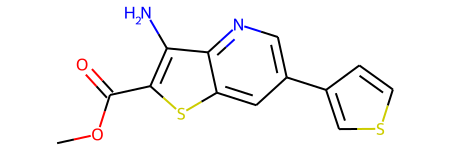

In [49]:
# TRUE MOLECULE
mol_true = mols_from_smiles([df_train.smiles[133]])[0]
mol_true

In [50]:
df_train.smiles[133]

'COC(=O)c1sc2cc(-c3ccsc3)cnc2c1N'

In [51]:
print("logP: ", Crippen.MolLogP(mol_true))
print("MR: ", Crippen.MolMR(mol_true))
print("QED: ", QED.qed(mol_true))
print("SAS: ", calculateScore(mol_true))

logP:  3.393600000000001
MR:  78.68490000000003
QED:  0.7346423100316176
SAS:  2.5376822768578506


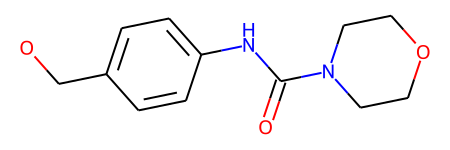

In [335]:
# RECONSTRUCTED MOLECULE FROM LEFT FRAGMENTATION
mol

In [336]:
print("logP: ", Crippen.MolLogP(mol))
print("MR: ", Crippen.MolMR(mol))
print("QED: ", QED.qed(mol))
print("SAS: ", calculateScore(mol))

logP:  1.01698
MR:  62.47520000000004
QED:  0.8062557187979619
SAS:  3.701155749815439


In [367]:
model = model.cuda()
inputs = Variable(generated).cuda()
batch_size = inputs.size(0)
vec_frag_arr = torch.zeros(100)
for idx2, (tgt_i) in enumerate(inputs):
    vec_frag_sum = torch.sum(model.embedder(tgt_i[tgt_i > 2]), 0)
    if idx2 == 0:
        vec_frag_arr = vec_frag_sum
    else:
        vec_frag_arr = torch.vstack((vec_frag_arr, vec_frag_sum))
embeddings = model.embedder(inputs)
z, mu, sigma = model.encoder(vec_frag_arr)
pred_logp, pred_sas = model.mlp(Variable(mu))

In [368]:
pred_logp

tensor([8.7799], device='cuda:0', grad_fn=<ViewBackward0>)

In [369]:
pred_sas

tensor([0.0803], device='cuda:0', grad_fn=<ViewBackward0>)

In [19]:
frags = mols_from_smiles(df_train.fragments[35].split())
df_train.fragments[0].split()

['*CCC',
 '*N(*)*',
 '*C(*)=O',
 '*C1OC(C(=O)O)=CC(N)C1*',
 '*N*',
 '*C(C)=O',
 '*CC*',
 '*c1cccc(*)c1',
 '*c1ccccc1']

In [7]:
def update(save_to, sample, running_seqs, step):
    # select only still running
    running_latest = save_to[running_seqs]
    # update token at step position
    running_latest[:, step] = sample.data
    # save back
    save_to[running_seqs] = running_latest

    return save_to

In [8]:
def row_filter(row):
    return (row == vocab.EOS).any()

In [29]:
model.encoder.sample_normal(1).cpu()

tensor([[[ 0.5089,  1.7977, -0.5320,  0.0657, -0.7741,  0.0346,  0.5805,
           1.2874, -1.5067,  0.7157, -0.1040,  0.7579, -1.4236,  0.4853,
           0.9895,  1.7263,  1.5654,  0.5413, -0.7600, -0.6014, -0.8847,
          -0.7251, -0.0620, -0.3988, -0.1237,  0.5590,  1.3771,  2.0969,
           0.3023,  0.2805, -0.7599, -0.2524, -0.7758, -0.8093,  1.3409,
           2.1054,  0.8195, -0.2886,  0.3760, -0.6340, -0.2822,  0.5936,
          -2.6060, -0.0351, -1.0008, -0.4388, -1.4159,  2.0427, -0.1128,
           0.9153, -0.1969, -0.5623,  1.5184, -0.4573, -1.0020,  0.7467,
           1.6807,  0.6117,  0.3960, -1.2073,  0.4577,  1.1793,  0.6778,
          -0.4864, -0.6246, -0.5775,  0.0730, -0.5186, -0.2284, -0.8392,
           0.1964,  1.2160,  0.1332, -0.2890,  1.3789,  0.1786, -0.1001,
           0.6575,  0.6464,  0.5210,  0.7531,  0.9827, -0.3161, -2.1992,
          -1.2135, -1.8212,  0.1930,  0.3703, -0.5733, -0.2468,  0.1170,
          -0.3180,  0.1627, -0.8537, -0.2879, -0.95

In [31]:
z_stack[0,None,None]

tensor([[[ 3.2227e+01,  3.3059e+01,  4.0954e+01, -2.0059e+01, -1.0474e+01,
           2.6507e+01,  9.0234e+00, -2.2286e+01,  1.3094e+01,  4.8154e+00,
           3.7020e+01,  4.1969e+01,  1.8200e+01,  1.7811e+01,  2.4506e+01,
           7.9386e+00,  1.1653e+01,  4.9447e+01,  5.3982e+00, -5.2263e+01,
          -2.2240e+01, -3.4247e+01,  2.4489e+00, -1.0391e+01,  4.4803e-02,
          -3.8876e+00,  2.5551e+01,  2.7212e+01, -3.9256e+01, -2.8248e+01,
          -3.1962e+00,  2.6830e+01, -7.8791e+00, -2.8261e+01, -5.6039e+00,
           4.6267e+00,  1.6581e+00,  2.9127e+01, -2.9551e+01, -2.3993e-01,
          -2.4223e+01, -1.1097e+01,  6.6482e+00, -1.2595e+01, -1.6499e+01,
           8.7120e+00,  8.9580e+00, -1.6347e+01, -1.8625e-01,  4.7653e+00,
           2.8969e+01,  2.5711e+01,  6.7315e+00,  1.8414e+00, -6.8422e+01,
          -1.4419e+01,  2.3682e+01, -2.0227e+01,  3.3129e+01, -5.3863e+00,
           1.3677e+01,  1.5557e+01,  1.6720e+01,  1.5085e+01,  3.3628e+01,
          -1.5317e+01, -2

In [33]:
model = model.cpu()
max_length = config.get('max_length')
temperature = config.get('temperature')
samples, sampled = [], 0
#z = model.encoder.sample_normal(1).cpu() + 45
z = z_stack[100,None,None].cpu()
# get the initial state
state = model.latent2rnn(z)
state = state.view(model.hidden_layers, 1, model.hidden_size)
# all idx of batch
sequence_idx = torch.arange(0, 1).long()

# all idx of batch which are still generating
running = torch.arange(0, 1).long()
sequence_mask = torch.ones(1, dtype=torch.bool)

# idx of still generating sequences
# with respect to current loop
running_seqs = torch.arange(0, 1).long()
lengths = [1] * 1

generated = torch.Tensor(1, max_length).long()
generated.fill_(vocab.PAD)

inputs = Variable(torch.Tensor(1).long())
inputs.fill_(vocab.SOS).long()
step = 0
while(step < max_length and len(running_seqs) > 0):
    inputs = inputs.unsqueeze(1)
    emb = model.embedder(inputs)
    scores, state = model.decoder(emb, state, lengths)
    scores = scores.squeeze(1)

    probs = F.softmax(scores / temperature, dim=1)
    inputs = torch.argmax(probs, 1).reshape(1, -1)

    # save next input
    generated = update(generated, inputs, running, step)
    # update global running sequence
    sequence_mask[running] = (inputs != vocab.EOS)
    running = sequence_idx.masked_select(sequence_mask)

    # update local running sequences
    running_mask = (inputs != vocab.EOS)
    running_seqs = running_seqs.masked_select(running_mask)

    # prune input and hidden state according to local update
    run_length = len(running_seqs)
    if run_length > 0:
        inputs = inputs.squeeze(0)
        inputs = inputs[running_seqs]
        state = state[:, running_seqs]
        running_seqs = torch.arange(0, run_length).long()

    lengths = [1] * run_length
    step += 1
new_samples_torch = generated
new_samples = generated.numpy()
#print(new_samples)
mask = np.apply_along_axis(row_filter, 1, new_samples)
#samples += generate_molecules(new_samples[mask], vocab)

In [34]:
new_samples

array([[67203, 38147,  1413, 38147,  4809, 38147,  3078,     2,     0,
            0]])

In [35]:
frags = mols_from_smiles(vocab.translate(new_samples[0]))
vocab.translate(new_samples[0])

['*C(=O)c1ccccc1', '*N*', '*CC(*)=O', '*N*', '*C(*)=O', '*N*', '*c1ccccc1']

In [36]:
frags

In [37]:
mol = join_molecules(frags[0], frags[1])
for i, frag in enumerate(frags[2:]):
    #print(i, mol_to_smiles(frag), mol_to_smiles(mol))
    mol = join_molecules(mol, frag)
    #print(i, mol_to_smiles(mol))

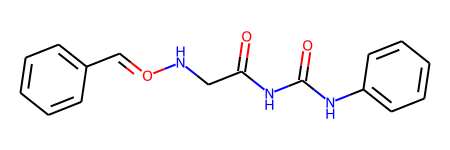

In [38]:
mol

In [39]:
smi = mols_to_smiles([mol])[0]
mol = mols_from_smiles([smi])[0]
mol

[21:02:48] Explicit valence for atom # 4 O, 3, is greater than permitted


ArgumentError: Python argument types in
    rdkit.Chem.rdmolfiles.MolToSmiles(NoneType)
did not match C++ signature:
    MolToSmiles(RDKit::ROMol mol, bool isomericSmiles=True, bool kekuleSmiles=False, int rootedAtAtom=-1, bool canonical=True, bool allBondsExplicit=False, bool allHsExplicit=False, bool doRandom=False)
    MolToSmiles(RDKit::ROMol mol, RDKit::SmilesWriteParams params)

In [40]:
print("logP: ", Crippen.MolLogP(mol))
print("MR: ", Crippen.MolMR(mol))
print("QED: ", QED.qed(mol))
print("SAS: ", calculateScore(mol))

logP:  1.5329999999999997
MR:  82.84360000000002


[21:02:51] Explicit valence for atom # 15 O, 3, is greater than permitted


AtomValenceException: Explicit valence for atom # 15 O, 3, is greater than permitted

In [274]:
model = model.cuda()
new_samples_torch = torch.tensor(new_samples).cuda()
vec_frag_sum = torch.sum(model.embedder(new_samples_torch[new_samples_torch > 2]), 0)
z, mu, sigma = model.encoder(vec_frag_sum.cuda())
pred_logp, pred_sas = model.mlp(Variable(mu.cuda()))

In [275]:
pred_logp

tensor([2.7506], device='cuda:0', grad_fn=<ViewBackward0>)

In [276]:
pred_sas

tensor([2.2348], device='cuda:0', grad_fn=<ViewBackward0>)

## Plot grid

In [5]:
z_stack = torch.load('RUNS/2022-11-06@14:28:06-LAPTOP-E1483HNR-CHEMBL/z_stack_tensor.pt')
mu_stack = torch.load('RUNS/2022-11-06@14:28:06-LAPTOP-E1483HNR-CHEMBL/mu_stack_tensor.pt')
pred_sas_stack = torch.load('RUNS/2022-11-06@14:28:06-LAPTOP-E1483HNR-CHEMBL/pred_sas_stack.pt')
pred_logp_stack = torch.load('RUNS/2022-11-06@14:28:06-LAPTOP-E1483HNR-CHEMBL/pred_logp_stack.pt')
data_sample_index_correct_pd = pd.read_csv('RUNS/2022-11-06@14:28:06-LAPTOP-E1483HNR-CHEMBL/data_sample_index_correct.csv')

In [17]:
z_stack[0]

tensor([ 3.2227e+01,  3.3059e+01,  4.0954e+01, -2.0059e+01, -1.0474e+01,
         2.6507e+01,  9.0234e+00, -2.2286e+01,  1.3094e+01,  4.8154e+00,
         3.7020e+01,  4.1969e+01,  1.8200e+01,  1.7811e+01,  2.4506e+01,
         7.9386e+00,  1.1653e+01,  4.9447e+01,  5.3982e+00, -5.2263e+01,
        -2.2240e+01, -3.4247e+01,  2.4489e+00, -1.0391e+01,  4.4803e-02,
        -3.8876e+00,  2.5551e+01,  2.7212e+01, -3.9256e+01, -2.8248e+01,
        -3.1962e+00,  2.6830e+01, -7.8791e+00, -2.8261e+01, -5.6039e+00,
         4.6267e+00,  1.6581e+00,  2.9127e+01, -2.9551e+01, -2.3993e-01,
        -2.4223e+01, -1.1097e+01,  6.6482e+00, -1.2595e+01, -1.6499e+01,
         8.7120e+00,  8.9580e+00, -1.6347e+01, -1.8625e-01,  4.7653e+00,
         2.8969e+01,  2.5711e+01,  6.7315e+00,  1.8414e+00, -6.8422e+01,
        -1.4419e+01,  2.3682e+01, -2.0227e+01,  3.3129e+01, -5.3863e+00,
         1.3677e+01,  1.5557e+01,  1.6720e+01,  1.5085e+01,  3.3628e+01,
        -1.5317e+01, -2.8397e+01,  3.8491e+00, -6.3

In [27]:
np.array(z.size())[0]

100

In [41]:
ind_1 = random.randint(0, z.size()[2] - 1)
print(ind_1)
ind_2 = random.randint(0, z.size()[2] - 1)

48


In [56]:
z_linspace = torch.linspace(-10, 10, steps=21)

In [57]:
z[0]

tensor([[ 15.6155,  16.7052,  19.4012, -12.8006,  -3.7320,  14.3094,   7.2183,
         -11.4226,   7.3337,   1.3852,  21.1365,  19.4226,   8.9695,   9.1869,
          11.8695,   4.1608,   4.0515,  25.4431,   1.5352, -26.6959, -11.3683,
         -16.8268,   0.6012,  -4.7372,  -1.2463,  -0.8765,  13.6768,  13.2268,
         -16.9160, -15.5099,  -4.9344,  16.3068,  -3.7757, -15.4376,  -4.0506,
           1.5929,   1.0946,  11.8583, -13.6972,  -3.5892, -13.7589,  -4.6136,
           5.3690,  -6.2442,  -8.1142,   4.4833,   5.2437,  -9.5595,   0.1678,
           5.4323,  17.3727,  11.8687,   1.2546,  -1.4935, -33.8274,  -5.4400,
          10.7489,  -6.5147,  14.3982,  -1.7234,   6.7244,  10.7345,  10.0612,
           7.6952,  16.0383,  -8.9543, -14.4616,  -0.0343,  -4.6947,  -3.7508,
          -2.1903,  20.0906, -13.8386,   6.6624,  -0.2166,   8.0249,   5.5060,
           3.6482,  11.4245,  -6.8748,   6.8358,  -3.7044,   2.6115,   8.4417,
          11.5231,  -7.0066, -13.4037,  18.1075,  10

In [58]:
z_linspace

tensor([-10.,  -9.,  -8.,  -7.,  -6.,  -5.,  -4.,  -3.,  -2.,  -1.,   0.,   1.,
          2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.])

In [59]:
for idx, (z_step) in enumerate(z_linspace):
    for idx_2, (z_step_2) in enumerate(z_linspace):
        z_add = torch.zeros(z.size()[2])
        z_add_2 = torch.zeros(z.size()[2])
        z_add[ind_1] += z_step
        z_add_2[ind_2] += z_step_2
        z_search = z[0] + z_add + z_add_2
        if idx_2 == 0:
            z_stack_2 = z_search
        else:
            z_stack_2 = torch.cat((z_stack_2,z_search),0)
    
    if idx == 0:
        z_stack = z_stack_2[None,:,:]
    else:
        z_stack = torch.cat((z_stack, z_stack_2[None,:,:]), 0)

In [60]:
z_stack[0][:, ind_2]

tensor([-22.8006, -21.8006, -20.8006, -19.8006, -18.8006, -17.8006, -16.8006,
        -15.8006, -14.8006, -13.8006, -12.8006, -11.8006, -10.8006,  -9.8006,
         -8.8006,  -7.8006,  -6.8006,  -5.8006,  -4.8006,  -3.8006,  -2.8006])

In [61]:
z_test = z

In [62]:
z_test

tensor([[[ 15.6155,  16.7052,  19.4012, -12.8006,  -3.7320,  14.3094,   7.2183,
          -11.4226,   7.3337,   1.3852,  21.1365,  19.4226,   8.9695,   9.1869,
           11.8695,   4.1608,   4.0515,  25.4431,   1.5352, -26.6959, -11.3683,
          -16.8268,   0.6012,  -4.7372,  -1.2463,  -0.8765,  13.6768,  13.2268,
          -16.9160, -15.5099,  -4.9344,  16.3068,  -3.7757, -15.4376,  -4.0506,
            1.5929,   1.0946,  11.8583, -13.6972,  -3.5892, -13.7589,  -4.6136,
            5.3690,  -6.2442,  -8.1142,   4.4833,   5.2437,  -9.5595,   0.1678,
            5.4323,  17.3727,  11.8687,   1.2546,  -1.4935, -33.8274,  -5.4400,
           10.7489,  -6.5147,  14.3982,  -1.7234,   6.7244,  10.7345,  10.0612,
            7.6952,  16.0383,  -8.9543, -14.4616,  -0.0343,  -4.6947,  -3.7508,
           -2.1903,  20.0906, -13.8386,   6.6624,  -0.2166,   8.0249,   5.5060,
            3.6482,  11.4245,  -6.8748,   6.8358,  -3.7044,   2.6115,   8.4417,
           11.5231,  -7.0066, -13.4037, 

In [63]:
def sample_molecule(z_test):
    state = model.latent2rnn(z_test)
    state = state.view(model.hidden_layers, 1, model.hidden_size)
    # all idx of batch
    sequence_idx = torch.arange(0, 1).long()

    # all idx of batch which are still generating
    running = torch.arange(0, 1).long()
    sequence_mask = torch.ones(1, dtype=torch.bool)

    # idx of still generating sequences
    # with respect to current loop
    running_seqs = torch.arange(0, 1).long()
    lengths = [1] * 1

    generated = torch.Tensor(1, max_length).long()
    generated.fill_(vocab.PAD)

    inputs = Variable(torch.Tensor(1).long())
    inputs.fill_(vocab.SOS).long()
    step = 0
    while(step < max_length and len(running_seqs) > 0):
        inputs = inputs.unsqueeze(1)
        emb = model.embedder(inputs)
        scores, state = model.decoder(emb, state, lengths)
        scores = scores.squeeze(1)

        probs = F.softmax(scores / temperature, dim=1)
        inputs = torch.argmax(probs, 1).reshape(1, -1)

        # save next input
        generated = update(generated, inputs, running, step)
        # update global running sequence
        sequence_mask[running] = (inputs != vocab.EOS)
        running = sequence_idx.masked_select(sequence_mask)

        # update local running sequences
        running_mask = (inputs != vocab.EOS)
        running_seqs = running_seqs.masked_select(running_mask)

        # prune input and hidden state according to local update
        run_length = len(running_seqs)
        if run_length > 0:
            inputs = inputs.squeeze(0)
            inputs = inputs[running_seqs]
            state = state[:, running_seqs]
            running_seqs = torch.arange(0, run_length).long()

        lengths = [1] * run_length
        step += 1
    new_samples = generated.numpy()
    #print(new_samples)
    mask = np.apply_along_axis(row_filter, 1, new_samples)
    return new_samples

In [64]:
mol_list = []
for z_stack_row in z_stack:
    for z_stack_i in z_stack_row:
        new_samples = sample_molecule(z_stack_i)
        frags = mols_from_smiles(vocab.translate(new_samples[0]))
        try:
            mol = join_molecules(frags[0], frags[1])
            for i, frag in enumerate(frags[2:]):
                #print(i, mol_to_smiles(frag), mol_to_smiles(mol))
                mol = join_molecules(mol, frag)
                #print(i, mol_to_smiles(mol))
            mol_list.append(mol)
        except:
            mol_list.append(mol_list[-1])

In [65]:
len(z_linspace)

21

In [66]:
img = Draw.MolsToGridImage(mol_list, molsPerRow=21, subImgSize=(1000, 1000))
type(img)
png = img.data
with open('mol_grid.png','wb+') as outf:
    outf.write(png)

In [67]:
for idx in range(len(z_linspace)):
    idx_start = idx*21
    idx_end = idx_start+21
    png = Draw.MolsToGridImage(mol_list[idx_start:idx_end])
    png = img.data
    with open('mol_grid/mol_grid'+str(idx)+'.png','wb+') as outf:
        outf.write(png)

In [68]:
png = Draw.MolsToGridImage(mol_list[0:21], molsPerRow=21)
png = img.data
with open('mol_grid/mol_grid1.png','wb') as outf:
    outf.write(png)

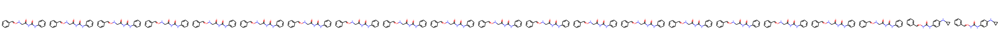

In [74]:
png = Draw.MolsToGridImage(mol_list[126:147], molsPerRow=21)
png

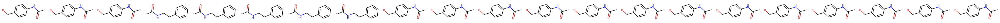

In [509]:
Draw.MolsToGridImage(mol_list[420:441], molsPerRow=21, subImgSize=(200, 100))

In [6]:
frags = mols_from_smiles(vocab.translate(new_samples[0]))
vocab.translate(new_samples[0])

NameError: name 'new_samples' is not defined

In [5]:
mol = join_molecules(frags[0], frags[1])
for i, frag in enumerate(frags[2:]):
    print(i, mol_to_smiles(frag), mol_to_smiles(mol))
    mol = join_molecules(mol, frag)
    print(i, mol_to_smiles(mol))

NameError: name 'frags' is not defined

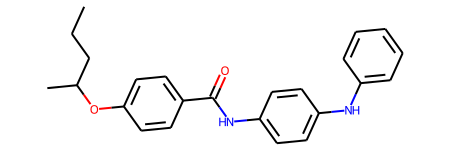

In [176]:
mol

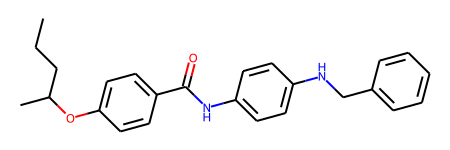

In [193]:
mol

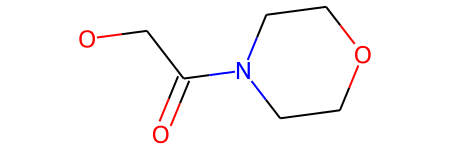

In [313]:
mol

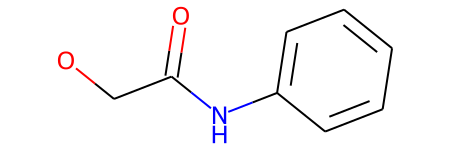

In [297]:
mol

In [206]:
beta = []
beta.extend(list(np.zeros(10)))
while len(beta) < 50:
    beta.extend(list((np.arange(10) + 1) / 10))
    beta.extend(list(np.ones(10)))

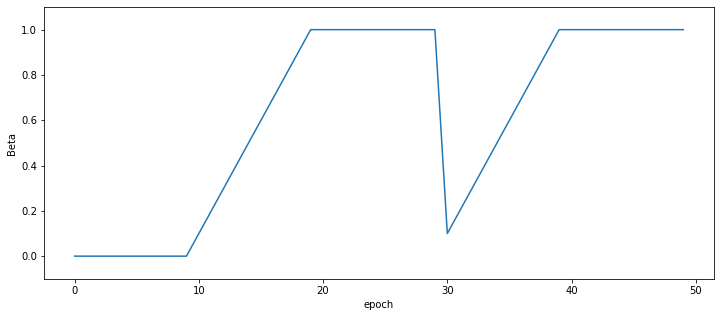

In [117]:
plt.figure(figsize=(12, 5))
plt.plot( np.arange(50),beta[0:50])
plt.xlabel("epoch")
plt.ylabel("Beta")
plt.ylim([-0.1,1.1])
plt.show()

In [112]:
beta

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.1,
 0.2,
 0.3,
 0.4,
 0.5,
 0.6,
 0.7,
 0.8,
 0.9,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 0.1,
 0.2,
 0.3,
 0.4,
 0.5,
 0.6,
 0.7,
 0.8,
 0.9,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0]

In [16]:
dataset.data.smiles[0]

'CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O'

In [5]:
dataset.data.fragments[0]

'*CCC *N(*)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O *CC* *c1cccc(*)c1 *c1ccccc1'

In [6]:
frags = mols_from_smiles(dataset.data.fragments[0].split())

In [7]:
mol = join_molecules(frags[0], frags[1])
for i, frag in enumerate(frags[2:]):
    print(i, mol_to_smiles(frag), mol_to_smiles(mol))
    mol = join_molecules(mol, frag)
    print(i, mol_to_smiles(mol))

NameError: name 'join_molecules' is not defined

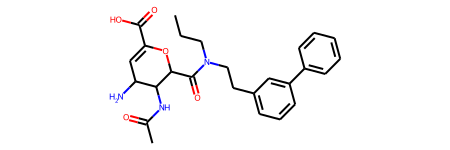

In [8]:
mol = mols_from_smiles([dataset.data.smiles[0]])[0]
mol

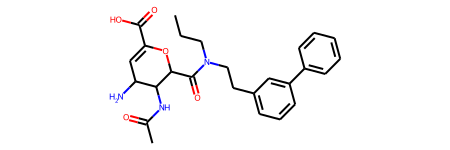

In [9]:
smi = mol_to_smiles(mol)
smi
mol = mols_from_smiles([smi])
mol[0]

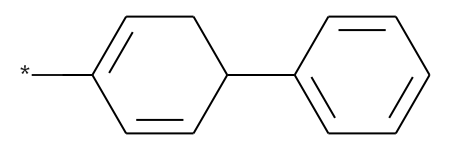

In [71]:
join_molecules(frags[-2], frags[-1])

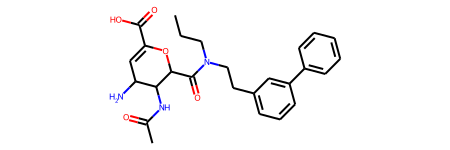

In [7]:
mols_from_smiles([dataset.data.smiles[0]])[0]

In [127]:
dummy = Chem.MolFromSmiles('[*]')

def join_molecules(molA, molB, end = False):
    marked, neigh = None, None
    for atom in molA.GetAtoms():
        if atom.GetAtomicNum() == 0:
            marked = atom.GetIdx()
            #print(marked)
            neigh = atom.GetNeighbors()[0]
            #print(neigh)
            break
    neigh = 0 if neigh is None else neigh.GetIdx()

    if marked is not None:
        ed = Chem.EditableMol(molA)
        ed.RemoveAtom(marked)
        molA = ed.GetMol()
        #print(mols_to_smiles([molA]))
    
    if end:
        joined = Chem.ReplaceSubstructs(
            molB, dummy, molA,
            replacementConnectionPoint=0,
            useChirality=False)[0]
    else:
        joined = Chem.ReplaceSubstructs(
            molB, dummy, molA,
            replacementConnectionPoint=0,
            useChirality=False)[1]

    #Chem.Kekulize(joined)
    return joined

In [89]:
frag_str = dataset.data.fragments[17000].split()
frag_str

['*C(C)C',
 '*N(*)C(=O)c1ccc(-c2c[nH]c3ccccc23)cc1',
 '*C*',
 '*c1cccc(*)c1',
 '*O*',
 '*CCCCCC(=O)O']

In [90]:
frag_mol = mols_from_smiles(frag_str)

In [91]:
for i, frag in reversed(list(enumerate(frag_mol))):
    #print(i, mol_to_smiles(frag))
    if i == len(frag_mol)-1:
        mol = frag
    elif (i != 0) & (i != len(frag_mol)-1):
        mol = join_molecules(mol, frag)
    elif i == 0:
        mol = join_molecules(mol, frag, end = True)
    #print(i, mol_to_smiles(mol))

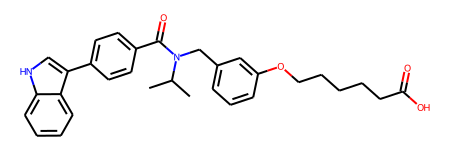

In [92]:
smi = mols_to_smiles([mol])[0]
mol = mols_from_smiles([smi])[0]
mol

In [93]:
print("logP: ", Crippen.MolLogP(mol))
print("MR: ", Crippen.MolMR(mol))
print("QED: ", QED.qed(mol))
print("SAS: ", calculateScore(mol))

logP:  6.909500000000007
MR:  146.78499999999983
QED:  0.20797061404266654
SAS:  2.345038163777895


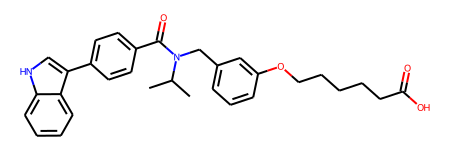

In [94]:
mol_true = mols_from_smiles([dataset.data.smiles[17000]])[0]
mol_true

In [95]:
print("logP: ", Crippen.MolLogP(mol_true))
print("MR: ", Crippen.MolMR(mol_true))
print("QED: ", QED.qed(mol_true))
print("SAS: ", calculateScore(mol_true))

logP:  6.909500000000007
MR:  146.78499999999983
QED:  0.20797061404266654
SAS:  2.345038163777895


In [ ]:
for i, frag in enumerate(frags[2:]):
    print(i, mol_to_smiles(frag), mol_to_smiles(mol))
    mol = join_molecules(mol, frag)
    print(i, mol_to_smiles(mol))

['C1COCCN1']


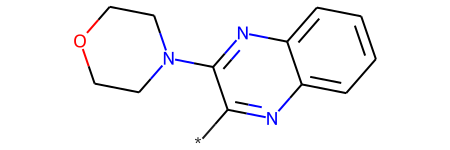

In [95]:
mol_test = join_molecules(frag_mol[-1], frag_mol[-2])
mol_test

['c1ccc2nc(N3CCOCC3)cnc2c1']


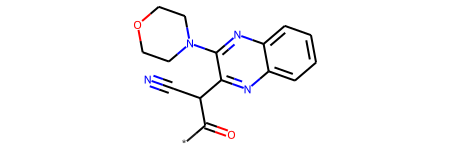

In [96]:
mol_test = join_molecules(mol_test, frag_mol[-3])
mol_test

['N#CC(C=O)c1nc2ccccc2nc1N1CCOCC1']


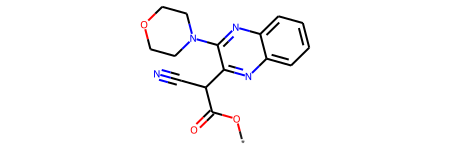

In [97]:
mol_test = join_molecules(mol_test, frag_mol[-4])
mol_test

['N#CC(C(=O)O)c1nc2ccccc2nc1N1CCOCC1']


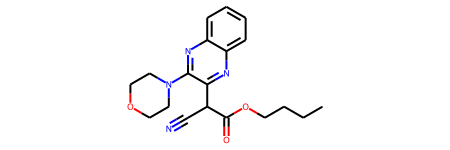

In [98]:
mol_test = join_molecules(mol_test, frag_mol[-5], end = True)
mol_test

['CCO']


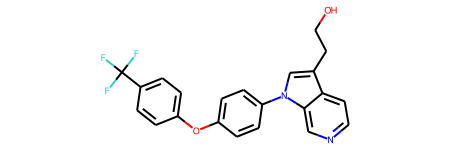

In [76]:
mol_test = join_molecules(frag_mol[-6], mol_test, end = True)
mol_test

['Cc1ccc2ccccc2n1']


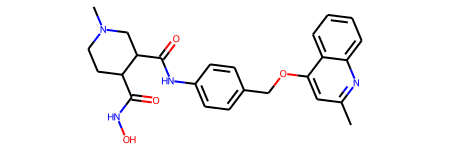

In [177]:
mol_test = join_molecules(frag_mol[-7], mol_test)
mol_test

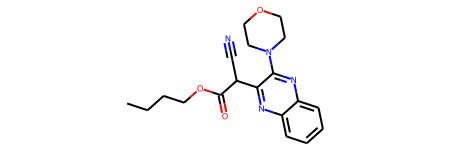

In [99]:
mol_smi_test = mols_to_smiles([mol_test])[0]
mol_smi_test == dataset.data.smiles[0]
mol_test = mols_from_smiles([mol_smi_test])[0]
mol_test

In [100]:
print("logP: ", Crippen.MolLogP(mol_test))
print("MR: ", Crippen.MolMR(mol_test))
print("QED: ", QED.qed(mol_test))
print("SAS: ", calculateScore(mol_test))

logP:  2.416880000000001
MR:  96.79100000000005
QED:  0.5812158517519392
SAS:  2.902753483459941


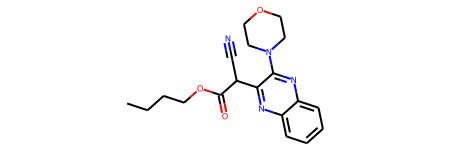

In [102]:
mol_true = mols_from_smiles([dataset.data.smiles[10000]])[0]
mol_true

In [103]:
print("logP: ", Crippen.MolLogP(mol_true))
print("MR: ", Crippen.MolMR(mol_true))
print("QED: ", QED.qed(mol_true))
print("SAS: ", calculateScore(mol_true))

logP:  2.416880000000001
MR:  96.79100000000005
QED:  0.5812158517519392
SAS:  2.902753483459941


In [36]:
mol_to_smiles(mol_test)

'CCC*NC(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O'

In [ ]:
c1cccc(-c2ccccc2)c1

In [269]:
ind_0 = frag_str[-2].rfind('*')
ind_0

12

In [270]:
frag_str[-2]

'*C1CCN(C)CC1*'

In [271]:
frag_1 = frag_str[-2][:ind_0] + frag_str[-1][1:] + frag_str[-2][ind_0+1:]
frag_1

'*C1CCN(C)CC1C(=O)NO'

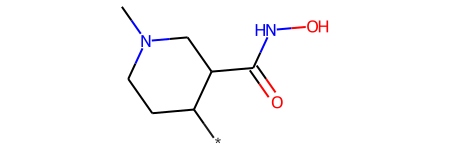

In [272]:
mol = mols_from_smiles([frag_1])
frag_1 = mols_to_smiles(mol)[0]
mol[0]

In [273]:
frag_1

'*C1CCN(C)CC1C(=O)NO'

In [274]:
ind = frag_str[-3].rfind('*')
ind

3

In [275]:
frag_str[-3]

'*C(*)=O'

In [276]:
frag_str[-3][:ind] + frag_1[1:] + frag_str[-3][ind+1:]

'*C(C1CCN(C)CC1C(=O)NO)=O'

In [277]:
frag_1 = frag_str[-3][:ind] + frag_1[1:] + frag_str[-3][ind+1:]
frag_1

'*C(C1CCN(C)CC1C(=O)NO)=O'

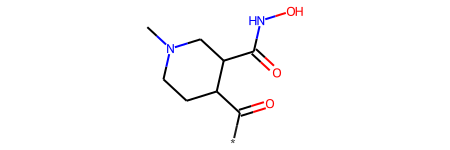

In [278]:
mol = mols_from_smiles([frag_1])
frag_1 = mols_to_smiles(mol)[0]
mol[0]

In [279]:
frag_1

'*C(=O)C1CCN(C)CC1C(=O)NO'

In [280]:
ind = frag_str[-4].rfind('*')
ind

2

In [281]:
frag_str[-4]

'*N*'

In [282]:
frag_str[-4][:ind] + frag_1[1:] + frag_str[-4][ind+1:]

'*NC(=O)C1CCN(C)CC1C(=O)NO'

In [283]:
frag_1 = frag_str[-4][:ind] + frag_1[1:] + frag_str[-4][ind+1:]
frag_1

'*NC(=O)C1CCN(C)CC1C(=O)NO'

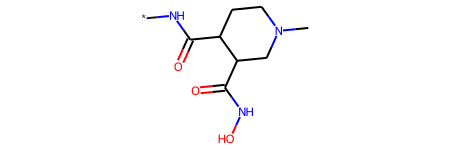

In [284]:
mol = mols_from_smiles([frag_1])
frag_1 = mols_to_smiles(mol)[0]
mol[0]

In [285]:
frag_1

'*NC(=O)C1CCN(C)CC1C(=O)NO'

In [239]:
frag_1 = mols_to_smiles(mol)[0]
frag_1

'*NC(=O)C1CCN(C)CC1C(=O)NO'

In [286]:
ind = frag_str[-5].rfind('*')
ind

7

In [287]:
frag_str[-5]

'*c1ccc(*)cc1'

In [288]:
frag_str[-5][:ind] + frag_1[1:] + frag_str[-5][ind+1:]

'*c1ccc(NC(=O)C1CCN(C)CC1C(=O)NO)cc1'

In [289]:
frag_1 = frag_str[-5][:ind] + frag_1[1:] + frag_str[-5][ind+1:]
frag_1

'*c1ccc(NC(=O)C1CCN(C)CC1C(=O)NO)cc1'

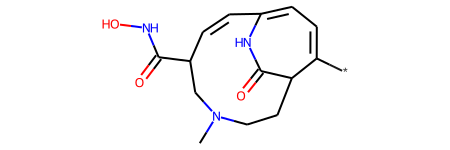

In [290]:
mol = mols_from_smiles([frag_1])
mol[0]

In [191]:
mol = mol[0]
print("logP: ", Crippen.MolLogP(mol))
print("MR: ", Crippen.MolMR(mol))
print("QED: ", QED.qed(mol))
print("SAS: ", calculateScore(mol))

logP:  4.940300000000004
MR:  112.94549999999998
QED:  0.6385663512010723
SAS:  2.6080019636239804


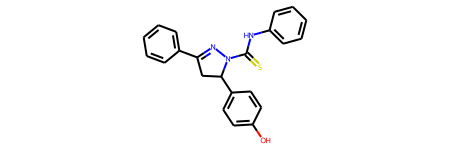

In [193]:
mol_true = mols_from_smiles([dataset.data.smiles[1]])[0]
mol_true

In [194]:
print("logP: ", Crippen.MolLogP(mol_true))
print("MR: ", Crippen.MolMR(mol_true))
print("QED: ", QED.qed(mol_true))
print("SAS: ", calculateScore(mol_true))

logP:  4.940300000000003
MR:  112.9455
QED:  0.6385663512010724
SAS:  2.56341209020626


In [ ]:
frags

In [10]:
mol_true = mols_from_smiles([dataset.data.smiles[0]])

In [11]:
mol = mol_true[0]
bonds = list(BRICS.FindBRICSBonds(mol))
idxs, labs = list(zip(*bonds))
bond_idxs = []
for a1, a2 in idxs:
    bond = mol.GetBondBetweenAtoms(a1, a2)
    bond_idxs.append(bond.GetIdx())
order = np.argsort(bond_idxs).tolist()
bond_idxs = [bond_idxs[i] for i in order]
broken = Chem.FragmentOnBonds(mol,
                              bondIndices=[bond_idxs[0]],
                              dummyLabels=[(0, 0)])

In [12]:
dataset.data.smiles[0]

'CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O'

In [13]:
dataset.data.fragments[0]

'*CCC *N(*)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O *CC* *c1cccc(*)c1 *c1ccccc1'

In [14]:
bond_idxs

[2, 3, 5, 10, 17, 19, 29, 30]

In [15]:
head, tail = Chem.GetMolFrags(broken, asMols=True)

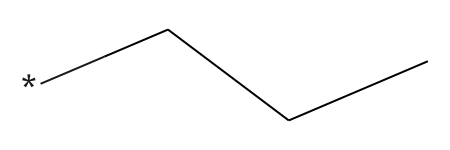

In [38]:
head

In [16]:
mol_to_smiles(head)

'*CCC'

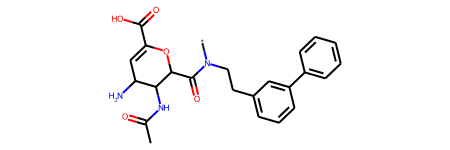

In [18]:
tail

In [19]:
mol_to_smiles(tail)

'*N(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O'

In [20]:
mol = tail
bonds = list(BRICS.FindBRICSBonds(mol))
idxs, labs = list(zip(*bonds))
bond_idxs = []
for a1, a2 in idxs:
    bond = mol.GetBondBetweenAtoms(a1, a2)
    bond_idxs.append(bond.GetIdx())
order = np.argsort(bond_idxs).tolist()
bond_idxs = [bond_idxs[i] for i in order]
broken = Chem.FragmentOnBonds(mol,
                              bondIndices=[bond_idxs[0]],
                              dummyLabels=[(0, 0)])

In [21]:
bond_idxs

[0, 2, 7, 14, 16, 26, 27]

In [22]:
head, tail = Chem.GetMolFrags(broken, asMols=True)

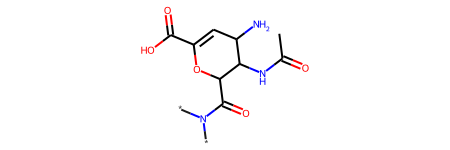

In [25]:
head

In [26]:
mol_to_smiles(head)

'*N(*)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O'

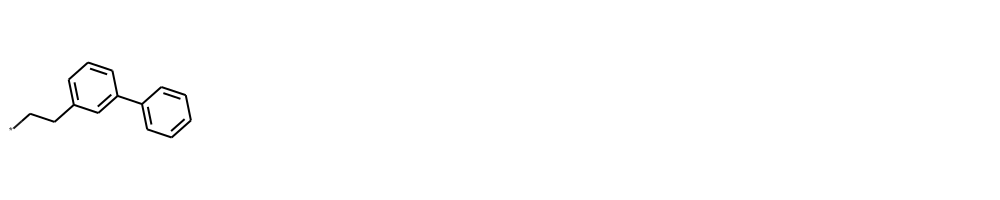

In [33]:
Draw.MolsToGridImage([tail],molsPerRow=5)

In [34]:
mol_to_smiles(tail)

'*CCc1cccc(-c2ccccc2)c1'

In [35]:
mol = tail
bonds = list(BRICS.FindBRICSBonds(mol))
idxs, labs = list(zip(*bonds))
bond_idxs = []
for a1, a2 in idxs:
    bond = mol.GetBondBetweenAtoms(a1, a2)
    bond_idxs.append(bond.GetIdx())
order = np.argsort(bond_idxs).tolist()
bond_idxs = [bond_idxs[i] for i in order]
broken = Chem.FragmentOnBonds(mol,
                              bondIndices=[bond_idxs[0]],
                              dummyLabels=[(0, 0)])

In [36]:
bond_idxs

[1, 6]

In [37]:
head, tail = Chem.GetMolFrags(broken, asMols=True)

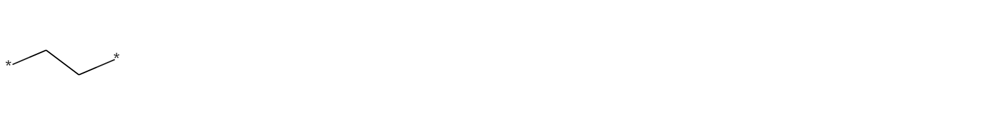

In [41]:
Draw.MolsToGridImage([head],molsPerRow=8)

In [39]:
mol_to_smiles(head)

'*CC*'

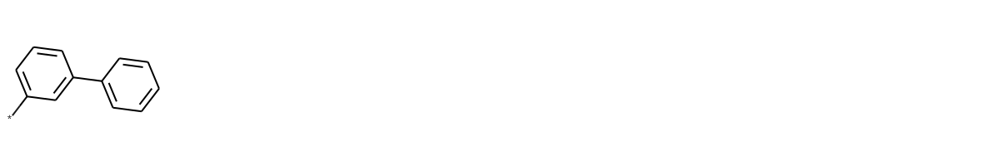

In [44]:
Draw.MolsToGridImage([tail],molsPerRow=6)

In [45]:
mol_to_smiles(tail)

'*c1cccc(-c2ccccc2)c1'

In [51]:
mol = tail
bonds = list(BRICS.FindBRICSBonds(mol))
idxs, labs = list(zip(*bonds))
bond_idxs = []
for a1, a2 in idxs:
    bond = mol.GetBondBetweenAtoms(a1, a2)
    bond_idxs.append(bond.GetIdx())
order = np.argsort(bond_idxs).tolist()
bond_idxs = [bond_idxs[i] for i in order]
broken = Chem.FragmentOnBonds(mol,
                              bondIndices=[bond_idxs[0]],
                              dummyLabels=[(0, 0)])

In [52]:
bond_idxs

[4]

In [53]:
head, tail = Chem.GetMolFrags(broken, asMols=True)

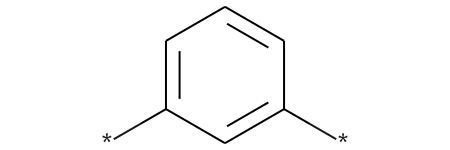

In [54]:
head

In [55]:
mol_to_smiles(head)

'*c1cccc(*)c1'

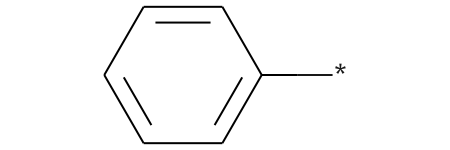

In [56]:
tail

In [57]:
mol_to_smiles(tail)

'*c1ccccc1'

In [58]:
frags_test = mols_to_smiles([head,tail])
frags_test

['*c1cccc(*)c1', '*c1ccccc1']

In [65]:
frag_1 = frags_test[0]
frag_1

'*c1cccc(*)c1'

In [66]:
ind = frag_1.find('*')
ind

0

In [67]:
frag_1 = frag_1[:ind] + frags_test[1][1:] + frag_1[ind+1:]
frag_1

'c1ccccc1c1cccc(*)c1'

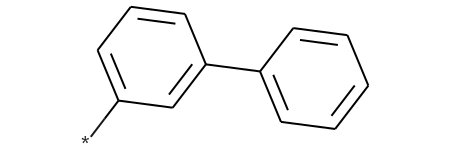

In [68]:
mol = mols_from_smiles([frag_1])
mol[0]

In [57]:
frags_test = mols_to_smiles([broken])
frags_test

['*c1cccc(*)c1.*c1ccccc1']

In [73]:
Chem.MolFromSmiles(frags_test[0].replace('*', '9'))

[16:28:52] SMILES Parse Error: syntax error while parsing: 9CCC.9N(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O
[16:28:52] SMILES Parse Error: Failed parsing SMILES '9CCC.9N(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O' for input: '9CCC.9N(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O'


In [52]:
head, tail = Chem.GetMolFrags(broken, asMols=True)

In [56]:
mol_to_smiles(head)

'*CCC'

In [94]:
from rdkit.Chem import Recap
m = Chem.MolFromSmiles(dataset.data.smiles[0])
hierarch = Recap.RecapDecompose(m)

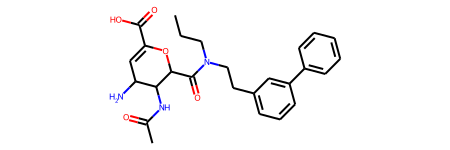

In [95]:
mol = mols_from_smiles([hierarch.smiles])
mol = mol[0]
mol

In [96]:
print("logP: ", Crippen.MolLogP(mol))
print("MR: ", Crippen.MolMR(mol))
print("QED: ", QED.qed(mol))
print("SAS: ", calculateScore(mol))

logP:  2.3339999999999996
MR:  128.62490000000008
QED:  0.5225687020700466
SAS:  3.5957452909418954


In [97]:
hierarch.smiles

'CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O'

In [100]:
ks=hierarch.children.keys()
ks

dict_keys(['*C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O', '*N(CCC)CCc1cccc(-c2ccccc2)c1', '*C(C)=O', '*NC1C(N)C=C(C(=O)O)OC1C(=O)N(CCC)CCc1cccc(-c2ccccc2)c1', '*O', '*C(=O)C1=CC(N)C(NC(C)=O)C(C(=O)N(CCC)CCc2cccc(-c3ccccc3)c2)O1', '*c1ccccc1', '*c1cccc(CCN(CCC)C(=O)C2OC(C(=O)O)=CC(N)C2NC(C)=O)c1'])

In [99]:
ks=hierarch.GetLeaves().keys()
ks=sorted(ks)
ks

['*C(C)=O',
 '*NC1C(N)C=C(C(*)=O)OC1C(*)=O',
 '*O',
 '*c1cccc(CCN(*)CCC)c1',
 '*c1ccccc1']

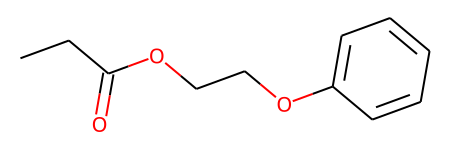

In [87]:
mol_true = mols_from_smiles(['c1ccccc1OCCOC(=O)CC'])
mol_true = mol_true[0]
mol_true

In [88]:
print("logP: ", Crippen.MolLogP(mol_true))
print("MR: ", Crippen.MolMR(mol_true))
print("QED: ", QED.qed(mol_true))
print("SAS: ", calculateScore(mol_true))

logP:  2.0186
MR:  53.18700000000003
QED:  0.5310563539311669
SAS:  1.5833044318459848


In [171]:
dataset.data

,smiles,fragments,n_fragments,C,F,N,O,Other,SINGLE,DOUBLE,TRIPLE,Tri,Quad,Pent,Hex,logP,mr,qed,SAS
0,CCCN(CCc1cccc(-c2ccccc2)c1)C(=O)C1OC(C(=O)O)=C...,*CCC *N(*)C(=O)C1OC(C(=O)O)=CC(N)C1NC(C)=O *CC...,5.0,26,0,3,5,0,26,10,0,0,0,0,3,2.33400,128.6249,0.522569,3.595745
1,Oc1ccc(C2CC(c3ccccc3)=NN2C(=S)Nc2ccccc2)cc1,*c1ccc(O)cc1 *NC(=S)N1N=C(c2ccccc2)CC1* *c1ccccc1,3.0,22,0,3,1,1,19,11,0,0,0,1,3,4.94030,112.9455,0.638566,2.563412
2,COC(=O)c1cc(C(=CCCCC(=O)SC)c2cc(Cl)c(OC)c(C(=O...,*OC *C(*)=O *c1cc(C(=*)c2cc(Cl)c(OC)c(C(=O)OC)...,4.0,25,0,0,7,3,26,10,0,0,0,0,2,6.07540,138.1390,0.264467,2.973098
3,Cc1cc(COc2ccc(NC(=O)C3CN(C)CCC3C(=O)NO)cc2)c2c...,*c1cc(C)nc2ccccc12 *CO* *c1ccc(*)cc1 *N* *C(*)...,7.0,25,0,4,4,0,26,10,0,0,0,0,4,3.13402,124.9069,0.395442,3.145495
4,CCOC(=O)c1ccc(O)c(-n2cc3c(c2-c2ccccc2)c(=O)n(C...,*CC *O* *C(*)=O *c1ccc(O)c(*)c1 *c1c2c(=O)n(C)...,6.0,23,0,3,5,0,23,11,0,0,0,1,3,2.57720,116.8143,0.513201,2.494430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117018,CCN1CCN(C(=O)c2cc(S(=O)(=O)N3CCCCC3)ccc2Cl)CC1,*CC *N1CCN(*)CC1 *C(*)=O *c1cc(S(*)(=O)=O)ccc1...,5.0,18,0,3,3,2,22,6,0,0,0,0,3,2.29230,102.0793,0.778914,2.007569
117019,NC1=NC(c2cccc(NC(=O)c3ccc(Cl)cn3)c2)CCS1,*C1CCSC(N)=N1 *c1cccc(*)c1 *N* *C(*)=O *c1ccc(...,5.0,16,0,4,1,2,17,8,0,0,0,0,3,3.48000,95.0806,0.891135,3.008976
117020,Cc1ccc(-c2cccc(-c3cnc(N)c(C(=O)N=c4cc[nH]cc4)c...,*c1ccc(C)cc1 *c1cccc(*)c1 *c1cnc(N)c(*)c1 *C(=...,4.0,24,0,4,1,0,19,13,0,0,0,0,4,4.37542,114.9446,0.553252,2.761683
117021,O=C(Nc1ccc(S(=O)(=O)Nc2ccccc2)cc1)c1ccc(O)c(O)c1,*C(=O)c1ccc(O)c(O)c1 *N* *c1ccc(S(*)(=O)=O)cc1...,5.0,19,0,2,5,1,17,12,0,0,0,0,3,3.15090,101.4173,0.504472,1.809538
